In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit
import copy

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
from tensorflow.keras import applications
from tensorflow.keras.models import *
from tensorflow.keras.layers import *

import pyQEDA as pq
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential as pqp
import normalization_function as nf

-------------------------------------------------------------------------------------------------------------------

# I. Load Data

1. load the true Ug of experimental pattern

In [2]:
name =  "SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn"
File = "SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn"
Nx = 83
t = 0.3     # 0.5*1000 = 500Am
save_name = "SiTrO3_01"

Folder = "/Users/chenjie/pyQEDA/pyQEDA_simulations/"
file_dir = Folder + name + "/" + name + "_experimental_data/_UgMasterList.txt"

(26,)


Text(0.5, 1.0, 'Ug of experimental pattern')

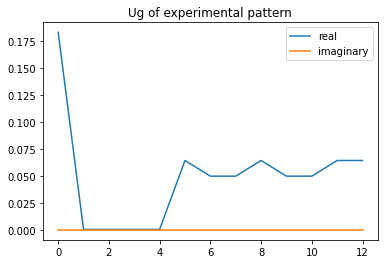

In [3]:
Ug = []
with open(file_dir, mode="r") as f:
    f.readline()
    for line in f:
        beam_id, Ug_re, Ug_im = line.strip().split(" ")[:3]
        Ug_re = float(Ug_re)
        Ug_im = float(Ug_im)
        Ug = np.append(Ug, [Ug_re, Ug_im])
        Ug = np.asarray(Ug)
        numUg = int(len(Ug)/2)
print(Ug.shape)

plt.plot(Ug[::2],label='real')
plt.plot(Ug[1::2],label='imaginary')
plt.legend()
plt.title('Ug of experimental pattern')

In [4]:
# join Ug and t:
Ug_t = np.append(Ug,t)
print(Ug_t.shape)

(27,)


In [5]:
Ug_t

array([ 1.83539e-01,  0.00000e+00,  4.61450e-04, -4.96320e-09,
        4.61450e-04,  4.96320e-09,  4.61450e-04, -4.96320e-09,
        4.61450e-04,  4.96320e-09,  6.44769e-02, -5.75450e-09,
        4.99062e-02,  0.00000e+00,  4.99062e-02, -4.46266e-09,
        6.44769e-02,  5.75450e-09,  4.99062e-02,  4.46266e-09,
        4.99062e-02,  0.00000e+00,  6.44769e-02, -5.75450e-09,
        6.44769e-02,  5.75450e-09,  3.00000e-01])

2. load the intensities of experimental pattern

the shape of the experimental pattern:  (1, 83, 83, 1)
0.9999989287512341


Text(0.5, 1.0, 'experimental Pattern')

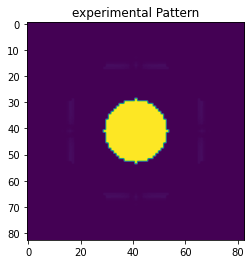

In [6]:
I = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float) 
I = I.reshape(1,Nx,Nx,1)
print('the shape of the experimental pattern: ',I.shape)
print(I.max())

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)

nlogf_I = nlogf(I)
plt.imshow(nlogf_I[0])
plt.title('experimental Pattern')

______________________________________________________________________________________________________________

# II. Determine the initial scale used for deviation

In [7]:
# divere_Ug_t function: used to diverse the origin Ug or t
def diverse_Ug_t(origin_Ug_t, scale_Ug=0.01, scale_t=0.001):
    '''
    origin_Ug_t: Input
    scale_Ug: the scale used to diverse the Structure factors
    scale_t: the scale used to diverse the Thickness   
    '''
    
    Ug_t_diverse = copy.deepcopy(origin_Ug_t)
    
    if scale_t:
        offset_t = (np.random.random()*2-1)*scale_t
        print('The offset applied on thickness: {}\n'.format(offset_t))
        Ug_t_diverse[-1] += offset_t
        
    if scale_Ug:
        offset_Ug = (np.random.random()*2-1)*scale_Ug
        print('The offset applied on Ug: {}\n'.format(offset_Ug))
        
        for j in range(len(Ug_t_diverse)-1):            
            # for real part of Ug    
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_diverse[j] += offset_Ug*(Ug_t_diverse[j]**2 + Ug_t_diverse[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_diverse[j] += offset_Ug*(Ug_t_diverse[j-1]**2 + Ug_t_diverse[j]**2)
    
    return Ug_t_diverse    

In [8]:
# calculate_R function: used to calculate the value of R_factor
def calculate_R(I_exp, I_sim):
    return np.sum(np.abs(I_sim - I_exp)) / np.sum(I_exp)

1. only diverse Ug, keep t unchanged, to determine the initial scale applied on Ug

The offset applied on Ug: 0.0004060172871373502

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18355268+0.00000e+00j 0.00046145-4

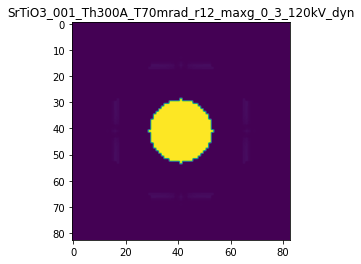

R factor: 2.4820630980416364e-09



In [9]:
Ug_t_diverse = diverse_Ug_t(Ug_t, scale_Ug=0.01, scale_t=0)
    
# normalization
Ug_diverse = np.array(range( np.int((Ug_t_diverse.size - 1)/2) ), dtype=complex)
Ug_diverse.real = Ug_t_diverse[0:-1:2]
Ug_diverse.imag = Ug_t_diverse[1:-1:2]
Ug_diverse_normalized = nf.normalization(file=File, origin_Ug=Ug_diverse)
Ug_diverse_normalized = np.asarray(Ug_diverse_normalized)

# reshape
Ug_diverse_normalized_2real = np.concatenate((np.array(Ug_diverse_normalized.real,ndmin=2).T, np.array(Ug_diverse_normalized.imag,ndmin=2).T),axis=1)  
Ug_diverse_normalized_2real = np.asarray(Ug_diverse_normalized_2real)
Ug_t_diverse_normalized_2real = np.append(Ug_diverse_normalized_2real.reshape(-1), Ug_t_diverse[-1])
    
file = File+".qed"
I_diverse = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_diverse_normalized_2real, InputUgdoFlip=False)
I_diverse = I_diverse.reshape(1,Nx,Nx,1)
#nlogf_X_sim = nlogf(X_sim)
    
R = calculate_R(I, I_diverse)
print('R factor: {}\n'.format(R))

2. only diverse t, keep Ug unchanged, to determine the initial scale applied on t

The offset applied on thickness: -0.0006487891875804861

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3512108124195
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.183539  +0.000

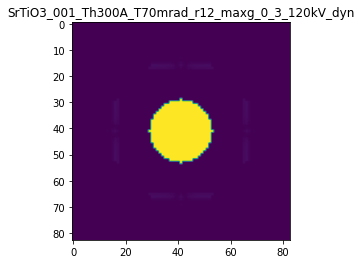

R factor: 8.161346128909238e-07



In [10]:
# diverse t, keep Ug unchanged
Ug_t_diverse = diverse_Ug_t(Ug_t, scale_Ug=0, scale_t=0.001)
    
# normalization
Ug_diverse = np.array(range( np.int((Ug_t_diverse.size - 1)/2) ), dtype=complex)
Ug_diverse.real = Ug_t_diverse[0:-1:2]
Ug_diverse.imag = Ug_t_diverse[1:-1:2]
Ug_diverse_normalized = nf.normalization(file=File, origin_Ug=Ug_diverse)
Ug_diverse_normalized = np.asarray(Ug_diverse_normalized)

# reshape
Ug_diverse_normalized_2real = np.concatenate((np.array(Ug_diverse_normalized.real,ndmin=2).T, np.array(Ug_diverse_normalized.imag,ndmin=2).T),axis=1)  
Ug_diverse_normalized_2real = np.asarray(Ug_diverse_normalized_2real)
Ug_t_diverse_normalized_2real = np.append(Ug_diverse_normalized_2real.reshape(-1), Ug_t_diverse[-1])
    
file = File+".qed"
I_diverse = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_diverse_normalized_2real, InputUgdoFlip=False)
I_diverse = I_diverse.reshape(1,Nx,Nx,1)
#nlogf_X_sim = nlogf(X_sim)
    
R = calculate_R(I, I_diverse)
print('R factor: {}\n'.format(R))

By testing, the starting scale used to diverse Ug and t are chosen to be 0.01 and 0.001, repectively.

_________________________________________________________________________________________________________________

# III. Function used to produce Datasets

The initial datasets will be generated from the Ug diversed at a scale of 0.01 and the thickness diversed at a scale of 0.001.

In [11]:
# generate_diversed_data function: used to generate datasets
def generate_diversed_data(Ug_t, scale_Ug=0.01, scale_t=0.001, data_size=140):
    '''
    data_size: total datasize, including training sets and testing sets
    origin_Ug_t: Input
    scale_Ug: the scale used to diverse the Structure factors
    scale_t: the scale used to diverse the Thickness    
    '''
    
    # labels: divered Ug_t
    y = []
    # features: diversed I
    X = []
    # R_factors
    R_factors = []

    i = 0
    while i < data_size:
        print('>>> producing the {}. dataset...\n'.format(i+1))
    
        Ug_t_diverse = diverse_Ug_t(Ug_t, scale_Ug=scale_Ug, scale_t=scale_t)
    
        # normalization
        Ug_diverse = np.array(range( np.int((Ug_t_diverse.size - 1)/2) ), dtype=complex)
        Ug_diverse.real = Ug_t_diverse[0:-1:2]
        Ug_diverse.imag = Ug_t_diverse[1:-1:2]
        Ug_diverse_normalized = nf.normalization(file=File, origin_Ug=Ug_diverse)
        Ug_diverse_normalized = np.asarray(Ug_diverse_normalized)

        # reshape
        Ug_diverse_normalized_2real = np.concatenate((np.array(Ug_diverse_normalized.real,ndmin=2).T, np.array(Ug_diverse_normalized.imag,ndmin=2).T),axis=1)  
        Ug_diverse_normalized_2real = np.asarray(Ug_diverse_normalized_2real)
        Ug_t_diverse_normalized_2real = np.append(Ug_diverse_normalized_2real.reshape(-1), Ug_t_diverse[-1])
    
        file = File+".qed"
        I_diverse = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_diverse_normalized_2real, InputUgdoFlip=False)
        I_diverse = I_diverse.reshape(1,Nx,Nx,1)
    
        y = np.append(y, Ug_t_diverse)
        X = np.append(X, I_diverse)
    
        R = calculate_R(I, I_diverse)
        print('R-factor: {}\n'.format(R))
        R_factors = np.append(R_factors, R)
    
        i += 1

    y = (np.asarray(y)).reshape(data_size, 2*numUg+1)
    X = (np.asarray(X)).reshape(data_size,Nx,Nx,1)
    R_factors = np.asarray(R_factors)
    
    # plot the R-factors 
    plt.figure(figsize=(12,8))
    plt.plot(R_factors[:])
    plt.title('R_factors (experimental pattern v.s. deviated pattern) at a scale of {}'.format(scale_Ug))
    plt.ylabel('R_factor')
    plt.xlabel('Dataset')
    plt.show()
    plt.close()
    
    return X, y, R_factors

---------------------------------------------------------------------------------------------------------------

# IV. Build CNN

In [12]:
backend.clear_session()

num_of_targets = 2*numUg+1

# invert the Input to the form which can be used in the ResNet50 Model
target_size = I.shape[1:3]
input_size = (*target_size, 3)

# insert ResNet50 Model
base_model = applications.ResNet50(include_top=False, weights='imagenet', input_shape=input_size)  

# combine the ResNet50 model with my model
x = Flatten()(base_model.output)
x = Dense(num_of_targets*16, activation='tanh')(x)
x = Dense(num_of_targets*4, activation='tanh')(x)
x = Dense(num_of_targets, activation='tanh')(x)
x = Dense(num_of_targets, activation='tanh')(x)
model = Model(inputs=base_model.input, outputs=x)

# remove the output layer and replaced it with the regression output layer we want in ResNet50
# keep the weights of the first 49 layers of the ResNet50 model unchanged during the training process 
for layer in base_model.layers[:-1]:
    layer.trainable = False

model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 83, 83, 3)]  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 89, 89, 3)    0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 42, 42, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 42, 42, 64)   256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [13]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name+'.h5')

_________________________________________________________________________________________________________________

# V. Training


-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.01

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0007352702308489128

The offset applied on Ug: 0.005518552247645942

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickne

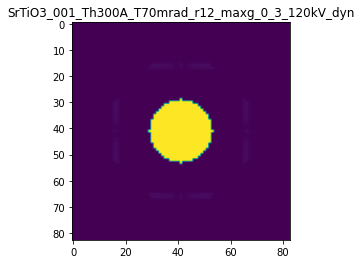

R-factor: 9.261851630377675e-07

>>> producing the 2. dataset...

The offset applied on thickness: -0.00015529136575406156

The offset applied on Ug: -0.0030685251862846365

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84470863424593
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

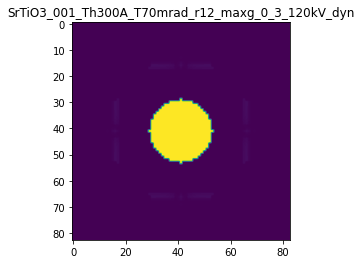

R-factor: 1.9888038960783045e-07

>>> producing the 3. dataset...

The offset applied on thickness: 0.0005834409643017279

The offset applied on Ug: 0.0030538785837333536

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5834409643017
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

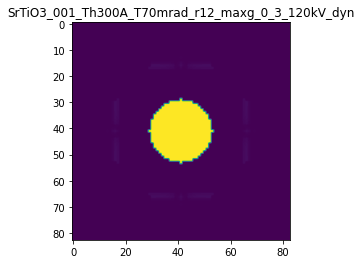

R-factor: 7.38407482661696e-07

>>> producing the 4. dataset...

The offset applied on thickness: 0.0004927080228116827

The offset applied on Ug: 0.004534680499315811

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4927080228117
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

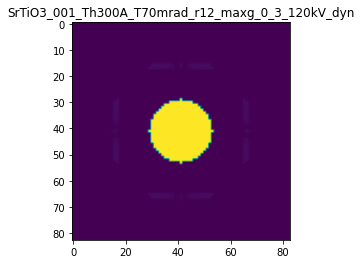

R-factor: 6.254089062883466e-07

>>> producing the 5. dataset...

The offset applied on thickness: 0.000683525473835688

The offset applied on Ug: 0.00035926621350012677

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6835254738357
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

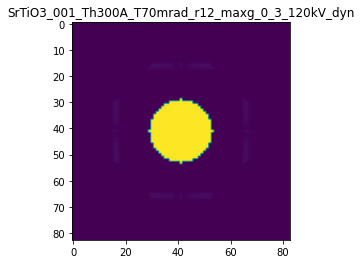

R-factor: 8.620954342312187e-07

>>> producing the 6. dataset...

The offset applied on thickness: 0.0008549481989670964

The offset applied on Ug: -0.007661392437820693

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.85494819896707
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

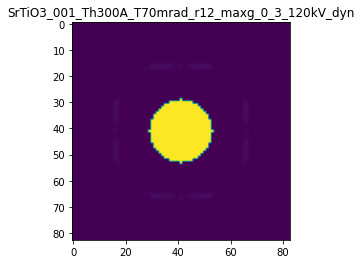

R-factor: 1.0804348072856987e-06

>>> producing the 7. dataset...

The offset applied on thickness: -0.00047738369237653534

The offset applied on Ug: -0.00627992155696836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5226163076234
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

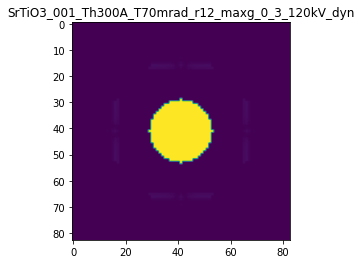

R-factor: 6.066822335469031e-07

>>> producing the 8. dataset...

The offset applied on thickness: -2.7882124211975112e-05

The offset applied on Ug: -0.008860955812487773

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97211787578806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

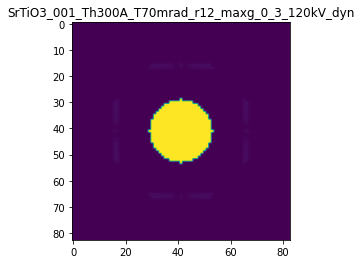

R-factor: 6.100401682327224e-08

>>> producing the 9. dataset...

The offset applied on thickness: 0.0009179364452067547

The offset applied on Ug: 0.008233242687721892

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91793644520675
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

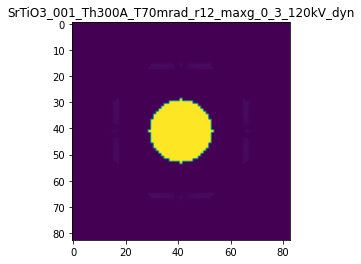

R-factor: 1.1659420683386902e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.00036728277953310373

The offset applied on Ug: 0.005161682321175649

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3672827795331
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

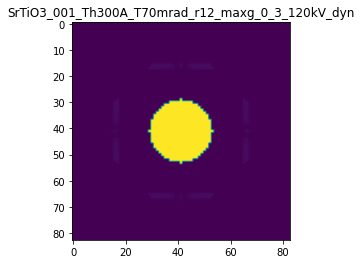

R-factor: 4.680955388750929e-07

>>> producing the 11. dataset...

The offset applied on thickness: -0.00036358127203411564

The offset applied on Ug: -0.00882661328414788

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63641872796586
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

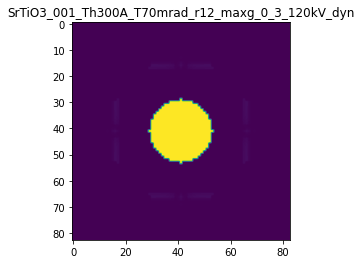

R-factor: 4.677415836024381e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.0002589959555285601

The offset applied on Ug: -0.008837330544908251

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2589959555286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

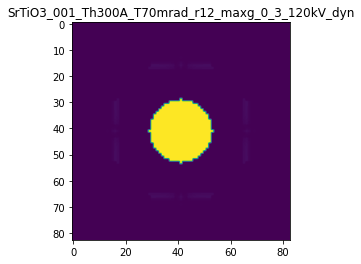

R-factor: 3.3594734808299843e-07

>>> producing the 13. dataset...

The offset applied on thickness: 0.00011659454573538542

The offset applied on Ug: 0.005896397595596457

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1165945457354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

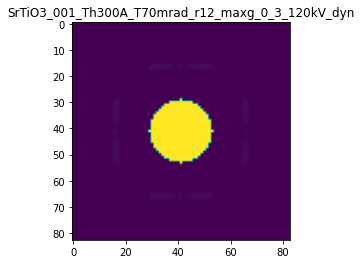

R-factor: 1.544870520125674e-07

>>> producing the 14. dataset...

The offset applied on thickness: -0.0009908204472470826

The offset applied on Ug: -0.009020599421323465

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0091795527529
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

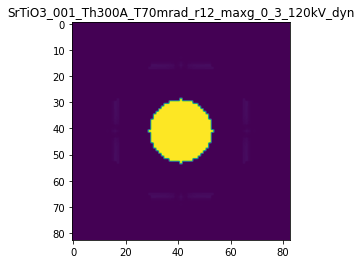

R-factor: 1.2536128009642433e-06

>>> producing the 15. dataset...

The offset applied on thickness: -0.000754435893105958

The offset applied on Ug: 0.007856006966062541

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.245564106894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

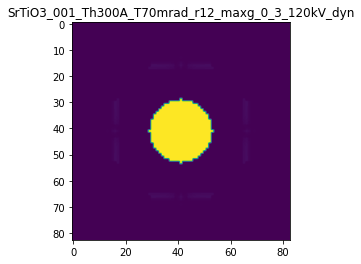

R-factor: 9.50858308829866e-07

>>> producing the 16. dataset...

The offset applied on thickness: -0.0003737206845140331

The offset applied on Ug: -0.0001675127981072433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.626279315486
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

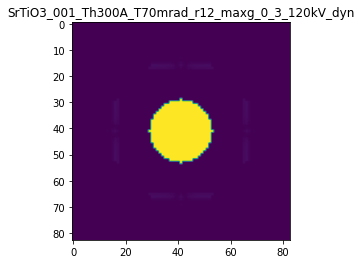

R-factor: 4.703636584606194e-07

>>> producing the 17. dataset...

The offset applied on thickness: 8.373437692142782e-05

The offset applied on Ug: -0.007400403860663651

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0837343769214
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

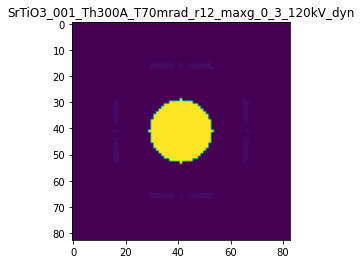

R-factor: 1.2485833278750067e-07

>>> producing the 18. dataset...

The offset applied on thickness: 0.0005780912059922246

The offset applied on Ug: 0.00936241857387638

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5780912059922
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

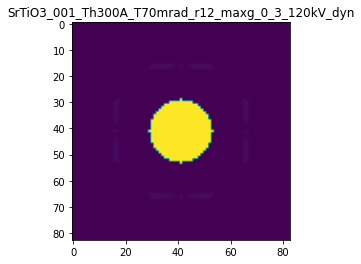

R-factor: 7.387575534638019e-07

>>> producing the 19. dataset...

The offset applied on thickness: -0.0001894415153170288

The offset applied on Ug: 0.0019275993427130156

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.810558484683
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

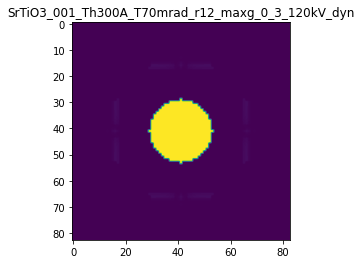

R-factor: 2.3897653349960244e-07

>>> producing the 20. dataset...

The offset applied on thickness: 0.0008004991668559034

The offset applied on Ug: 0.009826418838341759

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8004991668559
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

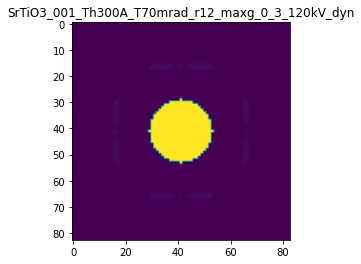

R-factor: 1.019151493230155e-06

>>> producing the 21. dataset...

The offset applied on thickness: 0.0006590903644613095

The offset applied on Ug: 0.0052641225023955475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6590903644613
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

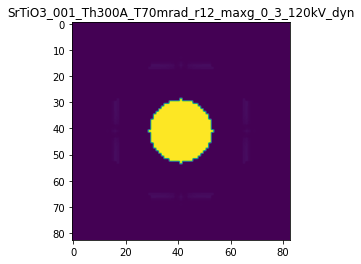

R-factor: 8.360775007196675e-07

>>> producing the 22. dataset...

The offset applied on thickness: -0.0006476843956190224

The offset applied on Ug: 0.006656396186374891

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.352315604381
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

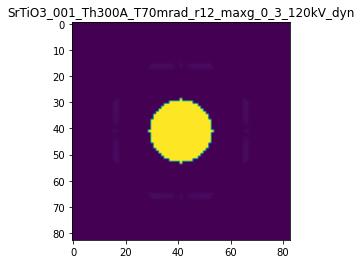

R-factor: 8.164493207500297e-07

>>> producing the 23. dataset...

The offset applied on thickness: -0.0004100268305419441

The offset applied on Ug: 0.007012866792734773

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58997316945806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

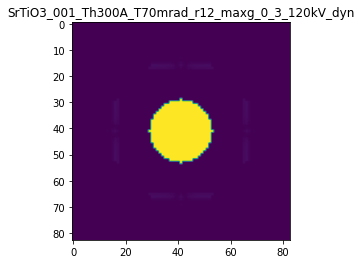

R-factor: 5.194929581421818e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0005552983451635252

The offset applied on Ug: -0.0059895399337277985

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5552983451635
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

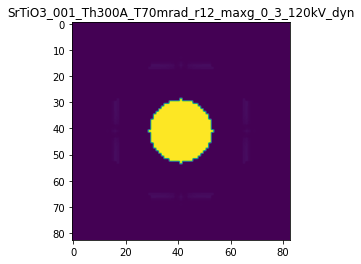

R-factor: 7.016274238332205e-07

>>> producing the 25. dataset...

The offset applied on thickness: 0.0004612681844938846

The offset applied on Ug: 0.0005436123969845031

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46126818449386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

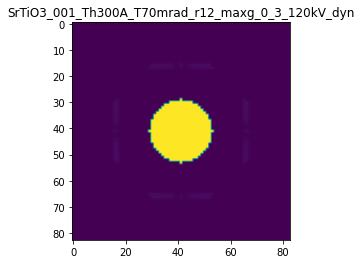

R-factor: 5.817981494601114e-07

>>> producing the 26. dataset...

The offset applied on thickness: 0.0009497306481187917

The offset applied on Ug: 0.0034844328063706785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9497306481188
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

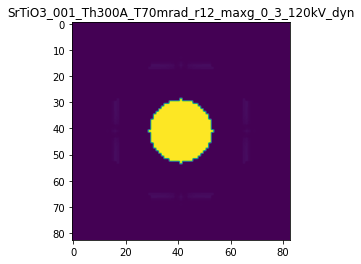

R-factor: 1.201414222803202e-06

>>> producing the 27. dataset...

The offset applied on thickness: 0.0006609278535023325

The offset applied on Ug: 0.0004903093809272785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66092785350236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

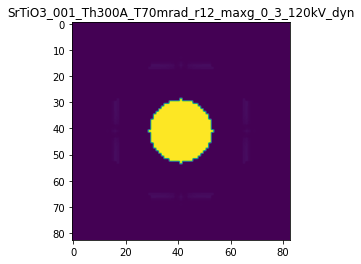

R-factor: 8.336625143754945e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.00013007692982749776

The offset applied on Ug: -0.0033772064724814977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8699230701725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

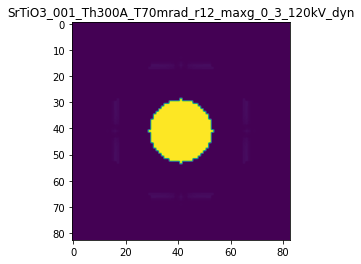

R-factor: 1.677047839475704e-07

>>> producing the 29. dataset...

The offset applied on thickness: 0.0003262113277479719

The offset applied on Ug: -0.009646588880177371

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32621132774796
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

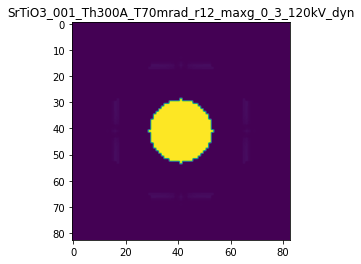

R-factor: 4.202656957028354e-07

>>> producing the 30. dataset...

The offset applied on thickness: -0.0004731417668930038

The offset applied on Ug: -0.0036405102302035485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52685823310696
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

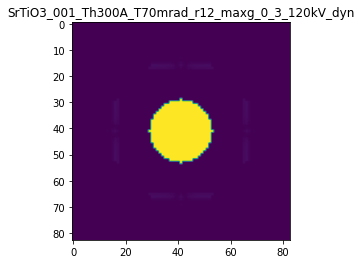

R-factor: 5.985867092016537e-07

>>> producing the 31. dataset...

The offset applied on thickness: -0.0004483811318031674

The offset applied on Ug: 0.001116485941753025

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5516188681968
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

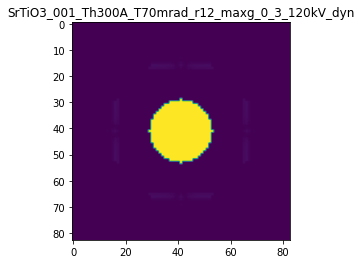

R-factor: 5.645124781686361e-07

>>> producing the 32. dataset...

The offset applied on thickness: -4.184334613429552e-05

The offset applied on Ug: -0.008856620272185879

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95815665386573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

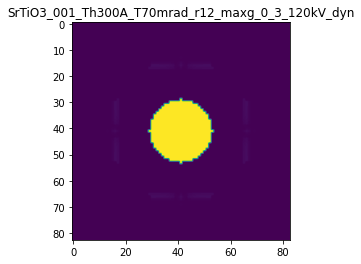

R-factor: 7.110591465730188e-08

>>> producing the 33. dataset...

The offset applied on thickness: -0.0009777974451239655

The offset applied on Ug: 0.005142756666769106

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02220255487606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

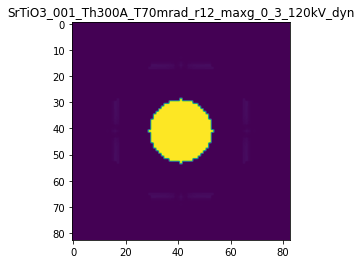

R-factor: 1.2305793819128415e-06

>>> producing the 34. dataset...

The offset applied on thickness: 0.0009377855820911483

The offset applied on Ug: -0.002820349616306559

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9377855820911
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

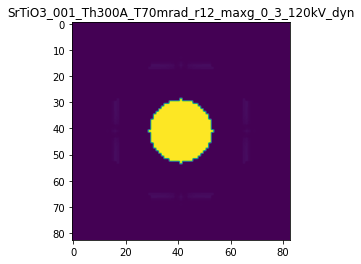

R-factor: 1.1838250501984529e-06

>>> producing the 35. dataset...

The offset applied on thickness: 0.00017067217625051746

The offset applied on Ug: -0.005800156029048757

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1706721762505
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

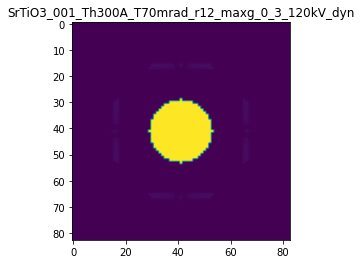

R-factor: 2.2129706117307912e-07

>>> producing the 36. dataset...

The offset applied on thickness: -0.0007756936955872213

The offset applied on Ug: -0.0045637472910548165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2243063044128
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

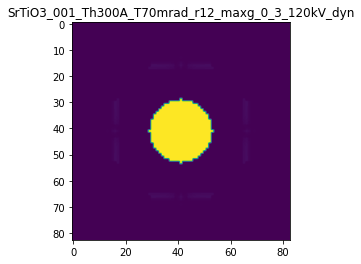

R-factor: 9.794417660187245e-07

>>> producing the 37. dataset...

The offset applied on thickness: -0.0008977465036802128

The offset applied on Ug: -0.00815327318091786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1022534963198
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

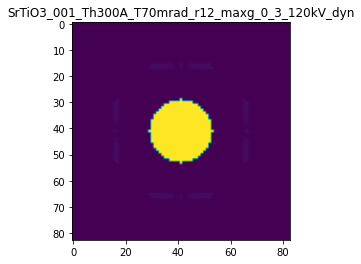

R-factor: 1.1360397973085322e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.0009535406132567146

The offset applied on Ug: -0.0019389345980713958

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04645938674327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

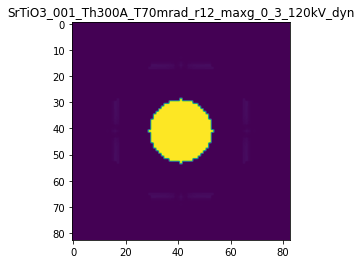

R-factor: 1.2000591793334614e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0008093634346065354

The offset applied on Ug: 0.006010726891327374

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8093634346065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

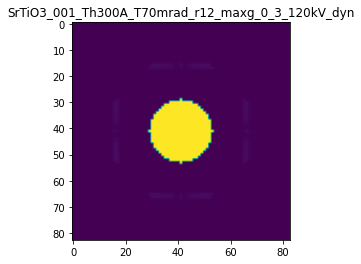

R-factor: 1.0265698707149257e-06

>>> producing the 40. dataset...

The offset applied on thickness: 0.0006238759822474201

The offset applied on Ug: 0.0008437126505450454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.62387598224745
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

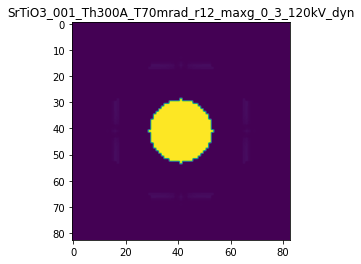

R-factor: 7.872416652646079e-07

>>> producing the 41. dataset...

The offset applied on thickness: 0.0005779713706320042

The offset applied on Ug: 0.003237660852806803

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.577971370632
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

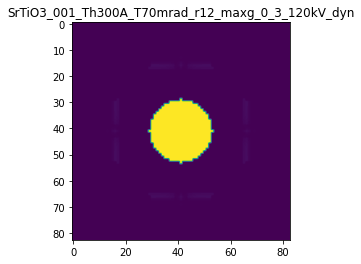

R-factor: 7.316885479258713e-07

>>> producing the 42. dataset...

The offset applied on thickness: -0.00015331245391773707

The offset applied on Ug: 0.005473737156327028

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84668754608225
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

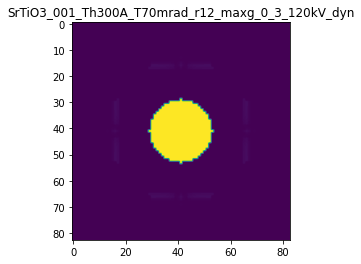

R-factor: 1.9923698048809337e-07

>>> producing the 43. dataset...

The offset applied on thickness: -0.0006019981280705534

The offset applied on Ug: -0.0005937642493102557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.39800187192947
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

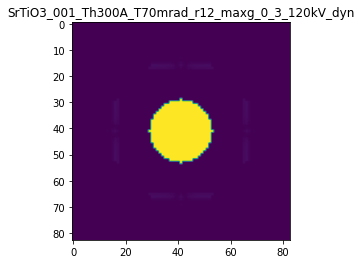

R-factor: 7.57548556799239e-07

>>> producing the 44. dataset...

The offset applied on thickness: 0.00025376520538723547

The offset applied on Ug: -0.002881176029200516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2537652053872
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

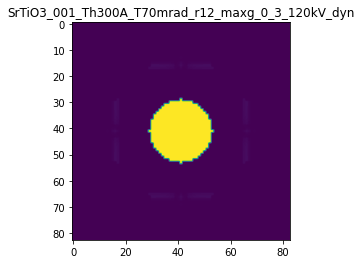

R-factor: 3.2050896493382783e-07

>>> producing the 45. dataset...

The offset applied on thickness: -0.0007909426208936519

The offset applied on Ug: -0.0026966287652573253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.20905737910635
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

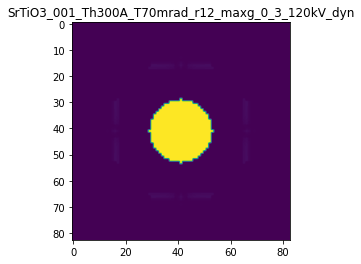

R-factor: 9.967876216509586e-07

>>> producing the 46. dataset...

The offset applied on thickness: 0.000777629793160951

The offset applied on Ug: -0.00960508400221284

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.77762979316094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

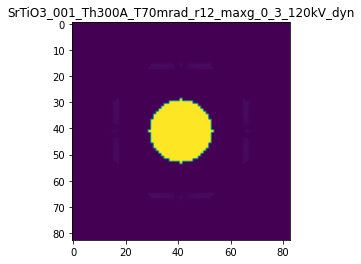

R-factor: 9.83276693224835e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0005227521536169859

The offset applied on Ug: -0.0013510161692889455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.522752153617
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

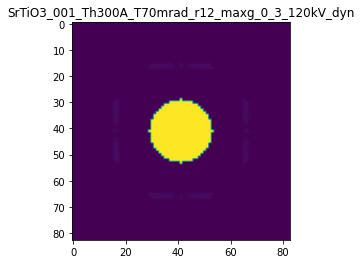

R-factor: 6.593461555393474e-07

>>> producing the 48. dataset...

The offset applied on thickness: 0.00016945027910040443

The offset applied on Ug: -0.008812589287709552

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16945027910043
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

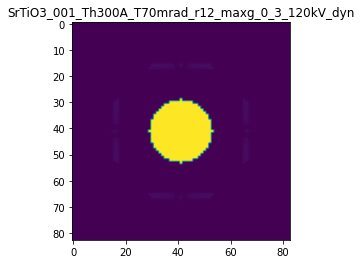

R-factor: 2.2855251223102778e-07

>>> producing the 49. dataset...

The offset applied on thickness: 3.871069388399073e-05

The offset applied on Ug: 0.004223388846136207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.038710693884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

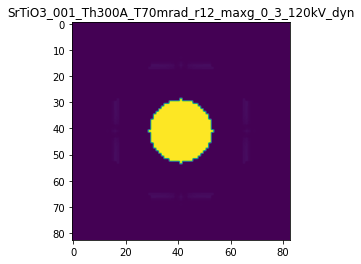

R-factor: 5.527871189615245e-08

>>> producing the 50. dataset...

The offset applied on thickness: 0.0005210722598368629

The offset applied on Ug: 0.0021274179594338396

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5210722598369
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

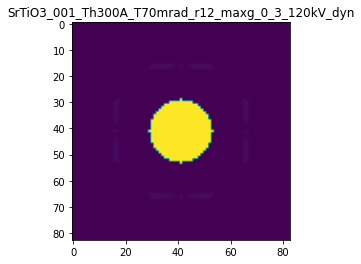

R-factor: 6.587957476746134e-07

>>> producing the 51. dataset...

The offset applied on thickness: -0.0003470582805786597

The offset applied on Ug: 0.008069926204741559

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6529417194213
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

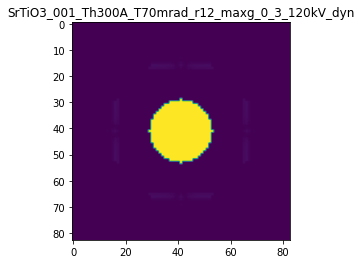

R-factor: 4.4289030637461516e-07

>>> producing the 52. dataset...

The offset applied on thickness: -0.0006753584414670884

The offset applied on Ug: 0.008406685050909983

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3246415585329
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

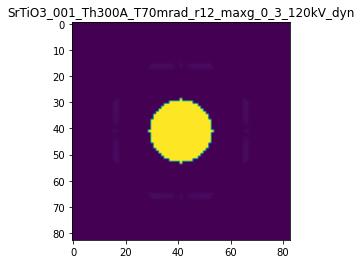

R-factor: 8.51736113393045e-07

>>> producing the 53. dataset...

The offset applied on thickness: 0.0006311998599504957

The offset applied on Ug: 0.0028409779070626274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.63119985995047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

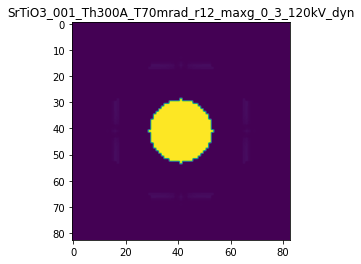

R-factor: 7.98467541829163e-07

>>> producing the 54. dataset...

The offset applied on thickness: 0.0006019312263334882

The offset applied on Ug: -0.006715118592471567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6019312263335
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

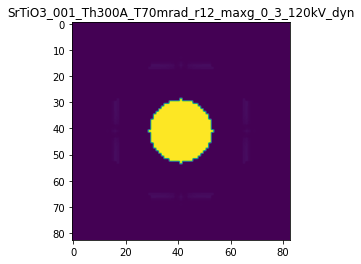

R-factor: 7.60673923043983e-07

>>> producing the 55. dataset...

The offset applied on thickness: -7.34708513315796e-05

The offset applied on Ug: -0.0006236404119803885

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9265291486684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

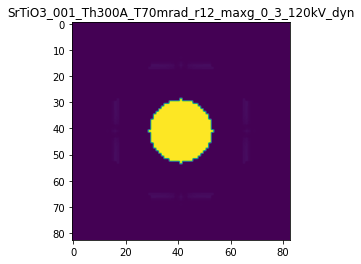

R-factor: 9.305962555235157e-08

>>> producing the 56. dataset...

The offset applied on thickness: -0.00016820855798768043

The offset applied on Ug: 0.00030401926256470315

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83179144201233
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

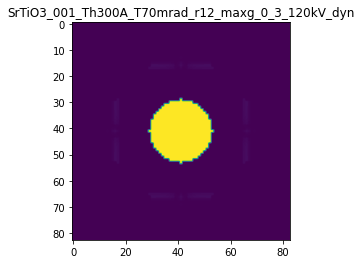

R-factor: 2.118318077300139e-07

>>> producing the 57. dataset...

The offset applied on thickness: -0.0005019113850450335

The offset applied on Ug: -0.0021981220076236776

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.49808861495495
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

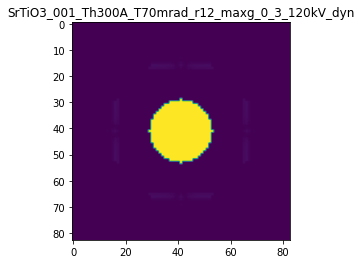

R-factor: 6.333531626167486e-07

>>> producing the 58. dataset...

The offset applied on thickness: -0.0008113597666858261

The offset applied on Ug: -0.00046442265518924496

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1886402333142
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

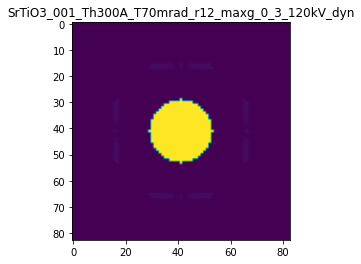

R-factor: 1.020399751551394e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.00080557760476924

The offset applied on Ug: 5.974576826737854e-05

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19442239523073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

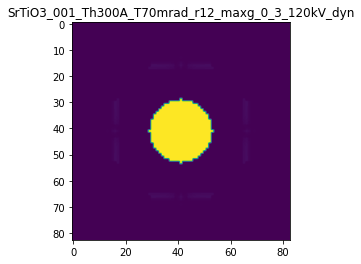

R-factor: 1.0130957618899035e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.0008599775221946009

The offset applied on Ug: 0.004110304833919882

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8599775221946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

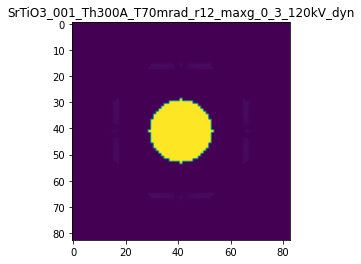

R-factor: 1.0886236904027652e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.00043781082199422937

The offset applied on Ug: 0.003016424382094889

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4378108219942
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

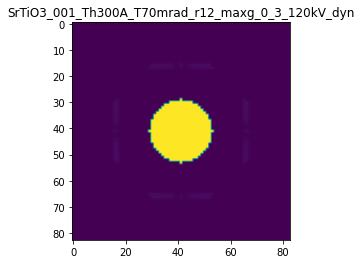

R-factor: 5.546601350317872e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.00023482714219216706

The offset applied on Ug: -0.0031790447095229202

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76517285780784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

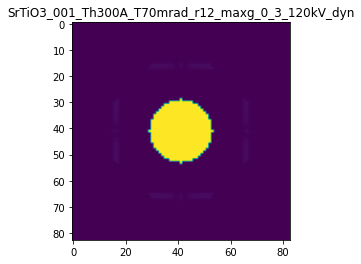

R-factor: 2.986925188101379e-07

>>> producing the 63. dataset...

The offset applied on thickness: 2.244761880734014e-05

The offset applied on Ug: 0.0010943515144470183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0224476188073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

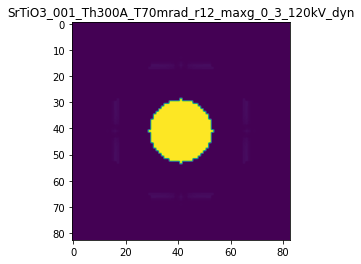

R-factor: 2.970548567875485e-08

>>> producing the 64. dataset...

The offset applied on thickness: 0.0007297376156930149

The offset applied on Ug: -0.001574134656172741

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.729737615693
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

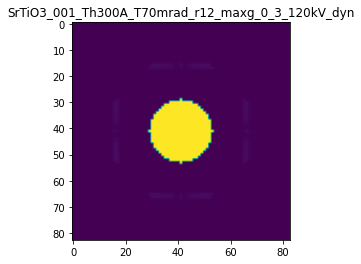

R-factor: 9.20679082322225e-07

>>> producing the 65. dataset...

The offset applied on thickness: -8.712160524393386e-07

The offset applied on Ug: -0.00013583309362925845

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9991287839475
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

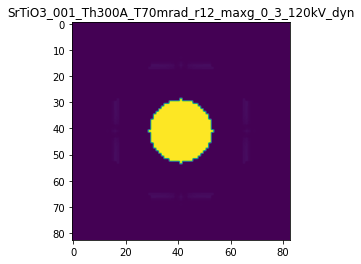

R-factor: 1.2979836274964772e-09

>>> producing the 66. dataset...

The offset applied on thickness: 0.0004887603209389564

The offset applied on Ug: -0.008974006954330848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.488760320939
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

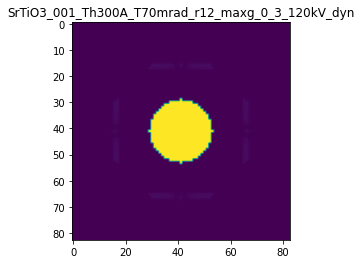

R-factor: 6.210029141785316e-07

>>> producing the 67. dataset...

The offset applied on thickness: 0.0007173759580595462

The offset applied on Ug: -0.003607882142090637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7173759580595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

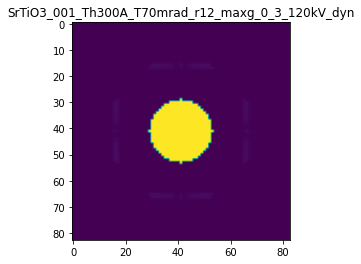

R-factor: 9.056055915824784e-07

>>> producing the 68. dataset...

The offset applied on thickness: -0.00043557669860979823

The offset applied on Ug: 0.00037041195908394054

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5644233013902
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

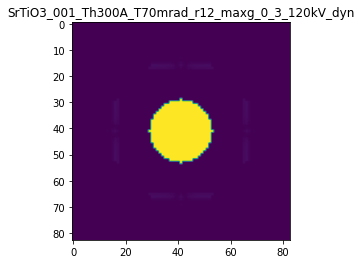

R-factor: 5.482211145459363e-07

>>> producing the 69. dataset...

The offset applied on thickness: -0.00013190986659366576

The offset applied on Ug: -0.002840171902317303

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8680901334063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

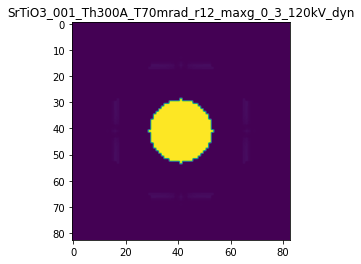

R-factor: 1.6926149676160557e-07

>>> producing the 70. dataset...

The offset applied on thickness: 0.000851036253688744

The offset applied on Ug: 0.007091543557525038

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.85103625368873
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

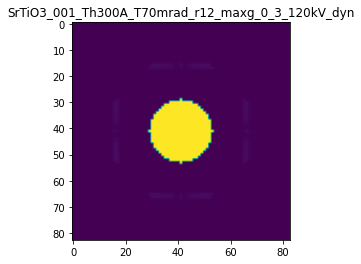

R-factor: 1.080282875916047e-06

>>> producing the 71. dataset...

The offset applied on thickness: -0.000513335059261055

The offset applied on Ug: 0.0036893923889686465

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.48666494073893
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

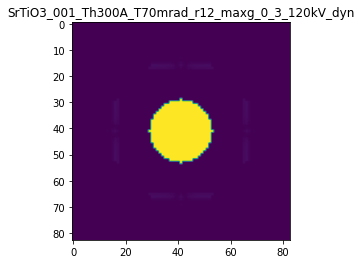

R-factor: 6.468369326343581e-07

>>> producing the 72. dataset...

The offset applied on thickness: -0.0006907683092779135

The offset applied on Ug: 0.0001499328238627551

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3092316907221
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

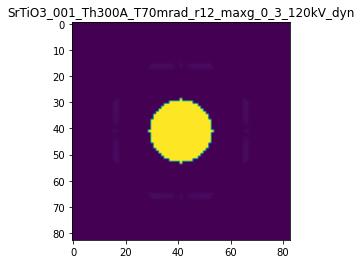

R-factor: 8.689151232643705e-07

>>> producing the 73. dataset...

The offset applied on thickness: 0.0002132810924790216

The offset applied on Ug: 0.0032860920252996274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.213281092479
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

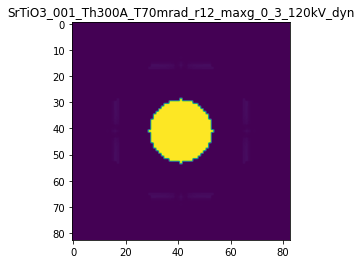

R-factor: 2.7214996301979626e-07

>>> producing the 74. dataset...

The offset applied on thickness: -0.0009070769142953969

The offset applied on Ug: -0.006533487534324014

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09292308570457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

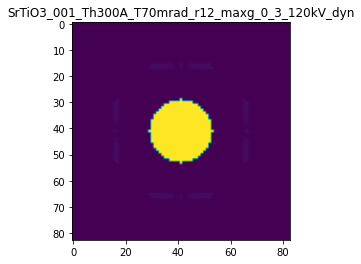

R-factor: 1.1461877338158638e-06

>>> producing the 75. dataset...

The offset applied on thickness: -0.00021705926844393342

The offset applied on Ug: 0.006175762489777772

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78294073155604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

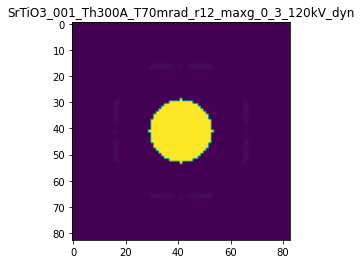

R-factor: 2.7891211123982264e-07

>>> producing the 76. dataset...

The offset applied on thickness: -0.0007962136898794676

The offset applied on Ug: 0.009809959570931052

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2037863101205
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

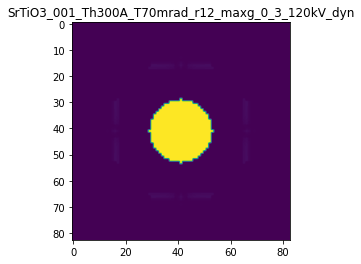

R-factor: 1.0038272877817932e-06

>>> producing the 77. dataset...

The offset applied on thickness: -0.0005649499025510789

The offset applied on Ug: 0.00042744096436668987

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43505009744894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

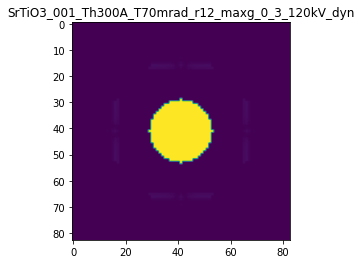

R-factor: 7.108823952206254e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.0008770598966887038

The offset applied on Ug: 0.0017354519752834864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87705989668865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

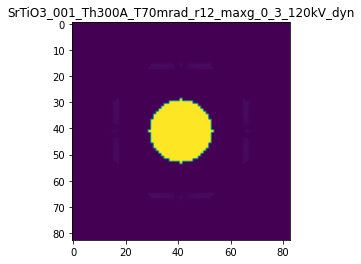

R-factor: 1.1078488898723419e-06

>>> producing the 79. dataset...

The offset applied on thickness: -0.0005262576888846673

The offset applied on Ug: -0.006547146095442973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.47374231111536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

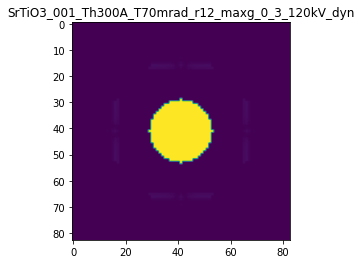

R-factor: 6.68209435843628e-07

>>> producing the 80. dataset...

The offset applied on thickness: -0.000780968356780654

The offset applied on Ug: 0.008575605091590593

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21903164321935
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

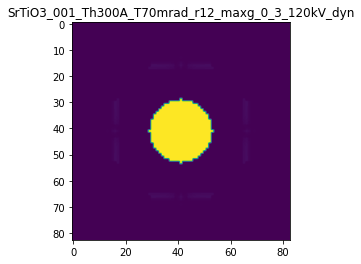

R-factor: 9.84364730632148e-07

>>> producing the 81. dataset...

The offset applied on thickness: -0.0007321019252526331

The offset applied on Ug: -0.009052685490929031

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26789807474734
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

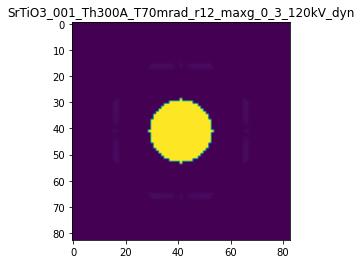

R-factor: 9.291250741458459e-07

>>> producing the 82. dataset...

The offset applied on thickness: 0.0002358852731146941

The offset applied on Ug: -0.009354750319167363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23588527311466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

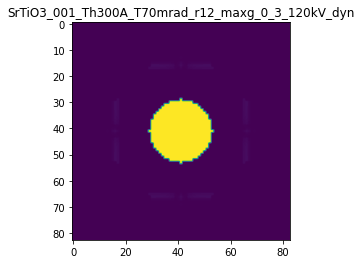

R-factor: 3.095411546599483e-07

>>> producing the 83. dataset...

The offset applied on thickness: 0.00019214309831431508

The offset applied on Ug: 0.006427576358677105

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1921430983143
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

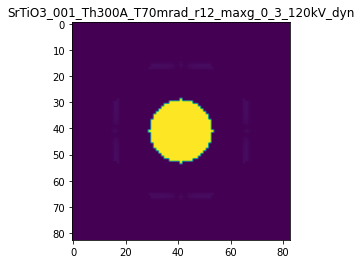

R-factor: 2.4995061896741073e-07

>>> producing the 84. dataset...

The offset applied on thickness: -0.0008740172247173764

The offset applied on Ug: -0.00791342930851057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12598277528264
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

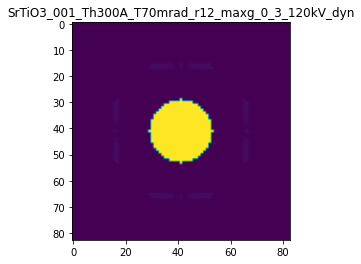

R-factor: 1.1060397883034176e-06

>>> producing the 85. dataset...

The offset applied on thickness: 0.00027517152895600996

The offset applied on Ug: 0.005334839666410391

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.275171528956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

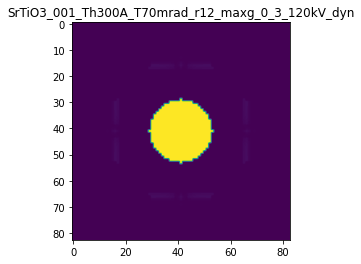

R-factor: 3.526652960598292e-07

>>> producing the 86. dataset...

The offset applied on thickness: 0.0008274599270571819

The offset applied on Ug: 0.006099298947525143

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8274599270572
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

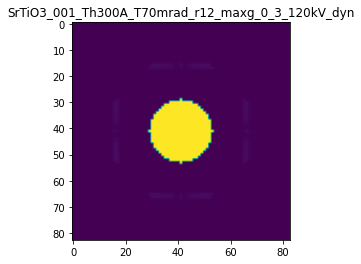

R-factor: 1.0495164872352008e-06

>>> producing the 87. dataset...

The offset applied on thickness: 0.0004372690079090722

The offset applied on Ug: -0.004766345873813749

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4372690079091
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

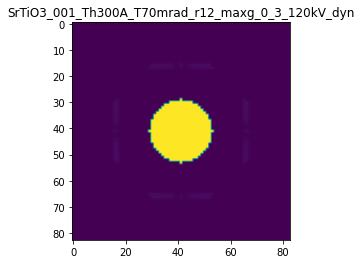

R-factor: 5.523901155963772e-07

>>> producing the 88. dataset...

The offset applied on thickness: 0.0003884759532935498

The offset applied on Ug: -0.007414320419826585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38847595329355
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

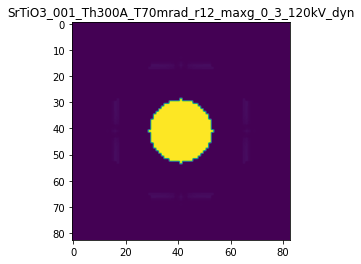

R-factor: 4.938263567462767e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.0006371956344683007

The offset applied on Ug: -0.003276314576738353

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3628043655317
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

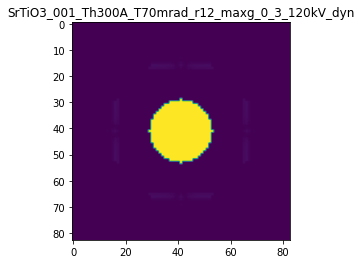

R-factor: 8.043274039756172e-07

>>> producing the 90. dataset...

The offset applied on thickness: 0.0008929593211581562

The offset applied on Ug: 0.003055431197800933

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8929593211582
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

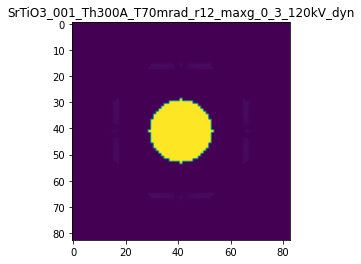

R-factor: 1.1292479909999014e-06

>>> producing the 91. dataset...

The offset applied on thickness: -0.0007504534792490765

The offset applied on Ug: -0.007568214062506191

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2495465207509
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

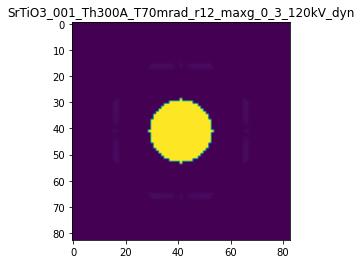

R-factor: 9.506487133272634e-07

>>> producing the 92. dataset...

The offset applied on thickness: -0.00019515507252964272

The offset applied on Ug: -0.004985896649765478

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80484492747036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

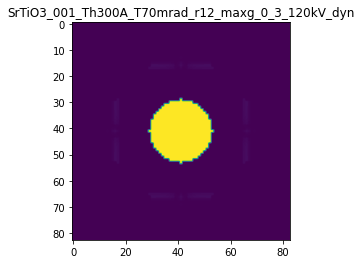

R-factor: 2.5147931687034544e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.00012572799254350998

The offset applied on Ug: -0.007776745582610885

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87427200745645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

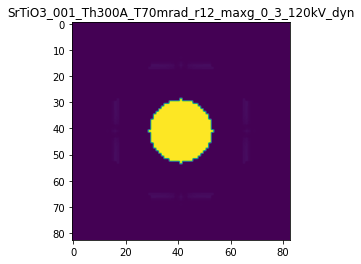

R-factor: 1.6876049868002443e-07

>>> producing the 94. dataset...

The offset applied on thickness: 0.0008237527988243429

The offset applied on Ug: 0.00822209328082435

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82375279882433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

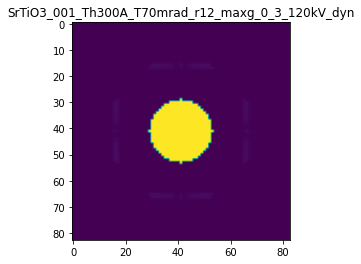

R-factor: 1.0469362875442292e-06

>>> producing the 95. dataset...

The offset applied on thickness: -0.000756696585127176

The offset applied on Ug: 0.008438427159175433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2433034148728
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

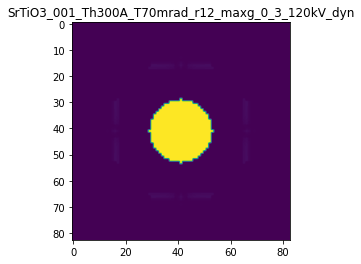

R-factor: 9.538476605586766e-07

>>> producing the 96. dataset...

The offset applied on thickness: -0.00017371376422826957

The offset applied on Ug: 0.004148380914587016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.82628623577176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

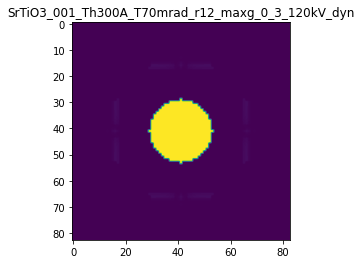

R-factor: 2.219204544926348e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.0001791885142411498

The offset applied on Ug: 0.004464429113169211

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17918851424116
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

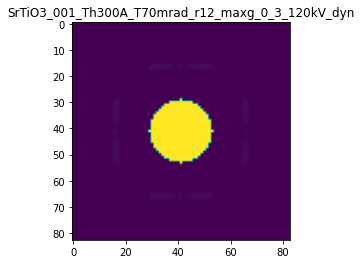

R-factor: 2.3098243419623105e-07

>>> producing the 98. dataset...

The offset applied on thickness: -1.727631108293992e-05

The offset applied on Ug: 0.00974361053877568

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.982723688917
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

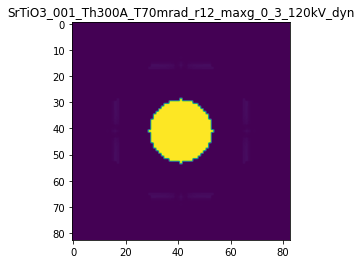

R-factor: 7.146189913116194e-08

>>> producing the 99. dataset...

The offset applied on thickness: -0.0006298423575778942

The offset applied on Ug: 0.0008020574593606123

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3701576424221
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

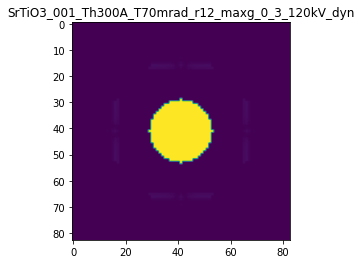

R-factor: 7.925302110370521e-07

>>> producing the 100. dataset...

The offset applied on thickness: -6.317918508149889e-06

The offset applied on Ug: 0.0039622269803214994

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99368208149184
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

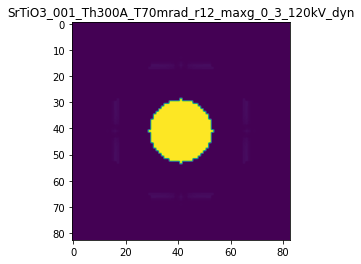

R-factor: 2.8504229324441146e-08

>>> producing the 101. dataset...

The offset applied on thickness: 0.0004086070826669368

The offset applied on Ug: -0.0056732915034917045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40860708266695
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

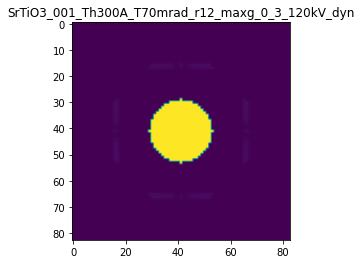

R-factor: 5.170053410223393e-07

>>> producing the 102. dataset...

The offset applied on thickness: 6.756495844882404e-05

The offset applied on Ug: 0.009113109142183658

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0675649584488
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

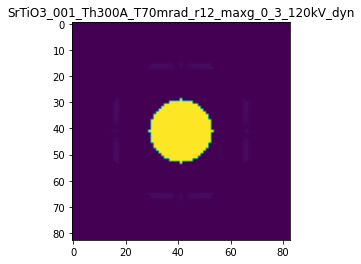

R-factor: 9.972828244914132e-08

>>> producing the 103. dataset...

The offset applied on thickness: 0.0007013400297757857

The offset applied on Ug: -0.00674803727808833

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7013400297758
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

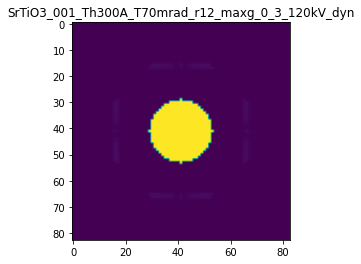

R-factor: 8.861814258541015e-07

>>> producing the 104. dataset...

The offset applied on thickness: 0.00033254237195120905

The offset applied on Ug: -0.0015885656428830553

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33254237195115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

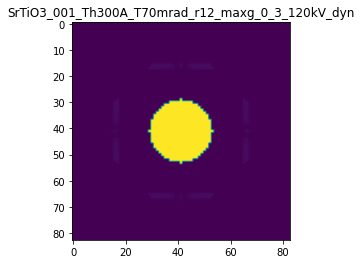

R-factor: 4.1948593674731476e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.00022765729231474352

The offset applied on Ug: -0.0037159941073082715

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.77234270768525
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal

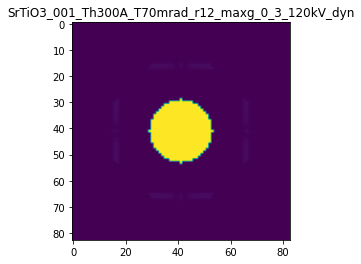

R-factor: 2.9045042556055213e-07

>>> producing the 106. dataset...

The offset applied on thickness: -0.0005734894037328777

The offset applied on Ug: 0.00775987164245116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4265105962671
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

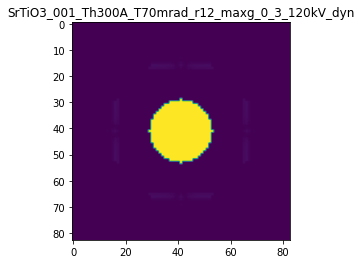

R-factor: 7.24089314723658e-07

>>> producing the 107. dataset...

The offset applied on thickness: -0.0008097239204681736

The offset applied on Ug: 0.009688464497058909

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1902760795318
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

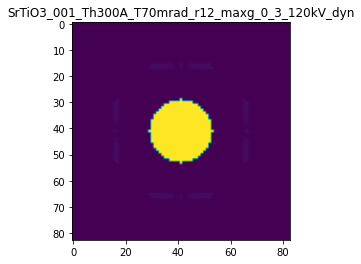

R-factor: 1.0207604088784418e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.0004745728233584554

The offset applied on Ug: -0.0015170958107473599

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4745728233584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

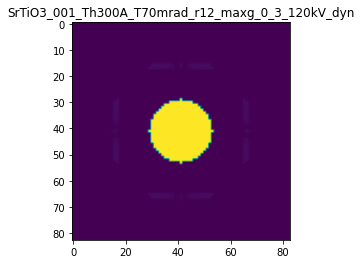

R-factor: 5.98601098522706e-07

>>> producing the 109. dataset...

The offset applied on thickness: -3.076659984049912e-05

The offset applied on Ug: 0.004812386791284797

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96923340015945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

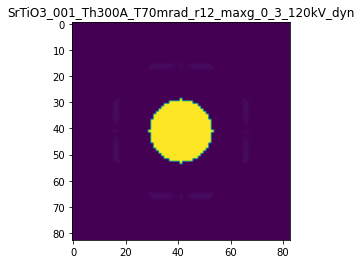

R-factor: 5.5686457143285625e-08

>>> producing the 110. dataset...

The offset applied on thickness: -0.00014937874797959184

The offset applied on Ug: 0.003780028190010634

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8506212520204
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

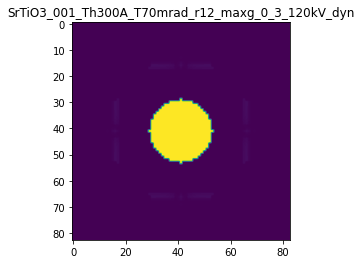

R-factor: 1.9118804808830495e-07

>>> producing the 111. dataset...

The offset applied on thickness: 6.358663965769785e-05

The offset applied on Ug: -0.002741683182539809

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06358663965773
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

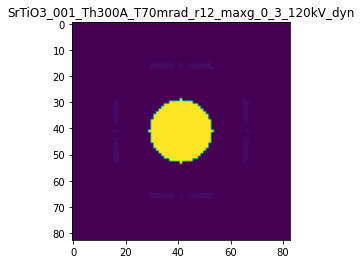

R-factor: 8.408037986266057e-08

>>> producing the 112. dataset...

The offset applied on thickness: -0.0006693125735122489

The offset applied on Ug: -0.0021231398562345082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3306874264877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

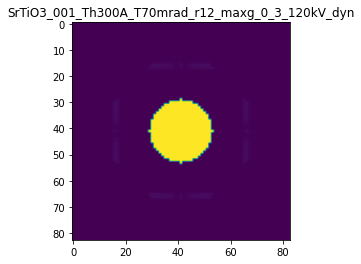

R-factor: 8.435509539306013e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.00030684272774160926

The offset applied on Ug: 0.007831415405093124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69315727225836
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

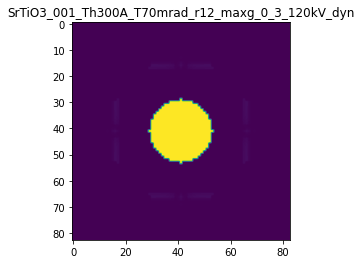

R-factor: 3.9274349893922406e-07

>>> producing the 114. dataset...

The offset applied on thickness: -0.00022023655257195142

The offset applied on Ug: -0.007763983680040458

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.779763447428
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

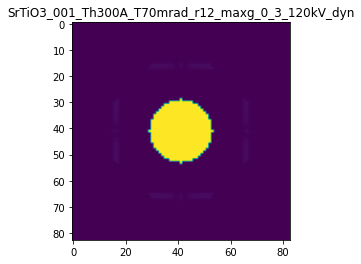

R-factor: 2.867455458653252e-07

>>> producing the 115. dataset...

The offset applied on thickness: 0.0005082050545297827

The offset applied on Ug: -0.005926180551520384

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5082050545298
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

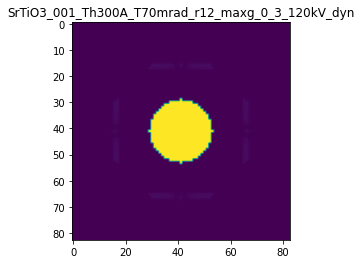

R-factor: 6.42186075469089e-07

>>> producing the 116. dataset...

The offset applied on thickness: -0.0008397569973484011

The offset applied on Ug: 0.006418919658414937

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1602430026516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

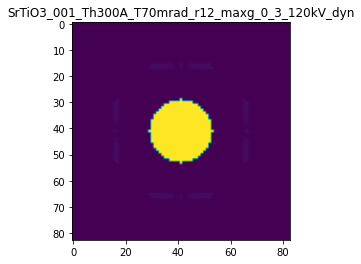

R-factor: 1.0576289783242598e-06

>>> producing the 117. dataset...

The offset applied on thickness: -0.0007721649117356195

The offset applied on Ug: 0.008164890136995688

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2278350882644
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

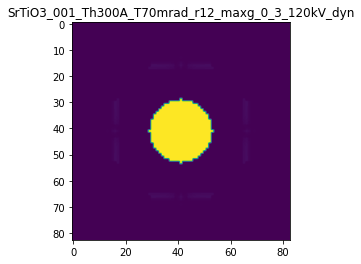

R-factor: 9.732034246887682e-07

>>> producing the 118. dataset...

The offset applied on thickness: 0.0003359521253847446

The offset applied on Ug: -0.0033349373500449063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3359521253847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

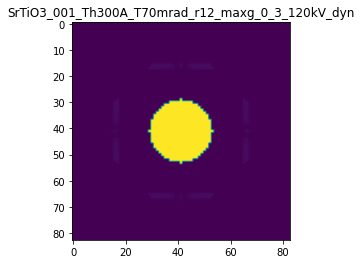

R-factor: 4.2423715773974845e-07

>>> producing the 119. dataset...

The offset applied on thickness: 0.0007104811616885746

The offset applied on Ug: -0.0050802753113637755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71048116168856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

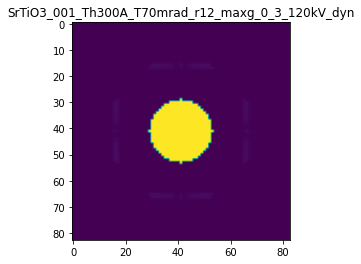

R-factor: 8.97286516334863e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.0009830693915727881

The offset applied on Ug: 0.007377791650563759

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98306939157277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

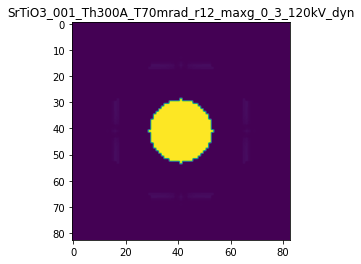

R-factor: 1.2474116631037048e-06

>>> producing the 121. dataset...

The offset applied on thickness: -0.0004780619138802231

The offset applied on Ug: -0.003586406568362115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52193808611975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

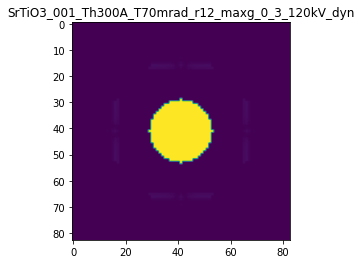

R-factor: 6.047175981537867e-07

>>> producing the 122. dataset...

The offset applied on thickness: 0.000795041039790359

The offset applied on Ug: 0.00670153444834638

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7950410397903
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

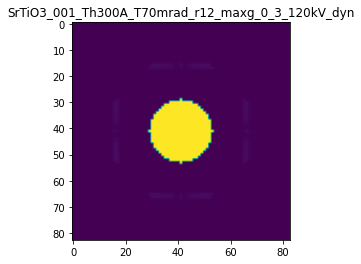

R-factor: 1.0091639572790133e-06

>>> producing the 123. dataset...

The offset applied on thickness: -0.000434436784920466

The offset applied on Ug: 0.0018655853981621017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5655632150795
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

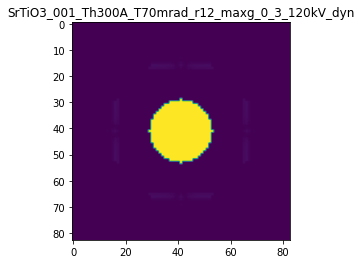

R-factor: 5.471694995784286e-07

>>> producing the 124. dataset...

The offset applied on thickness: 0.0009215023769992425

The offset applied on Ug: -0.00932727449833918

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.92150237699923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

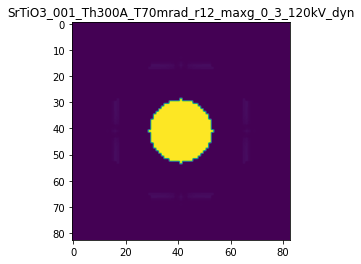

R-factor: 1.1649666641769867e-06

>>> producing the 125. dataset...

The offset applied on thickness: -0.0006177891080446568

The offset applied on Ug: -0.008012057408525777

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3822108919553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

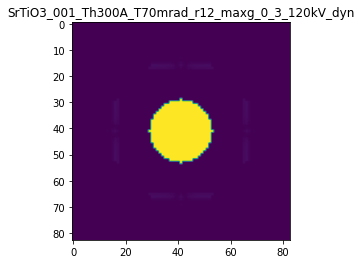

R-factor: 7.847383367758332e-07

>>> producing the 126. dataset...

The offset applied on thickness: 0.0004448086168706944

The offset applied on Ug: -0.00436597261129467

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44480861687066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

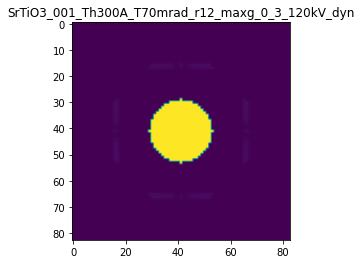

R-factor: 5.617923937827233e-07

>>> producing the 127. dataset...

The offset applied on thickness: 0.00026494835818564156

The offset applied on Ug: 0.009496487476264867

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2649483581856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

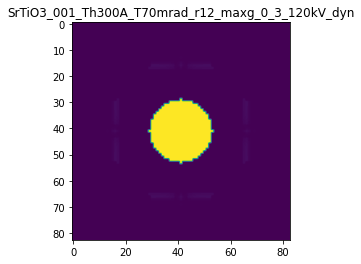

R-factor: 3.455914119861362e-07

>>> producing the 128. dataset...

The offset applied on thickness: -0.00039021690457716885

The offset applied on Ug: -0.0002421707445201493

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6097830954228
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

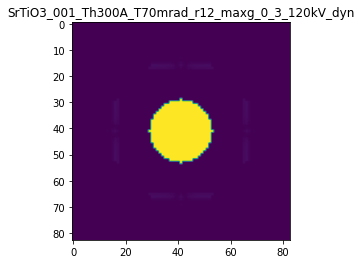

R-factor: 4.91138190126234e-07

>>> producing the 129. dataset...

The offset applied on thickness: 4.553672797194275e-05

The offset applied on Ug: -0.003460843087228045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0455367279719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

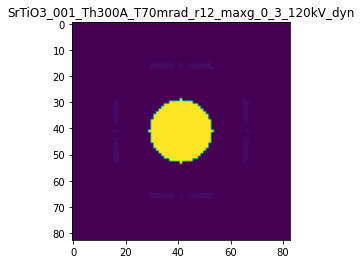

R-factor: 6.563647782636893e-08

>>> producing the 130. dataset...

The offset applied on thickness: 0.0008419980589576107

The offset applied on Ug: -0.004493419660903877

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84199805895764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

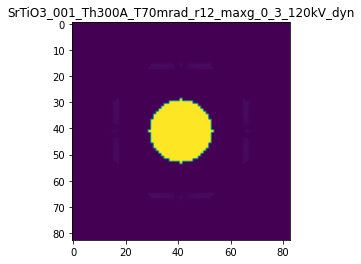

R-factor: 1.0632396994055432e-06

>>> producing the 131. dataset...

The offset applied on thickness: -0.0006949404431760316

The offset applied on Ug: -0.008061455118829925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30505955682395
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

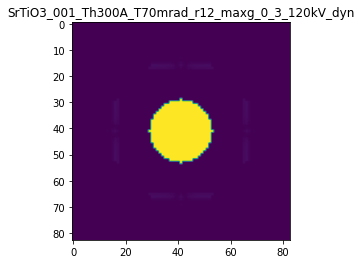

R-factor: 8.814534122163423e-07

>>> producing the 132. dataset...

The offset applied on thickness: -0.0009241047401583405

The offset applied on Ug: 0.0031774421617249394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0758952598416
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

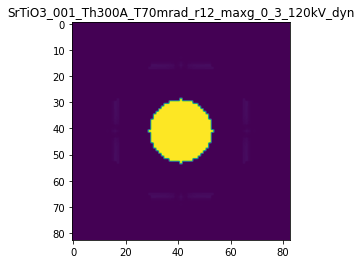

R-factor: 1.1626902594874203e-06

>>> producing the 133. dataset...

The offset applied on thickness: -0.0006069694281363731

The offset applied on Ug: 0.007702020708143562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3930305718636
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

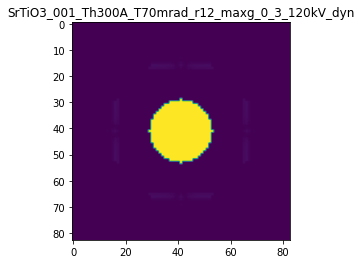

R-factor: 7.65743226991195e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.00027928405987609527

The offset applied on Ug: 0.0037568869988071586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2792840598761
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

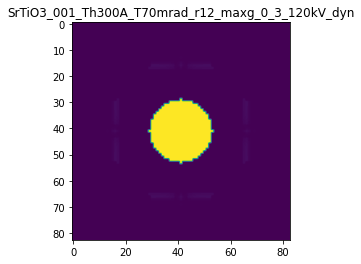

R-factor: 3.5565617737608654e-07

>>> producing the 135. dataset...

The offset applied on thickness: -0.0007409291852719553

The offset applied on Ug: -0.0038622718050102226

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.25907081472803
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

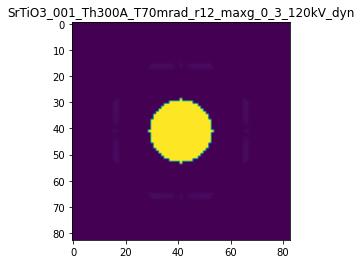

R-factor: 9.351323292701631e-07

>>> producing the 136. dataset...

The offset applied on thickness: 3.6416279684575506e-05

The offset applied on Ug: -0.004855681849895895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0364162796846
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

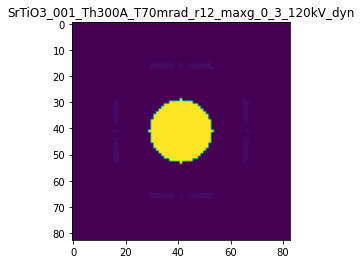

R-factor: 6.167882712363249e-08

>>> producing the 137. dataset...

The offset applied on thickness: 9.506803185440394e-05

The offset applied on Ug: -0.00887063087376472

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0950680318544
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

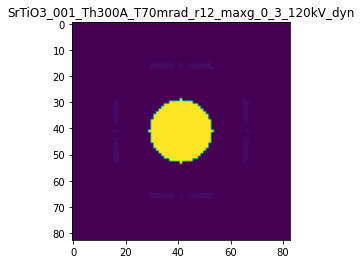

R-factor: 1.436544405818449e-07

>>> producing the 138. dataset...

The offset applied on thickness: 0.0004983431254524053

The offset applied on Ug: 0.008688381455040474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4983431254524
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

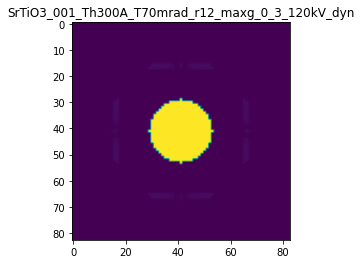

R-factor: 6.376007988549673e-07

>>> producing the 139. dataset...

The offset applied on thickness: -0.0005774063886210297

The offset applied on Ug: 0.009513317684967031

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42259361137894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

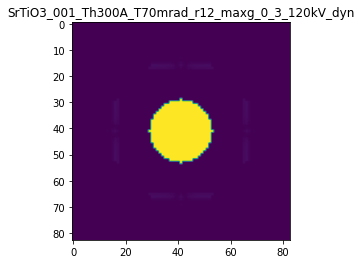

R-factor: 7.309434240913141e-07

>>> producing the 140. dataset...

The offset applied on thickness: -0.0004780346807059901

The offset applied on Ug: 0.0038965674972909524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.521965319294
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

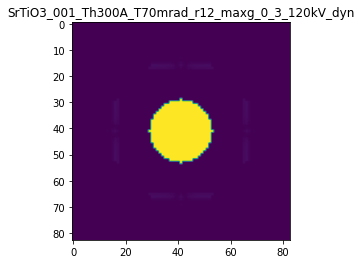

R-factor: 6.025117947177239e-07



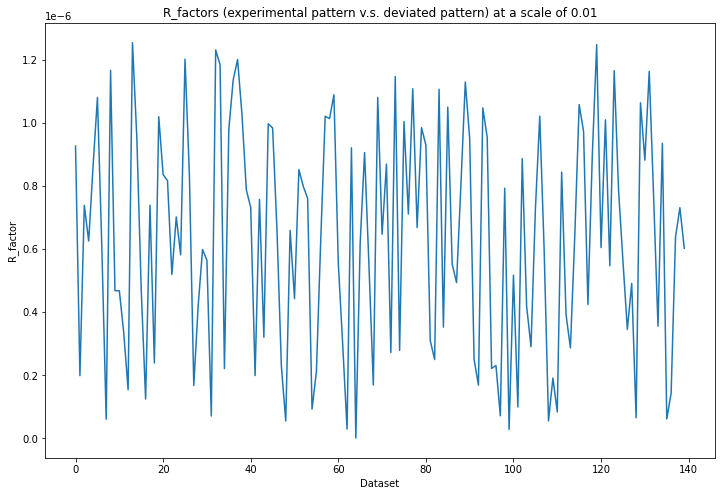

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 4s 415ms/step - loss: 0.2006 - acc: 0.0000e+00 - val_loss: 0.1359 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 183ms/step - loss: 0.1130 - acc: 0.0000e+00 - val_loss: 0.0783 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 182ms/step - loss: 0.0639 - acc: 0.0000e+00 - val_loss: 0.0472 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 181ms/step - loss: 0.0372 - acc: 0.0000e+00 - val_loss: 0.0254 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 181ms/step - loss: 0.0192 - acc: 0.0000e+00 - val_loss: 0.0111 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 182ms/step - loss: 0.0081 - acc: 0.6000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 179ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

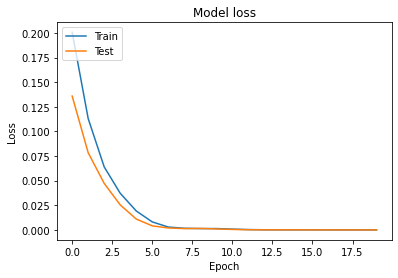

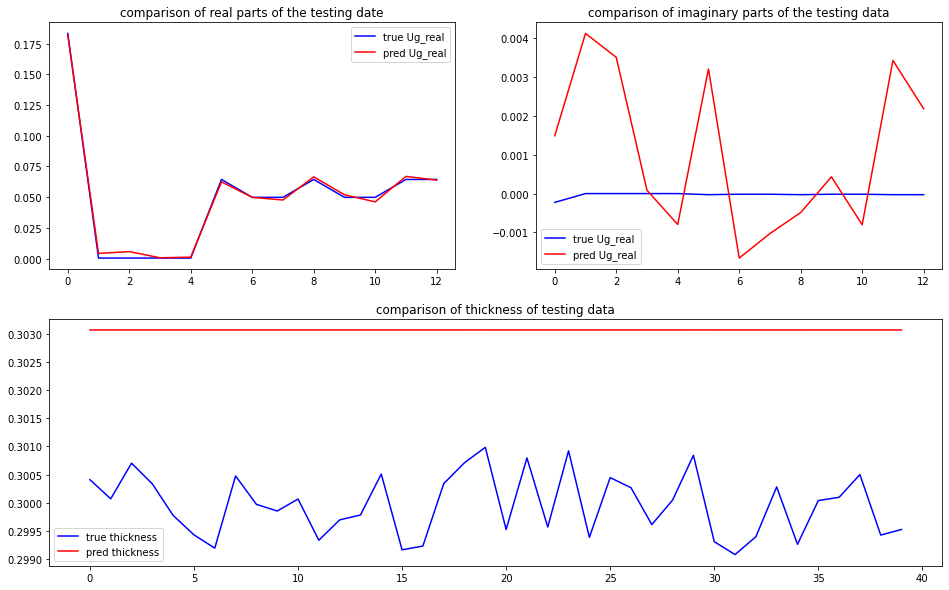

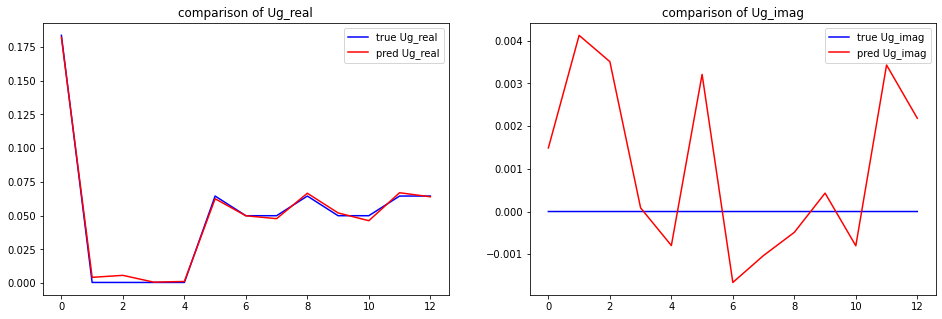

predicted thickness: 30.307143926620483 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=303.07143926620483
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18206233+0.j         0.0049

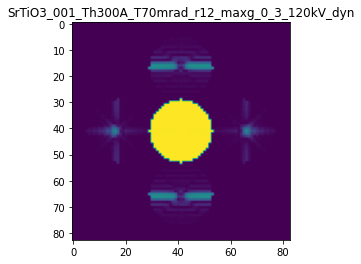

X_sim.max(): 0.999905062286054
R-factor at a scale of 0.01 is 0.013309975973810069.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.02

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.0003392820334996689

The offset applied on Ug: 0.005202861396787122

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
ta

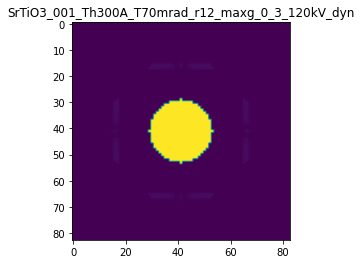

R-factor: 4.3298581829459254e-07

>>> producing the 2. dataset...

The offset applied on thickness: -0.0009748638875922625

The offset applied on Ug: -0.01376939354137444

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0251361124077
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

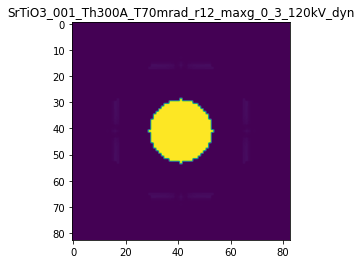

R-factor: 1.2389649947177124e-06

>>> producing the 3. dataset...

The offset applied on thickness: 0.0005401915432666334

The offset applied on Ug: -0.0007386570401439974

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5401915432666
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

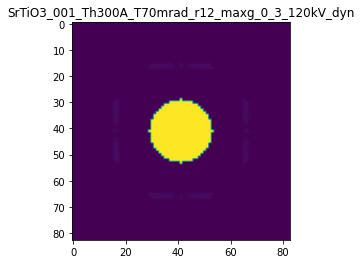

R-factor: 6.81194398514056e-07

>>> producing the 4. dataset...

The offset applied on thickness: -3.3598291611318667e-06

The offset applied on Ug: -0.00930277916897333

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9966401708389
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

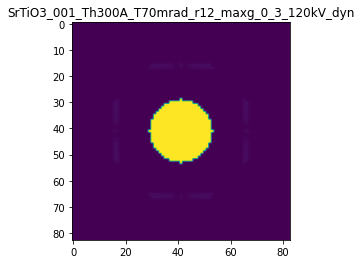

R-factor: 5.560715684380721e-08

>>> producing the 5. dataset...

The offset applied on thickness: -0.00039851635823803246

The offset applied on Ug: 0.015700833186172273

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.601483641762
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

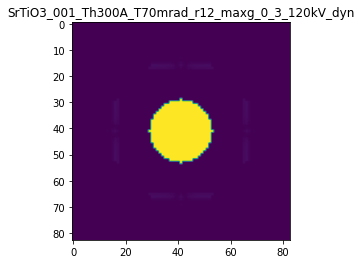

R-factor: 5.219409877021281e-07

>>> producing the 6. dataset...

The offset applied on thickness: -0.00013953398130770768

The offset applied on Ug: 0.00013714230033795794

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86046601869225
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

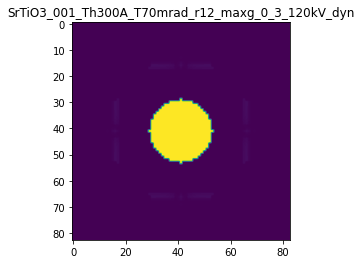

R-factor: 1.7569501708006181e-07

>>> producing the 7. dataset...

The offset applied on thickness: -4.3318555421567375e-05

The offset applied on Ug: -0.015071746361302969

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9566814445784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

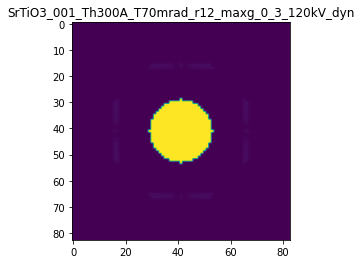

R-factor: 1.0119109459665404e-07

>>> producing the 8. dataset...

The offset applied on thickness: 0.0005287120116161839

The offset applied on Ug: -0.00012099547015437029

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52871201161616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

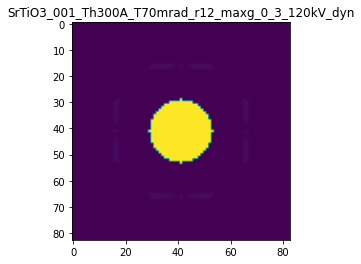

R-factor: 6.665499319831279e-07

>>> producing the 9. dataset...

The offset applied on thickness: -0.00026986664305518485

The offset applied on Ug: 0.004962321972653037

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7301333569448
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

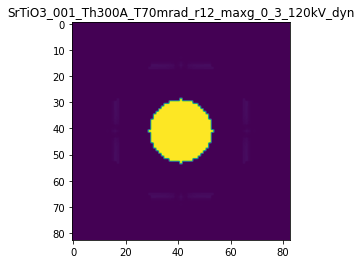

R-factor: 3.423887089597885e-07

>>> producing the 10. dataset...

The offset applied on thickness: -0.0009376287093362521

The offset applied on Ug: -0.00922909213031696

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06237129066375
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

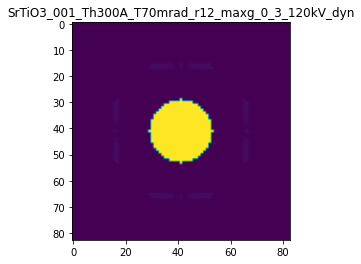

R-factor: 1.1871026802585996e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.00029838319592739816

The offset applied on Ug: -0.009424266222297525

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2983831959274
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

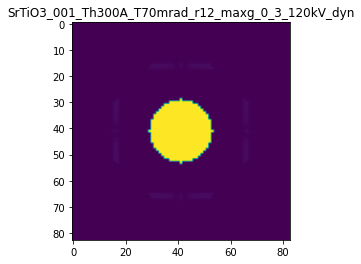

R-factor: 3.853886014737358e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.0008459978957160397

The offset applied on Ug: 0.005346927123254442

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84599789571604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

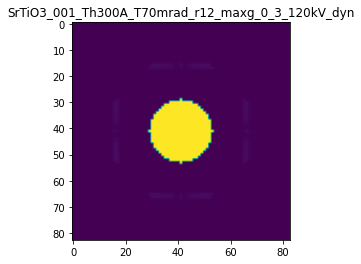

R-factor: 1.0721889767882594e-06

>>> producing the 13. dataset...

The offset applied on thickness: -9.81895795444665e-05

The offset applied on Ug: 0.002229763787051322

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9018104204555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

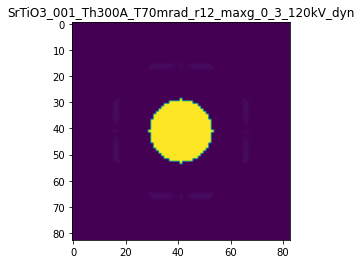

R-factor: 1.2525544481242738e-07

>>> producing the 14. dataset...

The offset applied on thickness: 0.00021045060432501895

The offset applied on Ug: -0.005354191365513908

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.210450604325
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

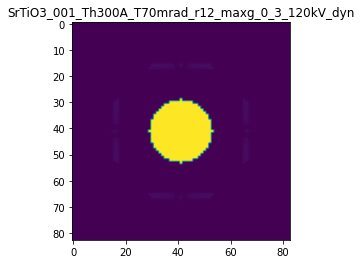

R-factor: 2.6964142256369407e-07

>>> producing the 15. dataset...

The offset applied on thickness: -0.0004051925397682381

The offset applied on Ug: 0.01782871033047547

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5948074602318
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

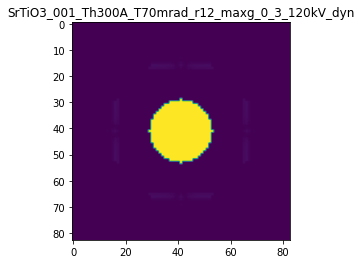

R-factor: 5.36184653481866e-07

>>> producing the 16. dataset...

The offset applied on thickness: 0.0007904184318219994

The offset applied on Ug: 0.011283323158812203

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.790418431822
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

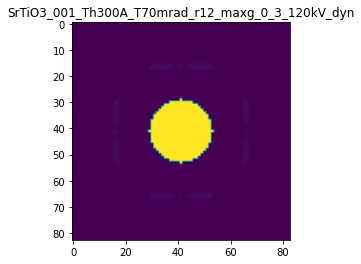

R-factor: 1.0084066283211975e-06

>>> producing the 17. dataset...

The offset applied on thickness: 5.170172793651351e-05

The offset applied on Ug: 0.00016264305999154517

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0517017279365
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

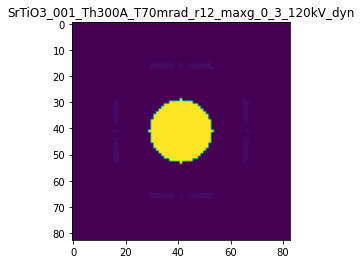

R-factor: 6.528548988217603e-08

>>> producing the 18. dataset...

The offset applied on thickness: 0.00020812494964335393

The offset applied on Ug: 0.009912599910696077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2081249496433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

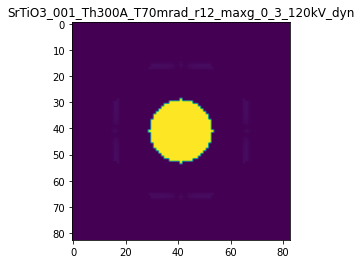

R-factor: 2.7491270056262874e-07

>>> producing the 19. dataset...

The offset applied on thickness: -0.0007070089070681032

The offset applied on Ug: -0.006757778086296425

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2929910929319
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

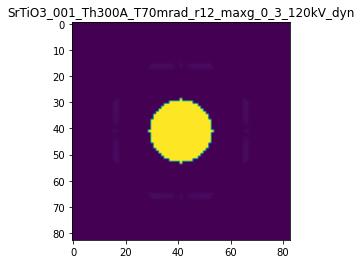

R-factor: 8.953320042892164e-07

>>> producing the 20. dataset...

The offset applied on thickness: -0.00085927309947802

The offset applied on Ug: 0.0046426175173003474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.14072690052194
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

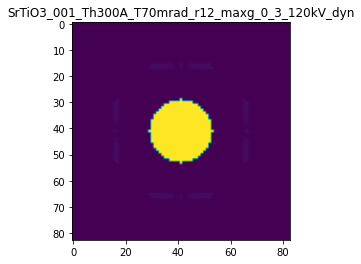

R-factor: 1.0816766247176356e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.0006466986349565939

The offset applied on Ug: -0.00015455757314426056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3533013650434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

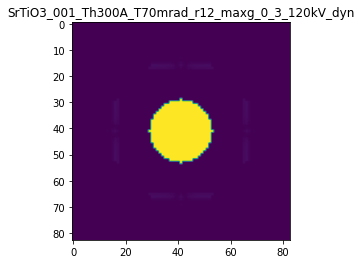

R-factor: 8.134837066464529e-07

>>> producing the 22. dataset...

The offset applied on thickness: 0.00014964592359425444

The offset applied on Ug: 0.002630110898536411

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1496459235942
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

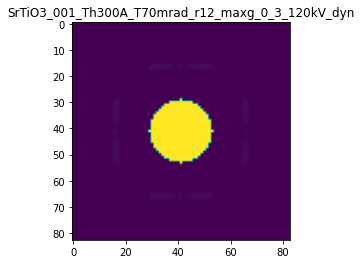

R-factor: 1.9138231525973208e-07

>>> producing the 23. dataset...

The offset applied on thickness: -0.00016657113767192035

The offset applied on Ug: 0.008782874338525563

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83342886232805
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

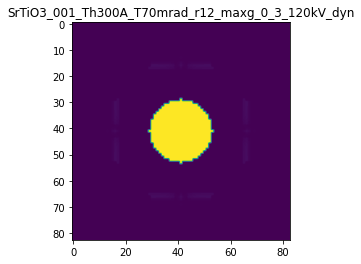

R-factor: 2.2485059802666209e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0008788683920290797

The offset applied on Ug: -0.001330074354834374

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87886839202906
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

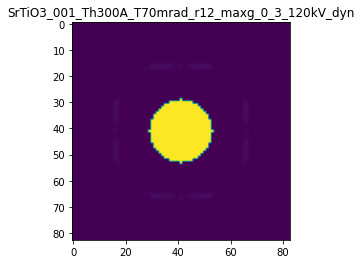

R-factor: 1.1089831944754855e-06

>>> producing the 25. dataset...

The offset applied on thickness: 0.0007152018906873308

The offset applied on Ug: -0.005544293388505621

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71520189068735
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

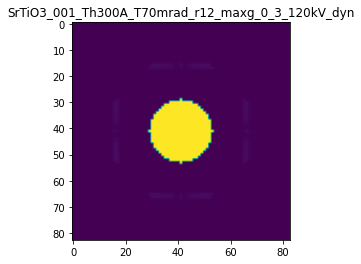

R-factor: 9.033693961534882e-07

>>> producing the 26. dataset...

The offset applied on thickness: 0.0009377214131954775

The offset applied on Ug: 0.006547259304031043

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93772141319545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

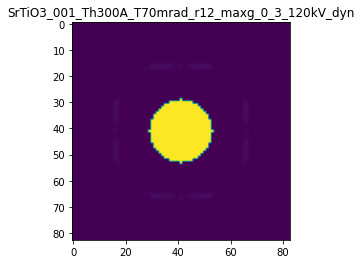

R-factor: 1.1892744460735564e-06

>>> producing the 27. dataset...

The offset applied on thickness: 0.0005298478442825083

The offset applied on Ug: -0.008818559491808476

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5298478442825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

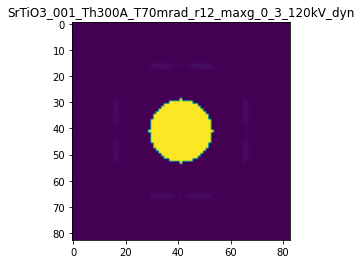

R-factor: 6.722175238084441e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.0005083462493905353

The offset applied on Ug: 0.010603244159843825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50834624939057
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

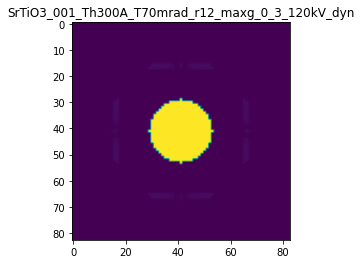

R-factor: 6.528042838041976e-07

>>> producing the 29. dataset...

The offset applied on thickness: 0.0009900515817527391

The offset applied on Ug: 0.01960162924098193

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9900515817527
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

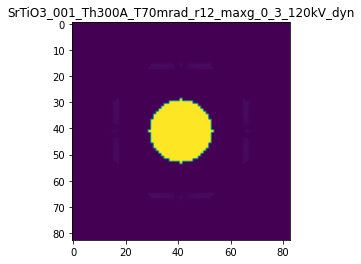

R-factor: 1.271077633717293e-06

>>> producing the 30. dataset...

The offset applied on thickness: 0.0004779158192579314

The offset applied on Ug: -0.01664857317790469

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47791581925793
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

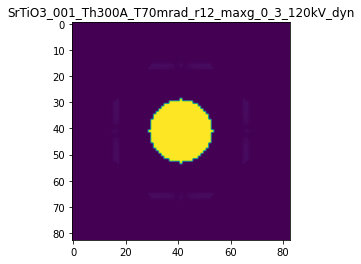

R-factor: 6.209417507423685e-07

>>> producing the 31. dataset...

The offset applied on thickness: 0.0005974033632762319

The offset applied on Ug: 0.012758577099699827

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5974033632762
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

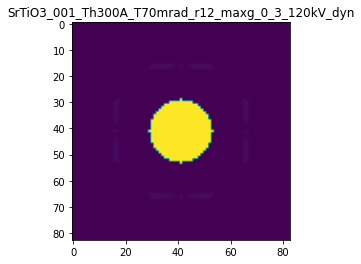

R-factor: 7.677025056292319e-07

>>> producing the 32. dataset...

The offset applied on thickness: -0.0004127851546898198

The offset applied on Ug: -0.01779037579143169

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58721484531014
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

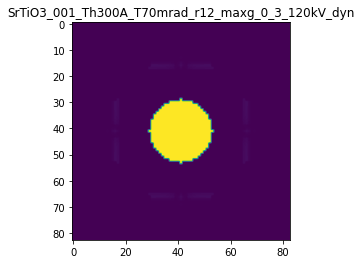

R-factor: 5.418528848602885e-07

>>> producing the 33. dataset...

The offset applied on thickness: -0.0002606439494984858

The offset applied on Ug: 0.019303893490081995

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7393560505015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

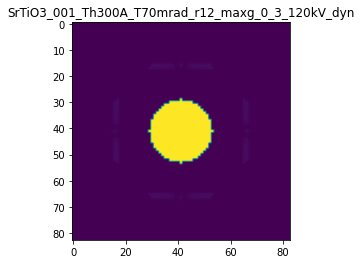

R-factor: 3.733606823667391e-07

>>> producing the 34. dataset...

The offset applied on thickness: -0.000135888615313867

The offset applied on Ug: -0.0026109120196342104

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8641113846861
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

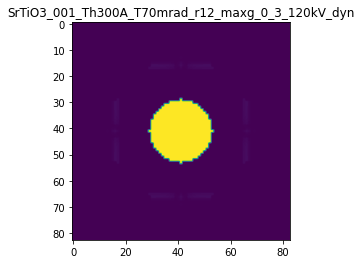

R-factor: 1.7393213616729013e-07

>>> producing the 35. dataset...

The offset applied on thickness: 0.0009012365261545026

The offset applied on Ug: 0.0002439336824801064

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9012365261545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

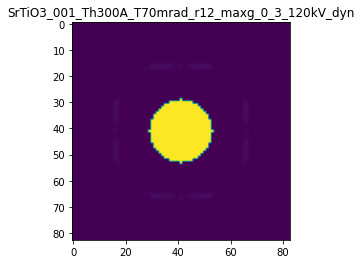

R-factor: 1.1370840847149396e-06

>>> producing the 36. dataset...

The offset applied on thickness: -0.00037872777828570615

The offset applied on Ug: 0.015666798436145983

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6212722217143
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

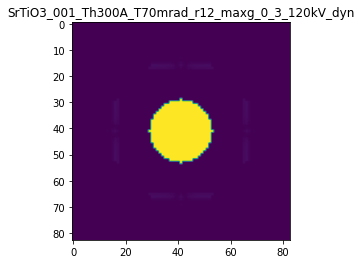

R-factor: 4.982364821103654e-07

>>> producing the 37. dataset...

The offset applied on thickness: -4.061451321899123e-05

The offset applied on Ug: -0.0137924339259574

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95938548678095
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

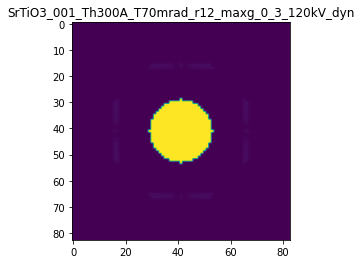

R-factor: 9.320243081175213e-08

>>> producing the 38. dataset...

The offset applied on thickness: 0.000935317338609847

The offset applied on Ug: -0.012727777099519213

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9353173386098
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

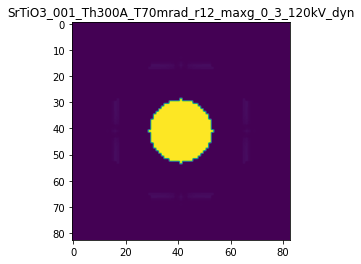

R-factor: 1.184257376375659e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.000504961432584226

The offset applied on Ug: -0.0147454230100178

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5049614325842
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

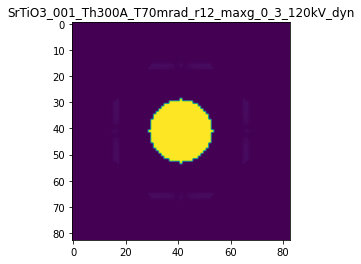

R-factor: 6.504472740103462e-07

>>> producing the 40. dataset...

The offset applied on thickness: -0.00083930623049488

The offset applied on Ug: -0.002347591349604223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1606937695051
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

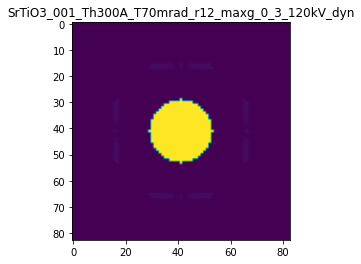

R-factor: 1.0571435774345916e-06

>>> producing the 41. dataset...

The offset applied on thickness: 0.00098529806636341

The offset applied on Ug: 0.004618193551200292

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9852980663634
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

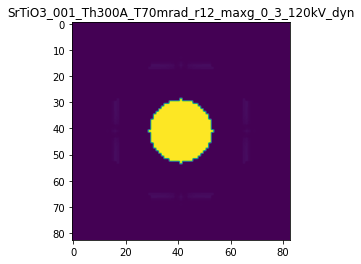

R-factor: 1.2474929436604617e-06

>>> producing the 42. dataset...

The offset applied on thickness: 0.0004775401322725463

The offset applied on Ug: -0.019378532765806665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4775401322725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

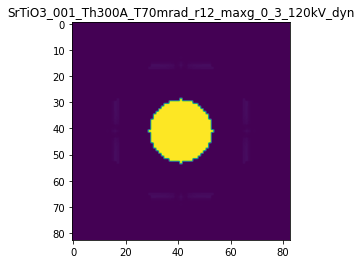

R-factor: 6.282327806220689e-07

>>> producing the 43. dataset...

The offset applied on thickness: -0.000723955542014608

The offset applied on Ug: 0.006270118504661828

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2760444579854
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

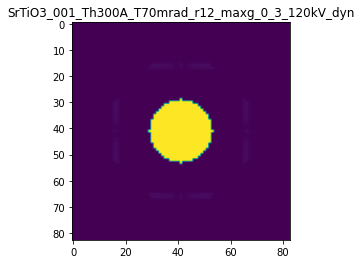

R-factor: 9.121664733694898e-07

>>> producing the 44. dataset...

The offset applied on thickness: -0.0007733733968800445

The offset applied on Ug: -0.013563582531573344

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22662660311994
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

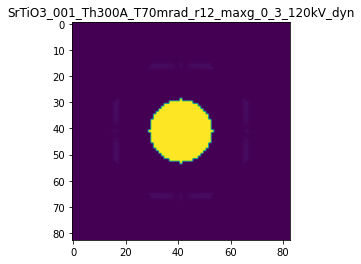

R-factor: 9.869159395413652e-07

>>> producing the 45. dataset...

The offset applied on thickness: -0.0005738170512444944

The offset applied on Ug: -0.008940298574076602

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4261829487555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

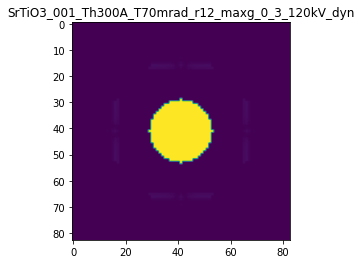

R-factor: 7.310077414744099e-07

>>> producing the 46. dataset...

The offset applied on thickness: -0.00040831034473329367

The offset applied on Ug: -0.011386339118809912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5916896552667
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

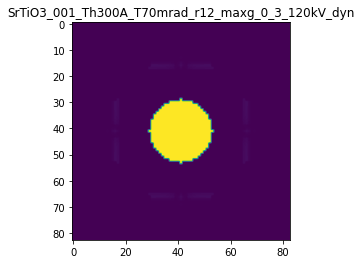

R-factor: 5.272756232006018e-07

>>> producing the 47. dataset...

The offset applied on thickness: -0.0007686304579540792

The offset applied on Ug: 0.007274220072961239

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2313695420459
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

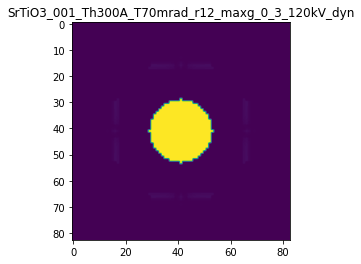

R-factor: 9.685353838636046e-07

>>> producing the 48. dataset...

The offset applied on thickness: -1.4487321094780237e-05

The offset applied on Ug: -0.01863671448726039

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9855126789052
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

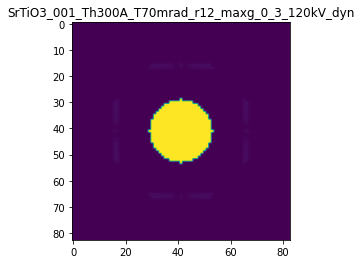

R-factor: 1.1017516858530525e-07

>>> producing the 49. dataset...

The offset applied on thickness: -0.0005545103078432061

The offset applied on Ug: 0.008978585484405591

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4454896921568
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

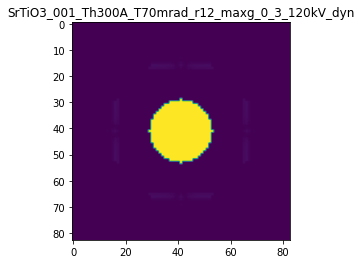

R-factor: 7.018061314868666e-07

>>> producing the 50. dataset...

The offset applied on thickness: 0.000269164029073075

The offset applied on Ug: 0.014057813099989973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26916402907307
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

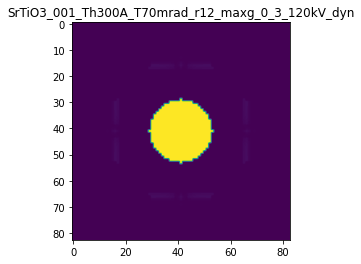

R-factor: 3.573280506562095e-07

>>> producing the 51. dataset...

The offset applied on thickness: -0.0008744904454269993

The offset applied on Ug: -0.00032487199220606835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.125509554573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

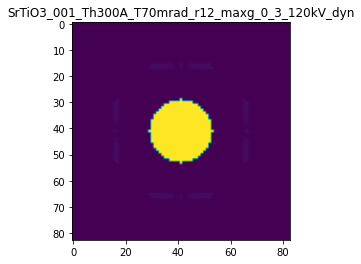

R-factor: 1.0995936676843006e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.000705975786837425

The offset applied on Ug: 0.0027500670956865127

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.70597578683737
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

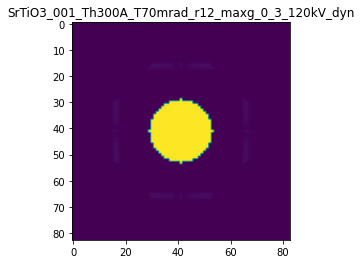

R-factor: 8.9277361603134e-07

>>> producing the 53. dataset...

The offset applied on thickness: -0.00025826892310418237

The offset applied on Ug: -0.01673572939331625

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74173107689586
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

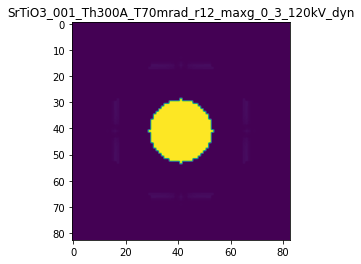

R-factor: 3.4795521335227036e-07

>>> producing the 54. dataset...

The offset applied on thickness: -0.0003330115057045622

The offset applied on Ug: 0.006543271800630932

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6669884942954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

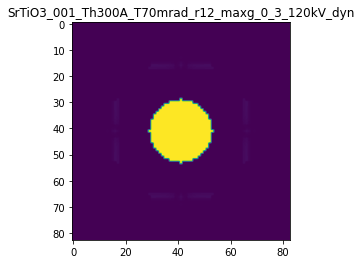

R-factor: 4.230088907641085e-07

>>> producing the 55. dataset...

The offset applied on thickness: -0.0005760686776977724

The offset applied on Ug: 0.013963041493697266

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4239313223022
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

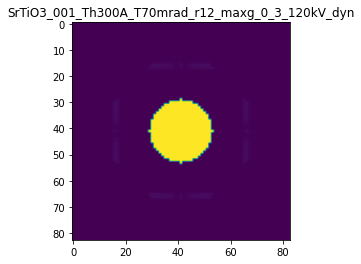

R-factor: 7.357634631110493e-07

>>> producing the 56. dataset...

The offset applied on thickness: -0.00016599915068009352

The offset applied on Ug: -0.012925512945111168

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83400084931986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

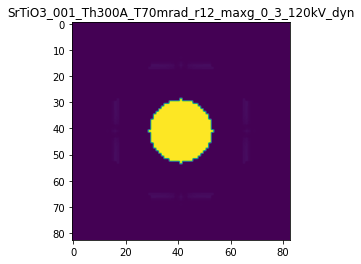

R-factor: 2.2747442347457106e-07

>>> producing the 57. dataset...

The offset applied on thickness: -0.0007858848364462992

The offset applied on Ug: -0.013154361462936266

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2141151635537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

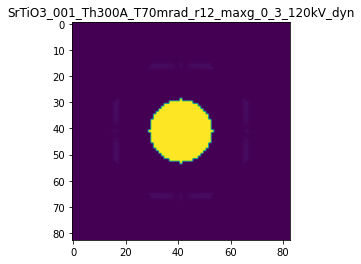

R-factor: 1.0019930671720024e-06

>>> producing the 58. dataset...

The offset applied on thickness: 0.0007036193697768807

The offset applied on Ug: -0.01878161777539411

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.70361936977685
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

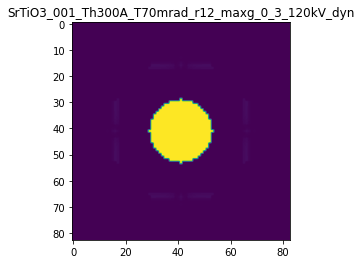

R-factor: 9.037422730900441e-07

>>> producing the 59. dataset...

The offset applied on thickness: 6.485475104022042e-05

The offset applied on Ug: 0.007217944133928285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06485475104023
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

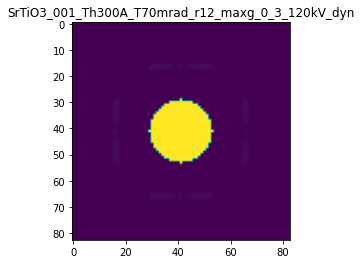

R-factor: 9.285725917794714e-08

>>> producing the 60. dataset...

The offset applied on thickness: 9.599008215234539e-05

The offset applied on Ug: -0.015508402913902701

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0959900821523
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

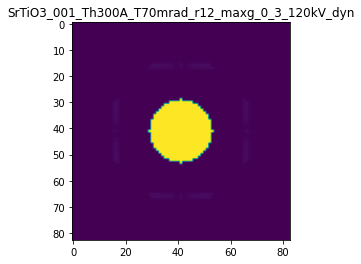

R-factor: 1.7639400050751762e-07

>>> producing the 61. dataset...

The offset applied on thickness: -0.0004940334200344923

The offset applied on Ug: -0.001998230428246157

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5059665799655
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

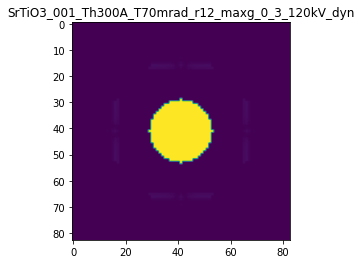

R-factor: 6.232624217467208e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.0006487159577366695

The offset applied on Ug: -0.012522274216194451

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3512840422633
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

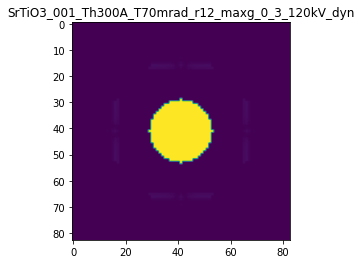

R-factor: 8.296265603211484e-07

>>> producing the 63. dataset...

The offset applied on thickness: -0.0001638710841264428

The offset applied on Ug: 0.015532318000314916

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83612891587353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

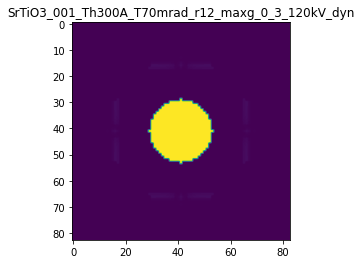

R-factor: 2.484431063405537e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.000926979009885986

The offset applied on Ug: -0.013149747182716954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.073020990114
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

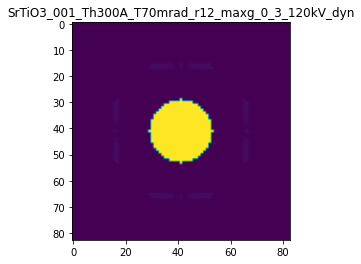

R-factor: 1.178298931564335e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0009311546608536152

The offset applied on Ug: 0.00010170649086776784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9311546608536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

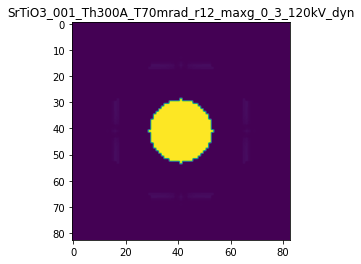

R-factor: 1.1748418502845033e-06

>>> producing the 66. dataset...

The offset applied on thickness: -0.00016608307966077375

The offset applied on Ug: 0.01863609516548864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8339169203392
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

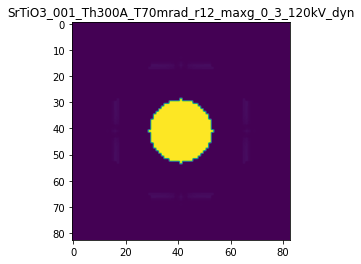

R-factor: 2.64078468750879e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.00031720983304050885

The offset applied on Ug: 0.002850796371259321

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6827901669595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

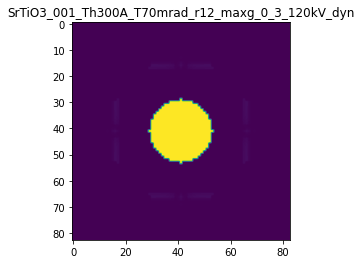

R-factor: 3.999838981157394e-07

>>> producing the 68. dataset...

The offset applied on thickness: -0.00041789122593896154

The offset applied on Ug: -0.012216666809518002

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58210877406106
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

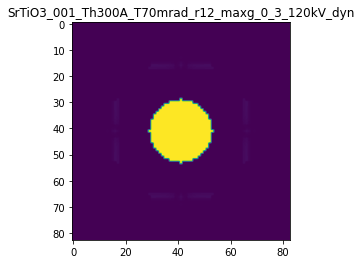

R-factor: 5.404163422531501e-07

>>> producing the 69. dataset...

The offset applied on thickness: 0.00046532186903224806

The offset applied on Ug: 0.017739490590363914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46532186903227
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

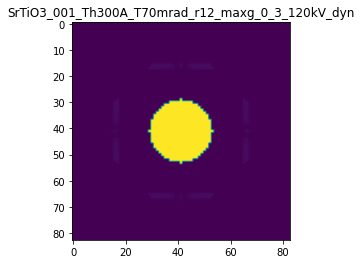

R-factor: 6.086592434623926e-07

>>> producing the 70. dataset...

The offset applied on thickness: 0.00027805912389909193

The offset applied on Ug: 0.006141406797735059

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2780591238991
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

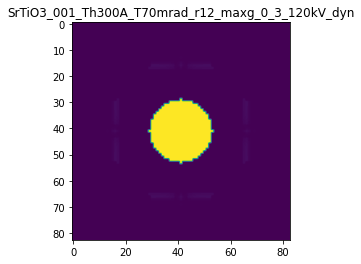

R-factor: 3.574007796279407e-07

>>> producing the 71. dataset...

The offset applied on thickness: -0.0007474435108558115

The offset applied on Ug: 0.003540817122546187

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2525564891442
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

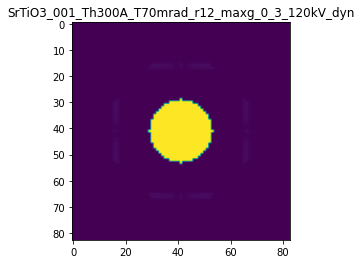

R-factor: 9.409676763374931e-07

>>> producing the 72. dataset...

The offset applied on thickness: 0.0004996075961096642

The offset applied on Ug: 0.012784199856843759

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4996075961097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

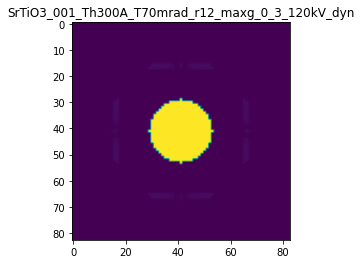

R-factor: 6.448194745668486e-07

>>> producing the 73. dataset...

The offset applied on thickness: -0.0007040477029457759

The offset applied on Ug: -0.002235012132003815

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2959522970542
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

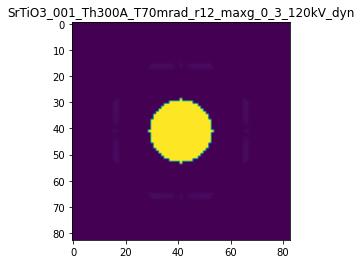

R-factor: 8.872704102026267e-07

>>> producing the 74. dataset...

The offset applied on thickness: 0.0003469529763757915

The offset applied on Ug: -0.015609701862922227

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34695297637575
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

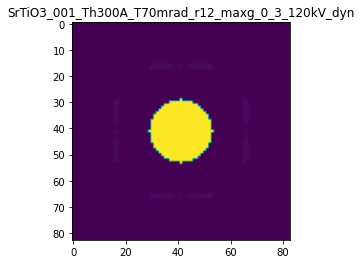

R-factor: 4.608714905286448e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.00046202414146381577

The offset applied on Ug: 0.01743856454475406

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46202414146376
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

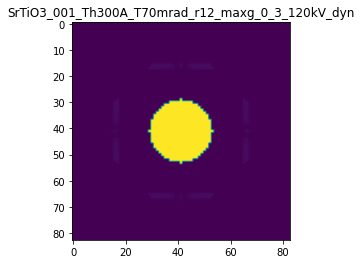

R-factor: 6.040954659615249e-07

>>> producing the 76. dataset...

The offset applied on thickness: 0.0005983803400225158

The offset applied on Ug: -0.011980067525536264

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5983803400225
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

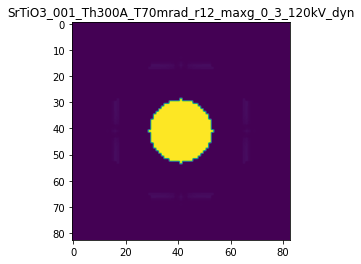

R-factor: 7.618562531584761e-07

>>> producing the 77. dataset...

The offset applied on thickness: 0.0005101351218390355

The offset applied on Ug: 0.0012479659677052312

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.510135121839
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

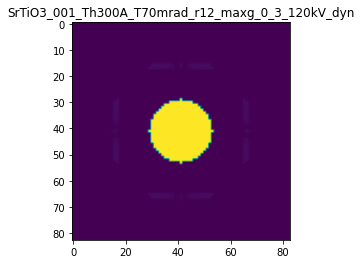

R-factor: 6.441233519133811e-07

>>> producing the 78. dataset...

The offset applied on thickness: -0.0005981921496452492

The offset applied on Ug: 0.005252852636997539

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.40180785035477
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

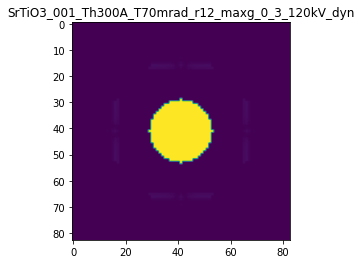

R-factor: 7.538967716588668e-07

>>> producing the 79. dataset...

The offset applied on thickness: 0.0005679886028926207

The offset applied on Ug: -0.018898776271964155

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5679886028926
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

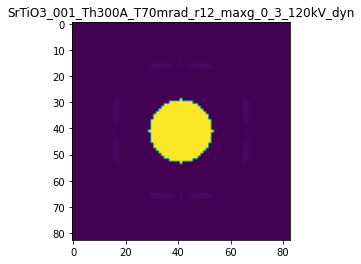

R-factor: 7.360218004738784e-07

>>> producing the 80. dataset...

The offset applied on thickness: 0.0008854870147944813

The offset applied on Ug: -0.011202456120697955

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8854870147945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

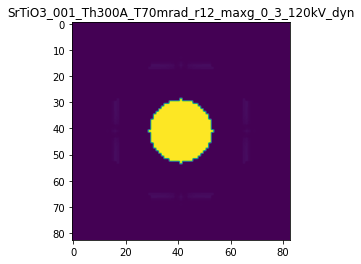

R-factor: 1.1201007310716485e-06

>>> producing the 81. dataset...

The offset applied on thickness: -0.0007457413534923941

The offset applied on Ug: -0.0022867939246174673

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2542586465076
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

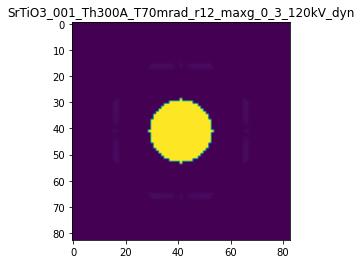

R-factor: 9.396607427314519e-07

>>> producing the 82. dataset...

The offset applied on thickness: 0.0002312222715530081

The offset applied on Ug: 0.01825600698397614

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.231222271553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

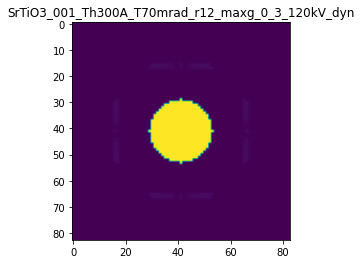

R-factor: 3.175492811102547e-07

>>> producing the 83. dataset...

The offset applied on thickness: 0.00038654657770318134

The offset applied on Ug: -0.01564772840395514

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3865465777032
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

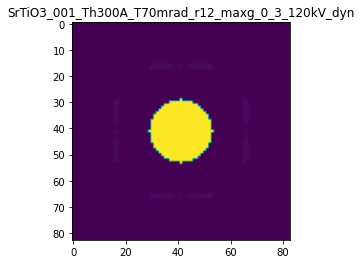

R-factor: 5.083266523265387e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.00028249649289708965

The offset applied on Ug: 0.007335820883923994

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28249649289705
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

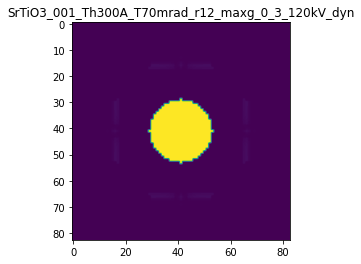

R-factor: 3.6461537703100533e-07

>>> producing the 85. dataset...

The offset applied on thickness: 0.00032928245857971784

The offset applied on Ug: -0.007485907722336895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3292824585797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

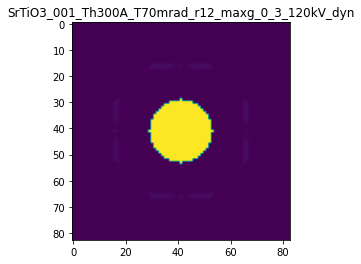

R-factor: 4.2050229549368807e-07

>>> producing the 86. dataset...

The offset applied on thickness: 0.0004482572953381947

The offset applied on Ug: -0.01200096892781477

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4482572953382
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

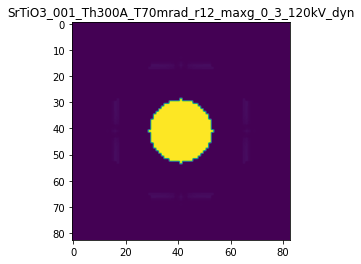

R-factor: 5.755478876998383e-07

>>> producing the 87. dataset...

The offset applied on thickness: -0.0005939802193515415

The offset applied on Ug: -0.00013102171395610985

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4060197806485
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

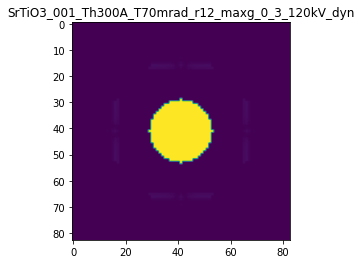

R-factor: 7.472375582787602e-07

>>> producing the 88. dataset...

The offset applied on thickness: -0.0006288321459503141

The offset applied on Ug: 0.00553793132346534

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37116785404965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

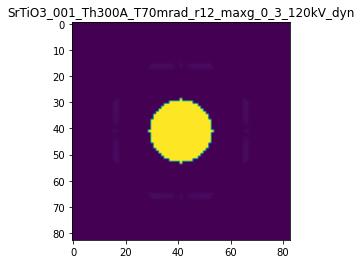

R-factor: 7.924729865850022e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.00015201193939297974

The offset applied on Ug: 0.014740644579082467

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.847988060607
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

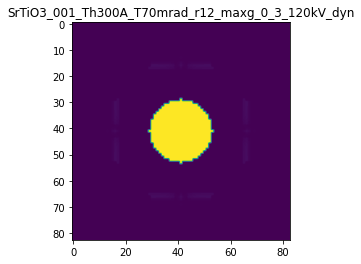

R-factor: 2.3181735508213846e-07

>>> producing the 90. dataset...

The offset applied on thickness: 0.0004999187356522265

The offset applied on Ug: 0.003280306753166853

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4999187356522
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

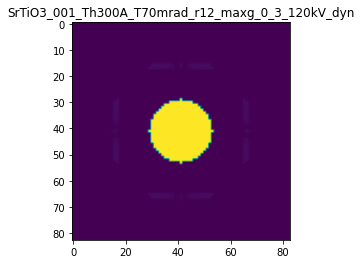

R-factor: 6.332576377515289e-07

>>> producing the 91. dataset...

The offset applied on thickness: 0.00016494340208514436

The offset applied on Ug: -0.019849289522077027

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16494340208516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

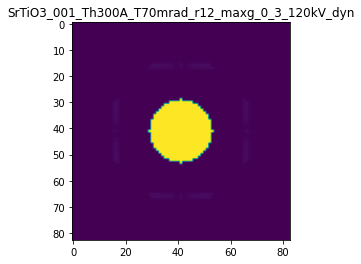

R-factor: 2.688209427174932e-07

>>> producing the 92. dataset...

The offset applied on thickness: 6.022198290918235e-05

The offset applied on Ug: 0.006603511857949753

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0602219829092
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

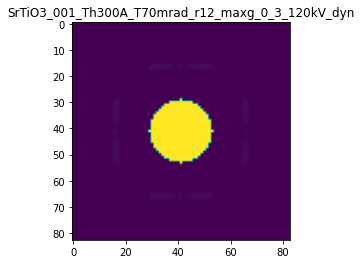

R-factor: 8.604128340258977e-08

>>> producing the 93. dataset...

The offset applied on thickness: 0.0001256339965200204

The offset applied on Ug: -0.004439426644498749

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12563399652004
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

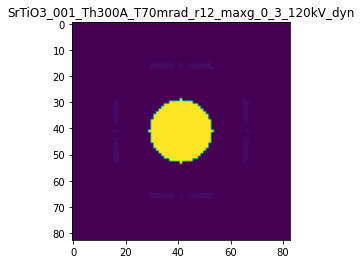

R-factor: 1.632871377840604e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.00036917408983102077

The offset applied on Ug: 0.013035348913685171

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.630825910169
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

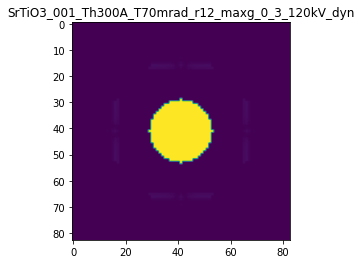

R-factor: 4.792540947975781e-07

>>> producing the 95. dataset...

The offset applied on thickness: -0.00034184716188586164

The offset applied on Ug: -0.0004702232683687724

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6581528381141
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

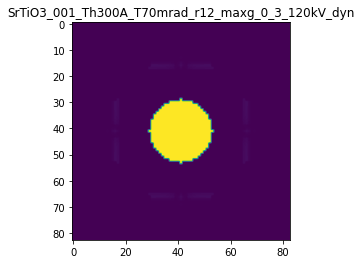

R-factor: 4.305087007647581e-07

>>> producing the 96. dataset...

The offset applied on thickness: 0.00024556918854564124

The offset applied on Ug: 0.01959995743177332

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24556918854563
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

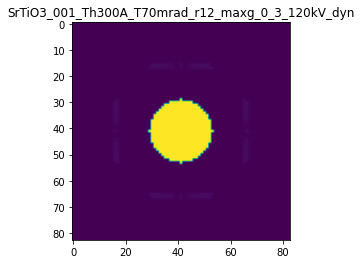

R-factor: 3.376261597670604e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.0007941807102891942

The offset applied on Ug: 0.006930445667436703

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7941807102892
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

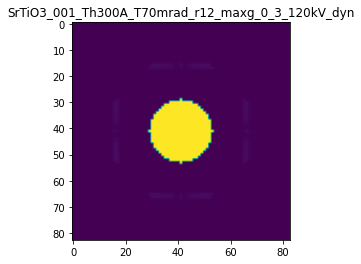

R-factor: 1.008304075077434e-06

>>> producing the 98. dataset...

The offset applied on thickness: -0.0005791802898823624

The offset applied on Ug: 0.012729801068706133

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42081971011766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

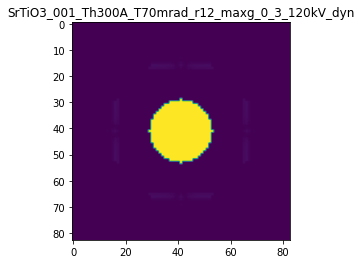

R-factor: 7.375908907337046e-07

>>> producing the 99. dataset...

The offset applied on thickness: 0.0006629055741324639

The offset applied on Ug: -0.007986080683420958

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6629055741324
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

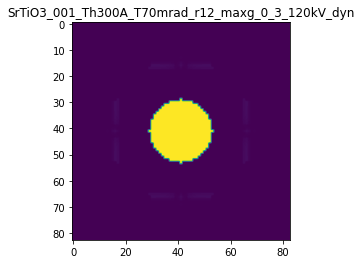

R-factor: 8.379802879782625e-07

>>> producing the 100. dataset...

The offset applied on thickness: -0.0001398739839465537

The offset applied on Ug: 0.015477560403307474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8601260160534
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

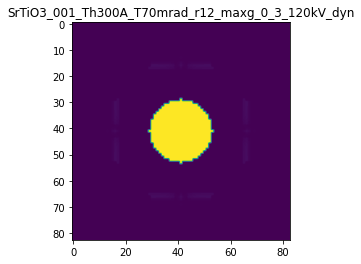

R-factor: 2.2139067227264958e-07

>>> producing the 101. dataset...

The offset applied on thickness: 0.0009341893415947243

The offset applied on Ug: -0.00859501801740016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93418934159473
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

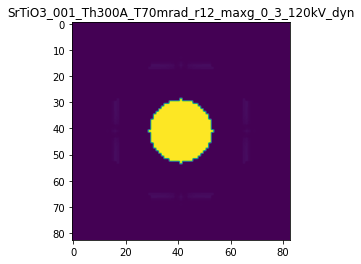

R-factor: 1.1808067939022268e-06

>>> producing the 102. dataset...

The offset applied on thickness: 0.000274377570142486

The offset applied on Ug: -0.006512975432056502

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27437757014246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

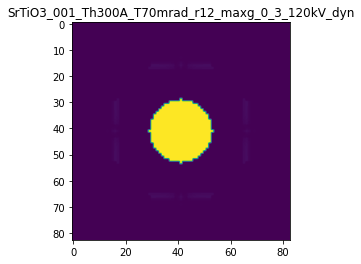

R-factor: 3.508104765078831e-07

>>> producing the 103. dataset...

The offset applied on thickness: 5.017962769510498e-05

The offset applied on Ug: 0.017679006995741875

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0501796276951
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

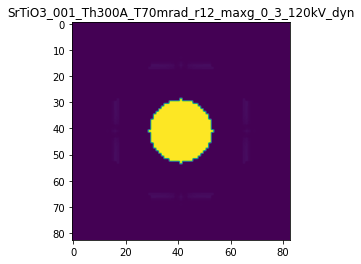

R-factor: 1.1832557541136652e-07

>>> producing the 104. dataset...

The offset applied on thickness: -0.0004634289144657591

The offset applied on Ug: -0.017051083544081518

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5365710855342
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

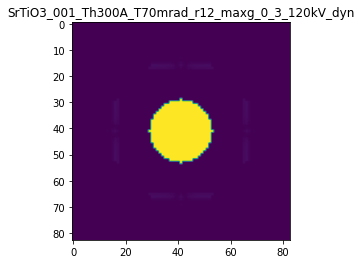

R-factor: 6.041145080317395e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.0005353807828205717

The offset applied on Ug: 0.015530839672630532

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4646192171794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

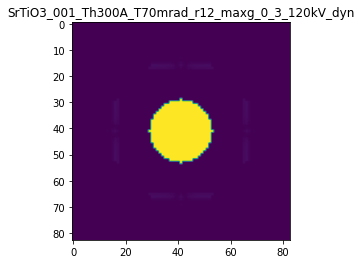

R-factor: 6.880539984920876e-07

>>> producing the 106. dataset...

The offset applied on thickness: -0.00017987346193096144

The offset applied on Ug: 0.019101424577904168

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8201265380691
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

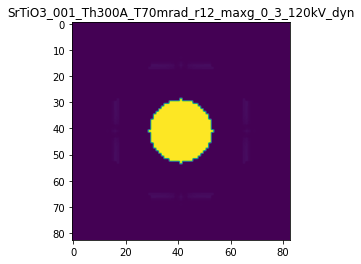

R-factor: 2.8112529465282185e-07

>>> producing the 107. dataset...

The offset applied on thickness: 5.807834206878249e-05

The offset applied on Ug: 0.019074711659733828

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05807834206877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

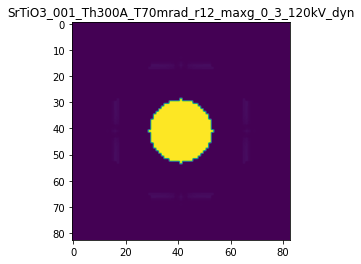

R-factor: 1.3010952670114936e-07

>>> producing the 108. dataset...

The offset applied on thickness: -0.0008893890716819008

The offset applied on Ug: 0.011680423597024045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.11061092831807
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

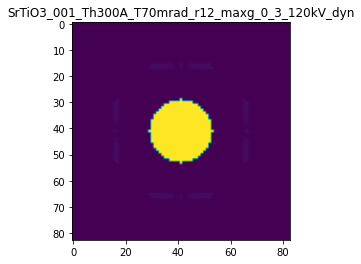

R-factor: 1.1219142674005708e-06

>>> producing the 109. dataset...

The offset applied on thickness: 0.000992783144102848

The offset applied on Ug: -0.012872204288165023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9927831441028
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

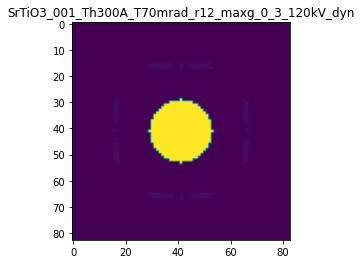

R-factor: 1.2564223202898179e-06

>>> producing the 110. dataset...

The offset applied on thickness: 0.00025994243273755904

The offset applied on Ug: 0.017135052077504938

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25994243273755
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

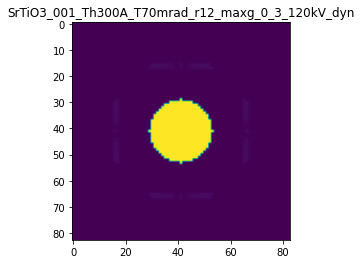

R-factor: 3.510818068338391e-07

>>> producing the 111. dataset...

The offset applied on thickness: 0.0006749181903009806

The offset applied on Ug: 0.0056701884498225

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67491819030096
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

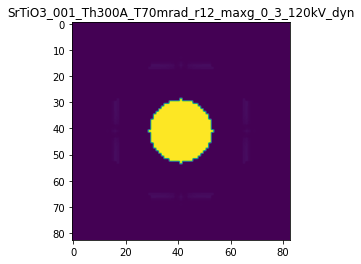

R-factor: 8.56459979775095e-07

>>> producing the 112. dataset...

The offset applied on thickness: 0.0004293677766565749

The offset applied on Ug: -0.0063459123011447675

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4293677766566
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

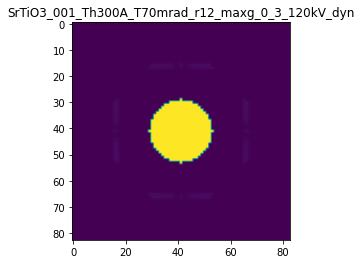

R-factor: 5.437311516120101e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.0009418314383238666

The offset applied on Ug: 0.008823295608568552

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0581685616761
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

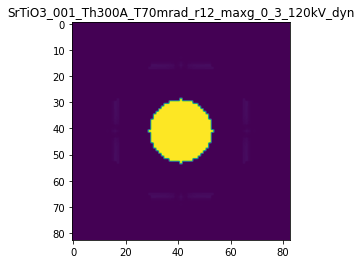

R-factor: 1.1863821458875748e-06

>>> producing the 114. dataset...

The offset applied on thickness: 0.0008250357426153045

The offset applied on Ug: 0.0028282154664100202

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82503574261534
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

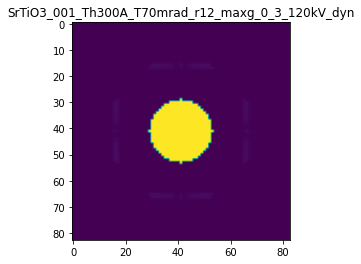

R-factor: 1.0432104435286886e-06

>>> producing the 115. dataset...

The offset applied on thickness: -0.00015570487924949995

The offset applied on Ug: 0.0070967045449766356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84429512075053
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

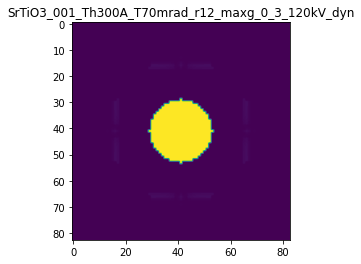

R-factor: 2.0686363472675815e-07

>>> producing the 116. dataset...

The offset applied on thickness: -0.00012951216740641903

The offset applied on Ug: -0.00657188510799914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8704878325936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

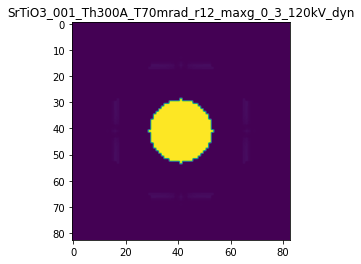

R-factor: 1.714911025234466e-07

>>> producing the 117. dataset...

The offset applied on thickness: -0.00029606680545128785

The offset applied on Ug: 0.016916442266120307

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7039331945487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

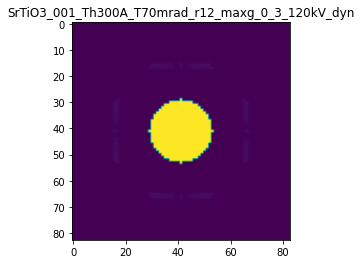

R-factor: 4.0421228915941397e-07

>>> producing the 118. dataset...

The offset applied on thickness: -0.00033053306428762567

The offset applied on Ug: 0.015162514224375397

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66946693571236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

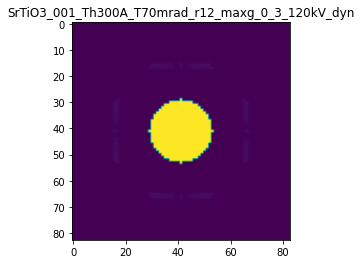

R-factor: 4.392866367716194e-07

>>> producing the 119. dataset...

The offset applied on thickness: -0.00019967677535815675

The offset applied on Ug: 0.0027410491193654843

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80032322464183
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

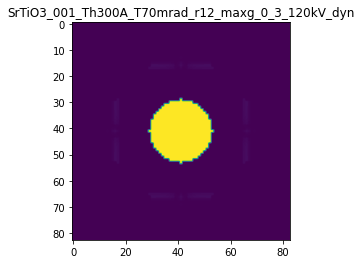

R-factor: 2.523065173924347e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.0007844120133248463

The offset applied on Ug: -0.00862908483562522

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78441201332487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

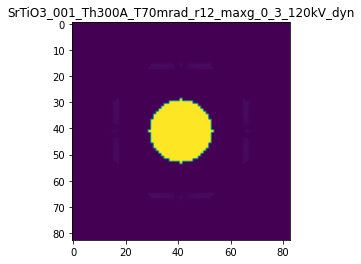

R-factor: 9.91584904807628e-07

>>> producing the 121. dataset...

The offset applied on thickness: -0.00021454868898190037

The offset applied on Ug: -0.015948347969712517

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7854513110181
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

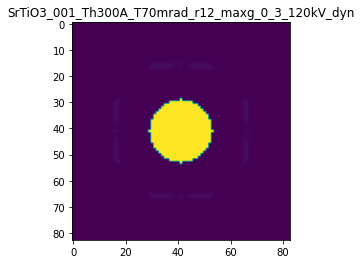

R-factor: 2.926612266138637e-07

>>> producing the 122. dataset...

The offset applied on thickness: -0.0009763553930774156

The offset applied on Ug: 0.008738292745193204

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0236446069226
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

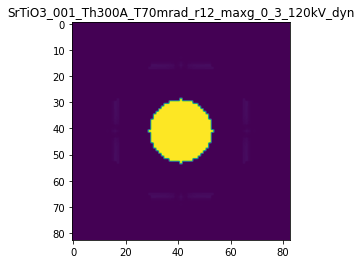

R-factor: 1.2296879799358104e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.0002515111970292414

The offset applied on Ug: 0.014245212040309098

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25151119702923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

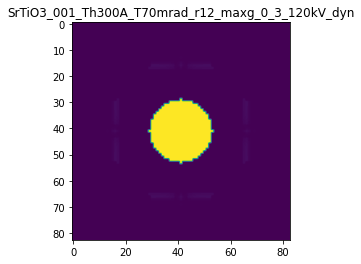

R-factor: 3.3561897347862445e-07

>>> producing the 124. dataset...

The offset applied on thickness: -0.00016336059816489225

The offset applied on Ug: -0.015339630141530747

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8366394018351
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

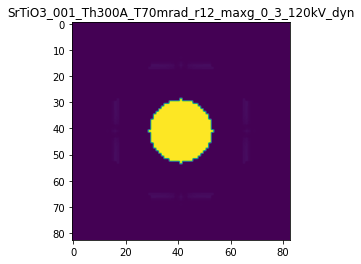

R-factor: 2.28475413263756e-07

>>> producing the 125. dataset...

The offset applied on thickness: 0.0007273739192166983

The offset applied on Ug: 0.003768764500157169

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7273739192167
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

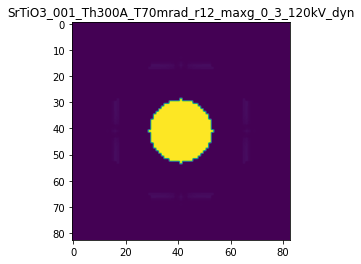

R-factor: 9.208021815476568e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.0001301374922675238

The offset applied on Ug: 0.008768718325540822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8698625077325
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

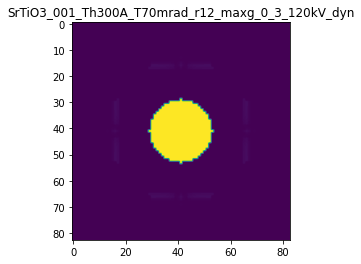

R-factor: 1.829735829982364e-07

>>> producing the 127. dataset...

The offset applied on thickness: 0.00023850518205928496

The offset applied on Ug: 0.0009087819482534964

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2385051820593
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

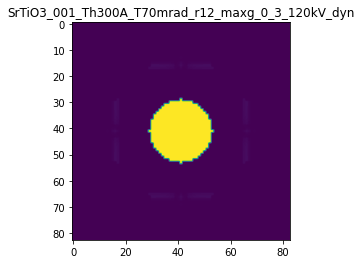

R-factor: 3.0132021577564987e-07

>>> producing the 128. dataset...

The offset applied on thickness: -0.0006460497852547522

The offset applied on Ug: 0.018259374459569284

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3539502147453
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

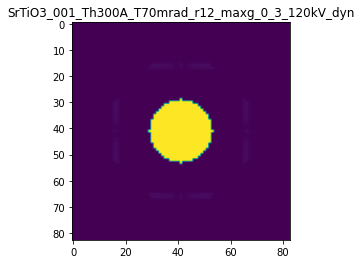

R-factor: 8.293159934502434e-07

>>> producing the 129. dataset...

The offset applied on thickness: -0.0007914165145344477

The offset applied on Ug: 1.8256242937040313e-05

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2085834854655
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

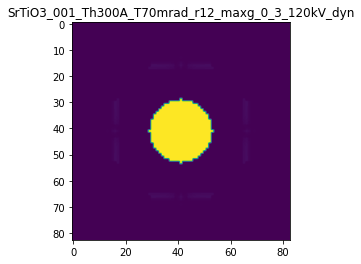

R-factor: 9.953020676738338e-07

>>> producing the 130. dataset...

The offset applied on thickness: -0.0002461535623680873

The offset applied on Ug: -0.009123967883767792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7538464376319
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

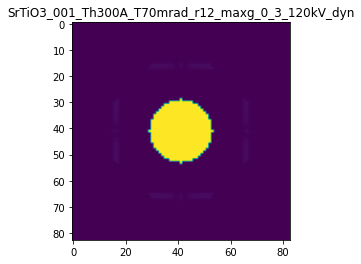

R-factor: 3.2110737449033435e-07

>>> producing the 131. dataset...

The offset applied on thickness: -0.0009711335308487752

The offset applied on Ug: -0.0031629255269027914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02886646915124
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

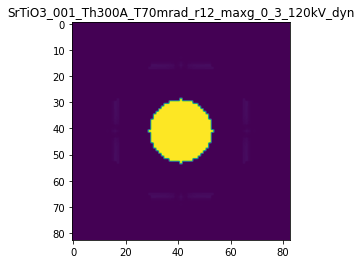

R-factor: 1.2232976956832856e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0002712887585197232

The offset applied on Ug: 0.01958335176271438

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72871124148026
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

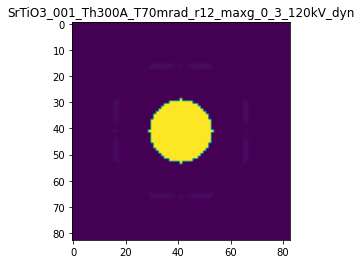

R-factor: 3.8657057651805686e-07

>>> producing the 133. dataset...

The offset applied on thickness: -6.546240585595453e-05

The offset applied on Ug: -0.0088736288856669

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.934537594144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

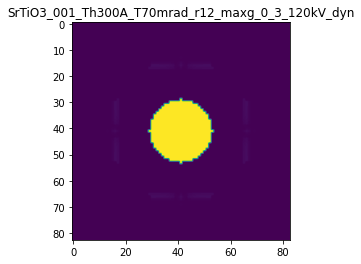

R-factor: 9.666440803817929e-08

>>> producing the 134. dataset...

The offset applied on thickness: 0.0006412670639184974

The offset applied on Ug: -0.019521703327926222

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.64126706391846
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

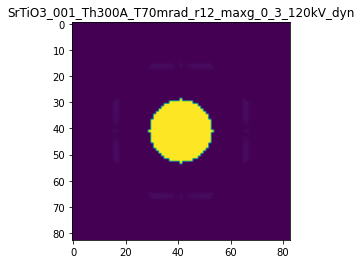

R-factor: 8.275404817721756e-07

>>> producing the 135. dataset...

The offset applied on thickness: 0.0008796084078313303

The offset applied on Ug: -0.019031247285659948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87960840783137
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

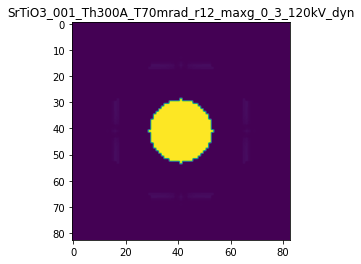

R-factor: 1.1228140397793299e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.0004426850712187203

The offset applied on Ug: 0.004393577503122992

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4426850712187
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

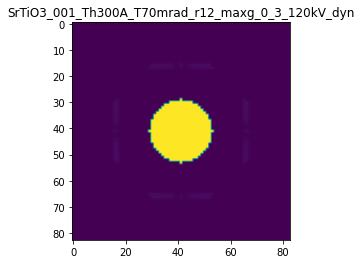

R-factor: 5.621761597593986e-07

>>> producing the 137. dataset...

The offset applied on thickness: -0.0005077097902589655

The offset applied on Ug: -0.019281218636640573

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.492290209741
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

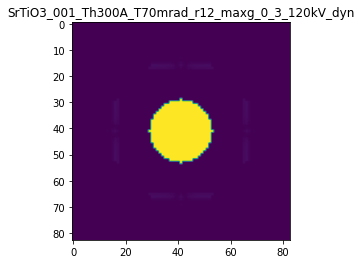

R-factor: 6.626307135794844e-07

>>> producing the 138. dataset...

The offset applied on thickness: -0.0003335240186200115

The offset applied on Ug: -0.013819409624108183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66647598137996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

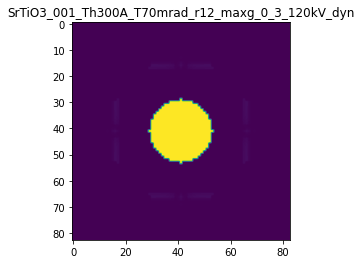

R-factor: 4.3708141811068466e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0002753703653489954

The offset applied on Ug: -0.019720928720320285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.275370365349
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

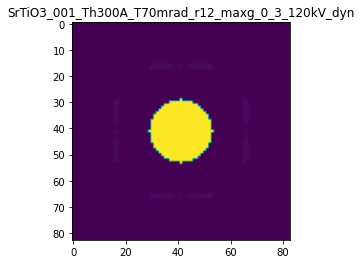

R-factor: 3.9213932156679325e-07

>>> producing the 140. dataset...

The offset applied on thickness: 0.0006285451183829272

The offset applied on Ug: 0.019210704169024456

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.62854511838293
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

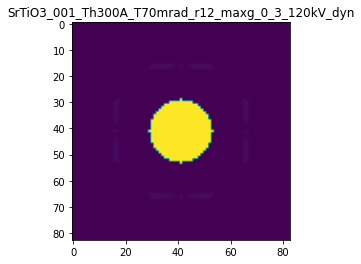

R-factor: 8.157169983036841e-07



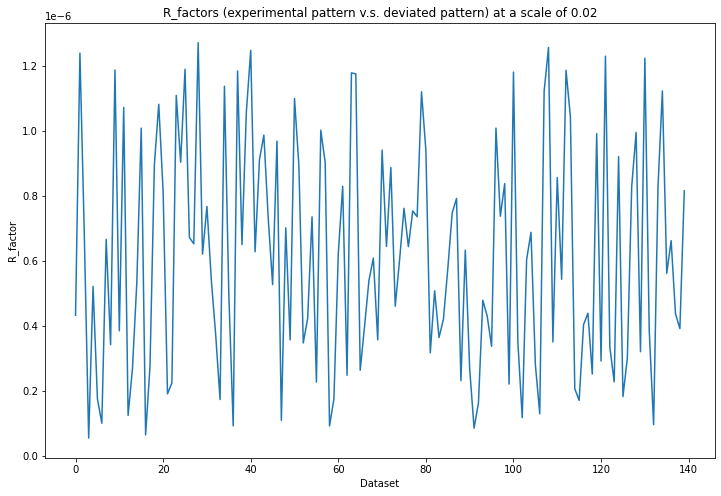

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 362ms/step - loss: 0.2015 - acc: 0.0000e+00 - val_loss: 0.1377 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 209ms/step - loss: 0.1139 - acc: 0.0000e+00 - val_loss: 0.0792 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 214ms/step - loss: 0.0648 - acc: 0.0000e+00 - val_loss: 0.0477 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 213ms/step - loss: 0.0384 - acc: 0.0000e+00 - val_loss: 0.0265 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 209ms/step - loss: 0.0199 - acc: 0.0000e+00 - val_loss: 0.0111 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 209ms/step - loss: 0.0082 - acc: 0.4000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 209ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

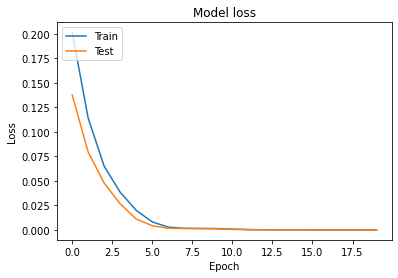

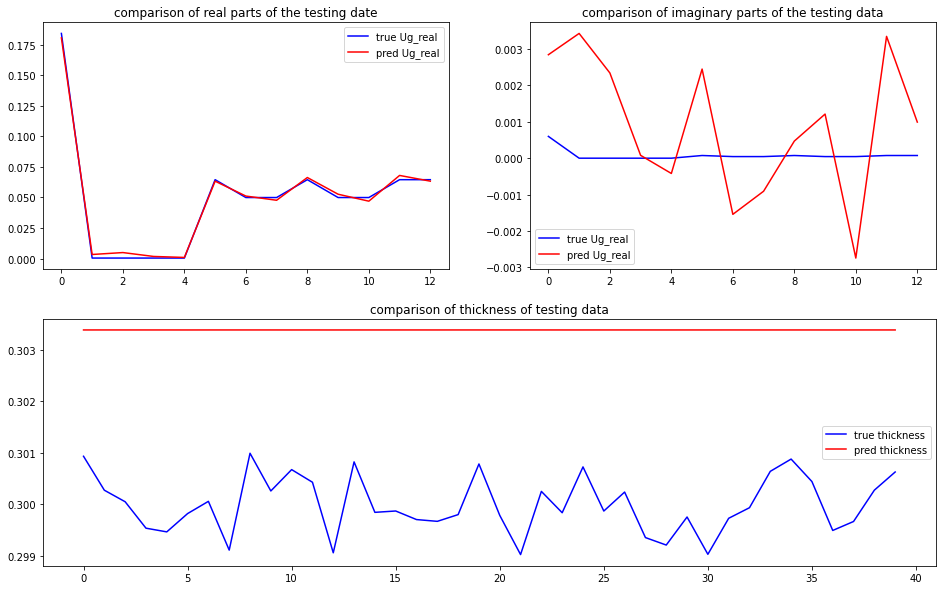

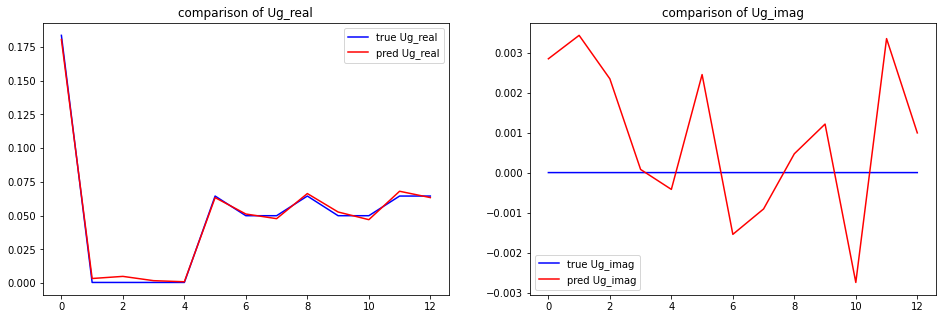

predicted thickness: 30.33892512321472 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=303.3892512321472
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18050309+0.j         0.004167

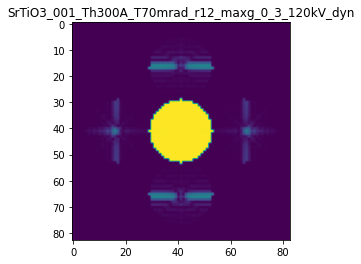

X_sim.max(): 0.9999284059879752
R-factor at a scale of 0.02 is 0.009524923821592167.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.04

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0009840335791481548

The offset applied on Ug: -0.03961801130770397

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


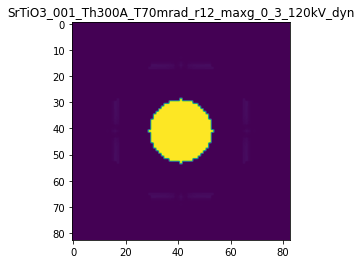

R-factor: 1.2862324535871371e-06

>>> producing the 2. dataset...

The offset applied on thickness: -9.082887123124816e-05

The offset applied on Ug: -0.006631861579309933

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9091711287688
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

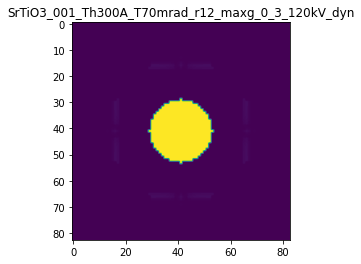

R-factor: 1.2369260602678524e-07

>>> producing the 3. dataset...

The offset applied on thickness: 6.078818301665678e-05

The offset applied on Ug: -0.004583670576449919

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0607881830166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

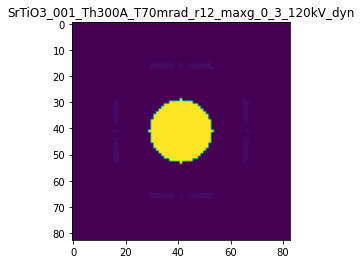

R-factor: 8.747068637862571e-08

>>> producing the 4. dataset...

The offset applied on thickness: -0.00083763823505092

The offset applied on Ug: -0.00016284267272864027

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1623617649491
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

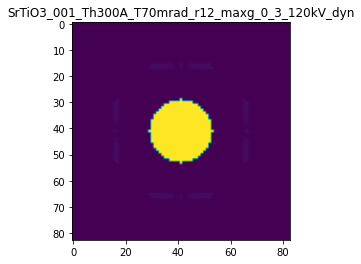

R-factor: 1.0532974086132235e-06

>>> producing the 5. dataset...

The offset applied on thickness: -0.0007312527021637032

The offset applied on Ug: 0.034162737686565296

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2687472978363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

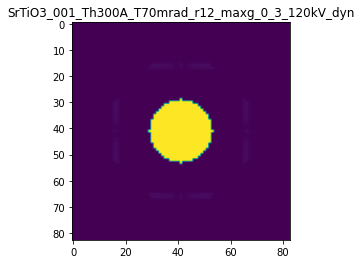

R-factor: 9.72908374848531e-07

>>> producing the 6. dataset...

The offset applied on thickness: -0.0006014409741537117

The offset applied on Ug: 0.033627044576129514

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3985590258463
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

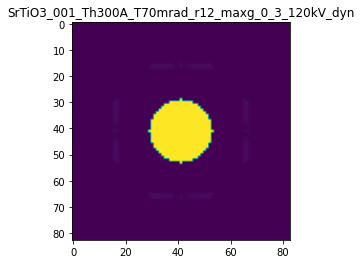

R-factor: 8.17853385333345e-07

>>> producing the 7. dataset...

The offset applied on thickness: 0.00019827435058597366

The offset applied on Ug: -0.013449457113619391

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.19827435058596
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

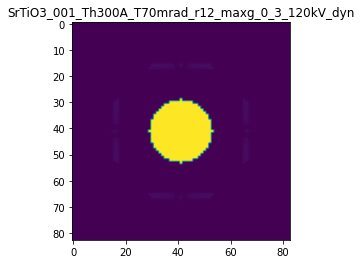

R-factor: 2.7932352301097094e-07

>>> producing the 8. dataset...

The offset applied on thickness: 0.000426900588363117

The offset applied on Ug: 0.029860953174104452

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.42690058836314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

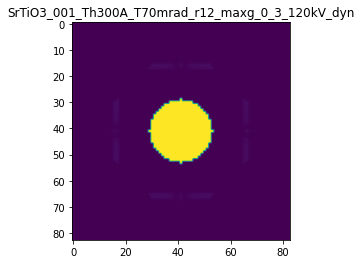

R-factor: 5.797086331671321e-07

>>> producing the 9. dataset...

The offset applied on thickness: 0.0005186261987463044

The offset applied on Ug: -0.03924981033935221

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5186261987463
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

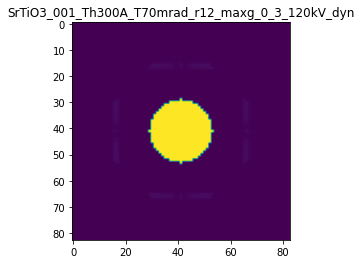

R-factor: 7.472373431188666e-07

>>> producing the 10. dataset...

The offset applied on thickness: -0.0008824577133556644

The offset applied on Ug: 0.019439052817306113

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1175422866443
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

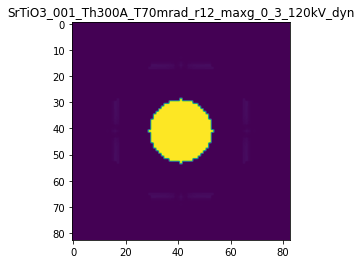

R-factor: 1.1232628415530626e-06

>>> producing the 11. dataset...

The offset applied on thickness: -0.0006059724235833641

The offset applied on Ug: 0.03978435594887625

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.39402757641665
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

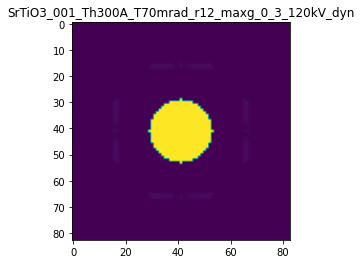

R-factor: 8.472330779859957e-07

>>> producing the 12. dataset...

The offset applied on thickness: -0.0003925418408109485

The offset applied on Ug: -0.03363264007146542

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.60745815918904
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

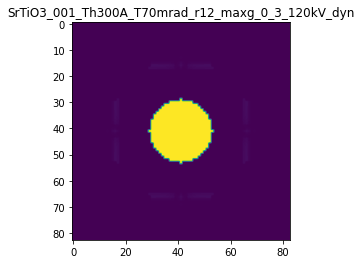

R-factor: 5.431950196179672e-07

>>> producing the 13. dataset...

The offset applied on thickness: 0.00012806873386301932

The offset applied on Ug: -0.011152212945623487

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.128068733863
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

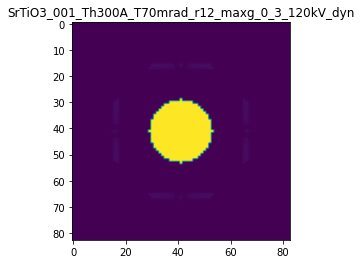

R-factor: 1.902967346373831e-07

>>> producing the 14. dataset...

The offset applied on thickness: 0.00012938057285589343

The offset applied on Ug: 0.021331851404064423

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1293805728559
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

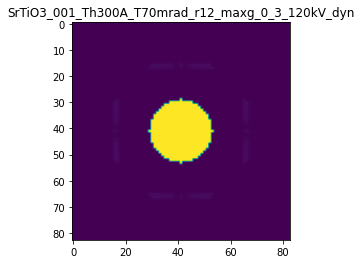

R-factor: 2.0050846032769745e-07

>>> producing the 15. dataset...

The offset applied on thickness: -0.0008369348854288332

The offset applied on Ug: -0.02009847367194048

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1630651145711
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

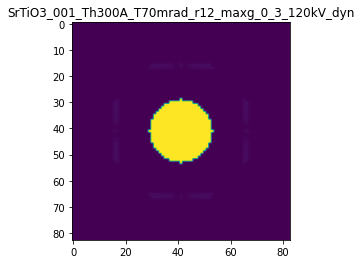

R-factor: 1.0753546306669348e-06

>>> producing the 16. dataset...

The offset applied on thickness: -2.6421528511675343e-06

The offset applied on Ug: 0.0340496930660556

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9973578471488
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

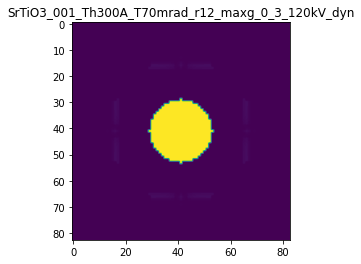

R-factor: 2.106349617534106e-07

>>> producing the 17. dataset...

The offset applied on thickness: -3.7088471907829716e-05

The offset applied on Ug: 0.017591838390741403

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9629115280922
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

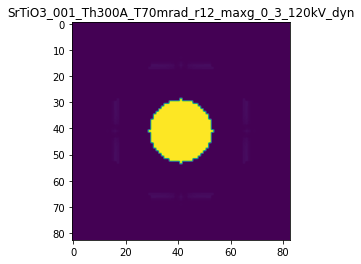

R-factor: 1.3386288016732935e-07

>>> producing the 18. dataset...

The offset applied on thickness: 0.0009685835170716742

The offset applied on Ug: -0.02792668826611152

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9685835170717
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

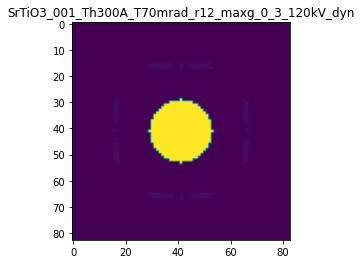

R-factor: 1.2480844944496646e-06

>>> producing the 19. dataset...

The offset applied on thickness: -0.0003692788420840143

The offset applied on Ug: 0.0035839199642179586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.630721157916
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

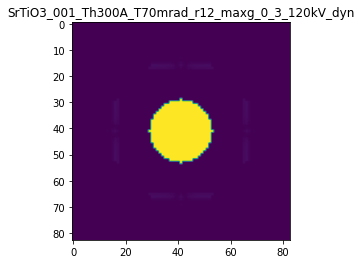

R-factor: 4.656701945511964e-07

>>> producing the 20. dataset...

The offset applied on thickness: 0.0008708296791727013

The offset applied on Ug: 0.015871923716756164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8708296791727
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

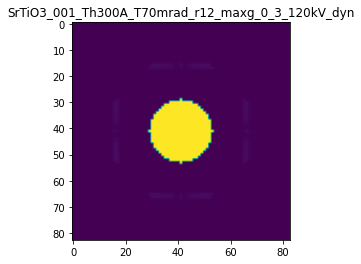

R-factor: 1.1158857490302019e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.0009402489957945091

The offset applied on Ug: -0.018839083216924825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05975100420545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

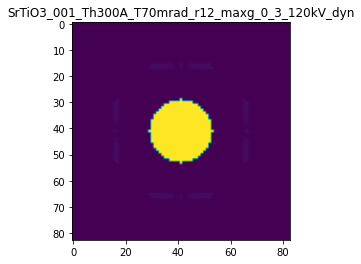

R-factor: 1.2026984377058955e-06

>>> producing the 22. dataset...

The offset applied on thickness: 0.0005055316278159687

The offset applied on Ug: 0.02151886710132957

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50553162781597
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

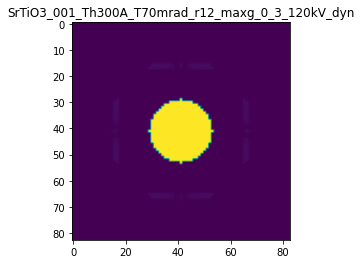

R-factor: 6.644630262559372e-07

>>> producing the 23. dataset...

The offset applied on thickness: -0.0008469223115505372

The offset applied on Ug: -0.004986621817686645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.15307768844946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

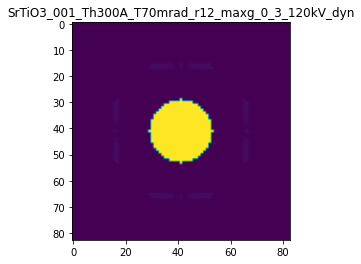

R-factor: 1.0692328466493994e-06

>>> producing the 24. dataset...

The offset applied on thickness: 0.0004759332529880647

The offset applied on Ug: -0.026378084010390303

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47593325298806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

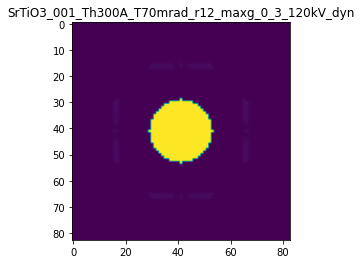

R-factor: 6.47659638603193e-07

>>> producing the 25. dataset...

The offset applied on thickness: -0.0004883036705647625

The offset applied on Ug: 0.005596991756418613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51169632943527
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

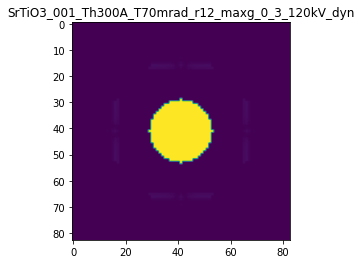

R-factor: 6.158626330192109e-07

>>> producing the 26. dataset...

The offset applied on thickness: -7.887636493701744e-05

The offset applied on Ug: -0.017423416752102083

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92112363506294
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

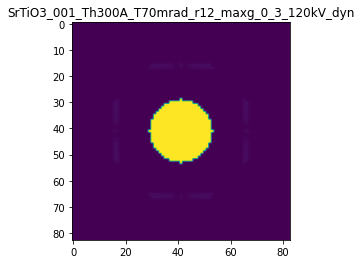

R-factor: 1.370315773176914e-07

>>> producing the 27. dataset...

The offset applied on thickness: -9.627768735673948e-05

The offset applied on Ug: -0.03875244826812582

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.90372231264325
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

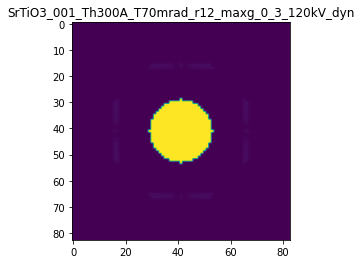

R-factor: 2.5090242027175257e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.0006731819244395741

The offset applied on Ug: -4.592627100630687e-05

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3268180755604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

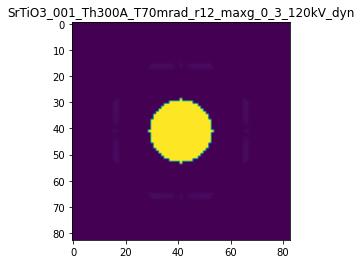

R-factor: 8.467710977229153e-07

>>> producing the 29. dataset...

The offset applied on thickness: -0.0006732076122991193

The offset applied on Ug: 0.017545608604628792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3267923877009
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

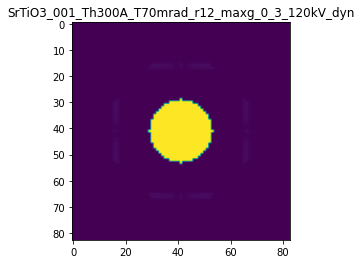

R-factor: 8.616920559516936e-07

>>> producing the 30. dataset...

The offset applied on thickness: 0.0002606855943615476

The offset applied on Ug: -0.0033998963445720687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2606855943615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

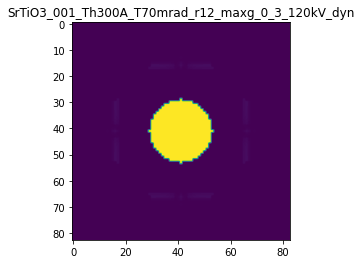

R-factor: 3.295117545018846e-07

>>> producing the 31. dataset...

The offset applied on thickness: 0.0009664442065169847

The offset applied on Ug: 0.035443667061894085

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.966444206517
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

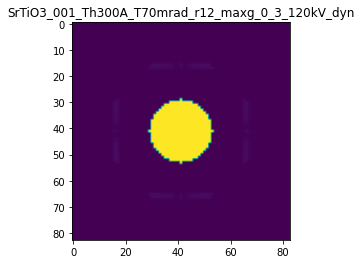

R-factor: 1.2633138036721408e-06

>>> producing the 32. dataset...

The offset applied on thickness: -0.00028406582147533644

The offset applied on Ug: -0.027038669623469333

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71593417852466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

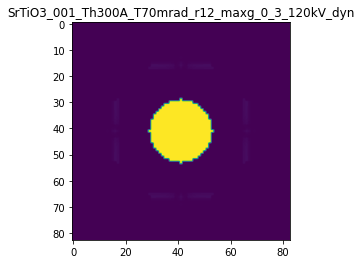

R-factor: 3.9790583855900986e-07

>>> producing the 33. dataset...

The offset applied on thickness: 0.00046925106424829013

The offset applied on Ug: -0.010948426239240812

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4692510642483
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

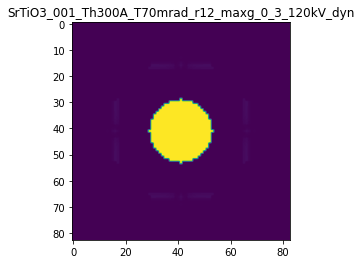

R-factor: 5.998544818979806e-07

>>> producing the 34. dataset...

The offset applied on thickness: 0.0003657893421385816

The offset applied on Ug: -0.012610947619974403

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3657893421386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

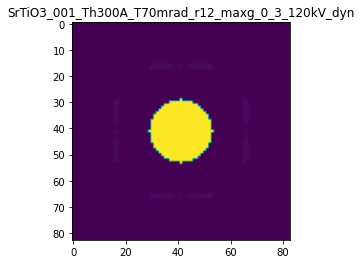

R-factor: 4.7485874587951667e-07

>>> producing the 35. dataset...

The offset applied on thickness: 0.00024178325813474922

The offset applied on Ug: -0.018996086991041557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2417832581347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

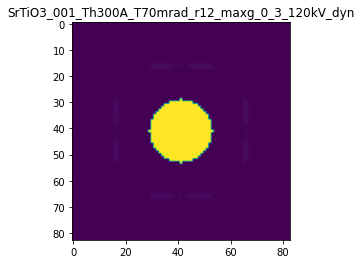

R-factor: 3.510133971142402e-07

>>> producing the 36. dataset...

The offset applied on thickness: 0.0008769351694162022

The offset applied on Ug: -0.0029331065279283577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87693516941624
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

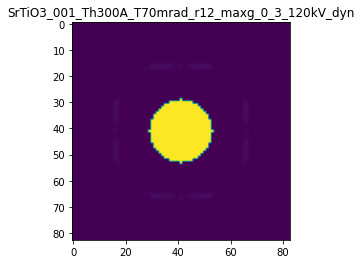

R-factor: 1.1069657655501953e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.0007378899994115817

The offset applied on Ug: 0.006353463615899253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2621100005884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

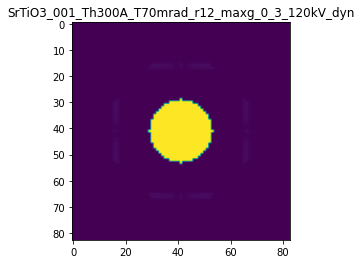

R-factor: 9.296903158691467e-07

>>> producing the 38. dataset...

The offset applied on thickness: -0.00028547771354865746

The offset applied on Ug: -0.031169132920875225

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71452228645137
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

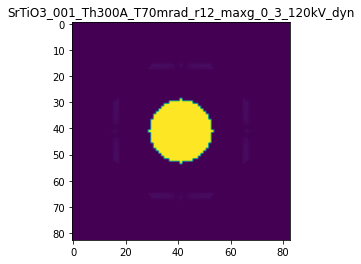

R-factor: 4.074136720182625e-07

>>> producing the 39. dataset...

The offset applied on thickness: -0.0008127083220874258

The offset applied on Ug: 0.036780685542552524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1872916779126
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

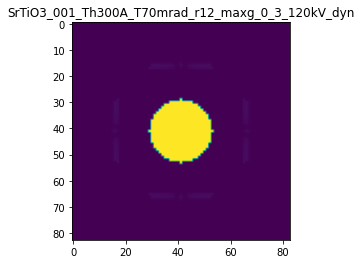

R-factor: 1.077596130034307e-06

>>> producing the 40. dataset...

The offset applied on thickness: 0.00022231166677818504

The offset applied on Ug: -0.016674756000840504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2223116667781
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

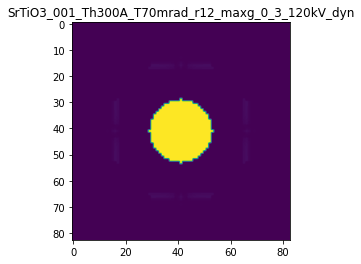

R-factor: 3.1957226664195887e-07

>>> producing the 41. dataset...

The offset applied on thickness: -0.0007202683872956561

The offset applied on Ug: -0.0061052850283111314

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2797316127043
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

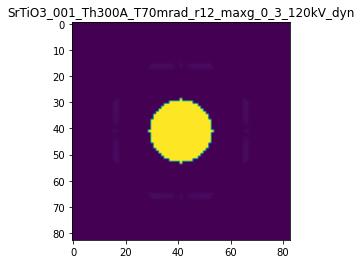

R-factor: 9.113509295812872e-07

>>> producing the 42. dataset...

The offset applied on thickness: -0.00034773814190414235

The offset applied on Ug: -0.026277669484925062

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65226185809587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

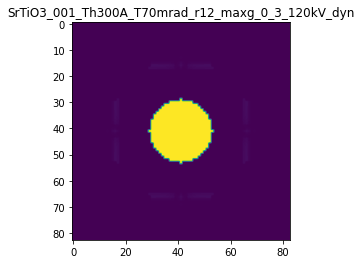

R-factor: 4.7501687334284295e-07

>>> producing the 43. dataset...

The offset applied on thickness: 0.0004595439906704899

The offset applied on Ug: -0.000755381399634123

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4595439906705
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

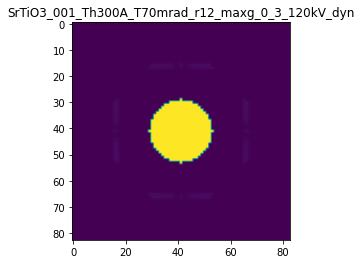

R-factor: 5.794478729740488e-07

>>> producing the 44. dataset...

The offset applied on thickness: -9.561891714518489e-05

The offset applied on Ug: 0.0351111760660603

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9043810828548
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

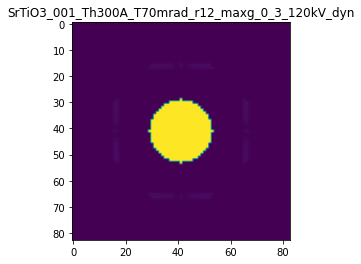

R-factor: 2.853850252683655e-07

>>> producing the 45. dataset...

The offset applied on thickness: -0.0008717667042709226

The offset applied on Ug: 0.03388922108859019

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12823329572905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

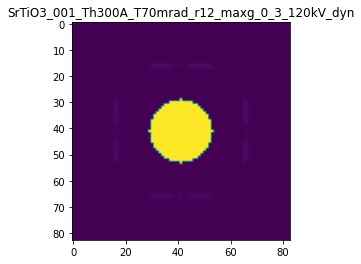

R-factor: 1.1393819805264705e-06

>>> producing the 46. dataset...

The offset applied on thickness: 0.0004531616998344341

The offset applied on Ug: -0.012876666096038117

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4531616998344
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

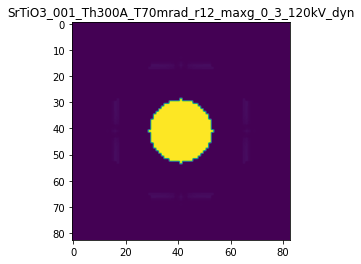

R-factor: 5.830810894039778e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0007204408604379932

The offset applied on Ug: 0.036777487215382564

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.720440860438
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

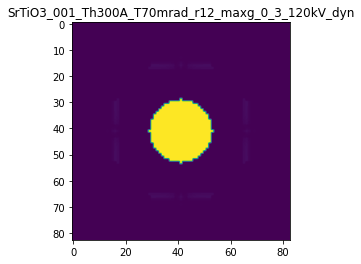

R-factor: 9.558811176781456e-07

>>> producing the 48. dataset...

The offset applied on thickness: 0.00017362662258025964

The offset applied on Ug: -0.02144011843212434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17362662258023
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

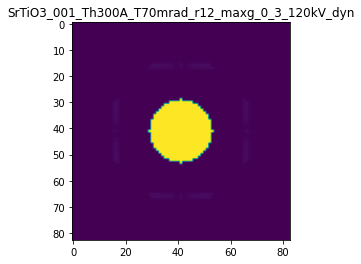

R-factor: 2.856325648999224e-07

>>> producing the 49. dataset...

The offset applied on thickness: -0.0007859667757578914

The offset applied on Ug: -0.002119895089893129

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21403322424214
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

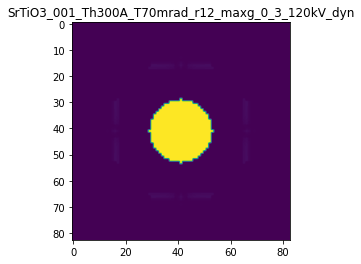

R-factor: 9.899894628449054e-07

>>> producing the 50. dataset...

The offset applied on thickness: 0.00098898644669407

The offset applied on Ug: 0.03740706675358963

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98898644669407
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

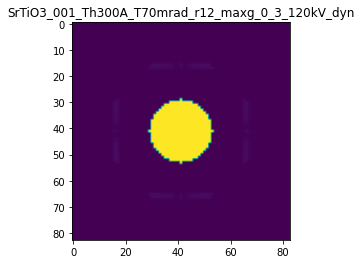

R-factor: 1.2944276211363348e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.000856641666380231

The offset applied on Ug: 0.005038750539741175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8566416663802
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

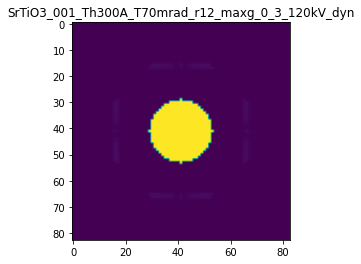

R-factor: 1.085330026888497e-06

>>> producing the 52. dataset...

The offset applied on thickness: -0.0006260331777750974

The offset applied on Ug: -0.033435765912860356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3739668222249
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

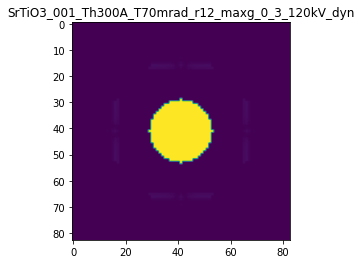

R-factor: 8.306969774360561e-07

>>> producing the 53. dataset...

The offset applied on thickness: 0.00018274034820673425

The offset applied on Ug: 0.014321436282499028

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1827403482067
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

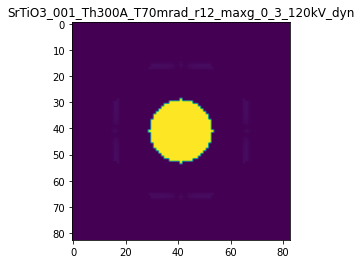

R-factor: 2.507700106516801e-07

>>> producing the 54. dataset...

The offset applied on thickness: 0.00010575516314041411

The offset applied on Ug: 0.03260880263655278

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.10575516314043
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

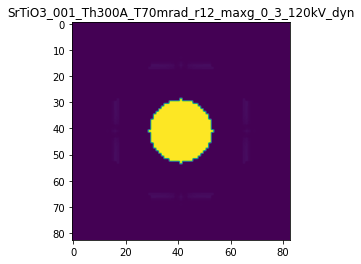

R-factor: 2.2665732038652142e-07

>>> producing the 55. dataset...

The offset applied on thickness: -0.0009668684687002538

The offset applied on Ug: 0.025956067394087255

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0331315312997
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

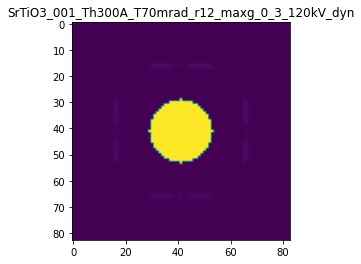

R-factor: 1.2381314010087741e-06

>>> producing the 56. dataset...

The offset applied on thickness: -0.00023097928570129267

The offset applied on Ug: 0.0013384976985049235

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7690207142987
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

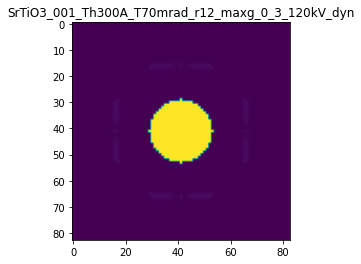

R-factor: 2.910972613678339e-07

>>> producing the 57. dataset...

The offset applied on thickness: 0.00031821972258525255

The offset applied on Ug: 0.002015855071347001

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.31821972258524
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

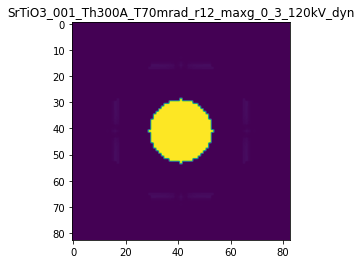

R-factor: 4.0288363295485353e-07

>>> producing the 58. dataset...

The offset applied on thickness: -0.000564582164839343

The offset applied on Ug: -0.015581032699591688

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43541783516065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

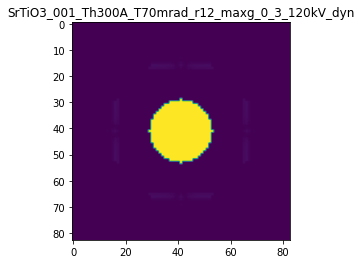

R-factor: 7.28626581442076e-07

>>> producing the 59. dataset...

The offset applied on thickness: 0.00045639080785287356

The offset applied on Ug: 0.031137130450787653

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.45639080785287
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

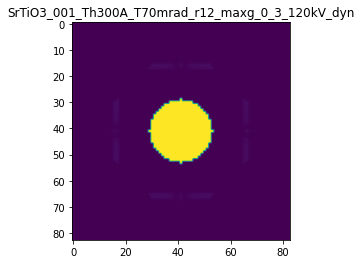

R-factor: 6.184080706779981e-07

>>> producing the 60. dataset...

The offset applied on thickness: 0.0009749606314212707

The offset applied on Ug: -0.02264816104078977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97496063142125
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

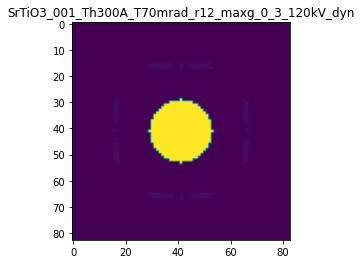

R-factor: 1.2472717588574575e-06

>>> producing the 61. dataset...

The offset applied on thickness: -0.0008499966363433444

The offset applied on Ug: 0.013845631679854229

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.15000336365665
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

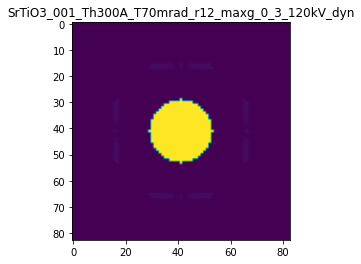

R-factor: 1.0753412172998467e-06

>>> producing the 62. dataset...

The offset applied on thickness: 0.00020151308272318814

The offset applied on Ug: -0.027415957370689678

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2015130827232
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

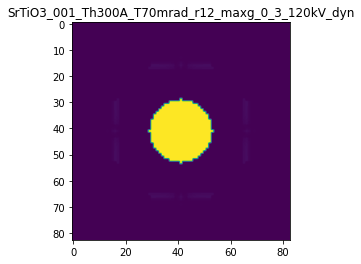

R-factor: 3.440492587968408e-07

>>> producing the 63. dataset...

The offset applied on thickness: 0.00019299045025478813

The offset applied on Ug: -0.03021992888594064

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1929904502548
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

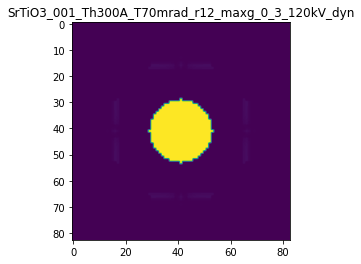

R-factor: 3.4972594815486146e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.0004138504676765054

The offset applied on Ug: 0.00867460369614788

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5861495323235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

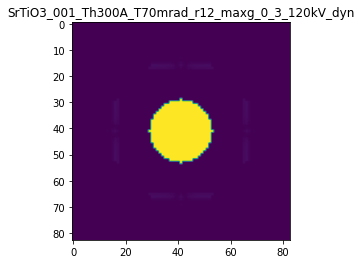

R-factor: 5.265104809604152e-07

>>> producing the 65. dataset...

The offset applied on thickness: 0.0006782682925972919

The offset applied on Ug: -0.0015348031927523477

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6782682925973
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

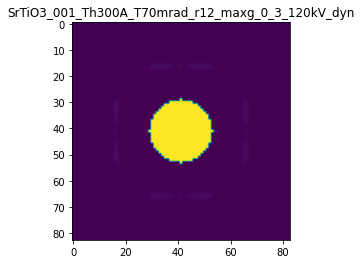

R-factor: 8.556802844176918e-07

>>> producing the 66. dataset...

The offset applied on thickness: 0.000524281618438246

The offset applied on Ug: 0.025809784524437135

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52428161843824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

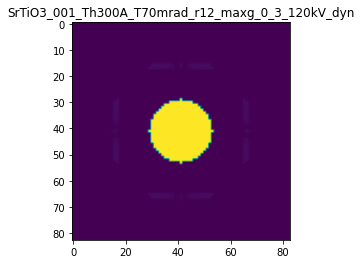

R-factor: 6.940446230655385e-07

>>> producing the 67. dataset...

The offset applied on thickness: 0.0004528361534810697

The offset applied on Ug: 0.035881176560034096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4528361534811
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

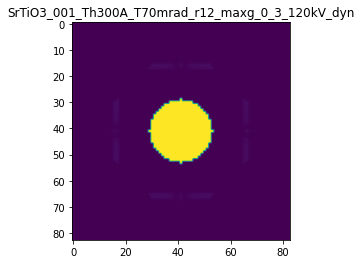

R-factor: 6.222779280240163e-07

>>> producing the 68. dataset...

The offset applied on thickness: 0.0005002560755977395

The offset applied on Ug: 0.026273889160013723

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5002560755977
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

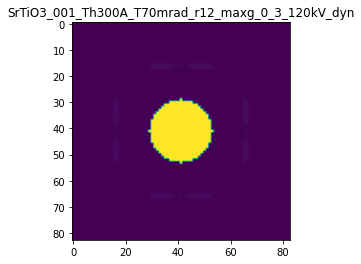

R-factor: 6.645513752840411e-07

>>> producing the 69. dataset...

The offset applied on thickness: 0.0007253774343188831

The offset applied on Ug: -0.012945019440626142

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7253774343189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

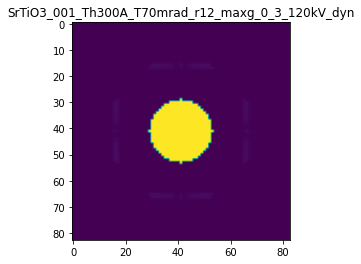

R-factor: 9.215949793283225e-07

>>> producing the 70. dataset...

The offset applied on thickness: -0.0007604555166387119

The offset applied on Ug: 0.019888280322656816

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23954448336127
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

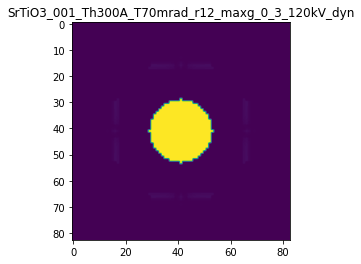

R-factor: 9.733187334990466e-07

>>> producing the 71. dataset...

The offset applied on thickness: -0.0004043712318135615

The offset applied on Ug: 0.03364725360623383

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59562876818643
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

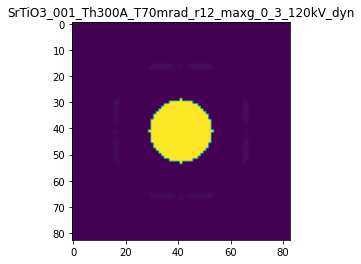

R-factor: 5.93935688256173e-07

>>> producing the 72. dataset...

The offset applied on thickness: 6.222438632487525e-05

The offset applied on Ug: -0.02797718834438818

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06222438632483
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

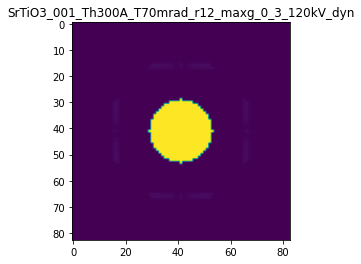

R-factor: 2.1562859952570918e-07

>>> producing the 73. dataset...

The offset applied on thickness: -4.022943901174481e-05

The offset applied on Ug: -0.014733878009363882

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95977056098826
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

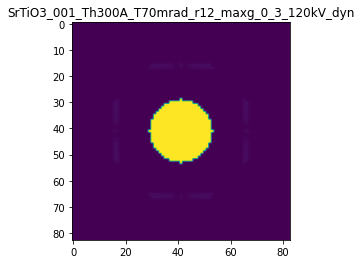

R-factor: 9.760919398355609e-08

>>> producing the 74. dataset...

The offset applied on thickness: 0.00033679050493618255

The offset applied on Ug: 0.03986621740651979

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3367905049362
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

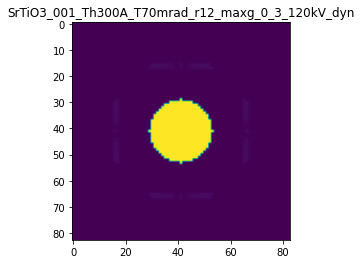

R-factor: 4.865008206464434e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.0004631914056497575

The offset applied on Ug: -0.03400493750443435

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46319140564975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

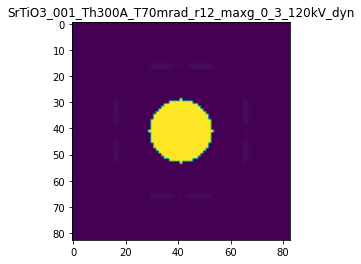

R-factor: 6.63113986981075e-07

>>> producing the 76. dataset...

The offset applied on thickness: 0.0007131877270710747

The offset applied on Ug: -0.006763001103682385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71318772707104
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

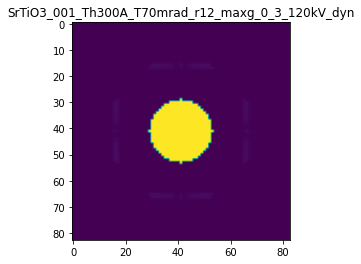

R-factor: 9.011456843773333e-07

>>> producing the 77. dataset...

The offset applied on thickness: 0.0008347078937356269

The offset applied on Ug: -0.019271770998293133

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.83470789373564
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

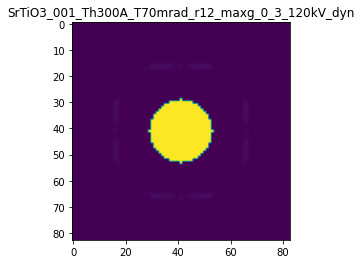

R-factor: 1.0673844602492707e-06

>>> producing the 78. dataset...

The offset applied on thickness: -6.81290866074491e-06

The offset applied on Ug: 0.017520621598198102

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9931870913393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

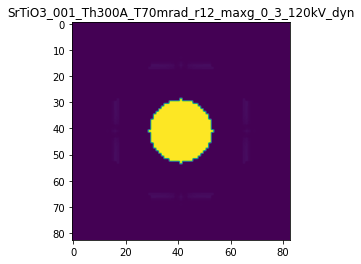

R-factor: 1.1150861085334889e-07

>>> producing the 79. dataset...

The offset applied on thickness: 0.0008497949161127024

The offset applied on Ug: -0.0021154245260424356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84979491611267
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

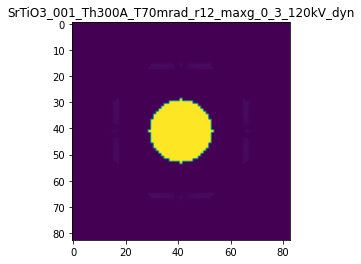

R-factor: 1.0724606570535632e-06

>>> producing the 80. dataset...

The offset applied on thickness: -6.424335050554575e-05

The offset applied on Ug: 0.0003635104786607801

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93575664949446
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

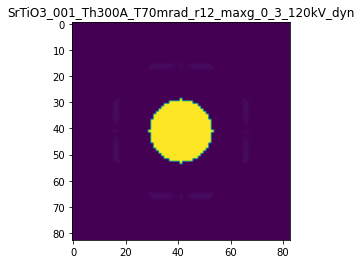

R-factor: 8.096547765987479e-08

>>> producing the 81. dataset...

The offset applied on thickness: 5.388100431364062e-06

The offset applied on Ug: 0.01725683582761758

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0053881004314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

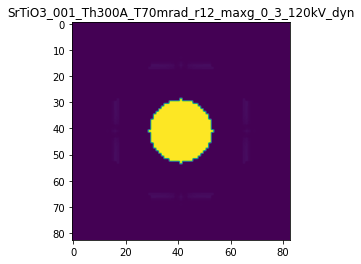

R-factor: 1.0344502951764208e-07

>>> producing the 82. dataset...

The offset applied on thickness: 0.0009612489631879348

The offset applied on Ug: 0.00019548186698835403

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9612489631879
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

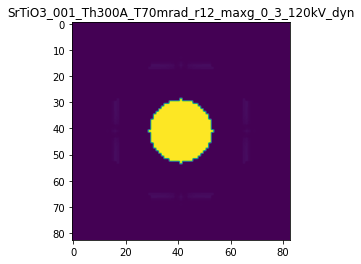

R-factor: 1.212923910626008e-06

>>> producing the 83. dataset...

The offset applied on thickness: -0.00047108944867071137

The offset applied on Ug: 0.031081802577713313

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5289105513293
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

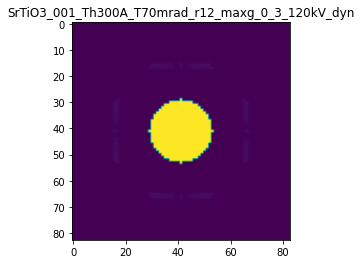

R-factor: 6.594016715045271e-07

>>> producing the 84. dataset...

The offset applied on thickness: -0.000538470430446075

The offset applied on Ug: -0.0016115719407133612

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46152956955393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

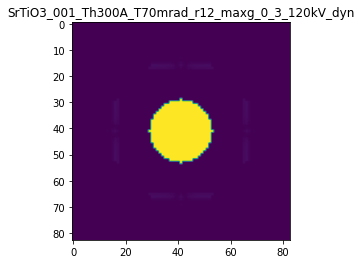

R-factor: 6.787236854236891e-07

>>> producing the 85. dataset...

The offset applied on thickness: -0.0007576682654641381

The offset applied on Ug: 0.03856663872333308

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24233173453587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

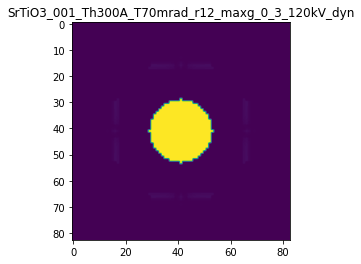

R-factor: 1.0175383180646357e-06

>>> producing the 86. dataset...

The offset applied on thickness: -3.193963488983065e-05

The offset applied on Ug: -0.02881114476185127

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96806036511015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

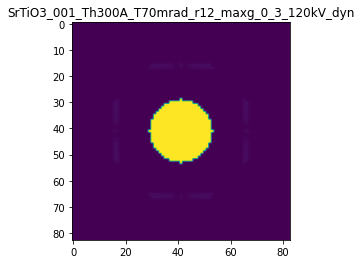

R-factor: 1.701802704035779e-07

>>> producing the 87. dataset...

The offset applied on thickness: -0.00034097358019838733

The offset applied on Ug: 0.02542879462866508

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6590264198016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

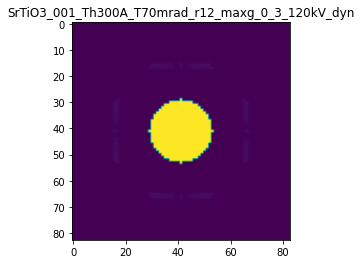

R-factor: 4.890706228053051e-07

>>> producing the 88. dataset...

The offset applied on thickness: -0.00023654824460669734

The offset applied on Ug: -0.012252149078881756

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7634517553933
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

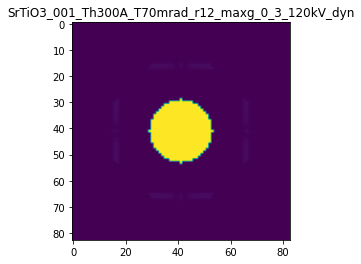

R-factor: 3.135418921806174e-07

>>> producing the 89. dataset...

The offset applied on thickness: 0.0005404321415465823

The offset applied on Ug: 0.001404202211929535

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5404321415466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

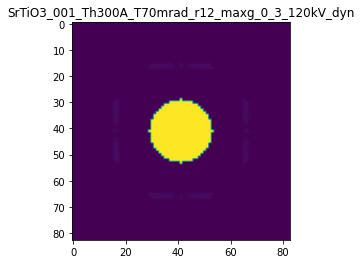

R-factor: 6.8250018450596e-07

>>> producing the 90. dataset...

The offset applied on thickness: -0.00019706660367498064

The offset applied on Ug: -0.00986469266754681

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80293339632505
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

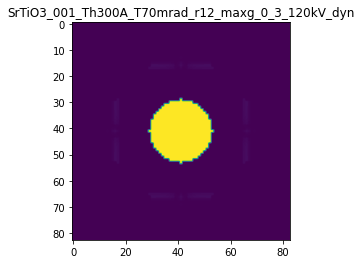

R-factor: 2.607330331111601e-07

>>> producing the 91. dataset...

The offset applied on thickness: 3.5029925686502094e-05

The offset applied on Ug: -0.011303119743111214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0350299256865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

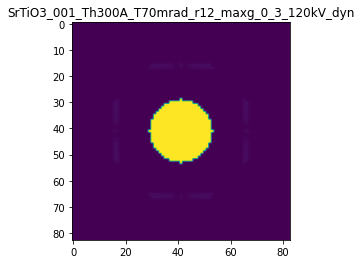

R-factor: 9.560027805200921e-08

>>> producing the 92. dataset...

The offset applied on thickness: 0.0004718134826155602

The offset applied on Ug: 0.007837220556085355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4718134826155
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

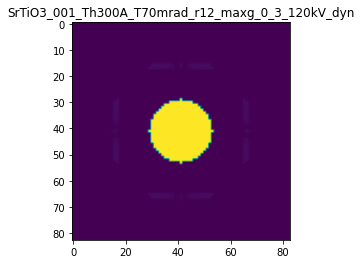

R-factor: 6.030936199338392e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.0005706069465931815

The offset applied on Ug: -0.004343621442922671

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42939305340684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

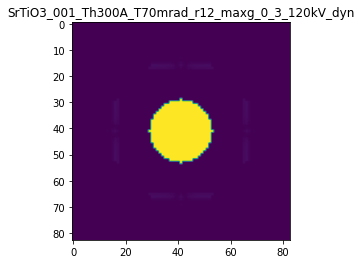

R-factor: 7.217178335328114e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.0005298925590420876

The offset applied on Ug: 0.032157284067797644

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4701074409579
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

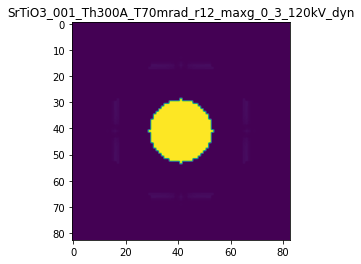

R-factor: 7.305312802723045e-07

>>> producing the 95. dataset...

The offset applied on thickness: -0.0009591944703371516

The offset applied on Ug: -0.03126697787558792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04080552966286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

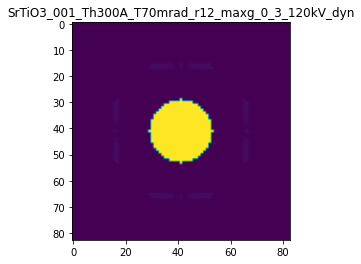

R-factor: 1.243531645316113e-06

>>> producing the 96. dataset...

The offset applied on thickness: 0.0006276160934883477

The offset applied on Ug: 0.02199648525648363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6276160934883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

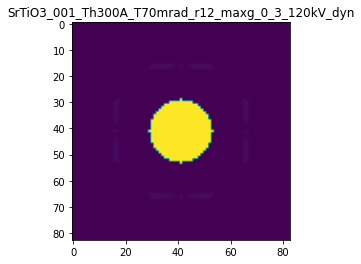

R-factor: 8.184703038093523e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.0006408066399076728

The offset applied on Ug: -0.013531687780034485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6408066399077
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

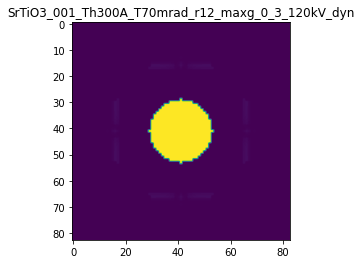

R-factor: 8.170754454680207e-07

>>> producing the 98. dataset...

The offset applied on thickness: 0.000580844802272003

The offset applied on Ug: 0.036412873286526086

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.580844802272
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

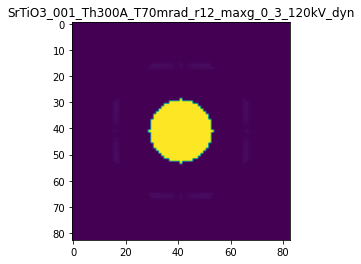

R-factor: 7.815942740135247e-07

>>> producing the 99. dataset...

The offset applied on thickness: 0.0008957839816002115

The offset applied on Ug: 0.0007428111961211492

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.89578398160023
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

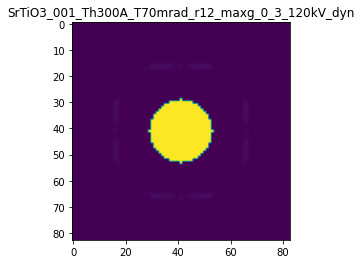

R-factor: 1.130525347682442e-06

>>> producing the 100. dataset...

The offset applied on thickness: -0.00011217624273198923

The offset applied on Ug: 0.03306963471057799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88782375726805
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

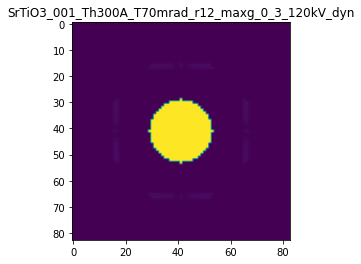

R-factor: 2.8826800782933064e-07

>>> producing the 101. dataset...

The offset applied on thickness: -7.758501350151992e-06

The offset applied on Ug: -0.037192539176410494

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99224149864983
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

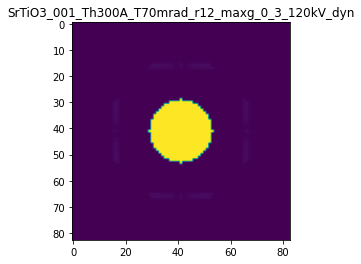

R-factor: 2.2427534902111027e-07

>>> producing the 102. dataset...

The offset applied on thickness: 0.0007955488608131669

The offset applied on Ug: 0.005422965387507733

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79554886081314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

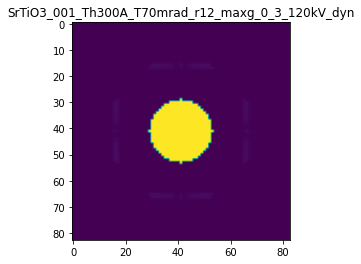

R-factor: 1.0085384069880933e-06

>>> producing the 103. dataset...

The offset applied on thickness: 0.0007988725385419544

The offset applied on Ug: -0.0022334217433449943

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7988725385419
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

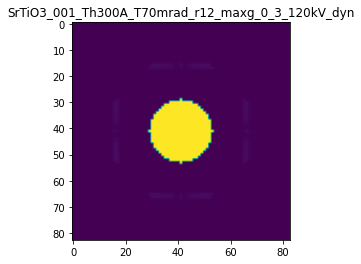

R-factor: 1.0081664042117881e-06

>>> producing the 104. dataset...

The offset applied on thickness: 0.0006354815613170976

The offset applied on Ug: -0.029699038421385025

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6354815613171
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

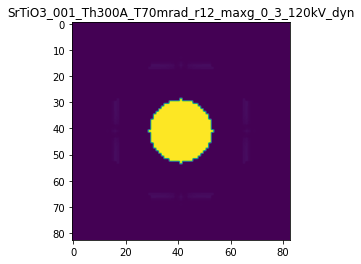

R-factor: 8.478790672544084e-07

>>> producing the 105. dataset...

The offset applied on thickness: -9.935565500549526e-07

The offset applied on Ug: -0.015036864564432798

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99900644344996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

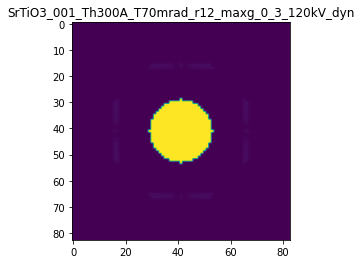

R-factor: 9.179880737810508e-08

>>> producing the 106. dataset...

The offset applied on thickness: -0.0003032855332558535

The offset applied on Ug: -0.016688950529002114

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69671446674414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

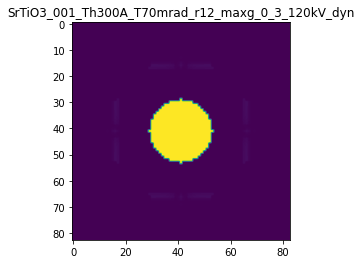

R-factor: 4.0337286825294544e-07

>>> producing the 107. dataset...

The offset applied on thickness: -0.0008558099391303642

The offset applied on Ug: 0.02185933627884225

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1441900608696
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

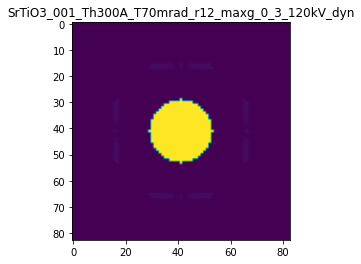

R-factor: 1.0943072169109346e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.0004022469885943092

The offset applied on Ug: 0.034124641884514244

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4022469885943
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

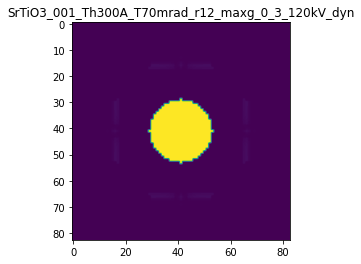

R-factor: 5.566514575319557e-07

>>> producing the 109. dataset...

The offset applied on thickness: 0.0009396115120923392

The offset applied on Ug: 0.01439971130582137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9396115120923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

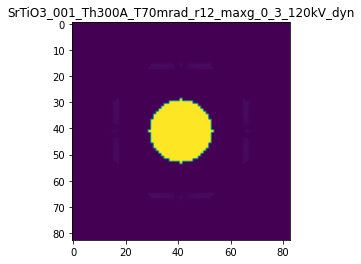

R-factor: 1.2004463709586044e-06

>>> producing the 110. dataset...

The offset applied on thickness: -0.00026473589687478526

The offset applied on Ug: 0.015979684335363037

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7352641031252
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

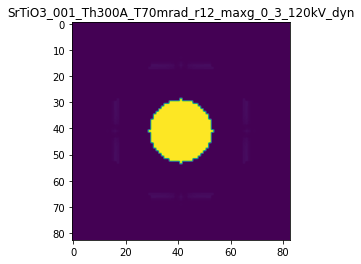

R-factor: 3.6478837478030724e-07

>>> producing the 111. dataset...

The offset applied on thickness: 0.0002650536692403258

The offset applied on Ug: -0.004473736614580508

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26505366924033
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

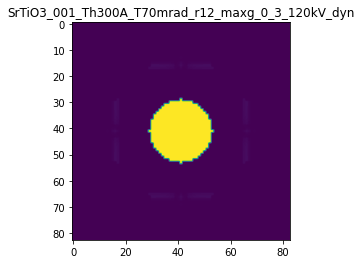

R-factor: 3.361943904093919e-07

>>> producing the 112. dataset...

The offset applied on thickness: -0.00039531952729372777

The offset applied on Ug: 0.025942802179317753

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.60468047270626
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

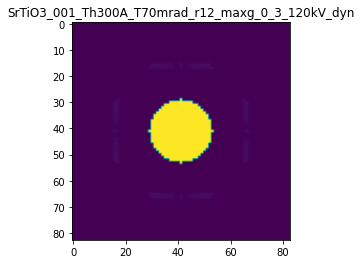

R-factor: 5.528515716910169e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.00023116488667662094

The offset applied on Ug: 0.027702206742743405

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76883511332335
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

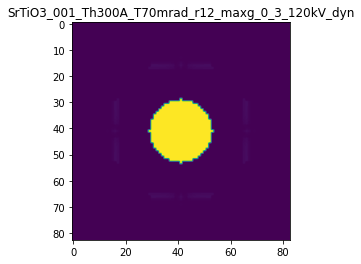

R-factor: 3.7586565550440405e-07

>>> producing the 114. dataset...

The offset applied on thickness: 0.0006940867943839051

The offset applied on Ug: -0.010954380466101652

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6940867943839
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

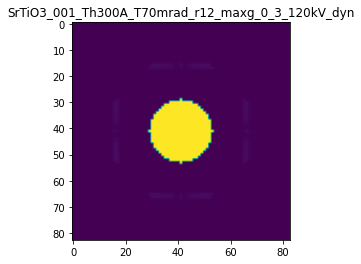

R-factor: 8.801554177850123e-07

>>> producing the 115. dataset...

The offset applied on thickness: 0.000696492999521362

The offset applied on Ug: 0.02313423113442127

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69649299952135
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

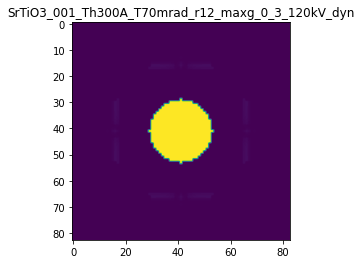

R-factor: 9.066114143283135e-07

>>> producing the 116. dataset...

The offset applied on thickness: -9.988778882736793e-05

The offset applied on Ug: -0.03480750870873798

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.90011221117265
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

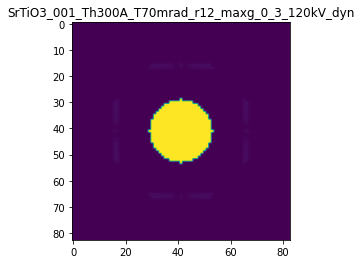

R-factor: 2.3365426490146875e-07

>>> producing the 117. dataset...

The offset applied on thickness: -0.00029450876459048556

The offset applied on Ug: -0.0005434949660893107

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7054912354095
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

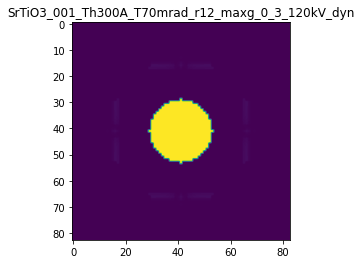

R-factor: 3.710545293376516e-07

>>> producing the 118. dataset...

The offset applied on thickness: 0.0005332686315870104

The offset applied on Ug: 0.022656851859737835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.533268631587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

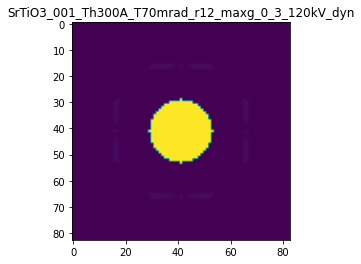

R-factor: 7.008938249888465e-07

>>> producing the 119. dataset...

The offset applied on thickness: -0.00016899744620980806

The offset applied on Ug: -0.002489902616847424

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8310025537902
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

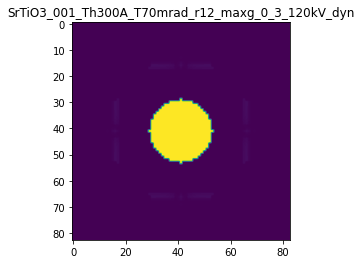

R-factor: 2.1525898648258298e-07

>>> producing the 120. dataset...

The offset applied on thickness: -0.0005456744140418996

The offset applied on Ug: 0.027734110419857905

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4543255859581
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

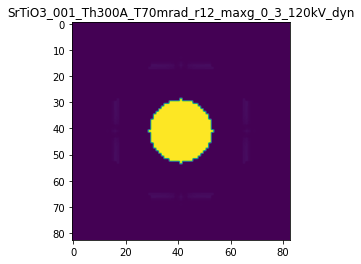

R-factor: 7.329836311065289e-07

>>> producing the 121. dataset...

The offset applied on thickness: 0.0005418026623903958

The offset applied on Ug: 0.00433714653776863

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5418026623904
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

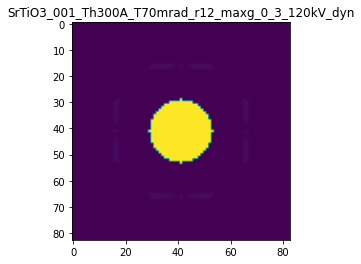

R-factor: 6.871465005603784e-07

>>> producing the 122. dataset...

The offset applied on thickness: 0.00047239290611637966

The offset applied on Ug: -0.021256252924134182

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4723929061164
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

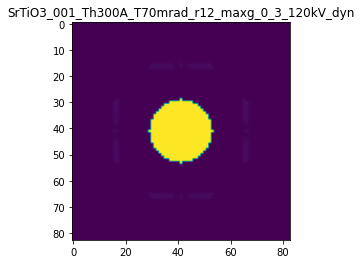

R-factor: 6.27652109981405e-07

>>> producing the 123. dataset...

The offset applied on thickness: -0.0005374743277041365

The offset applied on Ug: 0.039331085767787245

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46252567229584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

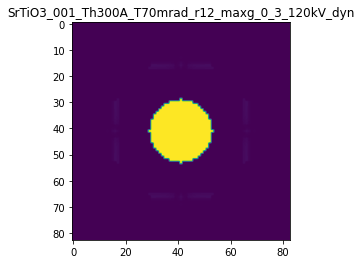

R-factor: 7.67676331359181e-07

>>> producing the 124. dataset...

The offset applied on thickness: 2.7775395816279635e-05

The offset applied on Ug: 0.0276660626398479

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.02777539581626
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

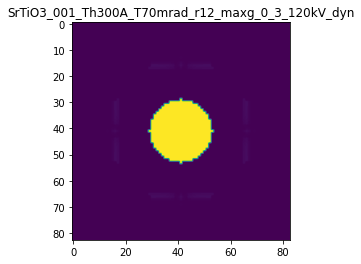

R-factor: 1.633738629081201e-07

>>> producing the 125. dataset...

The offset applied on thickness: 0.0008872155040512983

The offset applied on Ug: 0.027915867812321665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8872155040513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

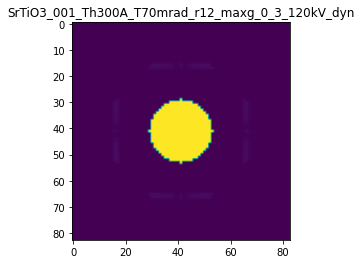

R-factor: 1.1530903576628097e-06

>>> producing the 126. dataset...

The offset applied on thickness: -0.0009116684467459692

The offset applied on Ug: 0.02712795312240046

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.088331553254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

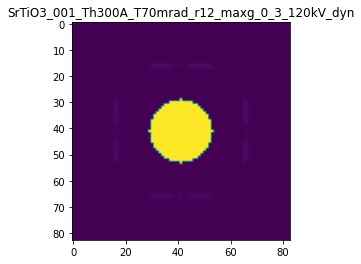

R-factor: 1.1719314565184442e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.00013084264060859386

The offset applied on Ug: -0.03701441586272692

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1308426406086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

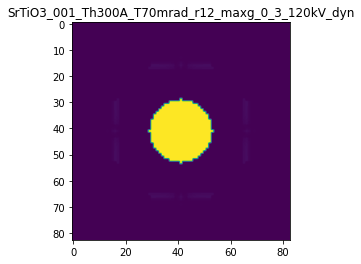

R-factor: 3.2749854734521025e-07

>>> producing the 128. dataset...

The offset applied on thickness: 0.0004670031494337552

The offset applied on Ug: 0.029458678049196198

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46700314943376
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

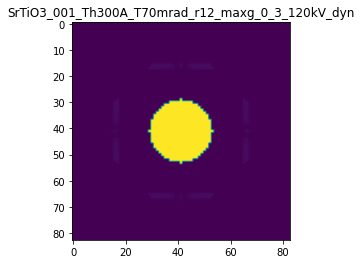

R-factor: 6.286152616339938e-07

>>> producing the 129. dataset...

The offset applied on thickness: -0.00027174020667393916

The offset applied on Ug: -0.0113741038501382

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72825979332606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

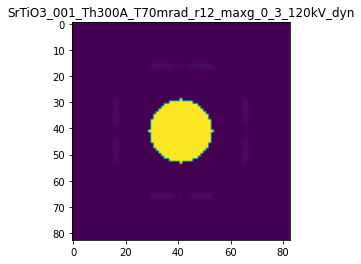

R-factor: 3.563154884882003e-07

>>> producing the 130. dataset...

The offset applied on thickness: -0.0006065337513053865

The offset applied on Ug: -0.023545023379826703

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3934662486946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

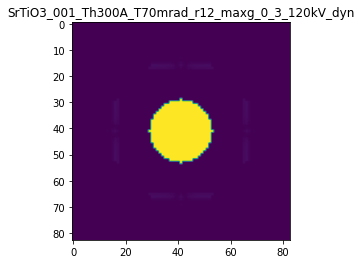

R-factor: 7.921778768471848e-07

>>> producing the 131. dataset...

The offset applied on thickness: -0.0008517060820386062

The offset applied on Ug: -0.039417100065349986

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1482939179614
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

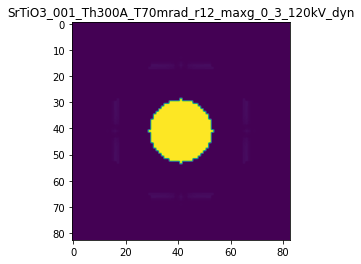

R-factor: 1.1209129306255282e-06

>>> producing the 132. dataset...

The offset applied on thickness: 4.959121659736976e-05

The offset applied on Ug: 0.027346881057154306

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0495912165974
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

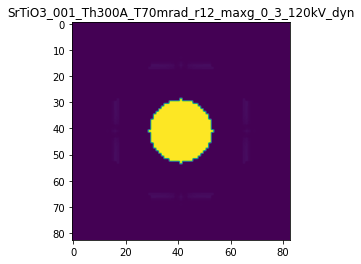

R-factor: 1.675102922814508e-07

>>> producing the 133. dataset...

The offset applied on thickness: 0.0006918440759916282

The offset applied on Ug: -0.03512816959255258

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69184407599164
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

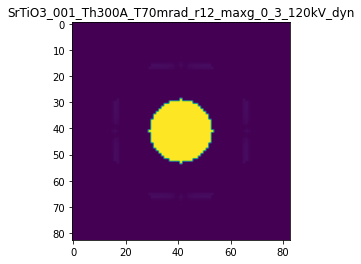

R-factor: 9.314812600068514e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.0007587629846887276

The offset applied on Ug: 0.003306780637217903

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75876298468876
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

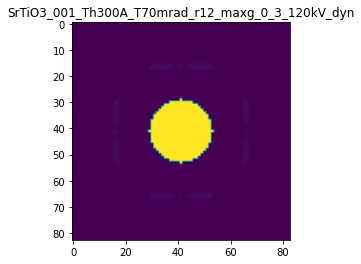

R-factor: 9.599812687738454e-07

>>> producing the 135. dataset...

The offset applied on thickness: 0.0003109026215952588

The offset applied on Ug: 0.03227188872096352

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3109026215953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

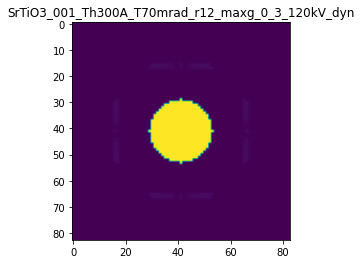

R-factor: 4.4067776262412896e-07

>>> producing the 136. dataset...

The offset applied on thickness: -0.0004931002986218795

The offset applied on Ug: 0.0019152142331771316

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50689970137813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

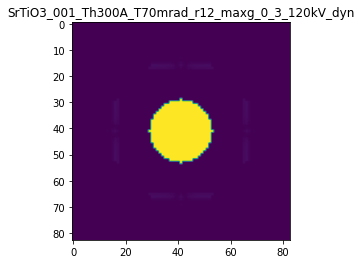

R-factor: 6.209424336358743e-07

>>> producing the 137. dataset...

The offset applied on thickness: 0.0008170726202856645

The offset applied on Ug: 0.03354376978064783

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81707262028567
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

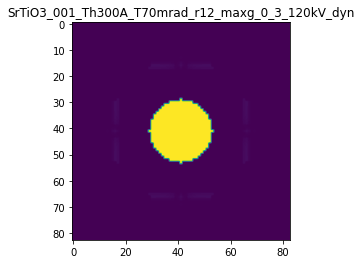

R-factor: 1.0727958225326802e-06

>>> producing the 138. dataset...

The offset applied on thickness: 0.0009679220530500994

The offset applied on Ug: -0.01573652058021943

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9679220530501
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

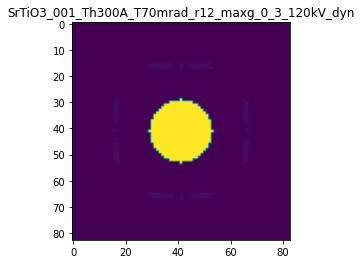

R-factor: 1.2285278858444453e-06

>>> producing the 139. dataset...

The offset applied on thickness: -0.0009208081247369666

The offset applied on Ug: 0.012058682859193554

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.079191875263
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

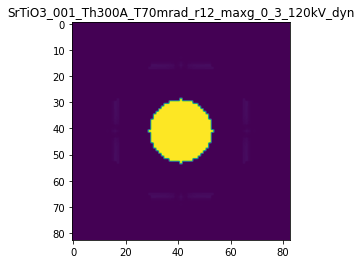

R-factor: 1.1614440239073937e-06

>>> producing the 140. dataset...

The offset applied on thickness: 0.0002808225071392867

The offset applied on Ug: 0.029274207424765077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2808225071393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

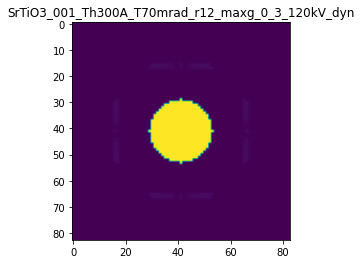

R-factor: 3.9827521656202685e-07



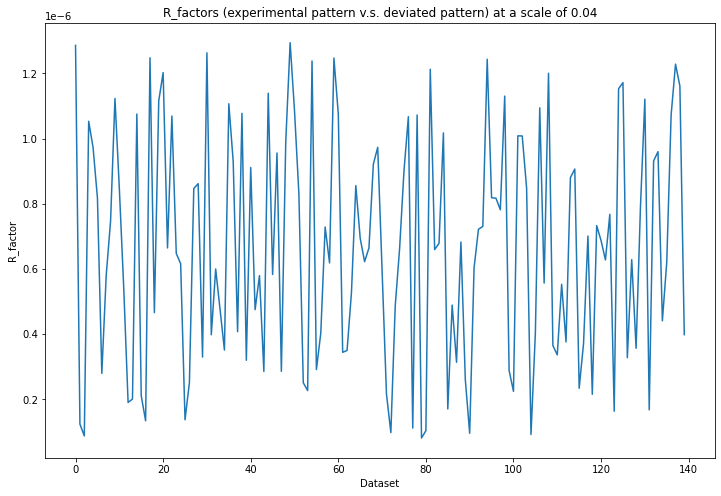

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 374ms/step - loss: 0.1994 - acc: 0.0000e+00 - val_loss: 0.1336 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 221ms/step - loss: 0.1117 - acc: 0.0000e+00 - val_loss: 0.0765 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 217ms/step - loss: 0.0623 - acc: 0.0000e+00 - val_loss: 0.0456 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 230ms/step - loss: 0.0350 - acc: 0.0000e+00 - val_loss: 0.0238 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 227ms/step - loss: 0.0179 - acc: 0.0000e+00 - val_loss: 0.0104 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 218ms/step - loss: 0.0074 - acc: 0.4000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 224ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

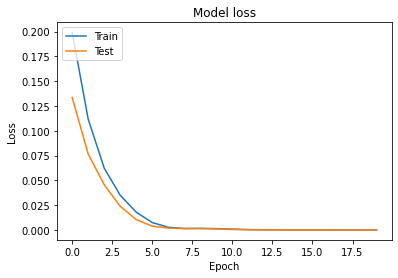

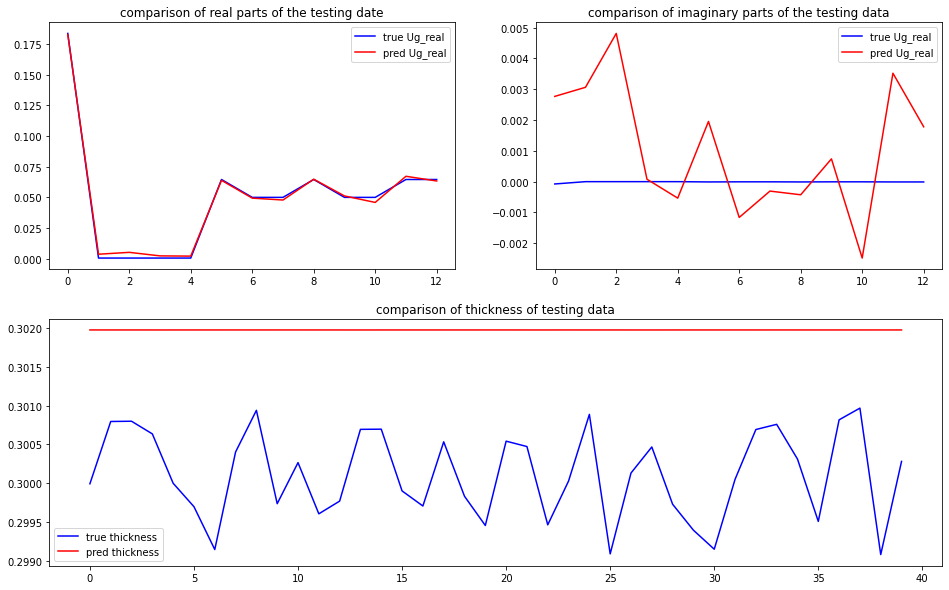

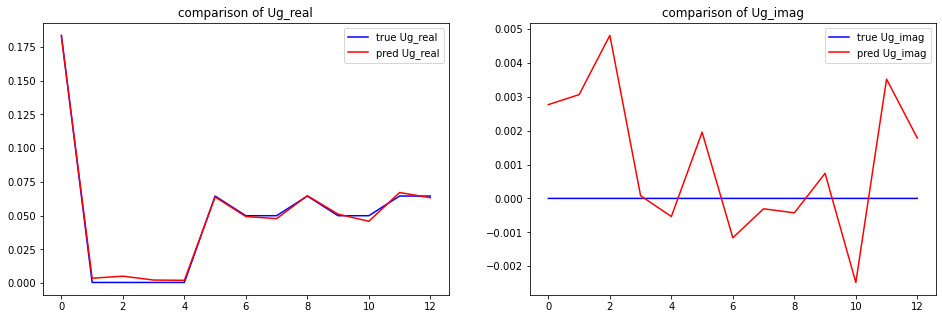

predicted thickness: 30.19760251045227 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=301.9760251045227
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18259358+0.j         0.004351

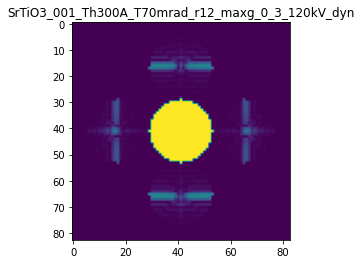

X_sim.max(): 0.9999302069916327
R-factor at a scale of 0.04 is 0.011336085102851218.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.08

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.000976311874047585

The offset applied on Ug: -0.03705765367934338

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
ta

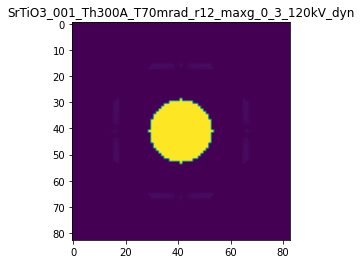

R-factor: 1.2780139094178672e-06

>>> producing the 2. dataset...

The offset applied on thickness: -0.0006304781172787493

The offset applied on Ug: -0.006544265670844425

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.36952188272124
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

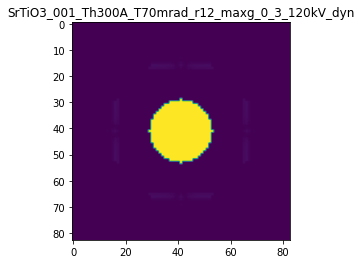

R-factor: 7.990360210297403e-07

>>> producing the 3. dataset...

The offset applied on thickness: -0.0009062231641186905

The offset applied on Ug: 0.008738488251242096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0937768358813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

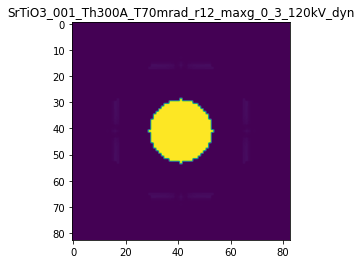

R-factor: 1.141665976750811e-06

>>> producing the 4. dataset...

The offset applied on thickness: 0.0009754295304616742

The offset applied on Ug: -0.054713595140803886

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9754295304616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

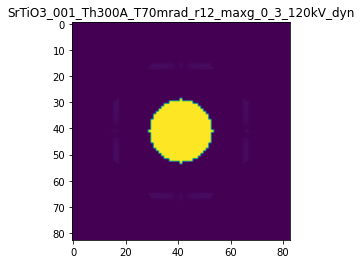

R-factor: 1.3308288107118286e-06

>>> producing the 5. dataset...

The offset applied on thickness: 0.0007538083654002037

The offset applied on Ug: 0.03336938299706255

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7538083654002
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

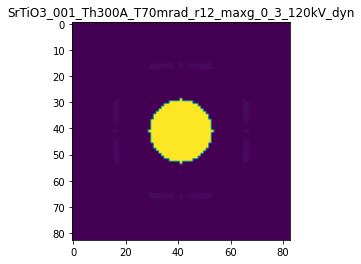

R-factor: 9.930221837612458e-07

>>> producing the 6. dataset...

The offset applied on thickness: 0.00030220438629422207

The offset applied on Ug: -0.031038276185152237

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30220438629425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

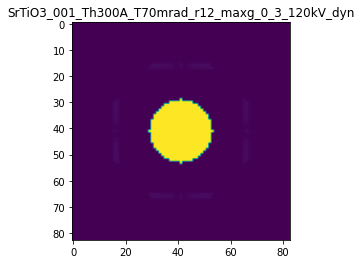

R-factor: 4.6838646443871983e-07

>>> producing the 7. dataset...

The offset applied on thickness: -0.0006113423506799139

The offset applied on Ug: -0.04244764547494091

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3886576493201
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

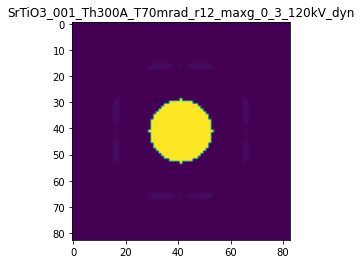

R-factor: 8.281577143644698e-07

>>> producing the 8. dataset...

The offset applied on thickness: -0.0007167517894714011

The offset applied on Ug: 0.07485019673880543

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2832482105286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

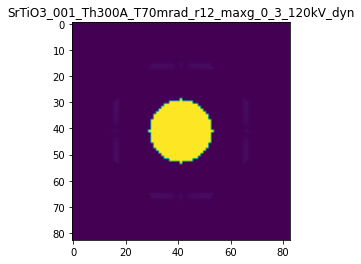

R-factor: 1.1140283895387996e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.0009782710235337274

The offset applied on Ug: -0.0028311476424989833

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0217289764663
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

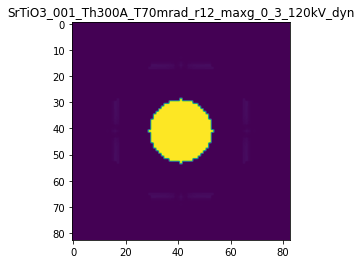

R-factor: 1.2319306587933815e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.0009591529496139237

The offset applied on Ug: -0.057792803982898246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9591529496139
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

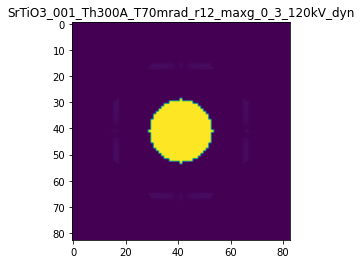

R-factor: 1.3240924261928548e-06

>>> producing the 11. dataset...

The offset applied on thickness: -0.0006417978680364745

The offset applied on Ug: 0.047611739945886314

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35820213196354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

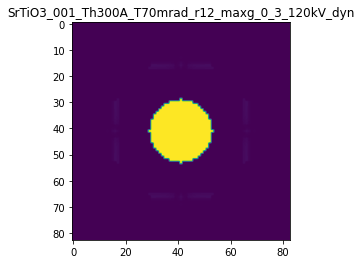

R-factor: 9.191063977010424e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.00033321853569143455

The offset applied on Ug: -0.07509739944820726

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33321853569146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

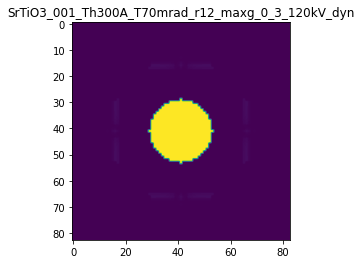

R-factor: 7.265355496366539e-07

>>> producing the 13. dataset...

The offset applied on thickness: -8.328814368500193e-05

The offset applied on Ug: -0.06257577622388276

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.916711856315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

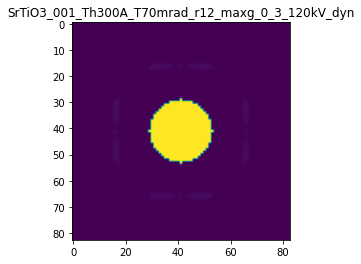

R-factor: 3.72478398461918e-07

>>> producing the 14. dataset...

The offset applied on thickness: 0.0008636944142847459

The offset applied on Ug: -0.0038440991966203165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86369441428474
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

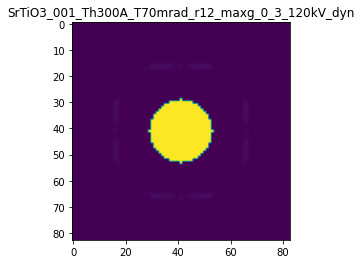

R-factor: 1.0904782214758841e-06

>>> producing the 15. dataset...

The offset applied on thickness: -0.0009047299814401666

The offset applied on Ug: -0.05281374496780876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09527001855986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

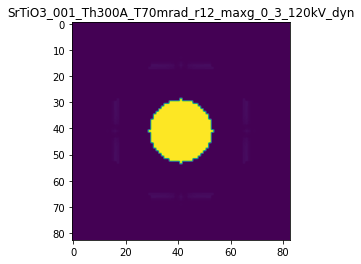

R-factor: 1.2072839747575185e-06

>>> producing the 16. dataset...

The offset applied on thickness: -0.0001323922901177108

The offset applied on Ug: 0.05947453221307306

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8676077098823
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

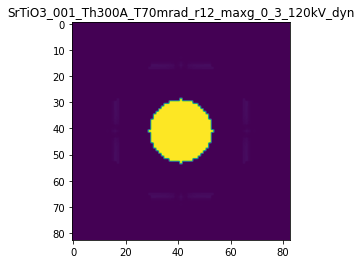

R-factor: 4.585019453306116e-07

>>> producing the 17. dataset...

The offset applied on thickness: 0.0009978410808855257

The offset applied on Ug: -0.049472985242817916

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9978410808855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

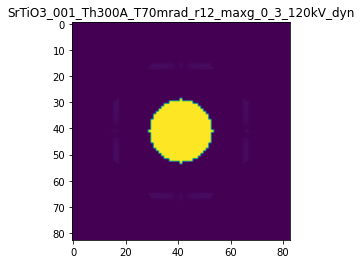

R-factor: 1.3406825779058182e-06

>>> producing the 18. dataset...

The offset applied on thickness: -0.0009414413826741166

The offset applied on Ug: 0.014138726734766021

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0585586173259
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

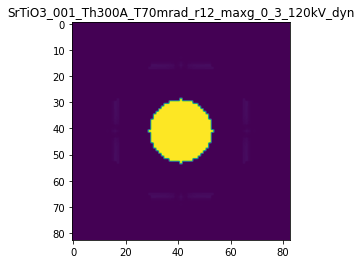

R-factor: 1.1894653200391742e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.00018706074910074212

The offset applied on Ug: 0.022794536571678316

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.18706074910074
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

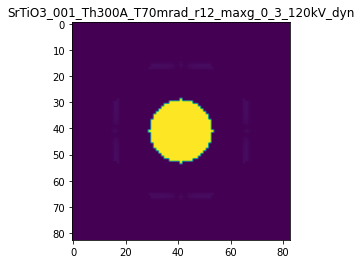

R-factor: 2.7145697573578974e-07

>>> producing the 20. dataset...

The offset applied on thickness: 0.0009542865898833621

The offset applied on Ug: 0.04671868991637622

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95428658988334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

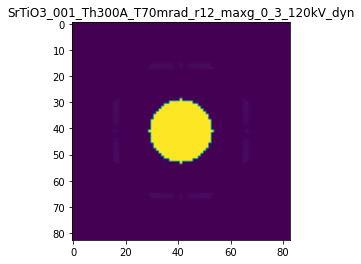

R-factor: 1.2638173624283788e-06

>>> producing the 21. dataset...

The offset applied on thickness: 0.00042180619457544256

The offset applied on Ug: -0.012682725430733335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4218061945754
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

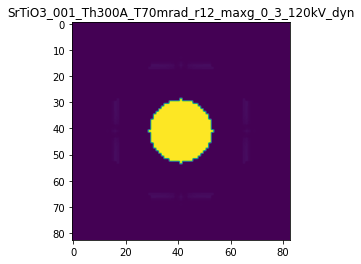

R-factor: 5.438587678121039e-07

>>> producing the 22. dataset...

The offset applied on thickness: 0.0006057928646074486

The offset applied on Ug: 0.06062697352952251

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60579286460745
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

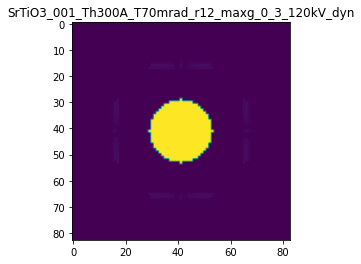

R-factor: 8.546245994744074e-07

>>> producing the 23. dataset...

The offset applied on thickness: -0.0005846484851649531

The offset applied on Ug: 0.024299766358626355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41535151483504
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

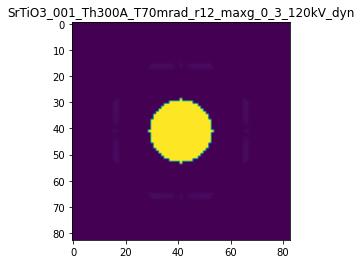

R-factor: 7.691680775189118e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0005051487813740938

The offset applied on Ug: 0.03647548045382079

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5051487813741
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

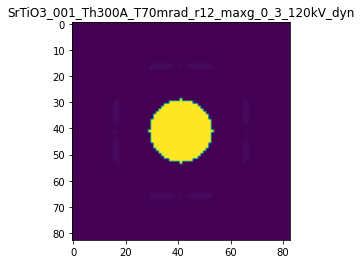

R-factor: 6.880259419850286e-07

>>> producing the 25. dataset...

The offset applied on thickness: -0.0004054196168268829

The offset applied on Ug: 0.07216904259870181

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5945803831731
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

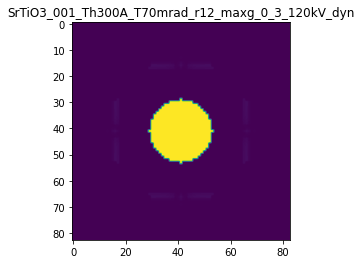

R-factor: 7.795678650744732e-07

>>> producing the 26. dataset...

The offset applied on thickness: 0.0007849482119978267

The offset applied on Ug: -0.004527735395120072

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7849482119978
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

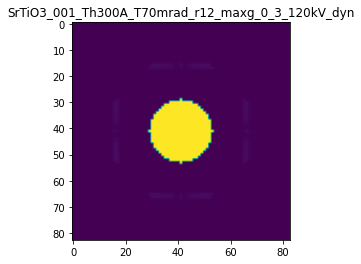

R-factor: 9.911846275307203e-07

>>> producing the 27. dataset...

The offset applied on thickness: 0.0009006200769016546

The offset applied on Ug: -0.011235761074048209

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.90062007690165
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

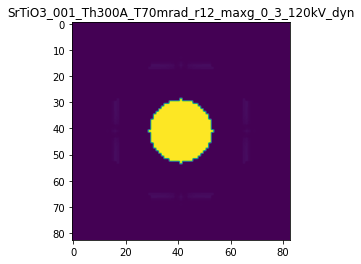

R-factor: 1.1390945975527705e-06

>>> producing the 28. dataset...

The offset applied on thickness: -0.0002569224576580762

The offset applied on Ug: 0.05425855506651217

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7430775423419
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

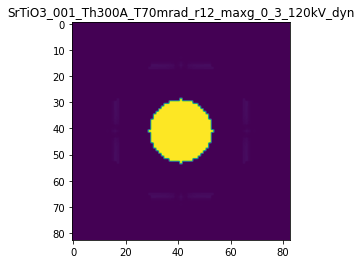

R-factor: 5.39913632744852e-07

>>> producing the 29. dataset...

The offset applied on thickness: -0.0009510521121914189

The offset applied on Ug: 0.07419571520975737

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04894788780854
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

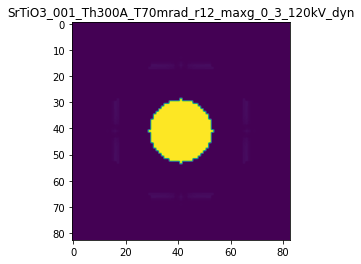

R-factor: 1.375835338075502e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.00035652742052916

The offset applied on Ug: 0.029177992515970655

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6434725794708
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

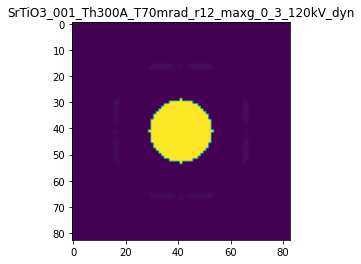

R-factor: 5.217311391141698e-07

>>> producing the 31. dataset...

The offset applied on thickness: 0.0006645037273513097

The offset applied on Ug: 0.06397490113532761

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6645037273513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

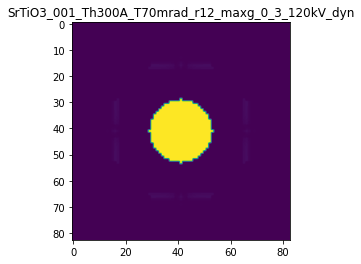

R-factor: 9.330876919924961e-07

>>> producing the 32. dataset...

The offset applied on thickness: -0.0002709477466371446

The offset applied on Ug: 0.036239453695038025

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72905225336285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

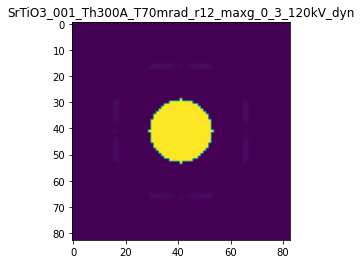

R-factor: 4.590730115696468e-07

>>> producing the 33. dataset...

The offset applied on thickness: -0.00022578658336499347

The offset applied on Ug: 0.032556677219357864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.774213416635
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

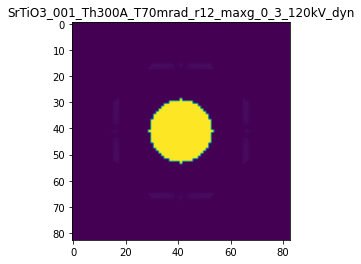

R-factor: 3.9440637525382594e-07

>>> producing the 34. dataset...

The offset applied on thickness: -1.6253291129808556e-05

The offset applied on Ug: -0.07247689650184201

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98374670887017
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

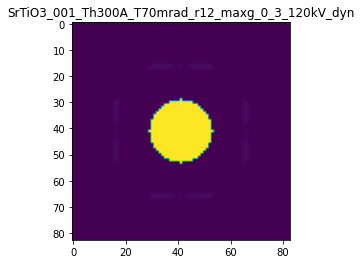

R-factor: 4.3634856758368495e-07

>>> producing the 35. dataset...

The offset applied on thickness: 0.0006149132830444735

The offset applied on Ug: 0.03897046839315232

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6149132830445
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

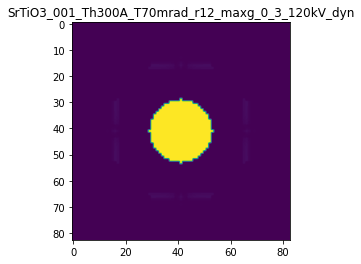

R-factor: 8.282133912110537e-07

>>> producing the 36. dataset...

The offset applied on thickness: 0.00020931697201418564

The offset applied on Ug: -0.003675913657888703

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2093169720142
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

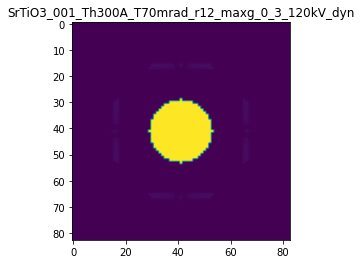

R-factor: 2.6563883847438213e-07

>>> producing the 37. dataset...

The offset applied on thickness: -0.00033483064769073036

The offset applied on Ug: 0.0780161451373622

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66516935230925
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

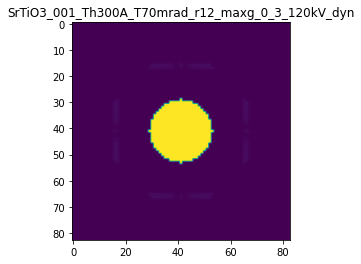

R-factor: 7.436520563559748e-07

>>> producing the 38. dataset...

The offset applied on thickness: 0.0008284844351685885

The offset applied on Ug: -0.041259854440989265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82848443516855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

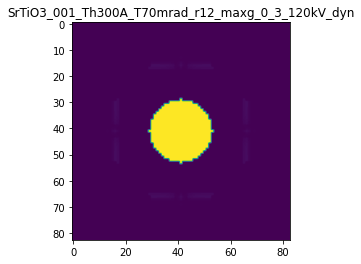

R-factor: 1.1133370293943135e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0005138120675230635

The offset applied on Ug: 0.01516433854063033

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.513812067523
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

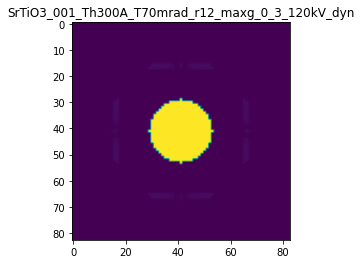

R-factor: 6.65938058341282e-07

>>> producing the 40. dataset...

The offset applied on thickness: -0.0009193073114407258

The offset applied on Ug: -0.004004761374851959

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0806926885592
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

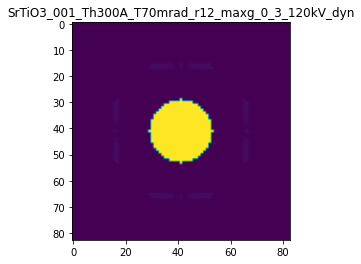

R-factor: 1.15910161218582e-06

>>> producing the 41. dataset...

The offset applied on thickness: -0.0005231333895229445

The offset applied on Ug: -0.06842779910091816

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4768666104771
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

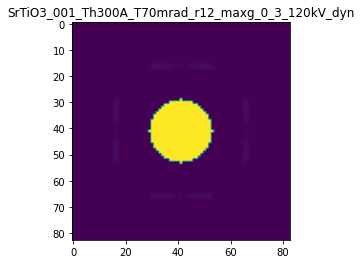

R-factor: 7.682221532066505e-07

>>> producing the 42. dataset...

The offset applied on thickness: -0.0008545406966370113

The offset applied on Ug: 0.025165184017930945

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.145459303363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

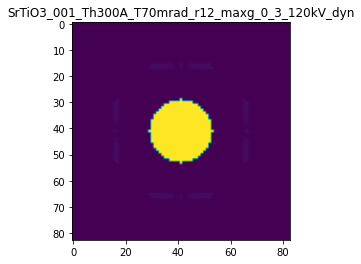

R-factor: 1.0981811367121564e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.0007613919278071073

The offset applied on Ug: 0.0001586663532770416

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2386080721929
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

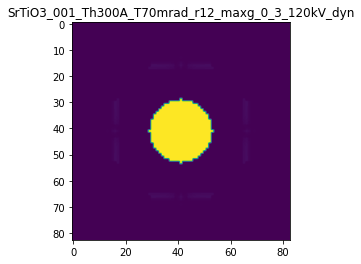

R-factor: 9.576298667146676e-07

>>> producing the 44. dataset...

The offset applied on thickness: 0.0002855277684423796

The offset applied on Ug: 0.01729878456889365

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28552776844236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

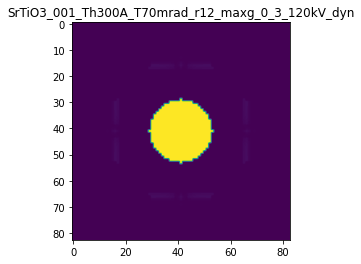

R-factor: 3.8299331017089907e-07

>>> producing the 45. dataset...

The offset applied on thickness: -0.0008594839127224836

The offset applied on Ug: -0.011222257324938915

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1405160872775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

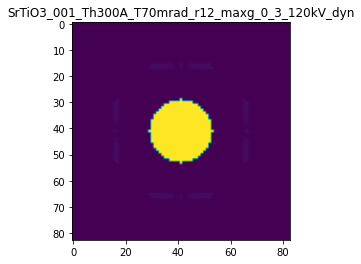

R-factor: 1.0913217220166917e-06

>>> producing the 46. dataset...

The offset applied on thickness: 0.0005635244904639361

The offset applied on Ug: -0.036939355793850714

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5635244904639
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

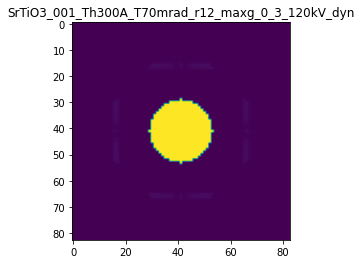

R-factor: 7.891858341613071e-07

>>> producing the 47. dataset...

The offset applied on thickness: -0.000975311759035351

The offset applied on Ug: -0.07855264877785759

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0246882409646
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

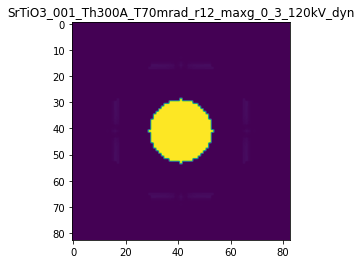

R-factor: 1.3396001997909969e-06

>>> producing the 48. dataset...

The offset applied on thickness: -6.720071424729146e-05

The offset applied on Ug: 0.032464117477650836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93279928575265
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

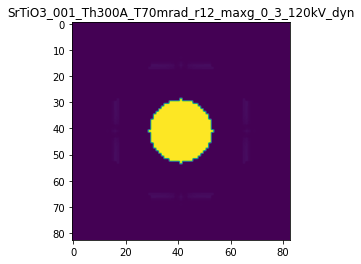

R-factor: 2.4601335005777214e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.00047833535299778674

The offset applied on Ug: -0.0379041760958631

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47833535299776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

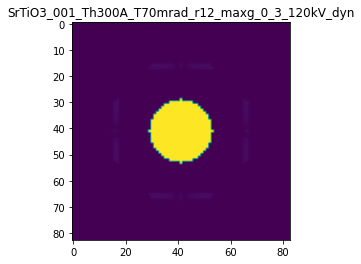

R-factor: 6.959606401483741e-07

>>> producing the 50. dataset...

The offset applied on thickness: -0.0009643236963420283

The offset applied on Ug: 0.05618104303375322

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03567630365797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

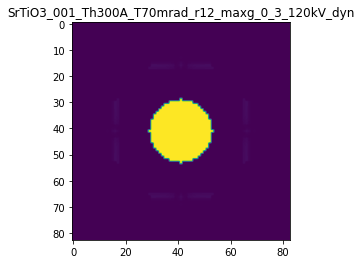

R-factor: 1.3192888973781954e-06

>>> producing the 51. dataset...

The offset applied on thickness: 1.5271433721542717e-05

The offset applied on Ug: -0.05736558957956055

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0152714337215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

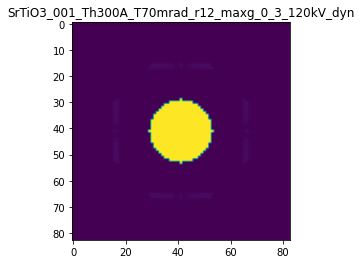

R-factor: 3.605628549018075e-07

>>> producing the 52. dataset...

The offset applied on thickness: -8.462209971229573e-05

The offset applied on Ug: 0.06546427929551202

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9153779002877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

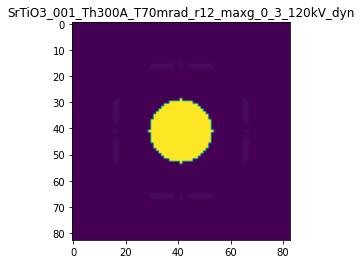

R-factor: 4.5666075508475263e-07

>>> producing the 53. dataset...

The offset applied on thickness: -0.0001823065450263002

The offset applied on Ug: -0.05772487077836445

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81769345497366
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

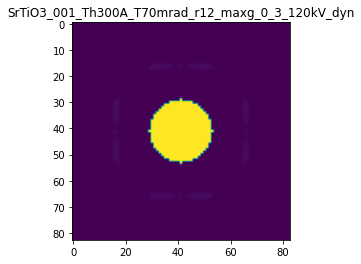

R-factor: 3.9808034698663585e-07

>>> producing the 54. dataset...

The offset applied on thickness: 0.0002562500537303236

The offset applied on Ug: -0.025223256235654627

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2562500537303
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

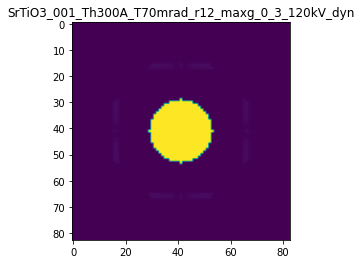

R-factor: 3.9261253334458496e-07

>>> producing the 55. dataset...

The offset applied on thickness: 0.0005829749402736202

The offset applied on Ug: -0.05824911072089108

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5829749402736
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

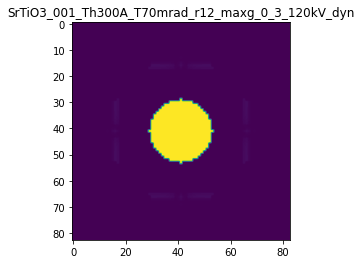

R-factor: 8.972433213167141e-07

>>> producing the 56. dataset...

The offset applied on thickness: -0.0004960965093516043

The offset applied on Ug: 0.04490623869947788

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5039034906484
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

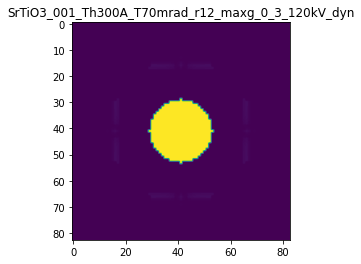

R-factor: 7.431986483943303e-07

>>> producing the 57. dataset...

The offset applied on thickness: 0.0006943725272316257

The offset applied on Ug: -0.07301825724224231

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6943725272316
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

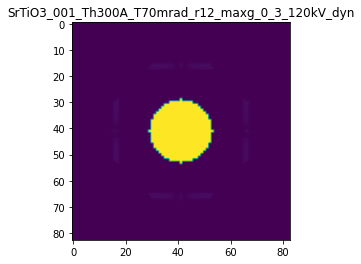

R-factor: 1.0839322484377773e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0006205581594858536

The offset applied on Ug: 0.017144424504703402

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3794418405141
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

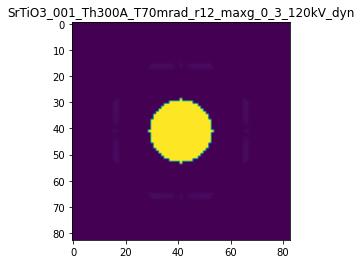

R-factor: 7.959811584270131e-07

>>> producing the 59. dataset...

The offset applied on thickness: -0.000900213651848359

The offset applied on Ug: -0.01862330781324127

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09978634815167
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

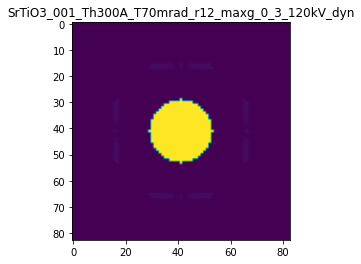

R-factor: 1.1523855459789722e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.000433718931343859

The offset applied on Ug: -0.04764777642721791

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43371893134383
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

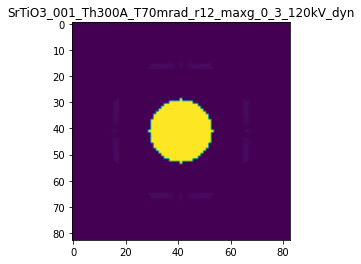

R-factor: 6.856833873789594e-07

>>> producing the 61. dataset...

The offset applied on thickness: -0.0007561114802992486

The offset applied on Ug: 0.0003459964000328419

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24388851970076
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

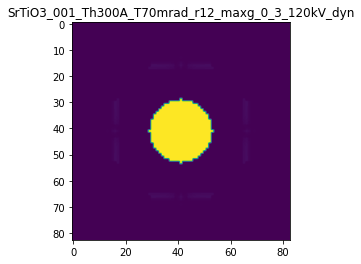

R-factor: 9.510449872667106e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.0006802902674850622

The offset applied on Ug: 0.009997005438252736

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3197097325149
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

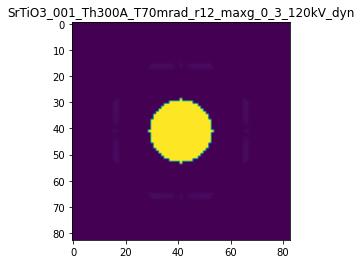

R-factor: 8.596628477288174e-07

>>> producing the 63. dataset...

The offset applied on thickness: -0.0004963494997206972

The offset applied on Ug: 0.07858531902766074

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50365050027926
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

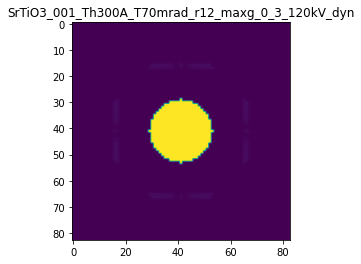

R-factor: 9.027309312893901e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.0008010525504439446

The offset applied on Ug: -0.0034864531632573127

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19894744955604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

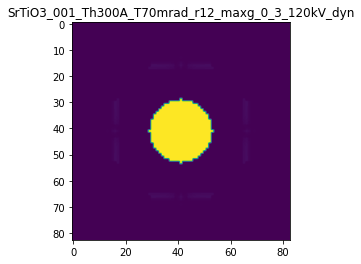

R-factor: 1.0102334510867156e-06

>>> producing the 65. dataset...

The offset applied on thickness: -0.0007084677462579203

The offset applied on Ug: -0.029358406732526418

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29153225374205
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

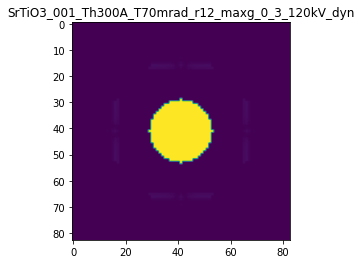

R-factor: 9.277683556344376e-07

>>> producing the 66. dataset...

The offset applied on thickness: 0.00031875101946621134

The offset applied on Ug: -0.0035317374053504304

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3187510194662
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

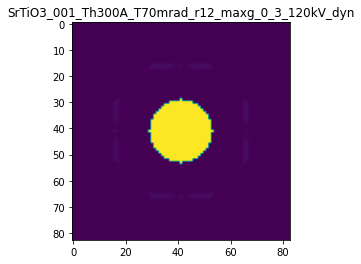

R-factor: 4.0260398416350845e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.0005288990768842252

The offset applied on Ug: 0.002005990748791664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4711009231157
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

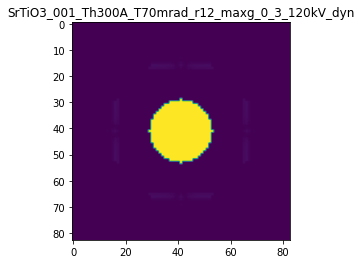

R-factor: 6.659691981814001e-07

>>> producing the 68. dataset...

The offset applied on thickness: 0.0004961815402217211

The offset applied on Ug: -0.04205128503388783

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49618154022176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

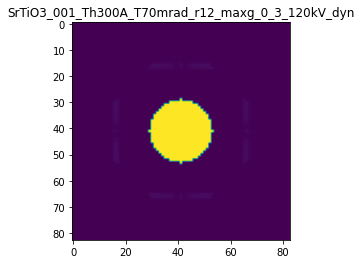

R-factor: 7.32961518187983e-07

>>> producing the 69. dataset...

The offset applied on thickness: -0.0007528146651016874

The offset applied on Ug: -0.05071513102093242

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2471853348983
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

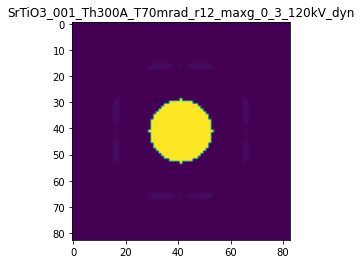

R-factor: 1.0168072529404412e-06

>>> producing the 70. dataset...

The offset applied on thickness: 0.00028186605785821353

The offset applied on Ug: -0.05670912762062061

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2818660578582
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

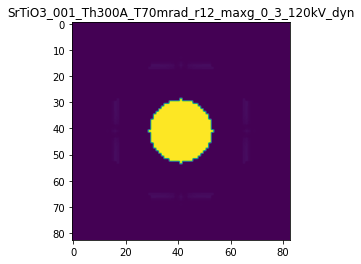

R-factor: 5.776362248300333e-07

>>> producing the 71. dataset...

The offset applied on thickness: 0.0004489119790740894

The offset applied on Ug: 0.06804553777905557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44891197907407
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

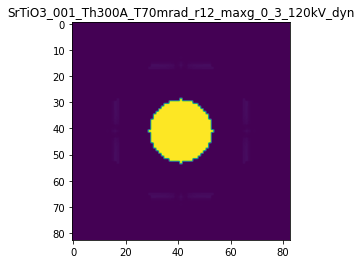

R-factor: 6.792156702834923e-07

>>> producing the 72. dataset...

The offset applied on thickness: 0.0005929740760642237

The offset applied on Ug: 0.07517579612744914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.59297407606425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

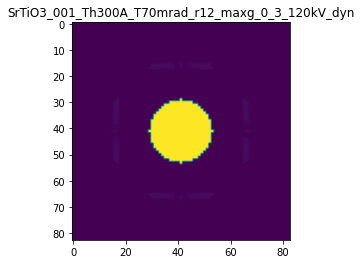

R-factor: 8.656908748969996e-07

>>> producing the 73. dataset...

The offset applied on thickness: 0.00042718672002650204

The offset applied on Ug: 0.04217051294413393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4271867200265
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

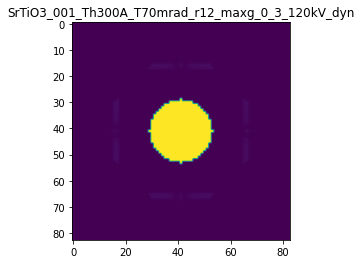

R-factor: 6.015606252874443e-07

>>> producing the 74. dataset...

The offset applied on thickness: 0.0002552926163047038

The offset applied on Ug: 0.01576024337800707

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2552926163047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

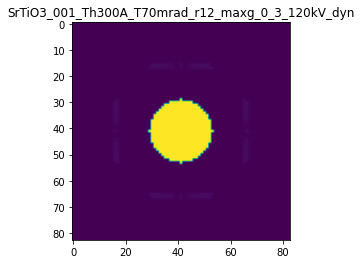

R-factor: 3.4293463287719016e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.0009373423864117885

The offset applied on Ug: -0.00962038788549858

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9373423864118
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

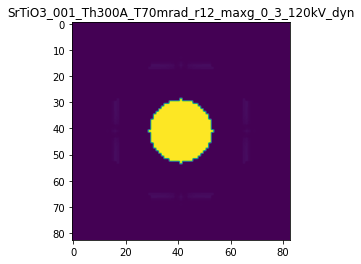

R-factor: 1.18506118860018e-06

>>> producing the 76. dataset...

The offset applied on thickness: -6.695324156913962e-05

The offset applied on Ug: -0.0363458142588552

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93304675843086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

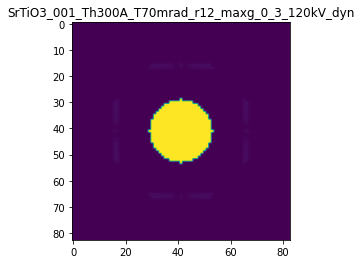

R-factor: 2.2305848433204466e-07

>>> producing the 77. dataset...

The offset applied on thickness: 6.9366380203355064e-06

The offset applied on Ug: -0.06955783476083653

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0069366380203
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

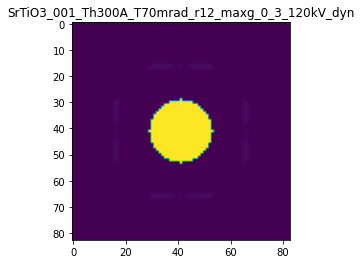

R-factor: 4.305345205243925e-07

>>> producing the 78. dataset...

The offset applied on thickness: -0.00012092132667344635

The offset applied on Ug: 0.0703295898041156

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87907867332655
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

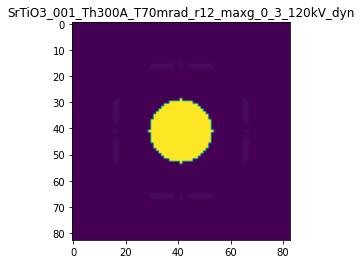

R-factor: 5.13065018147546e-07

>>> producing the 79. dataset...

The offset applied on thickness: -0.0007668203394696016

The offset applied on Ug: 0.05622994510861665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23317966053037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

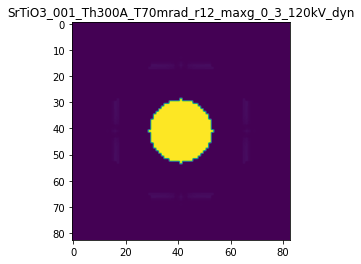

R-factor: 1.0953077215631842e-06

>>> producing the 80. dataset...

The offset applied on thickness: 4.018923409804831e-05

The offset applied on Ug: -0.06558724431962563

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.040189234098
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

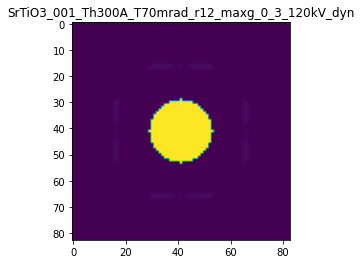

R-factor: 4.265000370565327e-07

>>> producing the 81. dataset...

The offset applied on thickness: 0.0008200627320350342

The offset applied on Ug: 0.05331759282233319

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82006273203507
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

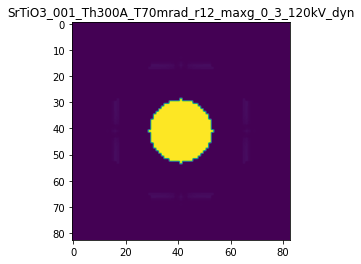

R-factor: 1.107196816085186e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.0005353306289901454

The offset applied on Ug: 0.029636413212092788

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46466937100985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

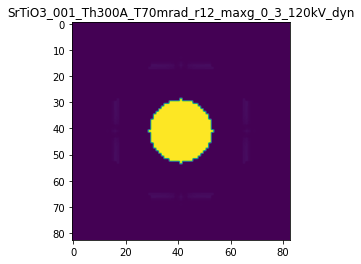

R-factor: 7.269966088147277e-07

>>> producing the 83. dataset...

The offset applied on thickness: -1.5489975113123223e-05

The offset applied on Ug: -0.07259281248979436

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98451002488684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

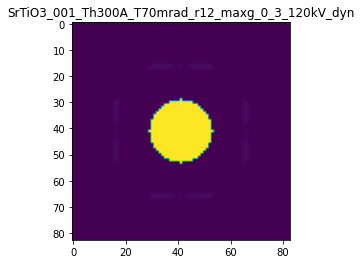

R-factor: 4.3737754298282524e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.00017512276527422444

The offset applied on Ug: -0.023228282151590153

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1751227652742
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

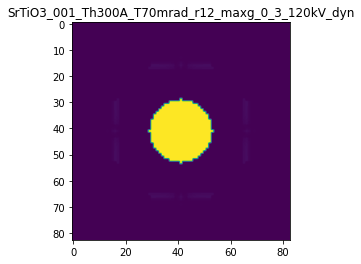

R-factor: 2.9602250451156936e-07

>>> producing the 85. dataset...

The offset applied on thickness: -2.0544257318888316e-05

The offset applied on Ug: -0.04428828390658632

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97945574268107
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

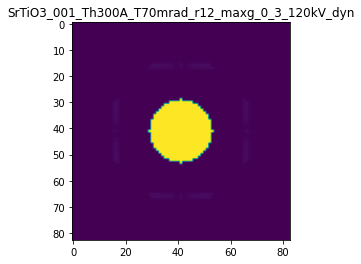

R-factor: 2.635148809623329e-07

>>> producing the 86. dataset...

The offset applied on thickness: 0.00032825596129851833

The offset applied on Ug: 0.07761538021215733

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3282559612985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

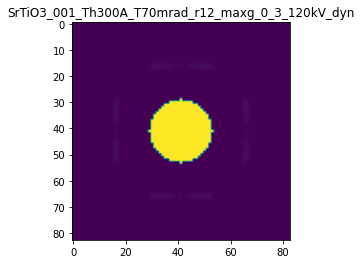

R-factor: 5.927286610387122e-07

>>> producing the 87. dataset...

The offset applied on thickness: 0.0007603347479212797

The offset applied on Ug: 0.015427164634799394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76033474792126
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

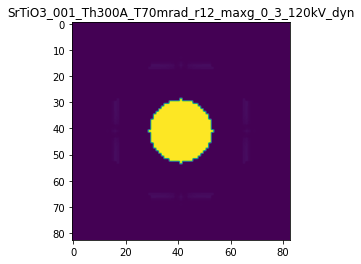

R-factor: 9.762555560117403e-07

>>> producing the 88. dataset...

The offset applied on thickness: 0.0006813705578861074

The offset applied on Ug: -0.06309738825581386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.68137055788605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

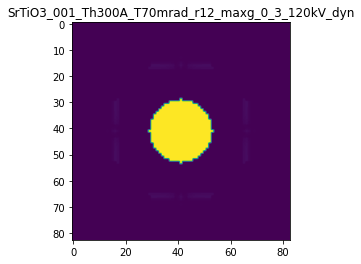

R-factor: 1.0284929121074335e-06

>>> producing the 89. dataset...

The offset applied on thickness: -0.00010044614192698753

The offset applied on Ug: -0.03940763122429182

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.899553858073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

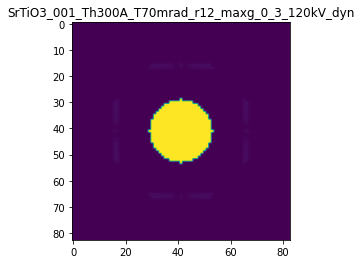

R-factor: 2.567186113536043e-07

>>> producing the 90. dataset...

The offset applied on thickness: -0.0004689515926254324

The offset applied on Ug: -0.05992350451510078

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53104840737456
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

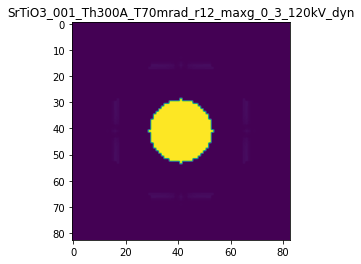

R-factor: 6.858933847920064e-07

>>> producing the 91. dataset...

The offset applied on thickness: 0.0003603010977286336

The offset applied on Ug: -0.049129355675039114

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3603010977286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

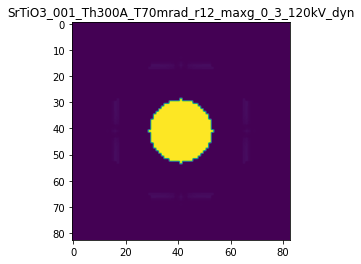

R-factor: 6.158709022914833e-07

>>> producing the 92. dataset...

The offset applied on thickness: 0.0003962694514082013

The offset applied on Ug: -0.05600039152234903

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39626945140816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

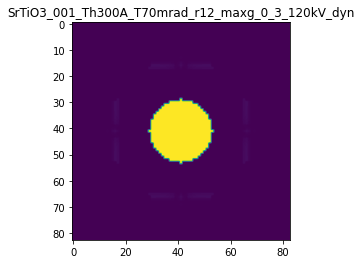

R-factor: 6.872332126870786e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.0007900612721541513

The offset applied on Ug: -0.0735400949338138

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.20993872784584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

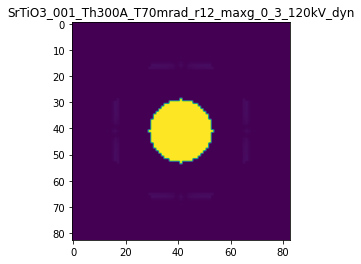

R-factor: 1.1031833158955887e-06

>>> producing the 94. dataset...

The offset applied on thickness: 0.0005595056210052498

The offset applied on Ug: 0.06714865960707128

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55950562100526
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

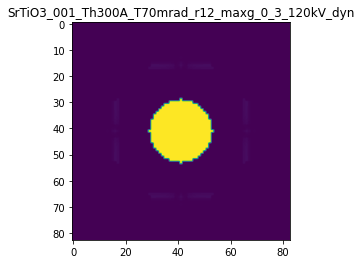

R-factor: 8.098460381470769e-07

>>> producing the 95. dataset...

The offset applied on thickness: 0.00013578762646121012

The offset applied on Ug: -0.05880666530916974

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1357876264612
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

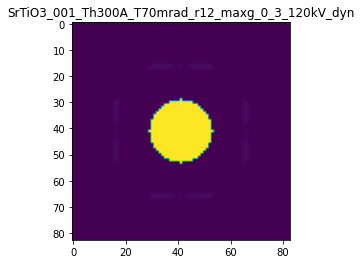

R-factor: 4.5740758838607677e-07

>>> producing the 96. dataset...

The offset applied on thickness: 0.0007217579487091919

The offset applied on Ug: -0.0346490093270535

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7217579487092
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

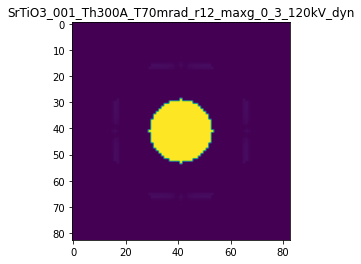

R-factor: 9.658734861645523e-07

>>> producing the 97. dataset...

The offset applied on thickness: -0.0008647987864406494

The offset applied on Ug: -0.028550657105569713

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.13520121355936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

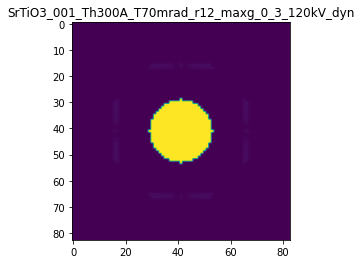

R-factor: 1.1218713551340554e-06

>>> producing the 98. dataset...

The offset applied on thickness: -0.000973361263008957

The offset applied on Ug: -0.032952178032216575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02663873699106
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

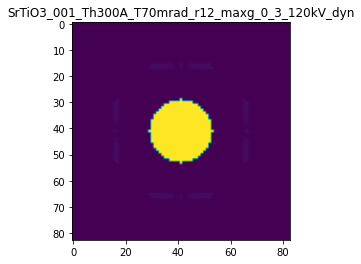

R-factor: 1.2635599218051663e-06

>>> producing the 99. dataset...

The offset applied on thickness: -0.0003745195290467229

The offset applied on Ug: -0.02690184541847307

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6254804709533
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

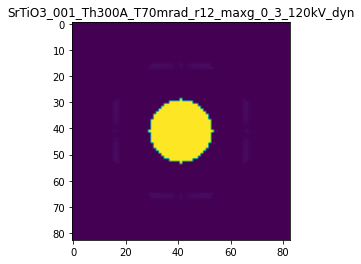

R-factor: 5.091186008593981e-07

>>> producing the 100. dataset...

The offset applied on thickness: -0.0006786715455650953

The offset applied on Ug: 0.04290362191835163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3213284544349
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

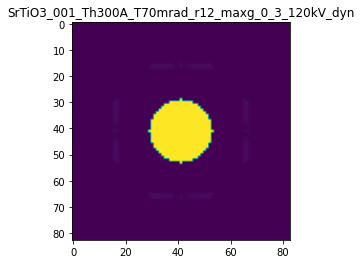

R-factor: 9.421893579653558e-07

>>> producing the 101. dataset...

The offset applied on thickness: -1.8798801778831643e-05

The offset applied on Ug: 0.06323389070726754

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98120119822113
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

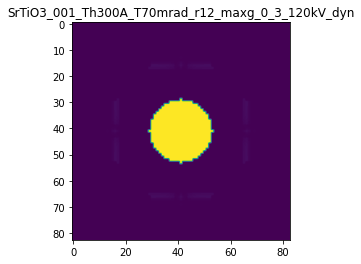

R-factor: 3.9920350678666204e-07

>>> producing the 102. dataset...

The offset applied on thickness: 0.00012730774706161597

The offset applied on Ug: 0.07884403648201715

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1273077470616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

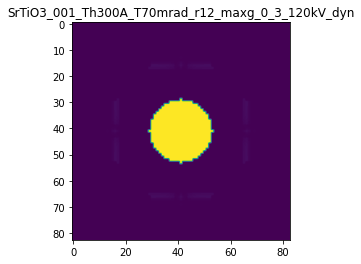

R-factor: 4.768830156648511e-07

>>> producing the 103. dataset...

The offset applied on thickness: -0.0003140310524948005

The offset applied on Ug: 0.01951036948438217

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6859689475052
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

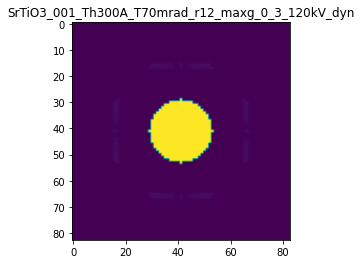

R-factor: 4.3487559450079705e-07

>>> producing the 104. dataset...

The offset applied on thickness: -0.00013281707830979707

The offset applied on Ug: 0.022747230493919322

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8671829216902
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

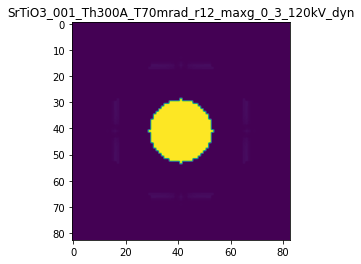

R-factor: 2.5072148194180983e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.0008503474622022947

The offset applied on Ug: -0.008591880633293397

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1496525377977
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

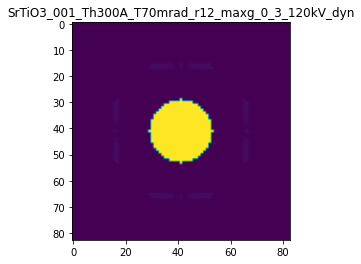

R-factor: 1.0769956183388869e-06

>>> producing the 106. dataset...

The offset applied on thickness: -0.0008598962530925852

The offset applied on Ug: 0.06314068480322524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1401037469074
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

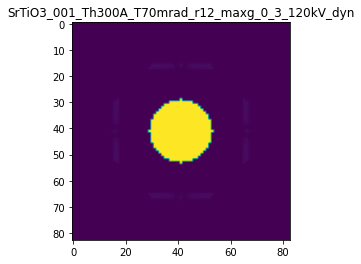

R-factor: 1.2284142355845438e-06

>>> producing the 107. dataset...

The offset applied on thickness: -0.00046128467989263065

The offset applied on Ug: 0.05726774924836727

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5387153201073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

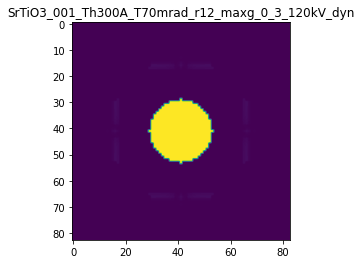

R-factor: 7.59386825937612e-07

>>> producing the 108. dataset...

The offset applied on thickness: -0.0002133411685827247

The offset applied on Ug: -0.07601065084352036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78665883141724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

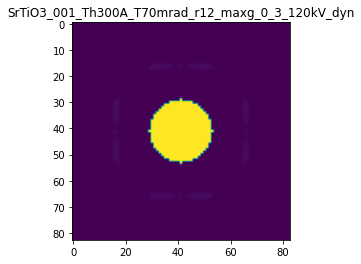

R-factor: 5.074217629631317e-07

>>> producing the 109. dataset...

The offset applied on thickness: -0.00030216409866675885

The offset applied on Ug: 0.039479067818775915

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69783590133324
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

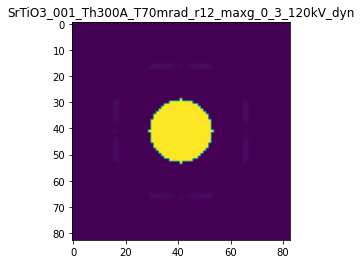

R-factor: 5.073053052878214e-07

>>> producing the 110. dataset...

The offset applied on thickness: -0.0005525274405436718

The offset applied on Ug: 0.03671493321268516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4474725594563
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

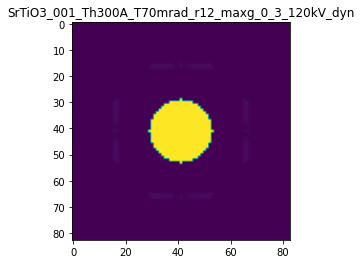

R-factor: 7.74329359253182e-07

>>> producing the 111. dataset...

The offset applied on thickness: -0.0005082486869130647

The offset applied on Ug: 0.07385114059007787

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4917513130869
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

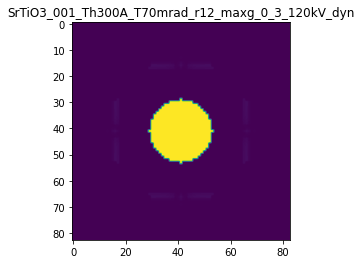

R-factor: 8.902525222594401e-07

>>> producing the 112. dataset...

The offset applied on thickness: -0.00015630064519658605

The offset applied on Ug: 0.00157148731416477

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84369935480345
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

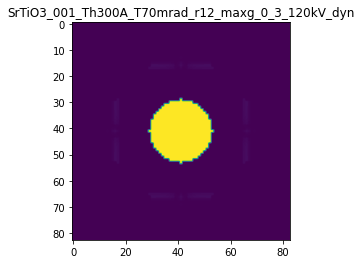

R-factor: 1.9717168978787362e-07

>>> producing the 113. dataset...

The offset applied on thickness: -1.1976123701539221e-05

The offset applied on Ug: -0.0432491330784775

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9880238762985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

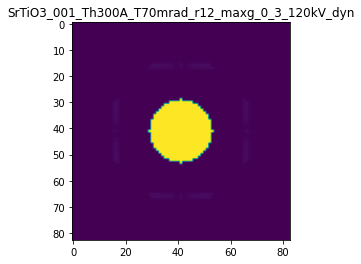

R-factor: 2.596354690487689e-07

>>> producing the 114. dataset...

The offset applied on thickness: -0.00021647894897700693

The offset applied on Ug: 0.062163785677691354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78352105102294
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

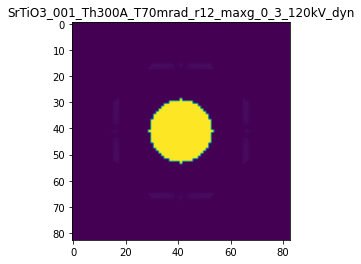

R-factor: 5.468832780025386e-07

>>> producing the 115. dataset...

The offset applied on thickness: -0.0008330362372996764

The offset applied on Ug: -0.02400130021841072

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1669637627003
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

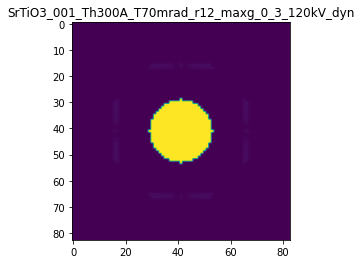

R-factor: 1.075885480813988e-06

>>> producing the 116. dataset...

The offset applied on thickness: -0.00023282957333431553

The offset applied on Ug: -0.06710606154677588

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7671704266657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

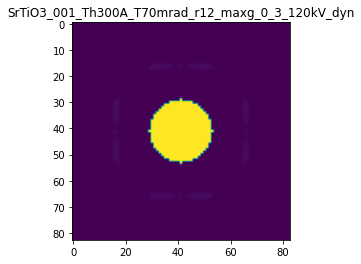

R-factor: 4.767192961040877e-07

>>> producing the 117. dataset...

The offset applied on thickness: 0.0006779208956009208

The offset applied on Ug: -0.025328408395668342

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6779208956009
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

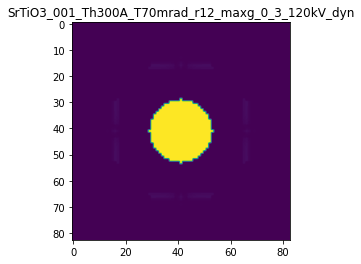

R-factor: 8.857489520877826e-07

>>> producing the 118. dataset...

The offset applied on thickness: 0.0008962179206418097

The offset applied on Ug: -0.007797984446569633

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8962179206418
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

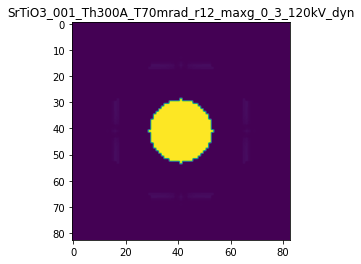

R-factor: 1.1326141737109002e-06

>>> producing the 119. dataset...

The offset applied on thickness: 0.0001305407465484736

The offset applied on Ug: 0.04162038705762233

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13054074654843
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

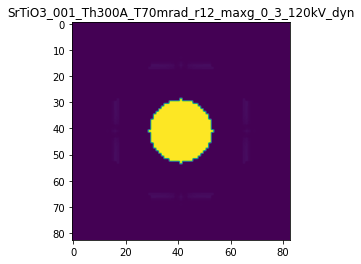

R-factor: 2.86299590073654e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.0006085822621790156

The offset applied on Ug: -0.028891678181561832

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.608582262179
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

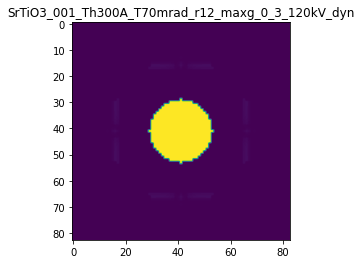

R-factor: 8.132847110103456e-07

>>> producing the 121. dataset...

The offset applied on thickness: -0.0004497326985198562

The offset applied on Ug: 0.014730272939744183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5502673014802
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

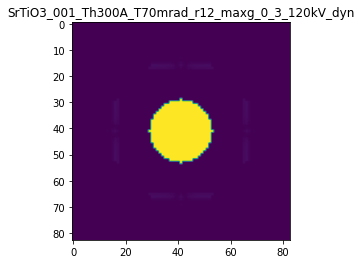

R-factor: 5.810813153713755e-07

>>> producing the 122. dataset...

The offset applied on thickness: 0.0007686308015641657

The offset applied on Ug: 0.055224078371298495

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76863080156414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

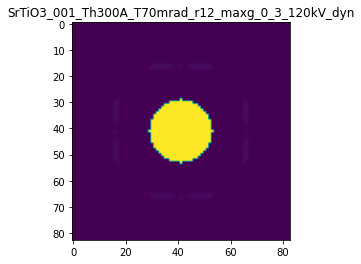

R-factor: 1.0467768270067796e-06

>>> producing the 123. dataset...

The offset applied on thickness: -2.8804246037256843e-05

The offset applied on Ug: 0.06209918024546902

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9711957539628
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

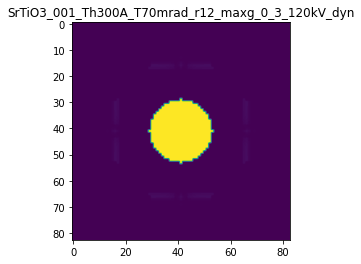

R-factor: 3.9838728753758186e-07

>>> producing the 124. dataset...

The offset applied on thickness: -0.00033135091058703693

The offset applied on Ug: -0.02110488980291274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66864908941295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

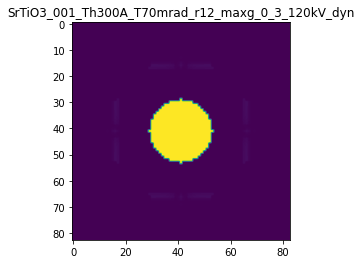

R-factor: 4.4572379250783224e-07

>>> producing the 125. dataset...

The offset applied on thickness: -0.000678988290364174

The offset applied on Ug: -0.06870489267864768

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3210117096358
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

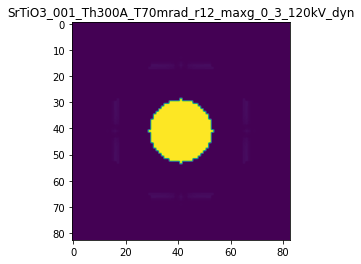

R-factor: 9.586133281869991e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.00033312031189127665

The offset applied on Ug: 0.05419718161432693

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66687968810874
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

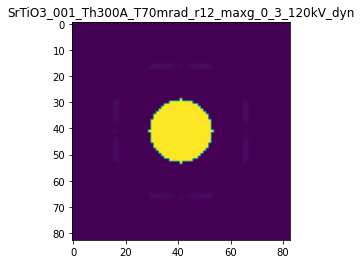

R-factor: 6.135586357502709e-07

>>> producing the 127. dataset...

The offset applied on thickness: -0.0005010186322569805

The offset applied on Ug: -0.050208596865397956

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.498981367743
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

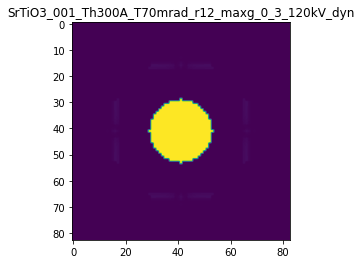

R-factor: 7.064793972870886e-07

>>> producing the 128. dataset...

The offset applied on thickness: -0.0003361036922124754

The offset applied on Ug: -0.02781441239538415

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6638963077875
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

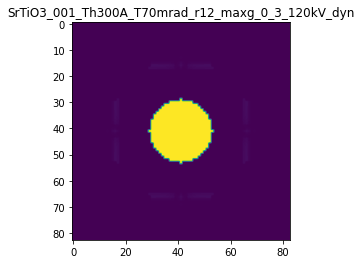

R-factor: 4.633908217517077e-07

>>> producing the 129. dataset...

The offset applied on thickness: 0.0003468313192043797

The offset applied on Ug: -0.009911467347395054

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34683131920434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

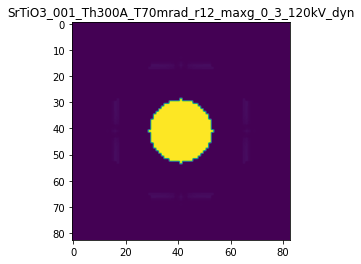

R-factor: 4.4627655410578043e-07

>>> producing the 130. dataset...

The offset applied on thickness: -0.0001501533751477624

The offset applied on Ug: 0.02694468865469764

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8498466248522
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

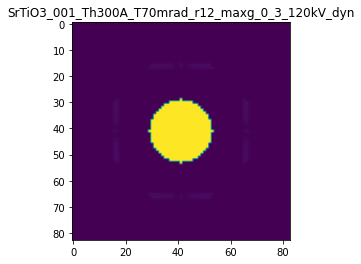

R-factor: 2.8998657542203574e-07

>>> producing the 131. dataset...

The offset applied on thickness: 9.810248227134077e-05

The offset applied on Ug: -0.012846971776444765

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0981024822713
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

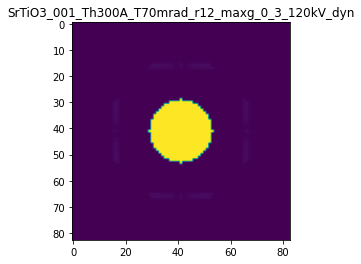

R-factor: 1.6499375006517833e-07

>>> producing the 132. dataset...

The offset applied on thickness: -0.00018369211959556054

The offset applied on Ug: -0.02693575687701886

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8163078804044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

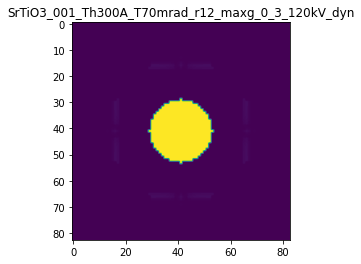

R-factor: 2.7568781660486953e-07

>>> producing the 133. dataset...

The offset applied on thickness: 0.0006925437275937953

The offset applied on Ug: -0.01267819688326954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6925437275938
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

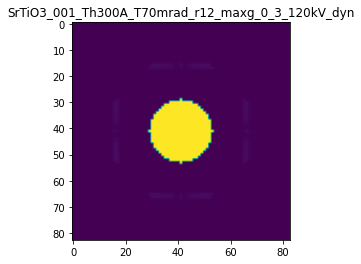

R-factor: 8.801940200762961e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.0005634744933900233

The offset applied on Ug: -0.0702231109204612

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56347449339
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

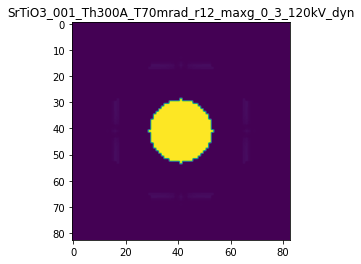

R-factor: 9.30764159394668e-07

>>> producing the 135. dataset...

The offset applied on thickness: -0.0009915936971143394

The offset applied on Ug: -0.02915731801003556

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00840630288565
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

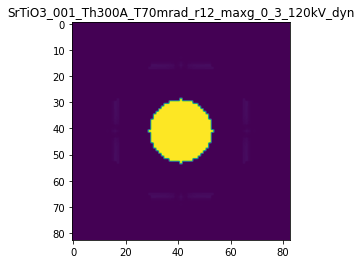

R-factor: 1.2810578638180266e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.000655735388611413

The offset applied on Ug: 0.07451280865700906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6557353886114
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

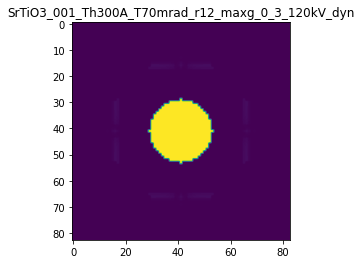

R-factor: 9.413648784173868e-07

>>> producing the 137. dataset...

The offset applied on thickness: -0.00042174664569668874

The offset applied on Ug: 0.05031080783055694

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57825335430334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

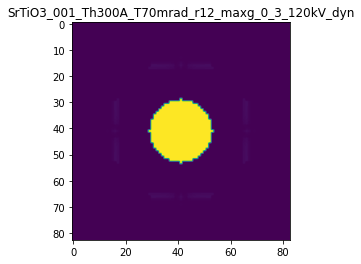

R-factor: 6.844170375699832e-07

>>> producing the 138. dataset...

The offset applied on thickness: 0.000497334250075389

The offset applied on Ug: 0.057967580664746984

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49733425007537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

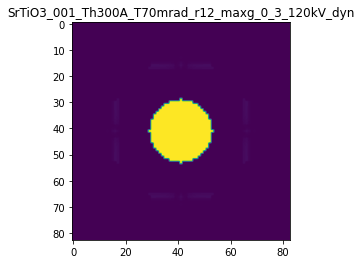

R-factor: 7.166861313837157e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0005326380959262862

The offset applied on Ug: -0.0779888039966602

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5326380959263
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

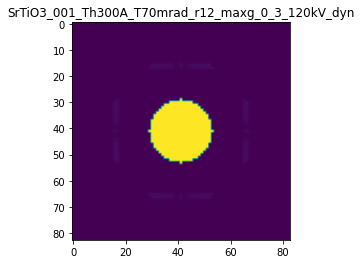

R-factor: 9.37805908556641e-07

>>> producing the 140. dataset...

The offset applied on thickness: -0.0009371498423203652

The offset applied on Ug: 0.030612100193543094

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06285015767963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

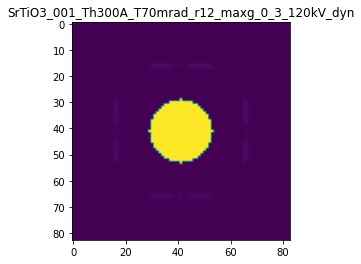

R-factor: 1.2095473635643063e-06



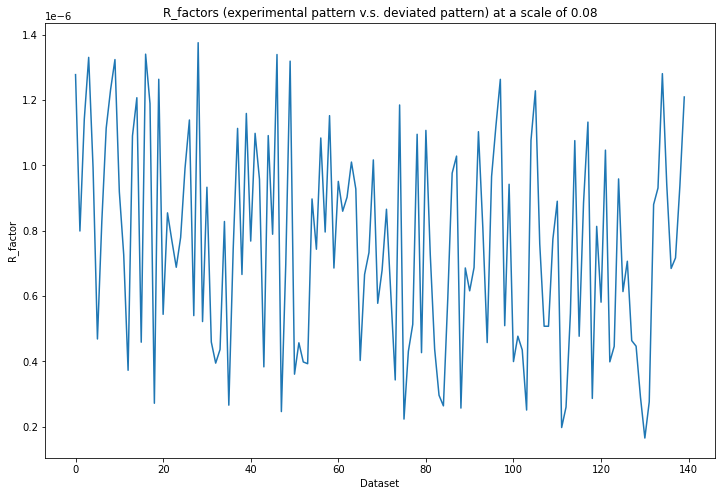

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 349ms/step - loss: 0.2019 - acc: 0.0000e+00 - val_loss: 0.1385 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 203ms/step - loss: 0.1145 - acc: 0.0000e+00 - val_loss: 0.0797 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 205ms/step - loss: 0.0653 - acc: 0.0000e+00 - val_loss: 0.0479 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 208ms/step - loss: 0.0391 - acc: 0.0000e+00 - val_loss: 0.0274 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 200ms/step - loss: 0.0205 - acc: 0.0000e+00 - val_loss: 0.0110 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 204ms/step - loss: 0.0081 - acc: 0.4000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 214ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

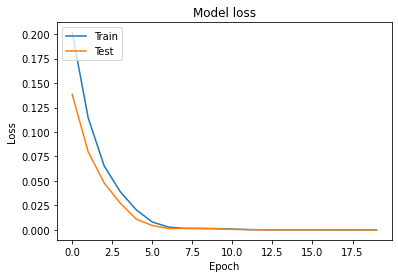

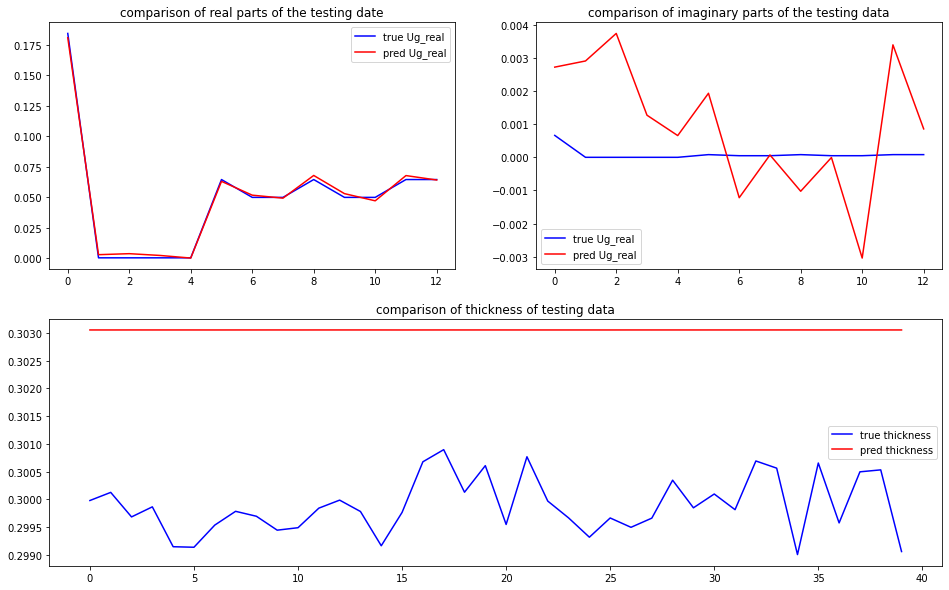

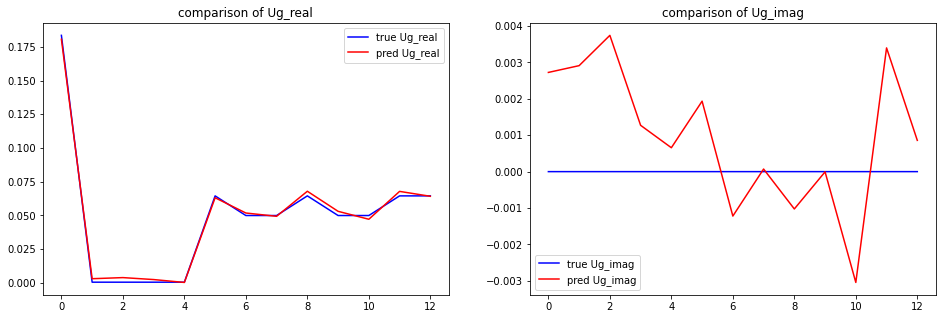

predicted thickness: 30.305033922195435 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=303.05033922195435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18067005+0.00000000e+00j 0.

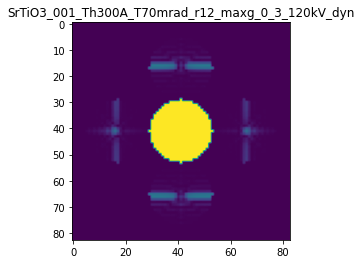

X_sim.max(): 0.9999565334831836
R-factor at a scale of 0.08 is 0.006613035098964575.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.16

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0009715843263874072

The offset applied on Ug: -0.042476490259109594

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001

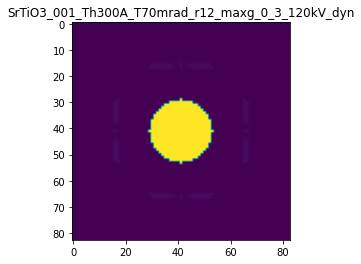

R-factor: 1.2748010450524618e-06

>>> producing the 2. dataset...

The offset applied on thickness: 0.0008802887171278853

The offset applied on Ug: 0.06891348605664507

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8802887171278
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

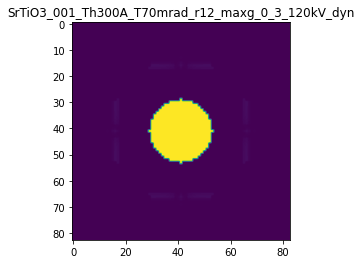

R-factor: 1.2088376434011008e-06

>>> producing the 3. dataset...

The offset applied on thickness: -0.000564974681792692

The offset applied on Ug: -0.05764900124962846

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4350253182073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

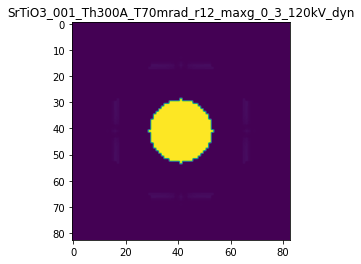

R-factor: 7.985964714279579e-07

>>> producing the 4. dataset...

The offset applied on thickness: 0.0003388820507925923

The offset applied on Ug: -0.1357258178456771

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33888205079256
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

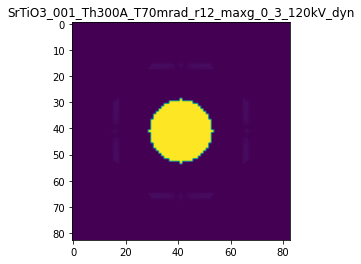

R-factor: 1.0771467572088041e-06

>>> producing the 5. dataset...

The offset applied on thickness: -0.0009820812315681942

The offset applied on Ug: -0.09820234794653171

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0179187684318
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

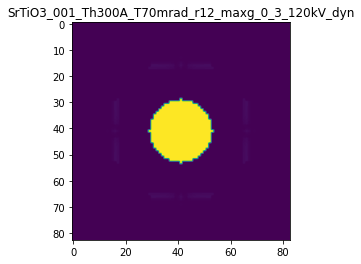

R-factor: 1.3840850492768401e-06

>>> producing the 6. dataset...

The offset applied on thickness: 0.0002460481407727113

The offset applied on Ug: 0.010407478376886808

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2460481407727
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

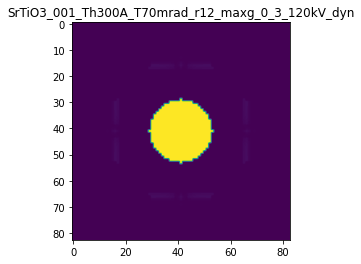

R-factor: 3.231689807476684e-07

>>> producing the 7. dataset...

The offset applied on thickness: -3.258972067067645e-05

The offset applied on Ug: 0.11029226616535016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96741027932933
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

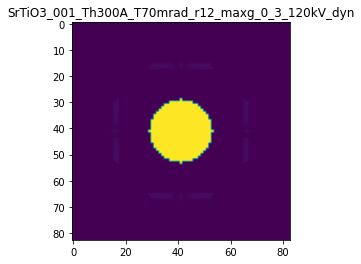

R-factor: 6.965817715558724e-07

>>> producing the 8. dataset...

The offset applied on thickness: 0.00045999845127591457

The offset applied on Ug: -0.02643659376688003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4599984512759
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

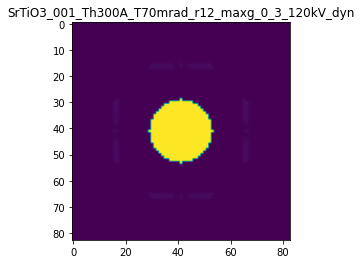

R-factor: 6.29505331328501e-07

>>> producing the 9. dataset...

The offset applied on thickness: 7.528492477303095e-05

The offset applied on Ug: -0.06150989894506452

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07528492477303
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

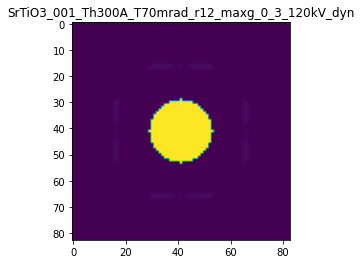

R-factor: 4.2567834416769867e-07

>>> producing the 10. dataset...

The offset applied on thickness: -0.00017553566686602618

The offset applied on Ug: -0.057199762415597565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.82446433313396
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

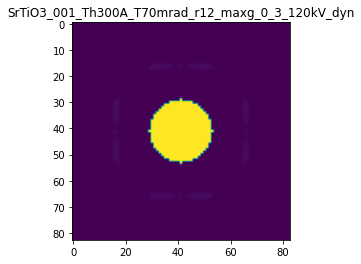

R-factor: 3.910687987076877e-07

>>> producing the 11. dataset...

The offset applied on thickness: -0.00017818773137025313

The offset applied on Ug: 0.14364964895533433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.82181226862974
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

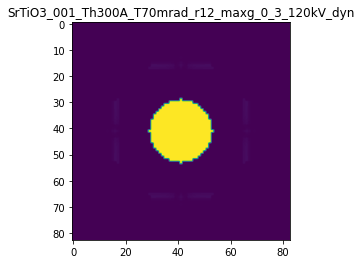

R-factor: 9.971424397899707e-07

>>> producing the 12. dataset...

The offset applied on thickness: -0.0002322700253130936

The offset applied on Ug: -0.08900125789997862

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76772997468686
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

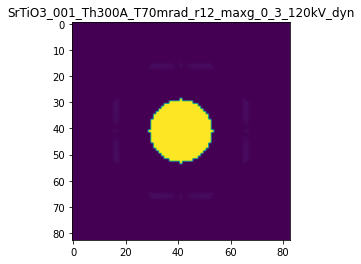

R-factor: 5.833705376477421e-07

>>> producing the 13. dataset...

The offset applied on thickness: 0.0009702094052971895

The offset applied on Ug: -0.031195970340043254

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97020940529717
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

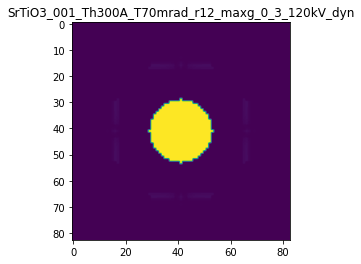

R-factor: 1.2556271750774935e-06

>>> producing the 14. dataset...

The offset applied on thickness: -0.00055724238057528

The offset applied on Ug: 0.027206926411533168

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4427576194247
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

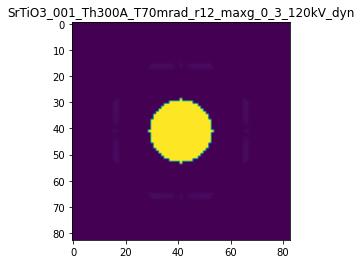

R-factor: 7.451412473188256e-07

>>> producing the 15. dataset...

The offset applied on thickness: 0.0004595113453249438

The offset applied on Ug: 0.13952495123368278

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4595113453249
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

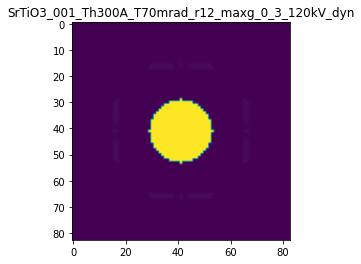

R-factor: 9.738325542010486e-07

>>> producing the 16. dataset...

The offset applied on thickness: -0.0008061679744610413

The offset applied on Ug: -0.049632512248655836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19383202553894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

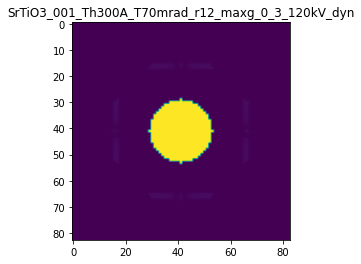

R-factor: 1.0805076465780558e-06

>>> producing the 17. dataset...

The offset applied on thickness: 0.0008691042871027699

The offset applied on Ug: -0.007313795370661715

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8691042871028
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

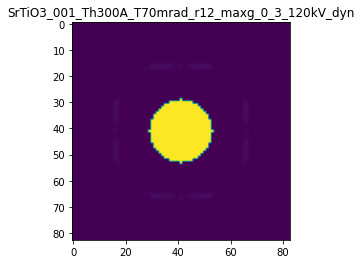

R-factor: 1.098228431163663e-06

>>> producing the 18. dataset...

The offset applied on thickness: 0.0003270545649994936

The offset applied on Ug: -0.0055631346818628205

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32705456499946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

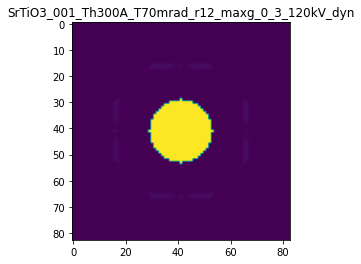

R-factor: 4.149263265562661e-07

>>> producing the 19. dataset...

The offset applied on thickness: 0.00022801363431392964

The offset applied on Ug: 0.0087699443370866

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.22801363431387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

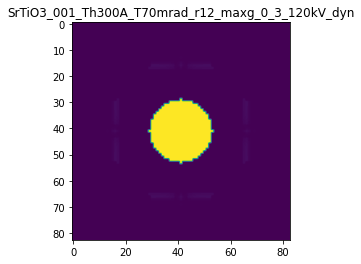

R-factor: 2.982401678128262e-07

>>> producing the 20. dataset...

The offset applied on thickness: -0.0007850293367702226

The offset applied on Ug: 0.04519629548120374

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2149706632298
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

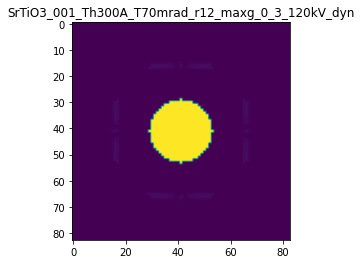

R-factor: 1.0721992367147711e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.0007818241924832035

The offset applied on Ug: 0.08132948769377027

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2181758075168
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

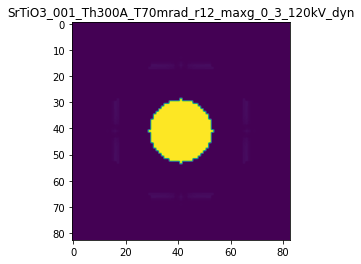

R-factor: 1.2137443188427482e-06

>>> producing the 22. dataset...

The offset applied on thickness: -0.0005677740705252332

The offset applied on Ug: 0.08438814444655783

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4322259294748
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

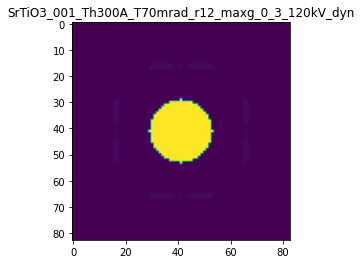

R-factor: 1.0040592052917344e-06

>>> producing the 23. dataset...

The offset applied on thickness: -0.0004095281586390327

The offset applied on Ug: -0.08399618621818565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59047184136097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

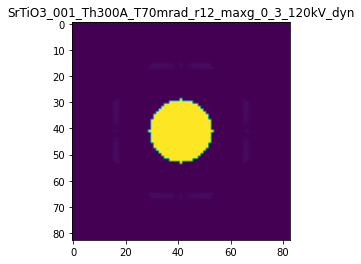

R-factor: 6.855619563003385e-07

>>> producing the 24. dataset...

The offset applied on thickness: -0.00014559271619153113

The offset applied on Ug: 0.07998297358635664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8544072838085
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

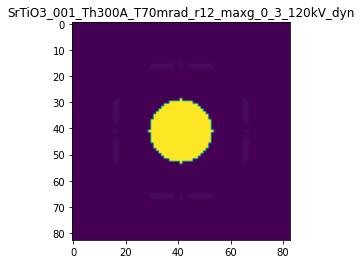

R-factor: 5.898430795036259e-07

>>> producing the 25. dataset...

The offset applied on thickness: 0.0005785432388276555

The offset applied on Ug: 0.09902533629194164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57854323882765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

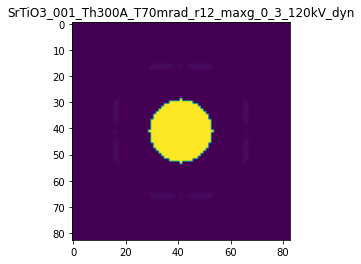

R-factor: 9.0612405093667e-07

>>> producing the 26. dataset...

The offset applied on thickness: 0.00012262981161552267

The offset applied on Ug: 0.07040578598670308

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1226298116155
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

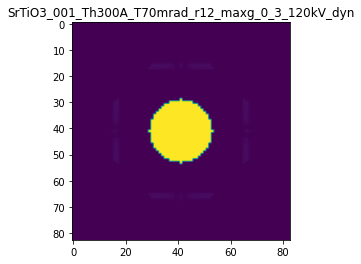

R-factor: 4.292293971904263e-07

>>> producing the 27. dataset...

The offset applied on thickness: -0.00027064732124704974

The offset applied on Ug: 0.05725196631447947

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72935267875295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

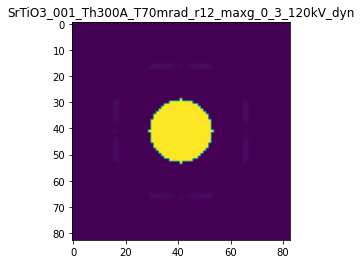

R-factor: 5.692610814329282e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.00029234250968078544

The offset applied on Ug: -0.07390743426623811

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7076574903192
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

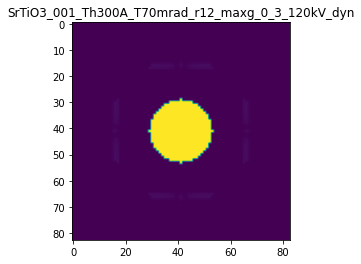

R-factor: 5.491174741375533e-07

>>> producing the 29. dataset...

The offset applied on thickness: 0.00030278554797158154

The offset applied on Ug: -0.0269595729343774

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30278554797155
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

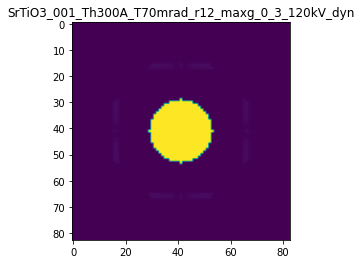

R-factor: 4.5240586550834634e-07

>>> producing the 30. dataset...

The offset applied on thickness: -0.00010720069504955588

The offset applied on Ug: 0.12563825679120608

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8927993049504
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

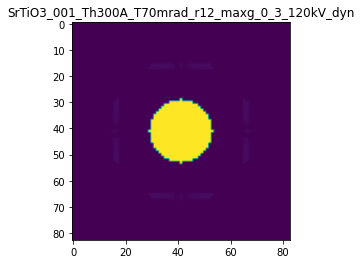

R-factor: 8.384260483603167e-07

>>> producing the 31. dataset...

The offset applied on thickness: -0.0007073848812935071

The offset applied on Ug: -0.07125337439180708

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29261511870646
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

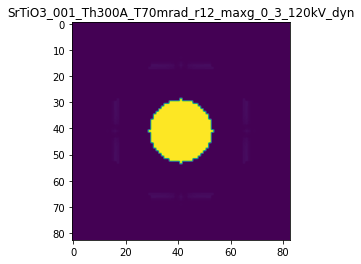

R-factor: 9.980734888234498e-07

>>> producing the 32. dataset...

The offset applied on thickness: -7.082062214913099e-05

The offset applied on Ug: 0.07364365171554293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92917937785086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

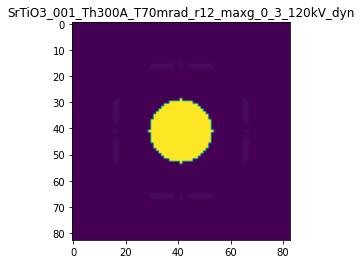

R-factor: 4.96637532120291e-07

>>> producing the 33. dataset...

The offset applied on thickness: -0.0004379575625626402

The offset applied on Ug: 0.001219013341554387

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.56204243743736
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

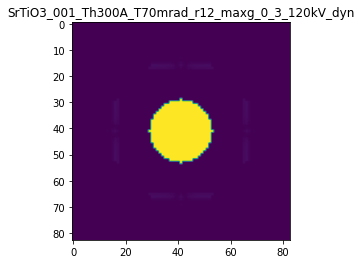

R-factor: 5.514315838277668e-07

>>> producing the 34. dataset...

The offset applied on thickness: 0.0004955065392797857

The offset applied on Ug: -0.021761110289538657

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49550653927975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

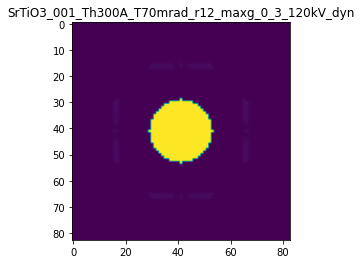

R-factor: 6.568012094808769e-07

>>> producing the 35. dataset...

The offset applied on thickness: -0.00046808608821563704

The offset applied on Ug: -0.14558496190174697

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53191391178433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

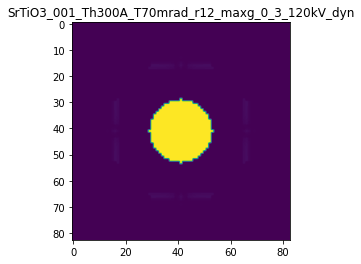

R-factor: 1.0099041007004013e-06

>>> producing the 36. dataset...

The offset applied on thickness: 0.00022478247688124386

The offset applied on Ug: 0.14177722702528223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2247824768812
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

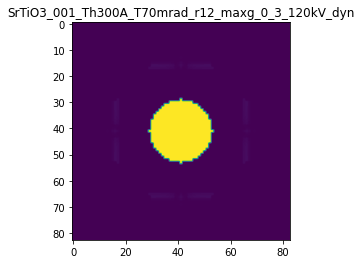

R-factor: 8.556030876403203e-07

>>> producing the 37. dataset...

The offset applied on thickness: 0.00034672823103273887

The offset applied on Ug: -0.08385905058860925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3467282310327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

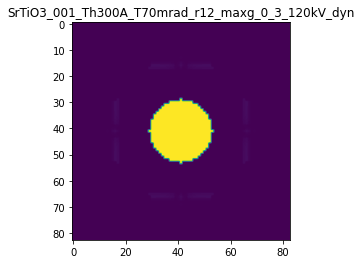

R-factor: 7.878287024729328e-07

>>> producing the 38. dataset...

The offset applied on thickness: 0.00095675812047785

The offset applied on Ug: 0.10996222381234905

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95675812047784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

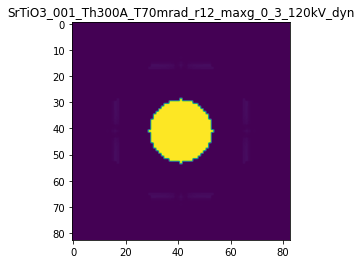

R-factor: 1.3756939287046764e-06

>>> producing the 39. dataset...

The offset applied on thickness: -0.0003670857244082144

The offset applied on Ug: -0.034363469533810226

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6329142755918
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

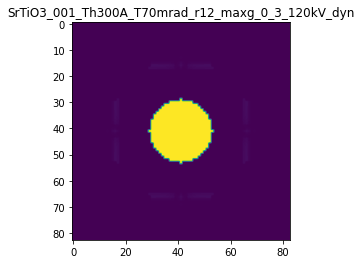

R-factor: 5.131345268650758e-07

>>> producing the 40. dataset...

The offset applied on thickness: -0.0005479536832232095

The offset applied on Ug: 0.06244721324601251

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4520463167768
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

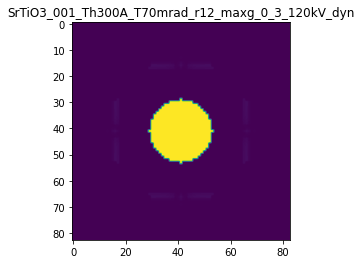

R-factor: 8.75222254687922e-07

>>> producing the 41. dataset...

The offset applied on thickness: 0.0008262276414655692

The offset applied on Ug: -0.059890379189819466

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82622764146555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

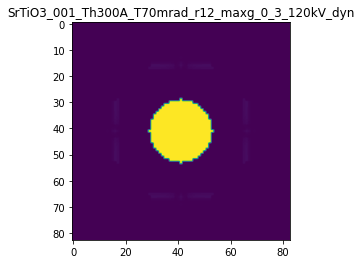

R-factor: 1.1804161269620293e-06

>>> producing the 42. dataset...

The offset applied on thickness: -0.0002535606167186406

The offset applied on Ug: 0.15857122495419307

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7464393832813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

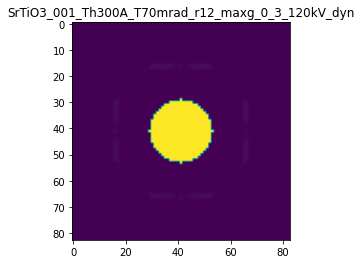

R-factor: 1.142599859269907e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.00025487935311802425

The offset applied on Ug: 0.12028382145496216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74512064688196
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

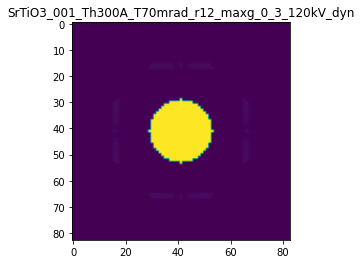

R-factor: 9.16603154021851e-07

>>> producing the 44. dataset...

The offset applied on thickness: -0.0009761430618896964

The offset applied on Ug: 0.045004969890140814

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02385693811027
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

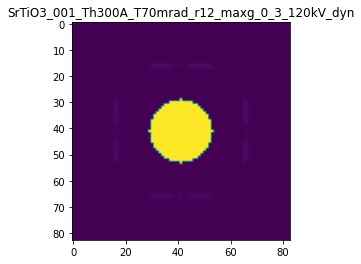

R-factor: 1.29636208976621e-06

>>> producing the 45. dataset...

The offset applied on thickness: -0.0008416960352847314

The offset applied on Ug: 0.15690781841705007

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1583039647153
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

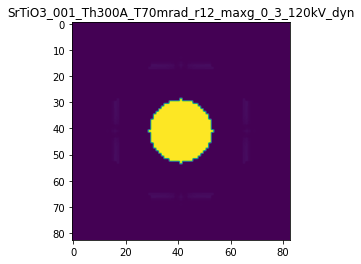

R-factor: 1.655373238383148e-06

>>> producing the 46. dataset...

The offset applied on thickness: -0.00024164759041617924

The offset applied on Ug: 0.023782296007055698

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.75835240958384
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

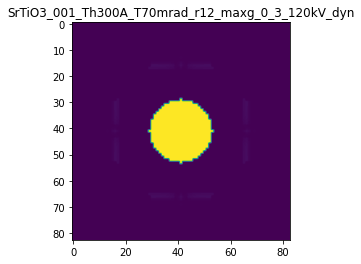

R-factor: 3.698893265182268e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0006436792479146667

The offset applied on Ug: 0.10276348212935182

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.64367924791463
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

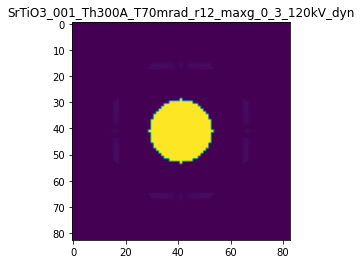

R-factor: 9.879515000776879e-07

>>> producing the 48. dataset...

The offset applied on thickness: 0.0004808961427594998

The offset applied on Ug: 0.05622783003544523

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4808961427595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

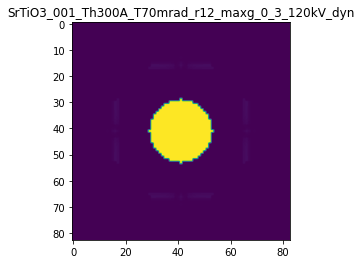

R-factor: 6.933281432802701e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.0008641776745334144

The offset applied on Ug: -0.1191272478439279

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8641776745334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

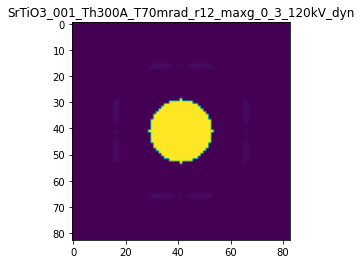

R-factor: 1.4848987486655719e-06

>>> producing the 50. dataset...

The offset applied on thickness: 0.0009047361050061451

The offset applied on Ug: 0.13451581117383793

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9047361050061
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

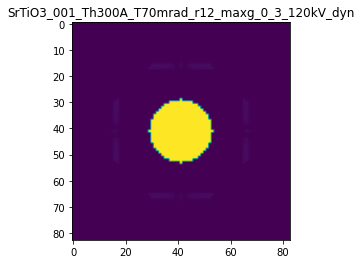

R-factor: 1.3618977118794147e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.0009620472465932573

The offset applied on Ug: 0.1008950111846913

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9620472465933
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

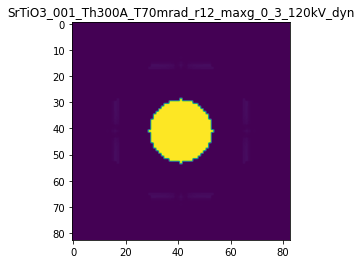

R-factor: 1.3655767364665872e-06

>>> producing the 52. dataset...

The offset applied on thickness: -0.000613668616874051

The offset applied on Ug: -0.12267003206948651

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.38633138312593
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

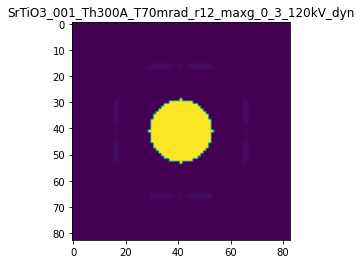

R-factor: 1.015471605160451e-06

>>> producing the 53. dataset...

The offset applied on thickness: 0.0004066163807415606

The offset applied on Ug: 0.052802713327411474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4066163807416
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

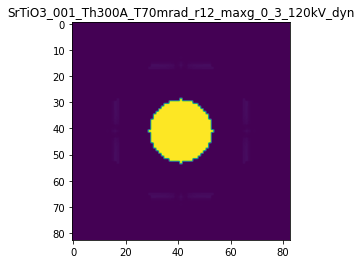

R-factor: 5.960315489905989e-07

>>> producing the 54. dataset...

The offset applied on thickness: 0.0006273425591854909

The offset applied on Ug: -0.12737826809819083

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6273425591855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

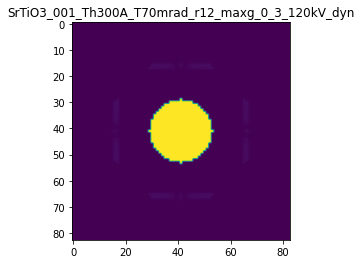

R-factor: 1.2924661350841222e-06

>>> producing the 55. dataset...

The offset applied on thickness: 0.000796648682626062

The offset applied on Ug: 0.06461028723952036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7966486826261
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

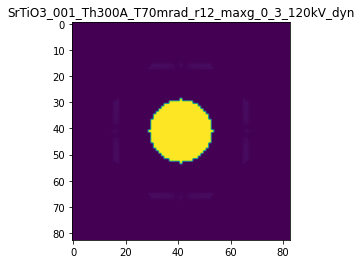

R-factor: 1.0977667117406587e-06

>>> producing the 56. dataset...

The offset applied on thickness: -0.00014107680624579256

The offset applied on Ug: 0.00497332937915747

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85892319375415
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

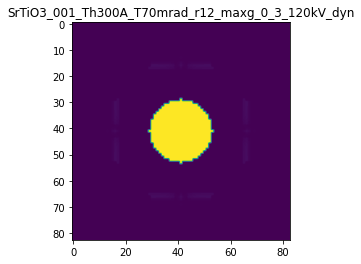

R-factor: 1.8319091348289726e-07

>>> producing the 57. dataset...

The offset applied on thickness: -0.0008513195203138364

The offset applied on Ug: -0.06400857773557028

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.14868047968616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

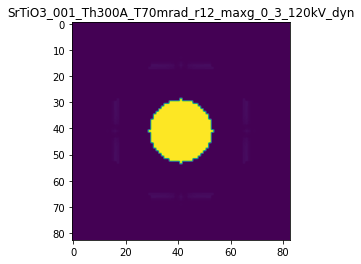

R-factor: 1.161426597137819e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0008189067724895198

The offset applied on Ug: 0.15100283098184758

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1810932275105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

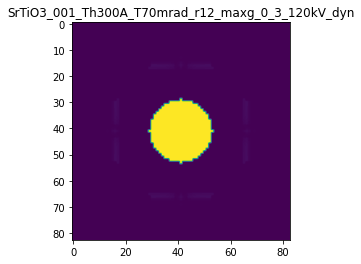

R-factor: 1.601720804829389e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.0005714145324022056

The offset applied on Ug: 0.024603721122423216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42858546759777
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

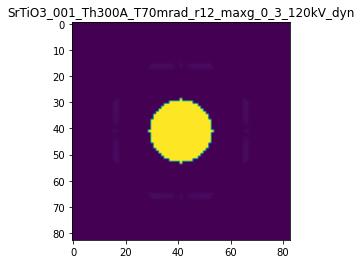

R-factor: 7.5430192290982e-07

>>> producing the 60. dataset...

The offset applied on thickness: 0.0008504031090408802

The offset applied on Ug: -0.1217719785751418

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8504031090409
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

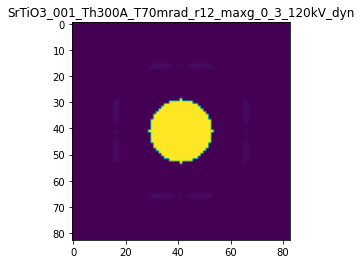

R-factor: 1.4841176229654626e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.0005363599597531413

The offset applied on Ug: 0.038903266999122506

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.53635995975316
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

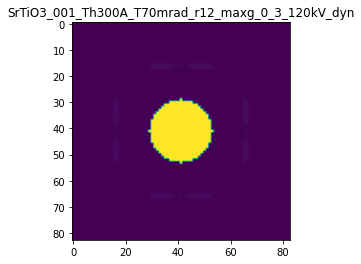

R-factor: 7.308694758875325e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.000513153151735186

The offset applied on Ug: -0.05381788397409167

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4868468482648
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

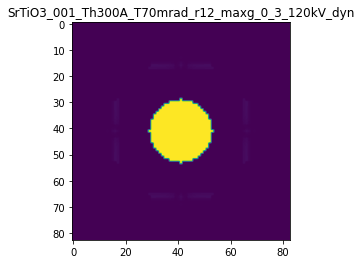

R-factor: 7.281212021919375e-07

>>> producing the 63. dataset...

The offset applied on thickness: 0.00014875173023651533

The offset applied on Ug: -0.1322420232922755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14875173023654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

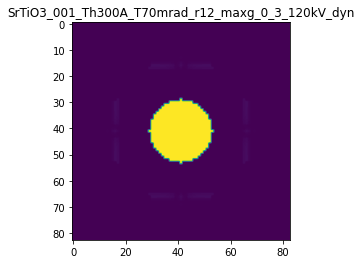

R-factor: 9.053644546755791e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.0005757450312580592

The offset applied on Ug: -0.1502068566898797

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42425496874193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

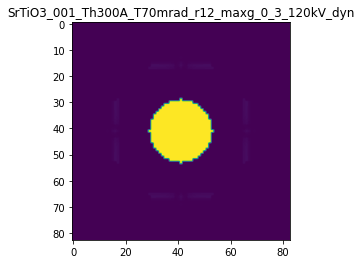

R-factor: 1.1034765982458123e-06

>>> producing the 65. dataset...

The offset applied on thickness: -0.0007411417100603697

The offset applied on Ug: -0.1399985718763453

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.25885828993967
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

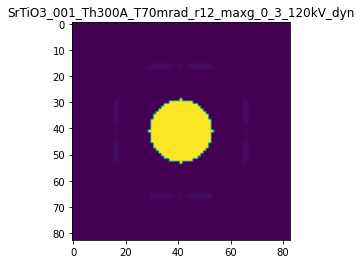

R-factor: 1.2001269263713039e-06

>>> producing the 66. dataset...

The offset applied on thickness: 0.0006477920794028256

The offset applied on Ug: 0.0306241503327324

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6477920794028
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

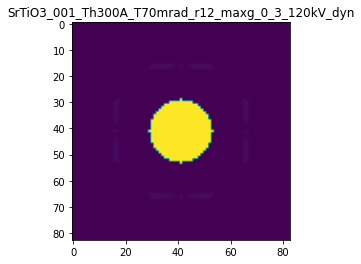

R-factor: 8.559408397748559e-07

>>> producing the 67. dataset...

The offset applied on thickness: 9.569638774150268e-05

The offset applied on Ug: 0.09607522620525394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0956963877415
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

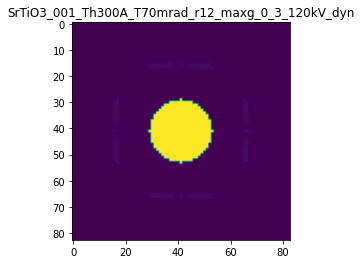

R-factor: 5.675023670525026e-07

>>> producing the 68. dataset...

The offset applied on thickness: 0.0006659405134821308

The offset applied on Ug: 0.07679491608866577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6659405134821
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

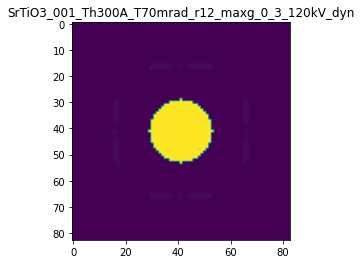

R-factor: 9.58086879689069e-07

>>> producing the 69. dataset...

The offset applied on thickness: -0.00089651687399675

The offset applied on Ug: 0.12308994582530865

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1034831260032
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

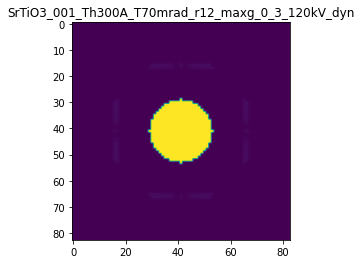

R-factor: 1.5330223642281536e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.00019573661014680234

The offset applied on Ug: -0.14784241173066914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8042633898532
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

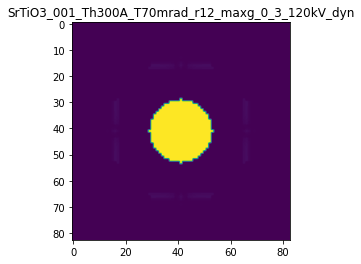

R-factor: 8.80030130390143e-07

>>> producing the 71. dataset...

The offset applied on thickness: 0.0001634652236306371

The offset applied on Ug: -0.03967246880559671

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1634652236306
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

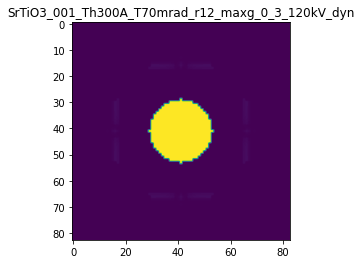

R-factor: 3.7212384513879847e-07

>>> producing the 72. dataset...

The offset applied on thickness: -1.0472690993128087e-05

The offset applied on Ug: -0.1529773431826817

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98952730900686
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

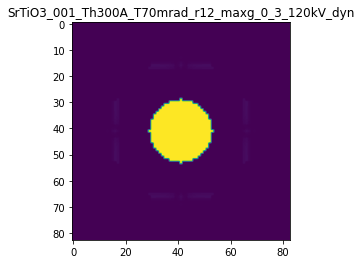

R-factor: 9.315322353099261e-07

>>> producing the 73. dataset...

The offset applied on thickness: -6.327418126385643e-05

The offset applied on Ug: -0.09924646415802539

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93672581873614
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

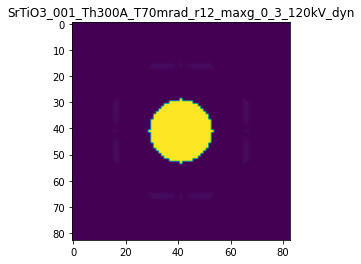

R-factor: 5.873547822062476e-07

>>> producing the 74. dataset...

The offset applied on thickness: -0.0005922788825031671

The offset applied on Ug: -0.0017063584417882538

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4077211174968
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

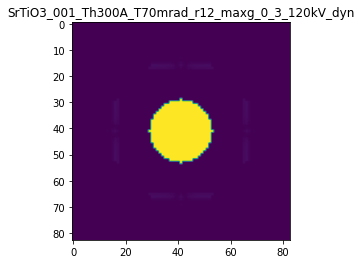

R-factor: 7.464081545493997e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.0008243723301855594

The offset applied on Ug: 0.06761315061038367

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82437233018555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

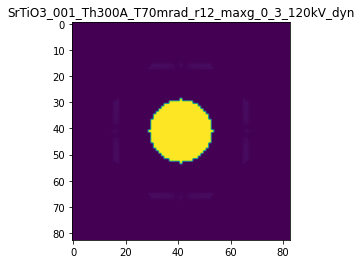

R-factor: 1.1373145282127409e-06

>>> producing the 76. dataset...

The offset applied on thickness: 0.00047619987870950345

The offset applied on Ug: -0.08754320206796966

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4761998787095
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

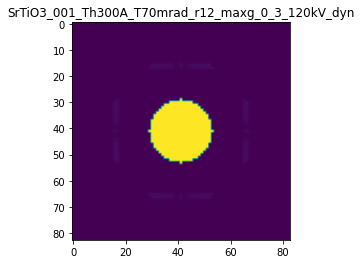

R-factor: 9.31811972168669e-07

>>> producing the 77. dataset...

The offset applied on thickness: -0.0003447705125103668

The offset applied on Ug: 0.09424014605517514

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65522948748963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

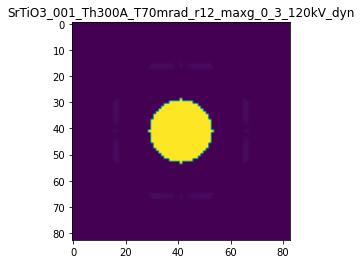

R-factor: 8.439431492334905e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.0007814817048933489

The offset applied on Ug: -0.14095411815986794

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78148170489334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

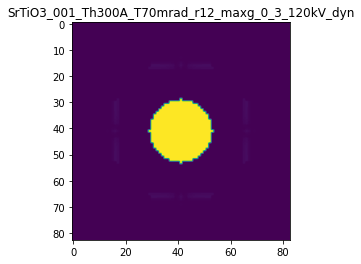

R-factor: 1.5153146816746595e-06

>>> producing the 79. dataset...

The offset applied on thickness: 0.000679562980007866

The offset applied on Ug: 0.13056656869502745

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67956298000786
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

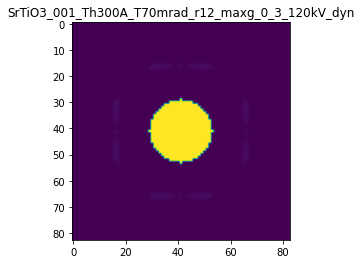

R-factor: 1.105386708911234e-06

>>> producing the 80. dataset...

The offset applied on thickness: -0.0005009143615885576

The offset applied on Ug: -0.05348125484811046

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.49908563841143
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

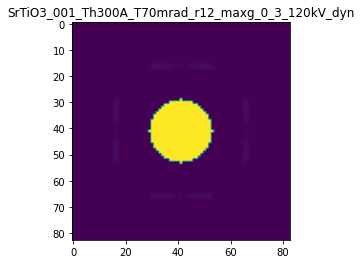

R-factor: 7.1255547459161e-07

>>> producing the 81. dataset...

The offset applied on thickness: 0.0007097428818495904

The offset applied on Ug: -0.10907643145588537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7097428818496
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

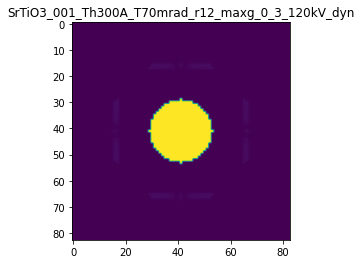

R-factor: 1.2766619290666224e-06

>>> producing the 82. dataset...

The offset applied on thickness: 0.0009660877864592324

The offset applied on Ug: -0.13642362600259014

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96608778645924
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

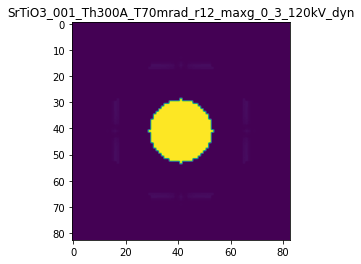

R-factor: 1.6766601873711674e-06

>>> producing the 83. dataset...

The offset applied on thickness: 0.0007656032486558331

The offset applied on Ug: 0.03890341604898282

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7656032486558
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

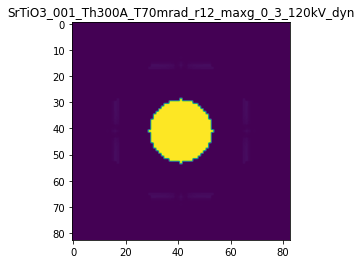

R-factor: 1.0156214154565403e-06

>>> producing the 84. dataset...

The offset applied on thickness: 0.0008248125255732184

The offset applied on Ug: -0.15883470092714774

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8248125255732
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

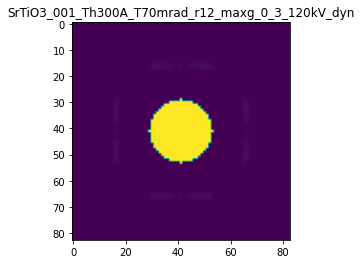

R-factor: 1.6534182652457588e-06

>>> producing the 85. dataset...

The offset applied on thickness: 0.0002112086666671833

The offset applied on Ug: 0.033536061247587484

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2112086666672
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

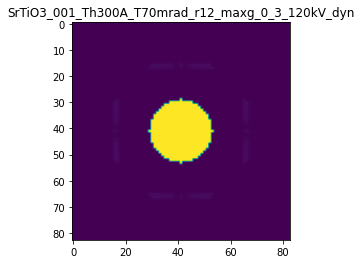

R-factor: 3.237515537393353e-07

>>> producing the 86. dataset...

The offset applied on thickness: -0.00036340871078662684

The offset applied on Ug: -0.10972550941951553

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63659128921336
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

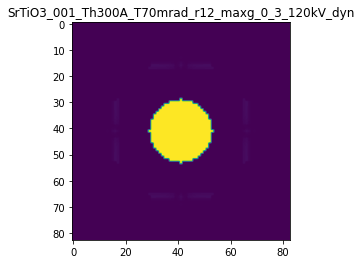

R-factor: 7.680993402817625e-07

>>> producing the 87. dataset...

The offset applied on thickness: -0.0002966842806451997

The offset applied on Ug: -0.13710103240478017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70331571935475
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

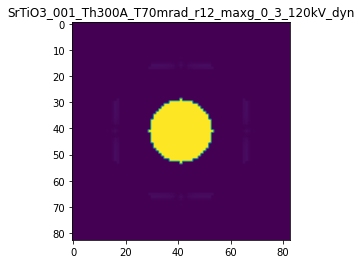

R-factor: 8.629063550142963e-07

>>> producing the 88. dataset...

The offset applied on thickness: 0.0004136007365735002

The offset applied on Ug: 0.12688837330294722

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41360073657347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

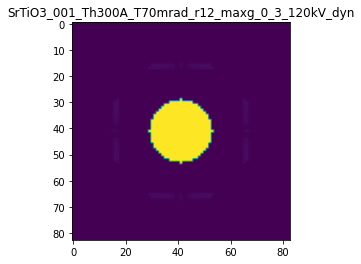

R-factor: 8.828159402822198e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.000764799851555442

The offset applied on Ug: -0.1357209630067889

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23520014844456
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

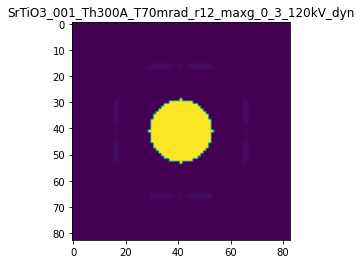

R-factor: 1.213030355685124e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.000355436775763871

The offset applied on Ug: -0.15818615329784844

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6445632242361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

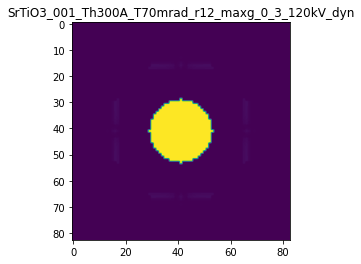

R-factor: 1.0026850775265715e-06

>>> producing the 91. dataset...

The offset applied on thickness: 0.00021450763689256024

The offset applied on Ug: -0.004375859267235889

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21450763689256
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

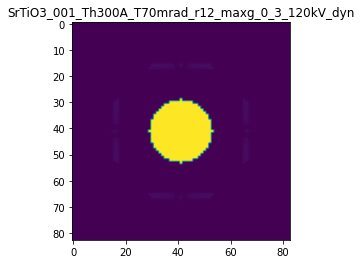

R-factor: 2.7305538858661837e-07

>>> producing the 92. dataset...

The offset applied on thickness: -0.0002732691042147779

The offset applied on Ug: -0.13458768064799448

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72673089578524
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

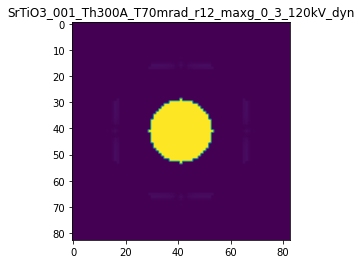

R-factor: 8.375565890603024e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.000492696565393441

The offset applied on Ug: 0.05099278945578835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50730343460657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

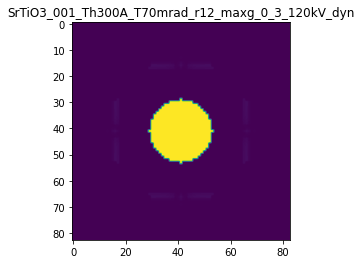

R-factor: 7.641761811058814e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.0006503272215926087

The offset applied on Ug: 0.1494419138909838

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3496727784074
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

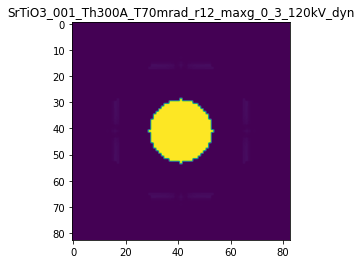

R-factor: 1.4322163167625828e-06

>>> producing the 95. dataset...

The offset applied on thickness: -0.0006765179581305403

The offset applied on Ug: -0.08616823884821838

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32348204186945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

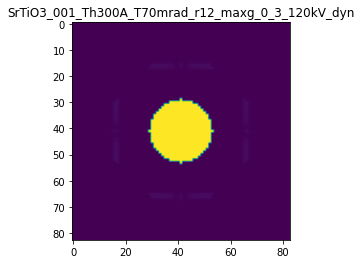

R-factor: 9.891179966648603e-07

>>> producing the 96. dataset...

The offset applied on thickness: 0.0005807288412380605

The offset applied on Ug: -0.11669000602821036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58072884123806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

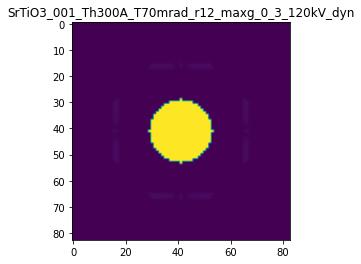

R-factor: 1.1897903904969524e-06

>>> producing the 97. dataset...

The offset applied on thickness: 0.0008029551345748945

The offset applied on Ug: -0.1090381442120422

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8029551345749
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

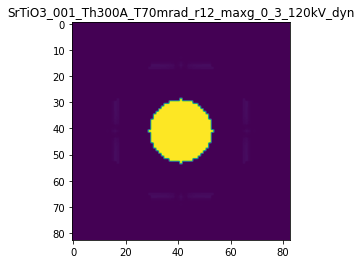

R-factor: 1.3713683491490208e-06

>>> producing the 98. dataset...

The offset applied on thickness: 0.0006301986347978192

The offset applied on Ug: 0.11788792812822113

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6301986347978
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

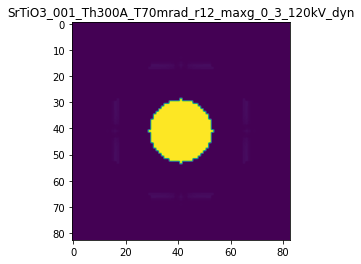

R-factor: 1.0150818826182906e-06

>>> producing the 99. dataset...

The offset applied on thickness: -0.0003493338832745019

The offset applied on Ug: -0.1269880476348234

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65066611672546
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

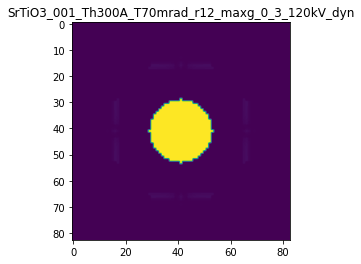

R-factor: 8.436088125349599e-07

>>> producing the 100. dataset...

The offset applied on thickness: -0.0009759860823682549

The offset applied on Ug: -0.060856347339849966

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02401391763175
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

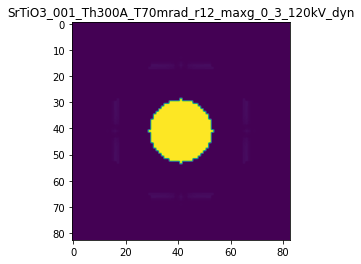

R-factor: 1.309045789454142e-06

>>> producing the 101. dataset...

The offset applied on thickness: 0.00019824602219254306

The offset applied on Ug: 0.1479138091939427

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1982460221925
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

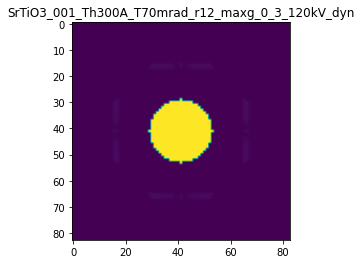

R-factor: 8.804589116124256e-07

>>> producing the 102. dataset...

The offset applied on thickness: 0.0004500202321554725

The offset applied on Ug: 0.002624877217273962

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.45002023215545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

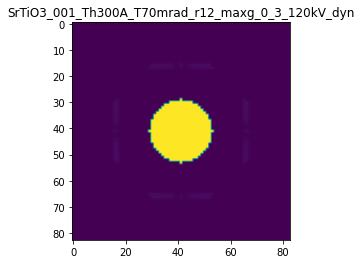

R-factor: 5.696686292143919e-07

>>> producing the 103. dataset...

The offset applied on thickness: 0.00041455926154673484

The offset applied on Ug: -0.08930953899198617

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4145592615467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

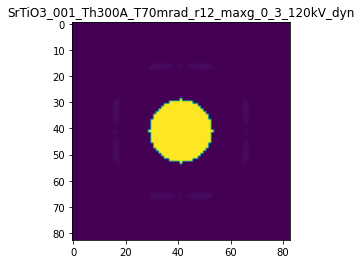

R-factor: 8.814849651314388e-07

>>> producing the 104. dataset...

The offset applied on thickness: -0.0008291205058853453

The offset applied on Ug: -0.07371334619887218

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1708794941146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

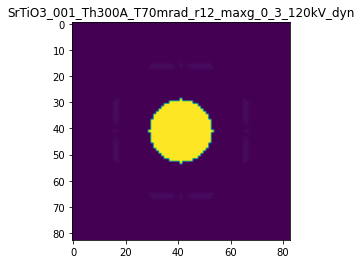

R-factor: 1.1514098701227515e-06

>>> producing the 105. dataset...

The offset applied on thickness: 4.7235598886082196e-05

The offset applied on Ug: 0.08137939694690427

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04723559888606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

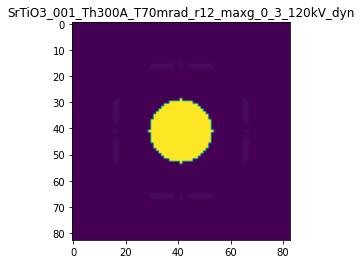

R-factor: 4.829107833907956e-07

>>> producing the 106. dataset...

The offset applied on thickness: -0.0007770583482377509

The offset applied on Ug: 0.01745595361430091

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2229416517622
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

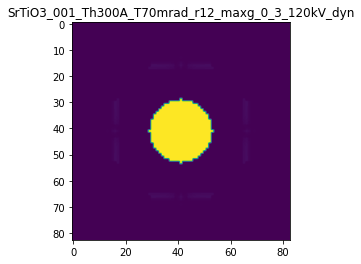

R-factor: 9.898468663366395e-07

>>> producing the 107. dataset...

The offset applied on thickness: 0.00046188062978030507

The offset applied on Ug: 0.13809457295318348

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4618806297803
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

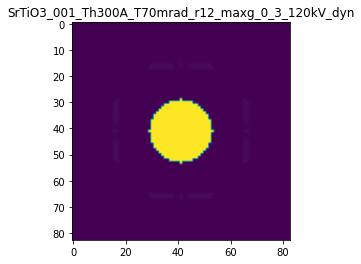

R-factor: 9.686298939589074e-07

>>> producing the 108. dataset...

The offset applied on thickness: 0.0005400489081920427

The offset applied on Ug: 0.13654382499045759

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54004890819203
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

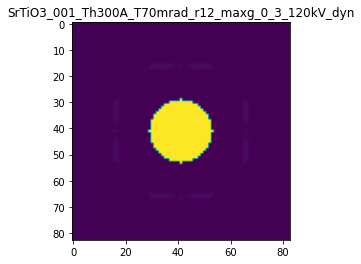

R-factor: 1.0144473871056365e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0004858138780305168

The offset applied on Ug: -0.053493821466589576

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51418612196943
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

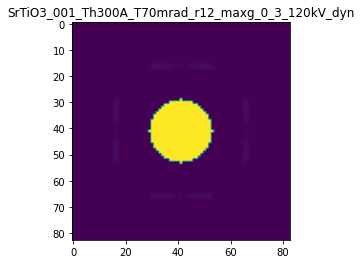

R-factor: 6.941625076790181e-07

>>> producing the 110. dataset...

The offset applied on thickness: 0.000301882696127284

The offset applied on Ug: -0.04351372768022827

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3018826961273
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

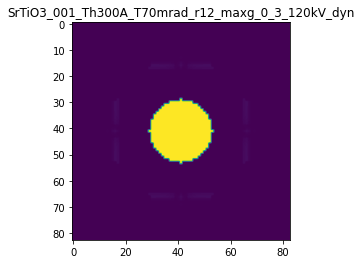

R-factor: 5.277983111181162e-07

>>> producing the 111. dataset...

The offset applied on thickness: 5.6978404727656475e-05

The offset applied on Ug: -0.1330631366411954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05697840472766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

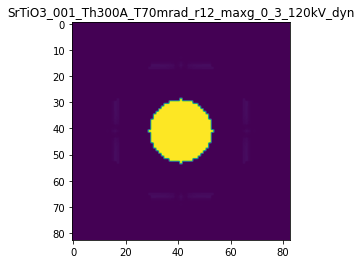

R-factor: 8.487084858734744e-07

>>> producing the 112. dataset...

The offset applied on thickness: 8.290566118495169e-05

The offset applied on Ug: -0.052806917831786856

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.08290566118495
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

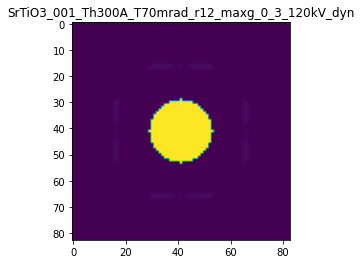

R-factor: 3.7897240720668843e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.0009228532546161888

The offset applied on Ug: -0.016375797403933526

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0771467453838
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

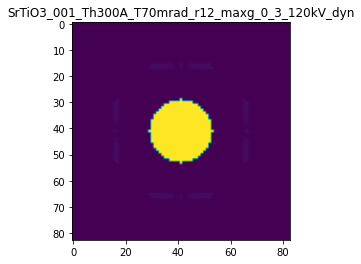

R-factor: 1.17757849328541e-06

>>> producing the 114. dataset...

The offset applied on thickness: -2.414649396977753e-05

The offset applied on Ug: 0.007546253856856993

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9758535060302
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

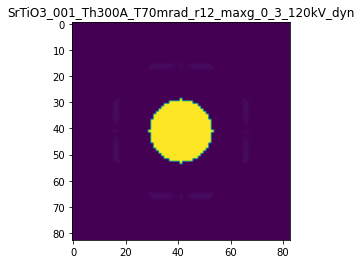

R-factor: 6.447707561063343e-08

>>> producing the 115. dataset...

The offset applied on thickness: 0.000791442736774165

The offset applied on Ug: -0.030965639435476148

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7914427367742
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

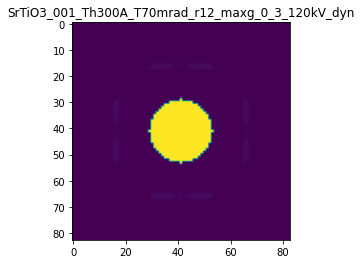

R-factor: 1.03837479006512e-06

>>> producing the 116. dataset...

The offset applied on thickness: -4.838729020893129e-05

The offset applied on Ug: -0.15461512917872564

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95161270979105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

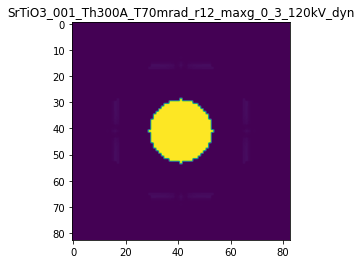

R-factor: 9.249508996046205e-07

>>> producing the 117. dataset...

The offset applied on thickness: 0.0004893303149970594

The offset applied on Ug: -0.09073209988853506

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.489330314997
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

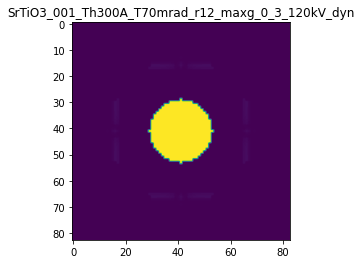

R-factor: 9.616801710201935e-07

>>> producing the 118. dataset...

The offset applied on thickness: 0.0008655051204908762

The offset applied on Ug: -0.11104462866837565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86550512049087
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

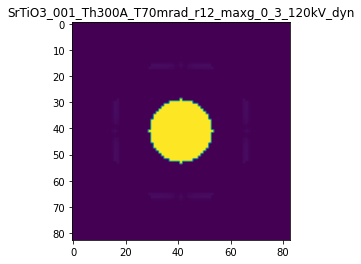

R-factor: 1.4461711591334264e-06

>>> producing the 119. dataset...

The offset applied on thickness: 0.0003007672521924047

The offset applied on Ug: -0.037402230179230535

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30076725219243
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

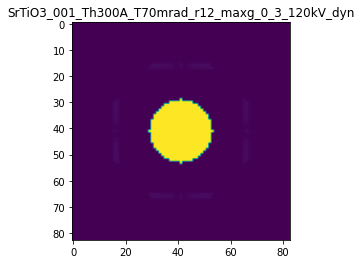

R-factor: 4.961855765633999e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.0005227430920486935

The offset applied on Ug: 0.12739878826811857

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5227430920487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

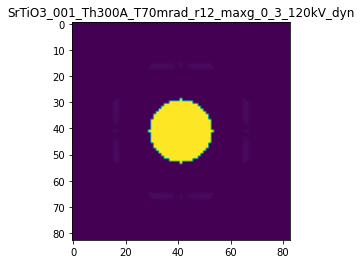

R-factor: 9.605321542366736e-07

>>> producing the 121. dataset...

The offset applied on thickness: 0.0008600092333453839

The offset applied on Ug: 0.05903200212107251

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8600092333454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

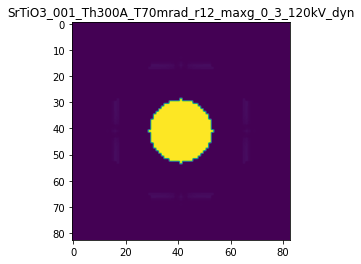

R-factor: 1.1665939138419948e-06

>>> producing the 122. dataset...

The offset applied on thickness: 0.0005811703051424359

The offset applied on Ug: 0.044161387189389605

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5811703051424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

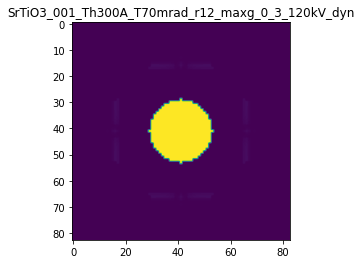

R-factor: 7.95469216434773e-07

>>> producing the 123. dataset...

The offset applied on thickness: -0.0008125817683152514

The offset applied on Ug: -0.07889646053025917

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1874182316847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

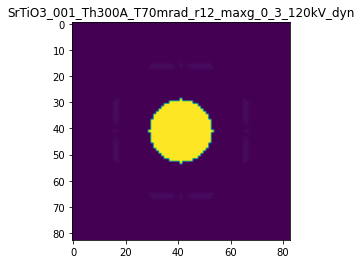

R-factor: 1.1408135957425036e-06

>>> producing the 124. dataset...

The offset applied on thickness: -0.0008999100051943985

The offset applied on Ug: -0.11126520319511872

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10008999480556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

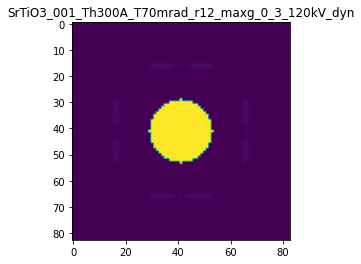

R-factor: 1.3094181371860668e-06

>>> producing the 125. dataset...

The offset applied on thickness: 2.7986956013962062e-05

The offset applied on Ug: -0.14992560653932788

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.02798695601393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

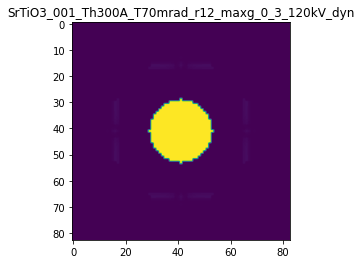

R-factor: 9.342065727980487e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.0003753554630242182

The offset applied on Ug: -0.09578783858914271

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6246445369758
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

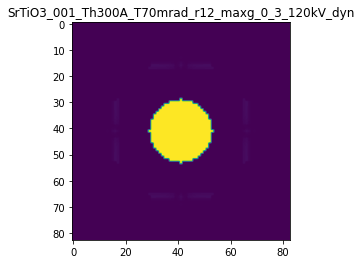

R-factor: 7.091527581805582e-07

>>> producing the 127. dataset...

The offset applied on thickness: 0.000952137846126887

The offset applied on Ug: 0.002927802502278105

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9521378461269
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

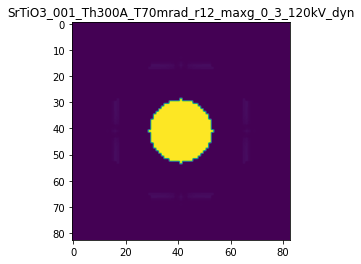

R-factor: 1.203904046051347e-06

>>> producing the 128. dataset...

The offset applied on thickness: -0.0003367644696047465

The offset applied on Ug: 0.02537434930419458

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66323553039524
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

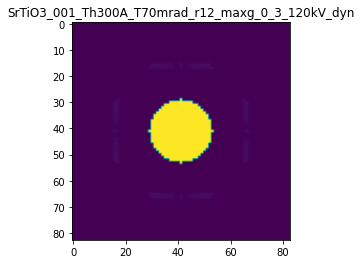

R-factor: 4.840724294263282e-07

>>> producing the 129. dataset...

The offset applied on thickness: -0.0005254304983536957

The offset applied on Ug: -0.0076198362007545845

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.47456950164633
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

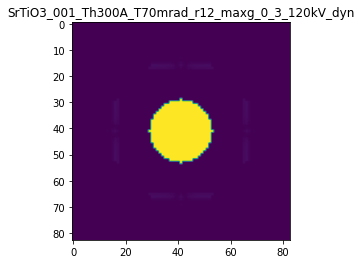

R-factor: 6.686522339460049e-07

>>> producing the 130. dataset...

The offset applied on thickness: -0.0004210810434854417

The offset applied on Ug: 0.004505649354737216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57891895651454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

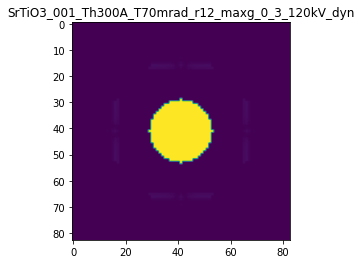

R-factor: 5.310572818458826e-07

>>> producing the 131. dataset...

The offset applied on thickness: -0.000722045012551632

The offset applied on Ug: 0.14639619524744332

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.27795498744837
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

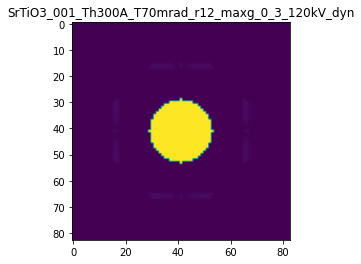

R-factor: 1.4836020658784715e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0009536401908677426

The offset applied on Ug: -0.075565978131646

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04635980913224
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

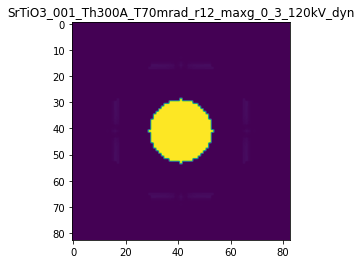

R-factor: 1.307670239327452e-06

>>> producing the 133. dataset...

The offset applied on thickness: 0.0007450462748291599

The offset applied on Ug: -0.04522530549417088

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7450462748292
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

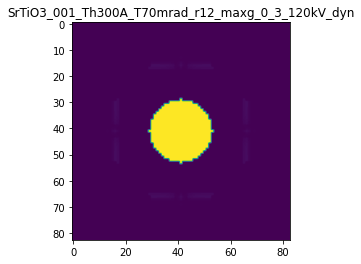

R-factor: 1.029457942382623e-06

>>> producing the 134. dataset...

The offset applied on thickness: -0.0006643057249817679

The offset applied on Ug: 0.15264094707486794

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3356942750182
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

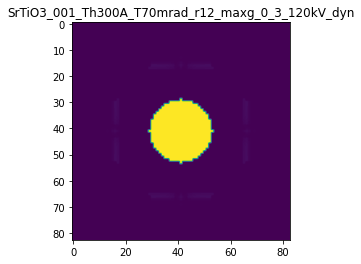

R-factor: 1.4629039522673498e-06

>>> producing the 135. dataset...

The offset applied on thickness: 0.0007007453780729749

The offset applied on Ug: 0.09954862946729343

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.70074537807295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

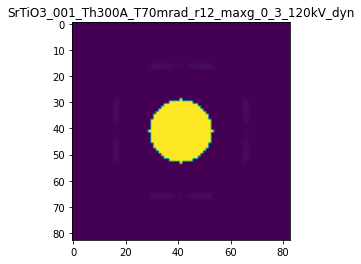

R-factor: 1.043791017257234e-06

>>> producing the 136. dataset...

The offset applied on thickness: -0.0007141816612362753

The offset applied on Ug: -0.043086593390074486

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2858183387637
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

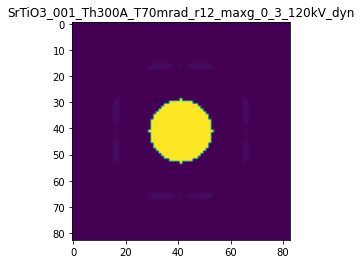

R-factor: 9.5582780490565e-07

>>> producing the 137. dataset...

The offset applied on thickness: -0.0006472030585752883

The offset applied on Ug: -0.07108389187785395

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3527969414247
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

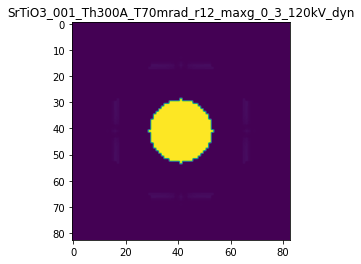

R-factor: 9.243900591835317e-07

>>> producing the 138. dataset...

The offset applied on thickness: 0.0009794693666289901

The offset applied on Ug: -0.08546670602585917

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.979469366629
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

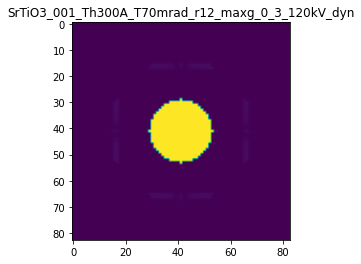

R-factor: 1.457887636105082e-06

>>> producing the 139. dataset...

The offset applied on thickness: 0.0002401776524132475

The offset applied on Ug: -0.1462107877084665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24017765241325
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

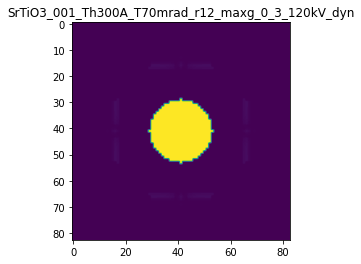

R-factor: 1.0568883773011578e-06

>>> producing the 140. dataset...

The offset applied on thickness: -0.0004554423784704418

The offset applied on Ug: 0.15237583810622377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5445576215295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

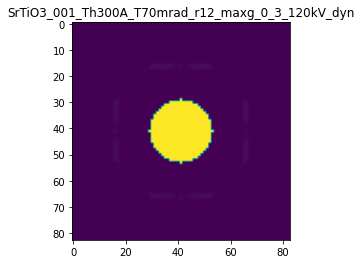

R-factor: 1.2732490724382151e-06



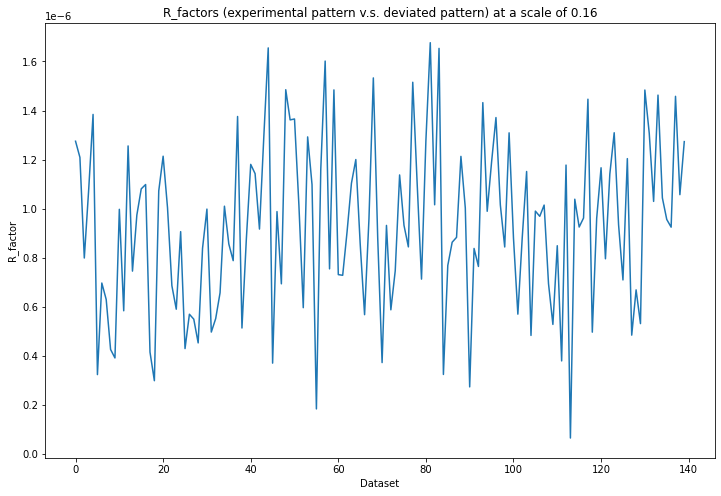

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 4s 398ms/step - loss: 0.1979 - acc: 0.0000e+00 - val_loss: 0.1319 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 249ms/step - loss: 0.1100 - acc: 0.0000e+00 - val_loss: 0.0744 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 233ms/step - loss: 0.0594 - acc: 0.0000e+00 - val_loss: 0.0414 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 211ms/step - loss: 0.0318 - acc: 0.0000e+00 - val_loss: 0.0217 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 209ms/step - loss: 0.0161 - acc: 0.0000e+00 - val_loss: 0.0093 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 198ms/step - loss: 0.0064 - acc: 0.6000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 215ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

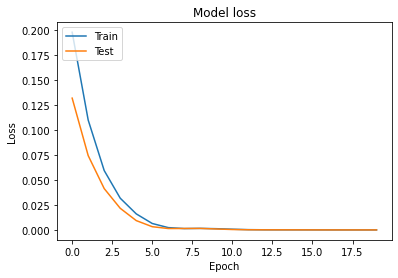

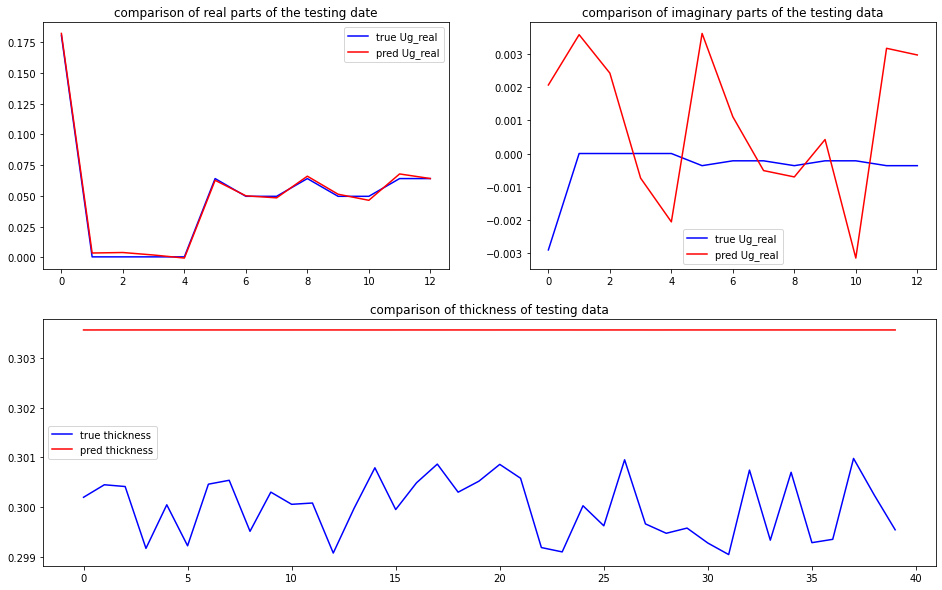

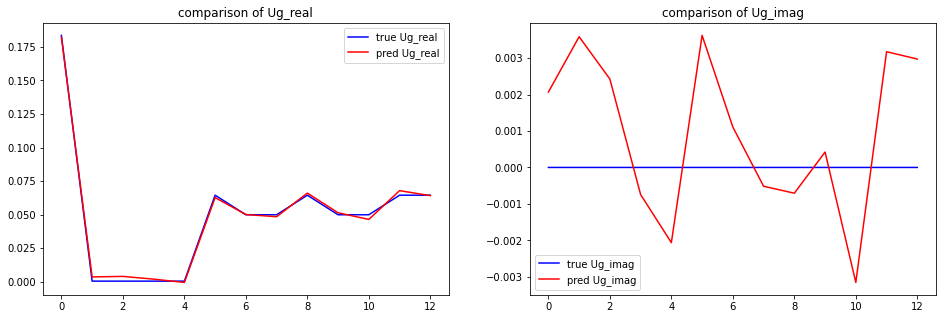

predicted thickness: 30.356326699256897 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=303.56326699256897
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18210009+0.j         0.0037

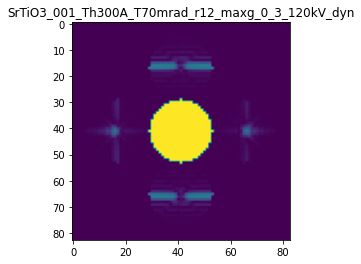

X_sim.max(): 0.9999394970344418
R-factor at a scale of 0.16 is 0.007819681509281855.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.32

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0009432807455082729

The offset applied on Ug: -0.10422816318625074

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


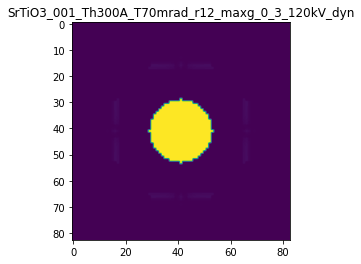

R-factor: 1.348497321230476e-06

>>> producing the 2. dataset...

The offset applied on thickness: 0.0007765368291864261

The offset applied on Ug: 0.0052822684411867726

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7765368291864
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

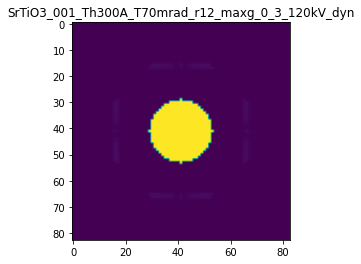

R-factor: 9.84386785086515e-07

>>> producing the 3. dataset...

The offset applied on thickness: 0.0008968594726135295

The offset applied on Ug: 0.03211478596958415

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8968594726135
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

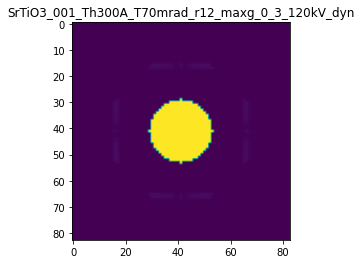

R-factor: 1.1711159150232298e-06

>>> producing the 4. dataset...

The offset applied on thickness: 0.0007832553562240532

The offset applied on Ug: 0.24535510414903436

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.783255356224
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

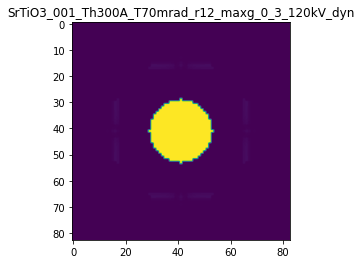

R-factor: 1.6944227744844243e-06

>>> producing the 5. dataset...

The offset applied on thickness: 0.0003508921392106219

The offset applied on Ug: 0.19874316310978316

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3508921392106
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

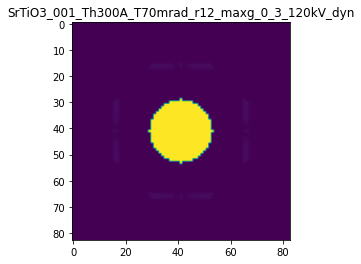

R-factor: 1.2124352779380924e-06

>>> producing the 6. dataset...

The offset applied on thickness: 0.0002396208679363796

The offset applied on Ug: 0.19470234352540075

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23962086793637
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

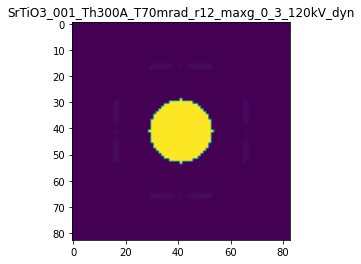

R-factor: 1.1542600397787849e-06

>>> producing the 7. dataset...

The offset applied on thickness: 0.0001450219569737665

The offset applied on Ug: -0.22115148443549246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1450219569737
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

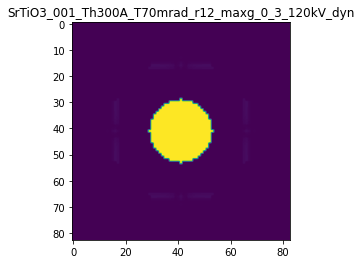

R-factor: 1.4418500574194856e-06

>>> producing the 8. dataset...

The offset applied on thickness: -0.000604411527615292

The offset applied on Ug: -0.18343772133475156

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3955884723847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

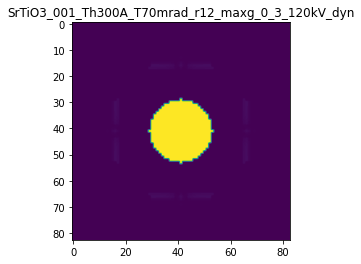

R-factor: 1.282319748567801e-06

>>> producing the 9. dataset...

The offset applied on thickness: 0.00022455229345886752

The offset applied on Ug: 0.12675465399205385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2245522934588
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

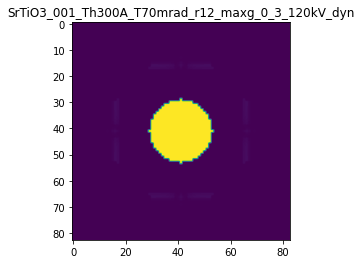

R-factor: 7.739163076967405e-07

>>> producing the 10. dataset...

The offset applied on thickness: 0.0003209505794670318

The offset applied on Ug: 0.24691761668509032

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.320950579467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

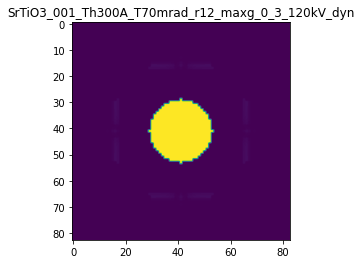

R-factor: 1.4672089730624864e-06

>>> producing the 11. dataset...

The offset applied on thickness: 3.9482750391605535e-05

The offset applied on Ug: -0.2700394217271233

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0394827503916
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

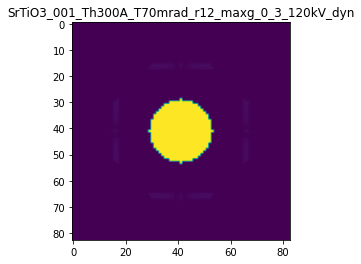

R-factor: 1.6733729024152773e-06

>>> producing the 12. dataset...

The offset applied on thickness: -0.00013075897659720526

The offset applied on Ug: -0.11745615891948902

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86924102340276
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

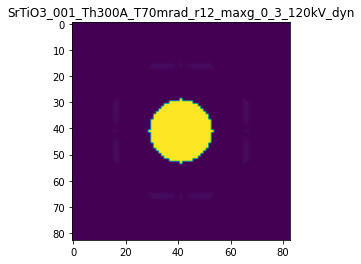

R-factor: 6.939767287564034e-07

>>> producing the 13. dataset...

The offset applied on thickness: 0.0009753268410671072

The offset applied on Ug: 0.23816733608023208

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9753268410671
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

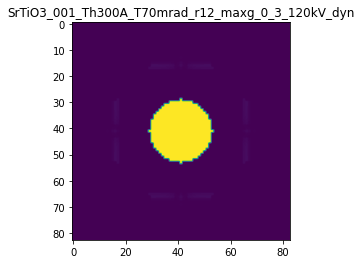

R-factor: 1.7944539514456923e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.0008642515506478629

The offset applied on Ug: 0.08407806763393381

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86425155064785
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

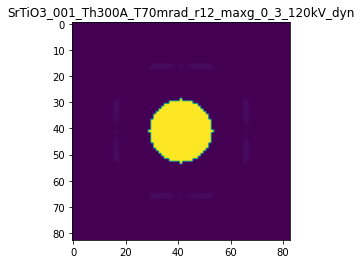

R-factor: 1.2152796055692708e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.00010522694451332316

The offset applied on Ug: 0.10969903514263386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1052269445133
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

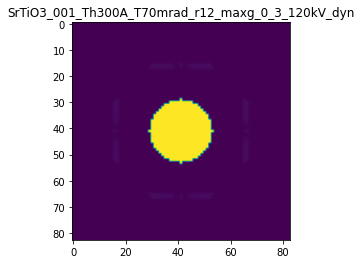

R-factor: 6.480022004280792e-07

>>> producing the 16. dataset...

The offset applied on thickness: 0.0009957773764311065

The offset applied on Ug: -0.14713602354109184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9957773764311
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

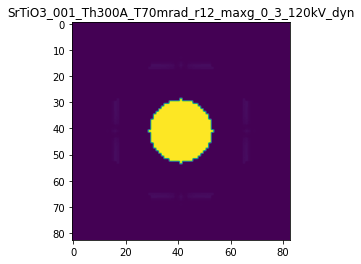

R-factor: 1.7615268819704804e-06

>>> producing the 17. dataset...

The offset applied on thickness: -0.0008311852464578922

The offset applied on Ug: 0.18205880470621402

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1688147535421
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

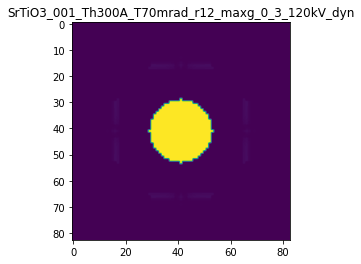

R-factor: 1.781002820248499e-06

>>> producing the 18. dataset...

The offset applied on thickness: -0.0008414705869802457

The offset applied on Ug: 0.2523431904144342

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1585294130197
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

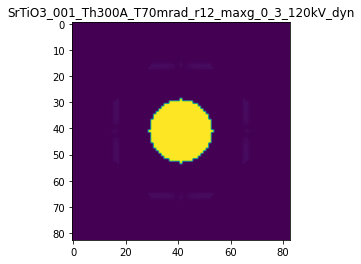

R-factor: 2.185444189985576e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.0005340294478514363

The offset applied on Ug: -0.2786367062868241

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5340294478514
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

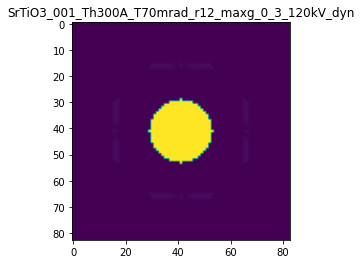

R-factor: 2.0739111444340823e-06

>>> producing the 20. dataset...

The offset applied on thickness: 0.0005946575391896953

The offset applied on Ug: -0.06749451431557325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.59465753918965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

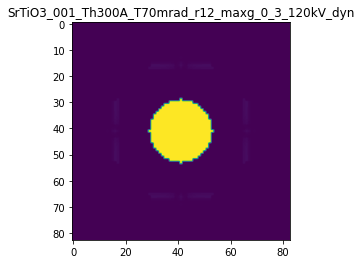

R-factor: 9.505956644754086e-07

>>> producing the 21. dataset...

The offset applied on thickness: -0.0003045489095817622

The offset applied on Ug: -0.18152442089880594

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6954510904182
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

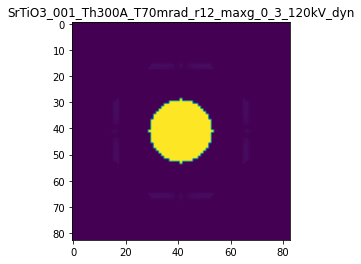

R-factor: 1.1036214421343936e-06

>>> producing the 22. dataset...

The offset applied on thickness: -0.0004444232276233506

The offset applied on Ug: -0.3155500383443709

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.55557677237664
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

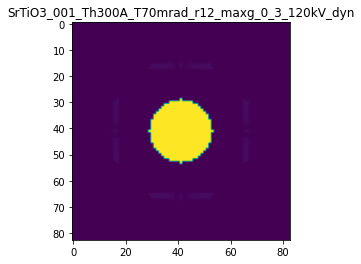

R-factor: 1.889260626199578e-06

>>> producing the 23. dataset...

The offset applied on thickness: 0.0004688404039369611

The offset applied on Ug: -0.04045390343841504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46884040393695
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

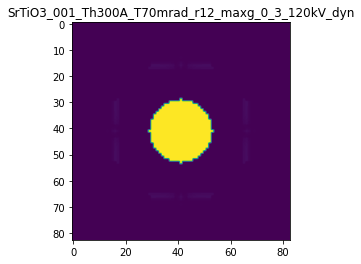

R-factor: 6.954583126037687e-07

>>> producing the 24. dataset...

The offset applied on thickness: -0.00013116393869414545

The offset applied on Ug: -0.12154151718667607

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86883606130584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

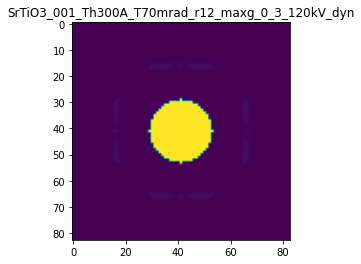

R-factor: 7.174707728757777e-07

>>> producing the 25. dataset...

The offset applied on thickness: -0.00011849503917702009

The offset applied on Ug: -0.24410301328891656

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88150496082295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

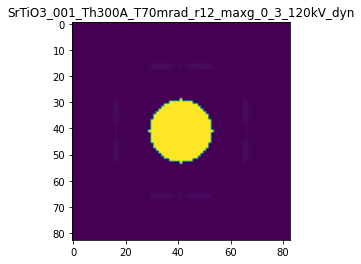

R-factor: 1.4489656117064518e-06

>>> producing the 26. dataset...

The offset applied on thickness: 0.00012084766983764728

The offset applied on Ug: 0.2713347205659698

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12084766983764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

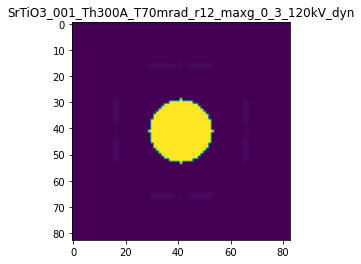

R-factor: 1.6196116900448607e-06

>>> producing the 27. dataset...

The offset applied on thickness: 0.00028218605222873406

The offset applied on Ug: 0.02557379517763067

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2821860522287
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

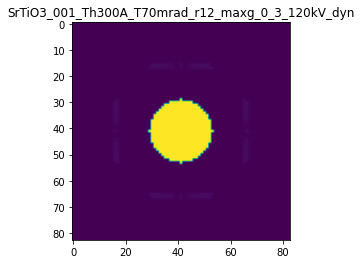

R-factor: 3.93325511106884e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.00011105860752472396

The offset applied on Ug: 0.23777059568878456

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88894139247526
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

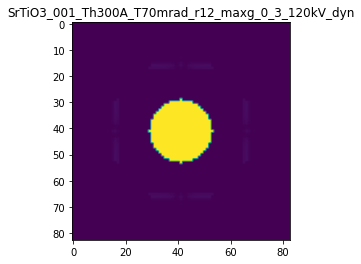

R-factor: 1.5287206810463749e-06

>>> producing the 29. dataset...

The offset applied on thickness: -0.00036402608735807074

The offset applied on Ug: 0.000243109377843993

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63597391264193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

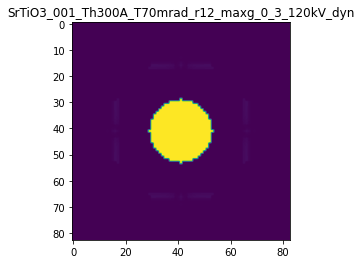

R-factor: 4.582029480121171e-07

>>> producing the 30. dataset...

The offset applied on thickness: -0.0007053279955818028

The offset applied on Ug: 0.05140326055447737

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29467200441815
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

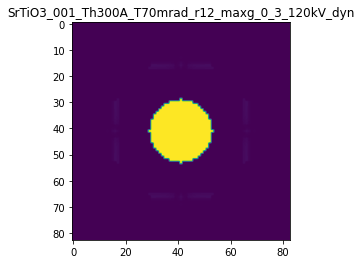

R-factor: 1.0063081077182476e-06

>>> producing the 31. dataset...

The offset applied on thickness: 0.000715450539556751

The offset applied on Ug: 0.22971541748507818

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71545053955674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

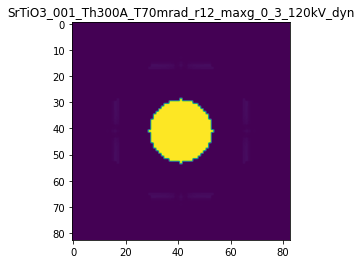

R-factor: 1.5746147507393116e-06

>>> producing the 32. dataset...

The offset applied on thickness: 0.0003765547471684019

The offset applied on Ug: 0.2006585750361377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3765547471684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

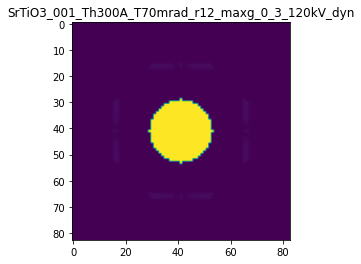

R-factor: 1.232793084425878e-06

>>> producing the 33. dataset...

The offset applied on thickness: -0.0005925311121447983

The offset applied on Ug: -0.046724137966018875

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4074688878552
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

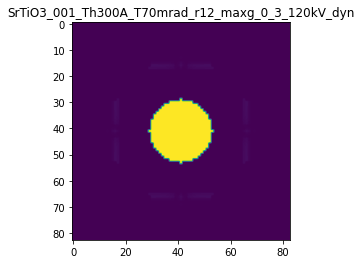

R-factor: 8.125579899713074e-07

>>> producing the 34. dataset...

The offset applied on thickness: 0.0006935651314595173

The offset applied on Ug: 0.2708427946604519

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6935651314595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

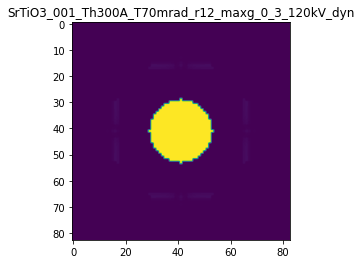

R-factor: 1.7615316580542781e-06

>>> producing the 35. dataset...

The offset applied on thickness: -0.0007826153467394648

The offset applied on Ug: 0.30438698259529695

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2173846532605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

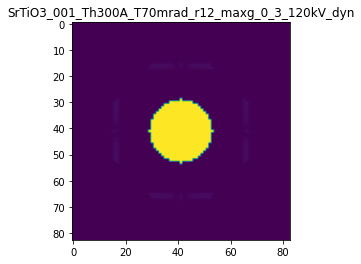

R-factor: 2.4346542111181863e-06

>>> producing the 36. dataset...

The offset applied on thickness: -7.20276220388858e-05

The offset applied on Ug: -0.1686901956339046

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9279723779611
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

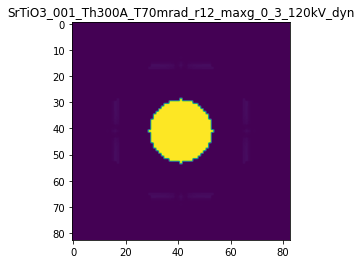

R-factor: 1.0039688870983587e-06

>>> producing the 37. dataset...

The offset applied on thickness: 6.728188740043572e-05

The offset applied on Ug: -0.07126388699883116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06728188740044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

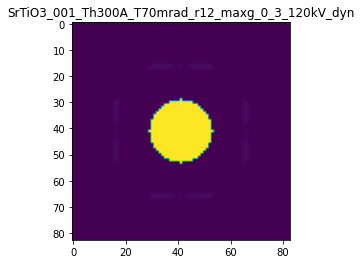

R-factor: 4.791705603905943e-07

>>> producing the 38. dataset...

The offset applied on thickness: -0.0007574741905732117

The offset applied on Ug: 0.08895377592718738

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2425258094268
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

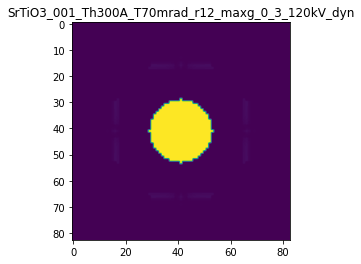

R-factor: 1.2218432216805434e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0003766020993039059

The offset applied on Ug: -0.17798400246173388

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3766020993039
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

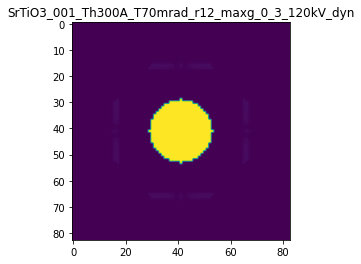

R-factor: 1.3550022855336683e-06

>>> producing the 40. dataset...

The offset applied on thickness: -7.550523937409382e-05

The offset applied on Ug: 0.3093681393104937

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92449476062586
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

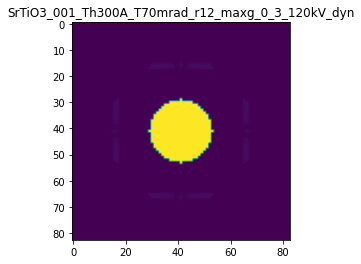

R-factor: 1.949276771199055e-06

>>> producing the 41. dataset...

The offset applied on thickness: 0.0004779705793164213

The offset applied on Ug: -0.11519704794627181

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47797057931643
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

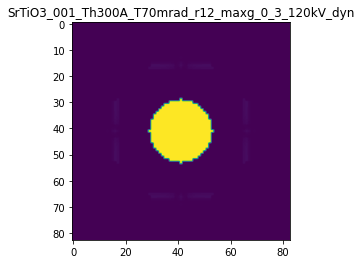

R-factor: 1.0839142704615673e-06

>>> producing the 42. dataset...

The offset applied on thickness: 0.0003058868582938188

The offset applied on Ug: 0.21922760106469497

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3058868582938
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

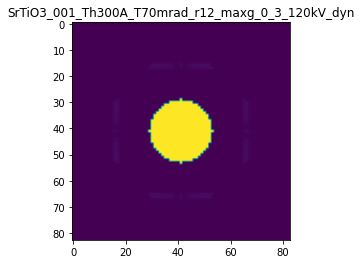

R-factor: 1.3073211467247877e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.000939490812227201

The offset applied on Ug: -0.25541823463381436

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06050918777277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

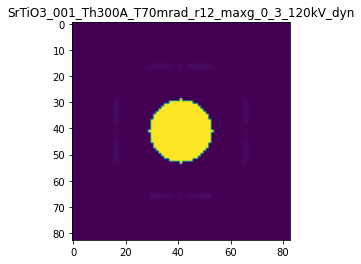

R-factor: 1.8502014851490476e-06

>>> producing the 44. dataset...

The offset applied on thickness: -0.00026582774154930335

The offset applied on Ug: 0.3009696707152638

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.73417225845066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

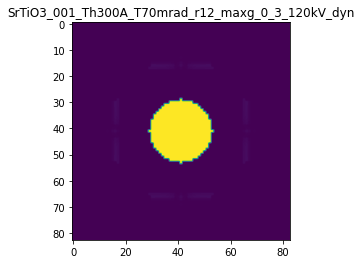

R-factor: 2.0171984663887717e-06

>>> producing the 45. dataset...

The offset applied on thickness: -0.0006912419749097041

The offset applied on Ug: 0.09288874916139335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3087580250903
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

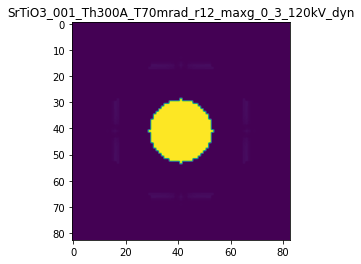

R-factor: 1.172445971133139e-06

>>> producing the 46. dataset...

The offset applied on thickness: 0.0003515422872208409

The offset applied on Ug: 0.07934733769951918

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3515422872208
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

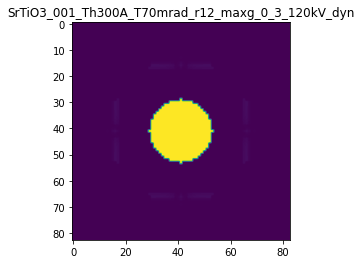

R-factor: 6.183438216530528e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0006770775323715703

The offset applied on Ug: 0.10901113226867239

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6770775323715
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

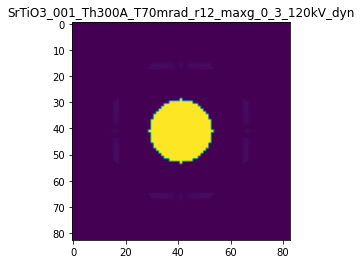

R-factor: 1.0416745586613944e-06

>>> producing the 48. dataset...

The offset applied on thickness: 0.0001774141733526049

The offset applied on Ug: 0.014404904987418945

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1774141733526
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

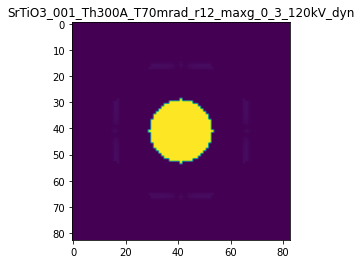

R-factor: 2.4433592818281187e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.0006848095690087898

The offset applied on Ug: 0.13283928534906395

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6848095690088
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

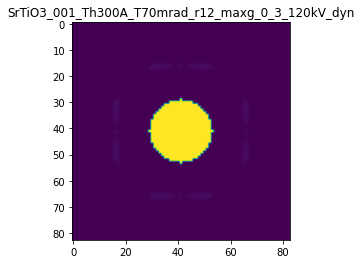

R-factor: 1.1183791667249594e-06

>>> producing the 50. dataset...

The offset applied on thickness: 4.031491815000399e-06

The offset applied on Ug: 0.18792028148252016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.004031491815
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

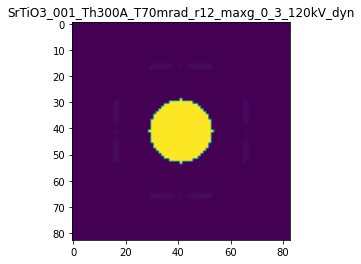

R-factor: 1.155044695179368e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.0008482831001425304

The offset applied on Ug: 0.05840102385232207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8482831001425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

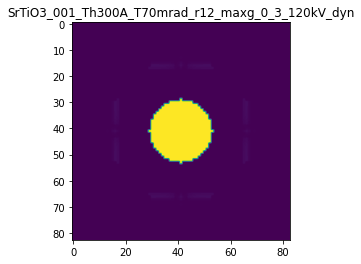

R-factor: 1.1509699012740938e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.0006128312084678791

The offset applied on Ug: 0.2712437394500457

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61283120846787
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

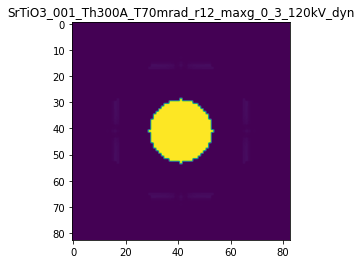

R-factor: 1.7154919135358128e-06

>>> producing the 53. dataset...

The offset applied on thickness: 0.00012014969922386265

The offset applied on Ug: 0.27913577568745057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1201496992239
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

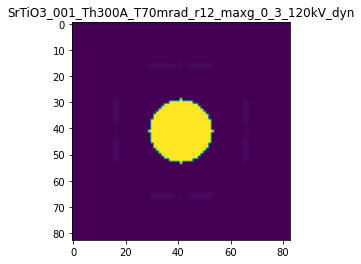

R-factor: 1.6673409276144055e-06

>>> producing the 54. dataset...

The offset applied on thickness: 0.0008715846867976352

The offset applied on Ug: -0.20591649913908697

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87158468679763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

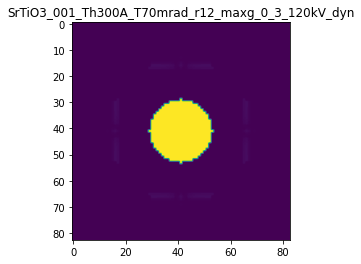

R-factor: 1.954118101920796e-06

>>> producing the 55. dataset...

The offset applied on thickness: 0.000636409082498828

The offset applied on Ug: 0.06725067618753507

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.63640908249886
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

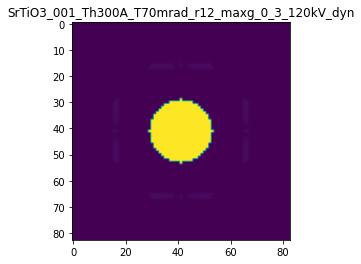

R-factor: 9.042526659251168e-07

>>> producing the 56. dataset...

The offset applied on thickness: 8.182664548700269e-05

The offset applied on Ug: -0.06418988327906447

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.081826645487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

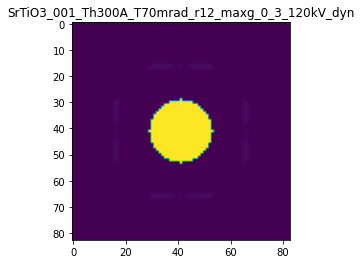

R-factor: 4.4657936078243157e-07

>>> producing the 57. dataset...

The offset applied on thickness: -0.00039232483327527

The offset applied on Ug: -0.3100213499796607

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.60767516672473
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

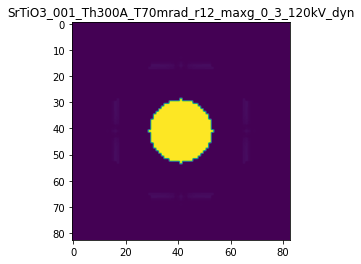

R-factor: 1.8413241854942537e-06

>>> producing the 58. dataset...

The offset applied on thickness: 0.0005903040951574645

The offset applied on Ug: -0.2273663461908753

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5903040951575
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

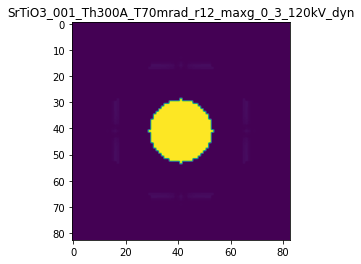

R-factor: 1.8235420466831518e-06

>>> producing the 59. dataset...

The offset applied on thickness: 0.0009385612458756925

The offset applied on Ug: 0.018995647671940574

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9385612458757
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

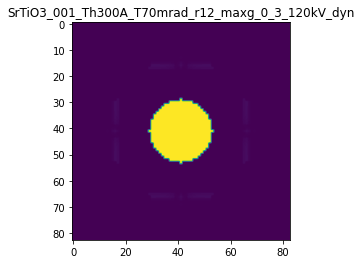

R-factor: 1.2054194859162944e-06

>>> producing the 60. dataset...

The offset applied on thickness: -6.005354042811484e-05

The offset applied on Ug: 0.18346117998129566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9399464595719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

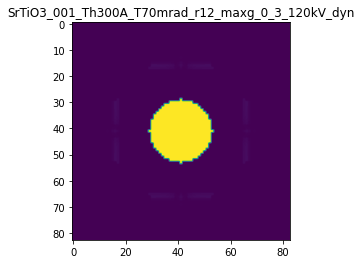

R-factor: 1.1631640299817997e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.00027656540418058765

The offset applied on Ug: -0.04811087951359596

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2765654041806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

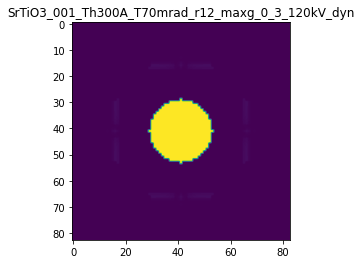

R-factor: 5.264210055813946e-07

>>> producing the 62. dataset...

The offset applied on thickness: 0.00044738730857663

The offset applied on Ug: 0.28283384494971353

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4473873085766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

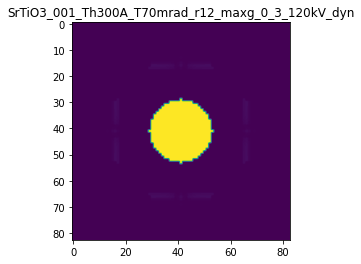

R-factor: 1.7045676471211291e-06

>>> producing the 63. dataset...

The offset applied on thickness: -0.000341961843855785

The offset applied on Ug: 0.1391194822033914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65803815614424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

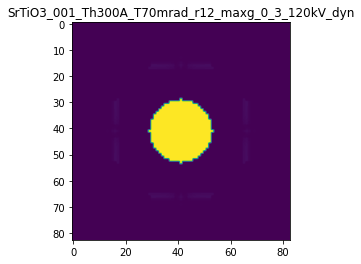

R-factor: 1.0996353179001662e-06

>>> producing the 64. dataset...

The offset applied on thickness: -0.0009940563008830096

The offset applied on Ug: -0.24459904875685218

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.005943699117
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

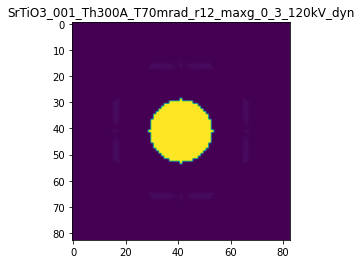

R-factor: 1.8369441621874728e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0001823023072750334

The offset applied on Ug: 0.031763984831206925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.182302307275
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

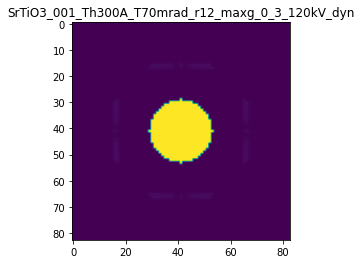

R-factor: 2.87190413582173e-07

>>> producing the 66. dataset...

The offset applied on thickness: -0.00011921745300965303

The offset applied on Ug: -0.24877627745804418

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88078254699036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

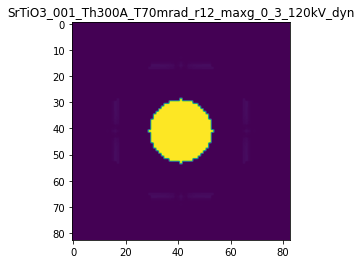

R-factor: 1.476916842788616e-06

>>> producing the 67. dataset...

The offset applied on thickness: 0.0003926270698771577

The offset applied on Ug: 0.2795023334463804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3926270698771
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

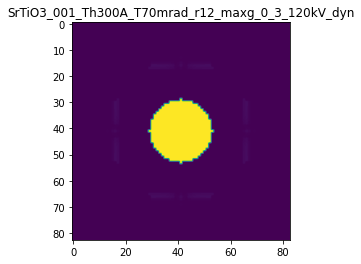

R-factor: 1.6669917694708501e-06

>>> producing the 68. dataset...

The offset applied on thickness: 0.00058626300481216

The offset applied on Ug: 0.1473205616244038

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58626300481217
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

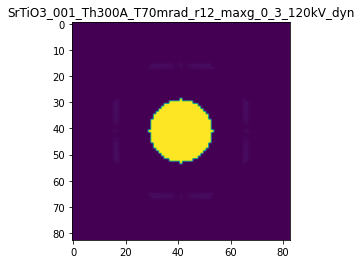

R-factor: 1.0970876204489216e-06

>>> producing the 69. dataset...

The offset applied on thickness: 0.0004352286997245161

The offset applied on Ug: 0.23100771680451146

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4352286997245
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

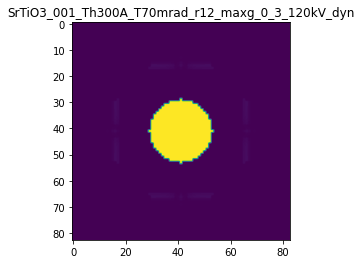

R-factor: 1.419658413189347e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.0005154083455843678

The offset applied on Ug: 0.06988084851573063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4845916544156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

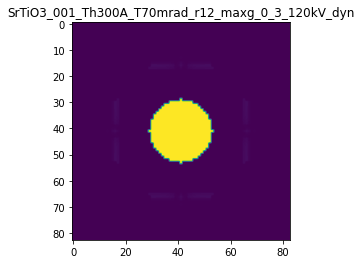

R-factor: 8.775499964553523e-07

>>> producing the 71. dataset...

The offset applied on thickness: 1.9090054903747156e-05

The offset applied on Ug: -0.011257770328103192

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.01909005490376
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

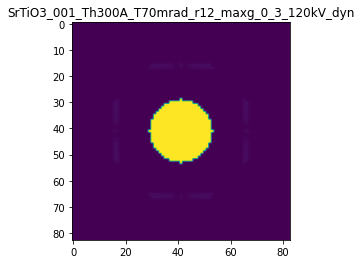

R-factor: 8.19067366452456e-08

>>> producing the 72. dataset...

The offset applied on thickness: 0.0003041642144928123

The offset applied on Ug: 0.27098232731967836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3041642144928
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

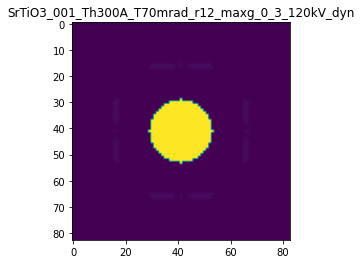

R-factor: 1.6019428312177723e-06

>>> producing the 73. dataset...

The offset applied on thickness: 0.0009415829898380463

The offset applied on Ug: -0.2867628997675589

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.941582989838
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

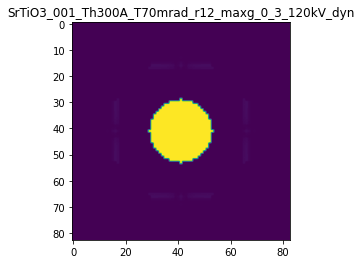

R-factor: 2.4735123916031415e-06

>>> producing the 74. dataset...

The offset applied on thickness: -0.0005843467017325989

The offset applied on Ug: 0.30658743086261747

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4156532982674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

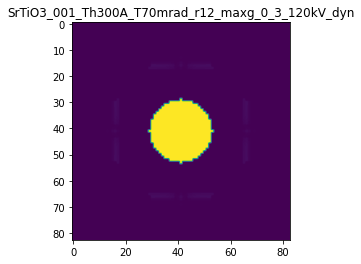

R-factor: 2.283277734805731e-06

>>> producing the 75. dataset...

The offset applied on thickness: -0.0009589955374244425

The offset applied on Ug: -0.17741816863472556

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04100446257553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

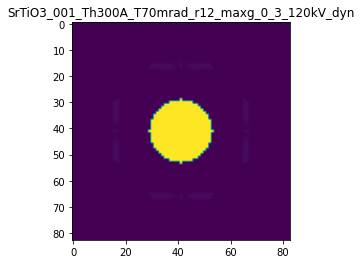

R-factor: 1.5418928134436664e-06

>>> producing the 76. dataset...

The offset applied on thickness: 0.0001934471761037069

The offset applied on Ug: 0.19640234016469799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1934471761037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

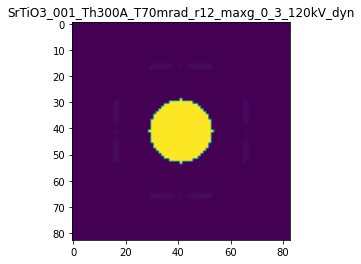

R-factor: 1.1605302128102597e-06

>>> producing the 77. dataset...

The offset applied on thickness: 0.0005848579191719976

The offset applied on Ug: 0.05779973713064294

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.584857919172
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

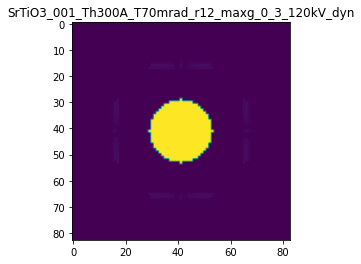

R-factor: 8.238016048142045e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.0006249925187843246

The offset applied on Ug: 0.14120562893063857

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6249925187843
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

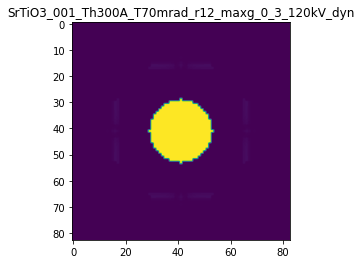

R-factor: 1.1001151775189567e-06

>>> producing the 79. dataset...

The offset applied on thickness: 0.000118336654868062

The offset applied on Ug: 0.08660492923199911

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.118336654868
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

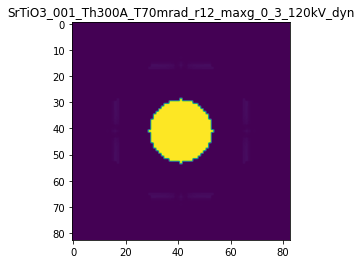

R-factor: 5.160786508673223e-07

>>> producing the 80. dataset...

The offset applied on thickness: -0.0008061655970352587

The offset applied on Ug: 0.16184554367812518

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1938344029647
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

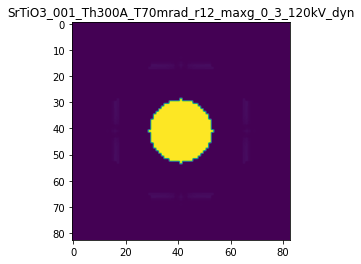

R-factor: 1.6476276690473693e-06

>>> producing the 81. dataset...

The offset applied on thickness: -0.0006430140183786129

The offset applied on Ug: -0.12108940830797892

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35698598162134
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

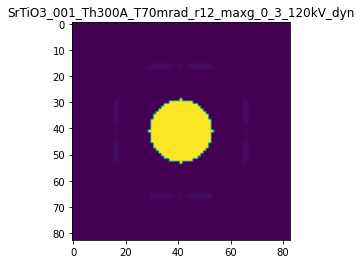

R-factor: 1.039953503595332e-06

>>> producing the 82. dataset...

The offset applied on thickness: 0.0005567736060939568

The offset applied on Ug: 0.1482732087341735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55677360609394
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

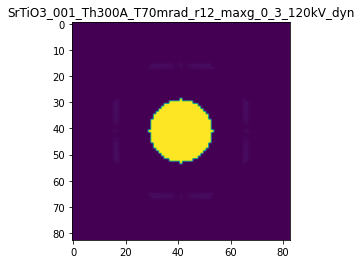

R-factor: 1.0810611497090586e-06

>>> producing the 83. dataset...

The offset applied on thickness: -7.377626967626405e-05

The offset applied on Ug: 0.12331905876973544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9262237303237
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

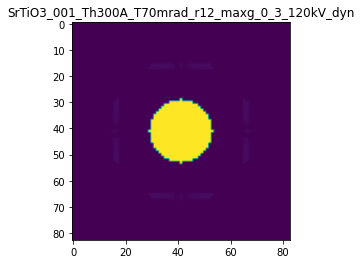

R-factor: 8.022773847594805e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.000955360581061554

The offset applied on Ug: -0.039494843805101494

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95536058106154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

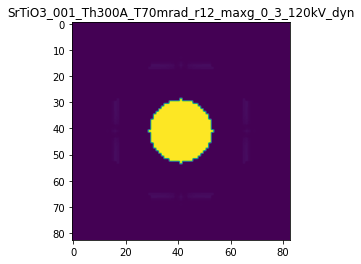

R-factor: 1.2600995967584266e-06

>>> producing the 85. dataset...

The offset applied on thickness: 0.000979856929769518

The offset applied on Ug: 0.012969475013886723

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97985692976954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

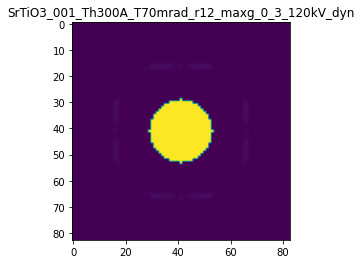

R-factor: 1.2491548218549423e-06

>>> producing the 86. dataset...

The offset applied on thickness: 0.0007833165205250916

The offset applied on Ug: -0.10528501862274232

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7833165205251
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

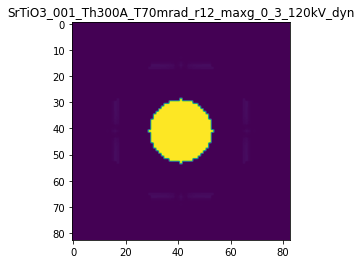

R-factor: 1.3323914983029003e-06

>>> producing the 87. dataset...

The offset applied on thickness: -0.0008607594402458709

The offset applied on Ug: 0.22688304941415957

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1392405597541
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

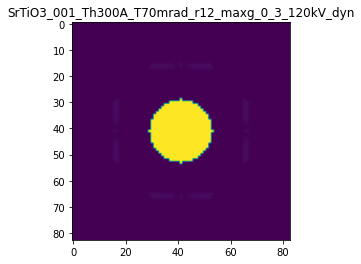

R-factor: 2.058366956417589e-06

>>> producing the 88. dataset...

The offset applied on thickness: 0.0005120424530456971

The offset applied on Ug: -0.3026673191669188

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5120424530457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

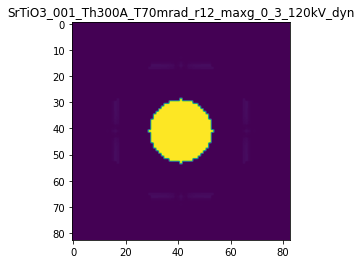

R-factor: 2.1975212388595274e-06

>>> producing the 89. dataset...

The offset applied on thickness: 0.00015894864100175798

The offset applied on Ug: -0.14904723924036042

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15894864100176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

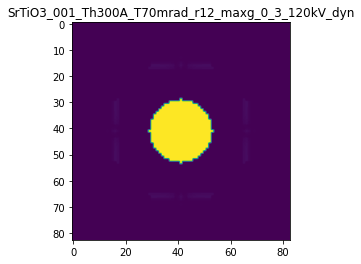

R-factor: 1.0141547577896573e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0006426905193395218

The offset applied on Ug: -0.11075297403613946

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3573094806605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

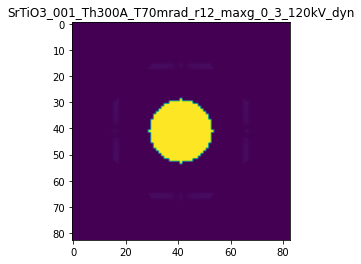

R-factor: 1.0099609566575636e-06

>>> producing the 91. dataset...

The offset applied on thickness: 0.0007741717764407223

The offset applied on Ug: -0.27579949630532324

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7741717764407
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

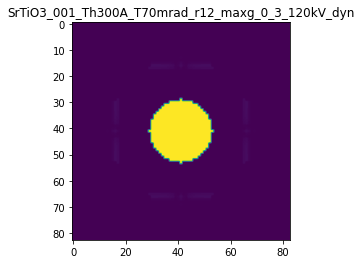

R-factor: 2.261815336549334e-06

>>> producing the 92. dataset...

The offset applied on thickness: 9.593846754234092e-05

The offset applied on Ug: 0.15909895053008724

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.09593846754234
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

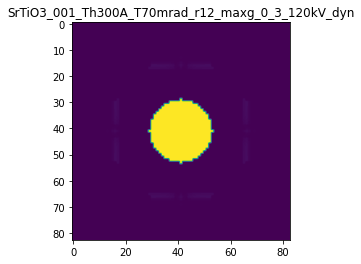

R-factor: 9.439832073030263e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.00030337874936535393

The offset applied on Ug: 0.05931825708600641

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6966212506346
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

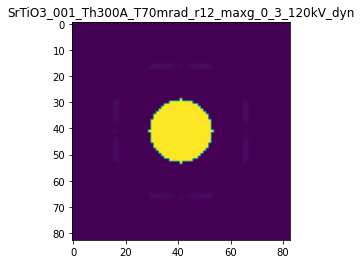

R-factor: 6.119569390977047e-07

>>> producing the 94. dataset...

The offset applied on thickness: 0.0006092506504400579

The offset applied on Ug: -0.024625488200242174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60925065044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

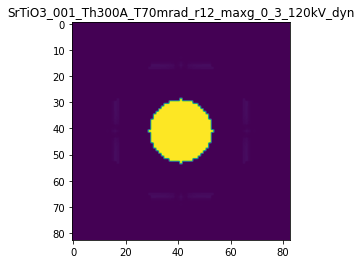

R-factor: 8.014098484730504e-07

>>> producing the 95. dataset...

The offset applied on thickness: 9.419453846698955e-06

The offset applied on Ug: -0.06437509287915169

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0094194538467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

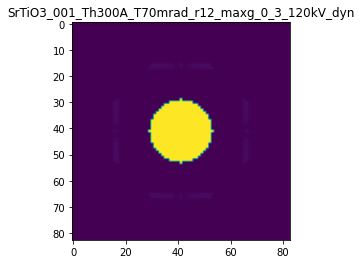

R-factor: 4.001660137944301e-07

>>> producing the 96. dataset...

The offset applied on thickness: -1.291629282427853e-05

The offset applied on Ug: -0.29944893421120533

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9870837071757
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

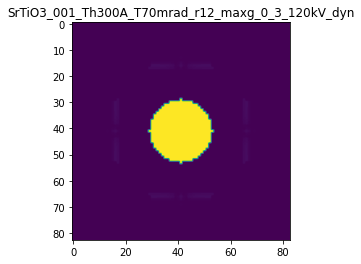

R-factor: 1.8230261541589739e-06

>>> producing the 97. dataset...

The offset applied on thickness: 0.00048390414697193143

The offset applied on Ug: 0.3052757595453464

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4839041469719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

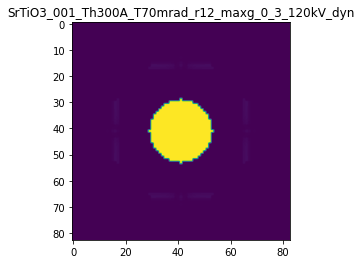

R-factor: 1.8398486658749577e-06

>>> producing the 98. dataset...

The offset applied on thickness: 0.0002591498625847648

The offset applied on Ug: 0.006894774897542462

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2591498625847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

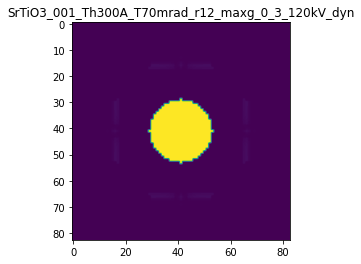

R-factor: 3.346969907623408e-07

>>> producing the 99. dataset...

The offset applied on thickness: -0.0002299567223043475

The offset applied on Ug: 0.07008808109097928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7700432776956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

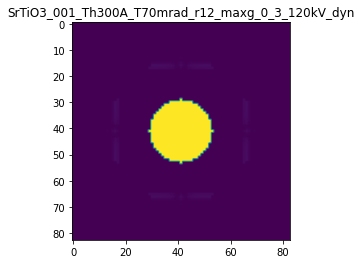

R-factor: 6.039535457530163e-07

>>> producing the 100. dataset...

The offset applied on thickness: 0.00045892872449280667

The offset applied on Ug: 0.27895052530859504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4589287244928
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

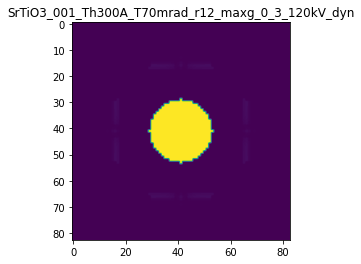

R-factor: 1.6878994436780295e-06

>>> producing the 101. dataset...

The offset applied on thickness: -0.0007175982427326897

The offset applied on Ug: -0.056211940707176354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2824017572673
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

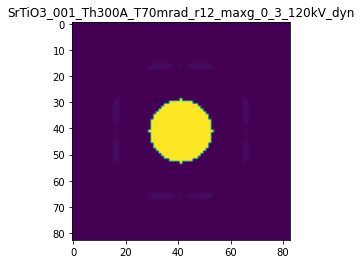

R-factor: 9.832155340129482e-07

>>> producing the 102. dataset...

The offset applied on thickness: -0.0004443525689052088

The offset applied on Ug: 0.0008389539908254306

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5556474310948
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

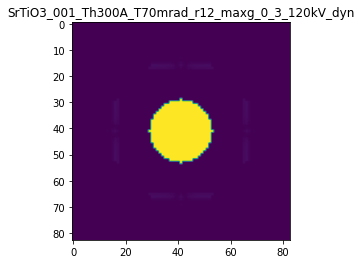

R-factor: 5.593760047091108e-07

>>> producing the 103. dataset...

The offset applied on thickness: -0.0008297987012741866

The offset applied on Ug: -0.13846020187297092

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1702012987258
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

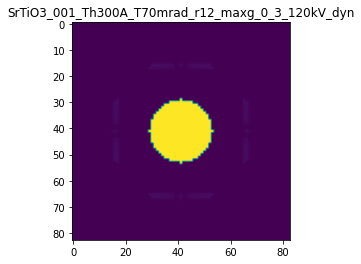

R-factor: 1.2915071351501946e-06

>>> producing the 104. dataset...

The offset applied on thickness: 0.0009272238153628348

The offset applied on Ug: -0.24259272964839285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9272238153628
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

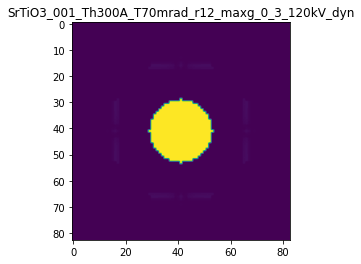

R-factor: 2.211100470727513e-06

>>> producing the 105. dataset...

The offset applied on thickness: -0.0006152388980315422

The offset applied on Ug: -0.31849074326224724

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3847611019684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

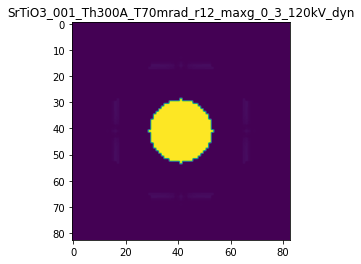

R-factor: 1.9688147780255805e-06

>>> producing the 106. dataset...

The offset applied on thickness: 7.788010029649329e-05

The offset applied on Ug: 0.12766855777988184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07788010029645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

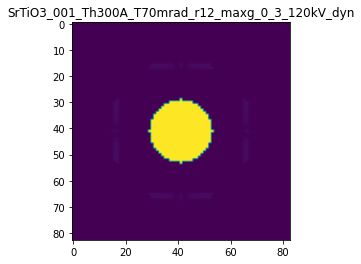

R-factor: 7.572128925274749e-07

>>> producing the 107. dataset...

The offset applied on thickness: 0.000996144217368668

The offset applied on Ug: 0.14822973717601223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9961442173686
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

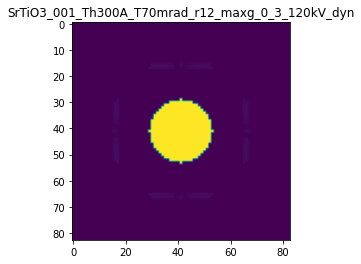

R-factor: 1.4997070191337388e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.0007931354845901451

The offset applied on Ug: 0.02428746642817565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79313548459015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

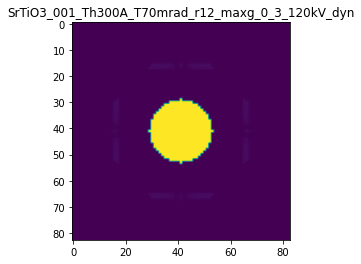

R-factor: 1.0296998211952218e-06

>>> producing the 109. dataset...

The offset applied on thickness: 0.0007335526393813196

The offset applied on Ug: -0.005456201641135365

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7335526393813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

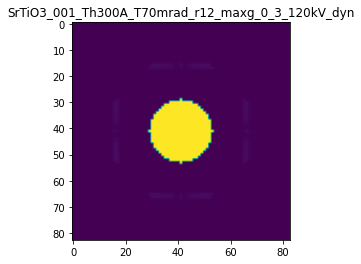

R-factor: 9.265193677748431e-07

>>> producing the 110. dataset...

The offset applied on thickness: -0.0008098984783148302

The offset applied on Ug: 0.14450654012731767

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19010152168516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

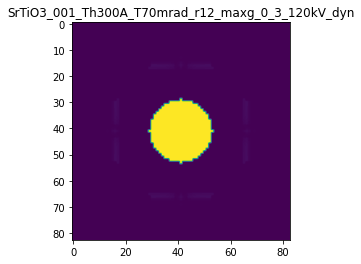

R-factor: 1.5581829771894918e-06

>>> producing the 111. dataset...

The offset applied on thickness: -0.0009076107524853214

The offset applied on Ug: 0.2512520360587417

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0923892475147
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

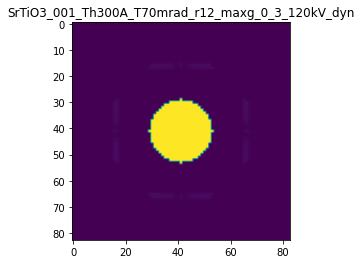

R-factor: 2.238273545830878e-06

>>> producing the 112. dataset...

The offset applied on thickness: -0.0006572207264407697

The offset applied on Ug: 0.31410706218340884

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34277927355924
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

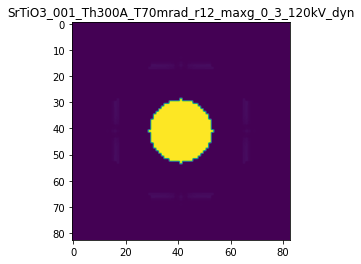

R-factor: 2.3872064185888852e-06

>>> producing the 113. dataset...

The offset applied on thickness: 0.0002634296141008421

The offset applied on Ug: -0.16919807759877445

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26342961410086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

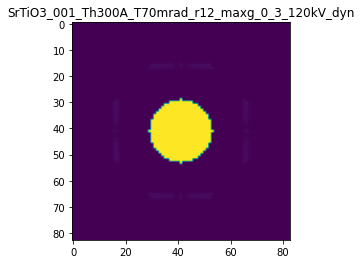

R-factor: 1.2117535000236154e-06

>>> producing the 114. dataset...

The offset applied on thickness: 0.00042508202737755576

The offset applied on Ug: 0.20609555583903288

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4250820273775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

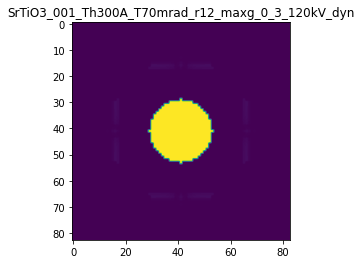

R-factor: 1.282350489152327e-06

>>> producing the 115. dataset...

The offset applied on thickness: 0.0006584810486468671

The offset applied on Ug: -0.13596795515166107

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6584810486468
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

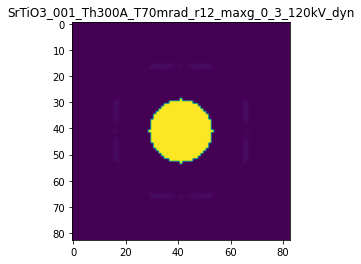

R-factor: 1.368849914164242e-06

>>> producing the 116. dataset...

The offset applied on thickness: 0.0009274838732722182

The offset applied on Ug: 0.15440798477655804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.92748387327225
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

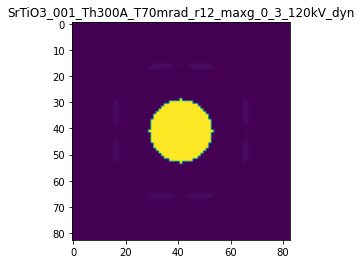

R-factor: 1.4403773209216823e-06

>>> producing the 117. dataset...

The offset applied on thickness: 0.0002955830934651915

The offset applied on Ug: 0.12306602231539017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29558309346515
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

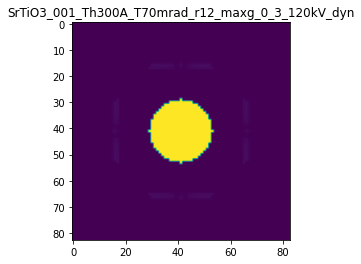

R-factor: 7.894188311452144e-07

>>> producing the 118. dataset...

The offset applied on thickness: -0.0004042678000828326

The offset applied on Ug: -0.12380040272582

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59573219991717
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

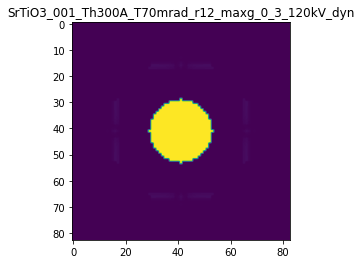

R-factor: 8.628473040447616e-07

>>> producing the 119. dataset...

The offset applied on thickness: 0.0001999423384096708

The offset applied on Ug: 0.25991616667850687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1999423384097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

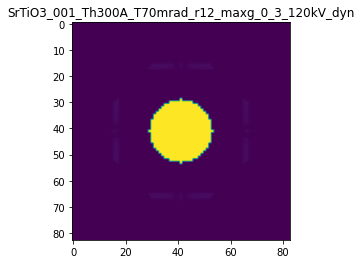

R-factor: 1.5383446323242877e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.0009342441178925949

The offset applied on Ug: -0.3183460090360616

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0657558821074
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

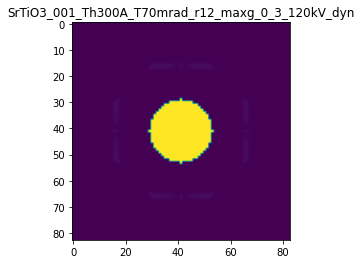

R-factor: 2.1521791667000883e-06

>>> producing the 121. dataset...

The offset applied on thickness: -4.8257294704277646e-05

The offset applied on Ug: -0.17947040163791592

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9517427052957
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

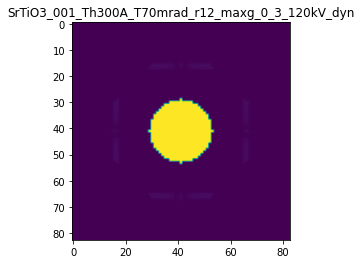

R-factor: 1.0760528893120142e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.00034626822493226194

The offset applied on Ug: 0.15951295777815375

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6537317750677
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

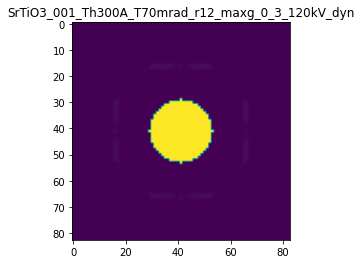

R-factor: 1.2225141961933598e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.0007812969348570156

The offset applied on Ug: -0.250240038858256

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.781296934857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

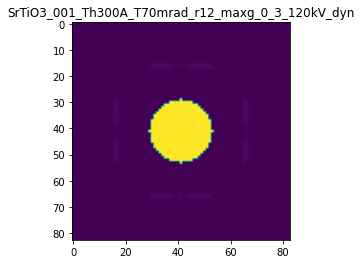

R-factor: 2.122003604964285e-06

>>> producing the 124. dataset...

The offset applied on thickness: -0.0006687781899091911

The offset applied on Ug: -0.11181714126865522

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3312218100908
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

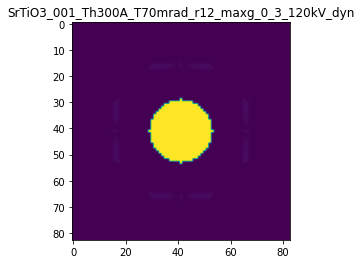

R-factor: 1.0413783990155943e-06

>>> producing the 125. dataset...

The offset applied on thickness: 0.0004708086442803314

The offset applied on Ug: 0.12148474894410115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47080864428034
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

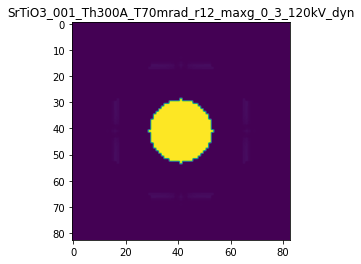

R-factor: 8.957233878084621e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.00044659465662652

The offset applied on Ug: 0.22928049294733718

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.55340534337347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

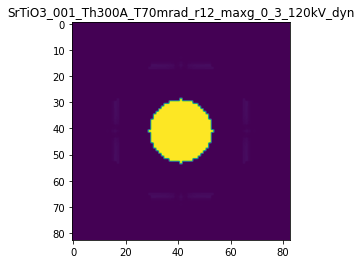

R-factor: 1.7151222927772623e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.00045865619723998763

The offset applied on Ug: -0.14112040070383258

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.45865619724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

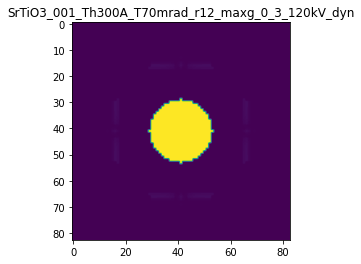

R-factor: 1.2127336371531076e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.00018598864683826854

The offset applied on Ug: 0.17889175820166806

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.18598864683827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

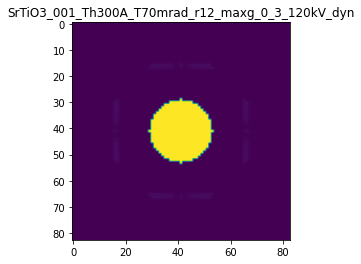

R-factor: 1.0570558727965528e-06

>>> producing the 129. dataset...

The offset applied on thickness: 0.0007957172721663506

The offset applied on Ug: 0.04950440616600091

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79571727216637
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

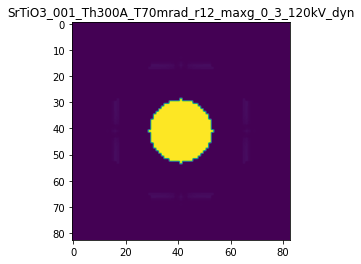

R-factor: 1.070422344251932e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.0002476154388381875

The offset applied on Ug: 0.28394236460447586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2476154388382
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

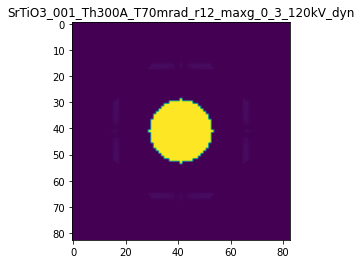

R-factor: 1.6794516715651839e-06

>>> producing the 131. dataset...

The offset applied on thickness: -0.0003106997298752845

The offset applied on Ug: -0.1608602560698504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6893002701247
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

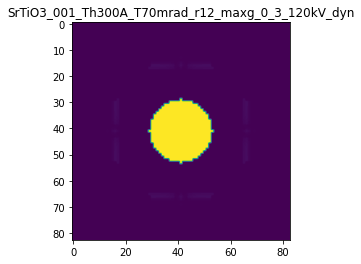

R-factor: 9.934769519107963e-07

>>> producing the 132. dataset...

The offset applied on thickness: -0.00047716336806283955

The offset applied on Ug: -0.14396258161973705

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52283663193714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

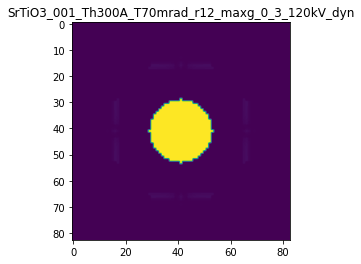

R-factor: 1.0081215836887979e-06

>>> producing the 133. dataset...

The offset applied on thickness: 7.556431533841046e-05

The offset applied on Ug: -0.0726569919531245

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0755643153384
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

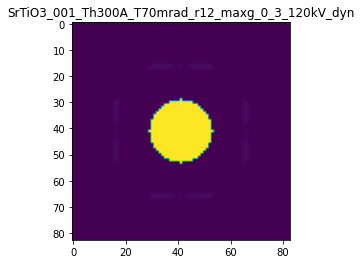

R-factor: 4.933584108756658e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.00014128925001741433

The offset applied on Ug: -0.02511765312406162

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14128925001745
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

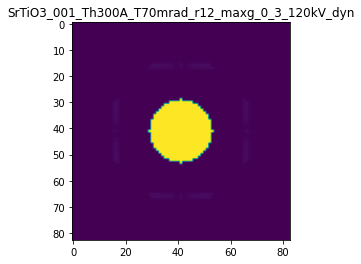

R-factor: 2.717498433187919e-07

>>> producing the 135. dataset...

The offset applied on thickness: -5.219478731104288e-05

The offset applied on Ug: -0.2853872845914336

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94780521268893
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

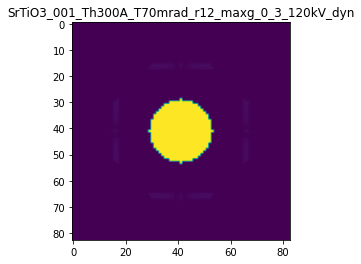

R-factor: 1.7179223367751199e-06

>>> producing the 136. dataset...

The offset applied on thickness: -0.00035563777048624545

The offset applied on Ug: -0.09089916330139744

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6443622295137
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

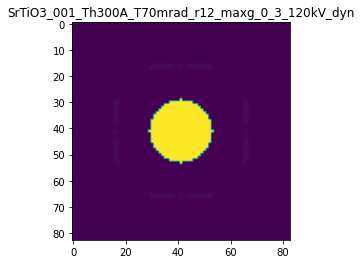

R-factor: 6.725861781083197e-07

>>> producing the 137. dataset...

The offset applied on thickness: -0.0007674108868429912

The offset applied on Ug: 0.03428783449729103

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23258911315696
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

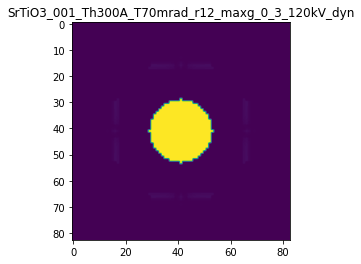

R-factor: 1.0163120641326956e-06

>>> producing the 138. dataset...

The offset applied on thickness: -9.234809287962298e-05

The offset applied on Ug: -0.15282152991615647

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9076519071204
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

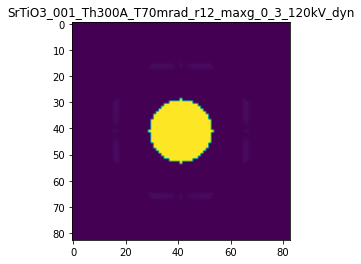

R-factor: 9.047198412330634e-07

>>> producing the 139. dataset...

The offset applied on thickness: -0.0001420778055822418

The offset applied on Ug: -0.06282921547678334

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85792219441777
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

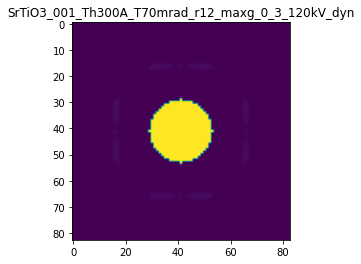

R-factor: 3.984901487026234e-07

>>> producing the 140. dataset...

The offset applied on thickness: 0.0007567804937046219

The offset applied on Ug: -0.12216862033094664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75678049370464
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

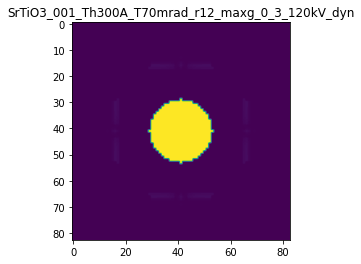

R-factor: 1.3917310502472393e-06



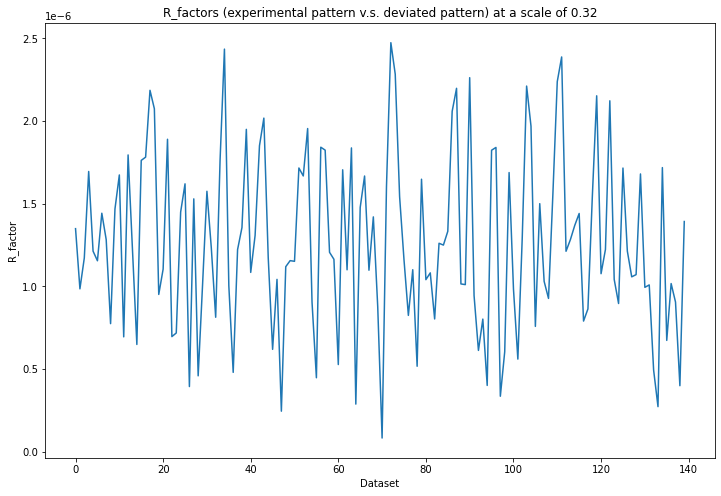

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 392ms/step - loss: 0.1952 - acc: 0.0000e+00 - val_loss: 0.1308 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 239ms/step - loss: 0.1088 - acc: 0.0000e+00 - val_loss: 0.0738 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 248ms/step - loss: 0.0571 - acc: 0.0000e+00 - val_loss: 0.0395 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 228ms/step - loss: 0.0301 - acc: 0.0000e+00 - val_loss: 0.0193 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 221ms/step - loss: 0.0147 - acc: 0.0000e+00 - val_loss: 0.0087 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 228ms/step - loss: 0.0060 - acc: 0.8000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 227ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

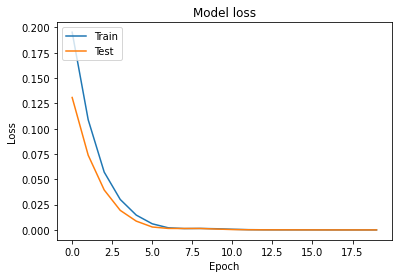

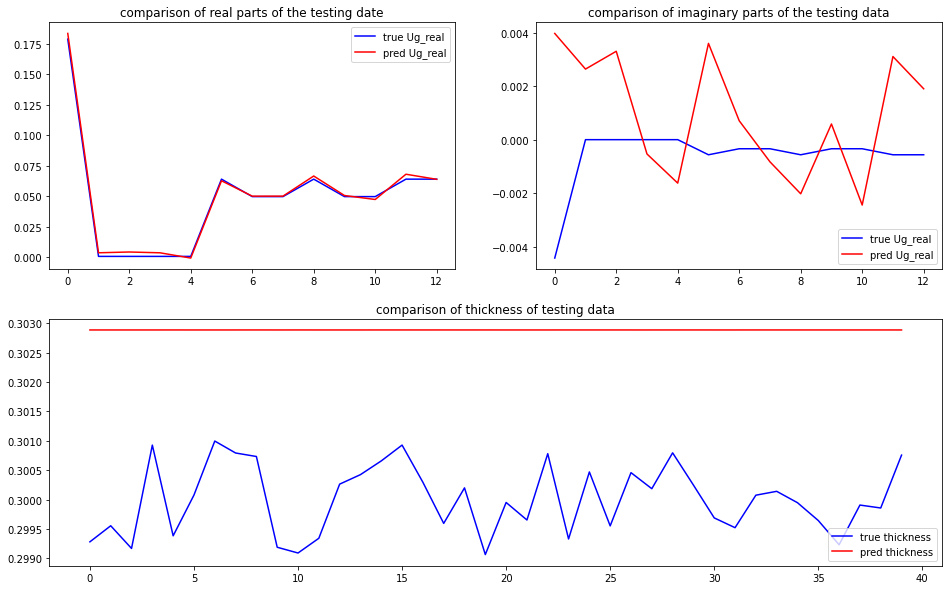

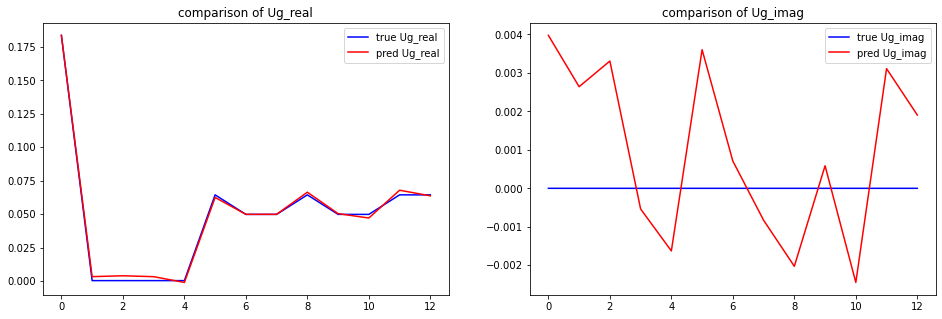

predicted thickness: 30.288541316986084 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=302.88541316986084
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18356249+0.j         0.0037

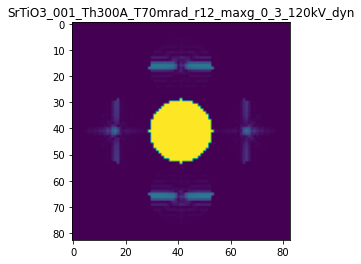

X_sim.max(): 0.9999427447659495
R-factor at a scale of 0.32 is 0.007744557248571544.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.64

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.0003497288198781938

The offset applied on Ug: -0.18561657283767077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
t

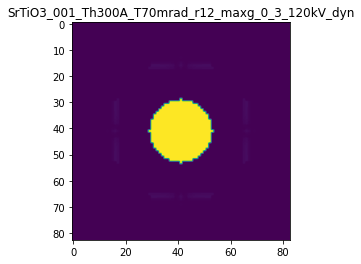

R-factor: 1.377095395016086e-06

>>> producing the 2. dataset...

The offset applied on thickness: -0.0008945306249689229

The offset applied on Ug: -0.026203028131139804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1054693750311
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

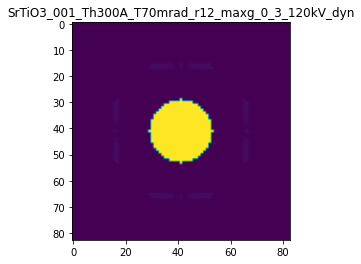

R-factor: 1.155753608850213e-06

>>> producing the 3. dataset...

The offset applied on thickness: -0.0009144129719337921

The offset applied on Ug: 0.17833316294218463

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0855870280662
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

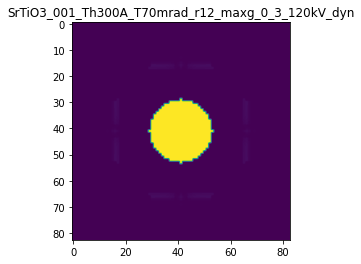

R-factor: 1.8404227347944748e-06

>>> producing the 4. dataset...

The offset applied on thickness: 5.5857830412433306e-05

The offset applied on Ug: -0.059619264489323885

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05585783041244
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

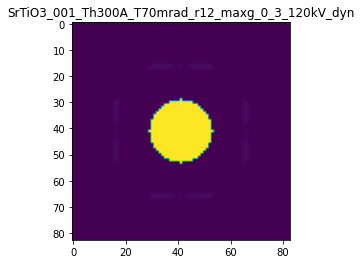

R-factor: 4.0062189065977437e-07

>>> producing the 5. dataset...

The offset applied on thickness: 0.0009695542397410244

The offset applied on Ug: -0.1963368120621125

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96955423974106
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

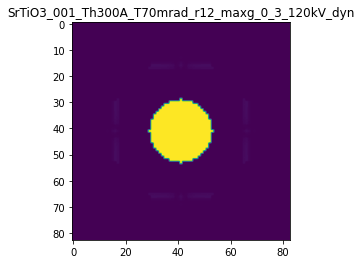

R-factor: 1.995585831415915e-06

>>> producing the 6. dataset...

The offset applied on thickness: -0.0004602804703983061

The offset applied on Ug: 0.11842329921316377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53971952960165
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

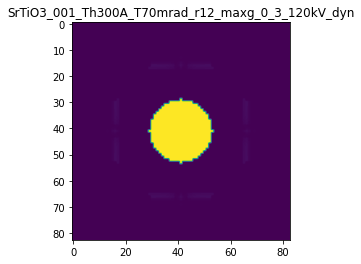

R-factor: 1.084804812888169e-06

>>> producing the 7. dataset...

The offset applied on thickness: -0.00044148470904004425

The offset applied on Ug: -0.33150887417069214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.55851529096
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

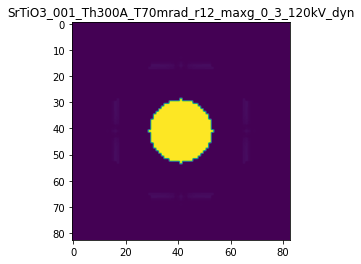

R-factor: 1.976088254303963e-06

>>> producing the 8. dataset...

The offset applied on thickness: -0.0007748291701118531

The offset applied on Ug: -0.6041097981605914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22517082988816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

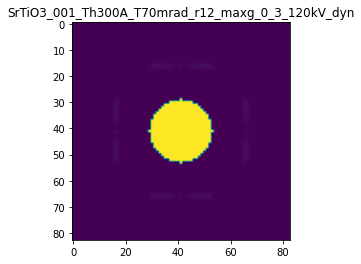

R-factor: 3.594791287405373e-06

>>> producing the 9. dataset...

The offset applied on thickness: -5.4670549640835955e-05

The offset applied on Ug: 0.491127481278607

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94532945035917
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

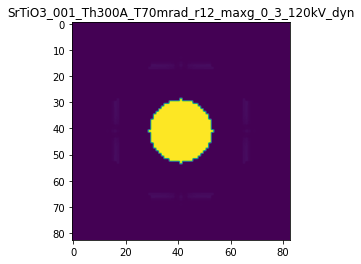

R-factor: 3.0652530166396754e-06

>>> producing the 10. dataset...

The offset applied on thickness: -0.0006788669314694825

The offset applied on Ug: -0.456113509454845

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3211330685305
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

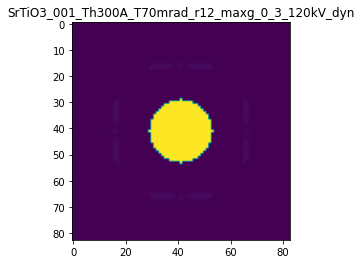

R-factor: 2.744965653299347e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.000716958146797338

The offset applied on Ug: 0.13968682299481544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7169581467973
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

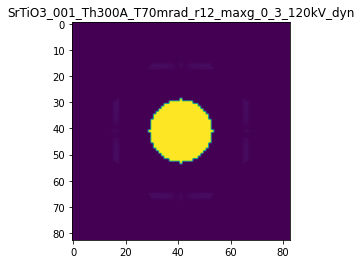

R-factor: 1.1730684983258478e-06

>>> producing the 12. dataset...

The offset applied on thickness: -0.000948384318866172

The offset applied on Ug: 0.3362054946757009

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0516156811338
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

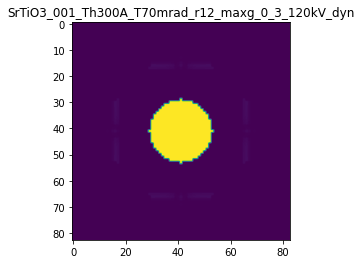

R-factor: 2.7595161562811694e-06

>>> producing the 13. dataset...

The offset applied on thickness: 0.00039634328390298593

The offset applied on Ug: -0.0826448746328876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.396343283903
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

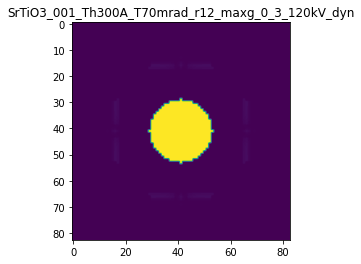

R-factor: 8.279576447378766e-07

>>> producing the 14. dataset...

The offset applied on thickness: -0.00010110275456129681

The offset applied on Ug: 0.2897063432943175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.89889724543866
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

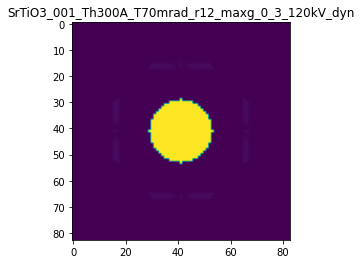

R-factor: 1.8426592095490625e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.0001195075794972469

The offset applied on Ug: -0.026943861488183674

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1195075794972
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

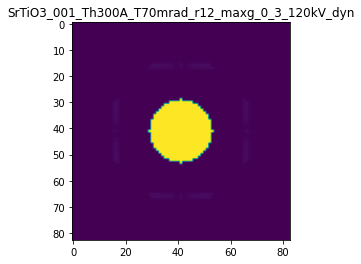

R-factor: 2.605762684333345e-07

>>> producing the 16. dataset...

The offset applied on thickness: 0.000446758512367853

The offset applied on Ug: -0.21040267365436394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44675851236786
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

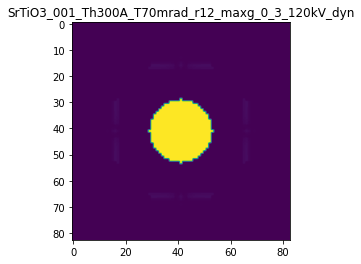

R-factor: 1.6029741131283259e-06

>>> producing the 17. dataset...

The offset applied on thickness: 0.0005796057842717349

The offset applied on Ug: -0.43267382668241994

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57960578427173
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

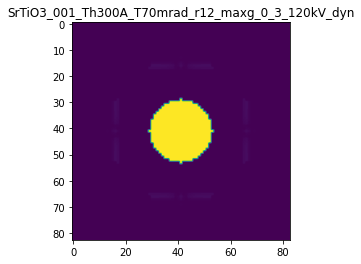

R-factor: 3.0220770863807806e-06

>>> producing the 18. dataset...

The offset applied on thickness: -0.0003073297631276306

The offset applied on Ug: -0.24106880711545386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69267023687235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

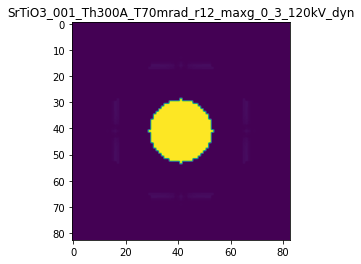

R-factor: 1.432290989735164e-06

>>> producing the 19. dataset...

The offset applied on thickness: -0.0003052638507527499

The offset applied on Ug: 0.6110497292327165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69473614924726
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

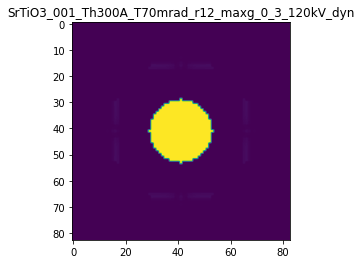

R-factor: 3.954036798991182e-06

>>> producing the 20. dataset...

The offset applied on thickness: -0.000561559668605627

The offset applied on Ug: 0.5246191805928523

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43844033139436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

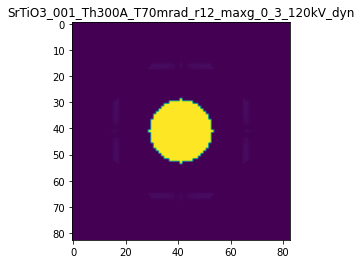

R-factor: 3.5874573334439173e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.00020058402546471488

The offset applied on Ug: -0.21056398565560927

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7994159745353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

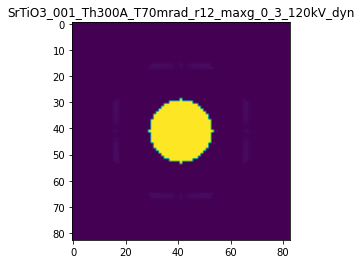

R-factor: 1.2418620687576612e-06

>>> producing the 22. dataset...

The offset applied on thickness: 0.0007573850126101825

The offset applied on Ug: 0.07601810631708104

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7573850126102
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

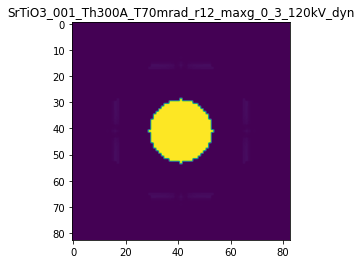

R-factor: 1.0689790868850016e-06

>>> producing the 23. dataset...

The offset applied on thickness: 0.00014405422356550312

The offset applied on Ug: 0.04017934732704575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1440542235655
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

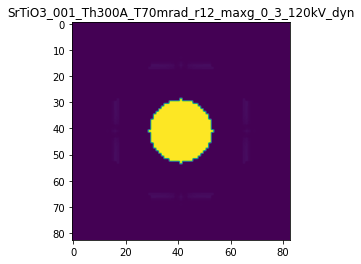

R-factor: 2.884777087566004e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0009394924872076574

The offset applied on Ug: -0.4152402513258058

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93949248720764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

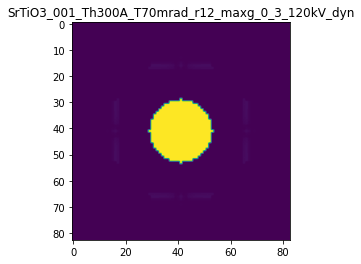

R-factor: 3.210612428991096e-06

>>> producing the 25. dataset...

The offset applied on thickness: -0.00045772577265386464

The offset applied on Ug: 0.6274991369805386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5422742273461
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

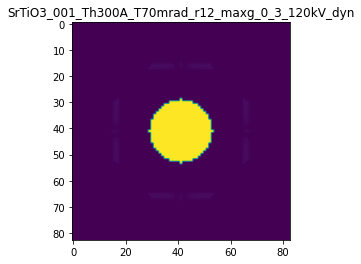

R-factor: 4.151695421617506e-06

>>> producing the 26. dataset...

The offset applied on thickness: 0.000724479663526616

The offset applied on Ug: 0.33748128146401796

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7244796635266
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

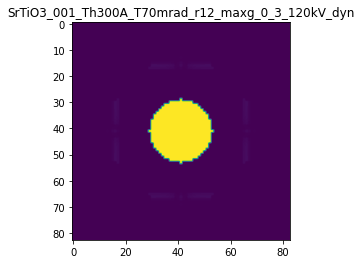

R-factor: 2.1122460370693465e-06

>>> producing the 27. dataset...

The offset applied on thickness: -0.00017933764379596595

The offset applied on Ug: -0.1391132329086156

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.820662356204
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

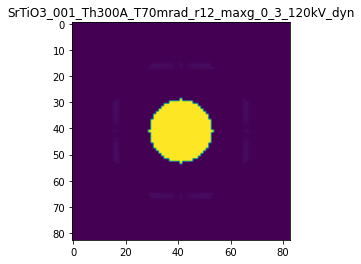

R-factor: 8.26917758806146e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.0008424312444400735

The offset applied on Ug: 0.4986400914394906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1575687555599
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

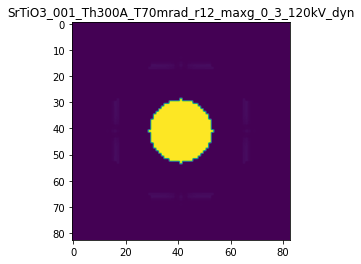

R-factor: 3.6311279421085453e-06

>>> producing the 29. dataset...

The offset applied on thickness: -0.0008450066207288702

The offset applied on Ug: -0.12011177695605767

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1549933792711
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

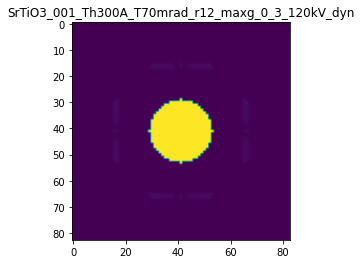

R-factor: 1.2610860104749724e-06

>>> producing the 30. dataset...

The offset applied on thickness: 0.0009029078918210704

The offset applied on Ug: 0.4153356428411253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9029078918211
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

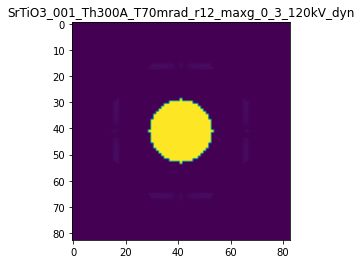

R-factor: 2.6036991207505173e-06

>>> producing the 31. dataset...

The offset applied on thickness: -0.0006451671574926765

The offset applied on Ug: 0.013727309729656696

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3548328425073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

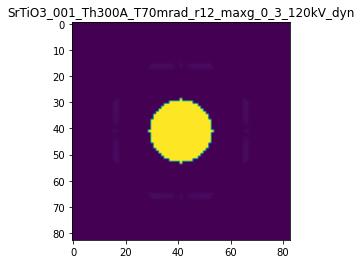

R-factor: 8.207893944215272e-07

>>> producing the 32. dataset...

The offset applied on thickness: -0.0003520185575836623

The offset applied on Ug: 0.1917629478655988

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6479814424163
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

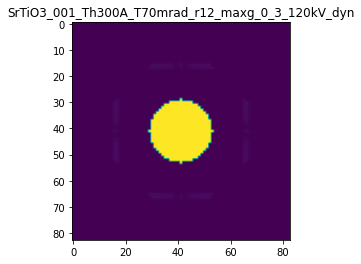

R-factor: 1.4170191665792446e-06

>>> producing the 33. dataset...

The offset applied on thickness: -8.034016785424569e-05

The offset applied on Ug: 0.3012749796644647

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9196598321457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

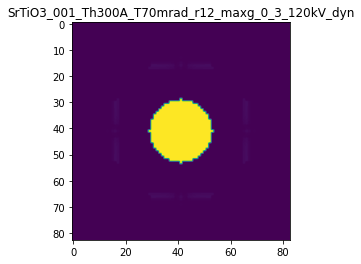

R-factor: 1.9020023886587855e-06

>>> producing the 34. dataset...

The offset applied on thickness: -0.00032309494109699456

The offset applied on Ug: -0.5048349489598151

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.676905058903
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

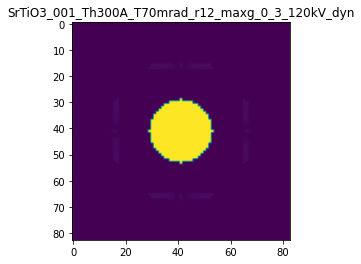

R-factor: 2.980108413416423e-06

>>> producing the 35. dataset...

The offset applied on thickness: -0.0007877279112789602

The offset applied on Ug: 0.4888607050675235

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.212272088721
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

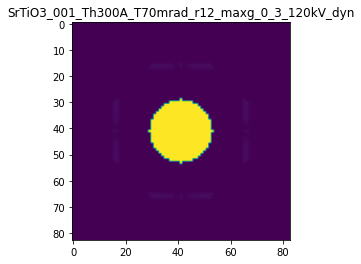

R-factor: 3.531034051546919e-06

>>> producing the 36. dataset...

The offset applied on thickness: -0.00012086172029423704

The offset applied on Ug: 0.0947600987344218

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8791382797057
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

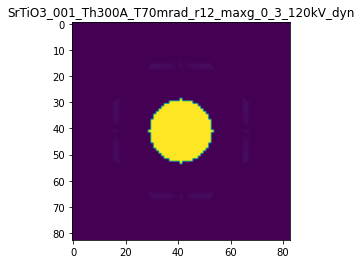

R-factor: 6.599656279461925e-07

>>> producing the 37. dataset...

The offset applied on thickness: -0.0006965495152398733

The offset applied on Ug: 0.057814741854848965

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3034504847601
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

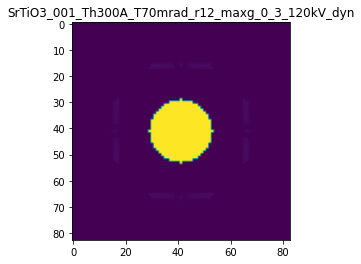

R-factor: 1.0220224377102004e-06

>>> producing the 38. dataset...

The offset applied on thickness: 0.00012785206647650905

The offset applied on Ug: -0.3087285488928946

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1278520664765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

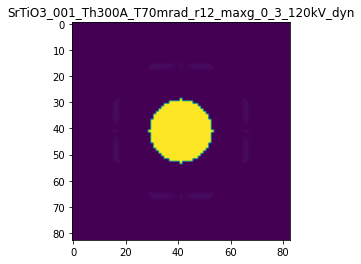

R-factor: 1.961824894749905e-06

>>> producing the 39. dataset...

The offset applied on thickness: -0.0009743356967994295

The offset applied on Ug: -0.46729591880424165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02566430320053
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

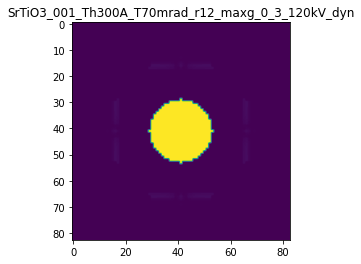

R-factor: 2.9267714074886955e-06

>>> producing the 40. dataset...

The offset applied on thickness: 0.0008431331721617265

The offset applied on Ug: -0.04224488286641801

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84313317216174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

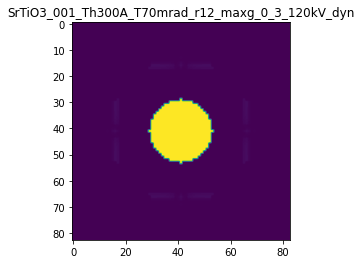

R-factor: 1.1338124341880109e-06

>>> producing the 41. dataset...

The offset applied on thickness: 0.0008703587230624956

The offset applied on Ug: -0.6131081694542978

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8703587230625
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

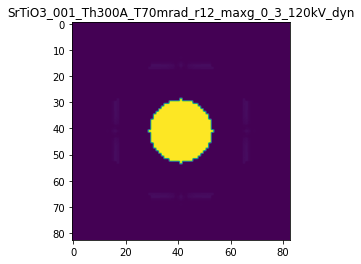

R-factor: 4.312350964595137e-06

>>> producing the 42. dataset...

The offset applied on thickness: 8.133342843780534e-05

The offset applied on Ug: 0.014585861684608403

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0813334284378
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

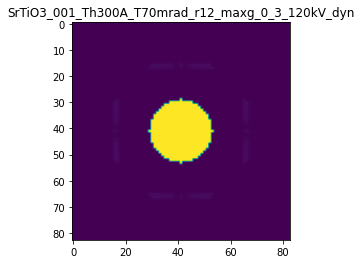

R-factor: 1.2930691945394135e-07

>>> producing the 43. dataset...

The offset applied on thickness: -0.0006959674564519549

The offset applied on Ug: -0.26765647823886823

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30403254354803
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

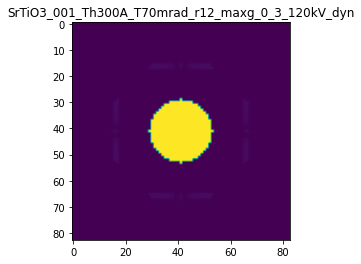

R-factor: 1.754701674258802e-06

>>> producing the 44. dataset...

The offset applied on thickness: -0.0006203606747332568

The offset applied on Ug: 0.3520598421953008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37963932526674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

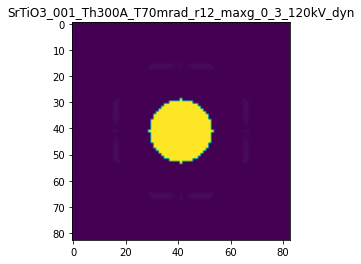

R-factor: 2.582380676686238e-06

>>> producing the 45. dataset...

The offset applied on thickness: -0.0006549693689819183

The offset applied on Ug: -0.17035287175998348

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34503063101806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

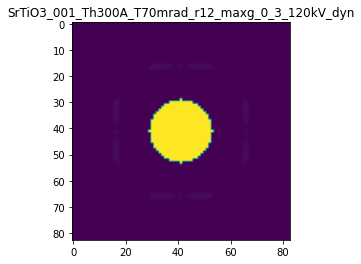

R-factor: 1.252792974036352e-06

>>> producing the 46. dataset...

The offset applied on thickness: 0.0008122156454073182

The offset applied on Ug: -0.5928033709364644

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8122156454073
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

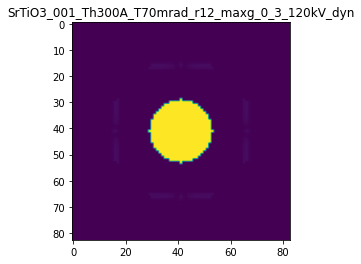

R-factor: 4.148164534270575e-06

>>> producing the 47. dataset...

The offset applied on thickness: 0.00011098248445083825

The offset applied on Ug: -0.60153414312528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.11098248445086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

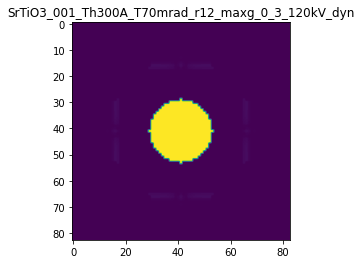

R-factor: 3.72043625087483e-06

>>> producing the 48. dataset...

The offset applied on thickness: -0.00035282433913095466

The offset applied on Ug: 0.34903721826895223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.64717566086904
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

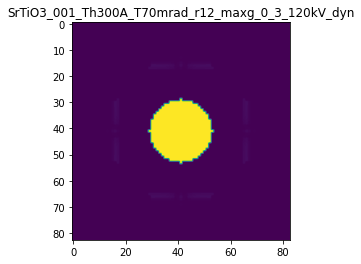

R-factor: 2.3702504987014163e-06

>>> producing the 49. dataset...

The offset applied on thickness: 0.0006218285196373448

The offset applied on Ug: -0.24716482924567246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6218285196373
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

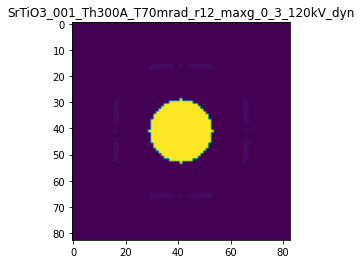

R-factor: 1.9652977821713843e-06

>>> producing the 50. dataset...

The offset applied on thickness: 0.000987982447114321

The offset applied on Ug: -0.6148089759627474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98798244711435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

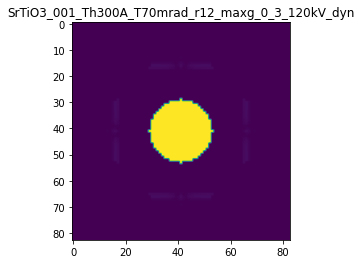

R-factor: 4.413273152921989e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.0006784567857832113

The offset applied on Ug: -0.1249715458376015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6784567857832
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

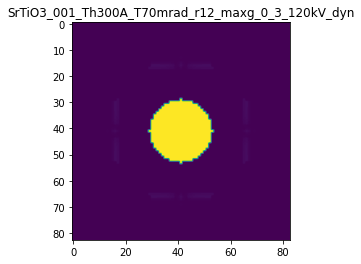

R-factor: 1.329291005290461e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.00044352442434826165

The offset applied on Ug: 0.5452383425410574

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44352442434825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

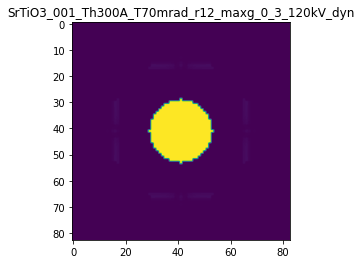

R-factor: 3.2281815638535737e-06

>>> producing the 53. dataset...

The offset applied on thickness: -0.0002389087993521506

The offset applied on Ug: -0.022553703047189372

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7610912006478
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

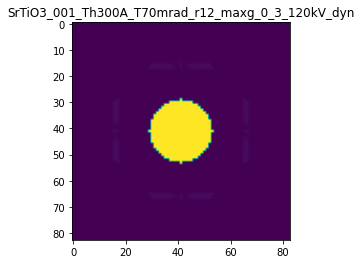

R-factor: 3.3433446708711645e-07

>>> producing the 54. dataset...

The offset applied on thickness: 6.274610210702636e-05

The offset applied on Ug: 0.49885133660112374

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06274610210704
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

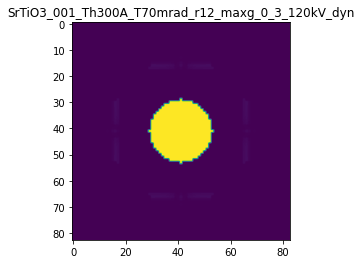

R-factor: 3.0521299247341625e-06

>>> producing the 55. dataset...

The offset applied on thickness: 0.00034309295814498574

The offset applied on Ug: 0.13382074002116284

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.343092958145
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

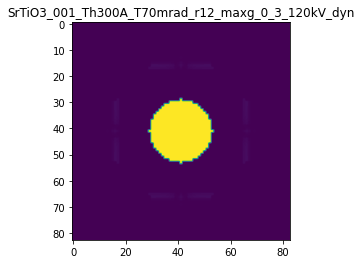

R-factor: 8.718263176683901e-07

>>> producing the 56. dataset...

The offset applied on thickness: 0.00015250680758455636

The offset applied on Ug: -0.5165181836132191

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15250680758453
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

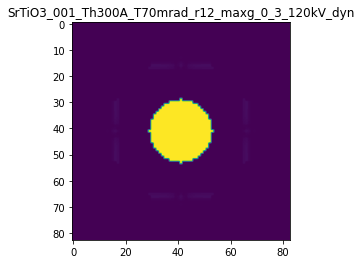

R-factor: 3.233521573192719e-06

>>> producing the 57. dataset...

The offset applied on thickness: -0.0002535659339445893

The offset applied on Ug: 0.33487433224058605

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7464340660554
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

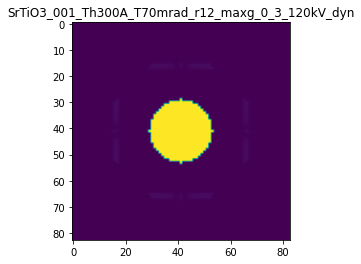

R-factor: 2.2171735583358203e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.00023015134176475072

The offset applied on Ug: -0.5974693786677913

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7698486582353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

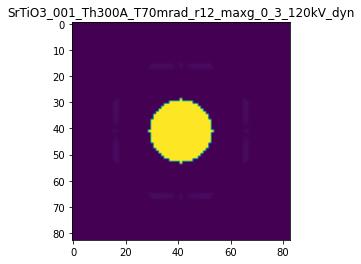

R-factor: 3.5460688934846133e-06

>>> producing the 59. dataset...

The offset applied on thickness: 0.00021175496102290636

The offset applied on Ug: -0.20174434285331658

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21175496102285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

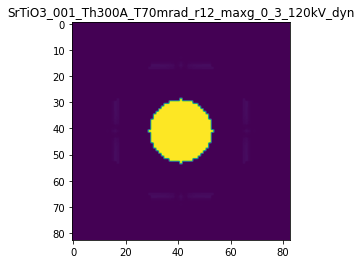

R-factor: 1.3696914821759794e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.0005246585462948006

The offset applied on Ug: 0.49343162721179257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5246585462948
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

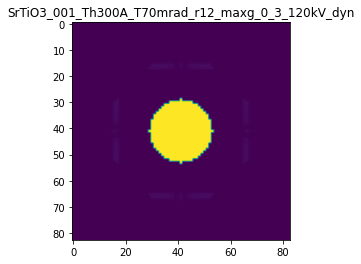

R-factor: 2.918085518303739e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.0005719366079612935

The offset applied on Ug: -0.36135966729552094

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5719366079613
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

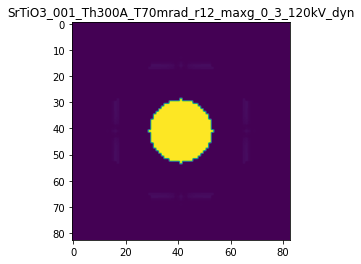

R-factor: 2.591964071911323e-06

>>> producing the 62. dataset...

The offset applied on thickness: 0.000486780558520324

The offset applied on Ug: 0.31179180090956904

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4867805585203
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

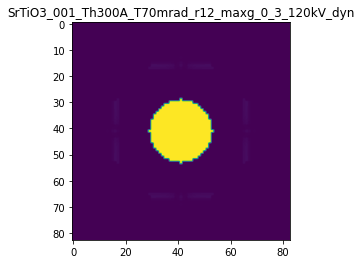

R-factor: 1.8761991787194485e-06

>>> producing the 63. dataset...

The offset applied on thickness: -0.00031156753423163577

The offset applied on Ug: -0.5444970539770438

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68843246576836
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

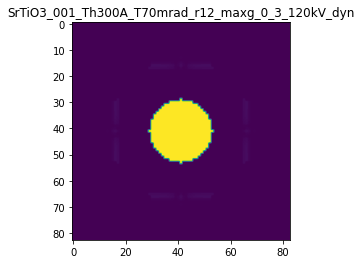

R-factor: 3.2163745934676315e-06

>>> producing the 64. dataset...

The offset applied on thickness: -0.0006829837257101154

The offset applied on Ug: 0.5293764310841632

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31701627428987
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

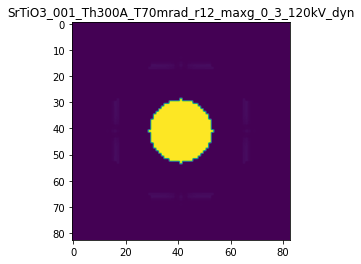

R-factor: 3.70056957210069e-06

>>> producing the 65. dataset...

The offset applied on thickness: -0.0003726492627403364

The offset applied on Ug: -0.12099255688672017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62735073725963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

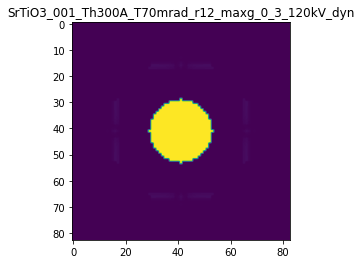

R-factor: 8.283603029088243e-07

>>> producing the 66. dataset...

The offset applied on thickness: -0.000757206637072906

The offset applied on Ug: 0.6108184457468459

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2427933629271
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

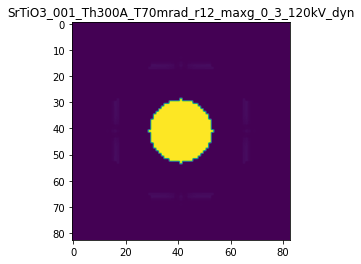

R-factor: 4.249438066125132e-06

>>> producing the 67. dataset...

The offset applied on thickness: -0.0005483608713450094

The offset applied on Ug: -0.2074773417234998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45163912865496
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

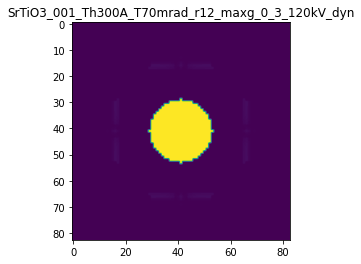

R-factor: 1.3651685684468514e-06

>>> producing the 68. dataset...

The offset applied on thickness: 0.0008421961401609968

The offset applied on Ug: 0.2594983979015862

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.842196140161
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

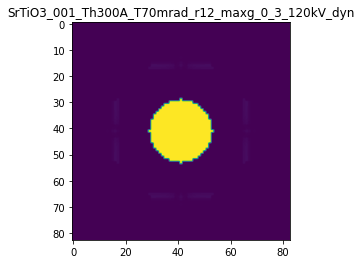

R-factor: 1.8013331850485907e-06

>>> producing the 69. dataset...

The offset applied on thickness: 2.444842288036586e-05

The offset applied on Ug: -0.37637634021945443

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.02444842288037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

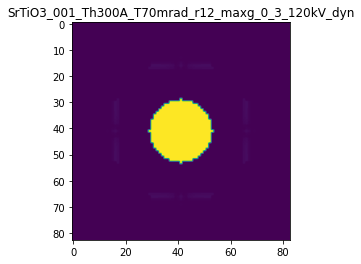

R-factor: 2.3108743768471e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.0009115846572183015

The offset applied on Ug: 0.4044991484379294

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0884153427817
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

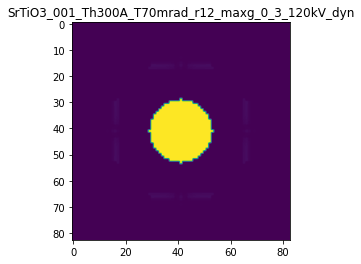

R-factor: 3.1282545947901517e-06

>>> producing the 71. dataset...

The offset applied on thickness: 0.0005793526489130729

The offset applied on Ug: 0.5325516261228431

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5793526489131
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

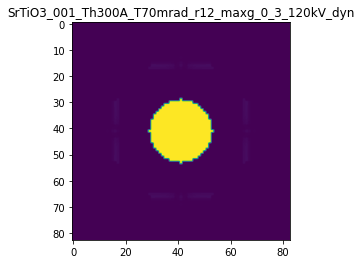

R-factor: 3.1498136234883576e-06

>>> producing the 72. dataset...

The offset applied on thickness: -0.000621522298444337

The offset applied on Ug: -0.3692043274565644

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37847770155565
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

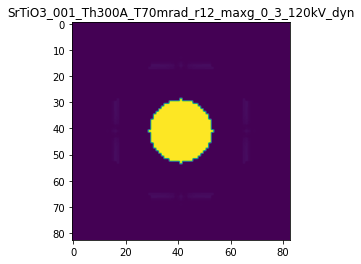

R-factor: 2.246727876521246e-06

>>> producing the 73. dataset...

The offset applied on thickness: -0.0009603055749254223

The offset applied on Ug: 0.24012979798883152

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0396944250746
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

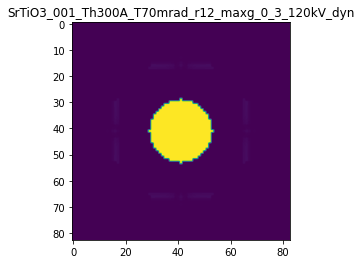

R-factor: 2.2228270869072404e-06

>>> producing the 74. dataset...

The offset applied on thickness: 0.0002266642177684939

The offset applied on Ug: 0.25891624963273613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.22666421776853
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

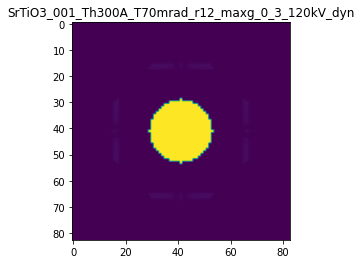

R-factor: 1.5312501420864025e-06

>>> producing the 75. dataset...

The offset applied on thickness: -6.734503392138813e-05

The offset applied on Ug: 0.2530076199158695

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93265496607864
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

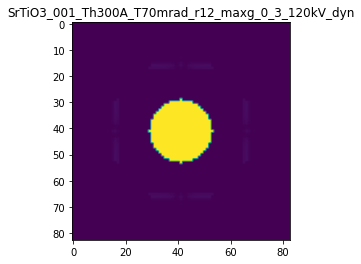

R-factor: 1.5963300044817005e-06

>>> producing the 76. dataset...

The offset applied on thickness: 0.000171081353647361

The offset applied on Ug: 0.5603042800314326

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17108135364737
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

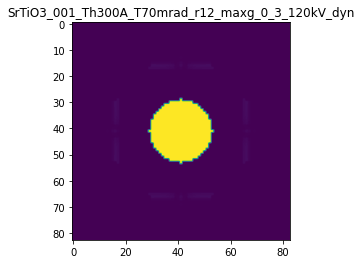

R-factor: 3.38099853313396e-06

>>> producing the 77. dataset...

The offset applied on thickness: -0.00012558398105593337

The offset applied on Ug: -0.09496923358334045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87441601894403
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

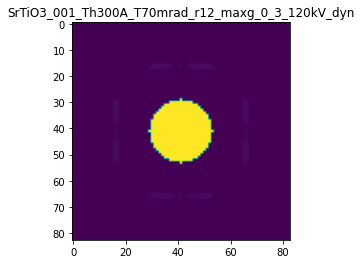

R-factor: 5.651452696884689e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.00017293032876127625

The offset applied on Ug: -0.042142480039219235

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17293032876125
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

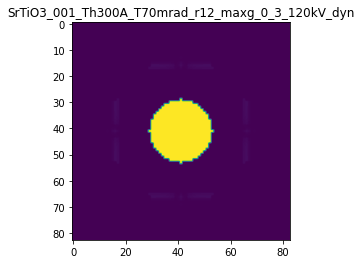

R-factor: 3.946450386655251e-07

>>> producing the 79. dataset...

The offset applied on thickness: 0.0008766275264211452

The offset applied on Ug: 0.20515971441687852

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87662752642115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

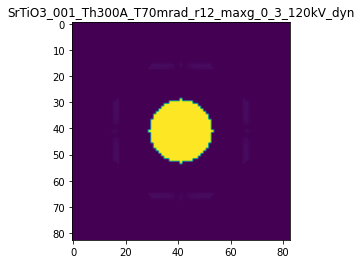

R-factor: 1.5742173585503736e-06

>>> producing the 80. dataset...

The offset applied on thickness: 8.279733165094316e-05

The offset applied on Ug: -0.20599448872643394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.08279733165097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

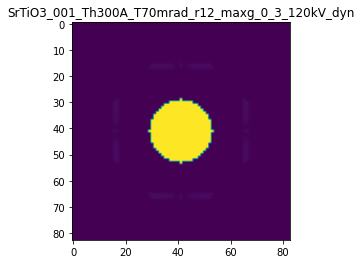

R-factor: 1.3092176462992294e-06

>>> producing the 81. dataset...

The offset applied on thickness: 0.0004958601361508925

The offset applied on Ug: -0.4500377091106033

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4958601361509
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

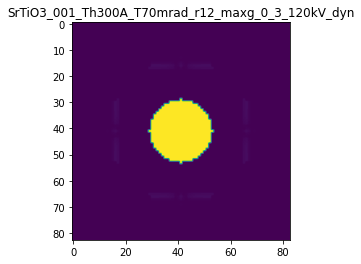

R-factor: 3.0648082290286174e-06

>>> producing the 82. dataset...

The offset applied on thickness: 8.308364771492505e-05

The offset applied on Ug: 0.2953574289149462

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0830836477149
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

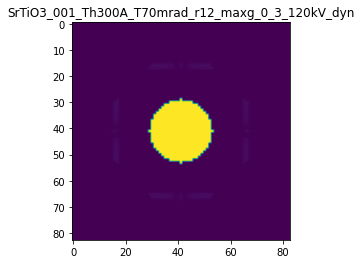

R-factor: 1.779585710356202e-06

>>> producing the 83. dataset...

The offset applied on thickness: -4.026574271498884e-06

The offset applied on Ug: -0.27418598154616974

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9959734257285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

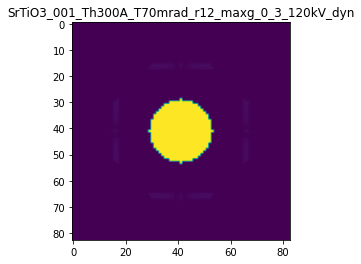

R-factor: 1.6742312323912953e-06

>>> producing the 84. dataset...

The offset applied on thickness: -0.000792799211581402

The offset applied on Ug: -0.031656412145769364

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.20720078841856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

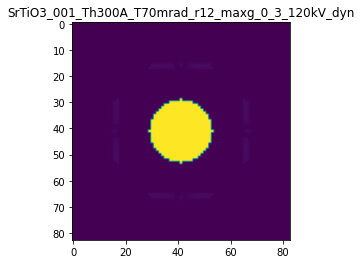

R-factor: 1.036312017564832e-06

>>> producing the 85. dataset...

The offset applied on thickness: 5.03326330188616e-05

The offset applied on Ug: -0.37905533631408944

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05033263301885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

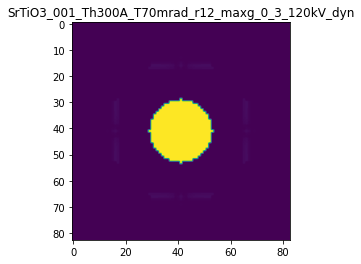

R-factor: 2.341897723856158e-06

>>> producing the 86. dataset...

The offset applied on thickness: -0.00021808342506318158

The offset applied on Ug: -0.4808781971773084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7819165749368
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

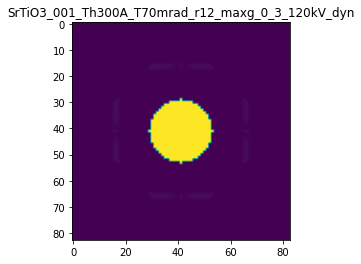

R-factor: 2.8511990941137237e-06

>>> producing the 87. dataset...

The offset applied on thickness: 0.0006562191336721175

The offset applied on Ug: -0.15757330458279384

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.65621913367215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

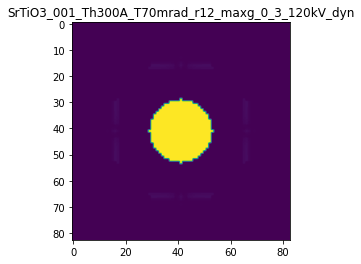

R-factor: 1.4851285829201392e-06

>>> producing the 88. dataset...

The offset applied on thickness: 0.00035378266735269917

The offset applied on Ug: 0.11446068177624583

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3537826673527
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

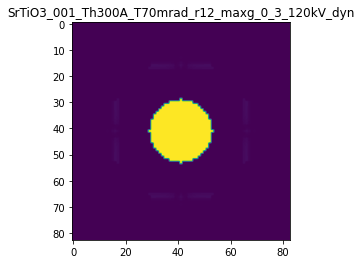

R-factor: 7.835043212513054e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.000969316604299651

The offset applied on Ug: -0.26039120319910325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03068339570035
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

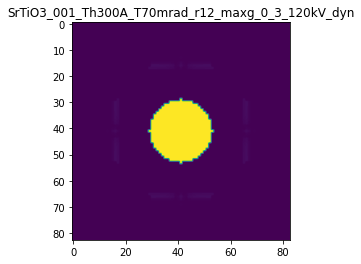

R-factor: 1.8938155380877804e-06

>>> producing the 90. dataset...

The offset applied on thickness: 0.0005786419240024466

The offset applied on Ug: -0.07559746520210368

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5786419240024
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

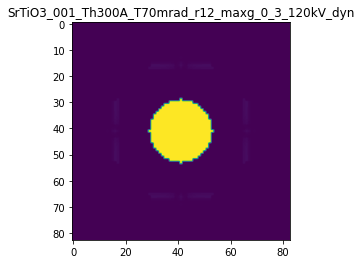

R-factor: 9.730916435251572e-07

>>> producing the 91. dataset...

The offset applied on thickness: -0.000507640100184992

The offset applied on Ug: 0.1727064012755254

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.49235989981497
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

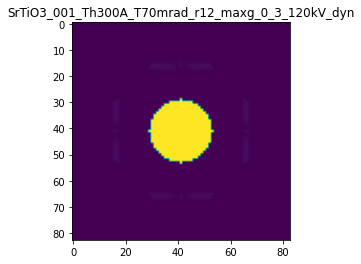

R-factor: 1.4356203771155268e-06

>>> producing the 92. dataset...

The offset applied on thickness: 0.0004318761299208542

The offset applied on Ug: 0.609846659787217

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43187612992085
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

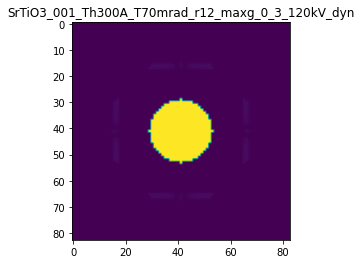

R-factor: 3.616526373619295e-06

>>> producing the 93. dataset...

The offset applied on thickness: 0.0009835571491537617

The offset applied on Ug: 0.5602960688953634

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98355714915374
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

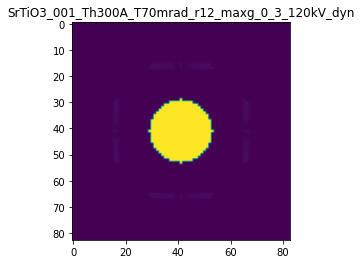

R-factor: 3.4067817815424946e-06

>>> producing the 94. dataset...

The offset applied on thickness: -0.0008193023437139768

The offset applied on Ug: -0.5429369005035116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.18069765628604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

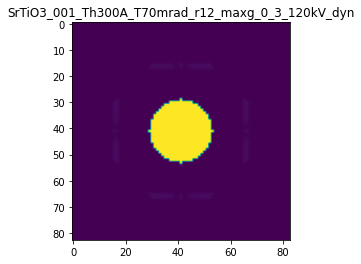

R-factor: 3.27203834393063e-06

>>> producing the 95. dataset...

The offset applied on thickness: 0.0007290185490087349

The offset applied on Ug: -0.5290607761227595

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72901854900874
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

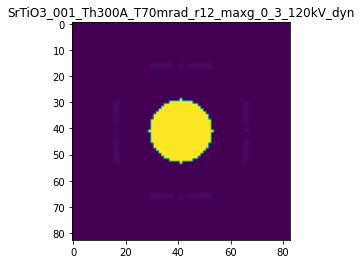

R-factor: 3.7073613388835587e-06

>>> producing the 96. dataset...

The offset applied on thickness: 0.000255739004427731

The offset applied on Ug: 0.13959564164458527

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2557390044277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

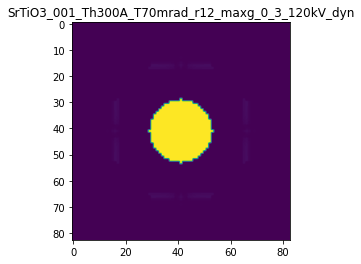

R-factor: 8.555240830117381e-07

>>> producing the 97. dataset...

The offset applied on thickness: -0.0006500632246846232

The offset applied on Ug: -0.33722087578558646

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34993677531537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

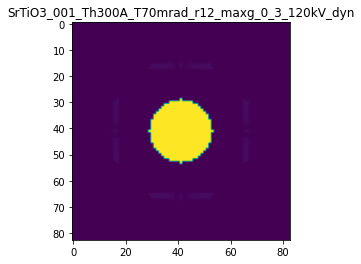

R-factor: 2.0841494623982645e-06

>>> producing the 98. dataset...

The offset applied on thickness: 0.0007933932809939708

The offset applied on Ug: 0.11113899102389851

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.793393280994
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

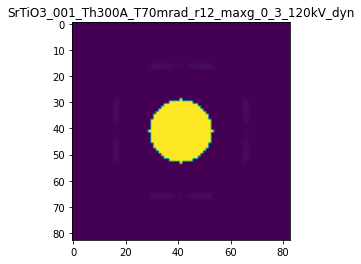

R-factor: 1.1783405270072923e-06

>>> producing the 99. dataset...

The offset applied on thickness: -6.379216725325821e-06

The offset applied on Ug: -0.38878225723285853

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9936207832747
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

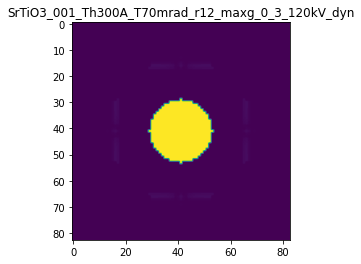

R-factor: 2.368866121160612e-06

>>> producing the 100. dataset...

The offset applied on thickness: 0.0006550268486332714

The offset applied on Ug: -0.5625701682642266

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.65502684863327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

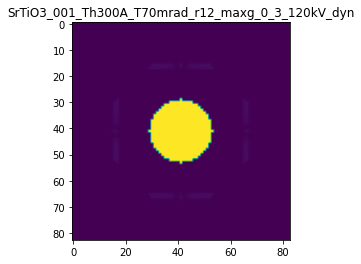

R-factor: 3.852069707574703e-06

>>> producing the 101. dataset...

The offset applied on thickness: 0.000816500559287197

The offset applied on Ug: -0.5922731237052458

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81650055928714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

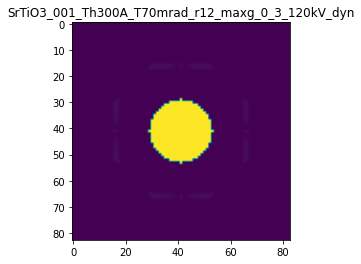

R-factor: 4.14825016211272e-06

>>> producing the 102. dataset...

The offset applied on thickness: 0.0007501435403223252

The offset applied on Ug: -0.10100232309936047

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7501435403223
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

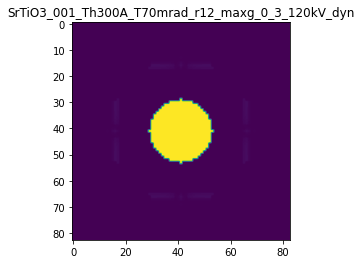

R-factor: 1.2767636846288599e-06

>>> producing the 103. dataset...

The offset applied on thickness: 0.00023077551818763965

The offset applied on Ug: -0.42173183680448345

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2307755181876
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

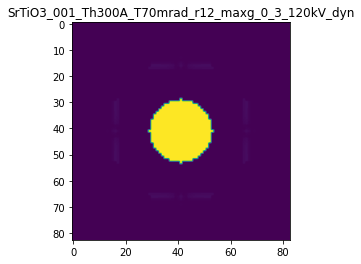

R-factor: 2.7123995847909575e-06

>>> producing the 104. dataset...

The offset applied on thickness: -0.000551693800228301

The offset applied on Ug: 0.5293926620127286

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4483061997717
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

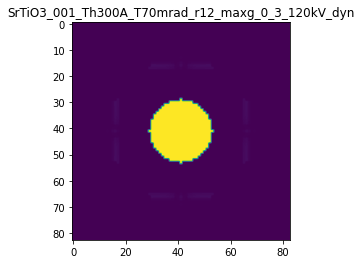

R-factor: 3.6099989841522265e-06

>>> producing the 105. dataset...

The offset applied on thickness: 0.0008160801405933554

The offset applied on Ug: 0.07441386911303369

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81608014059333
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

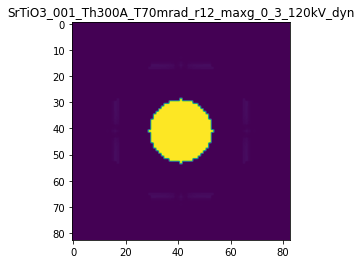

R-factor: 1.1388450284242895e-06

>>> producing the 106. dataset...

The offset applied on thickness: -0.00022776010641977208

The offset applied on Ug: 0.19207176624613284

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7722398935802
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

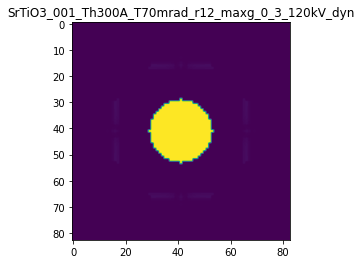

R-factor: 1.326233216705062e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.0003343296390804416

The offset applied on Ug: -0.5920462071972858

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3343296390804
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

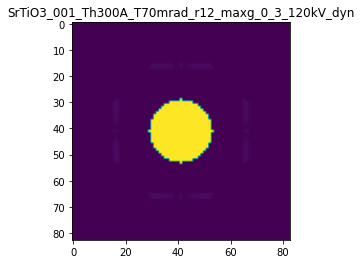

R-factor: 3.805785606240025e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.0003169428514785493

The offset applied on Ug: -0.3161022504304208

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.31694285147853
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

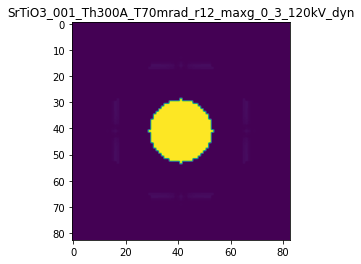

R-factor: 2.1333623661513536e-06

>>> producing the 109. dataset...

The offset applied on thickness: -6.178073645729309e-05

The offset applied on Ug: -0.09582477624384325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9382192635427
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

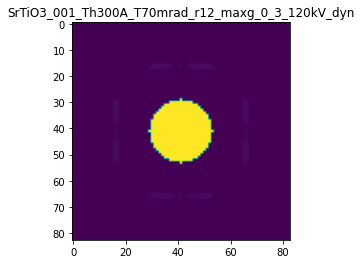

R-factor: 5.670693314729705e-07

>>> producing the 110. dataset...

The offset applied on thickness: -0.000995405965529796

The offset applied on Ug: -0.5668443728931516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00459403447024
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

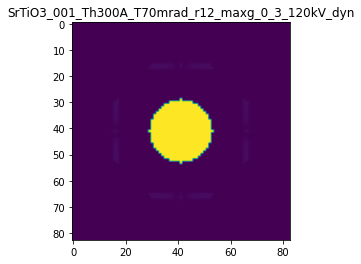

R-factor: 3.4649194250203166e-06

>>> producing the 111. dataset...

The offset applied on thickness: 0.00013843830597217878

The offset applied on Ug: 0.4972372967503499

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13843830597216
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

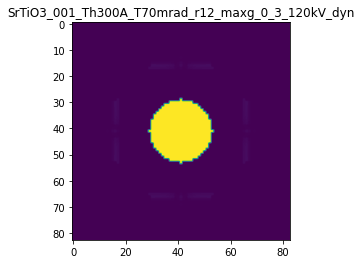

R-factor: 3.004149465840603e-06

>>> producing the 112. dataset...

The offset applied on thickness: -4.748979558684252e-05

The offset applied on Ug: -0.4038407108703379

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95251020441316
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

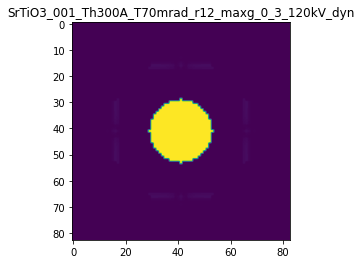

R-factor: 2.4383401612148727e-06

>>> producing the 113. dataset...

The offset applied on thickness: -0.0004516740988911554

The offset applied on Ug: -0.3724423522943404

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54832590110885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

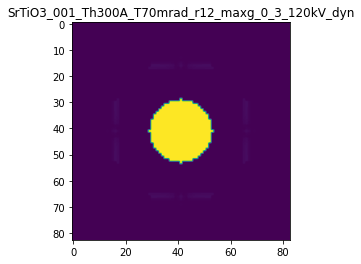

R-factor: 2.2081085693881238e-06

>>> producing the 114. dataset...

The offset applied on thickness: 0.0008827600330925021

The offset applied on Ug: -0.36872467480372123

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8827600330925
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

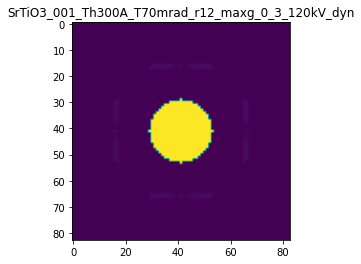

R-factor: 2.892745304468843e-06

>>> producing the 115. dataset...

The offset applied on thickness: -0.0003196870990404015

The offset applied on Ug: 0.22168929629660455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68031290095956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

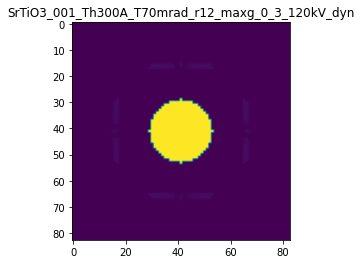

R-factor: 1.5718721794719493e-06

>>> producing the 116. dataset...

The offset applied on thickness: 0.00021991675328246775

The offset applied on Ug: -0.6098001380918285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21991675328246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

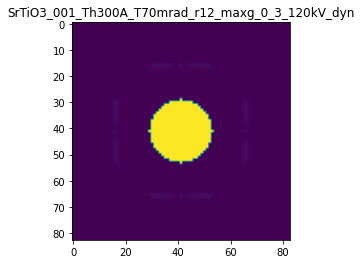

R-factor: 3.836925846054939e-06

>>> producing the 117. dataset...

The offset applied on thickness: -0.00048325916428413864

The offset applied on Ug: 0.008928868501267999

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51674083571584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

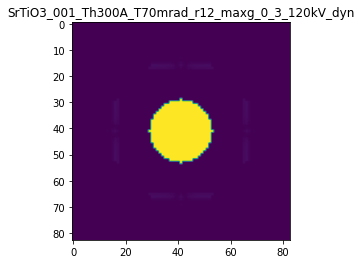

R-factor: 6.129753900707611e-07

>>> producing the 118. dataset...

The offset applied on thickness: -0.00014972115895660787

The offset applied on Ug: 0.3457770560255827

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85027884104335
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

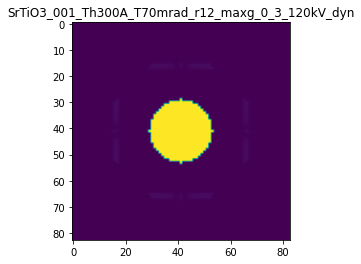

R-factor: 2.2181286059102295e-06

>>> producing the 119. dataset...

The offset applied on thickness: -0.0007939630518643859

The offset applied on Ug: 0.2746557132029872

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2060369481356
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

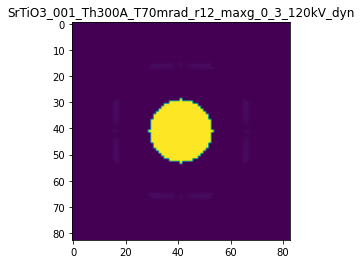

R-factor: 2.271102515911074e-06

>>> producing the 120. dataset...

The offset applied on thickness: 0.0001267215816454359

The offset applied on Ug: 0.5110082180982737

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1267215816454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

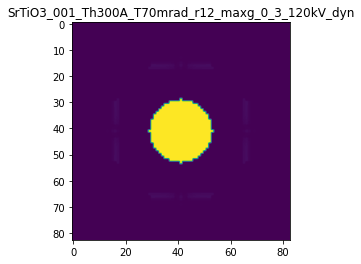

R-factor: 3.0955020339219826e-06

>>> producing the 121. dataset...

The offset applied on thickness: -0.000589685266597485

The offset applied on Ug: 0.5821337979805807

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4103147334025
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

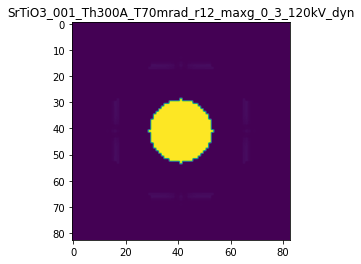

R-factor: 3.9592190148072045e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.000830587397110925

The offset applied on Ug: 0.3896200828737315

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16941260288905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

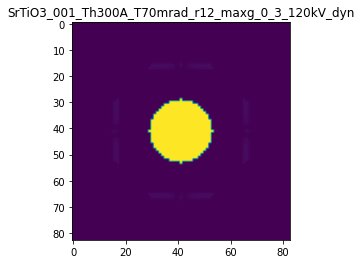

R-factor: 2.9739169258409456e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.0005029782779278817

The offset applied on Ug: 0.22666389087757155

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50297827792787
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

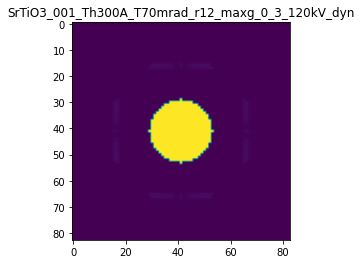

R-factor: 1.4292075134609511e-06

>>> producing the 124. dataset...

The offset applied on thickness: -0.00041510084973968265

The offset applied on Ug: 0.10923390869364695

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5848991502603
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

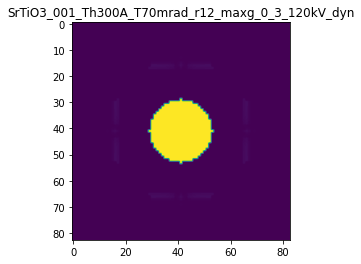

R-factor: 9.92127958787944e-07

>>> producing the 125. dataset...

The offset applied on thickness: -0.000995900616011509

The offset applied on Ug: 0.608558228556389

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0040993839885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

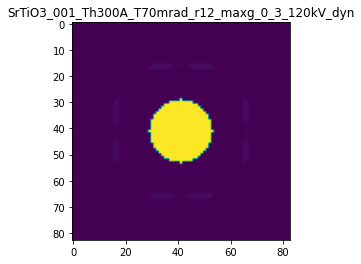

R-factor: 4.408240491438718e-06

>>> producing the 126. dataset...

The offset applied on thickness: 0.000721314473214792

The offset applied on Ug: 0.3276326797912485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72131447321476
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

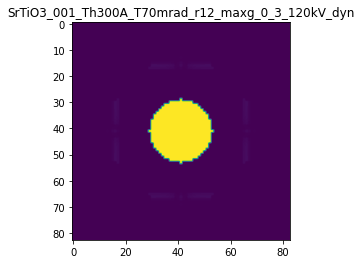

R-factor: 2.060629341437783e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.0005658425738935627

The offset applied on Ug: 0.5645799349286036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5658425738936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

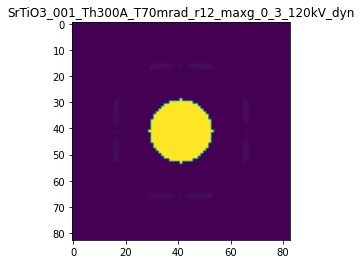

R-factor: 3.339798194906189e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.0006725694830055331

The offset applied on Ug: -0.23542992254592662

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67256948300553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

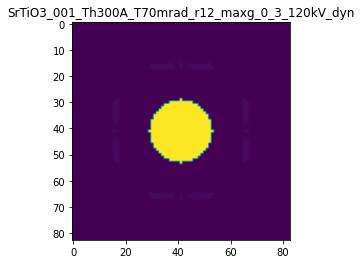

R-factor: 1.940944492641239e-06

>>> producing the 129. dataset...

The offset applied on thickness: 0.0008313052303823624

The offset applied on Ug: 0.11719044921097194

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8313052303824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

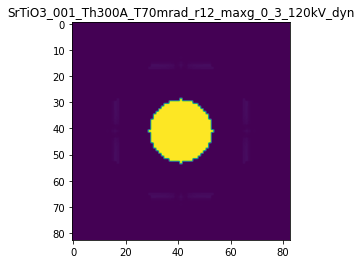

R-factor: 1.236091301309806e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.0009850082835387017

The offset applied on Ug: -0.36241237977973373

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9850082835387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

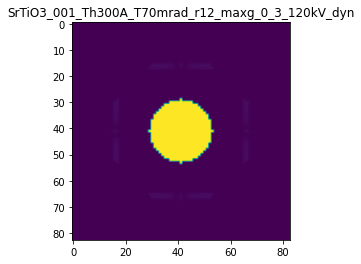

R-factor: 2.9440348827937078e-06

>>> producing the 131. dataset...

The offset applied on thickness: 0.0005815749608061029

The offset applied on Ug: -0.04313765472595577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5815749608061
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

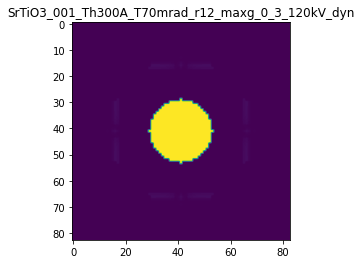

R-factor: 8.345053509959719e-07

>>> producing the 132. dataset...

The offset applied on thickness: -9.812443221606171e-05

The offset applied on Ug: 0.11972025244795902

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9018755677839
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

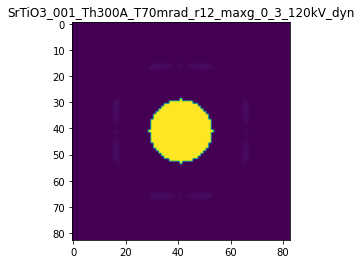

R-factor: 7.962042766404072e-07

>>> producing the 133. dataset...

The offset applied on thickness: 0.00023243326636173835

The offset applied on Ug: -0.39750360858602307

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23243326636174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

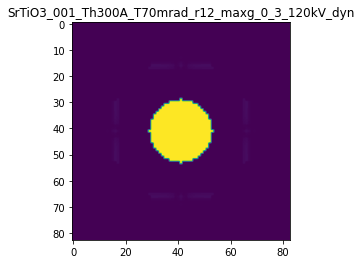

R-factor: 2.567326407101118e-06

>>> producing the 134. dataset...

The offset applied on thickness: 0.0005201184814717626

The offset applied on Ug: 0.20870015221353982

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52011848147174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

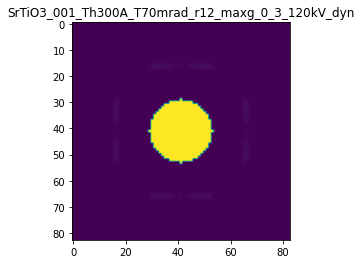

R-factor: 1.3492726795173504e-06

>>> producing the 135. dataset...

The offset applied on thickness: -8.984839093812958e-05

The offset applied on Ug: -0.4595828685263246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.91015160906187
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

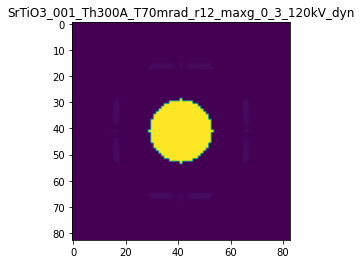

R-factor: 2.757649477800417e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.0007679786528068751

The offset applied on Ug: 0.5427772538204451

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76797865280685
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

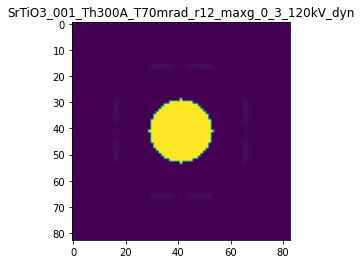

R-factor: 3.235167852029345e-06

>>> producing the 137. dataset...

The offset applied on thickness: -0.00013916362227922097

The offset applied on Ug: -0.312158228302818

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8608363777208
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

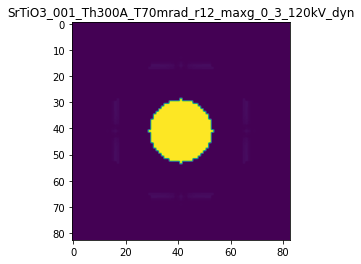

R-factor: 1.8540519515295642e-06

>>> producing the 138. dataset...

The offset applied on thickness: -0.00047612526043724104

The offset applied on Ug: -0.412356745102238

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52387473956276
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

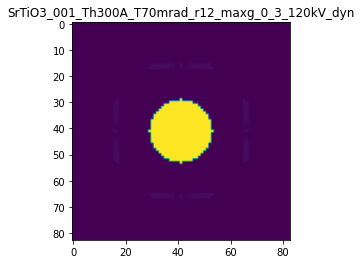

R-factor: 2.4400562566740085e-06

>>> producing the 139. dataset...

The offset applied on thickness: 0.0006840990026676673

The offset applied on Ug: -0.08711197183408544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.68409900266766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

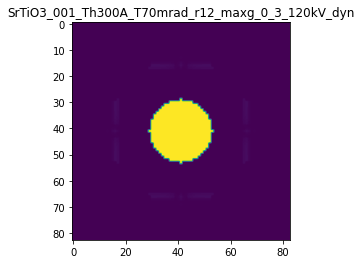

R-factor: 1.1394369520514573e-06

>>> producing the 140. dataset...

The offset applied on thickness: -0.000694993446103868

The offset applied on Ug: -0.23590593799045764

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30500655389613
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

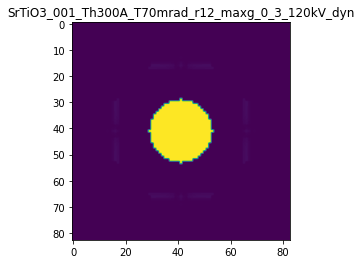

R-factor: 1.5961460618990494e-06



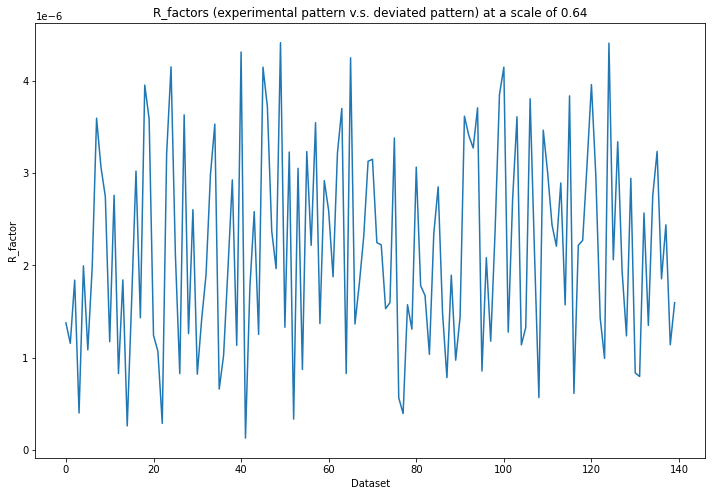

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 364ms/step - loss: 0.1953 - acc: 0.0000e+00 - val_loss: 0.1308 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 231ms/step - loss: 0.1088 - acc: 0.0000e+00 - val_loss: 0.0737 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 217ms/step - loss: 0.0570 - acc: 0.0000e+00 - val_loss: 0.0393 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 224ms/step - loss: 0.0300 - acc: 0.0000e+00 - val_loss: 0.0192 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 225ms/step - loss: 0.0146 - acc: 0.0000e+00 - val_loss: 0.0087 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 215ms/step - loss: 0.0060 - acc: 0.8000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 227ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

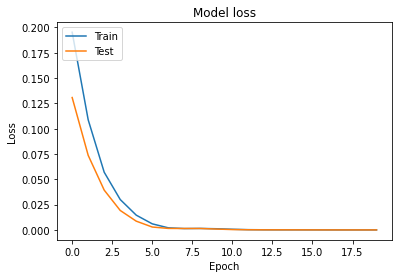

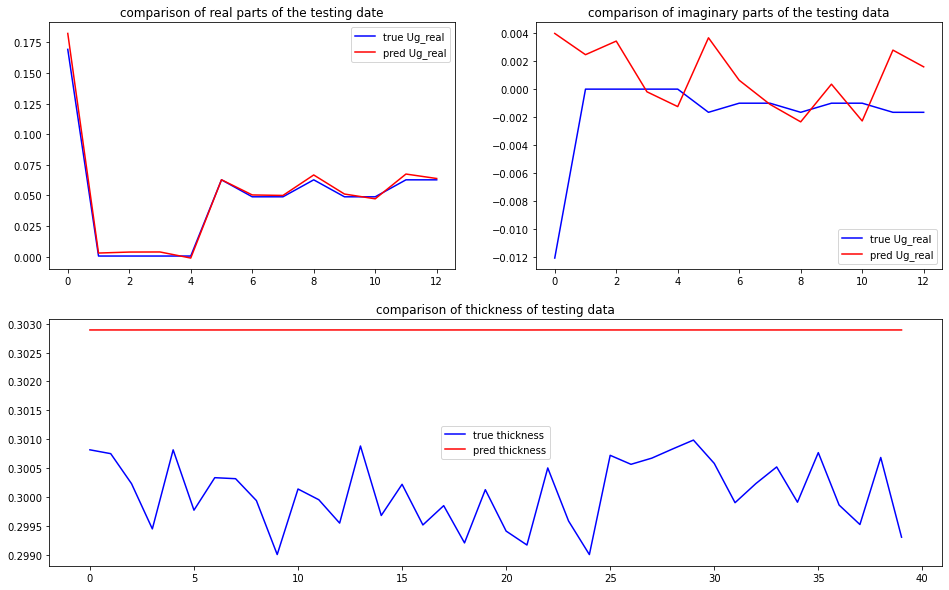

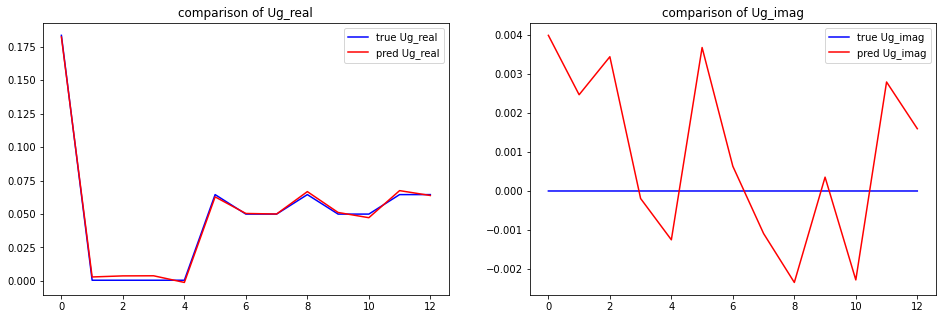

predicted thickness: 30.289030075073242 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=302.8903007507324
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18234321+0.j         0.00330

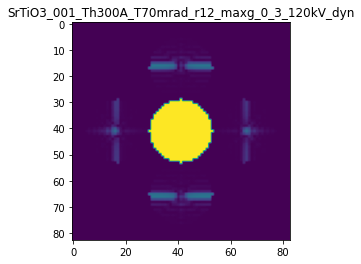

X_sim.max(): 0.9999592562318057
R-factor at a scale of 0.64 is 0.006157551985589258.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 1.28

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0006426629213218485

The offset applied on Ug: -0.45126970648474585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


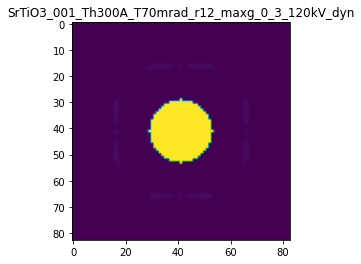

R-factor: 2.705766645574873e-06

>>> producing the 2. dataset...

The offset applied on thickness: -0.0003145545153267255

The offset applied on Ug: -0.5800054400113774

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68544548467327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

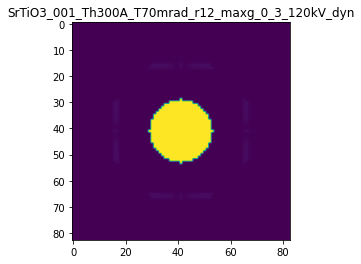

R-factor: 3.4267205128147797e-06

>>> producing the 3. dataset...

The offset applied on thickness: -0.0002732557504251998

The offset applied on Ug: -0.15876287197429576

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7267442495748
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

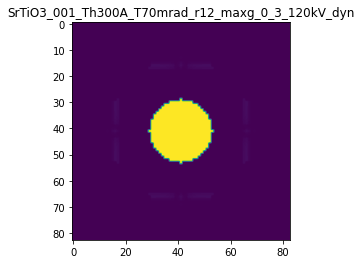

R-factor: 9.676917988581972e-07

>>> producing the 4. dataset...

The offset applied on thickness: -0.0008083461217045527

The offset applied on Ug: -0.3499887968852039

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1916538782954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

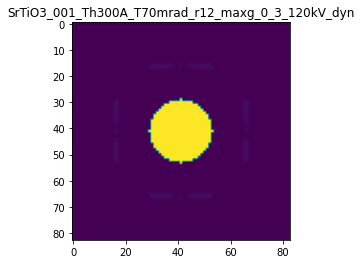

R-factor: 2.2341664721958248e-06

>>> producing the 5. dataset...

The offset applied on thickness: 0.0005481517688847333

The offset applied on Ug: -0.283422771535422

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54815176888474
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

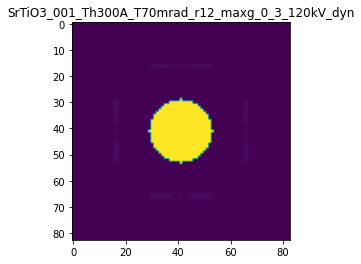

R-factor: 2.113636843877479e-06

>>> producing the 6. dataset...

The offset applied on thickness: -0.0004071295139438327

The offset applied on Ug: -0.8763636016240985

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59287048605614
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

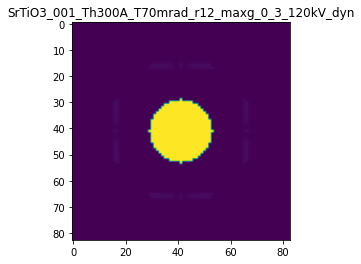

R-factor: 5.172351020402368e-06

>>> producing the 7. dataset...

The offset applied on thickness: -0.0006416197071776326

The offset applied on Ug: -1.0439613106539023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35838029282235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

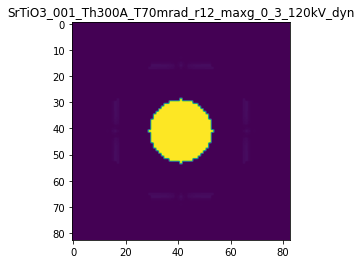

R-factor: 6.134320272788082e-06

>>> producing the 8. dataset...

The offset applied on thickness: -0.0006007358508171962

The offset applied on Ug: -1.0351792307118817

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3992641491828
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

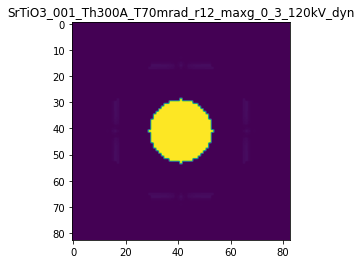

R-factor: 6.087105110984913e-06

>>> producing the 9. dataset...

The offset applied on thickness: 0.00011934571359230505

The offset applied on Ug: -0.14532357689195124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1193457135923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

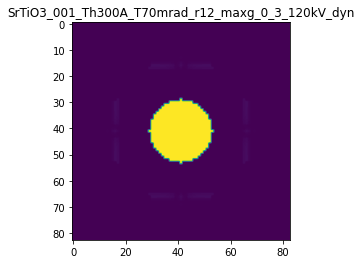

R-factor: 9.643225377021375e-07

>>> producing the 10. dataset...

The offset applied on thickness: -0.0004301576790519735

The offset applied on Ug: -0.2709635060681515

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.569842320948
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

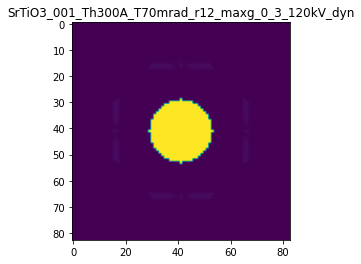

R-factor: 1.639058011596435e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.0002958232528422666

The offset applied on Ug: -0.030699812264216177

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29582325284224
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

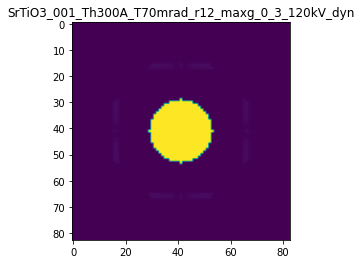

R-factor: 4.5980036445366907e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.00013860301133874798

The offset applied on Ug: -0.4553664714561353

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1386030113387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

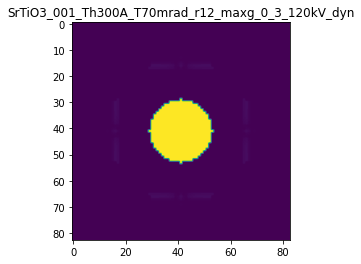

R-factor: 2.8560027571793677e-06

>>> producing the 13. dataset...

The offset applied on thickness: 0.00010787762509195797

The offset applied on Ug: -0.2198107130470919

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.10787762509193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

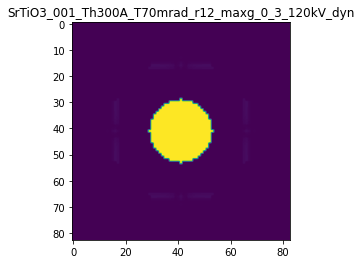

R-factor: 1.409303121435348e-06

>>> producing the 14. dataset...

The offset applied on thickness: -0.0008693057567384799

The offset applied on Ug: 0.18467470035497371

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1306942432615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

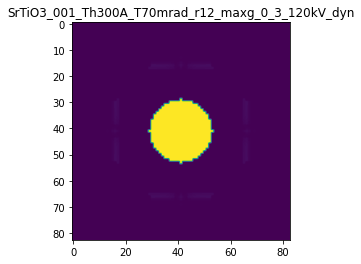

R-factor: 1.8313342241802567e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.0007797600971595143

The offset applied on Ug: -0.552406106127294

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7797600971595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

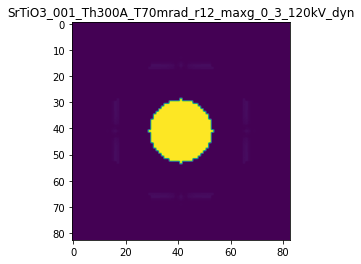

R-factor: 3.88414917909446e-06

>>> producing the 16. dataset...

The offset applied on thickness: 0.0008818349044017677

The offset applied on Ug: 0.6801461285719691

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8818349044017
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

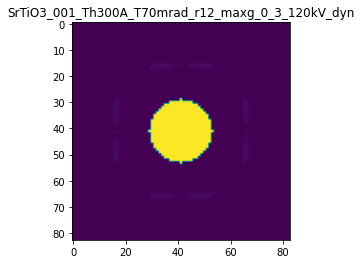

R-factor: 4.033480005309792e-06

>>> producing the 17. dataset...

The offset applied on thickness: -0.0005946614302087077

The offset applied on Ug: 0.3152798005568653

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4053385697913
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

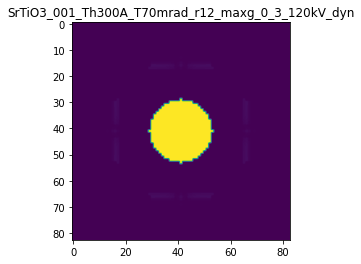

R-factor: 2.343074222479576e-06

>>> producing the 18. dataset...

The offset applied on thickness: 0.0006392138546623816

The offset applied on Ug: 0.45200857441055065

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.63921385466233
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

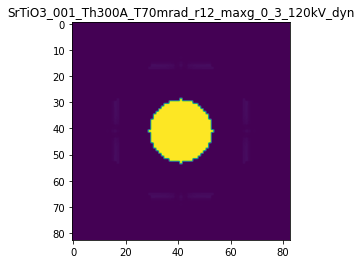

R-factor: 2.6949823660266343e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.0007064173792810354

The offset applied on Ug: 0.25297904617824174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.706417379281
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

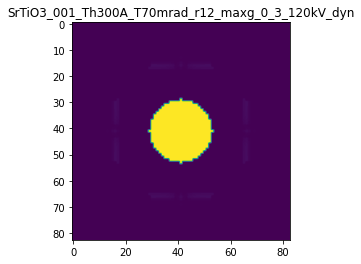

R-factor: 1.6825157780717643e-06

>>> producing the 20. dataset...

The offset applied on thickness: 0.00015336564378133733

The offset applied on Ug: -0.21997189922327606

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1533656437813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

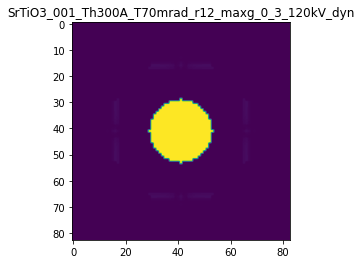

R-factor: 1.4402198639889257e-06

>>> producing the 21. dataset...

The offset applied on thickness: -9.341542809740223e-05

The offset applied on Ug: -1.102734811905629

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9065845719026
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

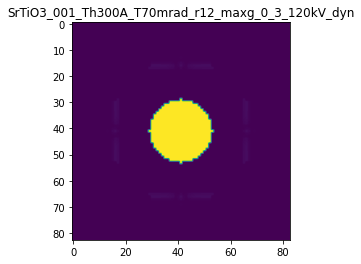

R-factor: 6.5977383223434865e-06

>>> producing the 22. dataset...

The offset applied on thickness: 0.0006419852729239793

The offset applied on Ug: 1.056474780439075

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.641985272924
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

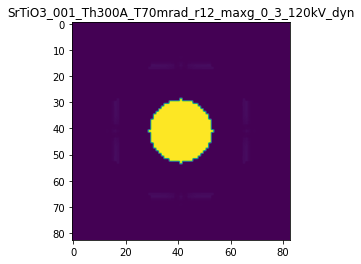

R-factor: 6.297823664311179e-06

>>> producing the 23. dataset...

The offset applied on thickness: 0.0005311876051269087

The offset applied on Ug: -1.0898324641563937

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5311876051269
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

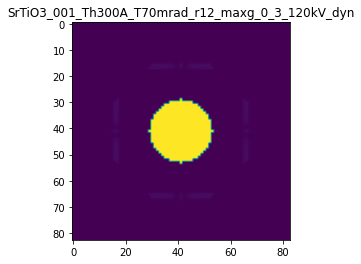

R-factor: 6.8925615076049985e-06

>>> producing the 24. dataset...

The offset applied on thickness: -7.413230785111091e-05

The offset applied on Ug: 0.45633804525857613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92586769214887
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

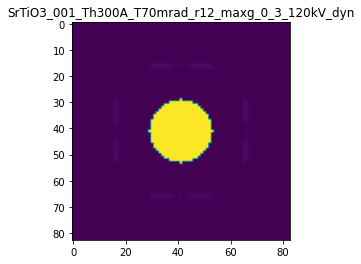

R-factor: 2.85957899465496e-06

>>> producing the 25. dataset...

The offset applied on thickness: 0.0008424831985517733

The offset applied on Ug: 0.9850549395939706

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8424831985518
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

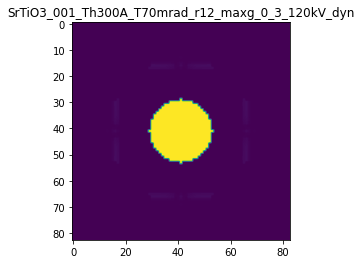

R-factor: 5.835903867901059e-06

>>> producing the 26. dataset...

The offset applied on thickness: 0.0006098874220543842

The offset applied on Ug: -0.5957151442283146

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6098874220543
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

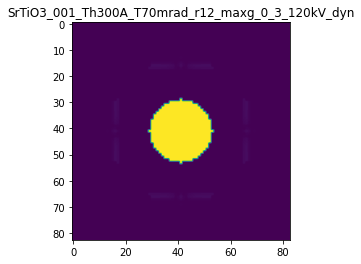

R-factor: 4.017450390040395e-06

>>> producing the 27. dataset...

The offset applied on thickness: -0.00023496489592939463

The offset applied on Ug: -0.8614315124295677

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7650351040706
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

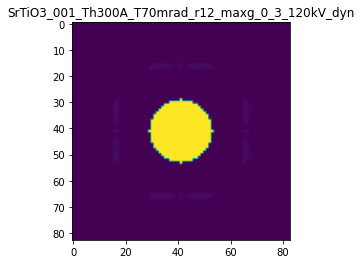

R-factor: 5.119926122411098e-06

>>> producing the 28. dataset...

The offset applied on thickness: -0.0005160543019405157

The offset applied on Ug: 0.9057799752304999

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4839456980595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

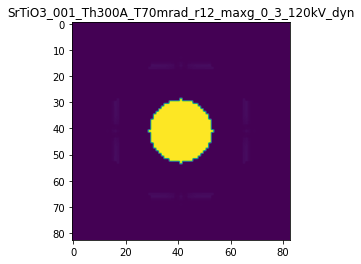

R-factor: 5.911983583181039e-06

>>> producing the 29. dataset...

The offset applied on thickness: -0.0007031592180103736

The offset applied on Ug: -0.3787251704393034

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2968407819896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

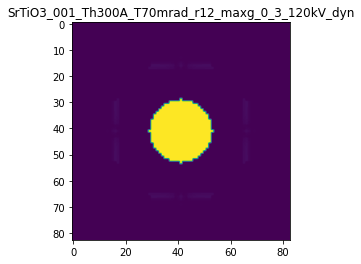

R-factor: 2.3287527860388366e-06

>>> producing the 30. dataset...

The offset applied on thickness: 0.0007880227570372851

The offset applied on Ug: -1.09164241010789

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78802275703725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

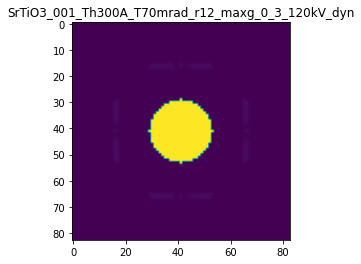

R-factor: 7.080578393446387e-06

>>> producing the 31. dataset...

The offset applied on thickness: -0.0004138367484997336

The offset applied on Ug: 1.1338322336072713

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5861632515003
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

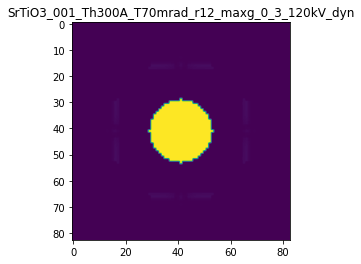

R-factor: 7.2755903446949905e-06

>>> producing the 32. dataset...

The offset applied on thickness: 0.000987877713453691

The offset applied on Ug: 0.8869800722873279

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9878777134537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

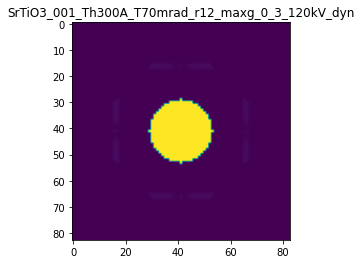

R-factor: 5.2514476447143095e-06

>>> producing the 33. dataset...

The offset applied on thickness: 0.0003050090858483034

The offset applied on Ug: -0.6486399715438756

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30500908584827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

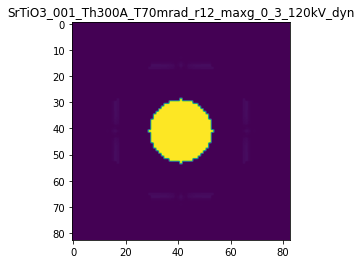

R-factor: 4.125087219703739e-06

>>> producing the 34. dataset...

The offset applied on thickness: -0.000606422964664694

The offset applied on Ug: -1.0592374904508592

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3935770353353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

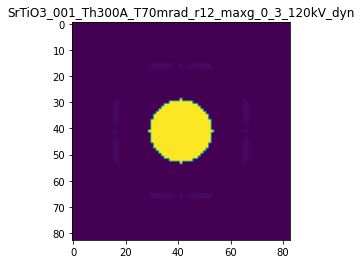

R-factor: 6.227836814964893e-06

>>> producing the 35. dataset...

The offset applied on thickness: -0.0006461762221742231

The offset applied on Ug: -1.1146563131402498

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35382377782577
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

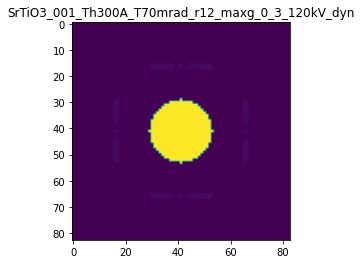

R-factor: 6.548736972360384e-06

>>> producing the 36. dataset...

The offset applied on thickness: 0.0003064337885629791

The offset applied on Ug: -0.44003466206377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30643378856297
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

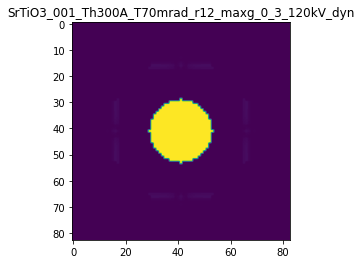

R-factor: 2.873307259782796e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.0007837211974729355

The offset applied on Ug: -0.753514976335469

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21627880252703
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

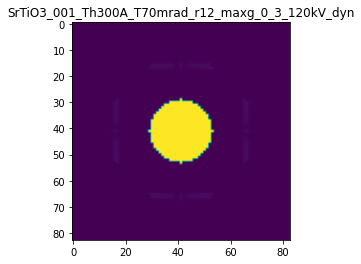

R-factor: 4.441041443145479e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.00040214208306930277

The offset applied on Ug: 0.5328413000061565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59785791693065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

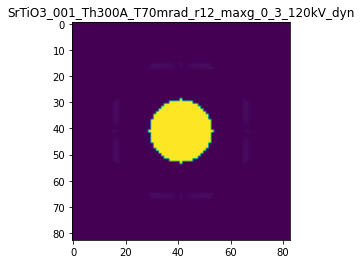

R-factor: 3.5319748203293852e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0008418514378185595

The offset applied on Ug: 1.088773626537329

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84185143781855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

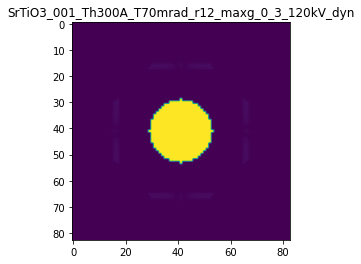

R-factor: 6.46116185621735e-06

>>> producing the 40. dataset...

The offset applied on thickness: -0.0003514588683811579

The offset applied on Ug: 1.1959451361572684

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6485411316188
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

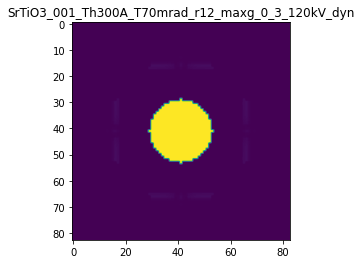

R-factor: 7.630858568651163e-06

>>> producing the 41. dataset...

The offset applied on thickness: -0.0009602270636249881

The offset applied on Ug: 1.2309913530971206

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.039772936375
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

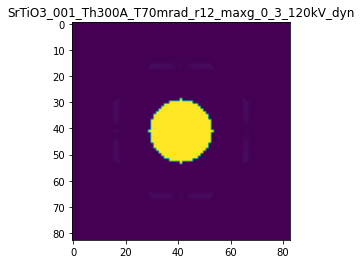

R-factor: 8.20769780056396e-06

>>> producing the 42. dataset...

The offset applied on thickness: 0.0008902756877229368

The offset applied on Ug: -0.7783232662469882

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8902756877229
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

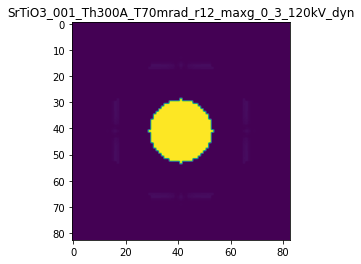

R-factor: 5.305172840742764e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.000758697609296973

The offset applied on Ug: -0.37694751209970806

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.241302390703
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

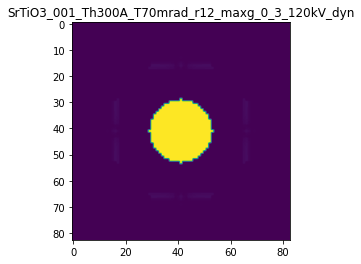

R-factor: 2.345832549196303e-06

>>> producing the 44. dataset...

The offset applied on thickness: 0.0003308499614508389

The offset applied on Ug: -0.3400200670496579

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33084996145084
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

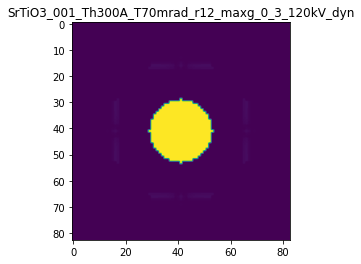

R-factor: 2.287171552172905e-06

>>> producing the 45. dataset...

The offset applied on thickness: 0.00032861262231351993

The offset applied on Ug: -0.3603894551039508

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3286126223135
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

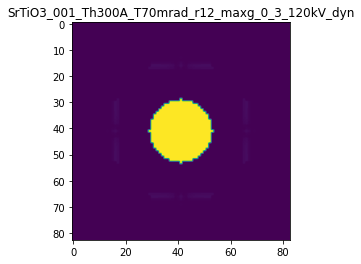

R-factor: 2.4083826538210817e-06

>>> producing the 46. dataset...

The offset applied on thickness: 4.461415575109995e-05

The offset applied on Ug: 0.5925099212016545

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04461415575105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

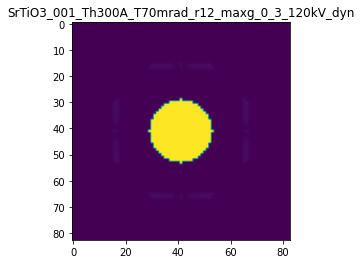

R-factor: 3.6445043606444817e-06

>>> producing the 47. dataset...

The offset applied on thickness: -0.0008636700237025789

The offset applied on Ug: -0.6917261158918214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1363299762974
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

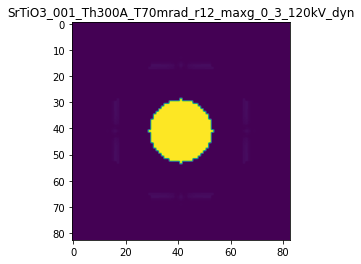

R-factor: 4.109329259128122e-06

>>> producing the 48. dataset...

The offset applied on thickness: -5.874805092513191e-05

The offset applied on Ug: -0.09825709835801547

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94125194907485
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

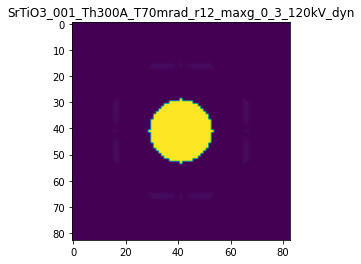

R-factor: 5.820506252097275e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.0001106733538213427

The offset applied on Ug: -1.1516435538374912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.11067335382137
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

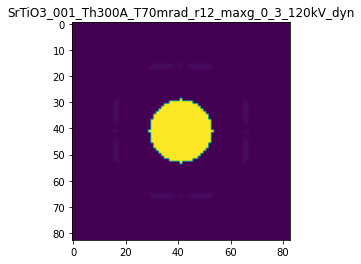

R-factor: 6.985629555551221e-06

>>> producing the 50. dataset...

The offset applied on thickness: 0.0005006609286668585

The offset applied on Ug: -0.9379769189197069

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50066092866683
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

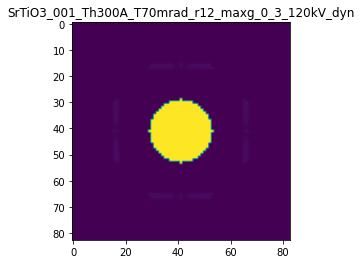

R-factor: 5.977650363534054e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.0001221725777385998

The offset applied on Ug: -1.132907352311277

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1221725777386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

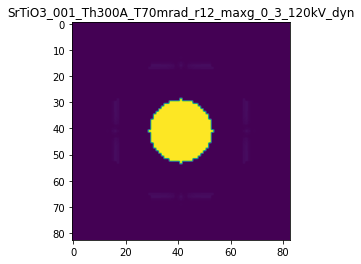

R-factor: 6.882792103119374e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.0009249671943314719

The offset applied on Ug: 1.2626235692480399

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9249671943315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

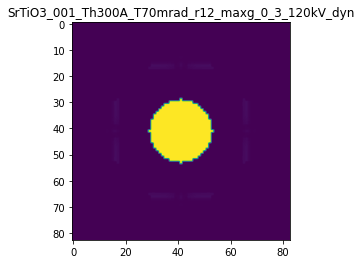

R-factor: 7.504154585711832e-06

>>> producing the 53. dataset...

The offset applied on thickness: 0.0007088936316707542

The offset applied on Ug: -1.2431589037047581

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7088936316708
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

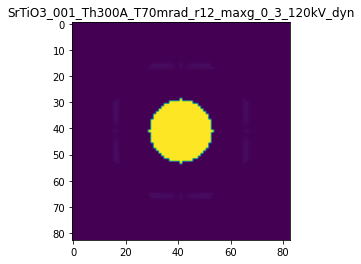

R-factor: 7.911155135361235e-06

>>> producing the 54. dataset...

The offset applied on thickness: 0.0005868000839588237

The offset applied on Ug: 0.8446651065196449

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58680008395885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

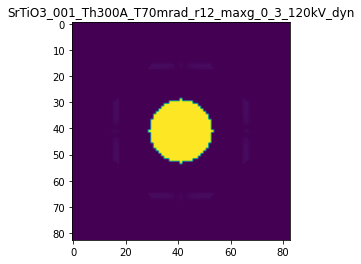

R-factor: 5.015884129720414e-06

>>> producing the 55. dataset...

The offset applied on thickness: -0.000982072552082744

The offset applied on Ug: 1.2312106558711922

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0179274479172
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

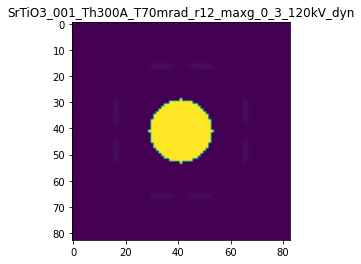

R-factor: 8.222652517511095e-06

>>> producing the 56. dataset...

The offset applied on thickness: 0.0005218070011515596

The offset applied on Ug: -0.6549598252228939

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52180700115156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

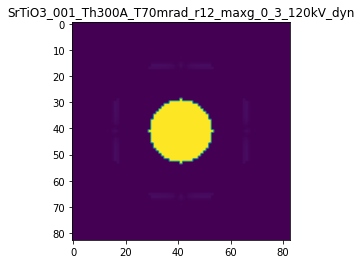

R-factor: 4.30978269223211e-06

>>> producing the 57. dataset...

The offset applied on thickness: -0.00037773654364182274

The offset applied on Ug: 1.2430876223331135

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62226345635816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

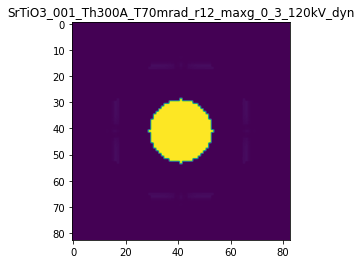

R-factor: 7.941250239122901e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0007390644951022658

The offset applied on Ug: -0.7748010898041298

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26093550489776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

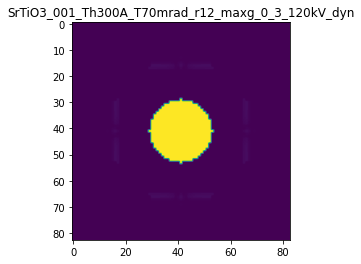

R-factor: 4.55593135998495e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.0005783998277433173

The offset applied on Ug: -0.2536742673184898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42160017225666
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

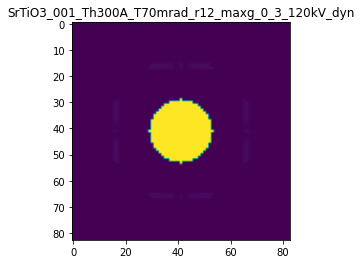

R-factor: 1.6137660657922036e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.000793116781767693

The offset applied on Ug: -0.9807137798076784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79311678176765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

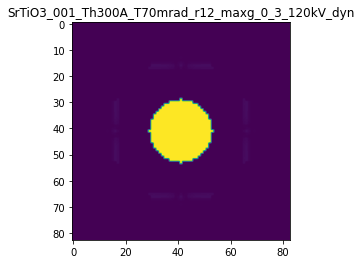

R-factor: 6.432043951422741e-06

>>> producing the 61. dataset...

The offset applied on thickness: -0.0004600743064549642

The offset applied on Ug: 1.1033351557446087

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53992569354506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

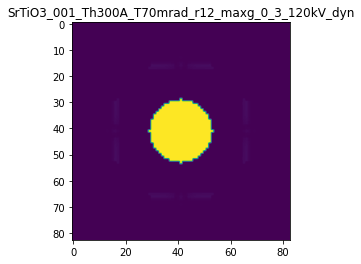

R-factor: 7.110902901051601e-06

>>> producing the 62. dataset...

The offset applied on thickness: 0.0007960069839609399

The offset applied on Ug: 1.2687107071112096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7960069839609
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

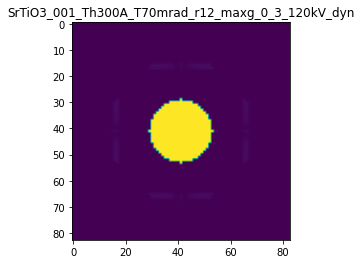

R-factor: 7.566801463038984e-06

>>> producing the 63. dataset...

The offset applied on thickness: -0.0004609599149936334

The offset applied on Ug: 0.15381244348746095

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5390400850064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

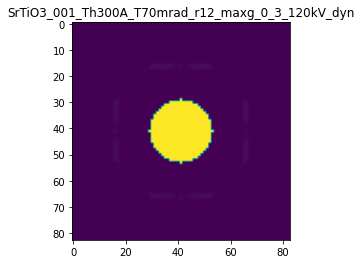

R-factor: 1.2863357510013166e-06

>>> producing the 64. dataset...

The offset applied on thickness: -0.00010826994329508221

The offset applied on Ug: -1.0006233610905961

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8917300567049
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

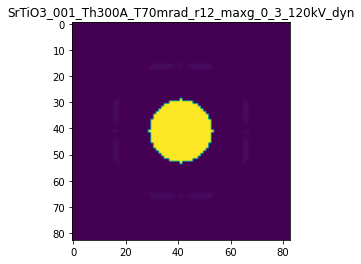

R-factor: 5.987728979468228e-06

>>> producing the 65. dataset...

The offset applied on thickness: -0.0009257695957907919

The offset applied on Ug: 0.45222946177017065

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07423040420923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

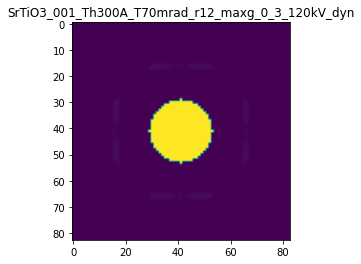

R-factor: 3.420502379316276e-06

>>> producing the 66. dataset...

The offset applied on thickness: -0.0005948631088009275

The offset applied on Ug: 1.2738755175176977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.40513689119905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

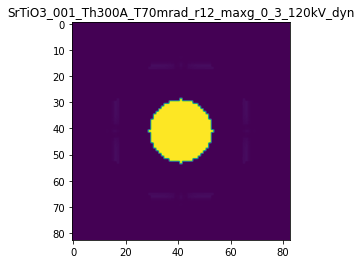

R-factor: 8.256378904978062e-06

>>> producing the 67. dataset...

The offset applied on thickness: -0.000576362394879303

The offset applied on Ug: 0.18066619070741097

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4236376051207
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

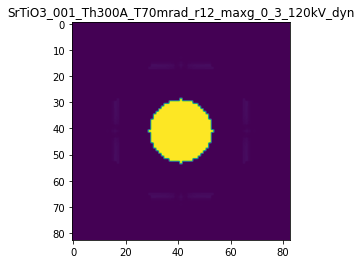

R-factor: 1.5418276744256317e-06

>>> producing the 68. dataset...

The offset applied on thickness: 0.0005104012467610908

The offset applied on Ug: 1.199320095493376

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5104012467611
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

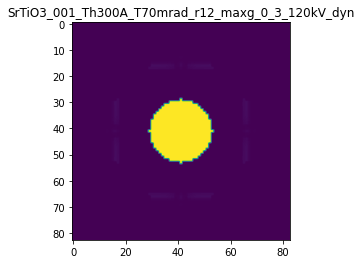

R-factor: 7.22787301315186e-06

>>> producing the 69. dataset...

The offset applied on thickness: 0.0004996511532355823

The offset applied on Ug: -1.211352500277632

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49965115323556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

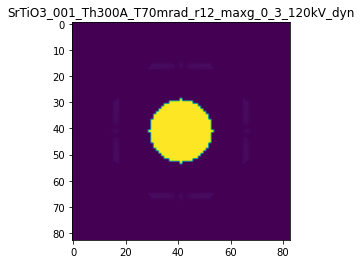

R-factor: 7.5818364808357566e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.0005140827198450666

The offset applied on Ug: -0.1397507016822081

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4859172801549
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

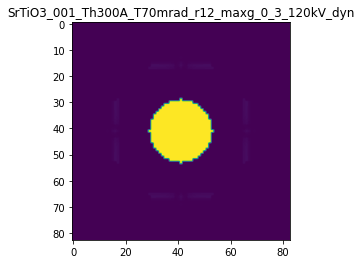

R-factor: 1.012353861880127e-06

>>> producing the 71. dataset...

The offset applied on thickness: -0.0008898008607011659

The offset applied on Ug: 1.2677880256869876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1101991392988
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

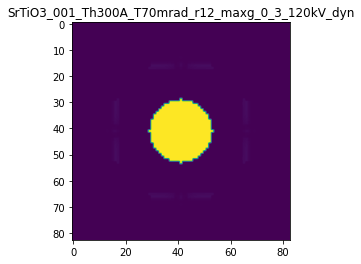

R-factor: 8.393351431620442e-06

>>> producing the 72. dataset...

The offset applied on thickness: -0.0008984987133784872

The offset applied on Ug: 1.2422004138742124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1015012866215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

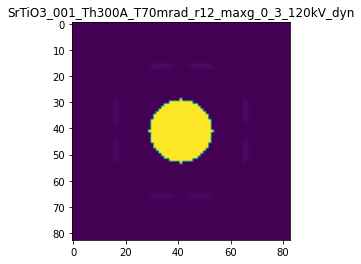

R-factor: 8.239227273738032e-06

>>> producing the 73. dataset...

The offset applied on thickness: -0.00019381716773077807

The offset applied on Ug: 0.7960922603239123

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80618283226926
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

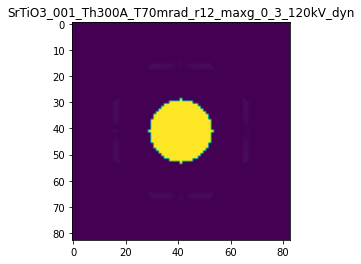

R-factor: 5.040368353826735e-06

>>> producing the 74. dataset...

The offset applied on thickness: 0.0007637938662618846

The offset applied on Ug: -0.5319790878632469

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7637938662619
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

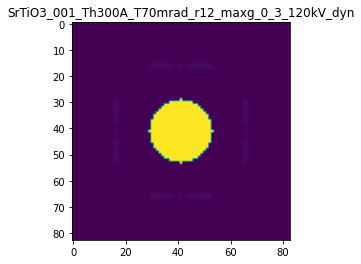

R-factor: 3.7508741444236547e-06

>>> producing the 75. dataset...

The offset applied on thickness: -0.000843129711208928

The offset applied on Ug: -0.8290203370537808

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1568702887911
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

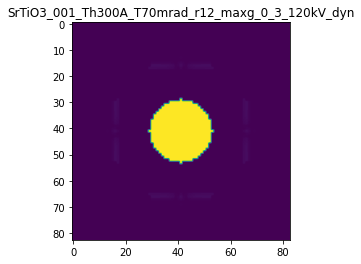

R-factor: 4.881972061429012e-06

>>> producing the 76. dataset...

The offset applied on thickness: 0.00042877339800340543

The offset applied on Ug: 0.5798092131241094

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4287733980034
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

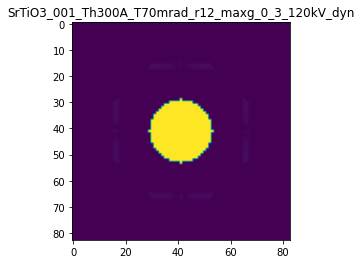

R-factor: 3.4356465017735886e-06

>>> producing the 77. dataset...

The offset applied on thickness: 0.0003298278861975288

The offset applied on Ug: 1.0351231809677968

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3298278861975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

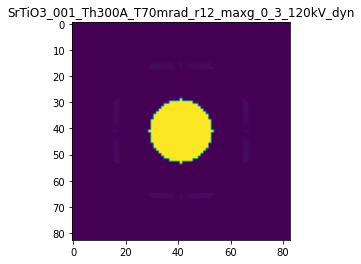

R-factor: 6.277708915180013e-06

>>> producing the 78. dataset...

The offset applied on thickness: -0.0008457922861701067

The offset applied on Ug: 0.8003062821980649

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.15420771382986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

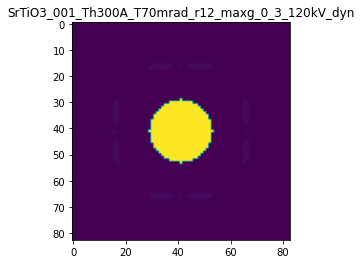

R-factor: 5.47192944569921e-06

>>> producing the 79. dataset...

The offset applied on thickness: 0.0007511929708537646

The offset applied on Ug: -0.9578460958766829

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7511929708537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

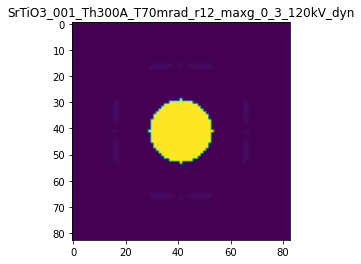

R-factor: 6.267781860790589e-06

>>> producing the 80. dataset...

The offset applied on thickness: -0.000825990763792476

The offset applied on Ug: -0.45552532438538607

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1740092362075
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

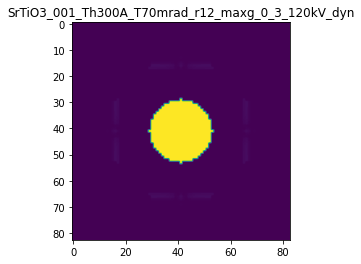

R-factor: 2.7936032595288436e-06

>>> producing the 81. dataset...

The offset applied on thickness: 0.00029569815769934913

The offset applied on Ug: 1.1626690818232555

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29569815769935
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

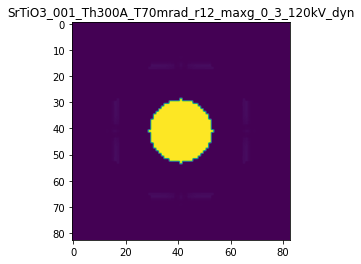

R-factor: 7.0976601515467435e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.0008368062984111735

The offset applied on Ug: -0.8436270631782159

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16319370158885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

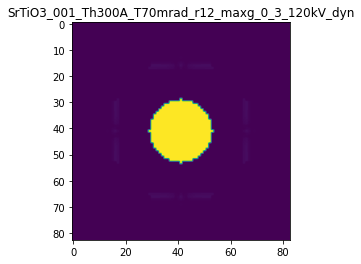

R-factor: 4.964267435559546e-06

>>> producing the 83. dataset...

The offset applied on thickness: -0.0004693889885098315

The offset applied on Ug: -0.09543832828252163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5306110114901
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

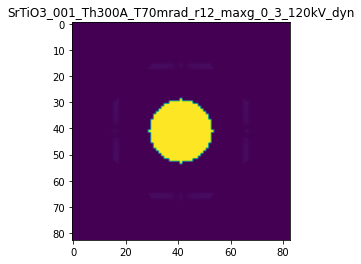

R-factor: 7.825657455538548e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.0006430508489176845

The offset applied on Ug: 1.167474410609689

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.64305084891765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

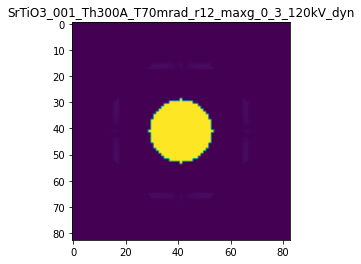

R-factor: 6.982633852066418e-06

>>> producing the 85. dataset...

The offset applied on thickness: 9.757629567540404e-05

The offset applied on Ug: -0.4471647722058225

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0975762956754
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

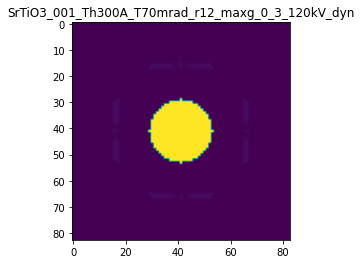

R-factor: 2.7817694103283193e-06

>>> producing the 86. dataset...

The offset applied on thickness: -0.000577564747652549

The offset applied on Ug: 0.41475838439103796

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42243525234744
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

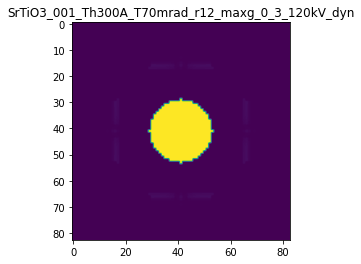

R-factor: 2.928344978936387e-06

>>> producing the 87. dataset...

The offset applied on thickness: 0.0009517702482488799

The offset applied on Ug: 1.1949917648947312

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95177024824886
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

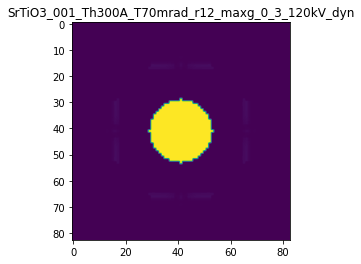

R-factor: 7.090373434316904e-06

>>> producing the 88. dataset...

The offset applied on thickness: -0.0004954616097842401

The offset applied on Ug: 0.6896224731565471

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5045383902157
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

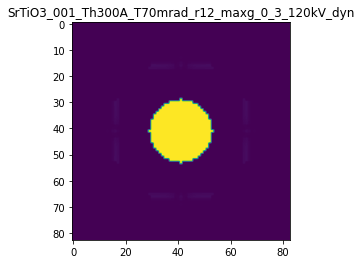

R-factor: 4.559564370114089e-06

>>> producing the 89. dataset...

The offset applied on thickness: 0.00016039510682541193

The offset applied on Ug: -0.46889303111764236

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16039510682543
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

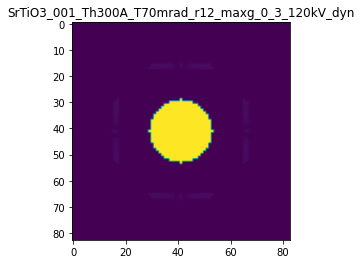

R-factor: 2.9512807038784024e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.00018642807047510734

The offset applied on Ug: -0.41626359533249

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8135719295249
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

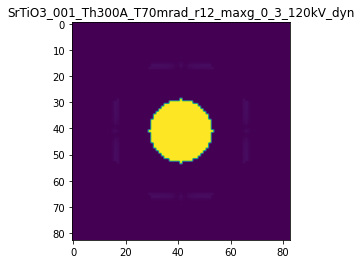

R-factor: 2.470000177541914e-06

>>> producing the 91. dataset...

The offset applied on thickness: 0.0009337834694192666

The offset applied on Ug: -1.240411596667158

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9337834694192
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

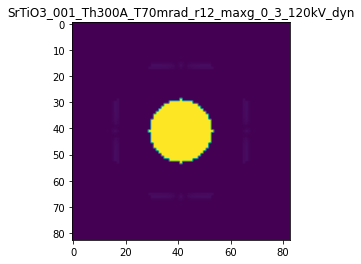

R-factor: 8.052496731872066e-06

>>> producing the 92. dataset...

The offset applied on thickness: -0.0003248605403659586

The offset applied on Ug: -0.2728545132610259

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.675139459634
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

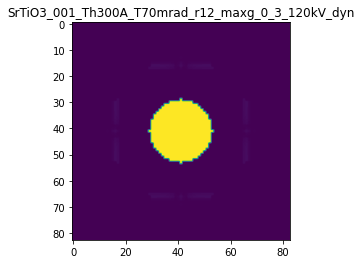

R-factor: 1.6165609537562507e-06

>>> producing the 93. dataset...

The offset applied on thickness: 0.00045516413220643035

The offset applied on Ug: 0.21904586328828543

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4551641322064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

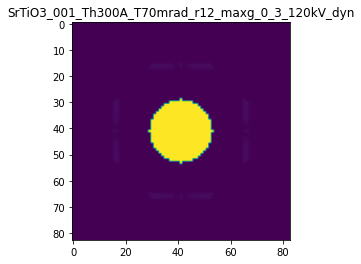

R-factor: 1.3645307611546023e-06

>>> producing the 94. dataset...

The offset applied on thickness: -0.0004521126761923704

The offset applied on Ug: 0.6792455717892455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54788732380763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

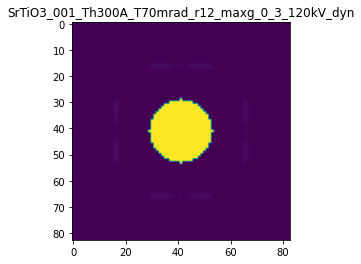

R-factor: 4.468060103589089e-06

>>> producing the 95. dataset...

The offset applied on thickness: -0.0007337487716544718

The offset applied on Ug: 0.7786646702494764

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2662512283455
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

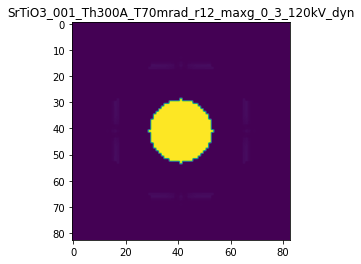

R-factor: 5.263876790412666e-06

>>> producing the 96. dataset...

The offset applied on thickness: -0.00021802784828486765

The offset applied on Ug: -0.17802279110123975

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78197215171514
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

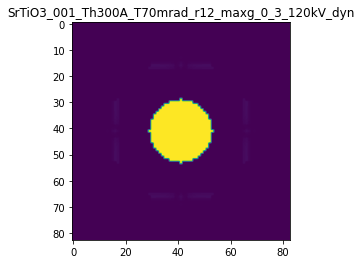

R-factor: 1.0559008135833992e-06

>>> producing the 97. dataset...

The offset applied on thickness: 0.0007569353628796196

The offset applied on Ug: -0.6164284087601942

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75693536287963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

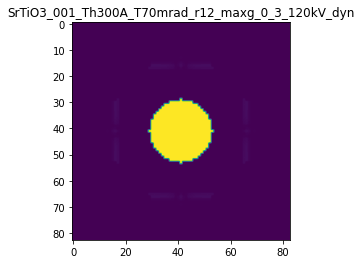

R-factor: 4.2472431549526506e-06

>>> producing the 98. dataset...

The offset applied on thickness: 0.0006923913809904641

The offset applied on Ug: 0.1427379935490643

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69239138099044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

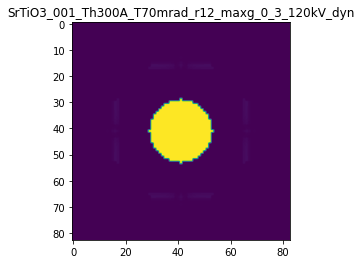

R-factor: 1.1623089833071246e-06

>>> producing the 99. dataset...

The offset applied on thickness: 3.598326432123322e-06

The offset applied on Ug: 0.6283482126886258

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0035983264321
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

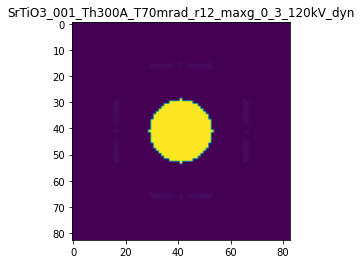

R-factor: 3.888888035920287e-06

>>> producing the 100. dataset...

The offset applied on thickness: -0.00015706314934886524

The offset applied on Ug: -0.8602396388914778

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8429368506511
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

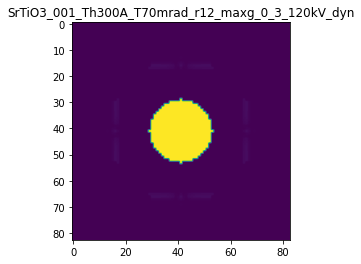

R-factor: 5.13501989852253e-06

>>> producing the 101. dataset...

The offset applied on thickness: 0.000648702603684435

The offset applied on Ug: 0.8052292322387896

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6487026036844
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

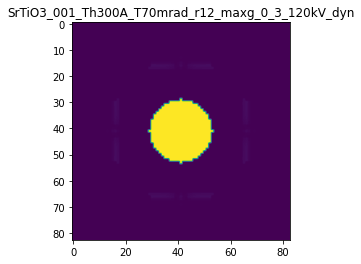

R-factor: 4.770316151994157e-06

>>> producing the 102. dataset...

The offset applied on thickness: -0.00018921599428046431

The offset applied on Ug: -0.42041334790463936

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81078400571954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

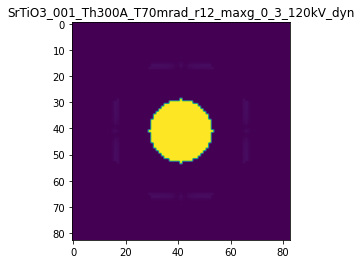

R-factor: 2.494363427198739e-06

>>> producing the 103. dataset...

The offset applied on thickness: 0.00039001942364167276

The offset applied on Ug: -1.0211900636048872

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39001942364166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

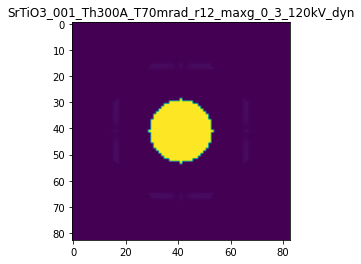

R-factor: 6.393851786609456e-06

>>> producing the 104. dataset...

The offset applied on thickness: -0.00058726219285491

The offset applied on Ug: -1.2575648364728964

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41273780714505
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

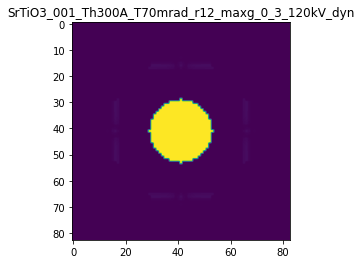

R-factor: 7.392399509574242e-06

>>> producing the 105. dataset...

The offset applied on thickness: -0.0007575521314858058

The offset applied on Ug: 0.5884187057800475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24244786851415
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

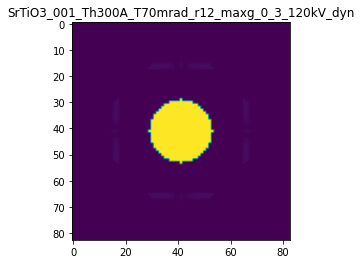

R-factor: 4.113077412501572e-06

>>> producing the 106. dataset...

The offset applied on thickness: -0.0007736014924855006

The offset applied on Ug: 0.6809748046318288

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2263985075145
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

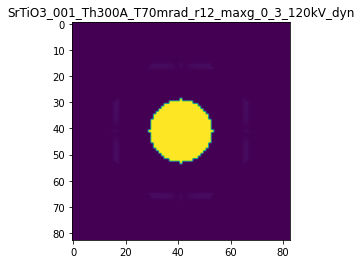

R-factor: 4.690277732440335e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.0006149878762305974

The offset applied on Ug: -0.5840836136835782

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6149878762306
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

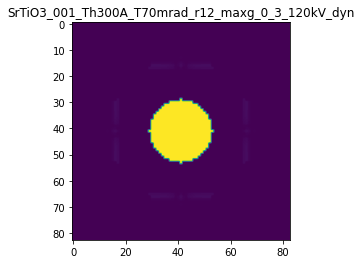

R-factor: 3.951644854763741e-06

>>> producing the 108. dataset...

The offset applied on thickness: -0.0004957677339688503

The offset applied on Ug: 0.3886443210634892

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5042322660311
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

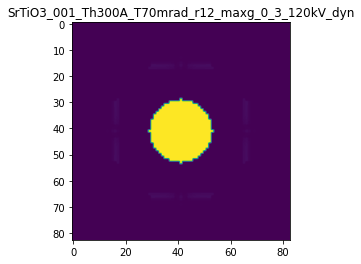

R-factor: 2.7111349332716313e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.00046509827179090716

The offset applied on Ug: -0.8365124954302863

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5349017282091
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

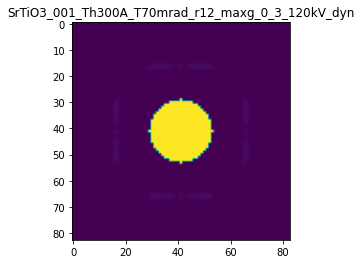

R-factor: 4.9307224526831395e-06

>>> producing the 110. dataset...

The offset applied on thickness: 0.00021774945946807534

The offset applied on Ug: 0.704810696956142

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21774945946805
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

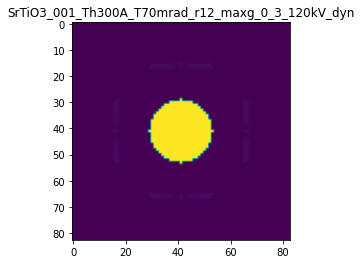

R-factor: 4.259008738291143e-06

>>> producing the 111. dataset...

The offset applied on thickness: -8.950183928047407e-05

The offset applied on Ug: -0.9598759968496083

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9104981607195
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

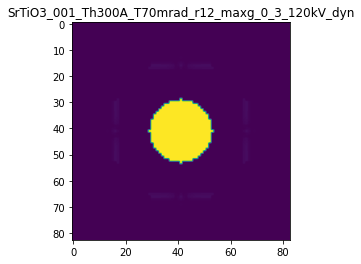

R-factor: 5.753868077672223e-06

>>> producing the 112. dataset...

The offset applied on thickness: 0.0005211571812978624

The offset applied on Ug: 0.595985176813164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52115718129784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

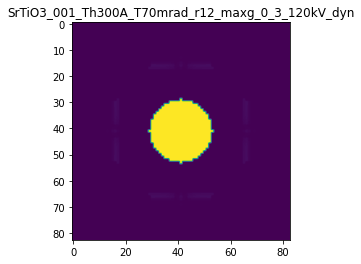

R-factor: 3.527790001407511e-06

>>> producing the 113. dataset...

The offset applied on thickness: 0.00034033738449047626

The offset applied on Ug: -0.9422276231411811

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34033738449045
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

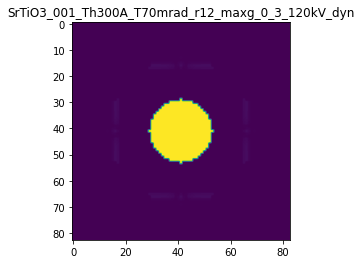

R-factor: 5.895285981472295e-06

>>> producing the 114. dataset...

The offset applied on thickness: -0.0008622661200350521

The offset applied on Ug: -0.27528632497673955

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.13773387996497
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

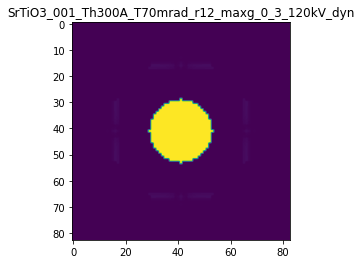

R-factor: 1.895316990451647e-06

>>> producing the 115. dataset...

The offset applied on thickness: 8.167941447132444e-05

The offset applied on Ug: 0.8932435384583707

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.08167941447135
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

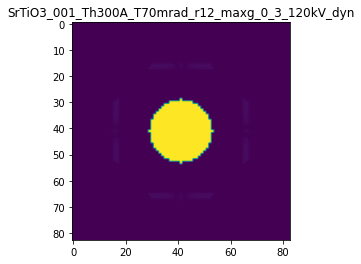

R-factor: 5.506082690502645e-06

>>> producing the 116. dataset...

The offset applied on thickness: -0.000861283713840193

The offset applied on Ug: -0.7733939691024785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.13871628615976
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

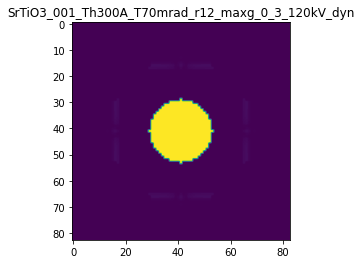

R-factor: 4.56767545710037e-06

>>> producing the 117. dataset...

The offset applied on thickness: 0.0008509615155775947

The offset applied on Ug: -1.0237830696717096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8509615155776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

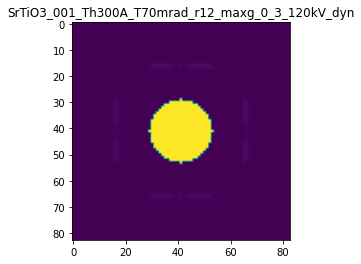

R-factor: 6.726359658409456e-06

>>> producing the 118. dataset...

The offset applied on thickness: -0.000884400171335793

The offset applied on Ug: 1.0420870513827973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1155998286642
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

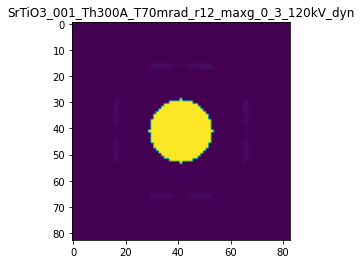

R-factor: 6.988109643860394e-06

>>> producing the 119. dataset...

The offset applied on thickness: -0.00021174297577014901

The offset applied on Ug: 0.4858089663252912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78825702422984
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

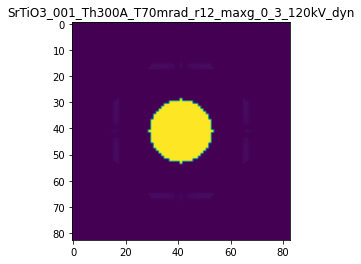

R-factor: 3.1213569157468742e-06

>>> producing the 120. dataset...

The offset applied on thickness: -3.721988040170165e-05

The offset applied on Ug: 0.1419442745144798

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9627801195983
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

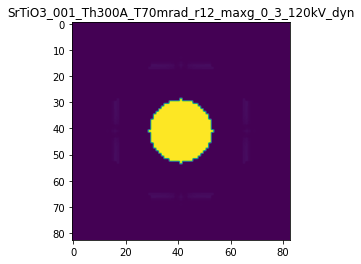

R-factor: 8.940716046108958e-07

>>> producing the 121. dataset...

The offset applied on thickness: 0.0009139559302175338

The offset applied on Ug: 0.8476937315494536

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9139559302175
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

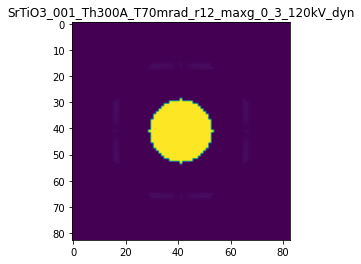

R-factor: 5.018642815392513e-06

>>> producing the 122. dataset...

The offset applied on thickness: 0.0009340654754128338

The offset applied on Ug: -0.6455546703356086

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93406547541286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

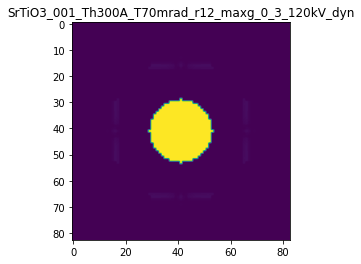

R-factor: 4.5525899018414094e-06

>>> producing the 123. dataset...

The offset applied on thickness: -0.0008023531551816499

The offset applied on Ug: 1.0203912024975532

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1976468448184
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

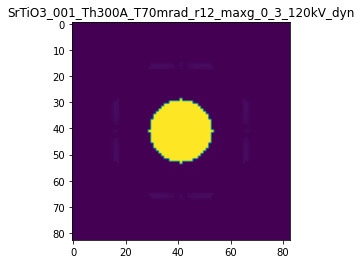

R-factor: 6.801472476735328e-06

>>> producing the 124. dataset...

The offset applied on thickness: -0.0003837670079419211

The offset applied on Ug: -0.855847550478197

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6162329920581
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

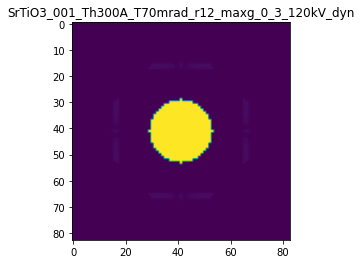

R-factor: 5.055183911107312e-06

>>> producing the 125. dataset...

The offset applied on thickness: -0.0007574441613570734

The offset applied on Ug: 0.1734293644629304

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2425558386429
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

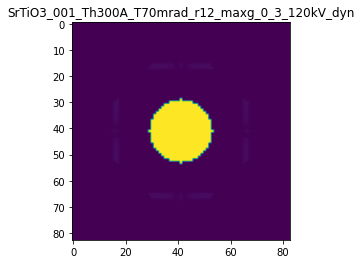

R-factor: 1.6644282919924326e-06

>>> producing the 126. dataset...

The offset applied on thickness: 0.0008622048553084676

The offset applied on Ug: -0.9404425584124675

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86220485530845
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

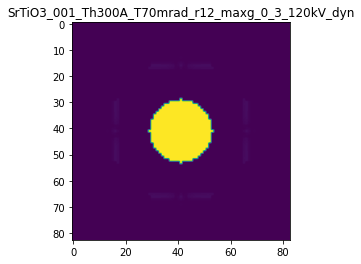

R-factor: 6.243344793841035e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.00029526658964481103

The offset applied on Ug: 0.5512899672527592

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29526658964477
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

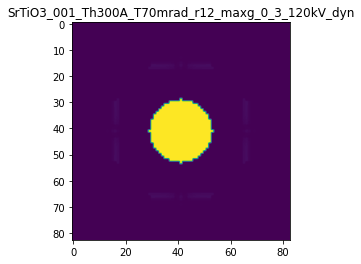

R-factor: 3.284876771370314e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.0006618550737575373

The offset applied on Ug: 1.0468185142403725

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6618550737575
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

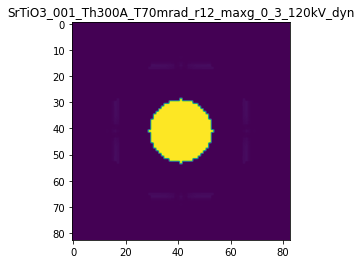

R-factor: 6.234494093740839e-06

>>> producing the 129. dataset...

The offset applied on thickness: 0.0005835661647257006

The offset applied on Ug: 0.6590734421245367

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5835661647257
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

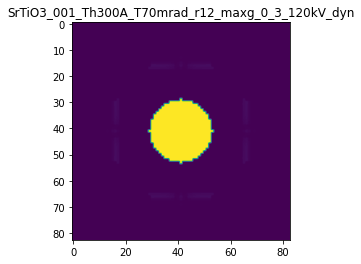

R-factor: 3.901783653916581e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.00013981288467571762

The offset applied on Ug: 0.46020466658390635

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13981288467573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

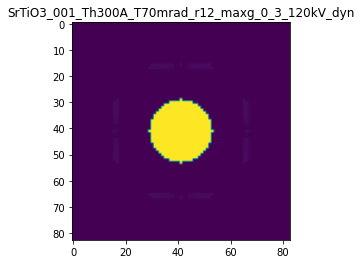

R-factor: 2.7739050809720445e-06

>>> producing the 131. dataset...

The offset applied on thickness: -0.0007431699371510648

The offset applied on Ug: 1.1212623656987675

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2568300628489
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

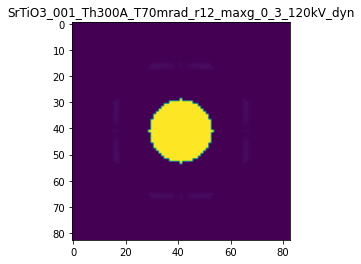

R-factor: 7.391150660727857e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0007062151081607262

The offset applied on Ug: 0.4236159361312622

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29378489183927
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

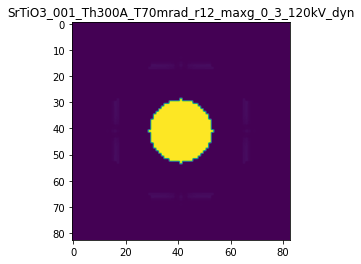

R-factor: 3.0770421203205772e-06

>>> producing the 133. dataset...

The offset applied on thickness: -0.00029537793489764106

The offset applied on Ug: 0.2933687502215747

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70462206510234
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

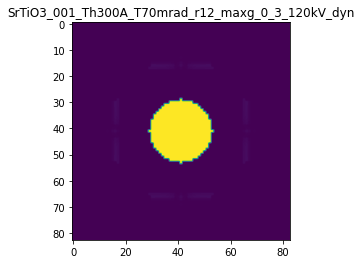

R-factor: 1.9906996040446125e-06

>>> producing the 134. dataset...

The offset applied on thickness: 0.0009493927969585552

The offset applied on Ug: -0.30999093347023776

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.94939279695853
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

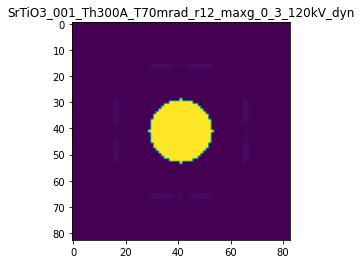

R-factor: 2.6122028240964608e-06

>>> producing the 135. dataset...

The offset applied on thickness: 6.943402266894295e-05

The offset applied on Ug: -0.7227066650915873

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06943402266893
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

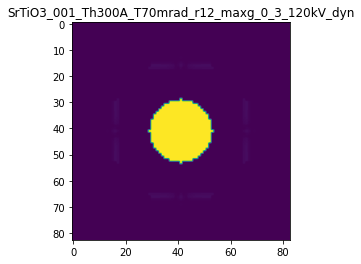

R-factor: 4.422639035890266e-06

>>> producing the 136. dataset...

The offset applied on thickness: -0.0009246975824038297

The offset applied on Ug: 0.3943683919384461

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07530241759616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

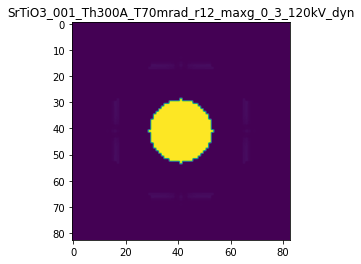

R-factor: 3.0796657215726823e-06

>>> producing the 137. dataset...

The offset applied on thickness: -0.0005825839792040228

The offset applied on Ug: 0.6614574987179285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41741602079594
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

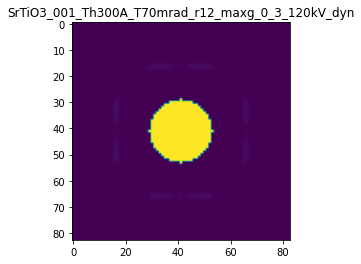

R-factor: 4.442100095519406e-06

>>> producing the 138. dataset...

The offset applied on thickness: 0.0005227694113315482

The offset applied on Ug: 0.24681143980796008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5227694113315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

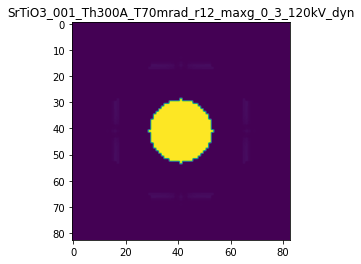

R-factor: 1.5424152978778151e-06

>>> producing the 139. dataset...

The offset applied on thickness: 0.0007927033991688375

The offset applied on Ug: -1.2617422379554668

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79270339916883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

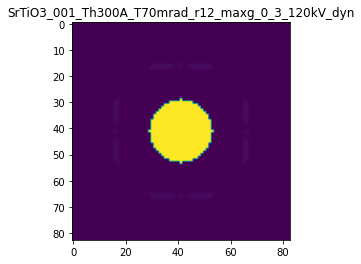

R-factor: 8.077563468839893e-06

>>> producing the 140. dataset...

The offset applied on thickness: -0.00045759960934336477

The offset applied on Ug: 0.282004261580704

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5424003906566
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

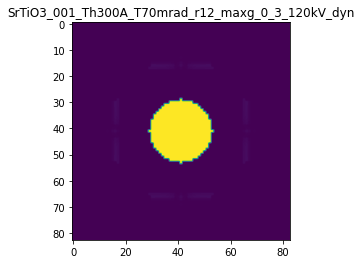

R-factor: 2.038008159959676e-06



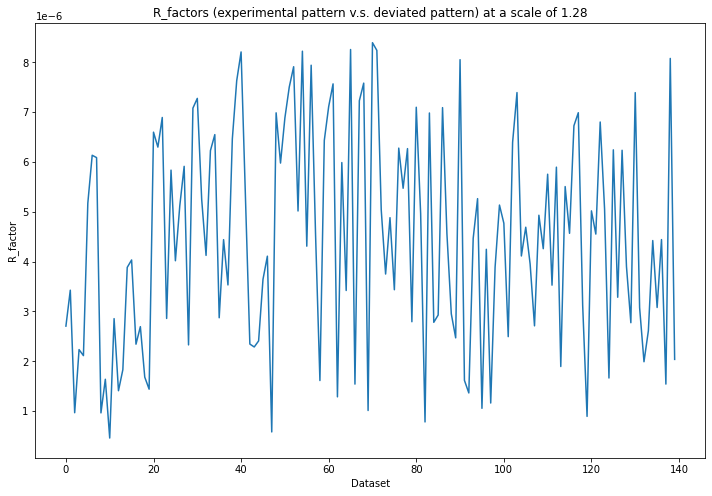

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 391ms/step - loss: 0.1993 - acc: 0.0000e+00 - val_loss: 0.1328 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 230ms/step - loss: 0.1123 - acc: 0.0000e+00 - val_loss: 0.0744 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 223ms/step - loss: 0.0578 - acc: 0.0000e+00 - val_loss: 0.0361 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 220ms/step - loss: 0.0296 - acc: 0.0000e+00 - val_loss: 0.0176 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 241ms/step - loss: 0.0129 - acc: 0.0000e+00 - val_loss: 0.0070 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 253ms/step - loss: 0.0051 - acc: 0.2000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 245ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

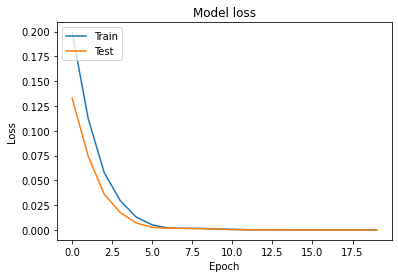

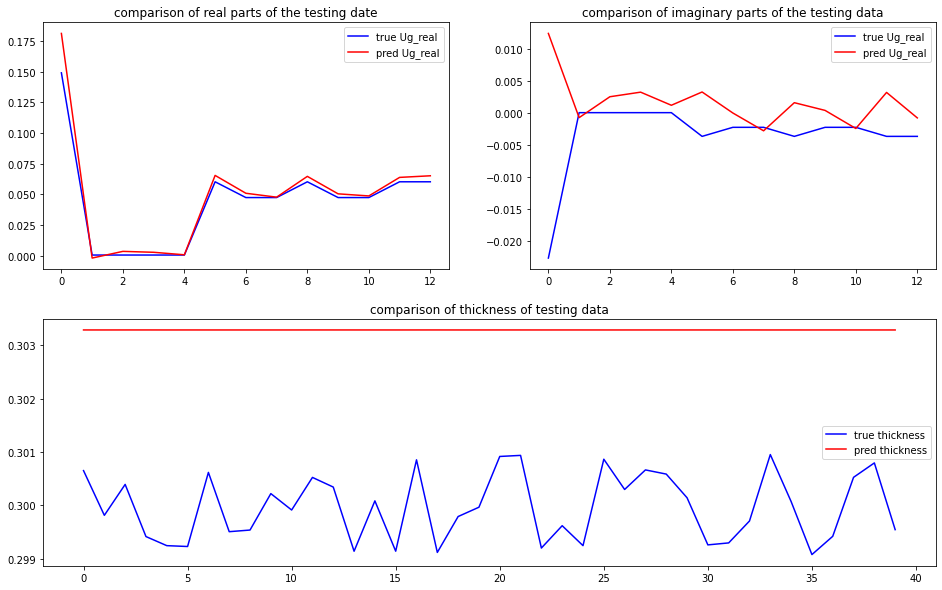

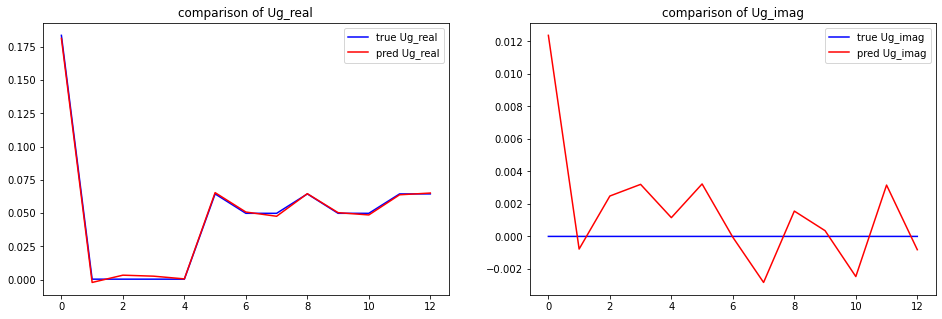

predicted thickness: 30.328470468521118 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=303.2847046852112
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18128994+0.j         0.00072

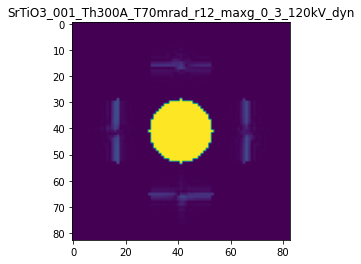

X_sim.max(): 0.999977067762867
R-factor at a scale of 1.28 is 0.0022913708809561705.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 2.56

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0008310819500232993

The offset applied on Ug: 2.030395291646183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
tar

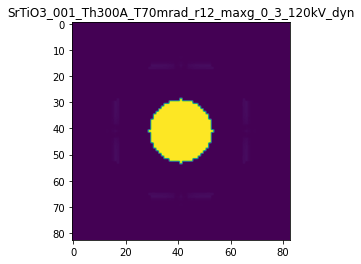

R-factor: 1.3138417064516568e-05

>>> producing the 2. dataset...

The offset applied on thickness: 0.0006035734300318108

The offset applied on Ug: 0.7365897839131571

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6035734300318
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

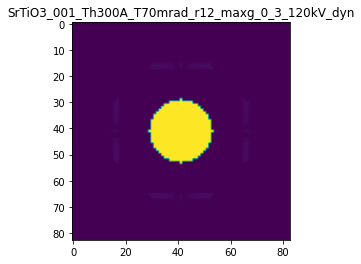

R-factor: 4.362693795038871e-06

>>> producing the 3. dataset...

The offset applied on thickness: 0.0003493064333031779

The offset applied on Ug: 1.0155608380101722

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3493064333031
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

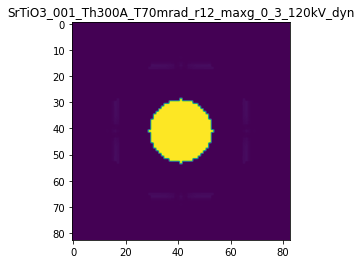

R-factor: 6.145277857889296e-06

>>> producing the 4. dataset...

The offset applied on thickness: -0.0006968530497481431

The offset applied on Ug: 0.4501600068994009

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30314695025186
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

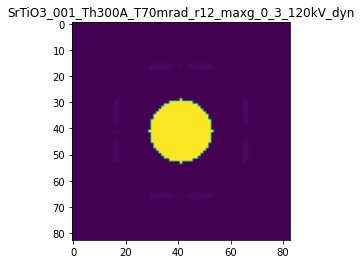

R-factor: 3.2299176603954114e-06

>>> producing the 5. dataset...

The offset applied on thickness: -0.00023278249891174596

The offset applied on Ug: 0.774930427526125

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7672175010883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

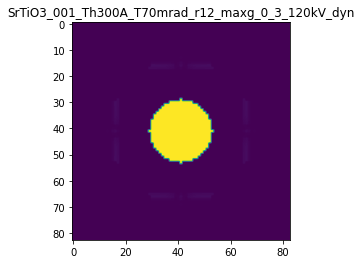

R-factor: 4.930099307457792e-06

>>> producing the 6. dataset...

The offset applied on thickness: 0.0005139435884573547

The offset applied on Ug: 2.5597140672752765

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5139435884573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

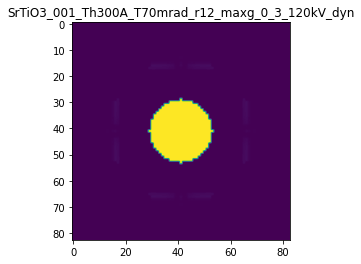

R-factor: 1.5855986634366803e-05

>>> producing the 7. dataset...

The offset applied on thickness: -0.0005940342074110101

The offset applied on Ug: -1.8512260491713404

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.405965792589
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

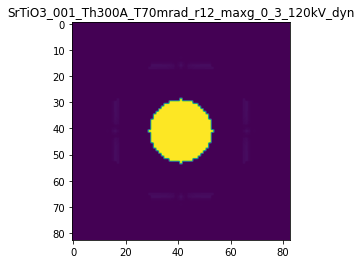

R-factor: 1.0832249450934464e-05

>>> producing the 8. dataset...

The offset applied on thickness: -0.0003069755726449506

The offset applied on Ug: -2.194712494317223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.693024427355
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

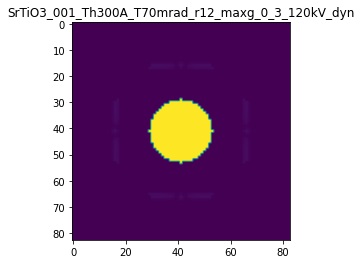

R-factor: 1.2847488515306225e-05

>>> producing the 9. dataset...

The offset applied on thickness: 0.0009274628525206558

The offset applied on Ug: 1.8280497757655894

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.92746285252065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

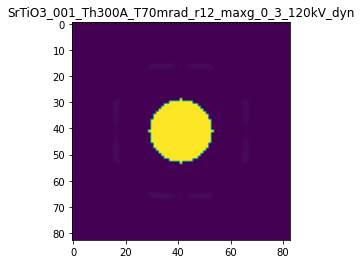

R-factor: 1.1020907462337312e-05

>>> producing the 10. dataset...

The offset applied on thickness: 0.00015873814822841626

The offset applied on Ug: 1.8630566404758566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1587381482284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

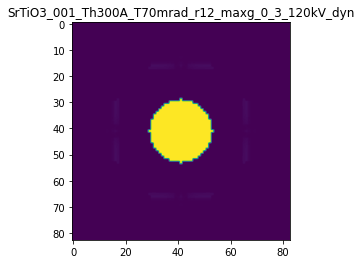

R-factor: 1.1590051273333877e-05

>>> producing the 11. dataset...

The offset applied on thickness: -0.00011347051995398472

The offset applied on Ug: -2.364477516018238

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.886529480046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

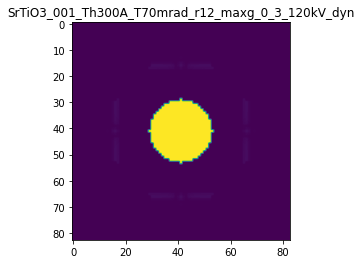

R-factor: 1.3857229509675933e-05

>>> producing the 12. dataset...

The offset applied on thickness: -0.0009956582242422569

The offset applied on Ug: 0.5590817874867253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0043417757577
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

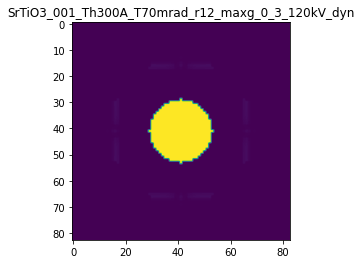

R-factor: 4.110725582364648e-06

>>> producing the 13. dataset...

The offset applied on thickness: 0.00012169945506805369

The offset applied on Ug: -0.5199288480396649

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12169945506804
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

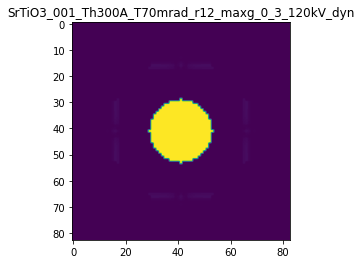

R-factor: 3.2354300261957847e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.0007319833768836268

The offset applied on Ug: 0.08590394176213181

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7319833768836
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

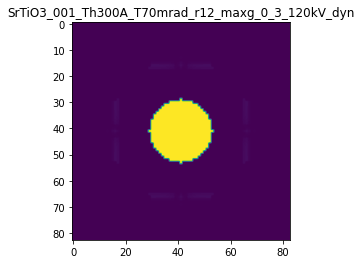

R-factor: 1.0558375307067455e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.000584960015707974

The offset applied on Ug: 2.0759998886418276

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58496001570796
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

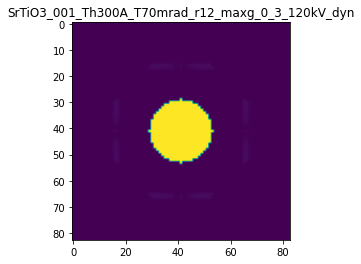

R-factor: 1.2747896321317465e-05

>>> producing the 16. dataset...

The offset applied on thickness: 0.0002865288960600054

The offset applied on Ug: -1.3379393685437748

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28652889606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

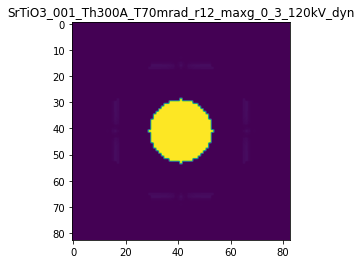

R-factor: 8.17898868529669e-06

>>> producing the 17. dataset...

The offset applied on thickness: -0.0005529577097039625

The offset applied on Ug: -2.2903047992224197

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.447042290296
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

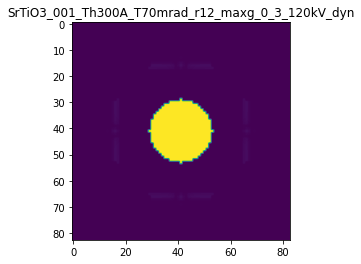

R-factor: 1.3334318325764148e-05

>>> producing the 18. dataset...

The offset applied on thickness: 0.0009519593071323938

The offset applied on Ug: 0.9240424225271994

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95195930713237
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

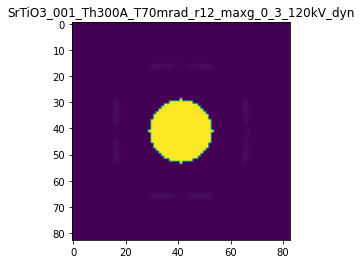

R-factor: 5.472175661767849e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.00035210807154026423

The offset applied on Ug: 0.13413634594196366

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3521080715403
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

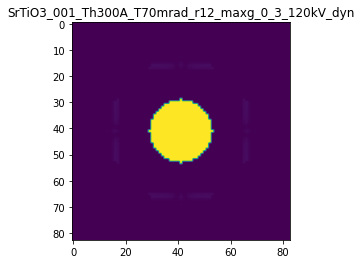

R-factor: 8.790088268434001e-07

>>> producing the 20. dataset...

The offset applied on thickness: 0.0005634989832414355

The offset applied on Ug: 0.7059960159432496

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5634989832414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

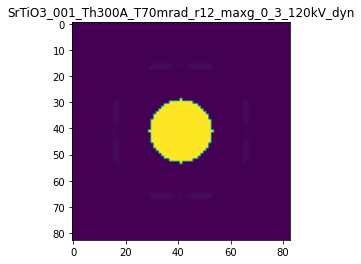

R-factor: 4.181527805469307e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.00033968064036716264

The offset applied on Ug: -0.3928096576303659

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6603193596328
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

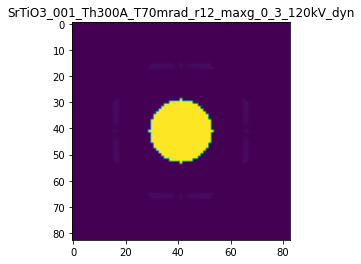

R-factor: 2.3149402260787657e-06

>>> producing the 22. dataset...

The offset applied on thickness: 0.0002482997259117523

The offset applied on Ug: 1.7365938347775733

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2482997259117
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

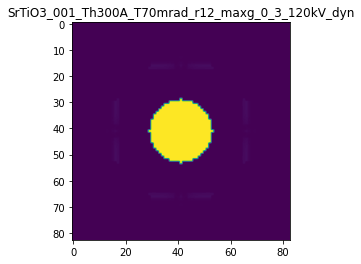

R-factor: 1.0747984115329838e-05

>>> producing the 23. dataset...

The offset applied on thickness: 0.00034879807499640746

The offset applied on Ug: 1.2106154444117294

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34879807499635
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

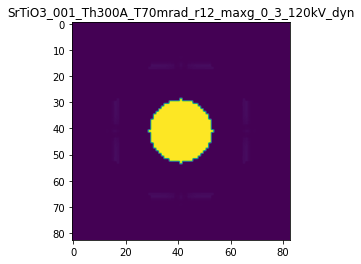

R-factor: 7.3748564681510086e-06

>>> producing the 24. dataset...

The offset applied on thickness: 0.0006413467214719482

The offset applied on Ug: 1.5455557108941644

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6413467214719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

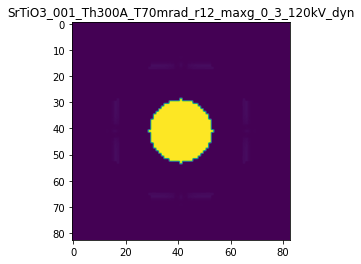

R-factor: 9.35667276798308e-06

>>> producing the 25. dataset...

The offset applied on thickness: 0.0002889881787006976

The offset applied on Ug: 2.1990985466314568

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2889881787007
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

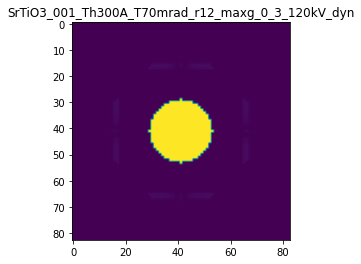

R-factor: 1.3662739920819685e-05

>>> producing the 26. dataset...

The offset applied on thickness: 4.127651740102878e-05

The offset applied on Ug: 1.1934306208132848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04127651740106
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

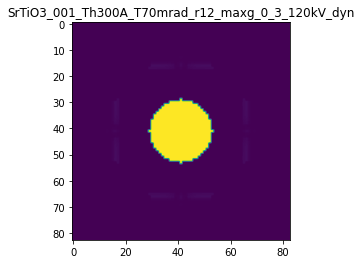

R-factor: 7.4136397379633535e-06

>>> producing the 27. dataset...

The offset applied on thickness: -0.0001741521470307563

The offset applied on Ug: -1.874260778028301

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8258478529692
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

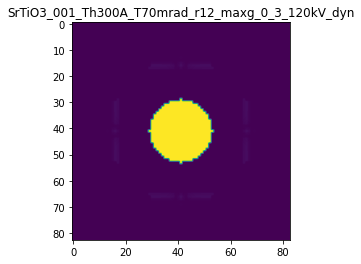

R-factor: 1.1060156216987043e-05

>>> producing the 28. dataset...

The offset applied on thickness: 0.0005564904624332634

The offset applied on Ug: 1.8845154932785984

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55649046243326
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

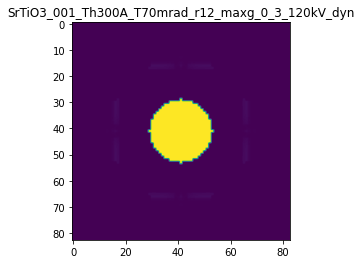

R-factor: 1.1544167805756039e-05

>>> producing the 29. dataset...

The offset applied on thickness: 0.0008698107279429372

The offset applied on Ug: 2.523397503573523

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86981072794293
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

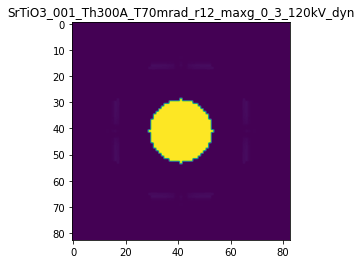

R-factor: 1.5473583487891554e-05

>>> producing the 30. dataset...

The offset applied on thickness: -6.258360903444426e-05

The offset applied on Ug: -0.8065771704392433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93741639096555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

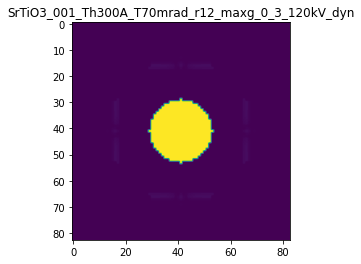

R-factor: 4.852275051886532e-06

>>> producing the 31. dataset...

The offset applied on thickness: -0.0009937458499432986

The offset applied on Ug: -0.9614003331016983

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0062541500567
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

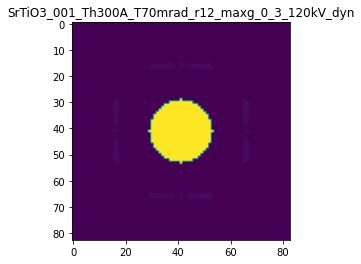

R-factor: 5.661812956723159e-06

>>> producing the 32. dataset...

The offset applied on thickness: 0.0009848725322094795

The offset applied on Ug: -2.0353696070072216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98487253220947
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

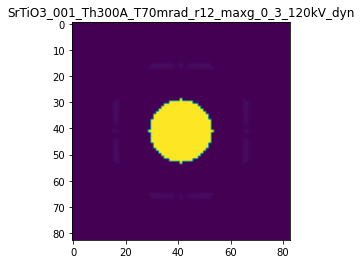

R-factor: 1.2608139078525106e-05

>>> producing the 33. dataset...

The offset applied on thickness: -0.0009959727815313927

The offset applied on Ug: 0.8821700080683684

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0040272184686
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

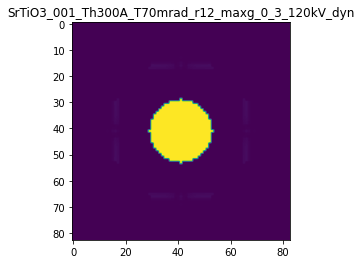

R-factor: 6.076131725620393e-06

>>> producing the 34. dataset...

The offset applied on thickness: 0.00016614673108355827

The offset applied on Ug: 1.929434528609837

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16614673108353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

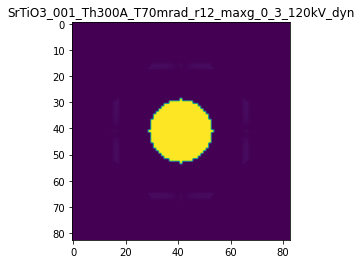

R-factor: 1.2006888342915328e-05

>>> producing the 35. dataset...

The offset applied on thickness: 0.0003757508205082638

The offset applied on Ug: -0.161336854683438

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.37575082050824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

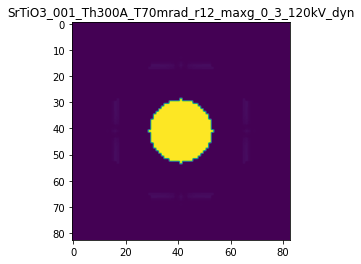

R-factor: 1.257379826885797e-06

>>> producing the 36. dataset...

The offset applied on thickness: -0.0003886301683326028

The offset applied on Ug: 2.1143481946343923

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6113698316674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

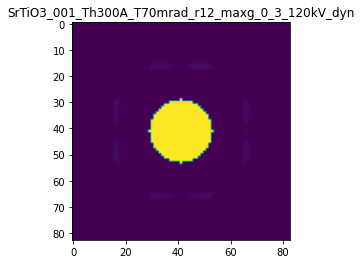

R-factor: 1.3440429093048777e-05

>>> producing the 37. dataset...

The offset applied on thickness: -0.00020413098188526568

The offset applied on Ug: -2.4247772173909516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.79586901811473
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

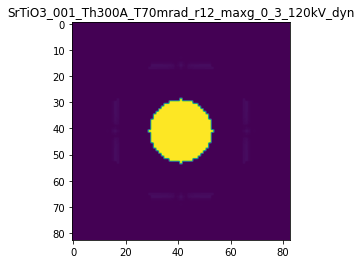

R-factor: 1.4167211740952085e-05

>>> producing the 38. dataset...

The offset applied on thickness: 0.0003877238492398765

The offset applied on Ug: 1.0315266652578094

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3877238492398
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

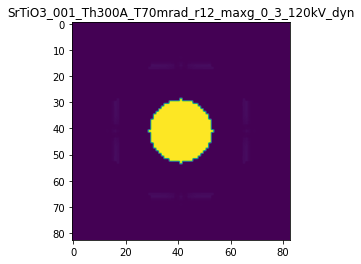

R-factor: 6.227475881054706e-06

>>> producing the 39. dataset...

The offset applied on thickness: -0.0004690375737296526

The offset applied on Ug: -1.8403441764339163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5309624262703
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

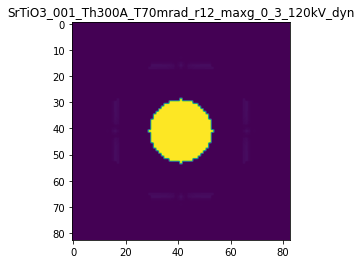

R-factor: 1.0790846900424916e-05

>>> producing the 40. dataset...

The offset applied on thickness: 0.0009344494512391178

The offset applied on Ug: -1.7767212368641998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9344494512391
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

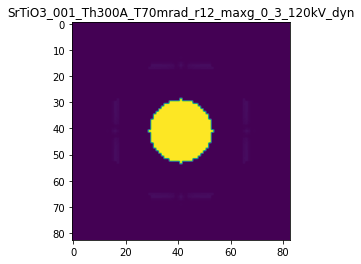

R-factor: 1.1127839110246261e-05

>>> producing the 41. dataset...

The offset applied on thickness: 0.0006360166907731484

The offset applied on Ug: -2.1899939254427214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6360166907731
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

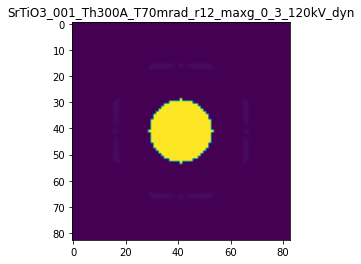

R-factor: 1.3213429473960659e-05

>>> producing the 42. dataset...

The offset applied on thickness: 0.0008489282513400607

The offset applied on Ug: 0.8768578238753599

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84892825134006
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

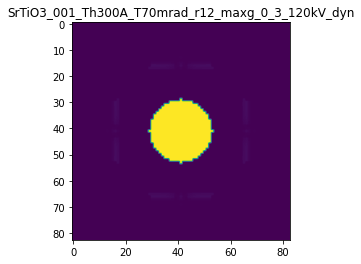

R-factor: 5.192887011688347e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.000659734499490666

The offset applied on Ug: -1.6761048699984895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34026550050936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

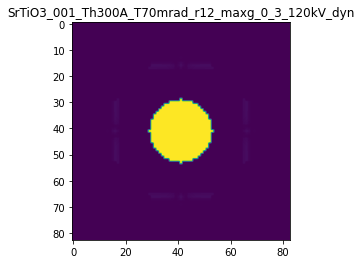

R-factor: 9.815514881009695e-06

>>> producing the 44. dataset...

The offset applied on thickness: -0.00016040575770187004

The offset applied on Ug: -2.0796024235159685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8395942422981
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

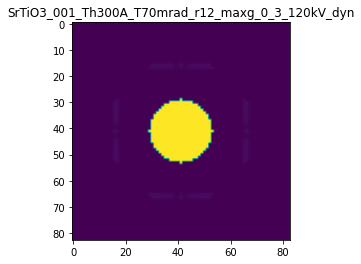

R-factor: 1.2236257905242416e-05

>>> producing the 45. dataset...

The offset applied on thickness: 0.0005740504854666497

The offset applied on Ug: 2.1375417179951

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57405048546667
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

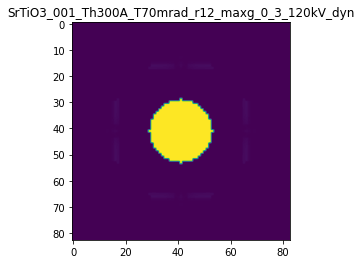

R-factor: 1.3144390735021575e-05

>>> producing the 46. dataset...

The offset applied on thickness: 0.00011623985525816738

The offset applied on Ug: 0.34424376446606914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.11623985525813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

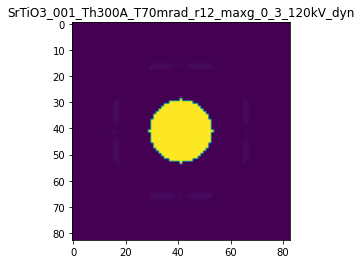

R-factor: 2.06797518845196e-06

>>> producing the 47. dataset...

The offset applied on thickness: -3.304243269510732e-05

The offset applied on Ug: 2.1554269986734726

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9669575673049
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

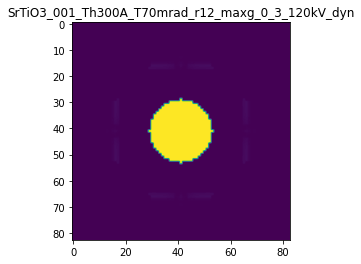

R-factor: 1.3531616468028248e-05

>>> producing the 48. dataset...

The offset applied on thickness: 0.0006412492772208225

The offset applied on Ug: 0.004773741993249132

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6412492772208
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

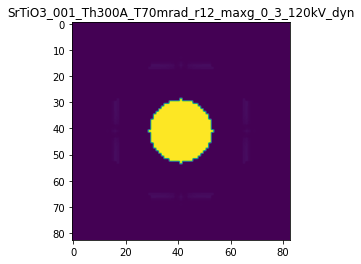

R-factor: 8.130713641735716e-07

>>> producing the 49. dataset...

The offset applied on thickness: -0.0003713354881602036

The offset applied on Ug: 2.449593272858782

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62866451183976
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

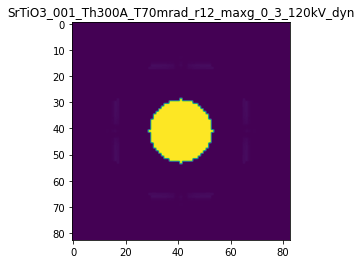

R-factor: 1.5555054629163477e-05

>>> producing the 50. dataset...

The offset applied on thickness: -0.000803102563799539

The offset applied on Ug: 2.14226807465199

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1968974362004
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

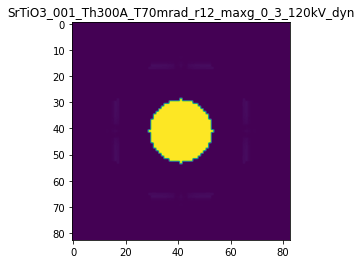

R-factor: 1.3826864858940195e-05

>>> producing the 51. dataset...

The offset applied on thickness: 0.0008577061660558725

The offset applied on Ug: -0.8520192519272576

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.85770616605583
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

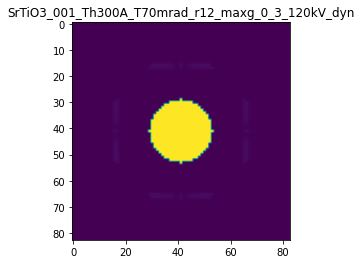

R-factor: 5.717682140541189e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.00036173242652280056

The offset applied on Ug: 0.5254383140935568

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3617324265228
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

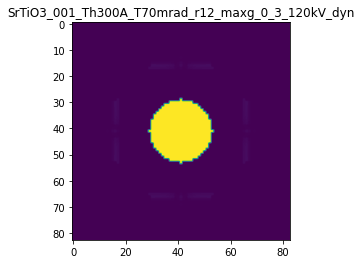

R-factor: 3.1163834711023193e-06

>>> producing the 53. dataset...

The offset applied on thickness: -0.0005095242904978121

The offset applied on Ug: 2.5108001889587492

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.49047570950216
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

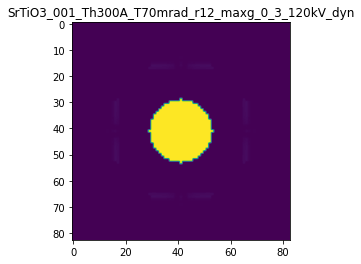

R-factor: 1.600782707777464e-05

>>> producing the 54. dataset...

The offset applied on thickness: -0.00018788608253172745

The offset applied on Ug: 0.5684913984903989

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81211391746825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

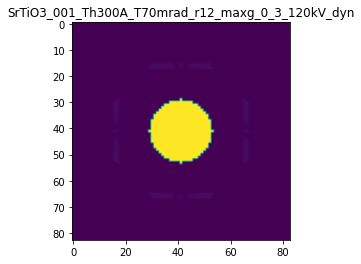

R-factor: 3.61979000239185e-06

>>> producing the 55. dataset...

The offset applied on thickness: 3.93453717710317e-05

The offset applied on Ug: 1.1402267219147006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.039345371771
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO

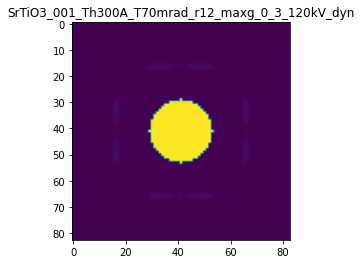

R-factor: 7.079463176744209e-06

>>> producing the 56. dataset...

The offset applied on thickness: -0.0006516458427422187

The offset applied on Ug: 1.1175689969753841

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34835415725775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

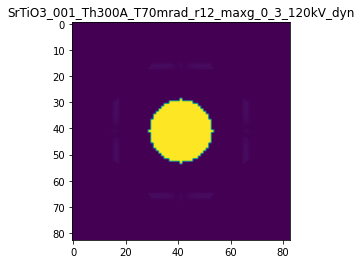

R-factor: 7.312334098161779e-06

>>> producing the 57. dataset...

The offset applied on thickness: -0.0006313281326017881

The offset applied on Ug: -0.9636348925578915

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3686718673982
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

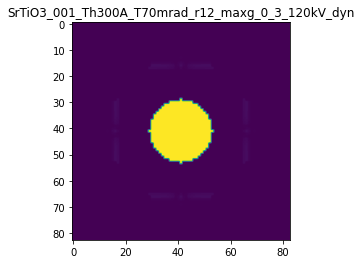

R-factor: 5.663232440983114e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0005794389454143587

The offset applied on Ug: -0.679819654649794

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4205610545856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

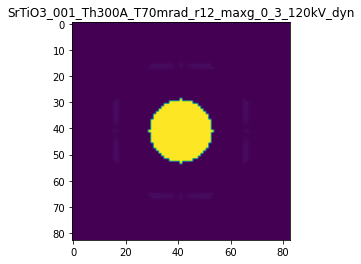

R-factor: 3.99802847590702e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.00013864543825078645

The offset applied on Ug: 0.22801816803794453

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86135456174924
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

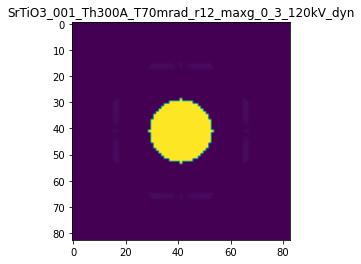

R-factor: 1.486343645848771e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.0009864585705890996

The offset applied on Ug: -0.16954424871221363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9864585705891
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

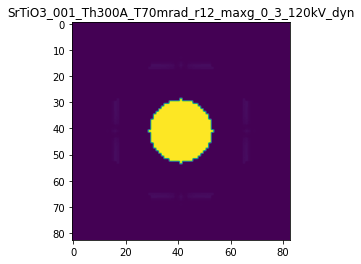

R-factor: 1.868820384961246e-06

>>> producing the 61. dataset...

The offset applied on thickness: -0.0005080266113275986

The offset applied on Ug: -1.8414071577517508

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4919733886724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

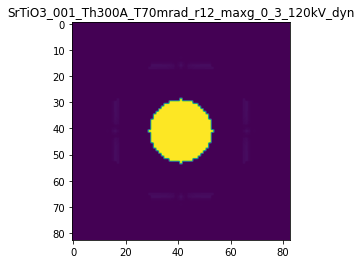

R-factor: 1.078866056043156e-05

>>> producing the 62. dataset...

The offset applied on thickness: 0.0008885661518662156

The offset applied on Ug: 0.6127623339180798

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8885661518662
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

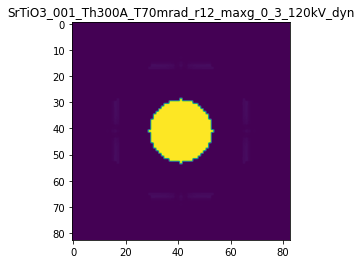

R-factor: 3.6564923306742505e-06

>>> producing the 63. dataset...

The offset applied on thickness: 0.0003461335859445209

The offset applied on Ug: 2.1451280034509796

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34613358594453
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

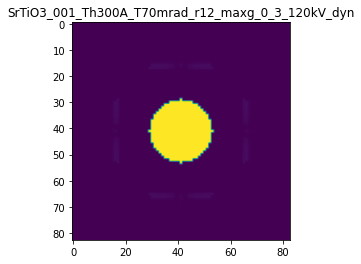

R-factor: 1.3294223603116319e-05

>>> producing the 64. dataset...

The offset applied on thickness: 0.0002745301365304207

The offset applied on Ug: -0.4368550036914428

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27453013653036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

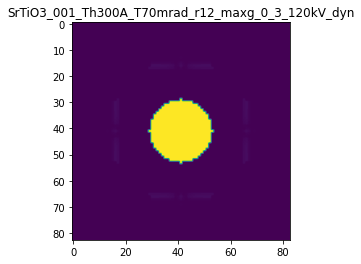

R-factor: 2.8327814950776828e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.00024277078211755755

The offset applied on Ug: -0.3477130451425012

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24277078211753
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

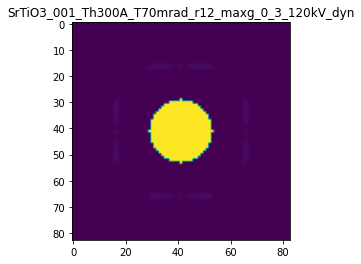

R-factor: 2.273450843466227e-06

>>> producing the 66. dataset...

The offset applied on thickness: -0.0005434952267459912

The offset applied on Ug: 2.331869400407742

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.456504773254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

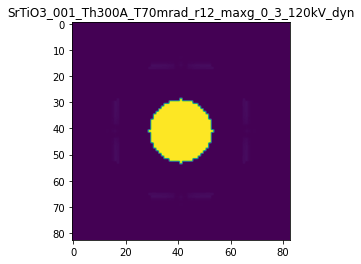

R-factor: 1.4892608599918116e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.0006257825478361457

The offset applied on Ug: 1.8884901117903434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.62578254783614
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

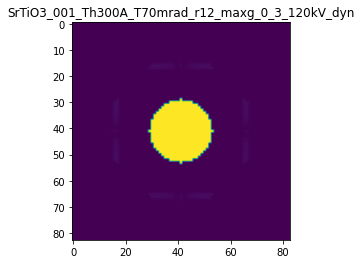

R-factor: 1.1537980533807228e-05

>>> producing the 68. dataset...

The offset applied on thickness: 0.00019136120282637736

The offset applied on Ug: 0.5942714142927928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.19136120282633
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

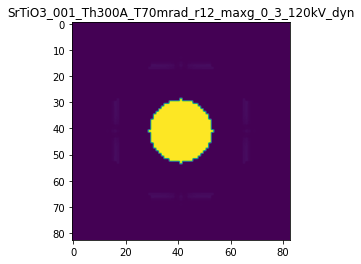

R-factor: 3.5829883831934396e-06

>>> producing the 69. dataset...

The offset applied on thickness: -0.0005443510333759394

The offset applied on Ug: 1.7832827411973518

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45564896662404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

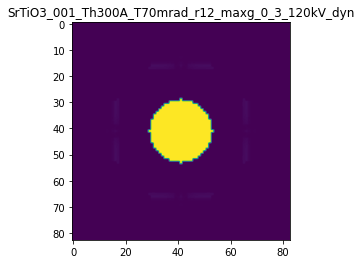

R-factor: 1.1430177317059118e-05

>>> producing the 70. dataset...

The offset applied on thickness: 0.0003668574846188508

The offset applied on Ug: 0.44603214055231377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36685748461883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

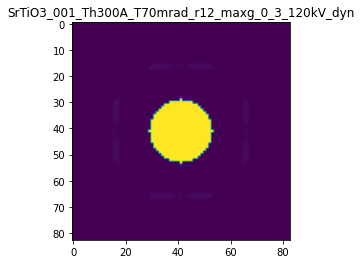

R-factor: 2.640223224662713e-06

>>> producing the 71. dataset...

The offset applied on thickness: -0.0007349015726442355

The offset applied on Ug: 1.3875549288341806

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2650984273558
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

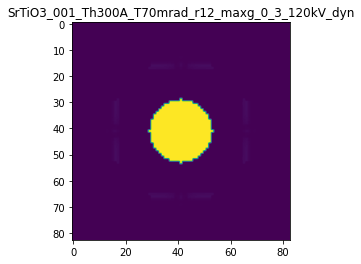

R-factor: 9.049597441376349e-06

>>> producing the 72. dataset...

The offset applied on thickness: 0.0007754146398068809

The offset applied on Ug: 2.4769029840899477

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7754146398069
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

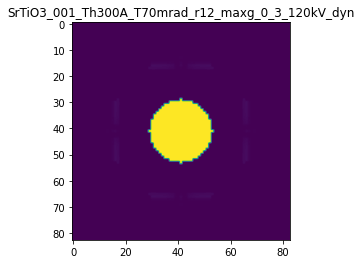

R-factor: 1.5217877091161161e-05

>>> producing the 73. dataset...

The offset applied on thickness: 0.0007551956567287903

The offset applied on Ug: 0.39393812860481375

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75519565672874
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

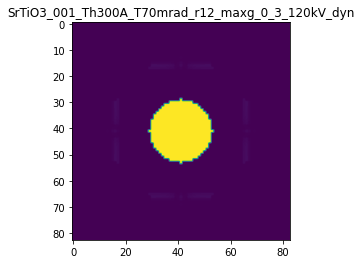

R-factor: 2.423337678421448e-06

>>> producing the 74. dataset...

The offset applied on thickness: -0.00033580377771232176

The offset applied on Ug: 0.4646770892542355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66419622228767
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

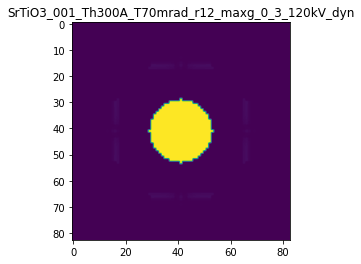

R-factor: 3.0690823807642054e-06

>>> producing the 75. dataset...

The offset applied on thickness: -3.620610395568602e-05

The offset applied on Ug: 0.3948998516852777

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9637938960443
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

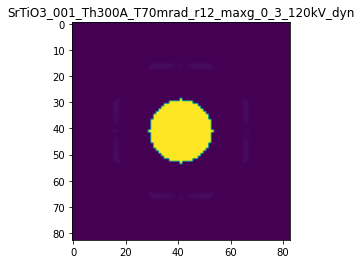

R-factor: 2.4577218313829642e-06

>>> producing the 76. dataset...

The offset applied on thickness: 0.000733653534650951

The offset applied on Ug: -2.397466963302701

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7336535346509
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

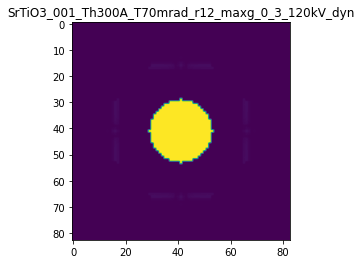

R-factor: 1.440812024145965e-05

>>> producing the 77. dataset...

The offset applied on thickness: 0.0009603070756756756

The offset applied on Ug: 1.5488872234744866

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96030707567564
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

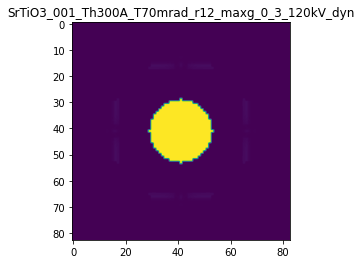

R-factor: 9.255970974355842e-06

>>> producing the 78. dataset...

The offset applied on thickness: -0.00039703104521667253

The offset applied on Ug: -1.8808636053552505

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6029689547833
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

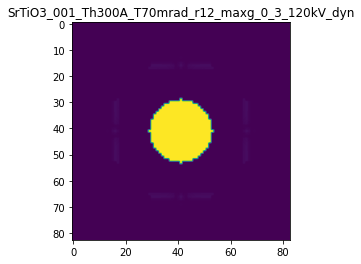

R-factor: 1.1040570666799292e-05

>>> producing the 79. dataset...

The offset applied on thickness: -0.00017428728452738906

The offset applied on Ug: -1.993176086333744

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8257127154726
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

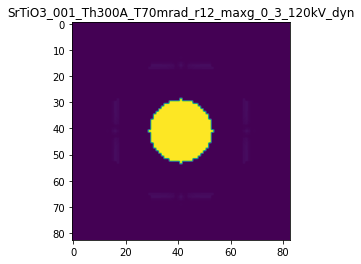

R-factor: 1.1739977822718697e-05

>>> producing the 80. dataset...

The offset applied on thickness: -0.0005155108208307911

The offset applied on Ug: -2.142159357383052

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4844891791692
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

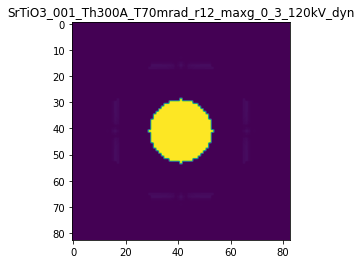

R-factor: 1.250312742894377e-05

>>> producing the 81. dataset...

The offset applied on thickness: -0.0004029273146854036

The offset applied on Ug: 0.4833403549712784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59707268531463
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

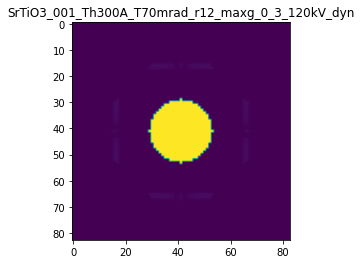

R-factor: 3.2276199918775626e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.0009603006182145406

The offset applied on Ug: -1.322412937998634

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03969938178545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

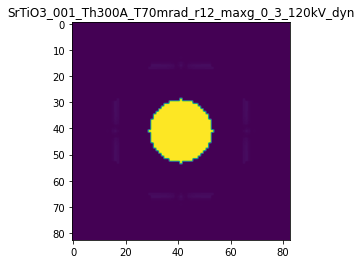

R-factor: 7.734674942920861e-06

>>> producing the 83. dataset...

The offset applied on thickness: 0.0002587660042172635

The offset applied on Ug: -2.5556557199182506

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25876600421725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

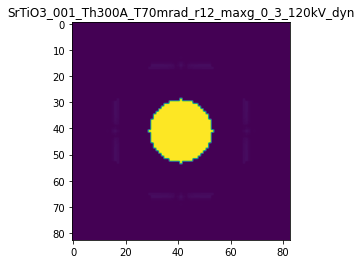

R-factor: 1.504648370365014e-05

>>> producing the 84. dataset...

The offset applied on thickness: -0.0003270932431974707

The offset applied on Ug: 0.59867441958614

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.67290675680255
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

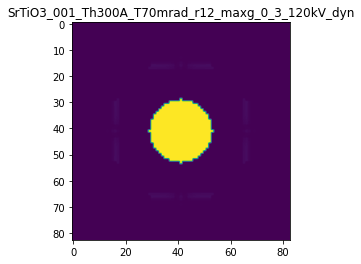

R-factor: 3.8909990469995495e-06

>>> producing the 85. dataset...

The offset applied on thickness: -0.000700661870494299

The offset applied on Ug: -0.0819373152145613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2993381295057
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

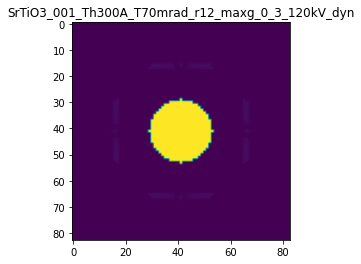

R-factor: 1.0103101765952344e-06

>>> producing the 86. dataset...

The offset applied on thickness: 0.0006871406688540279

The offset applied on Ug: 1.0513785587054547

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.687140668854
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

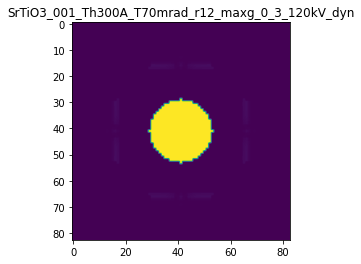

R-factor: 6.257099563909698e-06

>>> producing the 87. dataset...

The offset applied on thickness: -0.00014202013018067272

The offset applied on Ug: -1.6081818973032795

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8579798698193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

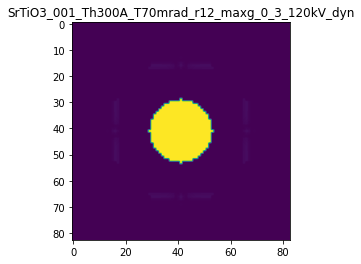

R-factor: 9.536663152569069e-06

>>> producing the 88. dataset...

The offset applied on thickness: 0.0006895318086963709

The offset applied on Ug: 0.6933549338184133

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.68953180869636
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

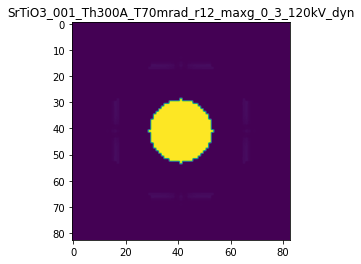

R-factor: 4.103699830464025e-06

>>> producing the 89. dataset...

The offset applied on thickness: -0.0008009991113542971

The offset applied on Ug: 0.7012530683403537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1990008886457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

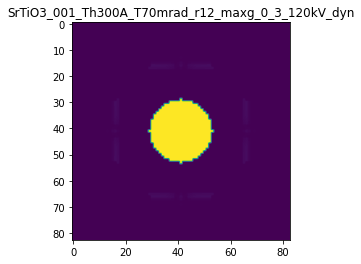

R-factor: 4.8333049452583234e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0009879389575808192

The offset applied on Ug: -1.8961627760369777

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0120610424192
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

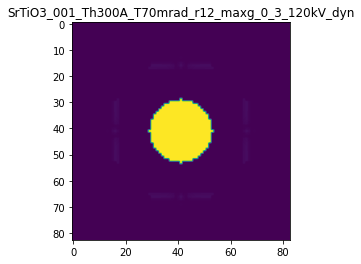

R-factor: 1.1038181918464129e-05

>>> producing the 91. dataset...

The offset applied on thickness: 0.00026790483919580634

The offset applied on Ug: 0.08905090369016193

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2679048391958
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

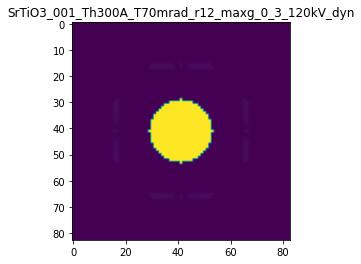

R-factor: 6.050884530582631e-07

>>> producing the 92. dataset...

The offset applied on thickness: 0.0009333579585450034

The offset applied on Ug: -2.1313967209038065

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.933357958545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

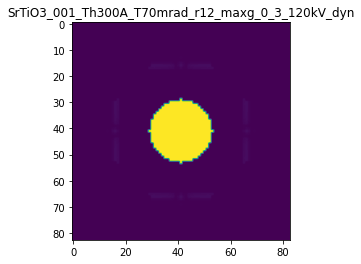

R-factor: 1.310021160885419e-05

>>> producing the 93. dataset...

The offset applied on thickness: -0.0002959185943181786

The offset applied on Ug: 1.9244707791386515

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70408140568185
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

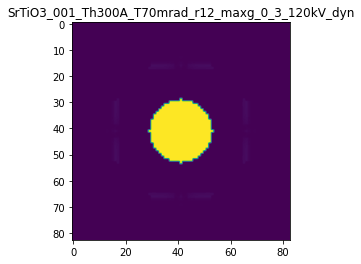

R-factor: 1.219537890999105e-05

>>> producing the 94. dataset...

The offset applied on thickness: -0.00035595553937480776

The offset applied on Ug: 0.3219841997185512

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6440444606252
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

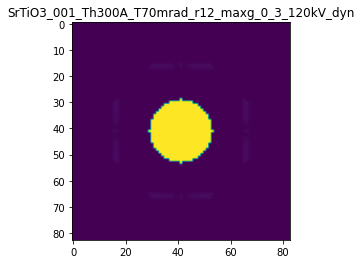

R-factor: 2.207071107349561e-06

>>> producing the 95. dataset...

The offset applied on thickness: 0.0008841661820457061

The offset applied on Ug: -0.33447563629325033

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8841661820457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

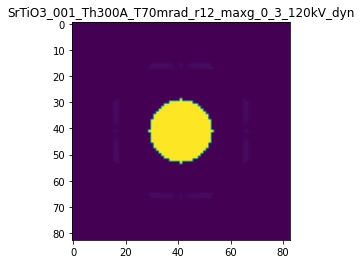

R-factor: 2.6957853135167008e-06

>>> producing the 96. dataset...

The offset applied on thickness: 0.00037575998059777716

The offset applied on Ug: -1.7163103181755475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.37575998059776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

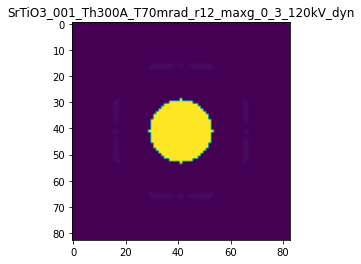

R-factor: 1.0403426800755548e-05

>>> producing the 97. dataset...

The offset applied on thickness: 0.00025158797640129337

The offset applied on Ug: -0.5961305838358658

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25158797640125
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

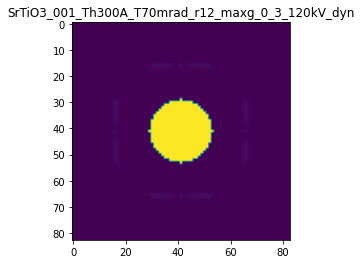

R-factor: 3.775337838384809e-06

>>> producing the 98. dataset...

The offset applied on thickness: 0.0008690830525463133

The offset applied on Ug: -0.9268105708275612

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8690830525463
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

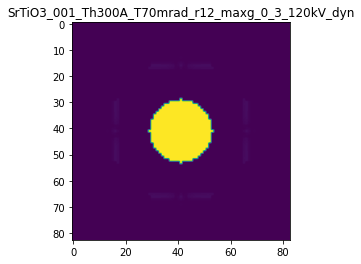

R-factor: 6.167764636511422e-06

>>> producing the 99. dataset...

The offset applied on thickness: 0.00020929082800200826

The offset applied on Ug: 0.9697972874127107

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.209290828002
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

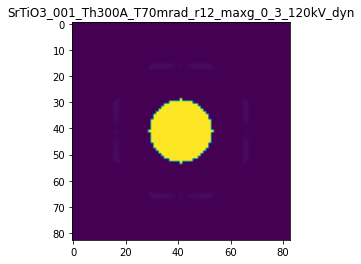

R-factor: 5.9247177281438695e-06

>>> producing the 100. dataset...

The offset applied on thickness: -0.0008959228894820919

The offset applied on Ug: 0.8199059729658291

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1040771105179
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

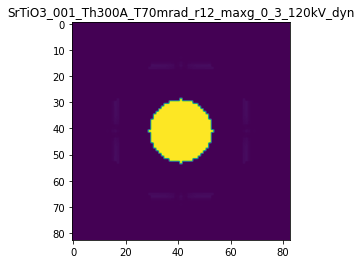

R-factor: 5.626096708766744e-06

>>> producing the 101. dataset...

The offset applied on thickness: 0.0006854536590754821

The offset applied on Ug: 1.669956521751343

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.68545365907545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

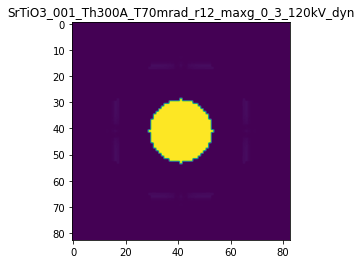

R-factor: 1.0125385892526169e-05

>>> producing the 102. dataset...

The offset applied on thickness: 0.0008756037925215012

The offset applied on Ug: 0.4103145248538925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8756037925215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

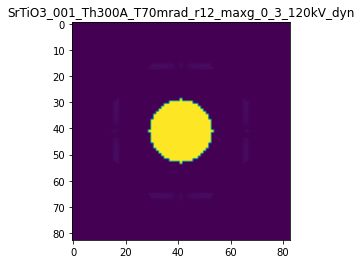

R-factor: 2.5633209897653386e-06

>>> producing the 103. dataset...

The offset applied on thickness: -0.00029463899705823524

The offset applied on Ug: 1.5287393452260818

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70536100294174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

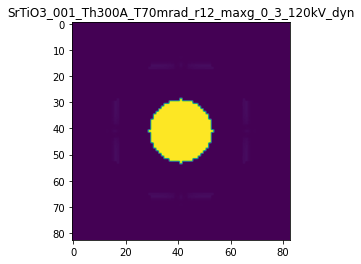

R-factor: 9.69635821778988e-06

>>> producing the 104. dataset...

The offset applied on thickness: -0.0007530139476526368

The offset applied on Ug: -1.6844943498757976

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2469860523473
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

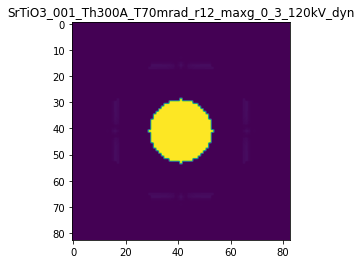

R-factor: 9.851236660617264e-06

>>> producing the 105. dataset...

The offset applied on thickness: -0.0004817490934497488

The offset applied on Ug: 2.5001252709387765

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5182509065503
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

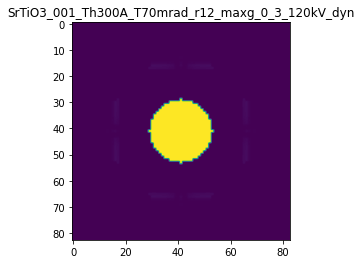

R-factor: 1.5927060713739068e-05

>>> producing the 106. dataset...

The offset applied on thickness: 0.0003588167258530053

The offset applied on Ug: -1.1652082715112682

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.358816725853
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

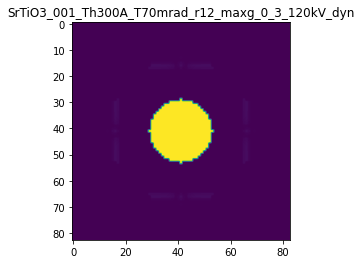

R-factor: 7.2189476987065005e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.0008733535159918384

The offset applied on Ug: 0.6666254162280035

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8733535159918
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

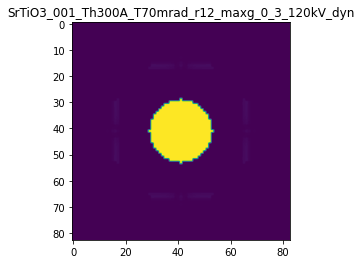

R-factor: 3.955522945078488e-06

>>> producing the 108. dataset...

The offset applied on thickness: -0.0005764519231204071

The offset applied on Ug: -1.4549485687208454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42354807687957
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

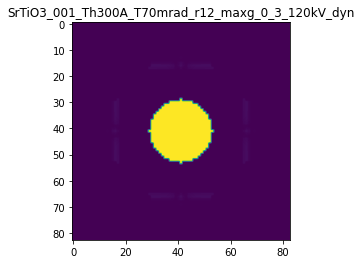

R-factor: 8.54503925760274e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0002794697840049827

The offset applied on Ug: -1.5459044032512497

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.720530215995
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

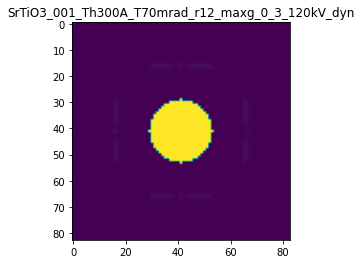

R-factor: 9.135546051490687e-06

>>> producing the 110. dataset...

The offset applied on thickness: -0.0006668330081816105

The offset applied on Ug: 1.3570721042718679

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3331669918184
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

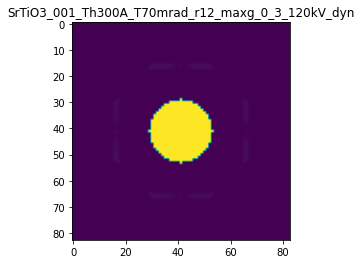

R-factor: 8.819193964815463e-06

>>> producing the 111. dataset...

The offset applied on thickness: -0.00030565065522368594

The offset applied on Ug: -0.5345349371384975

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6943493447763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

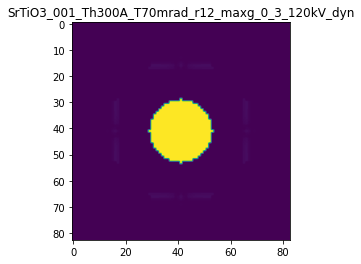

R-factor: 3.1577738802079896e-06

>>> producing the 112. dataset...

The offset applied on thickness: 2.7131792492283814e-05

The offset applied on Ug: -1.9828181202781008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0271317924923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

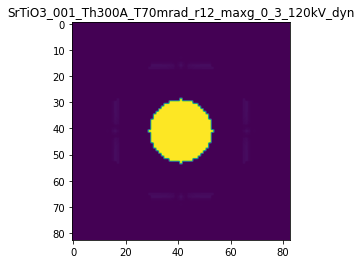

R-factor: 1.1746734477736166e-05

>>> producing the 113. dataset...

The offset applied on thickness: 0.0007137618524919606

The offset applied on Ug: 1.919221358614078

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7137618524919
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

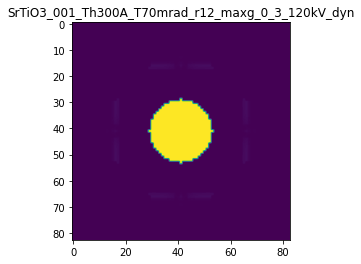

R-factor: 1.1694082264352426e-05

>>> producing the 114. dataset...

The offset applied on thickness: -0.0005872454297261163

The offset applied on Ug: -0.40522707637697525

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4127545702739
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

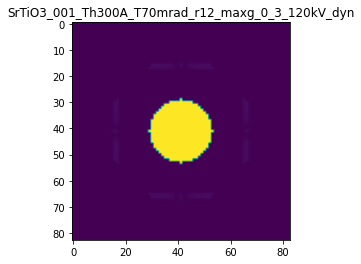

R-factor: 2.4328295448497365e-06

>>> producing the 115. dataset...

The offset applied on thickness: -0.0007621072981112398

The offset applied on Ug: -0.5831496665710262

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23789270188877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

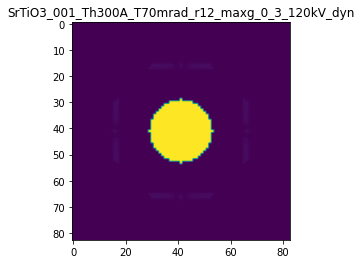

R-factor: 3.4746150907771625e-06

>>> producing the 116. dataset...

The offset applied on thickness: 0.0002173927478772717

The offset applied on Ug: 0.8897947862361906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2173927478773
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

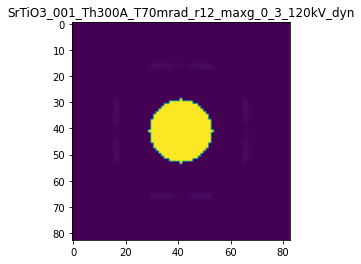

R-factor: 5.418175741428178e-06

>>> producing the 117. dataset...

The offset applied on thickness: -0.0001287504702695541

The offset applied on Ug: 0.637601735149376

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87124952973045
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

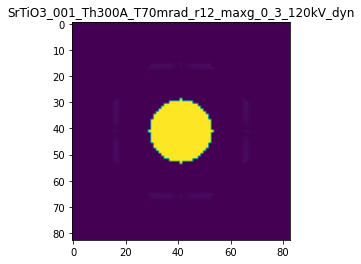

R-factor: 4.0167104336212886e-06

>>> producing the 118. dataset...

The offset applied on thickness: -0.0009411417725338252

The offset applied on Ug: -1.8178248238076367

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05885822746615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

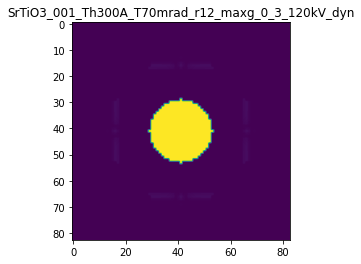

R-factor: 1.0594652125686985e-05

>>> producing the 119. dataset...

The offset applied on thickness: 0.0007893455077059206

The offset applied on Ug: 0.054340002374182746

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78934550770595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

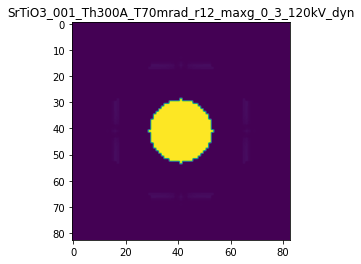

R-factor: 1.0709086570926495e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.00037177648858777526

The offset applied on Ug: 0.9999614683510037

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6282235114122
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

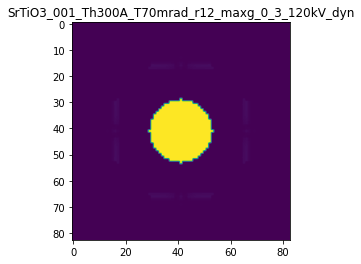

R-factor: 6.413551380286316e-06

>>> producing the 121. dataset...

The offset applied on thickness: -8.206552458106464e-05

The offset applied on Ug: 0.358010105841027

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9179344754189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

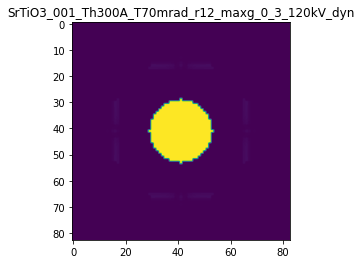

R-factor: 2.2540204104060596e-06

>>> producing the 122. dataset...

The offset applied on thickness: 0.00020549979499984028

The offset applied on Ug: -0.9587688168911973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2054997949998
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

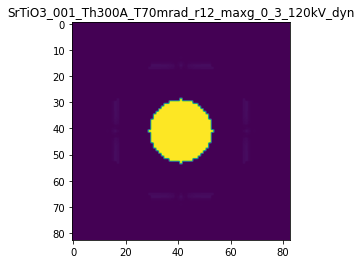

R-factor: 5.907807148584358e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.0006586278331339286

The offset applied on Ug: -2.5470478300697375

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6586278331339
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

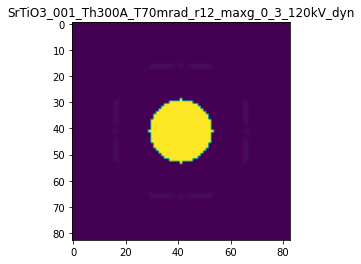

R-factor: 1.5178279528411647e-05

>>> producing the 124. dataset...

The offset applied on thickness: -0.0009793891287479507

The offset applied on Ug: 1.021085208730742

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.020610871252
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

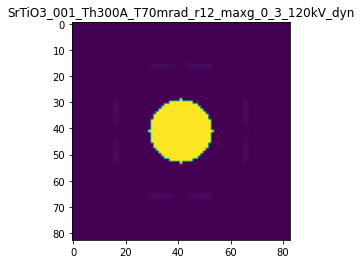

R-factor: 6.920312527654488e-06

>>> producing the 125. dataset...

The offset applied on thickness: 0.00048012080588821207

The offset applied on Ug: 1.8163068431079785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4801208058882
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

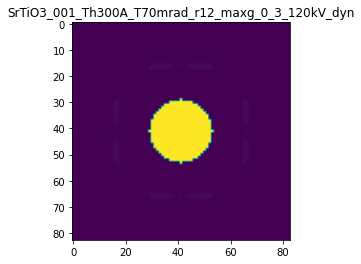

R-factor: 1.1146580047516153e-05

>>> producing the 126. dataset...

The offset applied on thickness: 0.0007520760590493241

The offset applied on Ug: -2.2215448572981784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7520760590493
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

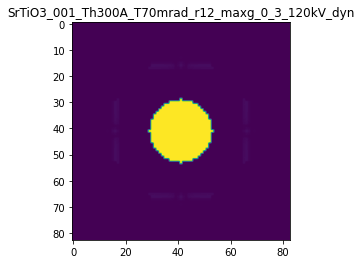

R-factor: 1.3464601364681097e-05

>>> producing the 127. dataset...

The offset applied on thickness: -0.0001118574015770839

The offset applied on Ug: 0.7072822992938183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8881425984229
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

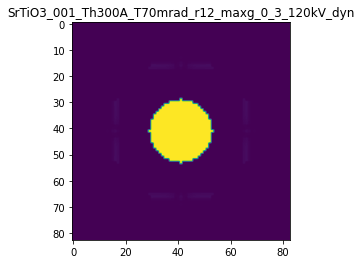

R-factor: 4.442117184739611e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.00038494235350050186

The offset applied on Ug: 0.4853526576683265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3849423535005
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

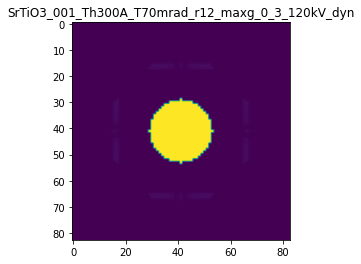

R-factor: 2.8736756618436417e-06

>>> producing the 129. dataset...

The offset applied on thickness: -0.0007402889312592524

The offset applied on Ug: 1.2385573671015953

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2597110687407
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

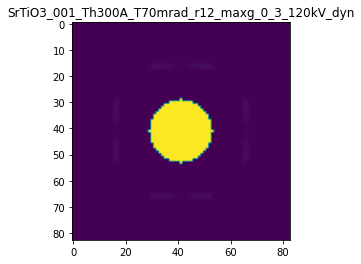

R-factor: 8.120662464980925e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.0009086689735624712

The offset applied on Ug: 1.9549184732770244

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.90866897356244
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

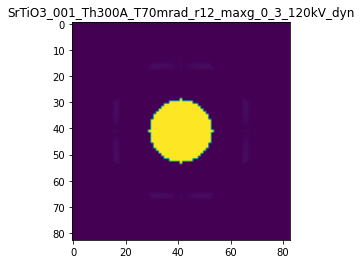

R-factor: 1.1835363324564171e-05

>>> producing the 131. dataset...

The offset applied on thickness: -0.0002919385031427031

The offset applied on Ug: 1.2862485645896964

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7080614968573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

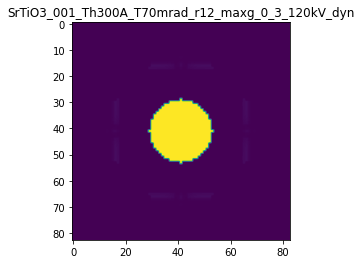

R-factor: 8.166899334901049e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0004950693999672959

The offset applied on Ug: -0.8377688663132489

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5049306000327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

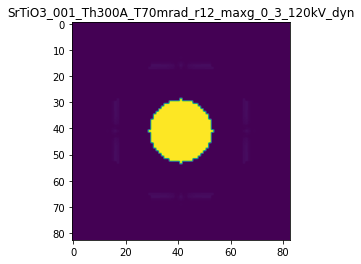

R-factor: 4.9351725450401075e-06

>>> producing the 133. dataset...

The offset applied on thickness: -0.0003013006288292037

The offset applied on Ug: -0.01119974900068428

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6986993711708
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

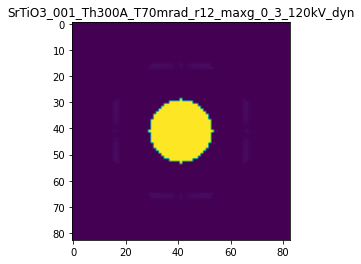

R-factor: 3.9305342122305883e-07

>>> producing the 134. dataset...

The offset applied on thickness: -2.9045158844840158e-05

The offset applied on Ug: 0.6961098455532164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97095484115516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

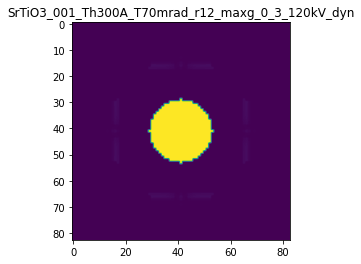

R-factor: 4.328530762635261e-06

>>> producing the 135. dataset...

The offset applied on thickness: -0.00028294168487466174

The offset applied on Ug: -2.151253482509899

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71705831512537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

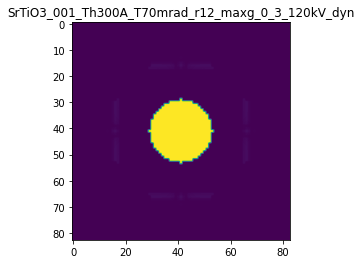

R-factor: 1.2608462064385997e-05

>>> producing the 136. dataset...

The offset applied on thickness: -0.0006593102244981972

The offset applied on Ug: 0.158375739471299

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34068977550174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

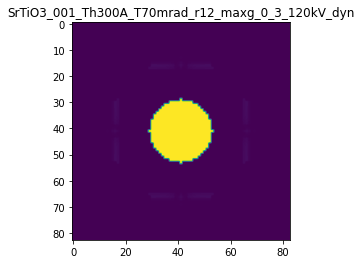

R-factor: 1.490326545307749e-06

>>> producing the 137. dataset...

The offset applied on thickness: 0.00028272611541661384

The offset applied on Ug: 1.5762899865288034

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2827261154166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

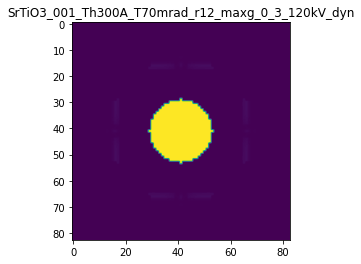

R-factor: 9.717315815056597e-06

>>> producing the 138. dataset...

The offset applied on thickness: 0.0005391182285792047

The offset applied on Ug: 0.0907453997134229

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5391182285792
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

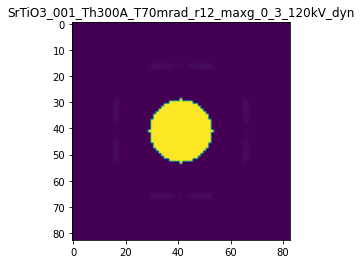

R-factor: 8.402394793047281e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0005383579724407281

The offset applied on Ug: -1.2060523623353174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.53835797244074
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

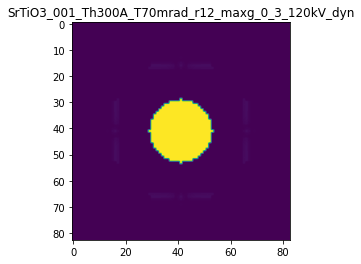

R-factor: 7.5772688016592424e-06

>>> producing the 140. dataset...

The offset applied on thickness: -0.000840891341380224

The offset applied on Ug: -1.7927833604555952

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1591086586198
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

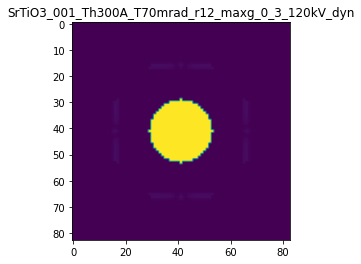

R-factor: 1.0462086047209999e-05



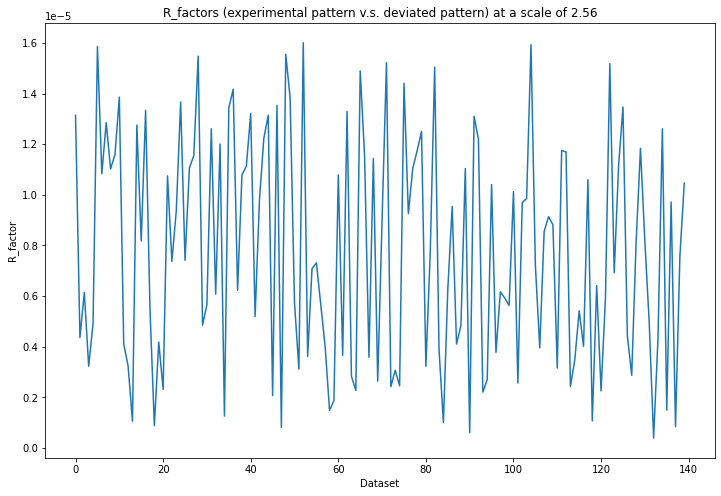

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 382ms/step - loss: 0.2116 - acc: 0.0000e+00 - val_loss: 0.1436 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 223ms/step - loss: 0.1223 - acc: 0.0000e+00 - val_loss: 0.0919 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 216ms/step - loss: 0.0738 - acc: 0.0000e+00 - val_loss: 0.0479 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 220ms/step - loss: 0.0372 - acc: 0.0000e+00 - val_loss: 0.0250 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 210ms/step - loss: 0.0186 - acc: 0.0000e+00 - val_loss: 0.0114 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 217ms/step - loss: 0.0074 - acc: 0.6000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 7/20
5/5 [==============================] - 1s 250ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 8/20
5/5 [=====

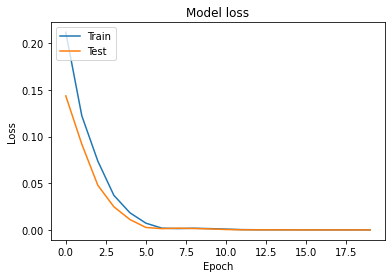

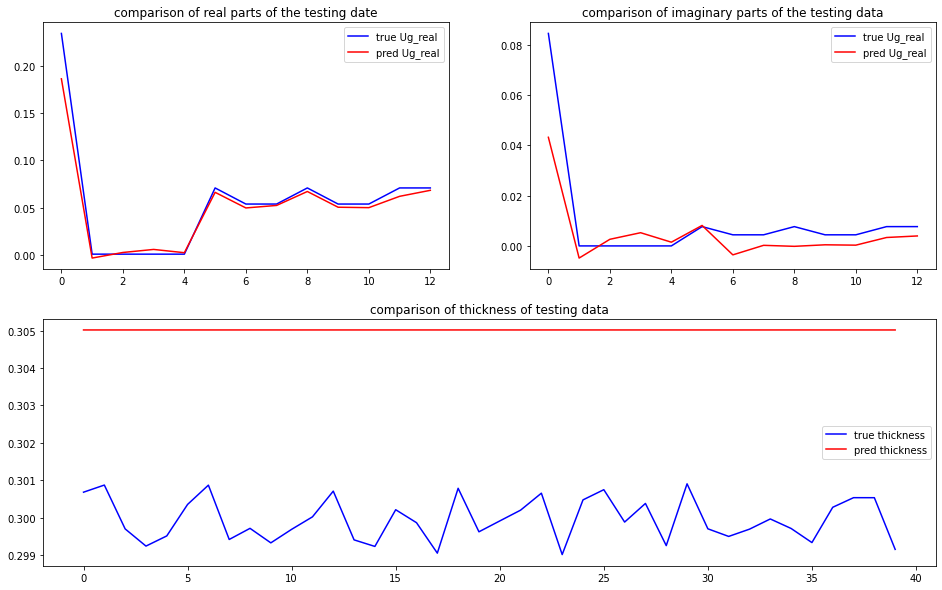

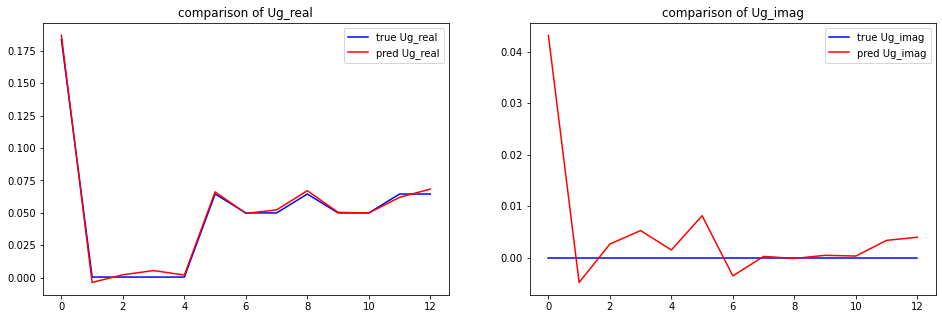

predicted thickness: 30.501508712768555 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=305.01508712768555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.18680082+0.j         -0.00

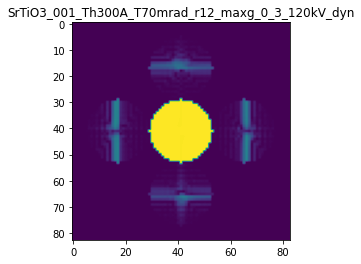

X_sim.max(): 0.9998597555105634
R-factor at a scale of 2.56 is 0.012342482186200905.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 5.12

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.00042253575484821603

The offset applied on Ug: 4.810606832889184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
tar

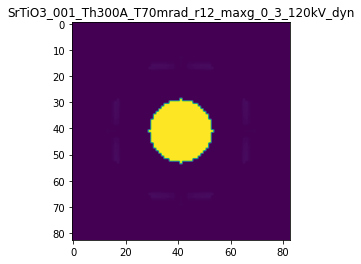

R-factor: 2.9984753000341472e-05

>>> producing the 2. dataset...

The offset applied on thickness: -0.0008878609716757118

The offset applied on Ug: -3.2415935199761248

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1121390283243
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

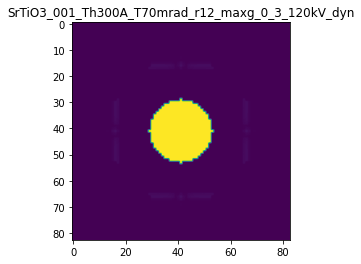

R-factor: 1.8548220022632064e-05

>>> producing the 3. dataset...

The offset applied on thickness: -0.00022428225173713124

The offset applied on Ug: 4.756136189569973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7757177482628
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

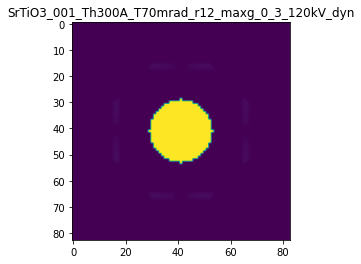

R-factor: 2.9904002033555497e-05

>>> producing the 4. dataset...

The offset applied on thickness: -0.0006816385453103983

The offset applied on Ug: -2.0658191710440623

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3183614546896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

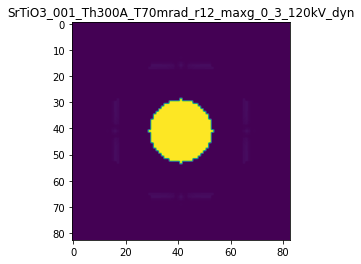

R-factor: 1.2044353450536622e-05

>>> producing the 5. dataset...

The offset applied on thickness: -0.0009211963758890007

The offset applied on Ug: 3.8727477987275107

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.078803624111
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

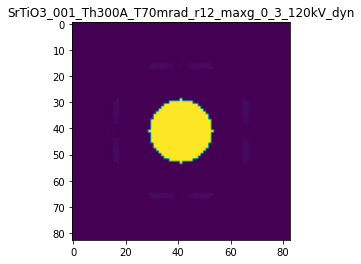

R-factor: 2.4744802263494135e-05

>>> producing the 6. dataset...

The offset applied on thickness: -4.286773628097884e-05

The offset applied on Ug: 1.7383635505837982

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.957132263719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

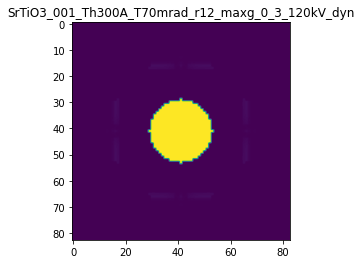

R-factor: 1.089567637784621e-05

>>> producing the 7. dataset...

The offset applied on thickness: -0.0007140519338764801

The offset applied on Ug: -2.898765039246921

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2859480661235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

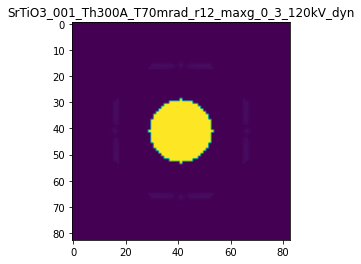

R-factor: 1.6701178232805046e-05

>>> producing the 8. dataset...

The offset applied on thickness: -0.00029654911998025035

The offset applied on Ug: -0.0931525251732387

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7034508800198
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

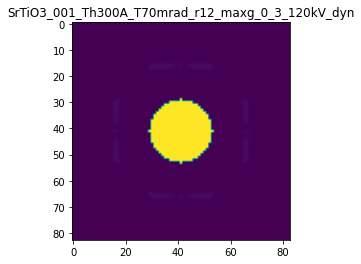

R-factor: 6.440818069293854e-07

>>> producing the 9. dataset...

The offset applied on thickness: -0.0001614915610955048

The offset applied on Ug: 0.3240669011727175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83850843890446
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

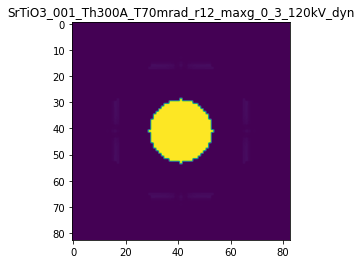

R-factor: 2.0916655356912566e-06

>>> producing the 10. dataset...

The offset applied on thickness: -0.000901567537644618

The offset applied on Ug: -0.440578033415909

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09843246235533
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

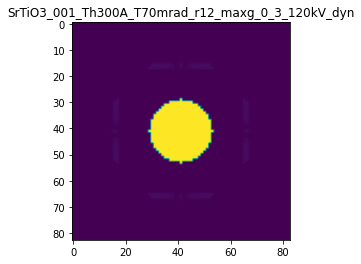

R-factor: 2.7503167244201206e-06

>>> producing the 11. dataset...

The offset applied on thickness: -0.0002909379743825562

The offset applied on Ug: -4.667487980543589

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7090620256174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

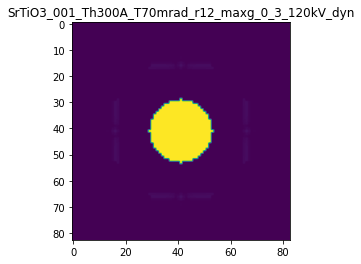

R-factor: 2.6015507395999586e-05

>>> producing the 12. dataset...

The offset applied on thickness: 0.000604347096859092

The offset applied on Ug: 3.677964238254327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60434709685904
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

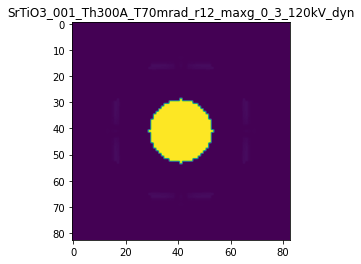

R-factor: 2.2885696247738064e-05

>>> producing the 13. dataset...

The offset applied on thickness: 0.00026766202584255504

The offset applied on Ug: -0.6055193919519752

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2676620258425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

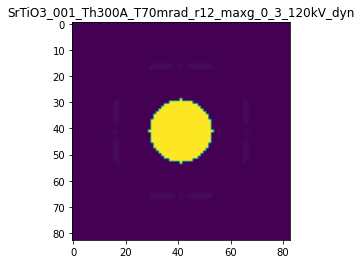

R-factor: 3.8421791630361515e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.000923862674834014

The offset applied on Ug: -1.0440652645202624

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.923862674834
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

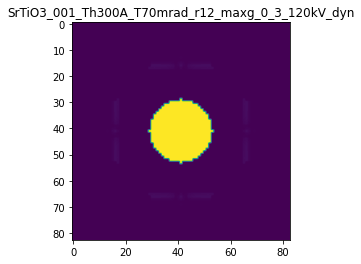

R-factor: 6.897197814333426e-06

>>> producing the 15. dataset...

The offset applied on thickness: -0.00041788468242098456

The offset applied on Ug: 3.6008285202048946

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.582115317579
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

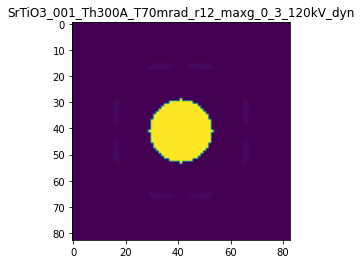

R-factor: 2.282595494780041e-05

>>> producing the 16. dataset...

The offset applied on thickness: -0.0009763104746428195

The offset applied on Ug: -0.05490984058460299

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02368952535716
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

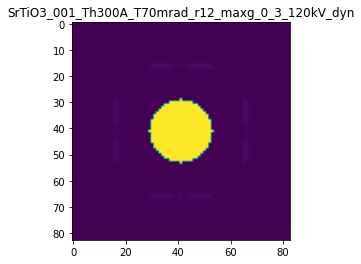

R-factor: 1.2989414098848722e-06

>>> producing the 17. dataset...

The offset applied on thickness: -0.000287878290882023

The offset applied on Ug: -1.1699033546964426

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.712121709118
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

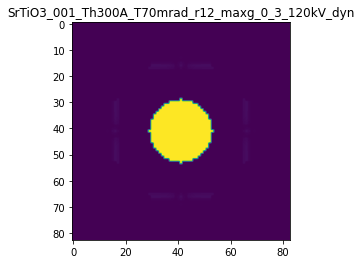

R-factor: 6.932747514040914e-06

>>> producing the 18. dataset...

The offset applied on thickness: 0.0009408352229557528

The offset applied on Ug: -2.5912618331642965

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.94083522295574
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

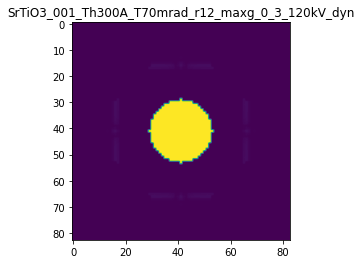

R-factor: 1.5584266260780207e-05

>>> producing the 19. dataset...

The offset applied on thickness: -0.0003869044863852742

The offset applied on Ug: 3.4496190674686944

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6130955136147
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

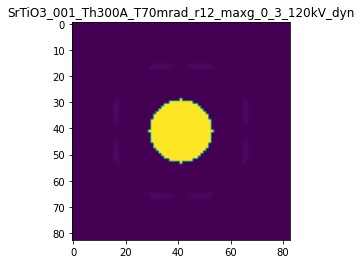

R-factor: 2.1866187416880013e-05

>>> producing the 20. dataset...

The offset applied on thickness: -0.00028700769248319946

The offset applied on Ug: -1.148977286361576

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7129923075168
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

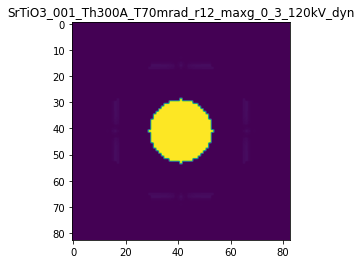

R-factor: 6.809663279431164e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.0001174678694243363

The offset applied on Ug: -2.8452355749683536

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88253213057567
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

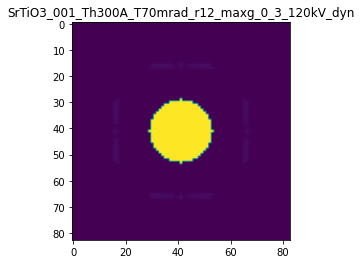

R-factor: 1.652527867268197e-05

>>> producing the 22. dataset...

The offset applied on thickness: -0.000705965080587842

The offset applied on Ug: -1.3027203985521056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2940349194121
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

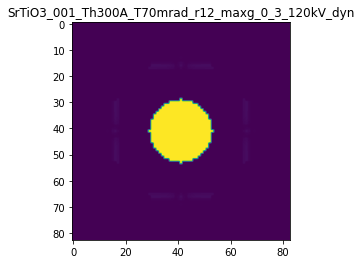

R-factor: 7.642129772817108e-06

>>> producing the 23. dataset...

The offset applied on thickness: -0.00013280641295395412

The offset applied on Ug: -1.3439352267755293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8671935870461
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

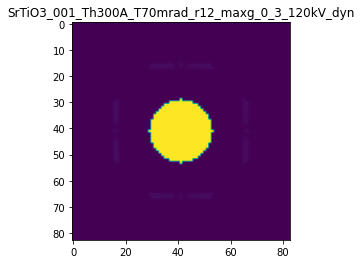

R-factor: 8.000761530427168e-06

>>> producing the 24. dataset...

The offset applied on thickness: -0.0005777196860903477

The offset applied on Ug: -1.4842754379599763

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42228031390965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

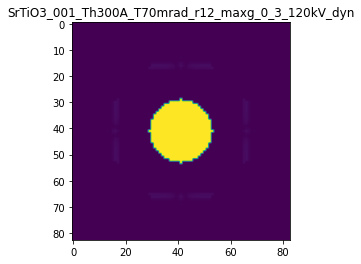

R-factor: 8.715378344344829e-06

>>> producing the 25. dataset...

The offset applied on thickness: -8.50205298648541e-05

The offset applied on Ug: -5.057408535794743

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9149794701351
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

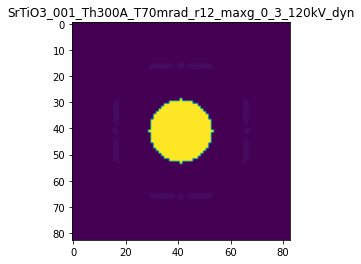

R-factor: 2.792666802589854e-05

>>> producing the 26. dataset...

The offset applied on thickness: -0.0006709625273595408

The offset applied on Ug: 4.157223687243993

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32903747264044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

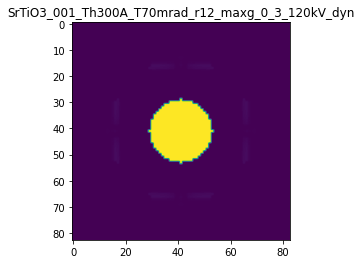

R-factor: 2.6399806816175345e-05

>>> producing the 27. dataset...

The offset applied on thickness: 0.0009053319755064973

The offset applied on Ug: 4.101861714703073

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9053319755065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

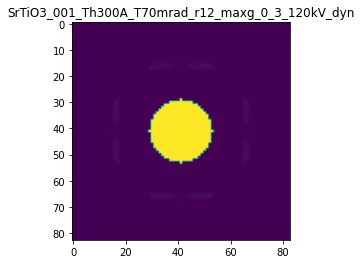

R-factor: 2.542014258521521e-05

>>> producing the 28. dataset...

The offset applied on thickness: -0.0004706537985998016

The offset applied on Ug: -1.3326430314034325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5293462014002
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

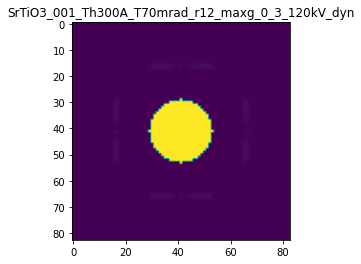

R-factor: 7.848255257143573e-06

>>> producing the 29. dataset...

The offset applied on thickness: 1.7370446093000204e-05

The offset applied on Ug: -4.58191113060754

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.017370446093
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

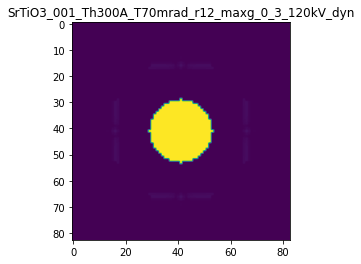

R-factor: 2.5620001811821288e-05

>>> producing the 30. dataset...

The offset applied on thickness: 0.00023477785060282576

The offset applied on Ug: 2.5965569277563043

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2347778506028
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

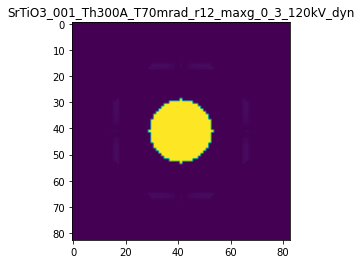

R-factor: 1.6210936389558566e-05

>>> producing the 31. dataset...

The offset applied on thickness: -0.0004257776196859038

The offset applied on Ug: 2.635049215764245

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57422238031404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

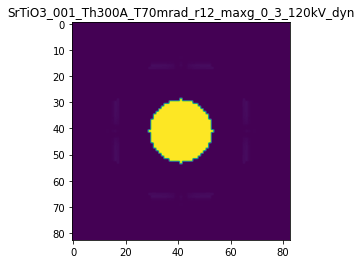

R-factor: 1.6753941935433173e-05

>>> producing the 32. dataset...

The offset applied on thickness: -0.0003113044317537701

The offset applied on Ug: -0.8750709016467068

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68869556824626
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

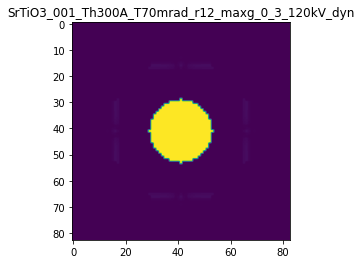

R-factor: 5.183645946294966e-06

>>> producing the 33. dataset...

The offset applied on thickness: 3.311868450112443e-05

The offset applied on Ug: 0.19483220995486933

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0331186845011
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

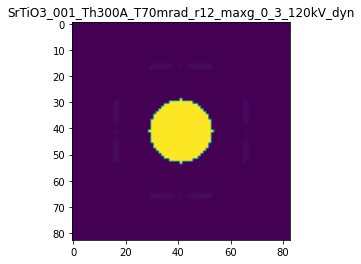

R-factor: 1.1825869945302705e-06

>>> producing the 34. dataset...

The offset applied on thickness: 0.0007738205826892428

The offset applied on Ug: 2.7967565909156145

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.77382058268927
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

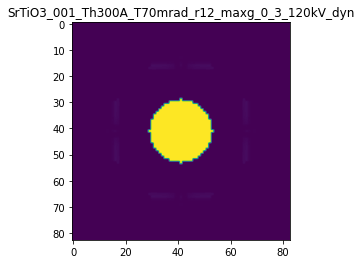

R-factor: 1.7252307745032416e-05

>>> producing the 35. dataset...

The offset applied on thickness: 0.0003380506598594821

The offset applied on Ug: 4.7691891088080185

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33805065985945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

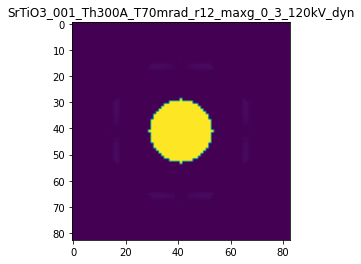

R-factor: 2.976399931762805e-05

>>> producing the 36. dataset...

The offset applied on thickness: 0.0008470787417405601

The offset applied on Ug: -3.238892438956034

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8470787417406
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

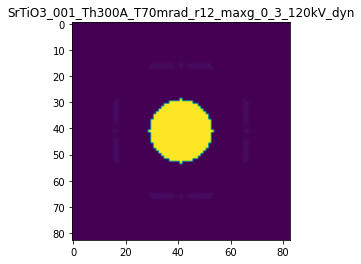

R-factor: 1.8990016829443813e-05

>>> producing the 37. dataset...

The offset applied on thickness: -5.569957011890181e-05

The offset applied on Ug: 4.061608155272898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9443004298811
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

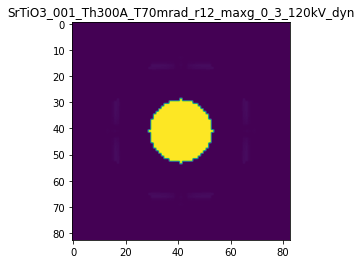

R-factor: 2.5551239525291887e-05

>>> producing the 38. dataset...

The offset applied on thickness: 0.0003238563928466156

The offset applied on Ug: 1.1661382510523641

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3238563928466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

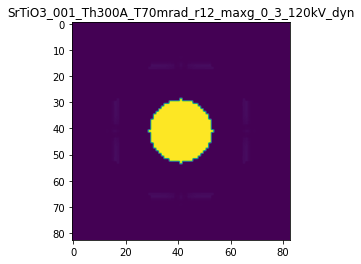

R-factor: 7.106114213400061e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0002047512558961795

The offset applied on Ug: -2.866840413727357

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2047512558962
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

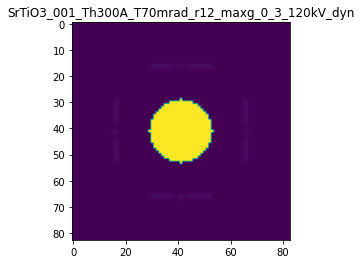

R-factor: 1.6746114178550145e-05

>>> producing the 40. dataset...

The offset applied on thickness: -0.0003275971963366777

The offset applied on Ug: 0.5164476026140687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6724028036633
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

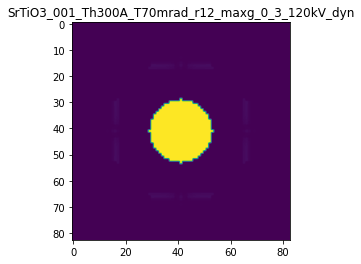

R-factor: 3.3832026747413404e-06

>>> producing the 41. dataset...

The offset applied on thickness: -0.0008988281364212387

The offset applied on Ug: -3.708746234524723

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10117186357877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

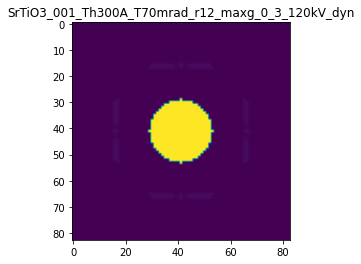

R-factor: 2.105065625207768e-05

>>> producing the 42. dataset...

The offset applied on thickness: -0.000337033742772016

The offset applied on Ug: -4.870724965938389

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.662966257228
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

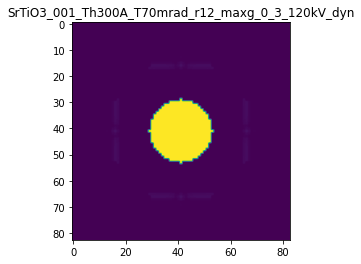

R-factor: 2.7005261701874503e-05

>>> producing the 43. dataset...

The offset applied on thickness: 0.00017791230340474207

The offset applied on Ug: 2.020861582336189

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17791230340475
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

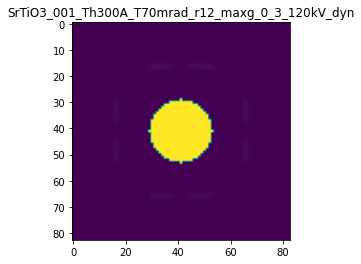

R-factor: 1.2580474836113113e-05

>>> producing the 44. dataset...

The offset applied on thickness: 0.00038483027248174763

The offset applied on Ug: -1.8445909035297792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38483027248174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

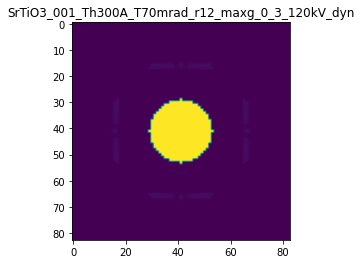

R-factor: 1.1133865750020749e-05

>>> producing the 45. dataset...

The offset applied on thickness: -0.0008380773945390596

The offset applied on Ug: 0.7914827689016056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1619226054609
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

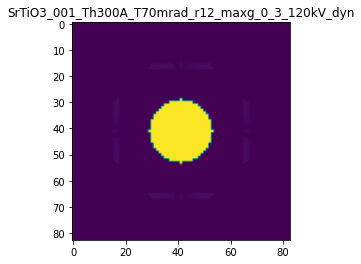

R-factor: 5.412503952182796e-06

>>> producing the 46. dataset...

The offset applied on thickness: -0.0006555529198468557

The offset applied on Ug: -4.482978213745456

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34444708015315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

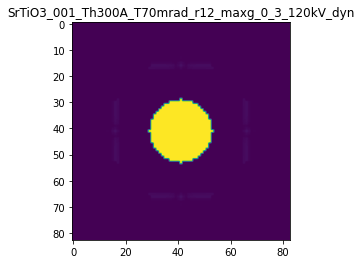

R-factor: 2.5066610376091975e-05

>>> producing the 47. dataset...

The offset applied on thickness: 0.0006462081785998328

The offset applied on Ug: 3.095957757899579

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6462081785998
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

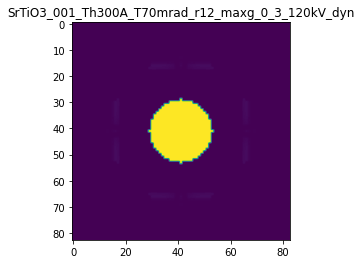

R-factor: 1.920207665753996e-05

>>> producing the 48. dataset...

The offset applied on thickness: -0.00025050852345558414

The offset applied on Ug: -1.0254594431215935

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7494914765444
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

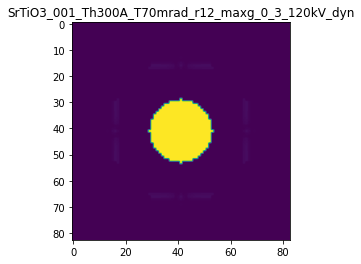

R-factor: 6.0893708798177625e-06

>>> producing the 49. dataset...

The offset applied on thickness: 0.0005102761996727061

The offset applied on Ug: 0.9618711808976628

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.51027619967266
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

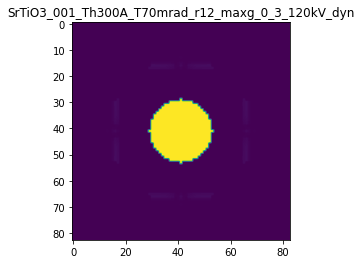

R-factor: 5.749172880595224e-06

>>> producing the 50. dataset...

The offset applied on thickness: -4.122248344780699e-06

The offset applied on Ug: 2.4257689749957003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9958777516552
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

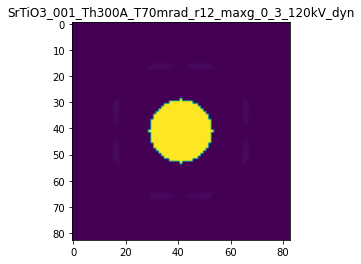

R-factor: 1.523395347130475e-05

>>> producing the 51. dataset...

The offset applied on thickness: 0.0008199957867838613

The offset applied on Ug: 4.445701754834473

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81999578678386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

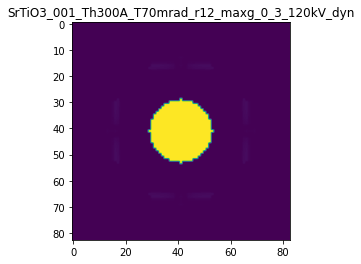

R-factor: 2.7588531473662545e-05

>>> producing the 52. dataset...

The offset applied on thickness: -0.0009723192541675383

The offset applied on Ug: 2.4463484359345866

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02768074583247
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

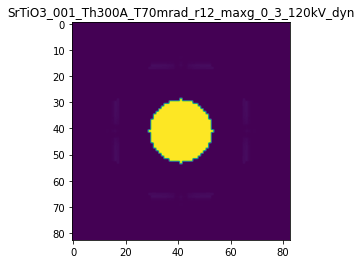

R-factor: 1.583271816571657e-05

>>> producing the 53. dataset...

The offset applied on thickness: -0.0005926217256152938

The offset applied on Ug: -1.2878038371768332

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.40737827438466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

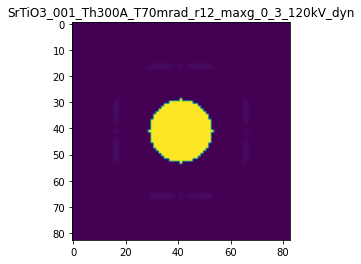

R-factor: 7.568547617862004e-06

>>> producing the 54. dataset...

The offset applied on thickness: 3.803473956930237e-05

The offset applied on Ug: -4.754321583061051

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0380347395693
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

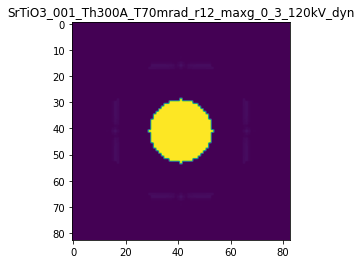

R-factor: 2.6474941467497018e-05

>>> producing the 55. dataset...

The offset applied on thickness: 0.0008185061089706516

The offset applied on Ug: -0.4779832797326515

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81850610897067
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

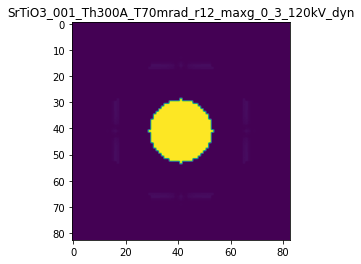

R-factor: 3.4743963114858e-06

>>> producing the 56. dataset...

The offset applied on thickness: -0.0006970594929852377

The offset applied on Ug: 1.1435754869086951

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30294050701474
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

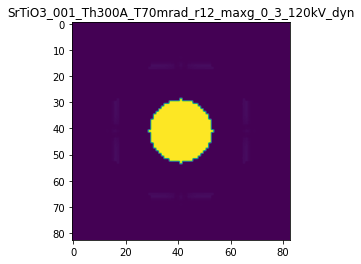

R-factor: 7.501996423280905e-06

>>> producing the 57. dataset...

The offset applied on thickness: 0.000532684251656014

The offset applied on Ug: -1.401447537342475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.532684251656
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

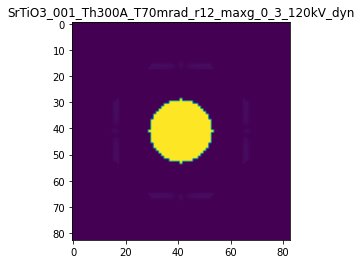

R-factor: 8.707037092718714e-06

>>> producing the 58. dataset...

The offset applied on thickness: 0.0003431056072793919

The offset applied on Ug: -1.7585827010254775

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34310560727937
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

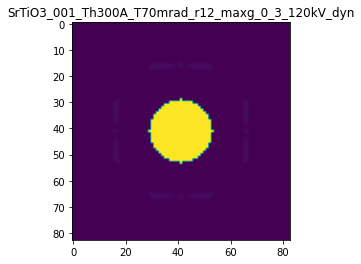

R-factor: 1.0622468061802867e-05

>>> producing the 59. dataset...

The offset applied on thickness: 0.0005797129385146038

The offset applied on Ug: -0.5832574981365326

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5797129385146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

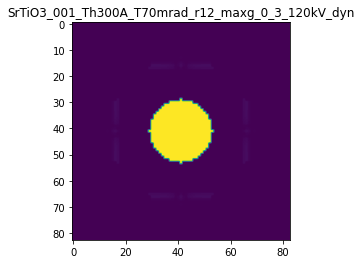

R-factor: 3.921614009675314e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.00036156822947689917

The offset applied on Ug: -0.7485706092008195

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3615682294769
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

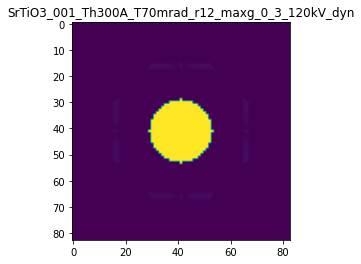

R-factor: 4.759572072800974e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.0008258669136775358

The offset applied on Ug: -2.394130471416527

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82586691367754
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

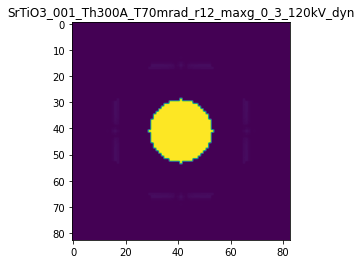

R-factor: 1.4450227242332584e-05

>>> producing the 62. dataset...

The offset applied on thickness: -0.0002864994109558936

The offset applied on Ug: 3.902374296858485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7135005890441
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

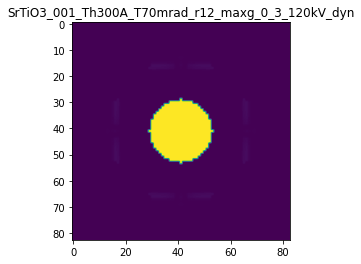

R-factor: 2.4653743868745656e-05

>>> producing the 63. dataset...

The offset applied on thickness: -0.0009597044377650807

The offset applied on Ug: -1.9790879382007744

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04029556223486
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

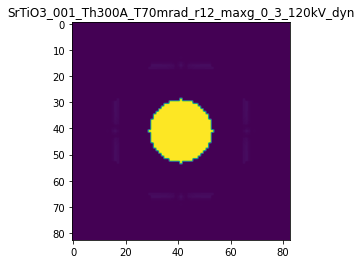

R-factor: 1.1514052814763663e-05

>>> producing the 64. dataset...

The offset applied on thickness: 0.000971001754088882

The offset applied on Ug: 2.487110279995619

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9710017540889
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

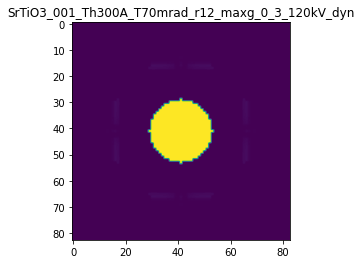

R-factor: 1.519958960666999e-05

>>> producing the 65. dataset...

The offset applied on thickness: 0.0004366494785835511

The offset applied on Ug: -2.636897782706284

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43664947858355
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

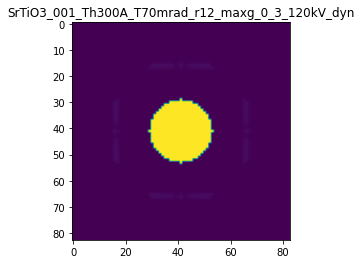

R-factor: 1.5564571338427068e-05

>>> producing the 66. dataset...

The offset applied on thickness: -0.0009152764242786413

The offset applied on Ug: -2.799215337182038

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.08472357572134
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

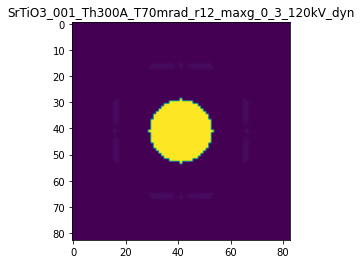

R-factor: 1.6124730800800825e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.0002544892769989218

The offset applied on Ug: -1.6087474720333785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2544892769989
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

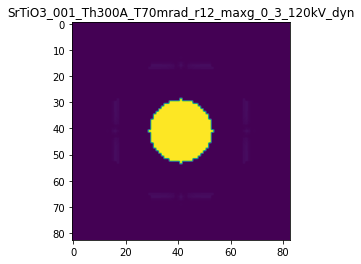

R-factor: 9.717096057735176e-06

>>> producing the 68. dataset...

The offset applied on thickness: 0.0007831485606127789

The offset applied on Ug: -3.217193652030051

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7831485606128
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

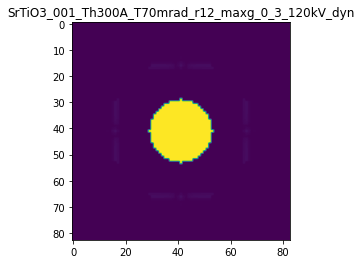

R-factor: 1.884824699935951e-05

>>> producing the 69. dataset...

The offset applied on thickness: -0.0009462367440156457

The offset applied on Ug: -3.41750402456047

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05376325598434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

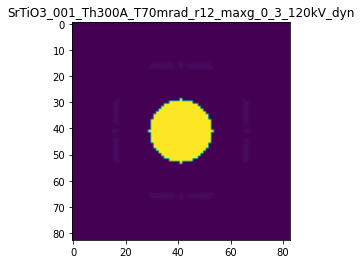

R-factor: 1.94903501381436e-05

>>> producing the 70. dataset...

The offset applied on thickness: 0.0009731517863247827

The offset applied on Ug: -3.693662593594952

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97315178632476
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

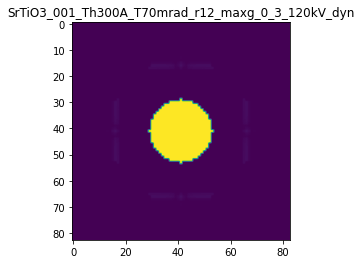

R-factor: 2.1420037507018096e-05

>>> producing the 71. dataset...

The offset applied on thickness: -9.918512024858162e-05

The offset applied on Ug: -0.12235114313765962

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9008148797514
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

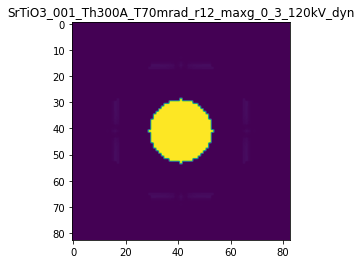

R-factor: 7.226654308190401e-07

>>> producing the 72. dataset...

The offset applied on thickness: 0.0007672572140101472

The offset applied on Ug: 3.182150868375327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76725721401016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

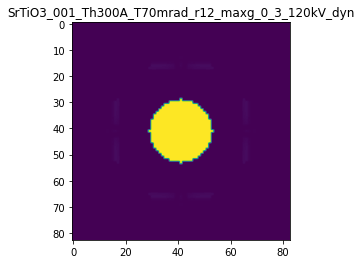

R-factor: 1.9697229883587705e-05

>>> producing the 73. dataset...

The offset applied on thickness: 0.0008544202044420741

The offset applied on Ug: 3.567179518068755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8544202044421
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

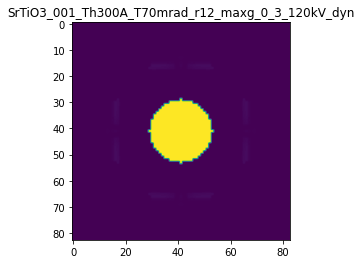

R-factor: 2.208907965309243e-05

>>> producing the 74. dataset...

The offset applied on thickness: 0.0006256775976953761

The offset applied on Ug: 2.975902709560376

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.62567759769536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

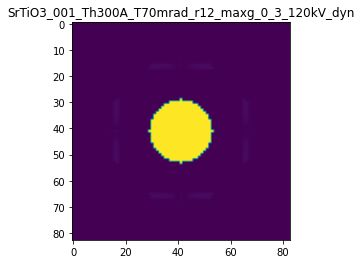

R-factor: 1.845045801431561e-05

>>> producing the 75. dataset...

The offset applied on thickness: -0.0009002665252214201

The offset applied on Ug: -1.7142611103765024

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0997334747786
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

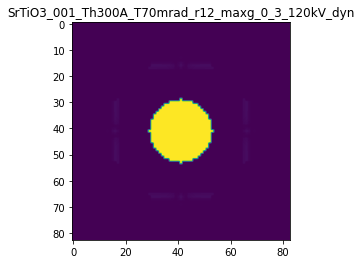

R-factor: 1.0004332080846988e-05

>>> producing the 76. dataset...

The offset applied on thickness: -0.0003162802169117065

The offset applied on Ug: -0.3333704565858636

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6837197830883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

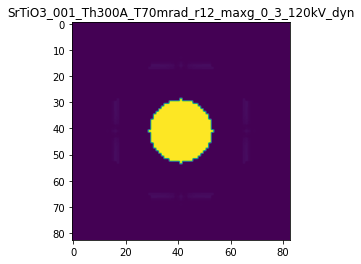

R-factor: 1.96468804846683e-06

>>> producing the 77. dataset...

The offset applied on thickness: 0.000887414678551947

The offset applied on Ug: 2.5713091400286694

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.887414678552
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO

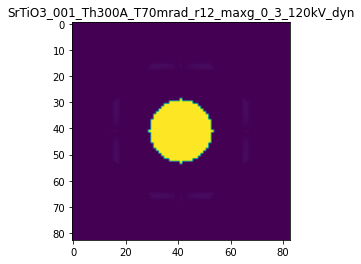

R-factor: 1.5771066504027127e-05

>>> producing the 78. dataset...

The offset applied on thickness: -0.0005826448658886276

The offset applied on Ug: 1.2506462718426452

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4173551341114
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

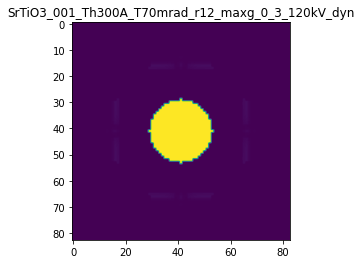

R-factor: 8.10383448253578e-06

>>> producing the 79. dataset...

The offset applied on thickness: 0.0004046616843576889

The offset applied on Ug: -0.6225179254630336

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4046616843577
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

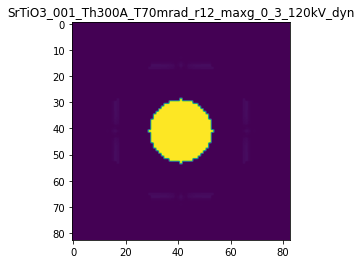

R-factor: 4.035722733585137e-06

>>> producing the 80. dataset...

The offset applied on thickness: -0.0008772076017081387

The offset applied on Ug: -3.3932661313234234

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1227923982919
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

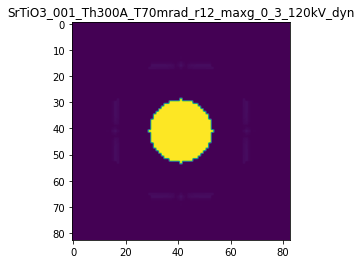

R-factor: 1.9366842067508543e-05

>>> producing the 81. dataset...

The offset applied on thickness: -0.0008731048522804139

The offset applied on Ug: -4.664850926968616

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12689514771955
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

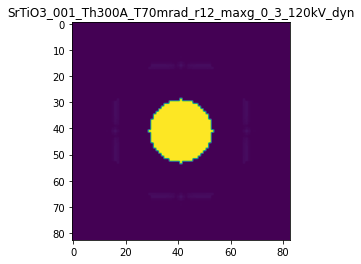

R-factor: 2.5967800727526006e-05

>>> producing the 82. dataset...

The offset applied on thickness: -0.00021785473466969684

The offset applied on Ug: -3.0295900566180287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7821452653303
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

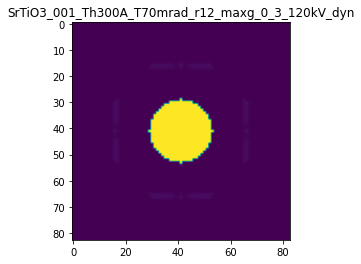

R-factor: 1.7512301702376513e-05

>>> producing the 83. dataset...

The offset applied on thickness: -0.000579342288862311

The offset applied on Ug: -2.0501978569809056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42065771113766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

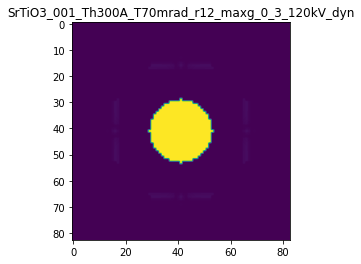

R-factor: 1.1970992586209618e-05

>>> producing the 84. dataset...

The offset applied on thickness: 0.0008377947906267782

The offset applied on Ug: -1.1462908384936645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8377947906268
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

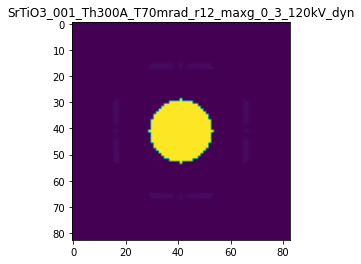

R-factor: 7.435580482687871e-06

>>> producing the 85. dataset...

The offset applied on thickness: -0.0002628865292148872

The offset applied on Ug: 0.2643864638715172

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.73711347078506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

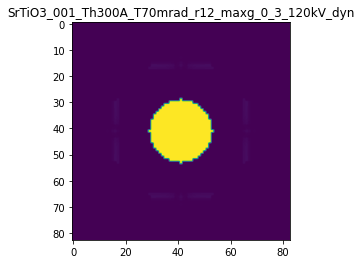

R-factor: 1.7914206696725683e-06

>>> producing the 86. dataset...

The offset applied on thickness: 0.0009723535716557277

The offset applied on Ug: -4.91880140090425

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9723535716557
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

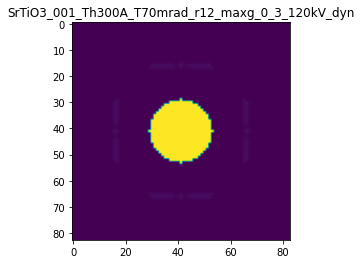

R-factor: 2.7442208938412442e-05

>>> producing the 87. dataset...

The offset applied on thickness: 0.0007070354241879269

The offset applied on Ug: -0.2137438004032731

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7070354241879
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

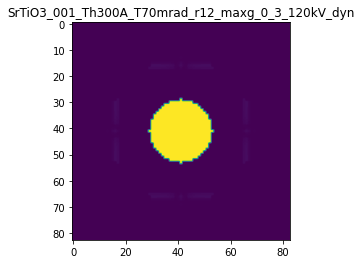

R-factor: 1.8481604948323227e-06

>>> producing the 88. dataset...

The offset applied on thickness: -0.0004815652170197629

The offset applied on Ug: 0.2017451845681353

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51843478298025
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

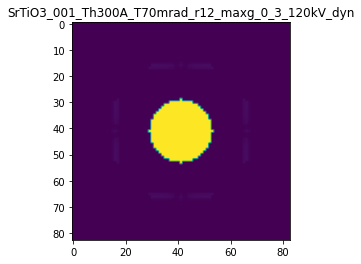

R-factor: 1.582621606063722e-06

>>> producing the 89. dataset...

The offset applied on thickness: -0.0008286514563989436

The offset applied on Ug: 1.404144979507895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1713485436011
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

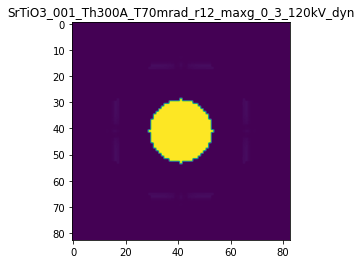

R-factor: 9.20809636754716e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0002515349586956799

The offset applied on Ug: -0.619862133127208

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7484650413043
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

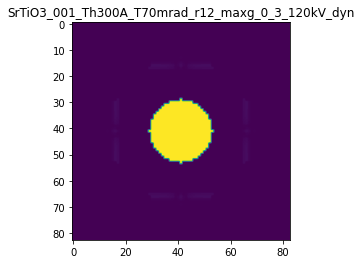

R-factor: 3.675778618753771e-06

>>> producing the 91. dataset...

The offset applied on thickness: -0.00046259060746006454

The offset applied on Ug: -1.6670518949606992

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5374093925399
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

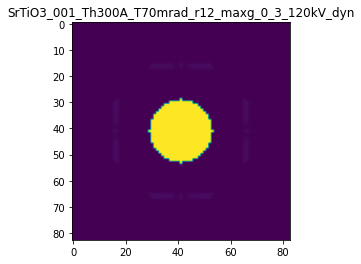

R-factor: 9.794927333368482e-06

>>> producing the 92. dataset...

The offset applied on thickness: 0.00029571800901109427

The offset applied on Ug: -4.314770278556799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29571800901107
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

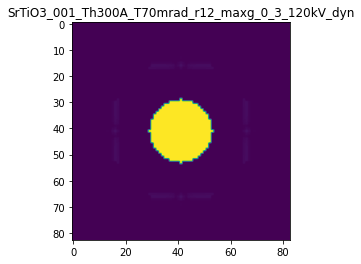

R-factor: 2.4351232963184447e-05

>>> producing the 93. dataset...

The offset applied on thickness: -0.000965638401278981

The offset applied on Ug: 3.5771037132319954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.034361598721
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

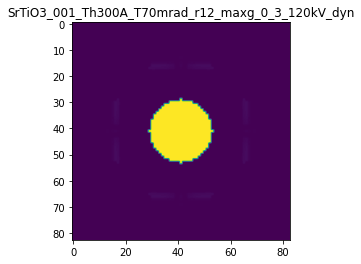

R-factor: 2.2924229055918604e-05

>>> producing the 94. dataset...

The offset applied on thickness: 0.0005219537661046097

The offset applied on Ug: -0.918752213039428

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52195376610456
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

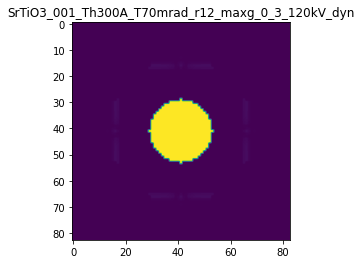

R-factor: 5.878566091248925e-06

>>> producing the 95. dataset...

The offset applied on thickness: 0.0003088578636228252

The offset applied on Ug: -1.7993043119920151

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30885786362285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

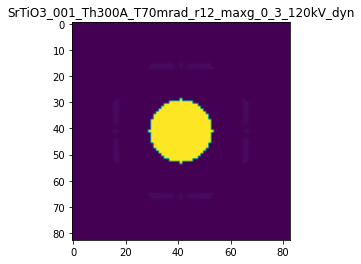

R-factor: 1.083307189139882e-05

>>> producing the 96. dataset...

The offset applied on thickness: 0.0005721783724869723

The offset applied on Ug: -1.2791728364926815

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.572178372487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

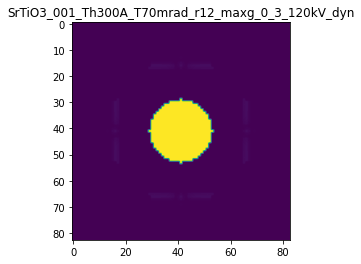

R-factor: 8.026003048856807e-06

>>> producing the 97. dataset...

The offset applied on thickness: -0.00034768296502412933

The offset applied on Ug: -3.6218689271877804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65231703497585
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

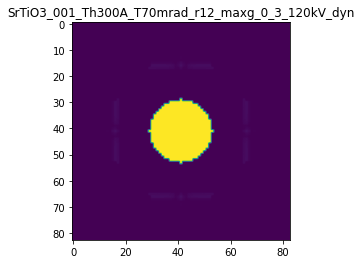

R-factor: 2.0660219900841038e-05

>>> producing the 98. dataset...

The offset applied on thickness: 0.00036942172896749014

The offset applied on Ug: -3.9576822949308905

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3694217289675
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

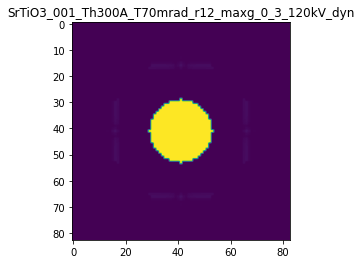

R-factor: 2.2569560714132602e-05

>>> producing the 99. dataset...

The offset applied on thickness: -0.00015530043362627866

The offset applied on Ug: 3.297453173286276

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8446995663737
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

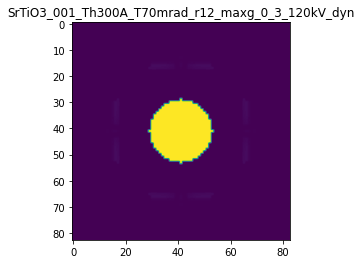

R-factor: 2.0809110700498437e-05

>>> producing the 100. dataset...

The offset applied on thickness: -1.9223783384703985e-05

The offset applied on Ug: 3.016312698540363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9807762166153
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

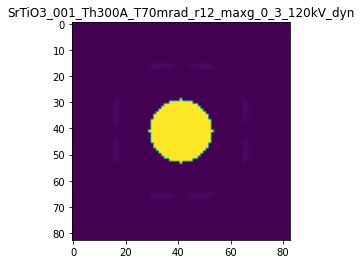

R-factor: 1.897891074143328e-05

>>> producing the 101. dataset...

The offset applied on thickness: 0.000996100240654291

The offset applied on Ug: -3.0950196918044184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.99610024065424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

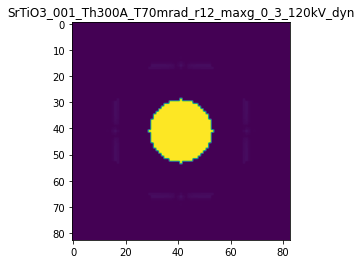

R-factor: 1.8296062831069434e-05

>>> producing the 102. dataset...

The offset applied on thickness: -0.00013717029961330085

The offset applied on Ug: -3.304697844061857

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86282970038667
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

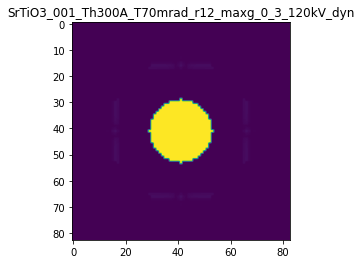

R-factor: 1.9020624708377077e-05

>>> producing the 103. dataset...

The offset applied on thickness: -0.0009987588081040405

The offset applied on Ug: -3.7947205835937847

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.001241191896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

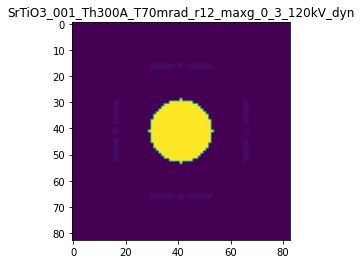

R-factor: 2.150348032667801e-05

>>> producing the 104. dataset...

The offset applied on thickness: -0.0005031948155665647

The offset applied on Ug: 0.6561788888821809

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.49680518443347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

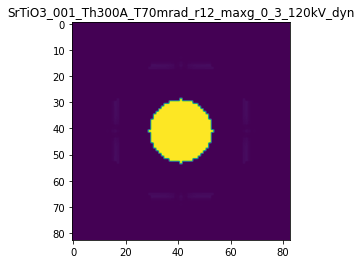

R-factor: 4.3579705428002095e-06

>>> producing the 105. dataset...

The offset applied on thickness: -0.000925896493605227

The offset applied on Ug: 0.028013253764625008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07410350639475
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

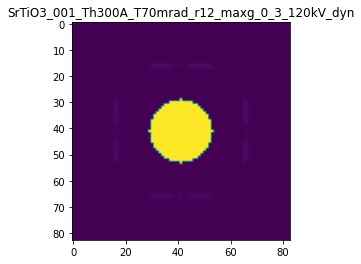

R-factor: 1.1909499283831176e-06

>>> producing the 106. dataset...

The offset applied on thickness: -0.0009296014196886939

The offset applied on Ug: 3.6455152146474825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0703985803113
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

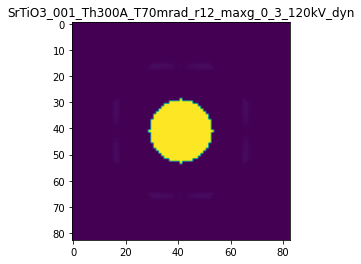

R-factor: 2.3333563376340206e-05

>>> producing the 107. dataset...

The offset applied on thickness: -0.00044857908673760115

The offset applied on Ug: 0.5425900927046792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.55142091326235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

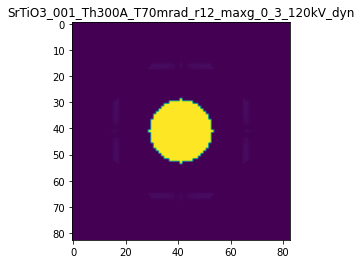

R-factor: 3.6221526975369283e-06

>>> producing the 108. dataset...

The offset applied on thickness: -0.0003342415127802778

The offset applied on Ug: -1.5723443375314445

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6657584872197
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

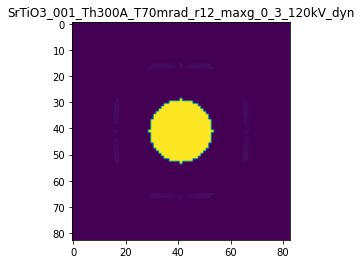

R-factor: 9.27631207251287e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0006215370679216723

The offset applied on Ug: 0.6392733340257144

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3784629320783
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

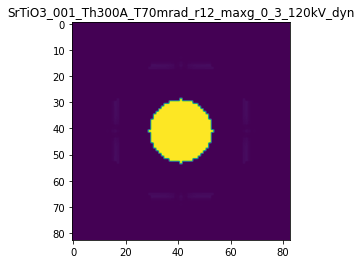

R-factor: 4.331510420104848e-06

>>> producing the 110. dataset...

The offset applied on thickness: 0.00018308358614716537

The offset applied on Ug: 2.2320892809159285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1830835861471
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

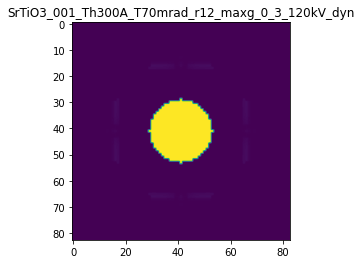

R-factor: 1.3919961015508857e-05

>>> producing the 111. dataset...

The offset applied on thickness: 0.0009766547768989514

The offset applied on Ug: -4.716509569610025

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97665477689895
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

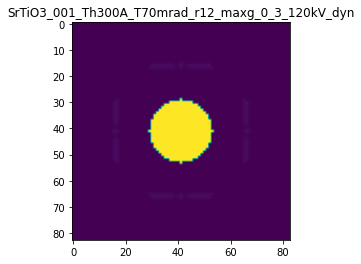

R-factor: 2.6488213743912893e-05

>>> producing the 112. dataset...

The offset applied on thickness: -0.0008986859908642282

The offset applied on Ug: 3.9138650793420835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10131400913576
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

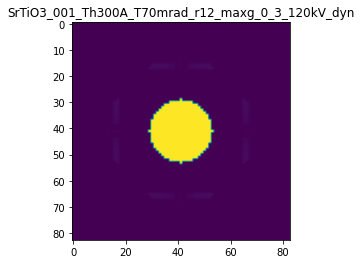

R-factor: 2.499024614356305e-05

>>> producing the 113. dataset...

The offset applied on thickness: 0.0006971194695258072

The offset applied on Ug: -4.5349189832562775

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69711946952583
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

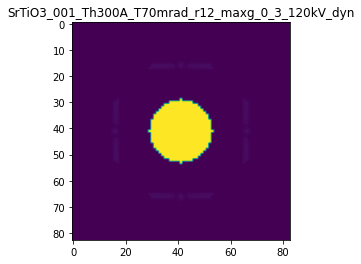

R-factor: 2.553680231691525e-05

>>> producing the 114. dataset...

The offset applied on thickness: -0.0003926071606189283

The offset applied on Ug: -0.804870318618946

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.607392839381
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

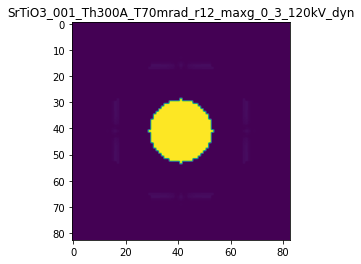

R-factor: 4.751101703723586e-06

>>> producing the 115. dataset...

The offset applied on thickness: 0.00043103405546894227

The offset applied on Ug: -2.150150284971503

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43103405546896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

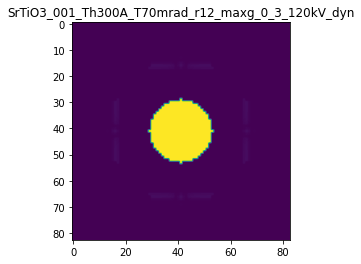

R-factor: 1.2872905097507687e-05

>>> producing the 116. dataset...

The offset applied on thickness: -0.0008291975581750968

The offset applied on Ug: -3.2411359733260245

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1708024418249
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

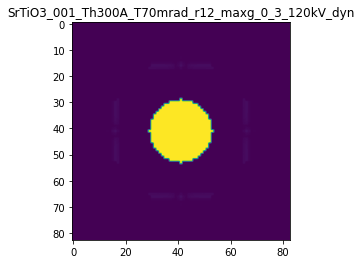

R-factor: 1.8551757048005423e-05

>>> producing the 117. dataset...

The offset applied on thickness: 0.0005420988845692257

The offset applied on Ug: 3.7291333131912814

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5420988845692
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

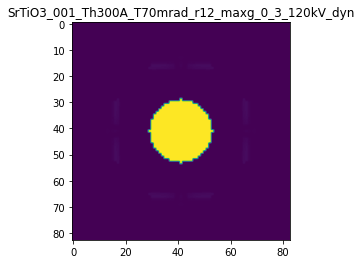

R-factor: 2.3231929264504797e-05

>>> producing the 118. dataset...

The offset applied on thickness: 0.0005901584914688354

The offset applied on Ug: -1.4037760926838347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5901584914688
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

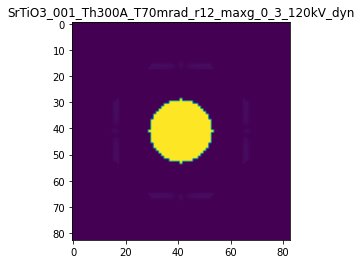

R-factor: 8.759678988954639e-06

>>> producing the 119. dataset...

The offset applied on thickness: -0.0005032388264044177

The offset applied on Ug: 1.0405581203419172

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4967611735956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

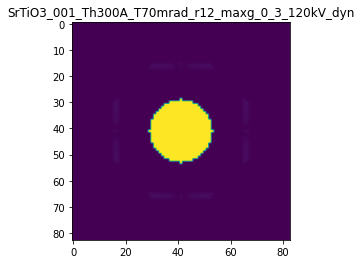

R-factor: 6.743529869807221e-06

>>> producing the 120. dataset...

The offset applied on thickness: 0.0004366252731803939

The offset applied on Ug: 0.9028841924441633

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43662527318037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

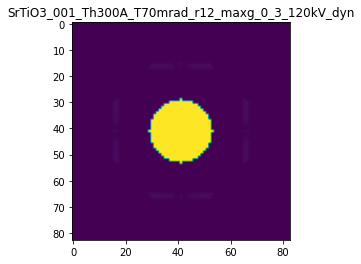

R-factor: 5.407386214773478e-06

>>> producing the 121. dataset...

The offset applied on thickness: -0.00040240621838825996

The offset applied on Ug: 4.808260305177398

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5975937816117
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

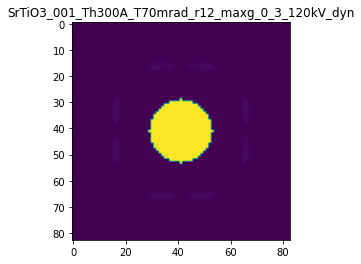

R-factor: 3.0292688518293334e-05

>>> producing the 122. dataset...

The offset applied on thickness: -0.00052527203651323

The offset applied on Ug: 0.8545783561545386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.47472796348677
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

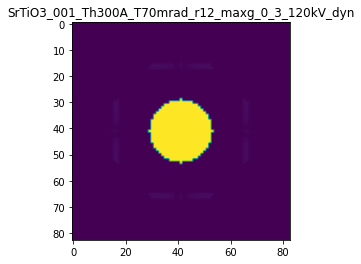

R-factor: 5.600050623409178e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.00032197145116802893

The offset applied on Ug: -1.027772732702058

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.321971451168
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

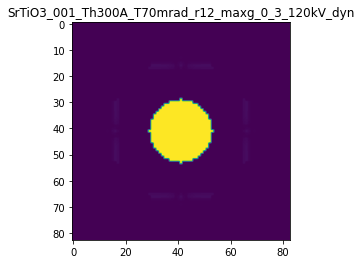

R-factor: 6.388322525001915e-06

>>> producing the 124. dataset...

The offset applied on thickness: -6.900210694196818e-05

The offset applied on Ug: -0.4379464102931138

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.930997893058
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

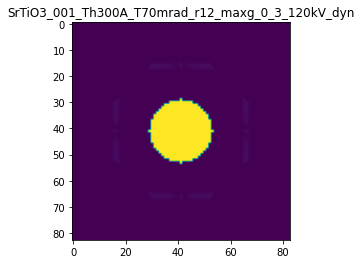

R-factor: 2.6350808811578403e-06

>>> producing the 125. dataset...

The offset applied on thickness: 7.929239914170161e-06

The offset applied on Ug: 0.25530751176472904

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0079292399142
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

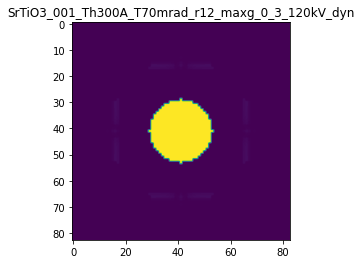

R-factor: 1.569422292905954e-06

>>> producing the 126. dataset...

The offset applied on thickness: -0.0001417238309752722

The offset applied on Ug: 4.901684010969328

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8582761690247
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

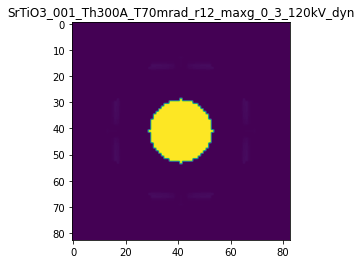

R-factor: 3.0759212492215584e-05

>>> producing the 127. dataset...

The offset applied on thickness: -0.0006598188026910894

The offset applied on Ug: 0.7030548067215204

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3401811973089
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

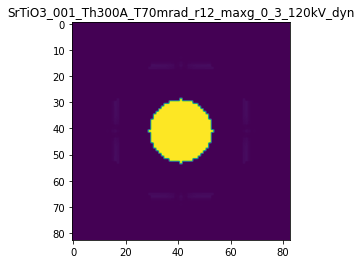

R-factor: 4.749316206878735e-06

>>> producing the 128. dataset...

The offset applied on thickness: -0.0003912711231800914

The offset applied on Ug: -3.200450933919997

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6087288768199
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

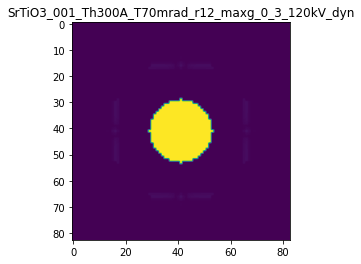

R-factor: 1.840260076659133e-05

>>> producing the 129. dataset...

The offset applied on thickness: 0.0007100227614399672

The offset applied on Ug: -0.135428143219699

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7100227614399
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

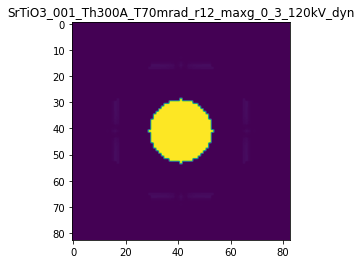

R-factor: 1.416103101106461e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.0006305835389757521

The offset applied on Ug: 0.9089076051639904

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.63058353897577
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

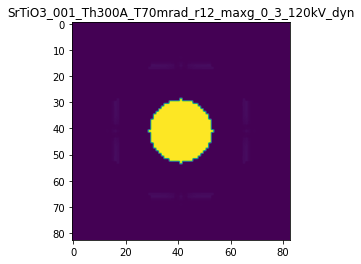

R-factor: 5.3994229138244535e-06

>>> producing the 131. dataset...

The offset applied on thickness: 0.0003984316612097003

The offset applied on Ug: 3.7941465706729662

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39843166120966
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

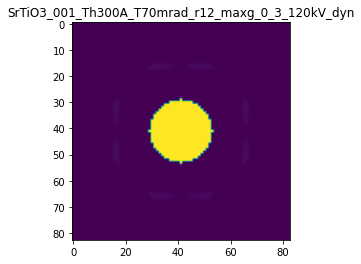

R-factor: 2.369744241630547e-05

>>> producing the 132. dataset...

The offset applied on thickness: -0.0007742806542089573

The offset applied on Ug: -2.499944631829684

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.225719345791
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

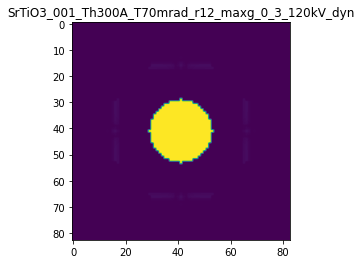

R-factor: 1.4476945645181906e-05

>>> producing the 133. dataset...

The offset applied on thickness: 0.0004457742105391933

The offset applied on Ug: 1.0389238597149109

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4457742105392
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

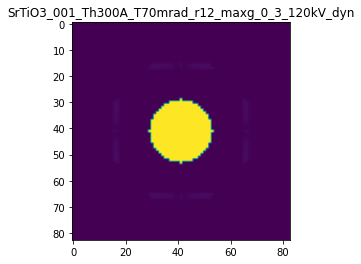

R-factor: 6.249137536823231e-06

>>> producing the 134. dataset...

The offset applied on thickness: 0.00034837805332890693

The offset applied on Ug: 2.5911310808113206

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3483780533289
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

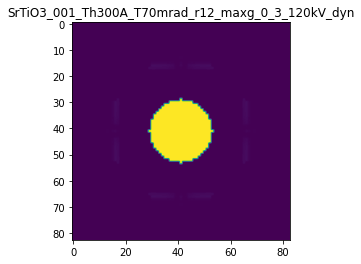

R-factor: 1.6126552681342774e-05

>>> producing the 135. dataset...

The offset applied on thickness: 0.0004968107091879825

The offset applied on Ug: -1.9531583700584452

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49681070918797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

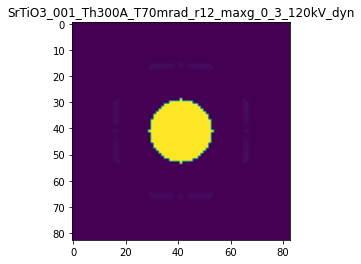

R-factor: 1.1812078023099718e-05

>>> producing the 136. dataset...

The offset applied on thickness: -4.581392256258199e-05

The offset applied on Ug: 3.9129934988828077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9541860774374
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

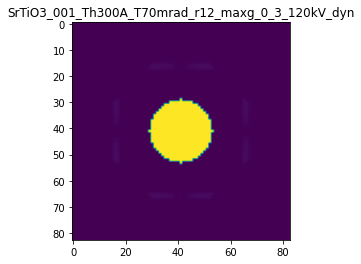

R-factor: 2.4620790674399002e-05

>>> producing the 137. dataset...

The offset applied on thickness: 0.00021373957791392262

The offset applied on Ug: 4.24985178727473

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21373957791394
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

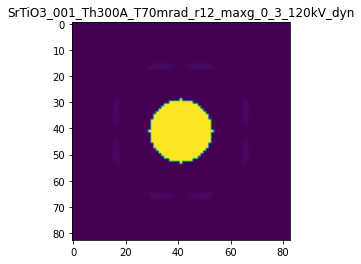

R-factor: 2.661278914362901e-05

>>> producing the 138. dataset...

The offset applied on thickness: 0.0005694252291645916

The offset applied on Ug: 3.597277070556411

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56942522916455
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

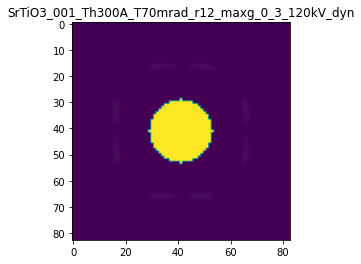

R-factor: 2.239347299800399e-05

>>> producing the 139. dataset...

The offset applied on thickness: 0.0001265530747664516

The offset applied on Ug: 0.5235055988543581

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12655307476643
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

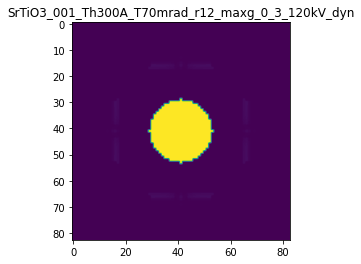

R-factor: 3.1733831602660275e-06

>>> producing the 140. dataset...

The offset applied on thickness: 0.0005221755705114068

The offset applied on Ug: 3.9054710884993664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5221755705114
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

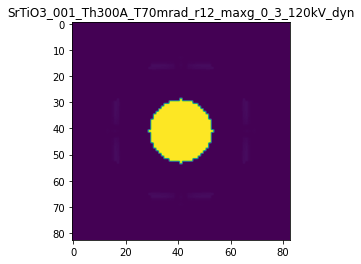

R-factor: 2.4344997679629608e-05



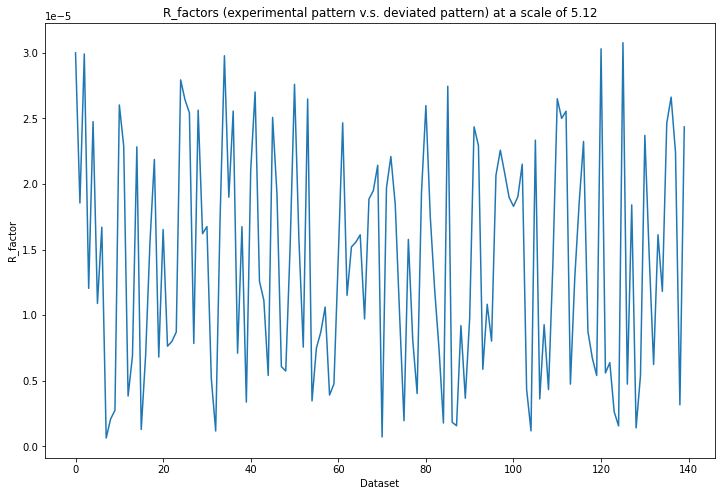

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 376ms/step - loss: 0.2455 - acc: 0.0000e+00 - val_loss: 0.1803 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 230ms/step - loss: 0.1499 - acc: 0.0000e+00 - val_loss: 0.1221 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 223ms/step - loss: 0.1102 - acc: 0.0000e+00 - val_loss: 0.0911 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 240ms/step - loss: 0.0780 - acc: 0.0000e+00 - val_loss: 0.0576 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 226ms/step - loss: 0.0453 - acc: 0.0000e+00 - val_loss: 0.0326 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 244ms/step - loss: 0.0266 - acc: 0.0000e+00 - val_loss: 0.0176 - val_acc: 0.0000e+00
Epoch 7/20
5/5 [==============================] - 1s 230ms/step - loss: 0.0140 - acc: 0.0000e+00 - val_loss: 0.0108 - val_acc: 0.0000e+00
Epoch

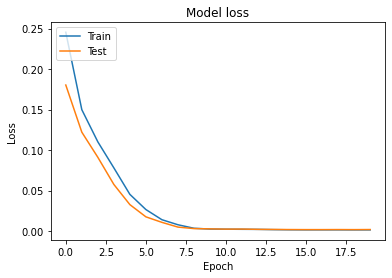

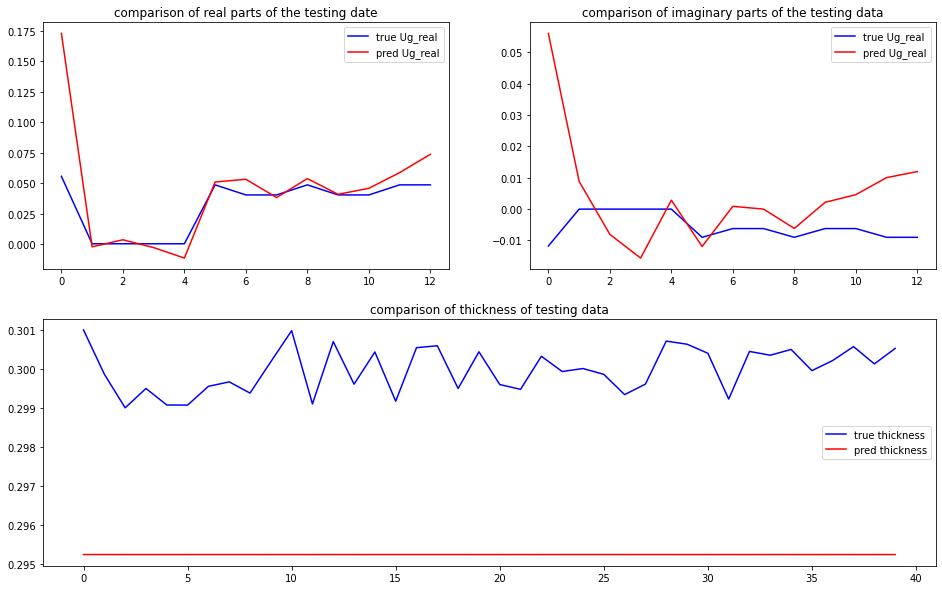

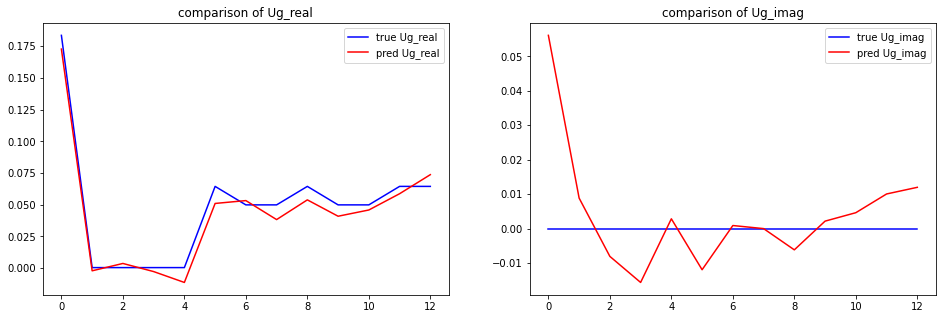

predicted thickness: 29.524332284927368 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=295.2433228492737
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.17271529+0.j          0.000

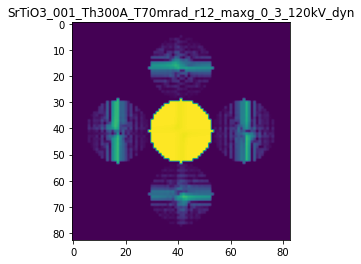

X_sim.max(): 0.9996101933142735
R-factor at a scale of 5.12 is 0.062245313497283024.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 10.24

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.00036723292245078665

The offset applied on Ug: -7.803723918220016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


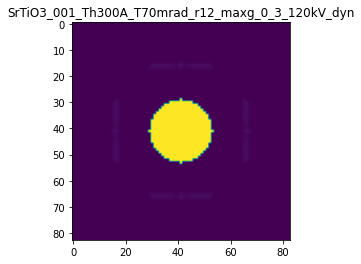

R-factor: 3.954637604129312e-05

>>> producing the 2. dataset...

The offset applied on thickness: 0.00039504198255903213

The offset applied on Ug: -5.132551502123224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.395041982559
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

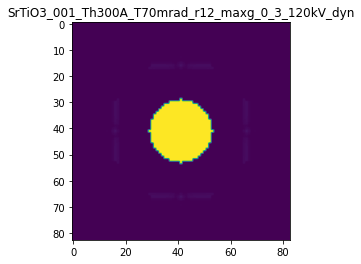

R-factor: 2.834220827349076e-05

>>> producing the 3. dataset...

The offset applied on thickness: -0.0001757786380078026

The offset applied on Ug: 8.088567629568056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.82422136199216
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

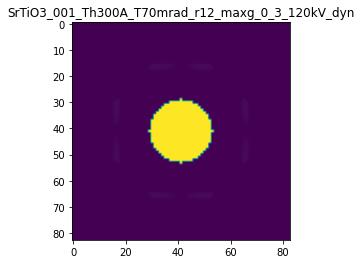

R-factor: 4.94193291688247e-05

>>> producing the 4. dataset...

The offset applied on thickness: 0.0004099481647319847

The offset applied on Ug: -6.524823897869253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.409948164732
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO

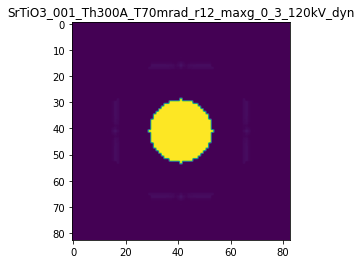

R-factor: 3.457759567249912e-05

>>> producing the 5. dataset...

The offset applied on thickness: -0.0006114176703921203

The offset applied on Ug: 8.831129000778024

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.38858232960786
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

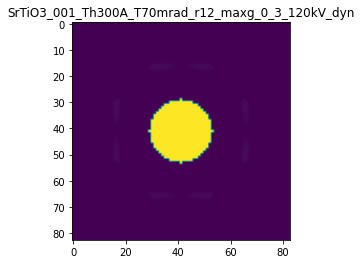

R-factor: 5.357284715881668e-05

>>> producing the 6. dataset...

The offset applied on thickness: 0.0009935702895045421

The offset applied on Ug: -6.709289359870141

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.99357028950453
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

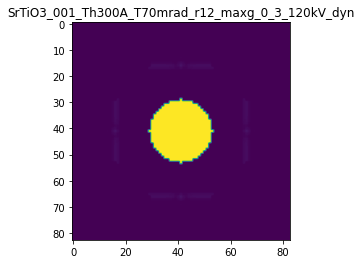

R-factor: 3.535940438073887e-05

>>> producing the 7. dataset...

The offset applied on thickness: 8.913303916659542e-05

The offset applied on Ug: -5.769457660252263

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.08913303916654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

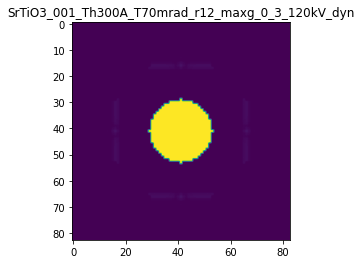

R-factor: 3.1241180353959775e-05

>>> producing the 8. dataset...

The offset applied on thickness: -0.0005465907986706351

The offset applied on Ug: -8.957873826416023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45340920132935
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

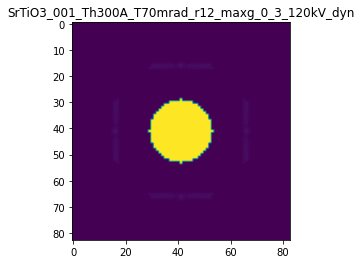

R-factor: 4.3279492205786224e-05

>>> producing the 9. dataset...

The offset applied on thickness: -0.0001530935190386824

The offset applied on Ug: -3.059123580192895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8469064809613
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

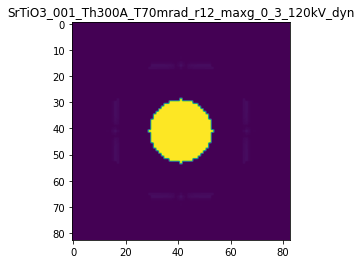

R-factor: 1.7688019167697158e-05

>>> producing the 10. dataset...

The offset applied on thickness: 0.0004073078877580851

The offset applied on Ug: -8.671884729423175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4073078877581
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

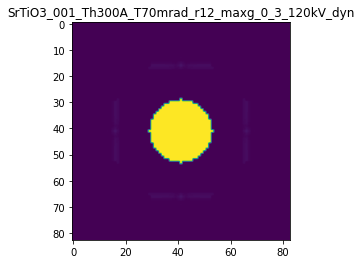

R-factor: 4.2379293030963334e-05

>>> producing the 11. dataset...

The offset applied on thickness: -6.683912350912857e-05

The offset applied on Ug: -0.9742610206235486

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93316087649083
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

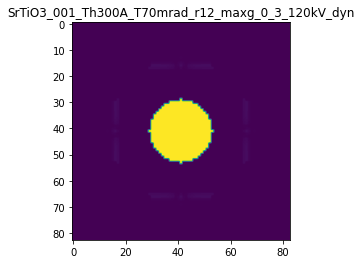

R-factor: 5.848760402311777e-06

>>> producing the 12. dataset...

The offset applied on thickness: -0.000348988805685841

The offset applied on Ug: 8.218415115996159

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65101119431415
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

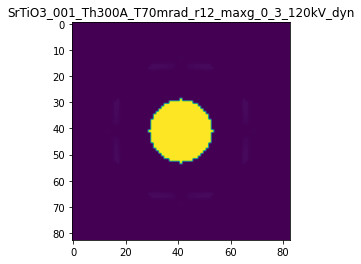

R-factor: 5.0186941483700846e-05

>>> producing the 13. dataset...

The offset applied on thickness: -0.0004336215774417218

The offset applied on Ug: -0.7551323960510218

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5663784225583
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

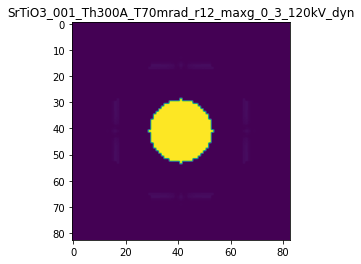

R-factor: 4.452900304397312e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.0003553384966470634

The offset applied on Ug: 9.84822657518495

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.35533849664705
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

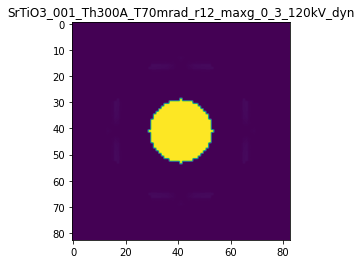

R-factor: 5.853859185247348e-05

>>> producing the 15. dataset...

The offset applied on thickness: -0.00023838537308798103

The offset applied on Ug: -8.315270823339462

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76161462691203
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

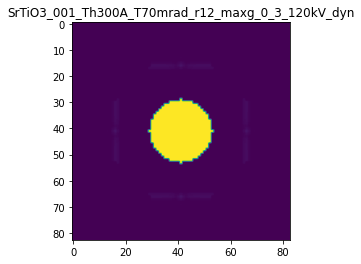

R-factor: 4.128096996694551e-05

>>> producing the 16. dataset...

The offset applied on thickness: -0.000947944591031836

The offset applied on Ug: -8.48713742228865

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05205540896816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

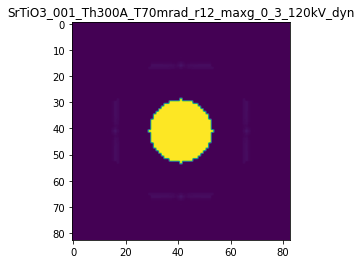

R-factor: 4.1872209993964324e-05

>>> producing the 17. dataset...

The offset applied on thickness: -3.714404710655517e-05

The offset applied on Ug: -5.446939861802393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96285595289345
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

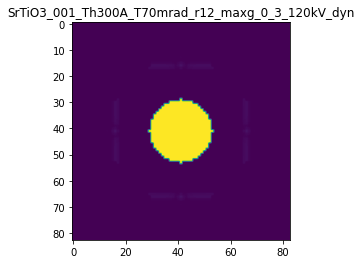

R-factor: 2.9766862312813422e-05

>>> producing the 18. dataset...

The offset applied on thickness: -0.0008873250066292624

The offset applied on Ug: -6.5927557935947885

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1126749933707
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

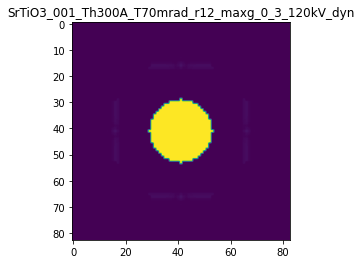

R-factor: 3.488462244401426e-05

>>> producing the 19. dataset...

The offset applied on thickness: 0.0007606931125782319

The offset applied on Ug: -5.3309452697540864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7606931125782
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

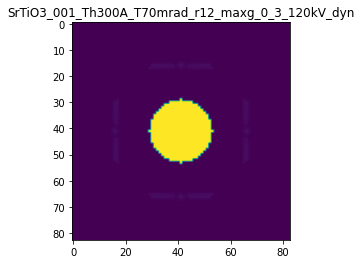

R-factor: 2.932337973704074e-05

>>> producing the 20. dataset...

The offset applied on thickness: -0.0005954171255285457

The offset applied on Ug: 9.704970846945212

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4045828744715
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

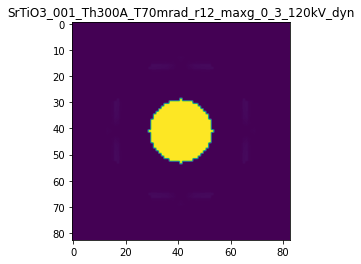

R-factor: 5.811201547264362e-05

>>> producing the 21. dataset...

The offset applied on thickness: 0.0008007316962039186

The offset applied on Ug: 6.606375143088442

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8007316962039
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

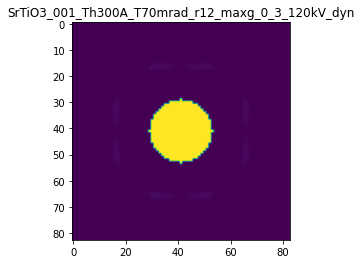

R-factor: 4.0675664565225305e-05

>>> producing the 22. dataset...

The offset applied on thickness: -0.00020767075146897062

The offset applied on Ug: -8.961677420922692

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.792329248531
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

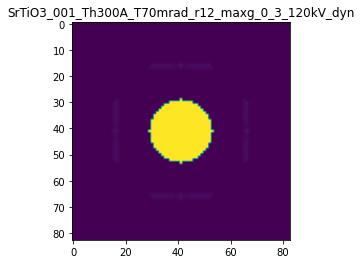

R-factor: 4.325937112922199e-05

>>> producing the 23. dataset...

The offset applied on thickness: -8.838356208104803e-05

The offset applied on Ug: -2.6167110418273523

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9116164379189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

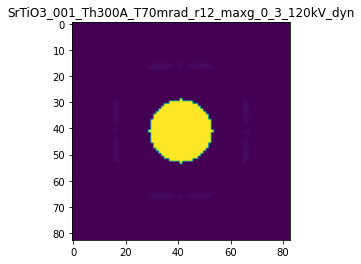

R-factor: 1.527323599061502e-05

>>> producing the 24. dataset...

The offset applied on thickness: -0.0006131089430122862

The offset applied on Ug: -8.927891917046015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3868910569877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

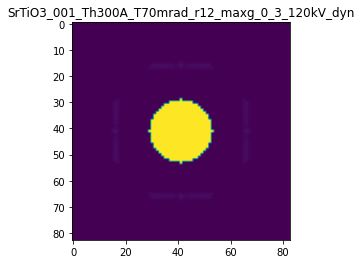

R-factor: 4.3192658426788016e-05

>>> producing the 25. dataset...

The offset applied on thickness: 0.0007199215707947672

The offset applied on Ug: 4.480866370781384

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7199215707947
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

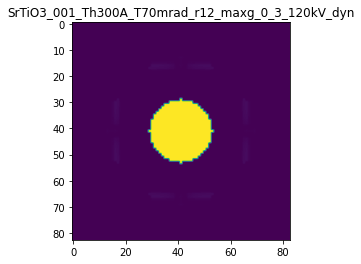

R-factor: 2.7844520702907712e-05

>>> producing the 26. dataset...

The offset applied on thickness: -0.0006147829843757329

The offset applied on Ug: -7.903709093470909

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3852170156243
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

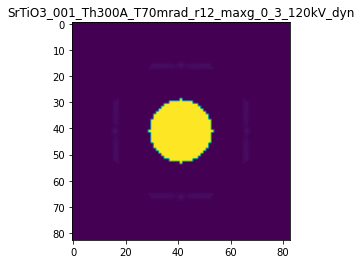

R-factor: 3.99053316185805e-05

>>> producing the 27. dataset...

The offset applied on thickness: -0.0009125476623610176

The offset applied on Ug: -5.346305546758688

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0874523376389
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

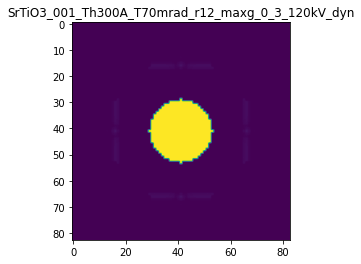

R-factor: 2.929161161389039e-05

>>> producing the 28. dataset...

The offset applied on thickness: 0.00010815646360337939

The offset applied on Ug: 2.8217712550635063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1081564636034
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

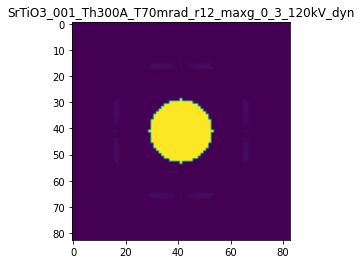

R-factor: 1.7693579027053916e-05

>>> producing the 29. dataset...

The offset applied on thickness: 0.00010989714620668845

The offset applied on Ug: -5.451621508825399

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.10989714620666
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

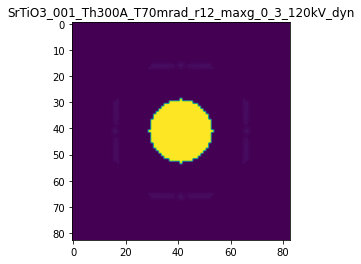

R-factor: 2.9801187328739646e-05

>>> producing the 30. dataset...

The offset applied on thickness: 0.0009950379848009034

The offset applied on Ug: -1.9909135141204912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9950379848009
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

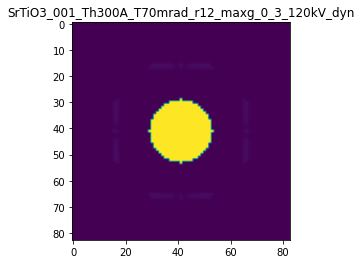

R-factor: 1.2369173167104879e-05

>>> producing the 31. dataset...

The offset applied on thickness: 0.0007696709317270268

The offset applied on Ug: -2.3817023886088147

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76967093172703
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

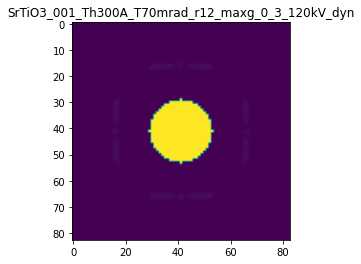

R-factor: 1.4346160931179423e-05

>>> producing the 32. dataset...

The offset applied on thickness: 0.00016326844990941481

The offset applied on Ug: 8.303057565032082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1632684499094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

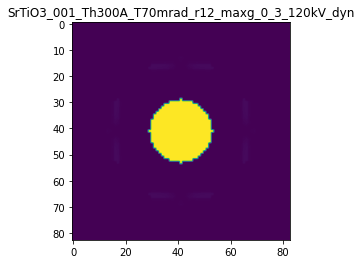

R-factor: 5.0484811077154224e-05

>>> producing the 33. dataset...

The offset applied on thickness: 0.0007013430046810909

The offset applied on Ug: -7.483897367745042

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7013430046811
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

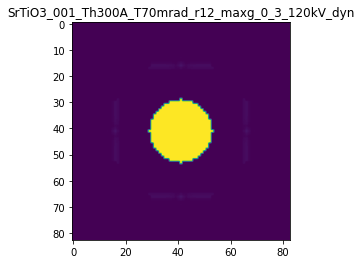

R-factor: 3.8370610056540244e-05

>>> producing the 34. dataset...

The offset applied on thickness: 0.00045504141318679147

The offset applied on Ug: 0.7209537239521479

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4550414131868
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

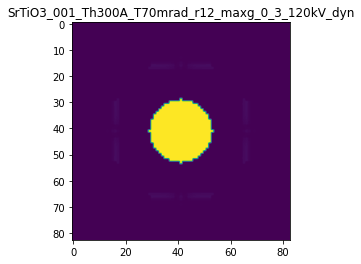

R-factor: 4.285876735126126e-06

>>> producing the 35. dataset...

The offset applied on thickness: 3.984493713102122e-05

The offset applied on Ug: -3.811853395287246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.03984493713097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

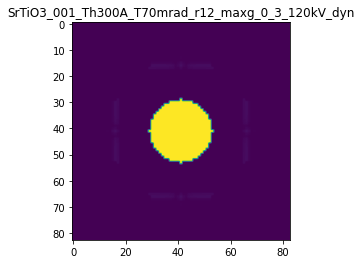

R-factor: 2.173434283742287e-05

>>> producing the 36. dataset...

The offset applied on thickness: 0.00014362061639881208

The offset applied on Ug: 0.4350383467390498

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14362061639883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

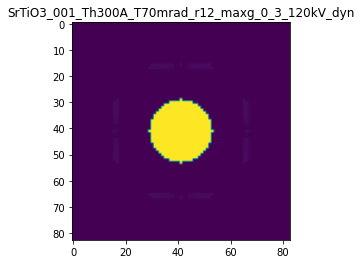

R-factor: 2.6168820467104495e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.00039986403999765167

The offset applied on Ug: 9.027029855963061

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6001359600023
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

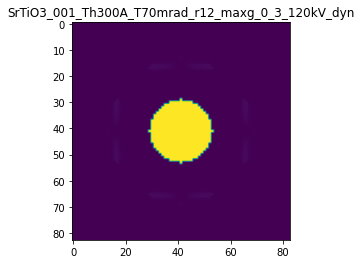

R-factor: 5.454091882135856e-05

>>> producing the 38. dataset...

The offset applied on thickness: 0.0009055731089304375

The offset applied on Ug: -2.956329208614727

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9055731089304
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

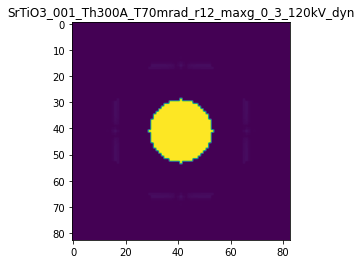

R-factor: 1.7514051197282747e-05

>>> producing the 39. dataset...

The offset applied on thickness: -0.0008400619868187898

The offset applied on Ug: -9.422221513954973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1599380131812
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

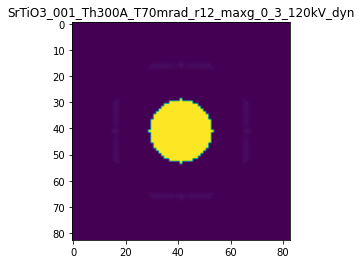

R-factor: 4.483243723492047e-05

>>> producing the 40. dataset...

The offset applied on thickness: -0.000658984007434888

The offset applied on Ug: 5.916049827413458

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3410159925651
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

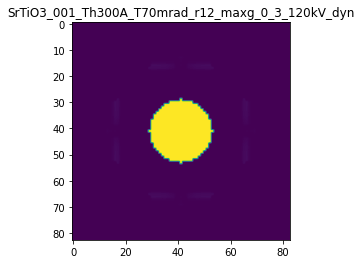

R-factor: 3.7082693379877774e-05

>>> producing the 41. dataset...

The offset applied on thickness: -0.0006997651980339425

The offset applied on Ug: 6.846520971085527

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30023480196604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

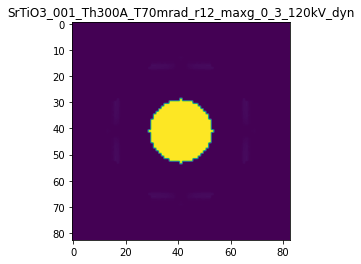

R-factor: 4.257572848239403e-05

>>> producing the 42. dataset...

The offset applied on thickness: -0.0006292065710349053

The offset applied on Ug: 2.1600621155870954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3707934289651
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

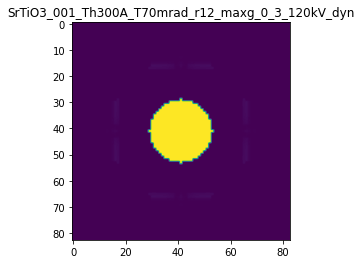

R-factor: 1.3849238603050792e-05

>>> producing the 43. dataset...

The offset applied on thickness: -1.5455675480926744e-05

The offset applied on Ug: -8.222482753676598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98454432451905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

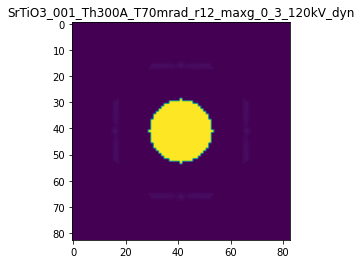

R-factor: 4.095929313749479e-05

>>> producing the 44. dataset...

The offset applied on thickness: -0.0007340065392618101

The offset applied on Ug: 8.121381439983418

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2659934607382
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

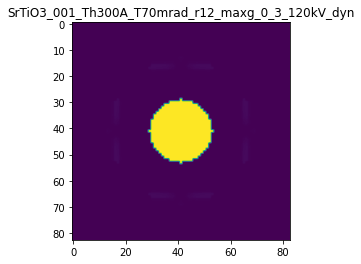

R-factor: 4.977904309515881e-05

>>> producing the 45. dataset...

The offset applied on thickness: -0.0006878952481482626

The offset applied on Ug: -8.049560768146685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31210475185173
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

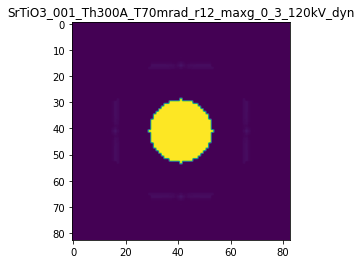

R-factor: 4.042040325652529e-05

>>> producing the 46. dataset...

The offset applied on thickness: -0.0009476999604124818

The offset applied on Ug: 2.7538427048530707

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0523000395875
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

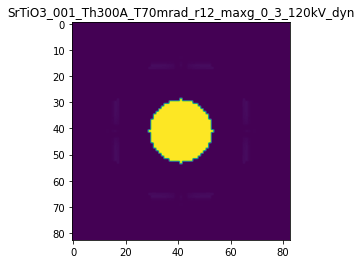

R-factor: 1.7756327937370036e-05

>>> producing the 47. dataset...

The offset applied on thickness: 0.00036495282346100624

The offset applied on Ug: 7.2565002143052695

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.364952823461
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

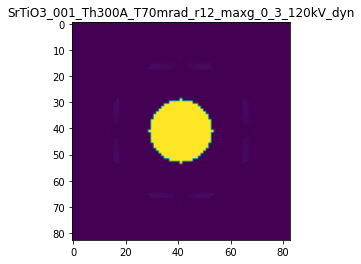

R-factor: 4.457767618400138e-05

>>> producing the 48. dataset...

The offset applied on thickness: -0.00014106078108423704

The offset applied on Ug: -3.183919824489867

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8589392189158
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

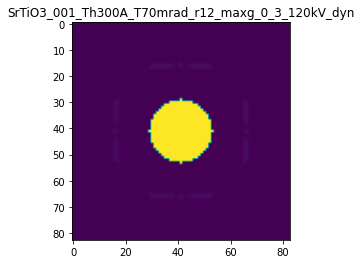

R-factor: 1.8368918658308185e-05

>>> producing the 49. dataset...

The offset applied on thickness: -0.0009412948900817641

The offset applied on Ug: 4.415592031435176

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0587051099182
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

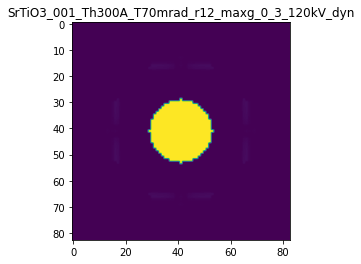

R-factor: 2.8109318711123493e-05

>>> producing the 50. dataset...

The offset applied on thickness: -0.00042262836141606177

The offset applied on Ug: -6.831916848418732

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57737163858394
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

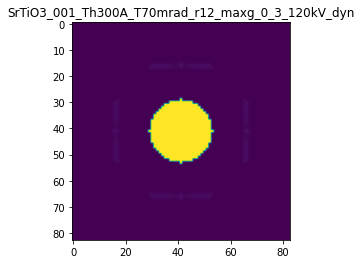

R-factor: 3.585360510639553e-05

>>> producing the 51. dataset...

The offset applied on thickness: -0.0002980347755363382

The offset applied on Ug: -1.8137138345586914

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7019652244636
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

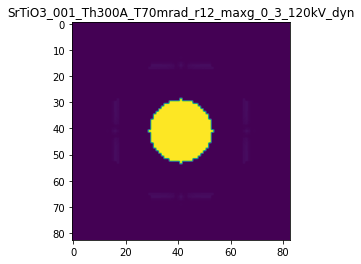

R-factor: 1.0679861944871122e-05

>>> producing the 52. dataset...

The offset applied on thickness: 0.0007407775527085216

The offset applied on Ug: 2.017727849605151

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7407775527085
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

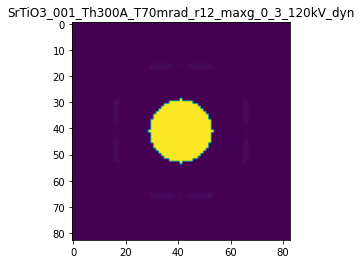

R-factor: 1.230868291506546e-05

>>> producing the 53. dataset...

The offset applied on thickness: -0.00025644759863567915

The offset applied on Ug: 9.70775072165779

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7435524013643
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

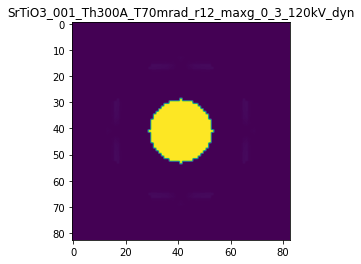

R-factor: 5.801951290391921e-05

>>> producing the 54. dataset...

The offset applied on thickness: -0.0009107261331949146

The offset applied on Ug: -7.289987440799889

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.08927386680506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

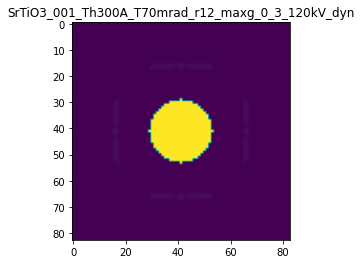

R-factor: 3.767700764115305e-05

>>> producing the 55. dataset...

The offset applied on thickness: -0.0007341735616381547

The offset applied on Ug: 1.6482851309825628

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26582643836184
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

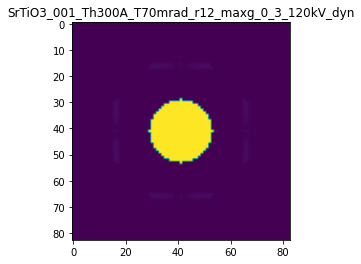

R-factor: 1.0684105607095713e-05

>>> producing the 56. dataset...

The offset applied on thickness: 0.00010409336388719881

The offset applied on Ug: 6.862115993041562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1040933638872
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

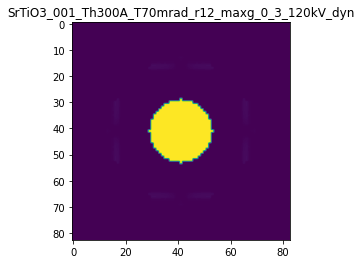

R-factor: 4.239605620544498e-05

>>> producing the 57. dataset...

The offset applied on thickness: -0.00031203562432050605

The offset applied on Ug: -0.8193655860350963

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6879643756795
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

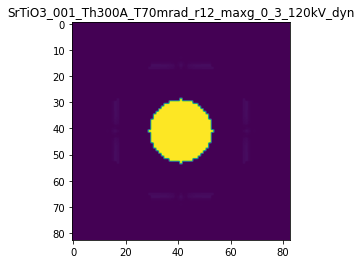

R-factor: 4.85264434887969e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0008326396567715577

The offset applied on Ug: 6.051410380494819

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16736034322844
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

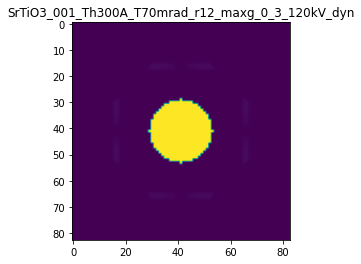

R-factor: 3.7952670651545175e-05

>>> producing the 59. dataset...

The offset applied on thickness: 0.0005897174113566195

The offset applied on Ug: -9.563369279367016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5897174113566
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

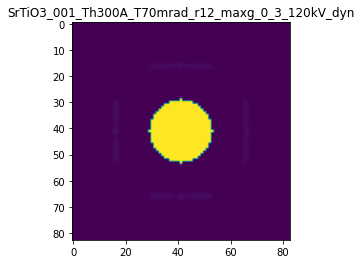

R-factor: 4.5072248501256354e-05

>>> producing the 60. dataset...

The offset applied on thickness: 0.00023122227739077927

The offset applied on Ug: -1.5830720263023659

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2312222773907
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

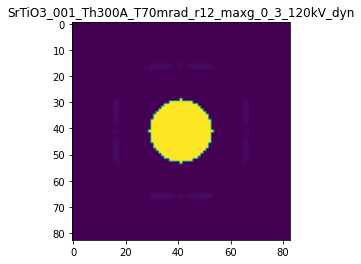

R-factor: 9.556590664563279e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.0003841676758982919

The offset applied on Ug: 1.2397313543788868

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38416767589825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

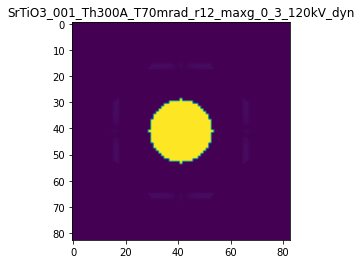

R-factor: 7.541904088296548e-06

>>> producing the 62. dataset...

The offset applied on thickness: 0.0006197385948957464

The offset applied on Ug: 5.0876991180502795

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6197385948957
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

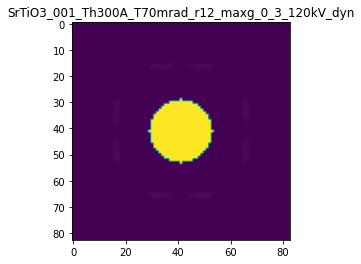

R-factor: 3.160527994009642e-05

>>> producing the 63. dataset...

The offset applied on thickness: 0.00023556101828590005

The offset applied on Ug: -10.048864841031236

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2355610182859
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

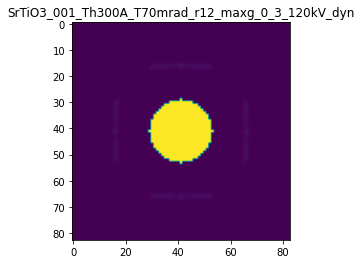

R-factor: 4.668696609448536e-05

>>> producing the 64. dataset...

The offset applied on thickness: -0.00040626037448461495

The offset applied on Ug: -1.0490122054410176

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5937396255154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

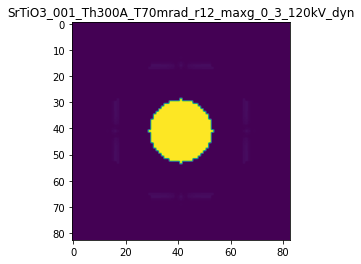

R-factor: 6.194251805615478e-06

>>> producing the 65. dataset...

The offset applied on thickness: -0.00040067512578267927

The offset applied on Ug: -5.024631326304614

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5993248742173
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

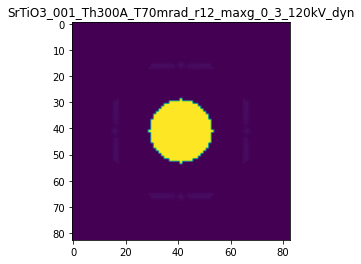

R-factor: 2.775025492908666e-05

>>> producing the 66. dataset...

The offset applied on thickness: 0.0007811166709450959

The offset applied on Ug: -5.5152973208479015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7811166709451
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

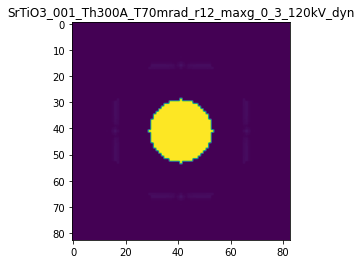

R-factor: 3.017129243484739e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.0005049160202379539

The offset applied on Ug: 7.901236028779424

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50491602023794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

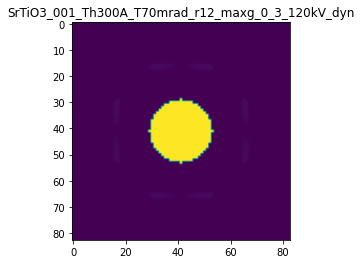

R-factor: 4.816588965190971e-05

>>> producing the 68. dataset...

The offset applied on thickness: -0.00016930218281074994

The offset applied on Ug: -9.882241725124517

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8306978171892
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

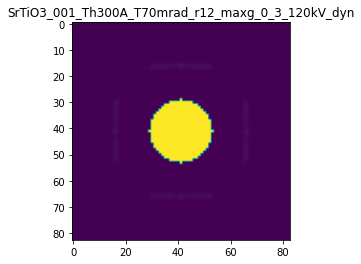

R-factor: 4.622833700914218e-05

>>> producing the 69. dataset...

The offset applied on thickness: 0.0009500038494585412

The offset applied on Ug: 0.8317410582056277

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95000384945854
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

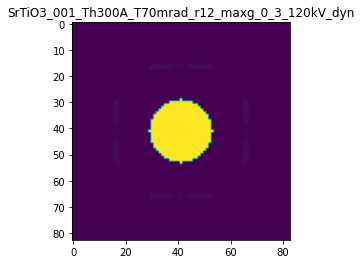

R-factor: 4.923970422194719e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.0008654040715105649

The offset applied on Ug: -5.35516075696047

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1345959284894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

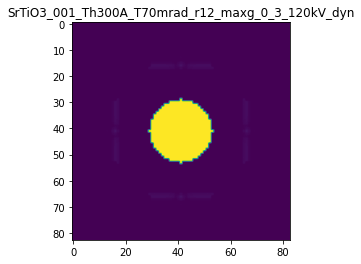

R-factor: 2.9331799944783094e-05

>>> producing the 71. dataset...

The offset applied on thickness: 0.0008752925434761776

The offset applied on Ug: 4.847655273234059

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8752925434762
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

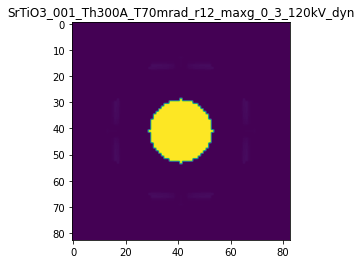

R-factor: 3.004077584026682e-05

>>> producing the 72. dataset...

The offset applied on thickness: -0.0007930833757709826

The offset applied on Ug: -8.705547713126842

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.206916624229
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

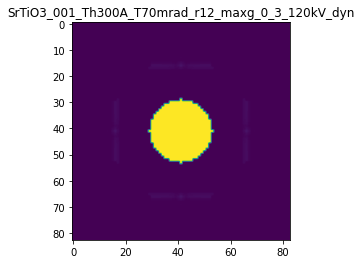

R-factor: 4.252857270036545e-05

>>> producing the 73. dataset...

The offset applied on thickness: -0.0008938733383549847

The offset applied on Ug: 4.340581433227612

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10612666164496
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

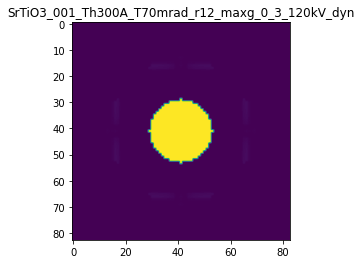

R-factor: 2.7627420184412795e-05

>>> producing the 74. dataset...

The offset applied on thickness: 0.0007891696982363177

The offset applied on Ug: -7.576114595436941

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7891696982363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

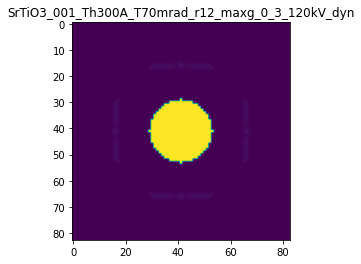

R-factor: 3.871199037443677e-05

>>> producing the 75. dataset...

The offset applied on thickness: -0.0005159992896486734

The offset applied on Ug: -6.416928335150849

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4840007103513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

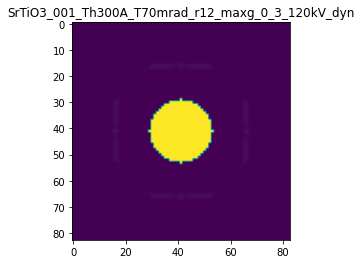

R-factor: 3.413464049336797e-05

>>> producing the 76. dataset...

The offset applied on thickness: -0.0002338720780930428

The offset applied on Ug: -3.1026805481992232

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76612792190696
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

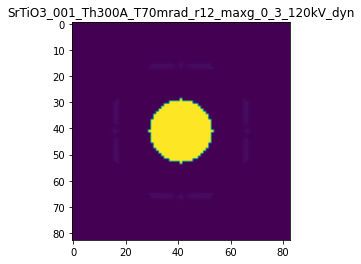

R-factor: 1.7907135274079105e-05

>>> producing the 77. dataset...

The offset applied on thickness: 0.0005998392414682447

The offset applied on Ug: 4.679091155010997

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5998392414682
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

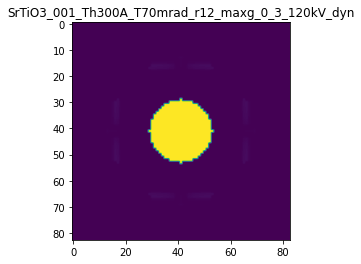

R-factor: 2.911106022910825e-05

>>> producing the 78. dataset...

The offset applied on thickness: -0.0008792597973928948

The offset applied on Ug: 7.200422078227168

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12074020260707
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

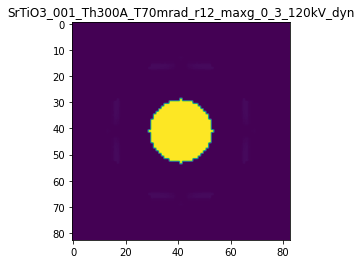

R-factor: 4.466938856600796e-05

>>> producing the 79. dataset...

The offset applied on thickness: -0.0002495966109463914

The offset applied on Ug: -7.839759675623307

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.75040338905364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

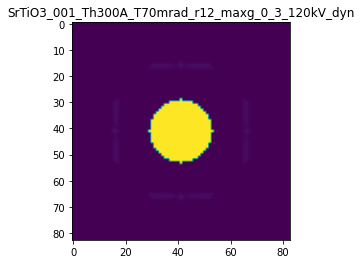

R-factor: 3.966866903276154e-05

>>> producing the 80. dataset...

The offset applied on thickness: -0.00016957181064923077

The offset applied on Ug: 10.03101803947799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83042818935076
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

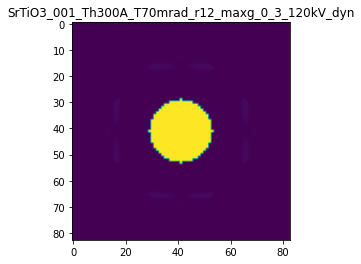

R-factor: 5.962302210818498e-05

>>> producing the 81. dataset...

The offset applied on thickness: 0.00041192289453960765

The offset applied on Ug: -3.859020190061349

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4119228945396
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

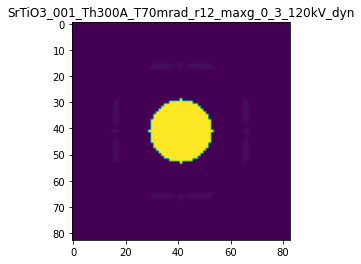

R-factor: 2.2075663445162727e-05

>>> producing the 82. dataset...

The offset applied on thickness: 0.0006489800403401483

The offset applied on Ug: 6.834403260309003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6489800403401
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

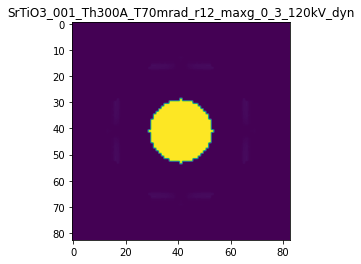

R-factor: 4.205396562150586e-05

>>> producing the 83. dataset...

The offset applied on thickness: -0.0008152330089432296

The offset applied on Ug: -1.1633032097275373

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1847669910568
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

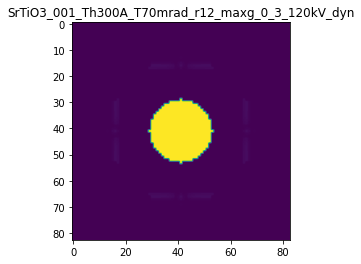

R-factor: 6.818430280042288e-06

>>> producing the 84. dataset...

The offset applied on thickness: -0.0007459470622680001

The offset applied on Ug: 4.9481644789052375

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.254052937732
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

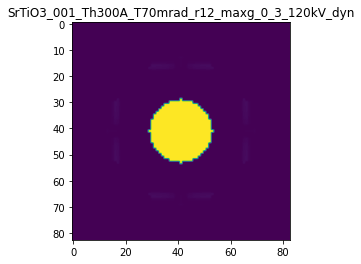

R-factor: 3.128118884797006e-05

>>> producing the 85. dataset...

The offset applied on thickness: 0.0006175598960005997

The offset applied on Ug: 7.965205910044126

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61755989600056
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

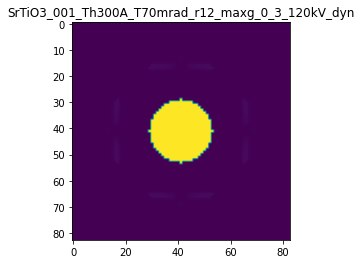

R-factor: 4.848531822569857e-05

>>> producing the 86. dataset...

The offset applied on thickness: -0.0009737936159642602

The offset applied on Ug: -9.83695254397437

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02620638403573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

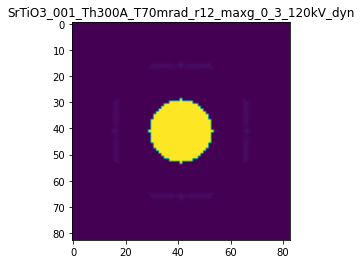

R-factor: 4.6249620988698584e-05

>>> producing the 87. dataset...

The offset applied on thickness: -0.000974289480001209

The offset applied on Ug: -4.21587151621029

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02571051999877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

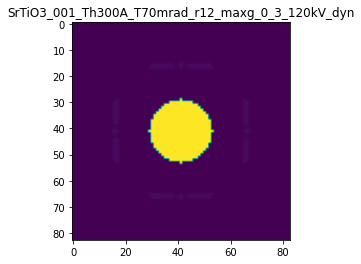

R-factor: 2.369415217791308e-05

>>> producing the 88. dataset...

The offset applied on thickness: 0.00035024582750527535

The offset applied on Ug: 6.273802207642445

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.35024582750526
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

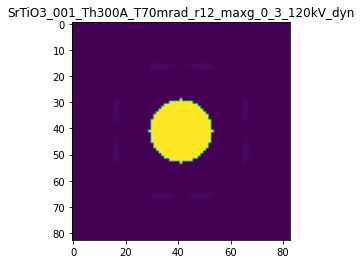

R-factor: 3.886648344415754e-05

>>> producing the 89. dataset...

The offset applied on thickness: -0.00011581315769348266

The offset applied on Ug: -10.175413274891953

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8841868423065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

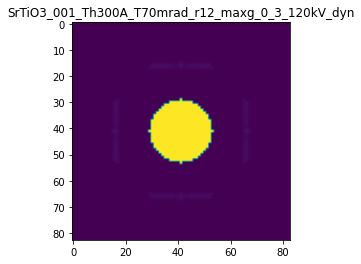

R-factor: 4.715203941213988e-05

>>> producing the 90. dataset...

The offset applied on thickness: 0.0005973987315027711

The offset applied on Ug: -2.0126567734636094

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5973987315028
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

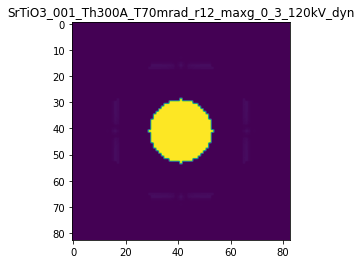

R-factor: 1.2210175205326037e-05

>>> producing the 91. dataset...

The offset applied on thickness: -0.0005691844550423813

The offset applied on Ug: -0.4629024535450731

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43081554495757
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

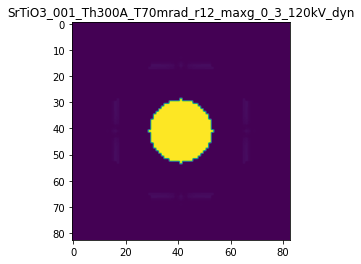

R-factor: 2.745616101268624e-06

>>> producing the 92. dataset...

The offset applied on thickness: 0.00014778183309636716

The offset applied on Ug: -7.600330242535797

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14778183309636
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

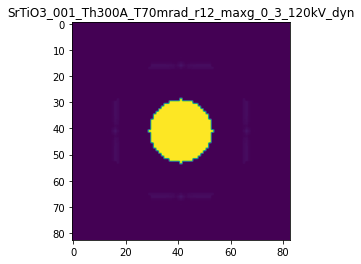

R-factor: 3.879739336076338e-05

>>> producing the 93. dataset...

The offset applied on thickness: -0.0007343337724323596

The offset applied on Ug: 0.2791838635156887

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26566622756764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

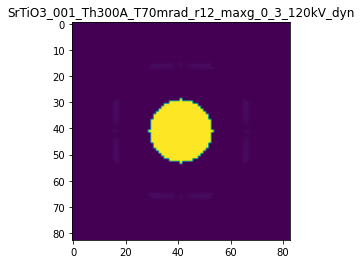

R-factor: 2.246973099076875e-06

>>> producing the 94. dataset...

The offset applied on thickness: 0.00026436312059626576

The offset applied on Ug: 9.525724289338662

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2643631205962
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

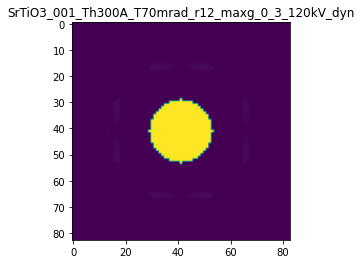

R-factor: 5.6924980403293894e-05

>>> producing the 95. dataset...

The offset applied on thickness: 0.00023257983891599078

The offset applied on Ug: 9.281847793904532

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23257983891597
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

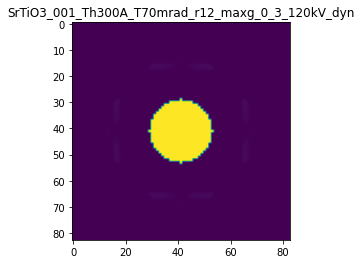

R-factor: 5.5674876101077274e-05

>>> producing the 96. dataset...

The offset applied on thickness: -0.0002561673763749437

The offset applied on Ug: 3.041364695757752

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74383262362505
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

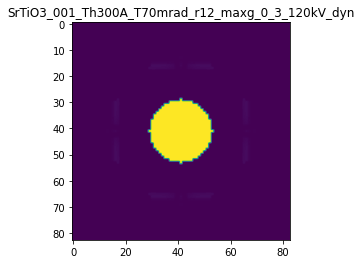

R-factor: 1.9241583875751226e-05

>>> producing the 97. dataset...

The offset applied on thickness: 0.00013567328677454872

The offset applied on Ug: -1.4268495018008822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13567328677453
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

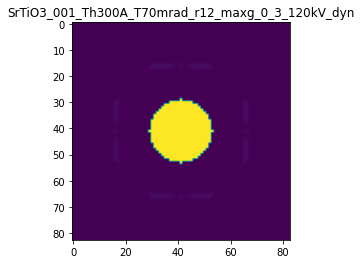

R-factor: 8.602348284651772e-06

>>> producing the 98. dataset...

The offset applied on thickness: -0.0009485152505563848

The offset applied on Ug: 9.725671250611425

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0514847494436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

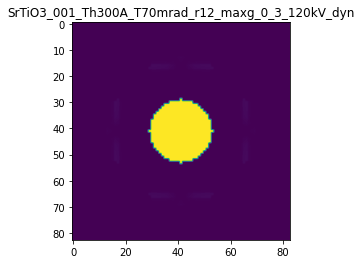

R-factor: 5.832839243054466e-05

>>> producing the 99. dataset...

The offset applied on thickness: -0.0003378401240153044

The offset applied on Ug: 6.269191657931296

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6621598759847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

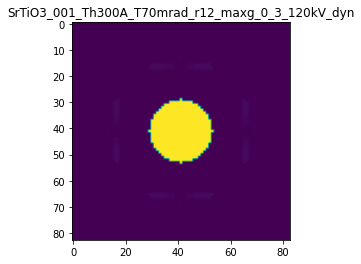

R-factor: 3.907408837778221e-05

>>> producing the 100. dataset...

The offset applied on thickness: -0.0005476578877826932

The offset applied on Ug: 2.17760480481174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45234211221725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

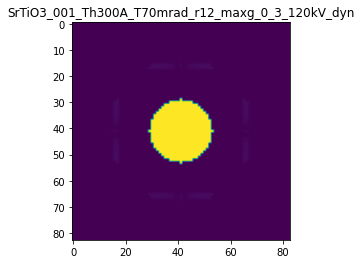

R-factor: 1.3918743668279272e-05

>>> producing the 101. dataset...

The offset applied on thickness: -0.0005811847226430053

The offset applied on Ug: 7.972087552636981

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.418815277357
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

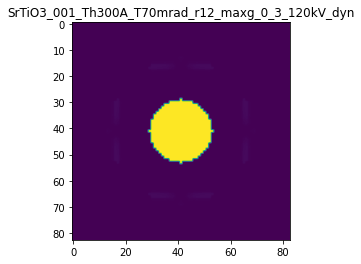

R-factor: 4.8906783155848754e-05

>>> producing the 102. dataset...

The offset applied on thickness: 0.0007487639336601104

The offset applied on Ug: 4.122250307548431

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74876393366014
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

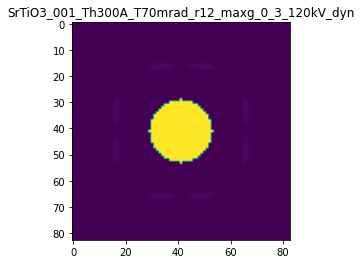

R-factor: 2.5608867269506613e-05

>>> producing the 103. dataset...

The offset applied on thickness: -0.00029980714313033617

The offset applied on Ug: 3.605028106798932

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70019285686965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

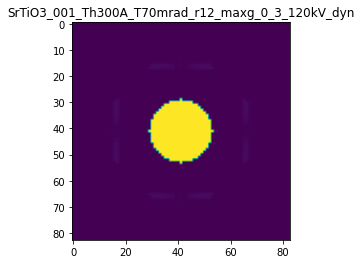

R-factor: 2.2800447677298215e-05

>>> producing the 104. dataset...

The offset applied on thickness: -0.0007254042457103338

The offset applied on Ug: -2.9722909812577725

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.27459575428963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

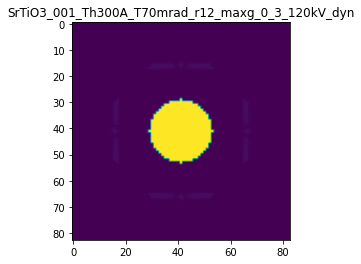

R-factor: 1.7103278696285432e-05

>>> producing the 105. dataset...

The offset applied on thickness: 3.1603570586500766e-05

The offset applied on Ug: 5.207555777939363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0316035705865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

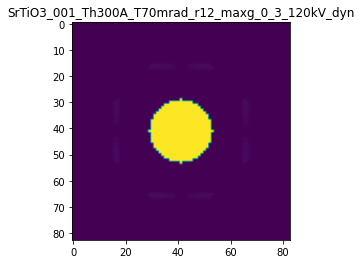

R-factor: 3.255465142067999e-05

>>> producing the 106. dataset...

The offset applied on thickness: -0.00014748762053542675

The offset applied on Ug: -4.746049402772654

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8525123794646
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

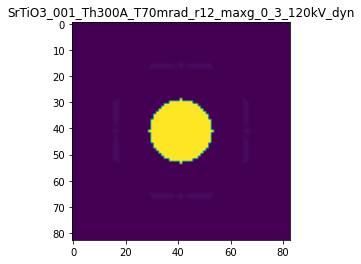

R-factor: 2.641570713991625e-05

>>> producing the 107. dataset...

The offset applied on thickness: -0.0003296728684417536

The offset applied on Ug: 1.2690391590824606

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6703271315582
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

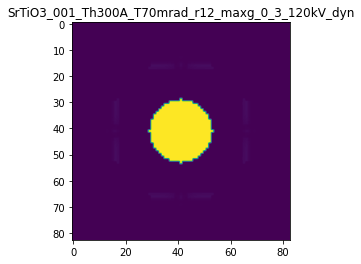

R-factor: 8.078410584267966e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.00030123126748577426

The offset applied on Ug: -3.5519293130114056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3012312674858
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

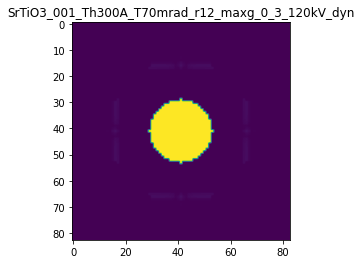

R-factor: 2.0444462572309378e-05

>>> producing the 109. dataset...

The offset applied on thickness: 0.0006647879156591365

The offset applied on Ug: 3.198826006360844

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66478791565913
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

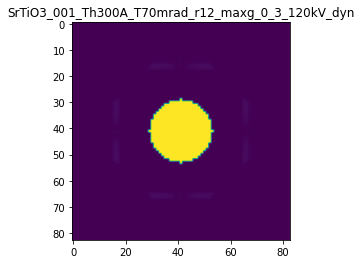

R-factor: 1.9844828094527993e-05

>>> producing the 110. dataset...

The offset applied on thickness: 0.00022512898475655097

The offset applied on Ug: 2.8691367984211387

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.22512898475657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

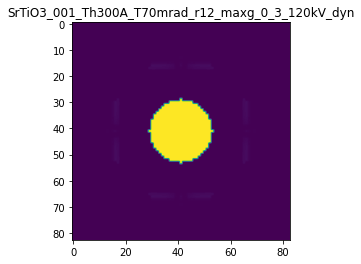

R-factor: 1.7942313413182196e-05

>>> producing the 111. dataset...

The offset applied on thickness: 0.000746828001573181

The offset applied on Ug: -9.55198386516385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74682800157314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

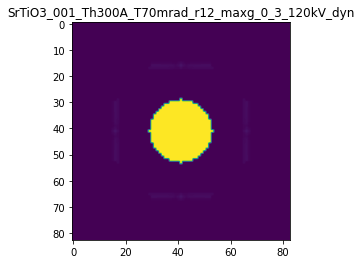

R-factor: 4.502170698633101e-05

>>> producing the 112. dataset...

The offset applied on thickness: -0.0004167876182464909

The offset applied on Ug: -5.735736604698168

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5832123817535
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

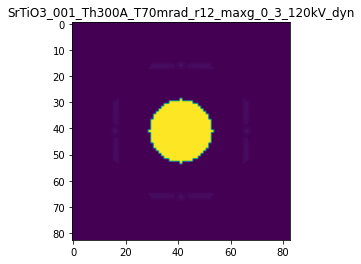

R-factor: 3.1092107559157415e-05

>>> producing the 113. dataset...

The offset applied on thickness: -0.0004793273619121006

The offset applied on Ug: -3.55047842484393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5206726380879
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

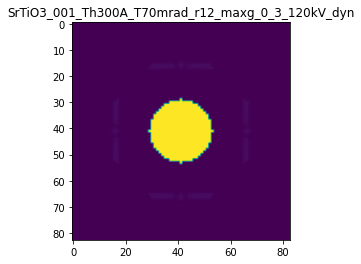

R-factor: 2.0258904260284068e-05

>>> producing the 114. dataset...

The offset applied on thickness: -0.0004331854979130694

The offset applied on Ug: 4.440620887431769

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.56681450208697
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

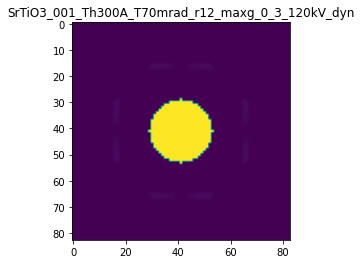

R-factor: 2.805106372464215e-05

>>> producing the 115. dataset...

The offset applied on thickness: -0.00047415406181013965

The offset applied on Ug: -7.705428851605907

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5258459381899
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

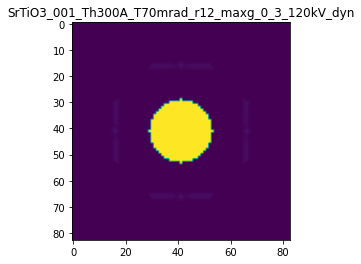

R-factor: 3.9200862758000036e-05

>>> producing the 116. dataset...

The offset applied on thickness: -0.0006652270722833915

The offset applied on Ug: -2.7423041672163846

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3347729277166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

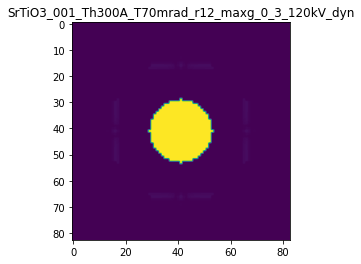

R-factor: 1.5844475436115467e-05

>>> producing the 117. dataset...

The offset applied on thickness: -0.0006545328164349034

The offset applied on Ug: -5.092491277755325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34546718356506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

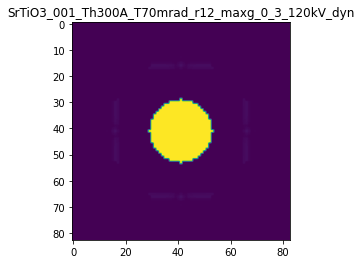

R-factor: 2.8061834943024544e-05

>>> producing the 118. dataset...

The offset applied on thickness: -0.0009670034777124721

The offset applied on Ug: 9.514963038916028

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03299652228753
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

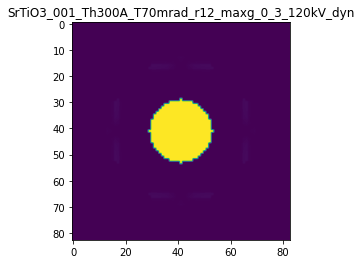

R-factor: 5.725743929297157e-05

>>> producing the 119. dataset...

The offset applied on thickness: 0.0009006443926539718

The offset applied on Ug: 6.427489027493528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.900644392654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

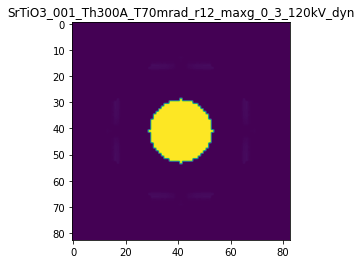

R-factor: 3.9592073080147704e-05

>>> producing the 120. dataset...

The offset applied on thickness: 0.0008067107273223411

The offset applied on Ug: 1.5088623880040928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.80671072732235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

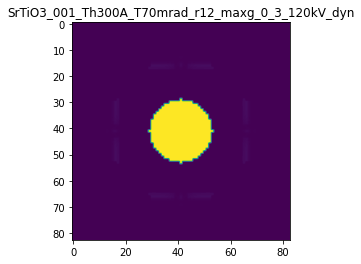

R-factor: 9.0548168604748e-06

>>> producing the 121. dataset...

The offset applied on thickness: -0.0003713627823248342

The offset applied on Ug: -0.3398932389609763

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62863721767513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

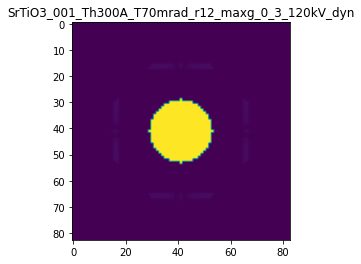

R-factor: 2.007221758625659e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.000939724952970318

The offset applied on Ug: 5.664587733917886

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0602750470296
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

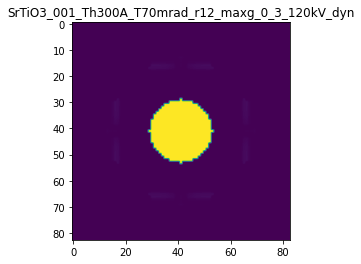

R-factor: 3.56730419498614e-05

>>> producing the 123. dataset...

The offset applied on thickness: -9.693959474441472e-05

The offset applied on Ug: -4.742647343883911

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.90306040525553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

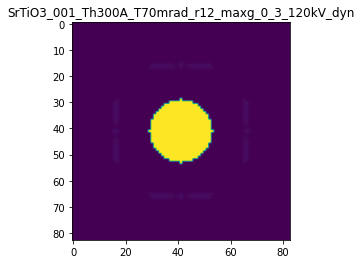

R-factor: 2.6403817372142996e-05

>>> producing the 124. dataset...

The offset applied on thickness: -0.00024656880593215425

The offset applied on Ug: 0.21574999013798335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.75343119406784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

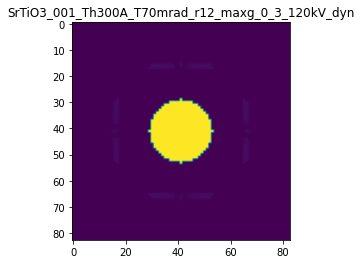

R-factor: 1.4834803206902658e-06

>>> producing the 125. dataset...

The offset applied on thickness: 0.0006141400431335337

The offset applied on Ug: 1.0131245133776587

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61414004313355
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

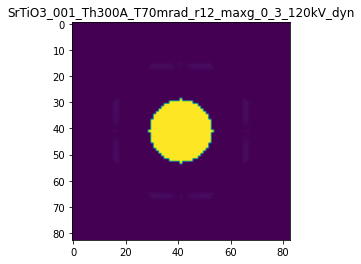

R-factor: 6.038209261415108e-06

>>> producing the 126. dataset...

The offset applied on thickness: -4.948137679384845e-05

The offset applied on Ug: 4.069810442736498

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95051862320616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

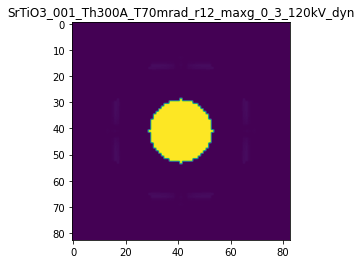

R-factor: 2.5599762873713287e-05

>>> producing the 127. dataset...

The offset applied on thickness: -0.0001434250983078258

The offset applied on Ug: -9.931285302235315

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85657490169217
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

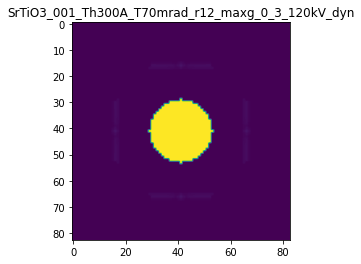

R-factor: 4.638310841608553e-05

>>> producing the 128. dataset...

The offset applied on thickness: 0.0007681302947264044

The offset applied on Ug: 9.989442636372697

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7681302947264
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

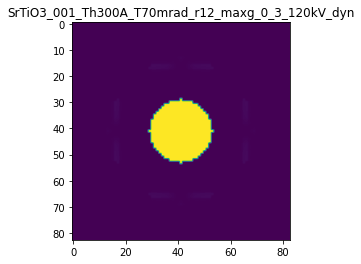

R-factor: 5.912324866448614e-05

>>> producing the 129. dataset...

The offset applied on thickness: 0.00013795950315350592

The offset applied on Ug: -8.72318373691202

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13795950315347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

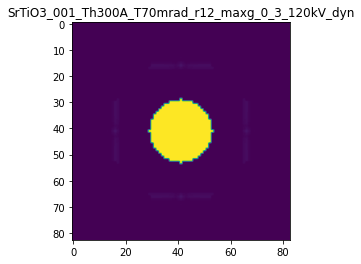

R-factor: 4.2542191660343405e-05

>>> producing the 130. dataset...

The offset applied on thickness: 0.0008309375806662894

The offset applied on Ug: 2.9312428241142037

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8309375806663
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

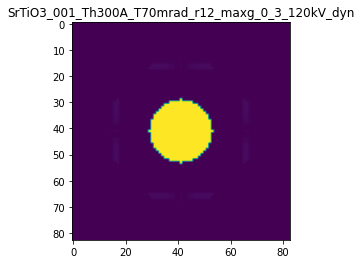

R-factor: 1.808200086193075e-05

>>> producing the 131. dataset...

The offset applied on thickness: -0.0007844966005042136

The offset applied on Ug: -3.3126781901613844

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2155033994958
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

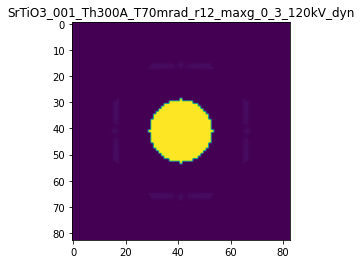

R-factor: 1.8943320967327977e-05

>>> producing the 132. dataset...

The offset applied on thickness: 0.00011948918635922889

The offset applied on Ug: -3.909876985118815

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1194891863592
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

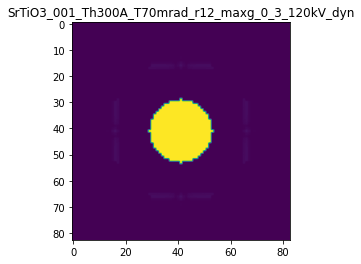

R-factor: 2.2259450297372382e-05

>>> producing the 133. dataset...

The offset applied on thickness: -0.0006816594345171272

The offset applied on Ug: -9.298787066644485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31834056548286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

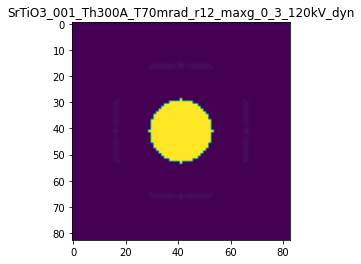

R-factor: 4.4403351698796606e-05

>>> producing the 134. dataset...

The offset applied on thickness: 0.0009146845054890465

The offset applied on Ug: 7.144834195682385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91468450548905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

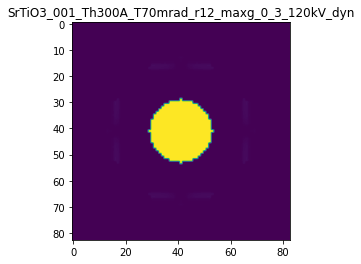

R-factor: 4.3760692182295965e-05

>>> producing the 135. dataset...

The offset applied on thickness: 0.00043862970511016265

The offset applied on Ug: -3.0545102660265004

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43862970511015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

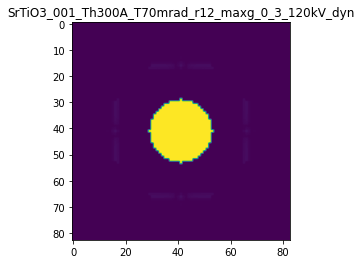

R-factor: 1.7846404664483337e-05

>>> producing the 136. dataset...

The offset applied on thickness: -0.0002318820635275609

The offset applied on Ug: -9.777864775668645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7681179364724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

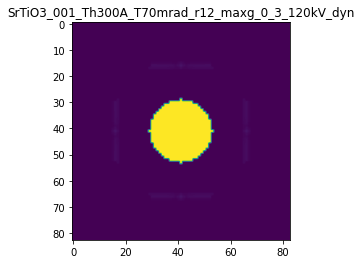

R-factor: 4.589586611163913e-05

>>> producing the 137. dataset...

The offset applied on thickness: -0.000957690921778456

The offset applied on Ug: 8.940604230623398

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04230907822154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

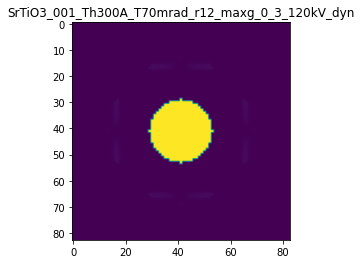

R-factor: 5.42633157101431e-05

>>> producing the 138. dataset...

The offset applied on thickness: -0.0002468293044087973

The offset applied on Ug: -7.893805031711529

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7531706955912
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

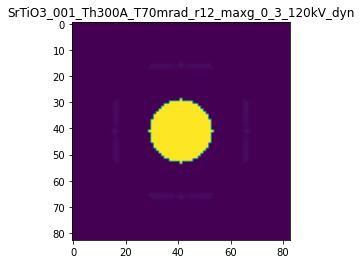

R-factor: 3.9857030441260815e-05

>>> producing the 139. dataset...

The offset applied on thickness: 7.98694237730373e-05

The offset applied on Ug: 7.560116272392695

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.079869423773
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

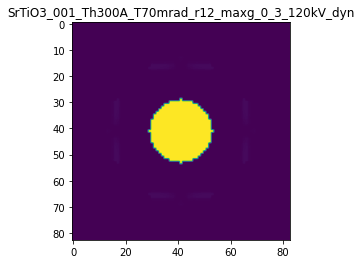

R-factor: 4.639322260360005e-05

>>> producing the 140. dataset...

The offset applied on thickness: 2.0209714351187015e-05

The offset applied on Ug: 6.690164507442362

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.02020971435115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

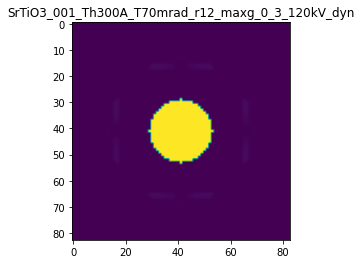

R-factor: 4.142446809539504e-05



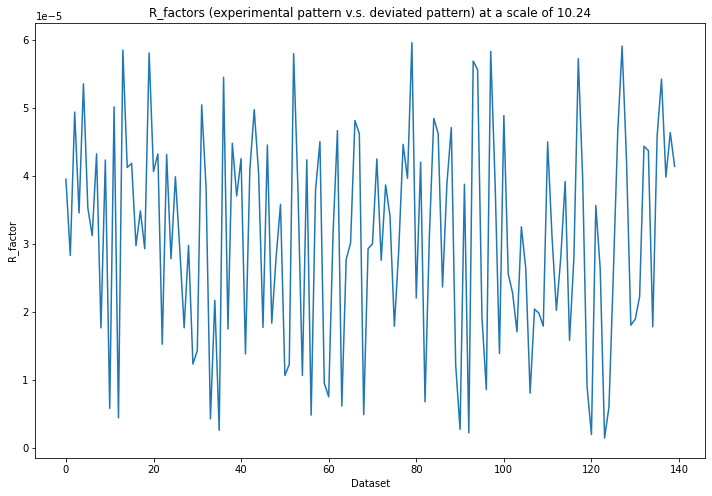

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 370ms/step - loss: 0.2882 - acc: 0.0000e+00 - val_loss: 0.2389 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 218ms/step - loss: 0.2179 - acc: 0.0000e+00 - val_loss: 0.1698 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 230ms/step - loss: 0.1578 - acc: 0.0000e+00 - val_loss: 0.1305 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 239ms/step - loss: 0.1277 - acc: 0.0000e+00 - val_loss: 0.1093 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 219ms/step - loss: 0.1085 - acc: 0.0000e+00 - val_loss: 0.0911 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 206ms/step - loss: 0.0880 - acc: 0.0000e+00 - val_loss: 0.0678 - val_acc: 0.0000e+00
Epoch 7/20
5/5 [==============================] - 1s 232ms/step - loss: 0.0661 - acc: 0.0000e+00 - val_loss: 0.0477 - val_acc: 0.0000e+00
Epoch

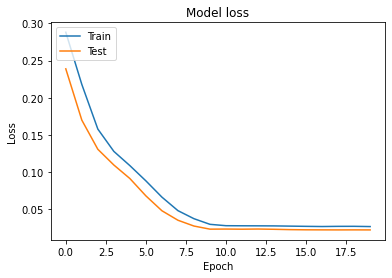

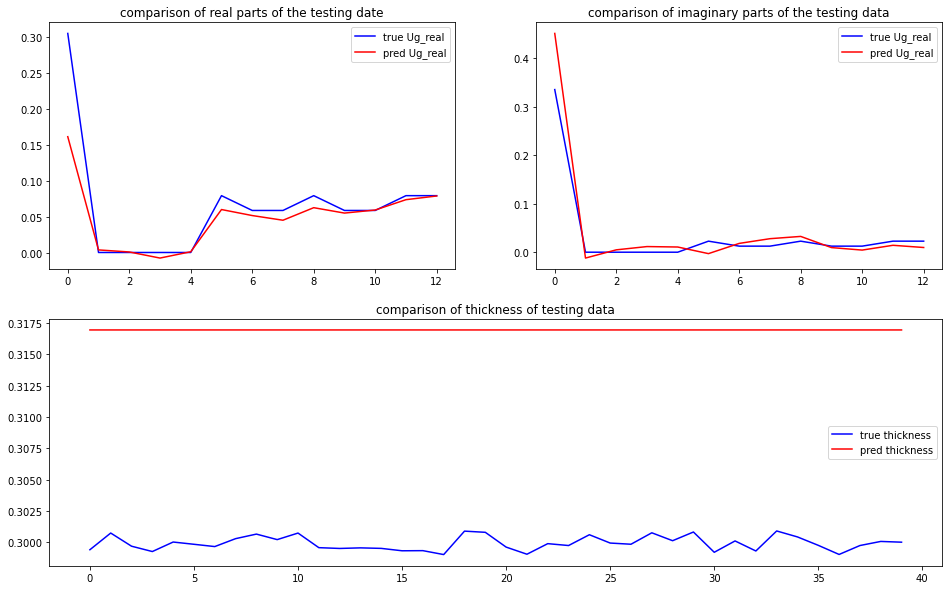

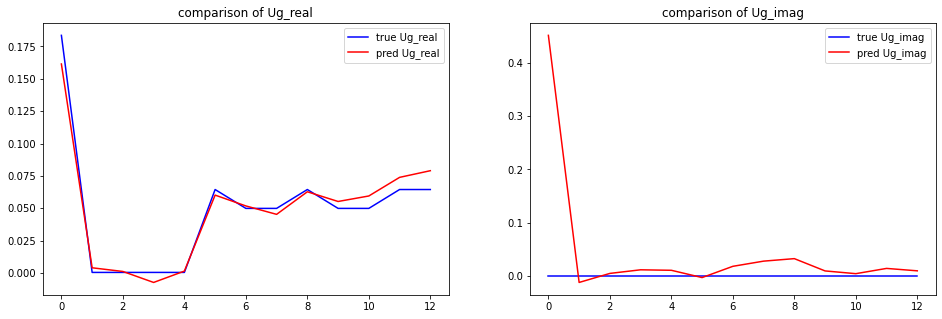

predicted thickness: 31.693533062934875 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=316.93533062934875
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.16142856+0.j          0.00

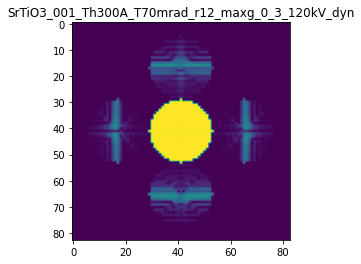

X_sim.max(): 0.9996353358874335
R-factor at a scale of 10.24 is 0.02395034182889367.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 20.48

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.0008667112930154877

The offset applied on Ug: -3.356881922182811

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
ta

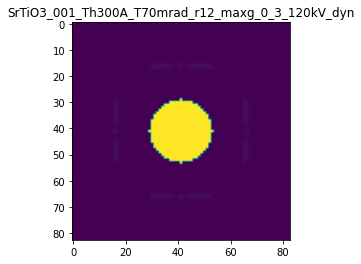

R-factor: 1.9621499069211305e-05

>>> producing the 2. dataset...

The offset applied on thickness: 0.0006741576650439231

The offset applied on Ug: -16.02238696623237

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6741576650439
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

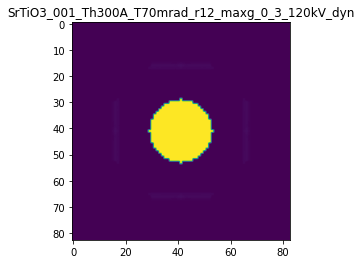

R-factor: 6.417357835574994e-05

>>> producing the 3. dataset...

The offset applied on thickness: 0.0009364736016336985

The offset applied on Ug: -10.962926468858905

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9364736016337
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

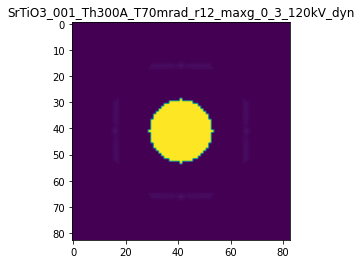

R-factor: 4.9316124347221546e-05

>>> producing the 4. dataset...

The offset applied on thickness: 0.0007265799035695448

The offset applied on Ug: 8.975624577393287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72657990356953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

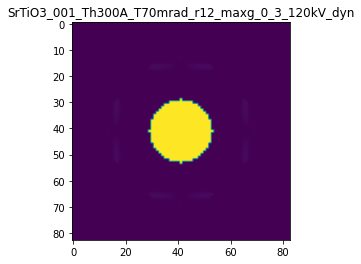

R-factor: 5.391676863644727e-05

>>> producing the 5. dataset...

The offset applied on thickness: -4.0989005383791134e-05

The offset applied on Ug: 13.951390166894617

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95901099461616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

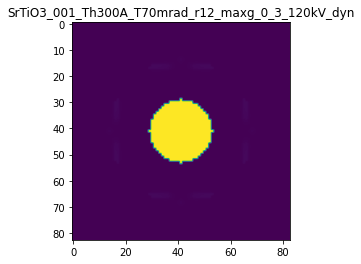

R-factor: 7.839351742677808e-05

>>> producing the 6. dataset...

The offset applied on thickness: 0.0009844310390743289

The offset applied on Ug: 5.875187811577821

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9844310390743
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

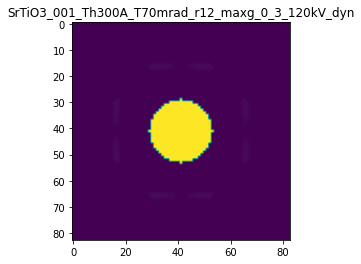

R-factor: 3.627237318164244e-05

>>> producing the 7. dataset...

The offset applied on thickness: -0.000315163572386405

The offset applied on Ug: -1.4771514847773597

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68483642761356
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

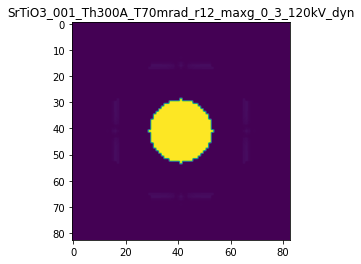

R-factor: 8.726886709142847e-06

>>> producing the 8. dataset...

The offset applied on thickness: 0.0009617542522502567

The offset applied on Ug: -0.6671686878824948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9617542522503
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

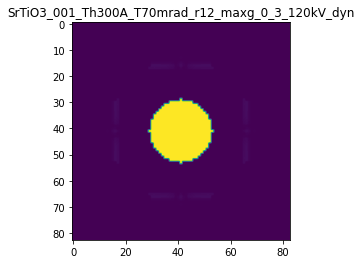

R-factor: 4.701370061775491e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.0006895352544869511

The offset applied on Ug: -0.48285642999740047

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31046474551306
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

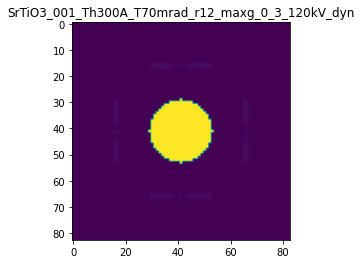

R-factor: 2.896098695104404e-06

>>> producing the 10. dataset...

The offset applied on thickness: -0.0003580011327225403

The offset applied on Ug: -5.376824690488416

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.64199886727744
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

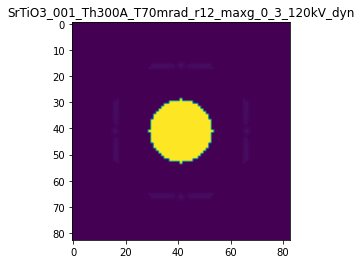

R-factor: 2.941904319573215e-05

>>> producing the 11. dataset...

The offset applied on thickness: 0.00010976646200322304

The offset applied on Ug: -17.598575360822757

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1097664620032
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

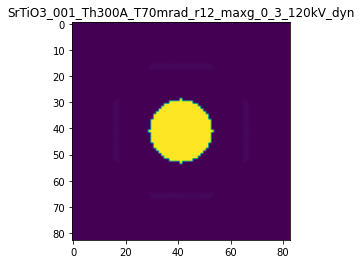

R-factor: 7.098448820945614e-05

>>> producing the 12. dataset...

The offset applied on thickness: 0.0004986002302085548

The offset applied on Ug: 4.072990130127987

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4986002302085
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

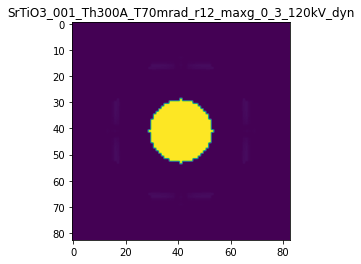

R-factor: 2.5400354199671225e-05

>>> producing the 13. dataset...

The offset applied on thickness: -0.0005433424985395329

The offset applied on Ug: 17.366405051479745

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4566575014604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

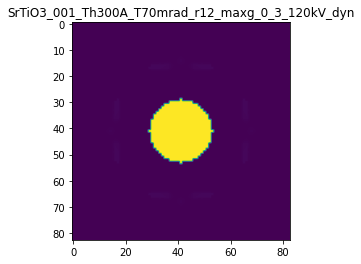

R-factor: 9.315098290553396e-05

>>> producing the 14. dataset...

The offset applied on thickness: 0.0008994574107494933

The offset applied on Ug: 16.81394923978645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.89945741074945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

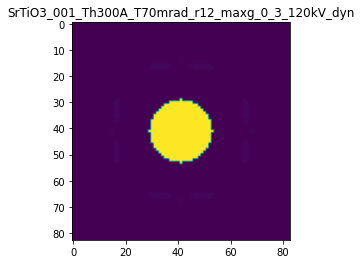

R-factor: 9.052446248055627e-05

>>> producing the 15. dataset...

The offset applied on thickness: -6.487043893188061e-05

The offset applied on Ug: 4.298921063803341

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9351295610681
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

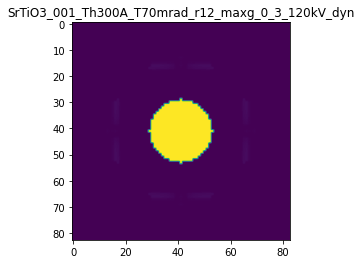

R-factor: 2.7027903972988533e-05

>>> producing the 16. dataset...

The offset applied on thickness: 0.0006614462729033659

The offset applied on Ug: -18.221094085504866

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6614462729034
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

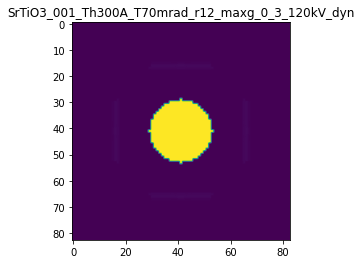

R-factor: 7.348609408098075e-05

>>> producing the 17. dataset...

The offset applied on thickness: -0.00014566217204394462

The offset applied on Ug: 10.733902752833506

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85433782795604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

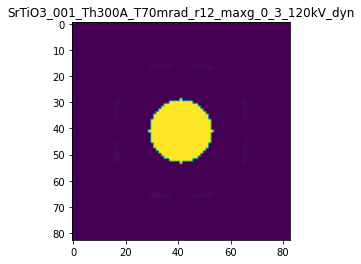

R-factor: 6.309809195783865e-05

>>> producing the 18. dataset...

The offset applied on thickness: -0.0005129617082433455

The offset applied on Ug: -5.0143770287687675

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4870382917567
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

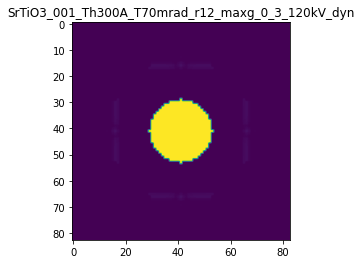

R-factor: 2.769474544214963e-05

>>> producing the 19. dataset...

The offset applied on thickness: 0.0007194922613089165

The offset applied on Ug: 15.293773123308792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7194922613089
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

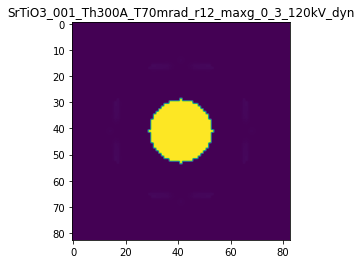

R-factor: 8.41042196455416e-05

>>> producing the 20. dataset...

The offset applied on thickness: 0.0009921561753960914

The offset applied on Ug: 14.421098507975898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9921561753961
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

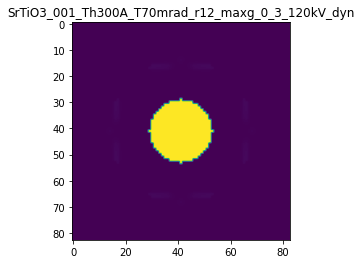

R-factor: 8.017833185828828e-05

>>> producing the 21. dataset...

The offset applied on thickness: 0.0009885857463129912

The offset applied on Ug: -7.402843682752769

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.988585746313
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

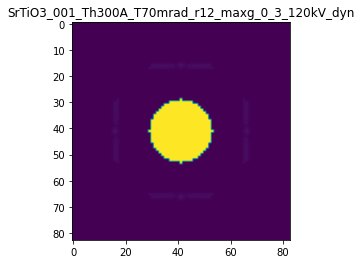

R-factor: 3.808568823155303e-05

>>> producing the 22. dataset...

The offset applied on thickness: -0.0005861644242366555

The offset applied on Ug: -15.01791560804818

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41383557576336
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

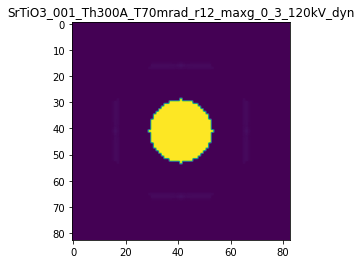

R-factor: 6.132047789802698e-05

>>> producing the 23. dataset...

The offset applied on thickness: 0.0008755808368159448

The offset applied on Ug: -3.315809539687789

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8755808368159
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

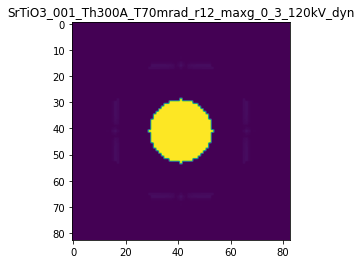

R-factor: 1.9409011474252267e-05

>>> producing the 24. dataset...

The offset applied on thickness: 1.8062469947408788e-05

The offset applied on Ug: 14.175731494954912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0180624699474
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

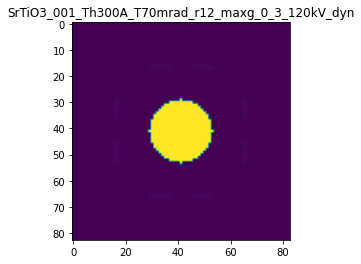

R-factor: 7.937856499229606e-05

>>> producing the 25. dataset...

The offset applied on thickness: -0.0005222657327894611

The offset applied on Ug: 6.011939448024891

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4777342672105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

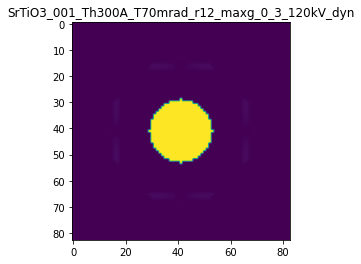

R-factor: 3.760861754897341e-05

>>> producing the 26. dataset...

The offset applied on thickness: -0.0003935373676537879

The offset applied on Ug: -11.433529434719386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.60646263234617
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

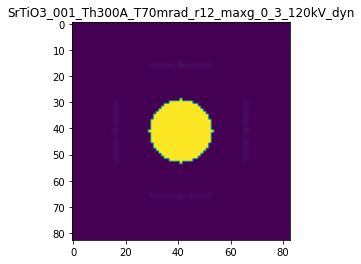

R-factor: 5.105411471925174e-05

>>> producing the 27. dataset...

The offset applied on thickness: -0.0007666383785490951

The offset applied on Ug: -11.364283939616067

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23336162145085
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

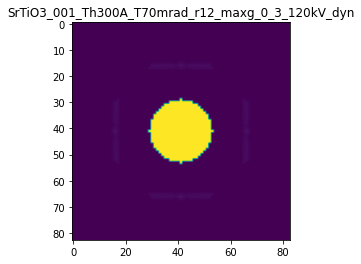

R-factor: 5.095313283020874e-05

>>> producing the 28. dataset...

The offset applied on thickness: 0.00027958323172043296

The offset applied on Ug: 13.053516213187214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27958323172044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

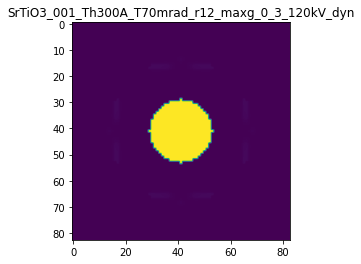

R-factor: 7.41966594596777e-05

>>> producing the 29. dataset...

The offset applied on thickness: 0.00025578702635185825

The offset applied on Ug: 6.57407264278912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25578702635187
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

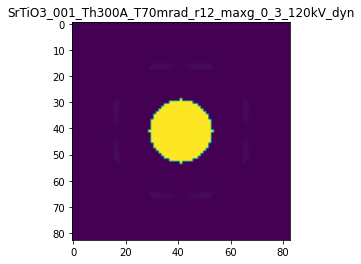

R-factor: 4.0667401059244905e-05

>>> producing the 30. dataset...

The offset applied on thickness: -0.0006741616023073227

The offset applied on Ug: -18.47418318303318

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3258383976927
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

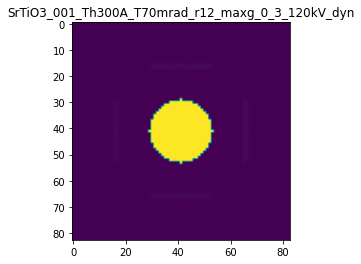

R-factor: 7.509030999338102e-05

>>> producing the 31. dataset...

The offset applied on thickness: -0.0006857077395824045

The offset applied on Ug: -0.7461076146149708

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3142922604176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

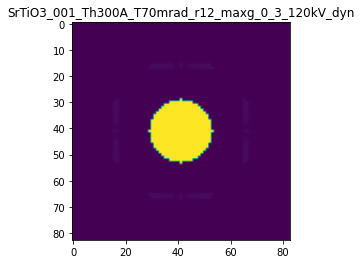

R-factor: 4.38525090708784e-06

>>> producing the 32. dataset...

The offset applied on thickness: -0.0009891006427424692

The offset applied on Ug: 14.647318039355465

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0108993572575
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

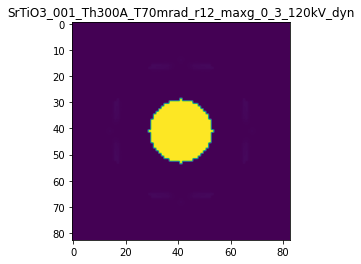

R-factor: 8.175006428332897e-05

>>> producing the 33. dataset...

The offset applied on thickness: -0.00011460006567874981

The offset applied on Ug: -16.42847749622126

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88539993432124
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

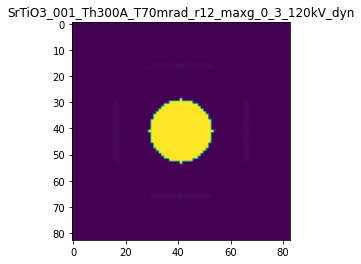

R-factor: 6.615757499776159e-05

>>> producing the 34. dataset...

The offset applied on thickness: 3.4079797731483285e-05

The offset applied on Ug: 9.807099361476025

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.03407979773147
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

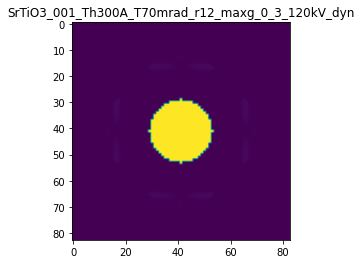

R-factor: 5.8432205549696356e-05

>>> producing the 35. dataset...

The offset applied on thickness: -0.0008409243003094389

The offset applied on Ug: 13.915835168433537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1590756996905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

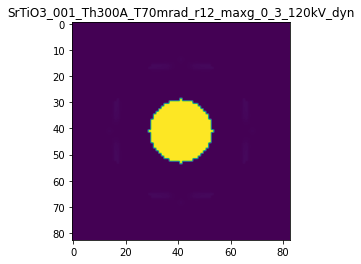

R-factor: 7.846809304424662e-05

>>> producing the 36. dataset...

The offset applied on thickness: 0.0005082205965927973

The offset applied on Ug: -14.408178425379047

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50822059659276
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

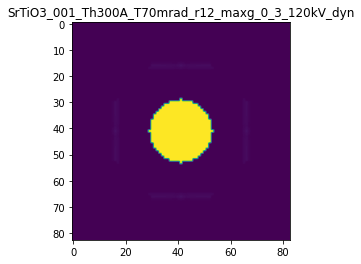

R-factor: 5.932865778720589e-05

>>> producing the 37. dataset...

The offset applied on thickness: -0.0008587385515546153

The offset applied on Ug: -6.3767881669836015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1412614484454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

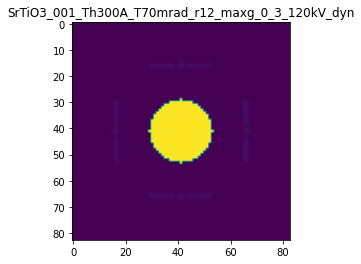

R-factor: 3.39737332794367e-05

>>> producing the 38. dataset...

The offset applied on thickness: 0.00043779430385920026

The offset applied on Ug: 1.5887093102349763

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4377943038592
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

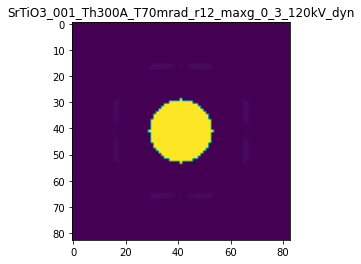

R-factor: 9.723924411075172e-06

>>> producing the 39. dataset...

The offset applied on thickness: -0.00045969882921883246

The offset applied on Ug: 7.649553674334839

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54030117078116
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

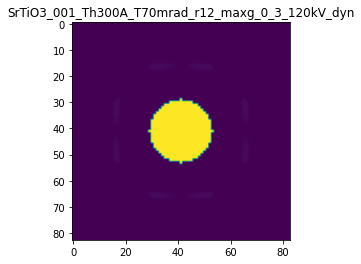

R-factor: 4.707202394513175e-05

>>> producing the 40. dataset...

The offset applied on thickness: -0.0004736033312653429

The offset applied on Ug: -7.662103662413661

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52639666873466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

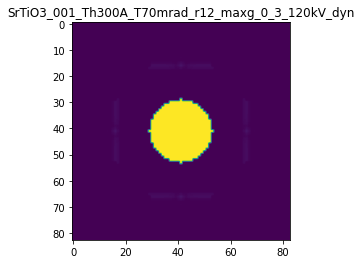

R-factor: 3.904456744901155e-05

>>> producing the 41. dataset...

The offset applied on thickness: -0.00032608697263721156

The offset applied on Ug: 4.239654940358937

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6739130273628
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

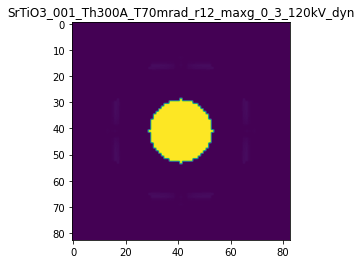

R-factor: 2.6766523035494992e-05

>>> producing the 42. dataset...

The offset applied on thickness: 0.0007086853208236175

The offset applied on Ug: -10.341135019705776

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.70868532082363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

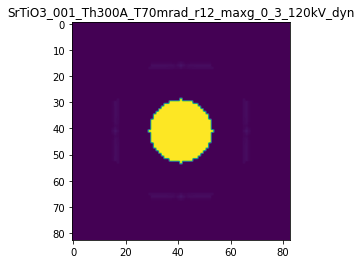

R-factor: 4.750927747714334e-05

>>> producing the 43. dataset...

The offset applied on thickness: -0.0006793086846653318

The offset applied on Ug: 3.393477050165807

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32069131533467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

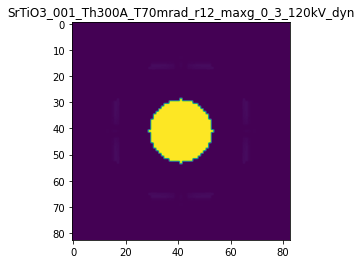

R-factor: 2.1645700018828538e-05

>>> producing the 44. dataset...

The offset applied on thickness: -4.7748016576671934e-06

The offset applied on Ug: 12.003876075008124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9952251983423
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

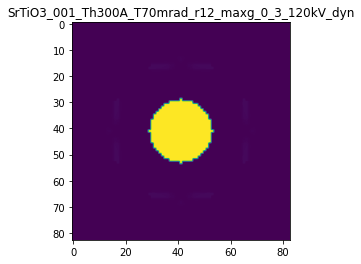

R-factor: 6.929399133499031e-05

>>> producing the 45. dataset...

The offset applied on thickness: -0.0007653051757619993

The offset applied on Ug: 6.743007008558252

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.234694824238
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

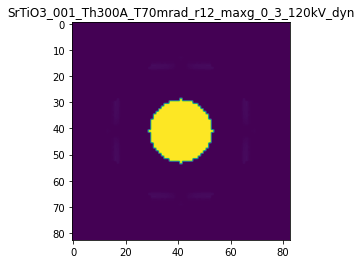

R-factor: 4.199760172541713e-05

>>> producing the 46. dataset...

The offset applied on thickness: 0.0002780972855628723

The offset applied on Ug: -11.365639743650977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27809728556286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

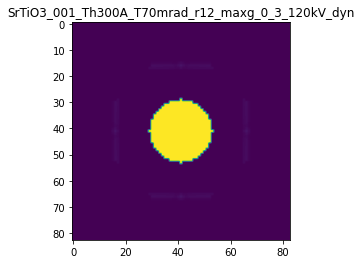

R-factor: 5.067047880854389e-05

>>> producing the 47. dataset...

The offset applied on thickness: -0.000689050608708641

The offset applied on Ug: -19.14192403217588

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31094939129133
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

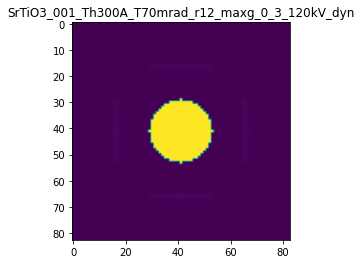

R-factor: 7.86542035961543e-05

>>> producing the 48. dataset...

The offset applied on thickness: 0.00029680570912595395

The offset applied on Ug: -18.02670294892533

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2968057091259
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

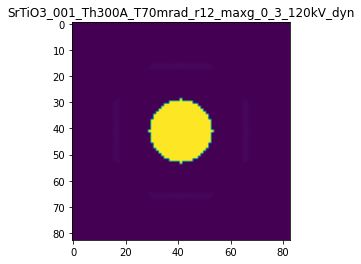

R-factor: 7.276211234836936e-05

>>> producing the 49. dataset...

The offset applied on thickness: 0.0004330925688882434

The offset applied on Ug: -3.6417231714921945

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43309256888824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

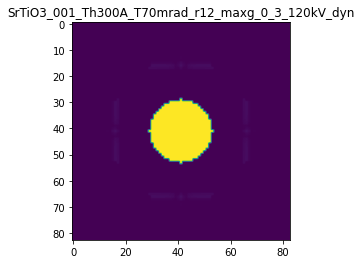

R-factor: 2.095415489159383e-05

>>> producing the 50. dataset...

The offset applied on thickness: -0.00016599778263024924

The offset applied on Ug: -14.426356678169327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83400221736974
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

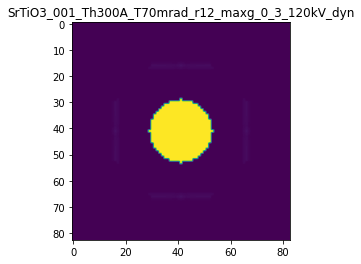

R-factor: 5.955104888980949e-05

>>> producing the 51. dataset...

The offset applied on thickness: 4.694003738814145e-05

The offset applied on Ug: -13.740066935449377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04694003738814
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

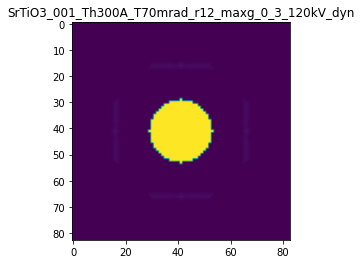

R-factor: 5.755284729410009e-05

>>> producing the 52. dataset...

The offset applied on thickness: 0.00036615680146072816

The offset applied on Ug: -1.4092112550692537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3661568014607
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

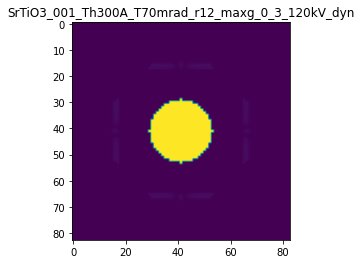

R-factor: 8.641677203090299e-06

>>> producing the 53. dataset...

The offset applied on thickness: 0.0006298978417478613

The offset applied on Ug: 2.582289681294583

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6298978417479
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

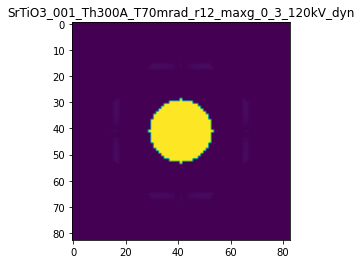

R-factor: 1.5950207850978773e-05

>>> producing the 54. dataset...

The offset applied on thickness: 0.0005542820288286719

The offset applied on Ug: 19.97591076510317

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55428202882865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

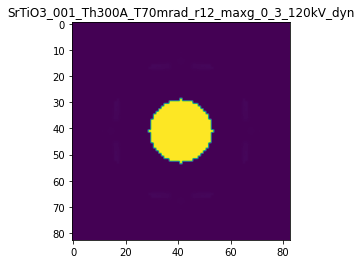

R-factor: 0.00010323666816615337

>>> producing the 55. dataset...

The offset applied on thickness: 0.0008714434902541239

The offset applied on Ug: -15.703311598465426

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87144349025414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

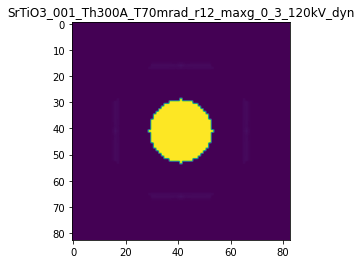

R-factor: 6.295559046524637e-05

>>> producing the 56. dataset...

The offset applied on thickness: -0.00010517783098321076

The offset applied on Ug: -16.359247906075698

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8948221690168
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

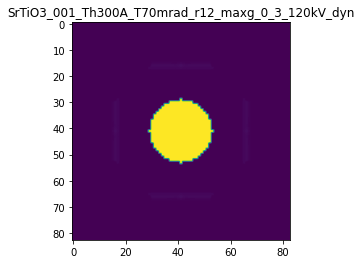

R-factor: 6.586311393423687e-05

>>> producing the 57. dataset...

The offset applied on thickness: 0.00038159819020872445

The offset applied on Ug: -12.854137812737404

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3815981902087
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

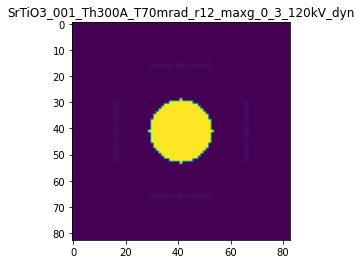

R-factor: 5.488254421814752e-05

>>> producing the 58. dataset...

The offset applied on thickness: 0.0009165545835589568

The offset applied on Ug: 9.894119213881641

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91655458355893
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

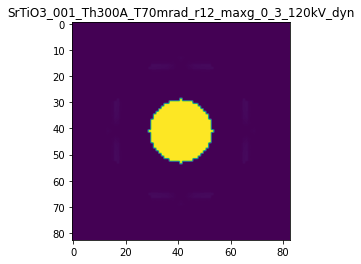

R-factor: 5.8598481466328635e-05

>>> producing the 59. dataset...

The offset applied on thickness: -0.0009517549217223466

The offset applied on Ug: -12.787280253112886

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04824507827766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

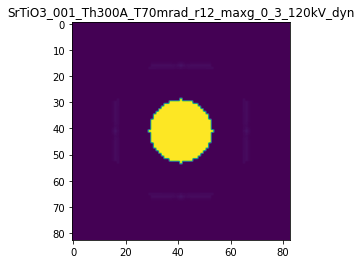

R-factor: 5.506536595062773e-05

>>> producing the 60. dataset...

The offset applied on thickness: -5.189409896987041e-05

The offset applied on Ug: -18.14864733212926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9481059010301
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

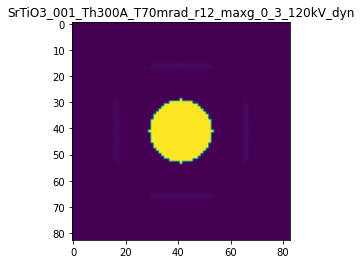

R-factor: 7.34045829545067e-05

>>> producing the 61. dataset...

The offset applied on thickness: -0.0003845053181030833

The offset applied on Ug: -0.3284402347894957

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6154946818969
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

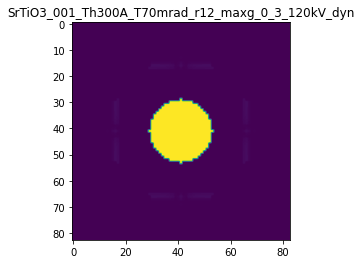

R-factor: 1.9445907961753664e-06

>>> producing the 62. dataset...

The offset applied on thickness: 3.992536435624206e-05

The offset applied on Ug: -12.294680941914848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.03992536435624
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

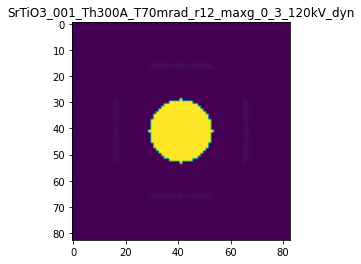

R-factor: 5.341392901814083e-05

>>> producing the 63. dataset...

The offset applied on thickness: -0.0005315344539410361

The offset applied on Ug: -2.661440000911516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46846554605895
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

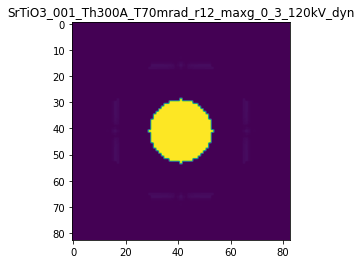

R-factor: 1.541940764575218e-05

>>> producing the 64. dataset...

The offset applied on thickness: -0.0009852356263190412

The offset applied on Ug: -6.305051482490139

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.014764373681
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

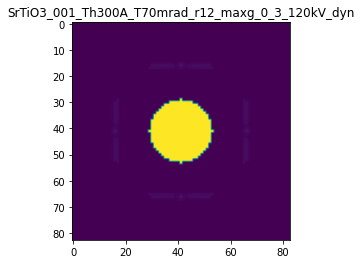

R-factor: 3.366960390900411e-05

>>> producing the 65. dataset...

The offset applied on thickness: 0.0008669336986869909

The offset applied on Ug: 3.4540431231583217

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.866933698687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

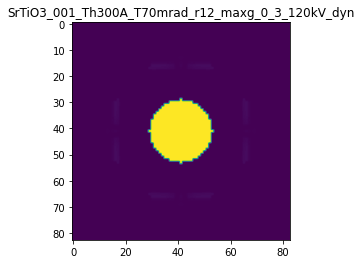

R-factor: 2.1372104398987025e-05

>>> producing the 66. dataset...

The offset applied on thickness: 0.0004942199047390627

The offset applied on Ug: 17.588859977366727

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49421990473905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

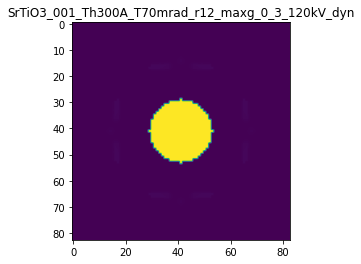

R-factor: 9.381342763361781e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.0007559774891540982

The offset applied on Ug: -5.324952913437382

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75597748915413
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

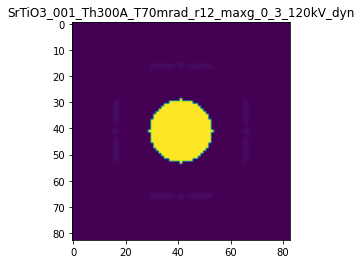

R-factor: 2.9294886079272632e-05

>>> producing the 68. dataset...

The offset applied on thickness: -0.000324891690321484

The offset applied on Ug: 8.28615483755978

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.67510830967854
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

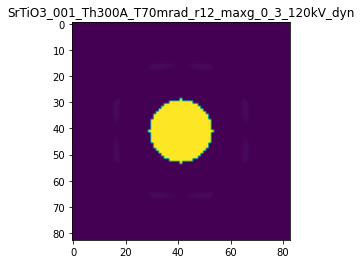

R-factor: 5.054896799969015e-05

>>> producing the 69. dataset...

The offset applied on thickness: 0.0002365486180037737

The offset applied on Ug: -5.998629390732567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2365486180037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

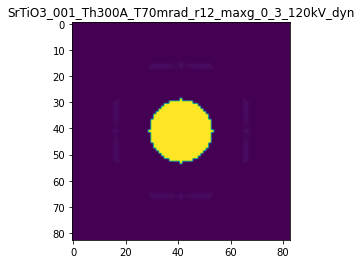

R-factor: 3.227910226951277e-05

>>> producing the 70. dataset...

The offset applied on thickness: -0.00020306010939188224

The offset applied on Ug: 19.223897643734176

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.79693989060814
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

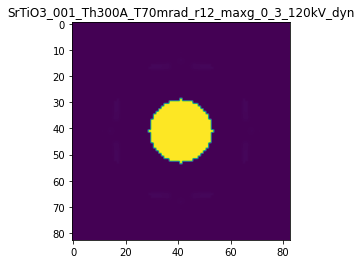

R-factor: 0.00010046209519799304

>>> producing the 71. dataset...

The offset applied on thickness: -0.0005567443768120799

The offset applied on Ug: -18.179964085655616

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4432556231879
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

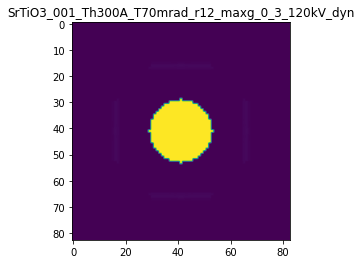

R-factor: 7.370540609796839e-05

>>> producing the 72. dataset...

The offset applied on thickness: -0.00016434469800883988

The offset applied on Ug: 18.9684896512444

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83565530199115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

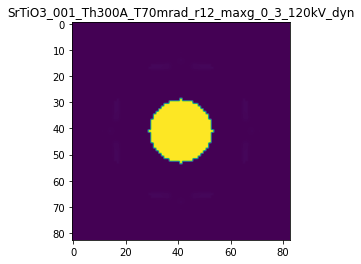

R-factor: 9.946282189419083e-05

>>> producing the 73. dataset...

The offset applied on thickness: 0.0005516405700093632

The offset applied on Ug: -14.940137043640512

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55164057000934
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

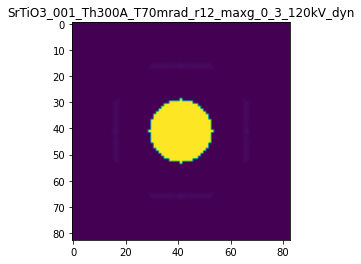

R-factor: 6.078960736983235e-05

>>> producing the 74. dataset...

The offset applied on thickness: 0.0005060975050027523

The offset applied on Ug: 16.744978090521723

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50609750500274
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

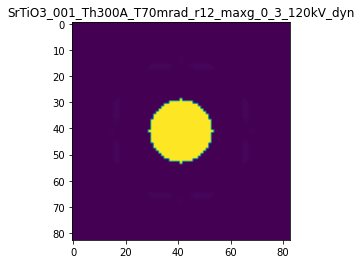

R-factor: 9.033507237142569e-05

>>> producing the 75. dataset...

The offset applied on thickness: -0.00046222741483346267

The offset applied on Ug: 20.340086329523384

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5377725851665
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

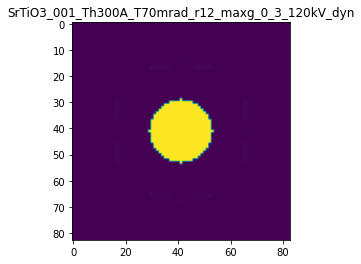

R-factor: 0.00010481901165748105

>>> producing the 76. dataset...

The offset applied on thickness: 0.0003841252414592713

The offset applied on Ug: -15.663431160509559

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38412524145923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

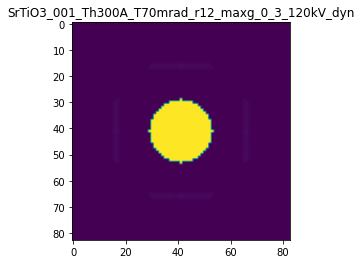

R-factor: 6.29609792840997e-05

>>> producing the 77. dataset...

The offset applied on thickness: -0.0006425894044643052

The offset applied on Ug: 3.7558886732800785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35741059553567
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

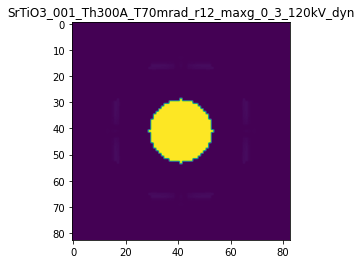

R-factor: 2.3893005881488757e-05

>>> producing the 78. dataset...

The offset applied on thickness: 0.0009340259755071896

The offset applied on Ug: -18.869046155633004

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93402597550715
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

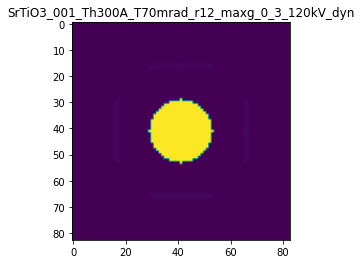

R-factor: 7.659629275115613e-05

>>> producing the 79. dataset...

The offset applied on thickness: 0.0009552354525010156

The offset applied on Ug: -10.03393103562828

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95523545250103
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

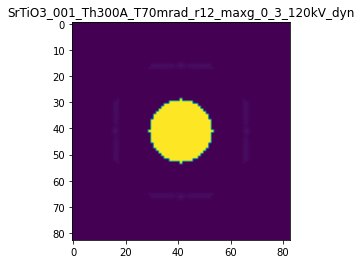

R-factor: 4.650683735018824e-05

>>> producing the 80. dataset...

The offset applied on thickness: -0.00048545194791168634

The offset applied on Ug: 17.968287694926385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51454805208834
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

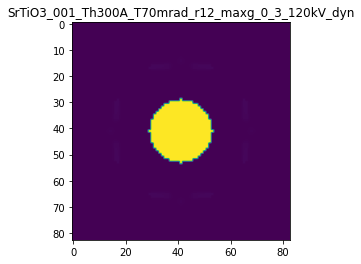

R-factor: 9.558031077776984e-05

>>> producing the 81. dataset...

The offset applied on thickness: -0.0004958063584134838

The offset applied on Ug: -16.131141063939967

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5041936415865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

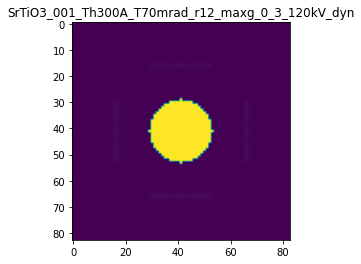

R-factor: 6.504820307896038e-05

>>> producing the 82. dataset...

The offset applied on thickness: -0.000407572376456643

The offset applied on Ug: 18.02853064012285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5924276235433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

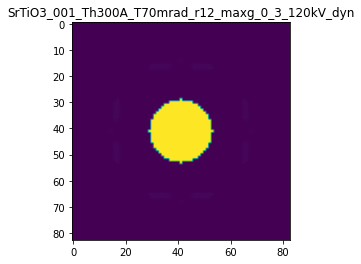

R-factor: 9.580332552403936e-05

>>> producing the 83. dataset...

The offset applied on thickness: -0.0004469572161425579

The offset applied on Ug: -17.559717999295575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5530427838574
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

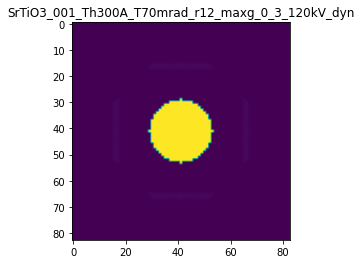

R-factor: 7.101394117787724e-05

>>> producing the 84. dataset...

The offset applied on thickness: -0.00031069263188567865

The offset applied on Ug: 0.11246487889886794

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6893073681143
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

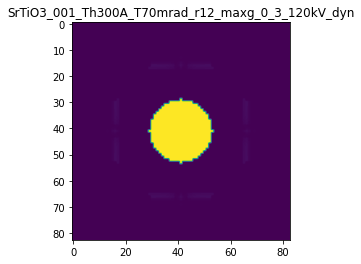

R-factor: 9.178239526123434e-07

>>> producing the 85. dataset...

The offset applied on thickness: 0.0007641009752081976

The offset applied on Ug: 2.990802469842265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7641009752082
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

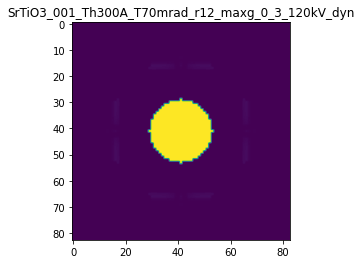

R-factor: 1.8487333377653738e-05

>>> producing the 86. dataset...

The offset applied on thickness: 0.0008025979256493276

The offset applied on Ug: -9.161975064818193

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.80259792564937
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

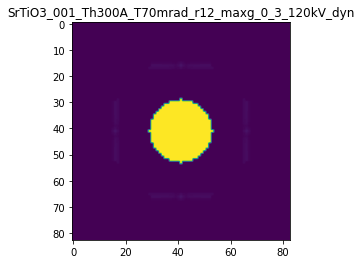

R-factor: 4.38146041489021e-05

>>> producing the 87. dataset...

The offset applied on thickness: -0.0008900133482781164

The offset applied on Ug: 19.61293132503209

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1099866517219
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

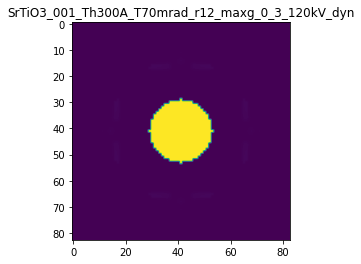

R-factor: 0.00010210492242215125

>>> producing the 88. dataset...

The offset applied on thickness: 0.0009702476962094126

The offset applied on Ug: 10.784148042455241

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9702476962094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

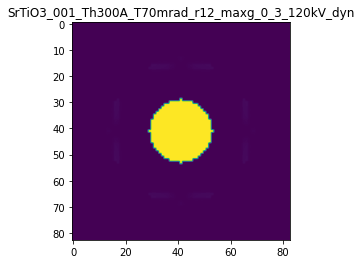

R-factor: 6.300660210415532e-05

>>> producing the 89. dataset...

The offset applied on thickness: 0.0006078168609751557

The offset applied on Ug: 5.997668841062709

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60781686097516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

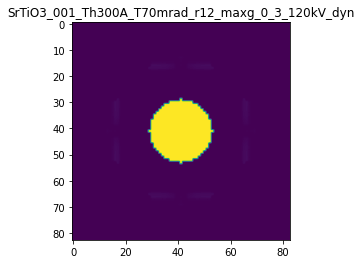

R-factor: 3.713460110516693e-05

>>> producing the 90. dataset...

The offset applied on thickness: -0.0007757966617579315

The offset applied on Ug: -15.684521281606917

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2242033382421
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

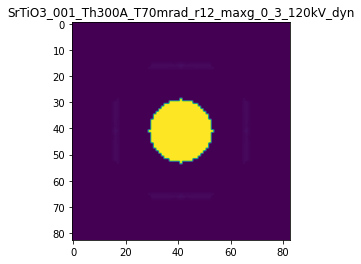

R-factor: 6.33887824043204e-05

>>> producing the 91. dataset...

The offset applied on thickness: -0.00018828307668492127

The offset applied on Ug: -17.949617520853263

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81171692331503
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

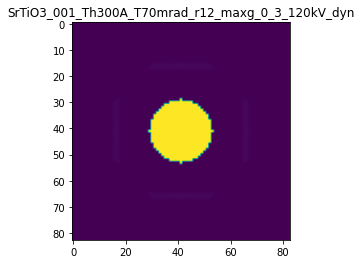

R-factor: 7.258939485665262e-05

>>> producing the 92. dataset...

The offset applied on thickness: -0.00010097956409006704

The offset applied on Ug: -4.564443383202233

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.89902043590996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

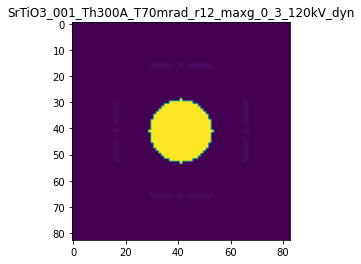

R-factor: 2.5519776517860254e-05

>>> producing the 93. dataset...

The offset applied on thickness: 0.0003961717389564008

The offset applied on Ug: 11.916871989470588

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3961717389564
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

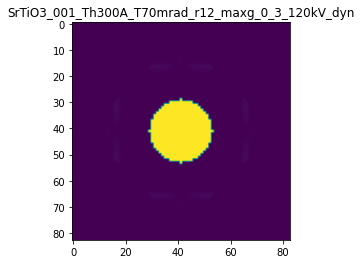

R-factor: 6.87518615662648e-05

>>> producing the 94. dataset...

The offset applied on thickness: 0.0002049947161237553

The offset applied on Ug: -19.368466103433015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.20499471612374
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

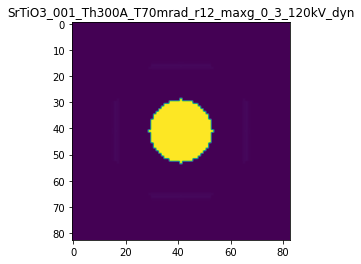

R-factor: 7.951709940057085e-05

>>> producing the 95. dataset...

The offset applied on thickness: -8.890566571375947e-05

The offset applied on Ug: -15.480852805046474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.91109433428625
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

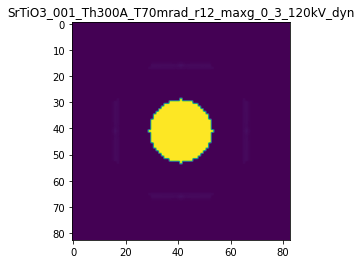

R-factor: 6.252521883871398e-05

>>> producing the 96. dataset...

The offset applied on thickness: 0.0003778309232170212

The offset applied on Ug: 12.968202091688354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.377830923217
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

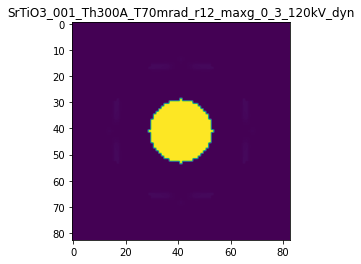

R-factor: 7.377004759750148e-05

>>> producing the 97. dataset...

The offset applied on thickness: -6.43021725164441e-05

The offset applied on Ug: -14.825683779616075

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9356978274835
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

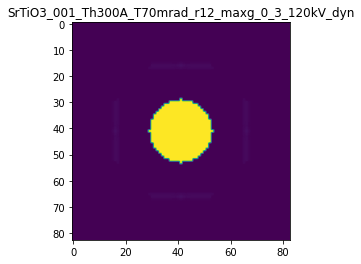

R-factor: 6.063262979047029e-05

>>> producing the 98. dataset...

The offset applied on thickness: -0.000233260048141247

The offset applied on Ug: -6.394189081844852

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76673995185877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

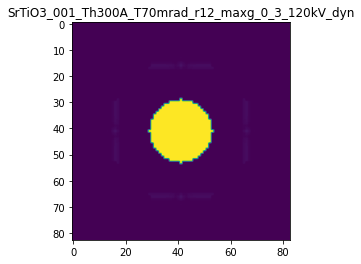

R-factor: 3.402960769722547e-05

>>> producing the 99. dataset...

The offset applied on thickness: -0.0004414332660718665

The offset applied on Ug: -2.986538767978636

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5585667339281
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

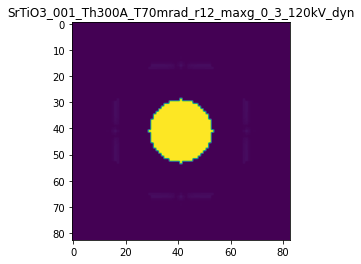

R-factor: 1.723010221860795e-05

>>> producing the 100. dataset...

The offset applied on thickness: 0.0002440197130415116

The offset applied on Ug: 17.20243198143601

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2440197130415
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

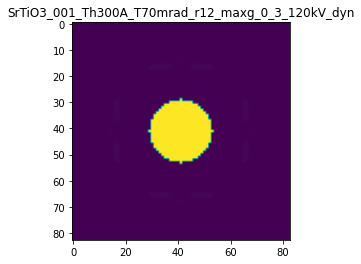

R-factor: 9.228722773941381e-05

>>> producing the 101. dataset...

The offset applied on thickness: 0.0003707390621522628

The offset applied on Ug: -13.160526578525806

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3707390621522
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

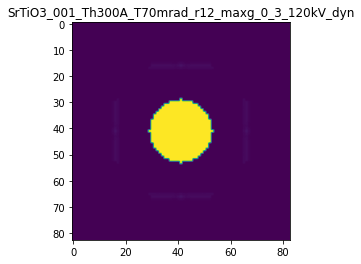

R-factor: 5.5726590870966455e-05

>>> producing the 102. dataset...

The offset applied on thickness: 0.0006481649448450498

The offset applied on Ug: 3.2127096191288094

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.648164944845
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

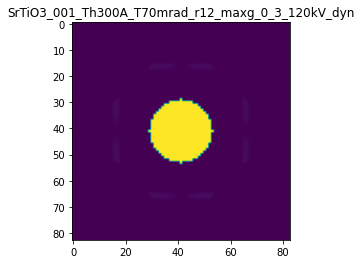

R-factor: 1.9939379569455338e-05

>>> producing the 103. dataset...

The offset applied on thickness: 8.49248079854854e-05

The offset applied on Ug: 3.840617525177454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0849248079855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

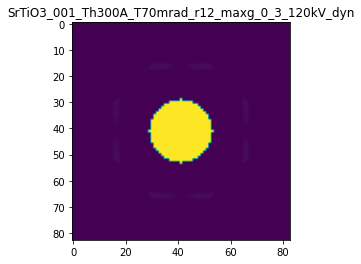

R-factor: 2.411526449211239e-05

>>> producing the 104. dataset...

The offset applied on thickness: 0.000675067027238044

The offset applied on Ug: 6.862382339900096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.675067027238
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

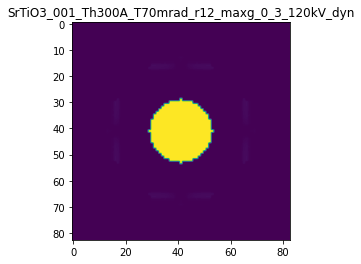

R-factor: 4.2207724415447636e-05

>>> producing the 105. dataset...

The offset applied on thickness: -0.0002724038397383284

The offset applied on Ug: 5.592299829215927

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72759616026167
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

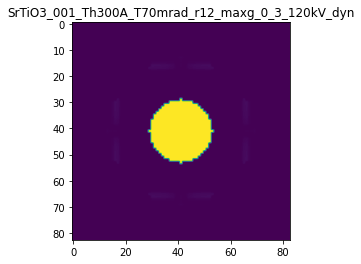

R-factor: 3.499575016735624e-05

>>> producing the 106. dataset...

The offset applied on thickness: -0.0005143876982564413

The offset applied on Ug: 13.944535445823886

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4856123017435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

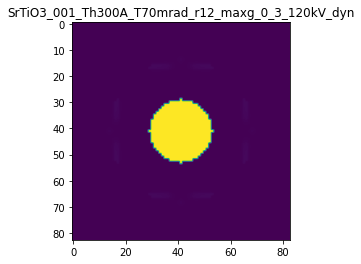

R-factor: 7.850198192889509e-05

>>> producing the 107. dataset...

The offset applied on thickness: 0.000433239753639872

The offset applied on Ug: 9.782963561444003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43323975363984
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

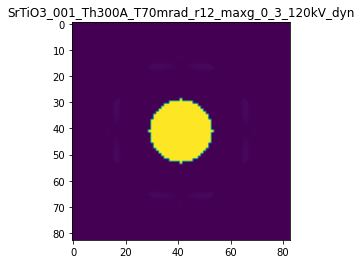

R-factor: 5.8183731654299655e-05

>>> producing the 108. dataset...

The offset applied on thickness: -0.0005925256703731457

The offset applied on Ug: -5.22368423249668

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.40747432962684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

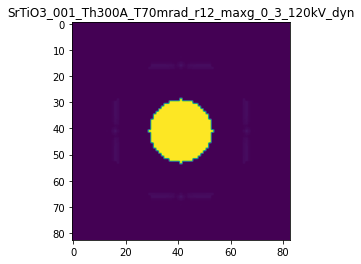

R-factor: 2.8692102130737667e-05

>>> producing the 109. dataset...

The offset applied on thickness: 0.0008969566371018491

The offset applied on Ug: 18.024453647154296

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8969566371019
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

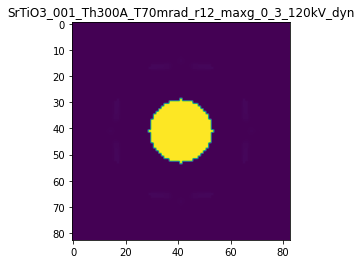

R-factor: 9.548570975775227e-05

>>> producing the 110. dataset...

The offset applied on thickness: 0.00046535122554869915

The offset applied on Ug: 3.757747931265935

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46535122554866
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

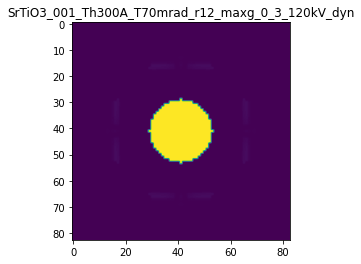

R-factor: 2.3442244238063673e-05

>>> producing the 111. dataset...

The offset applied on thickness: -0.00020077779110430405

The offset applied on Ug: 13.843235424575774

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7992222088957
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

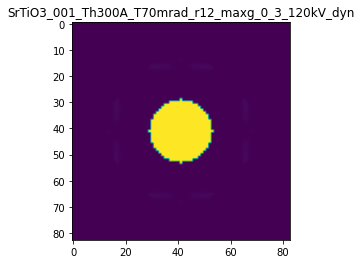

R-factor: 7.795408148494247e-05

>>> producing the 112. dataset...

The offset applied on thickness: -0.0008529951183878226

The offset applied on Ug: -2.29497540260385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1470048816122
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

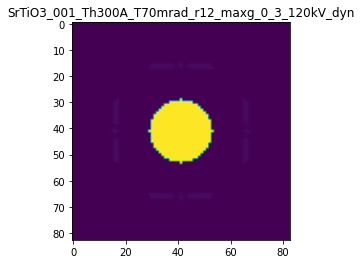

R-factor: 1.3313784000021634e-05

>>> producing the 113. dataset...

The offset applied on thickness: -0.0006744530235276967

The offset applied on Ug: 2.1560633360002748

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3255469764723
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

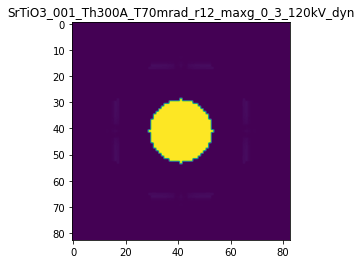

R-factor: 1.384715433452702e-05

>>> producing the 114. dataset...

The offset applied on thickness: -0.000578230185107927

The offset applied on Ug: 14.428582256047475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42176981489206
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

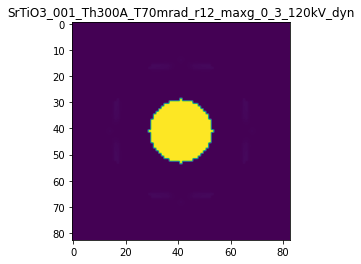

R-factor: 8.067250318661565e-05

>>> producing the 115. dataset...

The offset applied on thickness: 9.972792359755011e-05

The offset applied on Ug: -18.379966728147224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0997279235975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

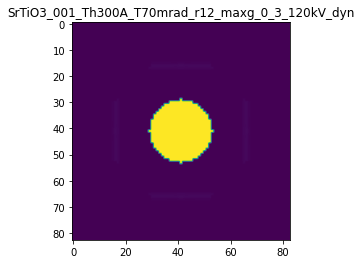

R-factor: 7.436852712242339e-05

>>> producing the 116. dataset...

The offset applied on thickness: -0.0004954201058499685

The offset applied on Ug: 19.621847338628605

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50457989415
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

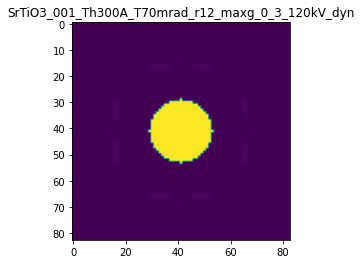

R-factor: 0.00010206426008303386

>>> producing the 117. dataset...

The offset applied on thickness: 0.0003028172795614721

The offset applied on Ug: -12.88831573356008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3028172795615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

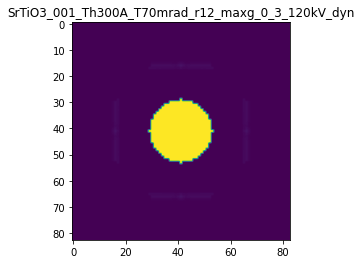

R-factor: 5.499762605797357e-05

>>> producing the 118. dataset...

The offset applied on thickness: 0.00021175577234194078

The offset applied on Ug: 19.76120389457427

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2117557723419
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

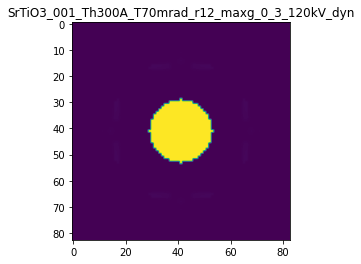

R-factor: 0.0001024707392277046

>>> producing the 119. dataset...

The offset applied on thickness: -0.0009183571654160432

The offset applied on Ug: 18.9169340302725

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.08164283458393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

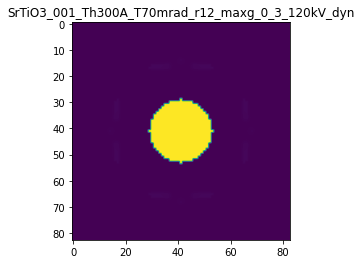

R-factor: 9.942330006714083e-05

>>> producing the 120. dataset...

The offset applied on thickness: 0.00020835284792395916

The offset applied on Ug: 2.19683550048233

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.20835284792395
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

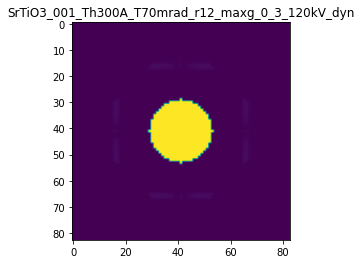

R-factor: 1.368463134368886e-05

>>> producing the 121. dataset...

The offset applied on thickness: 8.528320864675632e-05

The offset applied on Ug: 20.439933780881116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.08528320864673
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

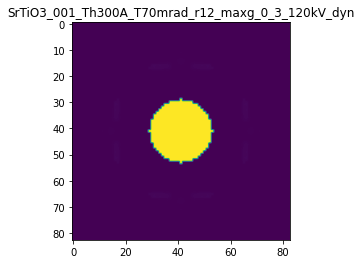

R-factor: 0.00010509490705221931

>>> producing the 122. dataset...

The offset applied on thickness: -0.00028592203293132057

The offset applied on Ug: -19.244107221049212

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71407796706865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

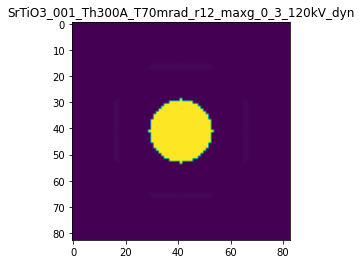

R-factor: 7.90420807799592e-05

>>> producing the 123. dataset...

The offset applied on thickness: -0.000334652521242367

The offset applied on Ug: 16.967760121292713

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6653474787576
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

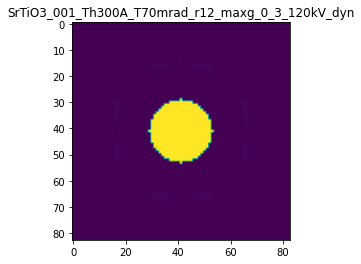

R-factor: 9.146805053694195e-05

>>> producing the 124. dataset...

The offset applied on thickness: -0.0005893211619685015

The offset applied on Ug: 20.34606122029532

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41067883803146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

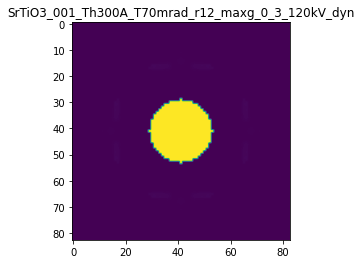

R-factor: 0.00010486494790379638

>>> producing the 125. dataset...

The offset applied on thickness: -0.0007048262880542808

The offset applied on Ug: -11.246246779146004

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2951737119457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

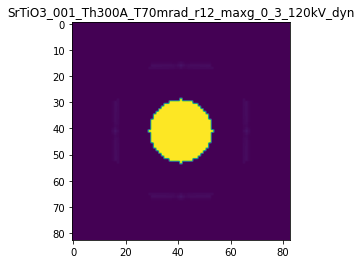

R-factor: 5.058155007079807e-05

>>> producing the 126. dataset...

The offset applied on thickness: -0.00035754867446681596

The offset applied on Ug: -3.611261772830567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6424513255332
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

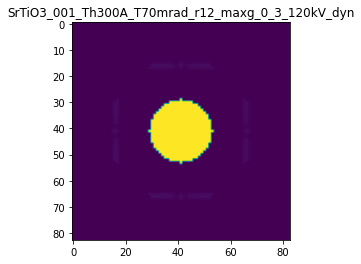

R-factor: 2.0602480090598698e-05

>>> producing the 127. dataset...

The offset applied on thickness: -0.0009057684330394249

The offset applied on Ug: -1.0658766988841717

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09423156696056
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

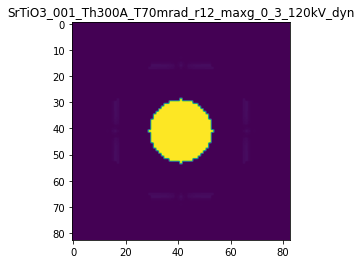

R-factor: 6.248360785769291e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.0005468395520452134

The offset applied on Ug: 14.743108928149823

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5468395520452
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

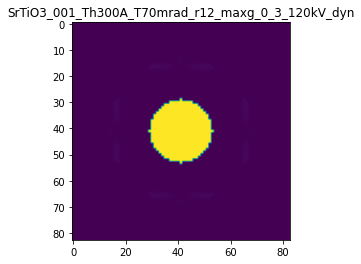

R-factor: 8.17349085104594e-05

>>> producing the 129. dataset...

The offset applied on thickness: -0.00058692364206073

The offset applied on Ug: 11.920389118703637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41307635793925
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

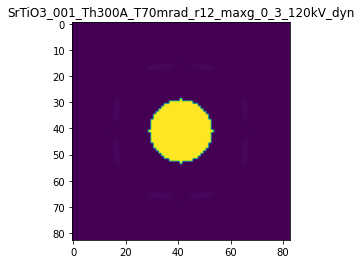

R-factor: 6.906360246927309e-05

>>> producing the 130. dataset...

The offset applied on thickness: -0.0002776713333199985

The offset applied on Ug: 6.092382537088325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72232866667997
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

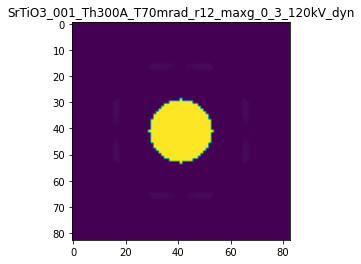

R-factor: 3.800341957528406e-05

>>> producing the 131. dataset...

The offset applied on thickness: -0.0009292382334474513

The offset applied on Ug: -17.72996647652968

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07076176655255
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

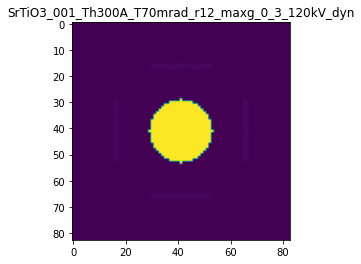

R-factor: 7.191191000098725e-05

>>> producing the 132. dataset...

The offset applied on thickness: 9.117618398466255e-06

The offset applied on Ug: 3.2754992552041178

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0091176183984
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

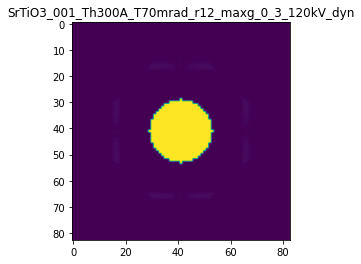

R-factor: 2.0600233104808127e-05

>>> producing the 133. dataset...

The offset applied on thickness: 0.00046704581319594805

The offset applied on Ug: -18.930716750801786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46704581319597
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

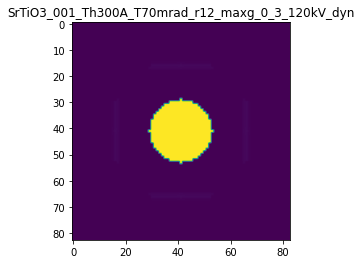

R-factor: 7.709919484829551e-05

>>> producing the 134. dataset...

The offset applied on thickness: 0.00040570618319778597

The offset applied on Ug: 16.648187327048976

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40570618319776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

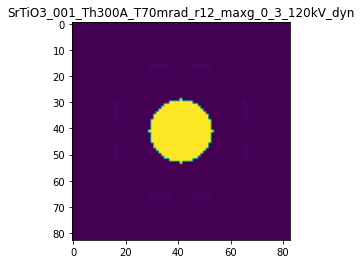

R-factor: 8.995767931782559e-05

>>> producing the 135. dataset...

The offset applied on thickness: 0.0006187803296699723

The offset applied on Ug: 1.3966710630127954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61878032966996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

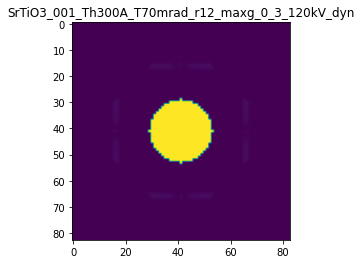

R-factor: 8.424256726801777e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.0006320218989629465

The offset applied on Ug: -11.826731774656201

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.63202189896293
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

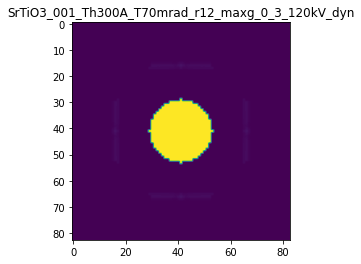

R-factor: 5.1927620499457946e-05

>>> producing the 137. dataset...

The offset applied on thickness: -0.00016266205894636832

The offset applied on Ug: 11.994346529619007

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8373379410536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

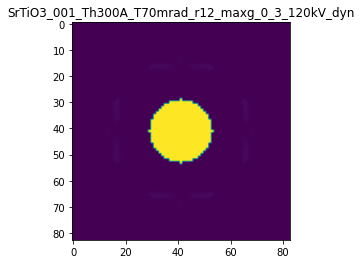

R-factor: 6.929447577640581e-05

>>> producing the 138. dataset...

The offset applied on thickness: 0.0005265638555303611

The offset applied on Ug: 12.875106661950609

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52656385553036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

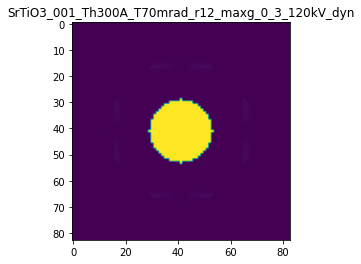

R-factor: 7.329060073601859e-05

>>> producing the 139. dataset...

The offset applied on thickness: -0.000643132401538945

The offset applied on Ug: -3.7773907761918872

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.356867598461
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

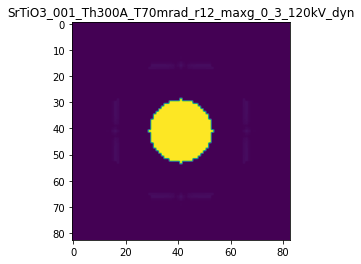

R-factor: 2.1430379495743027e-05

>>> producing the 140. dataset...

The offset applied on thickness: -0.0008115176238828281

The offset applied on Ug: -12.526990113126262

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1884823761172
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

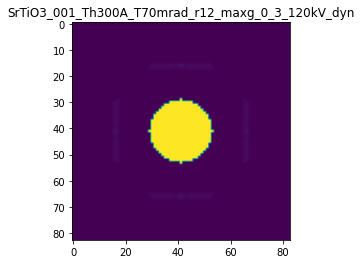

R-factor: 5.4301532353260176e-05



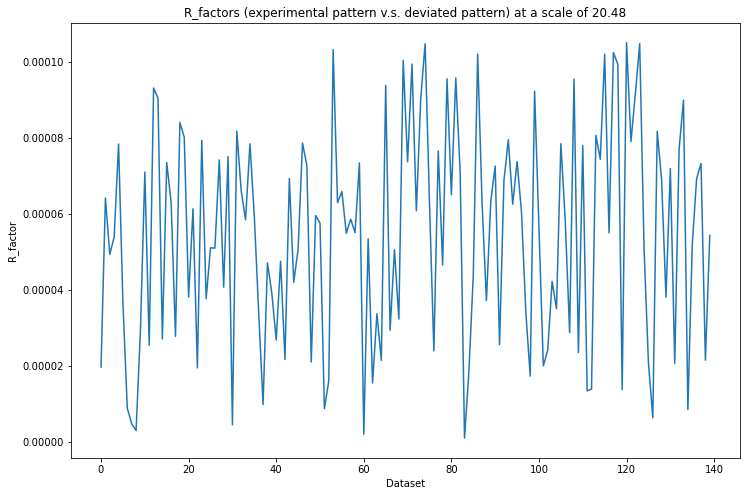

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 374ms/step - loss: 1.0852 - acc: 0.3200 - val_loss: 1.5538 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 225ms/step - loss: 0.9998 - acc: 0.2400 - val_loss: 1.4969 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 232ms/step - loss: 0.9355 - acc: 0.0000e+00 - val_loss: 1.4424 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 229ms/step - loss: 0.8899 - acc: 0.0000e+00 - val_loss: 1.4174 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 221ms/step - loss: 0.8648 - acc: 0.0000e+00 - val_loss: 1.3861 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 222ms/step - loss: 0.8417 - acc: 0.1000 - val_loss: 1.3699 - val_acc: 0.5250
Epoch 7/20
5/5 [==============================] - 1s 222ms/step - loss: 0.8244 - acc: 0.4000 - val_loss: 1.3571 - val_acc: 0.5250
Epoch 8/20
5/5 [=============

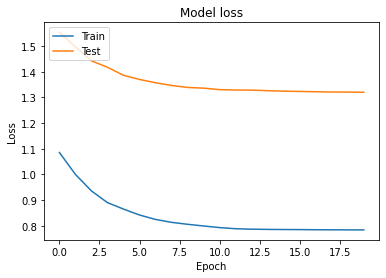

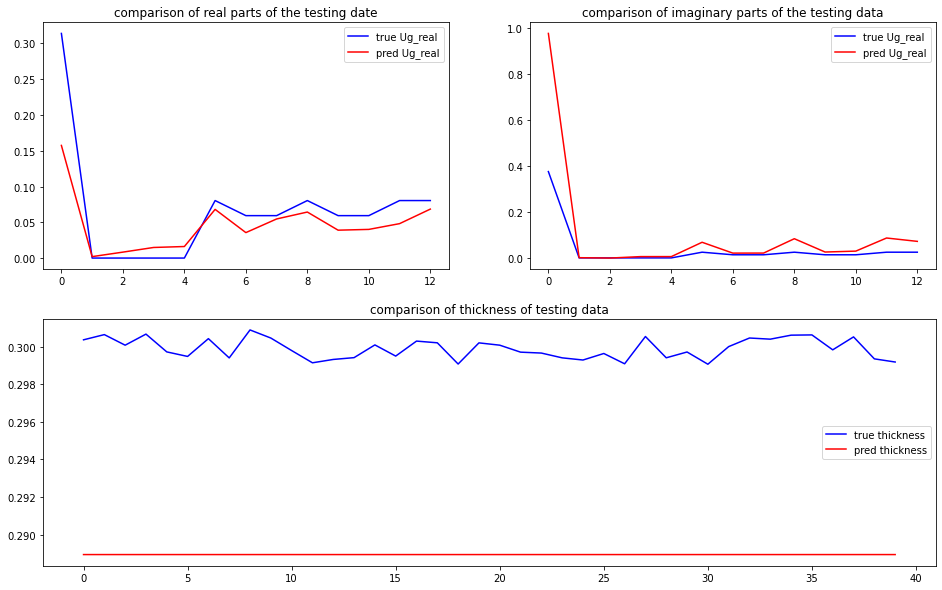

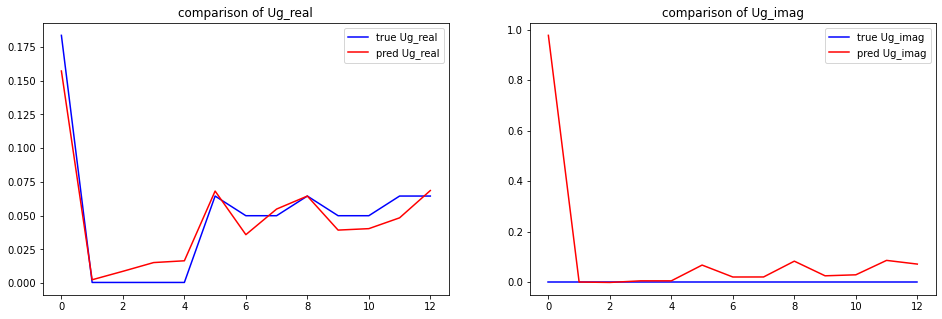

predicted thickness: 28.893381357192993 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=288.93381357192993
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.15712754+0.00000000e+00j 0.

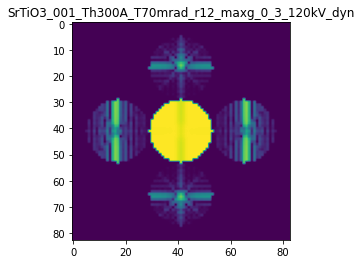

X_sim.max(): 0.9991016623585501
R-factor at a scale of 20.48 is 0.12244859627440083.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 40.96

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.00035540964821733945

The offset applied on Ug: -35.03958867023074

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


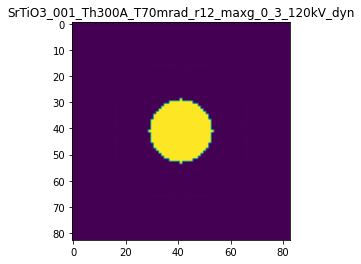

R-factor: 0.00015542807797134427

>>> producing the 2. dataset...

The offset applied on thickness: -0.0008260391793442512

The offset applied on Ug: -15.35516681989252

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.17396082065574
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

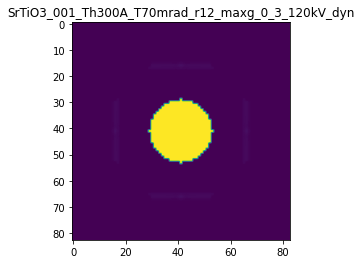

R-factor: 6.236163858891412e-05

>>> producing the 3. dataset...

The offset applied on thickness: 0.0008238022246417442

The offset applied on Ug: -5.855978872322084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8238022246417
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

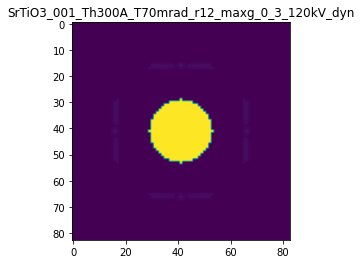

R-factor: 3.170231514140723e-05

>>> producing the 4. dataset...

The offset applied on thickness: -0.0005639883671407116

The offset applied on Ug: -1.774714050672301

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4360116328593
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

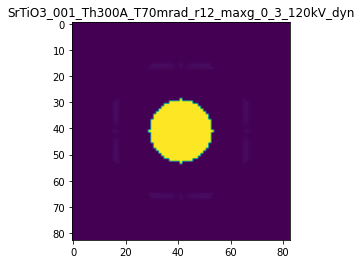

R-factor: 1.039695873667996e-05

>>> producing the 5. dataset...

The offset applied on thickness: 0.0006770092826295411

The offset applied on Ug: 23.942842536497583

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6770092826295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

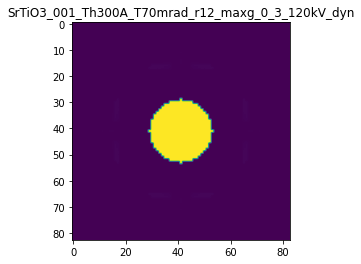

R-factor: 0.00011756476707877833

>>> producing the 6. dataset...

The offset applied on thickness: -0.0009870851708190175

The offset applied on Ug: 22.652176827311898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01291482918094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

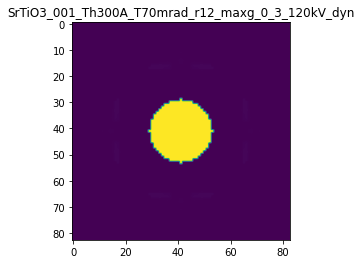

R-factor: 0.00011331706564071927

>>> producing the 7. dataset...

The offset applied on thickness: -0.0007718600426849194

The offset applied on Ug: 26.715321134495717

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2281399573151
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

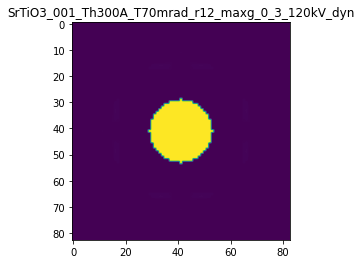

R-factor: 0.0001264081639096906

>>> producing the 8. dataset...

The offset applied on thickness: 0.0008505062935787739

The offset applied on Ug: -2.6017955147139764

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8505062935788
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

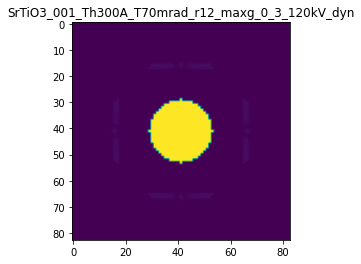

R-factor: 1.5580886020683803e-05

>>> producing the 9. dataset...

The offset applied on thickness: -0.0006841363946008123

The offset applied on Ug: 5.21857958161113

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3158636053992
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

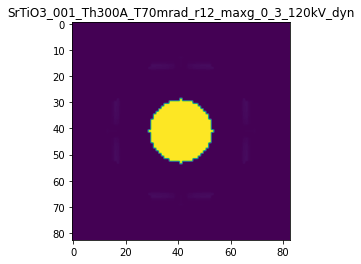

R-factor: 3.289604412684842e-05

>>> producing the 10. dataset...

The offset applied on thickness: 0.00023542658337138113

The offset applied on Ug: 25.022943032662454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2354265833714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

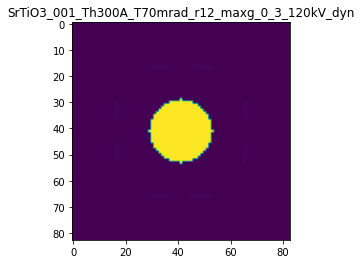

R-factor: 0.00012116113331816615

>>> producing the 11. dataset...

The offset applied on thickness: 0.0001908705297931097

The offset applied on Ug: 5.244936976905429

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1908705297931
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

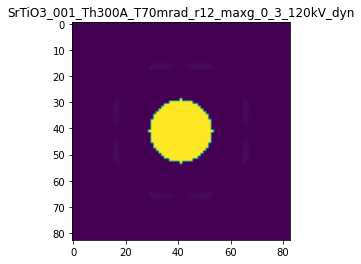

R-factor: 3.272071294497203e-05

>>> producing the 12. dataset...

The offset applied on thickness: -0.0006822243248787192

The offset applied on Ug: 21.008229617246652

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31777567512125
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

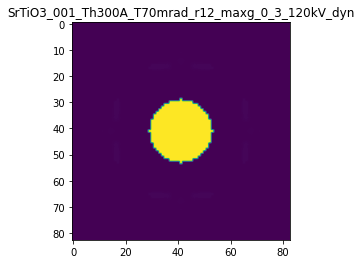

R-factor: 0.00010735052197947675

>>> producing the 13. dataset...

The offset applied on thickness: 0.0007865053938297751

The offset applied on Ug: -0.9083189322825093

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78650539382977
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

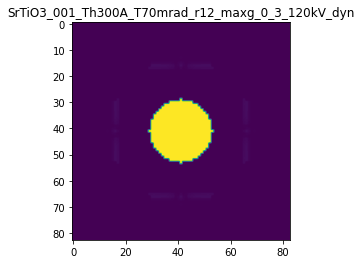

R-factor: 6.0000889200030595e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.0005369198564996409

The offset applied on Ug: 30.902721016513087

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5369198564996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

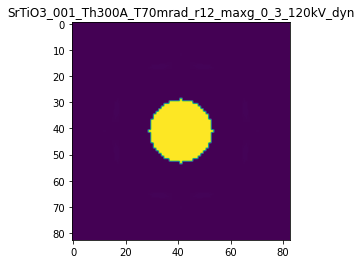

R-factor: 0.0001375708471442742

>>> producing the 15. dataset...

The offset applied on thickness: 0.00027613666350534107

The offset applied on Ug: 6.5119422913399925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2761366635053
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

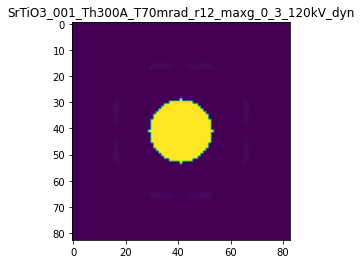

R-factor: 4.029628507349352e-05

>>> producing the 16. dataset...

The offset applied on thickness: 0.0002168439933231572

The offset applied on Ug: -26.623637577899917

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21684399332315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

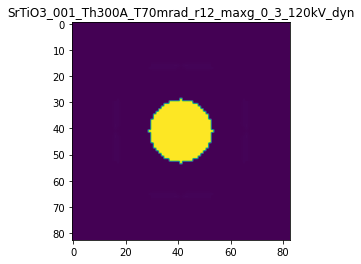

R-factor: 0.00011976777399678476

>>> producing the 17. dataset...

The offset applied on thickness: -0.0006766338017712366

The offset applied on Ug: -29.27444887988887

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32336619822877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

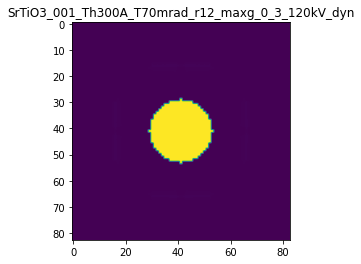

R-factor: 0.00013352415853201007

>>> producing the 18. dataset...

The offset applied on thickness: 0.000891870150937181

The offset applied on Ug: 1.8925335093592093

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.89187015093717
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

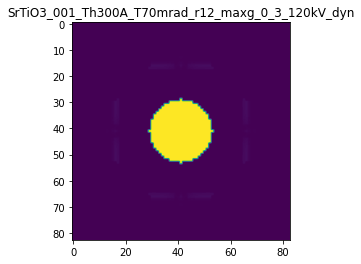

R-factor: 1.144614542437212e-05

>>> producing the 19. dataset...

The offset applied on thickness: -0.00028378884471989797

The offset applied on Ug: 23.855737297791766

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71621115528006
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

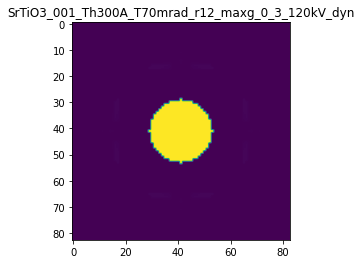

R-factor: 0.00011737898053295061

>>> producing the 20. dataset...

The offset applied on thickness: -0.0002948098900174223

The offset applied on Ug: -6.012900279105716

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7051901099826
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

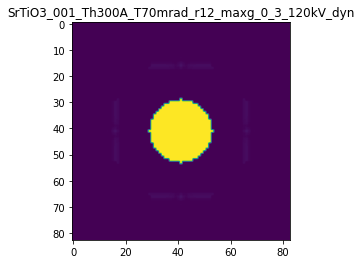

R-factor: 3.235225305854988e-05

>>> producing the 21. dataset...

The offset applied on thickness: -0.00022768679536102888

The offset applied on Ug: -38.30567370443954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.772313204639
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

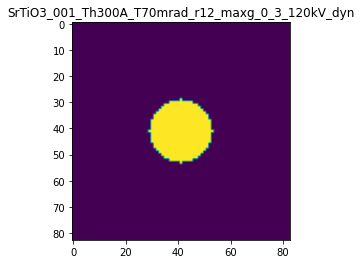

R-factor: 0.00016525022308900626

>>> producing the 22. dataset...

The offset applied on thickness: 0.0004628436441628578

The offset applied on Ug: 33.37249979707957

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4628436441629
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

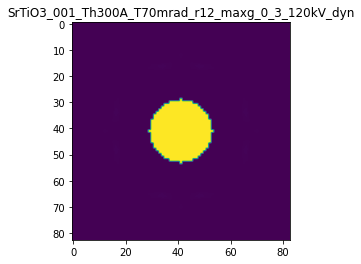

R-factor: 0.0001432728059704621

>>> producing the 23. dataset...

The offset applied on thickness: -0.0006137812743576107

The offset applied on Ug: 15.469920868144673

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3862187256424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

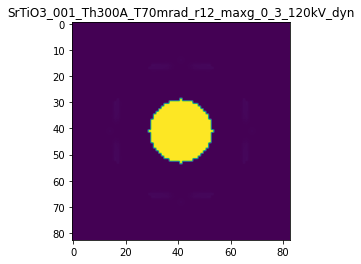

R-factor: 8.523300123570527e-05

>>> producing the 24. dataset...

The offset applied on thickness: -0.0005724997002451848

The offset applied on Ug: 38.40092738999705

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4275002997548
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

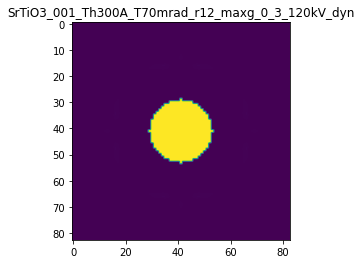

R-factor: 0.00015350478789681265

>>> producing the 25. dataset...

The offset applied on thickness: 0.0005333869303078842

The offset applied on Ug: 40.853510396733995

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5333869303079
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

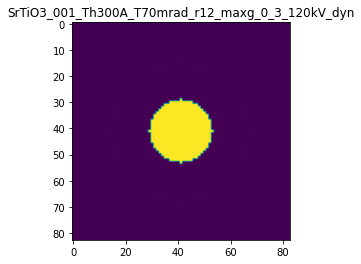

R-factor: 0.0001576331640601023

>>> producing the 26. dataset...

The offset applied on thickness: -0.0003675528494490583

The offset applied on Ug: -23.81928654935354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63244715055095
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

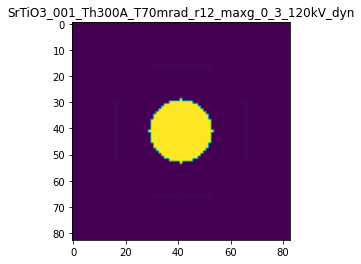

R-factor: 0.00010381282251389537

>>> producing the 27. dataset...

The offset applied on thickness: -0.0002458814335744244

The offset applied on Ug: 7.131375537923023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7541185664256
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

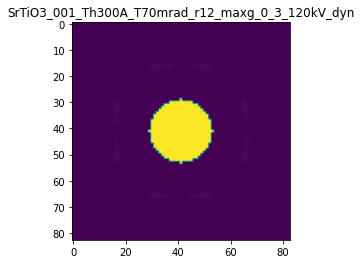

R-factor: 4.4063479944826315e-05

>>> producing the 28. dataset...

The offset applied on thickness: 0.00018639110744322941

The offset applied on Ug: -17.92689973152176

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1863911074432
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

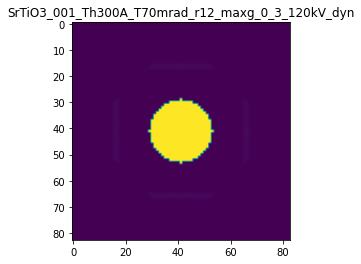

R-factor: 7.23659190102625e-05

>>> producing the 29. dataset...

The offset applied on thickness: -0.0005231563549430046

The offset applied on Ug: -21.241648006119977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.476843645057
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

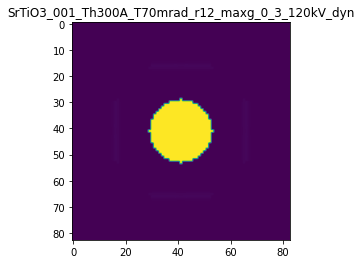

R-factor: 8.921593697966538e-05

>>> producing the 30. dataset...

The offset applied on thickness: 0.0008352856543975212

The offset applied on Ug: -18.054089480603825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.83528565439747
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

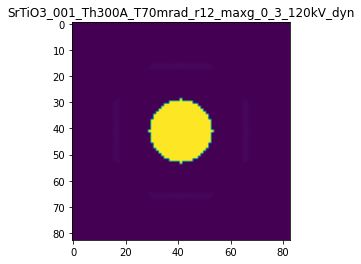

R-factor: 7.270748098214264e-05

>>> producing the 31. dataset...

The offset applied on thickness: -1.9488210970049824e-05

The offset applied on Ug: 28.64098645760577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98051178902995
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

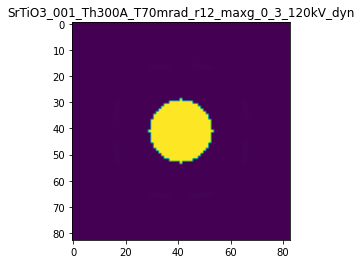

R-factor: 0.00013177933867935577

>>> producing the 32. dataset...

The offset applied on thickness: -0.00032719639779070687

The offset applied on Ug: 3.5967795157780347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6728036022093
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

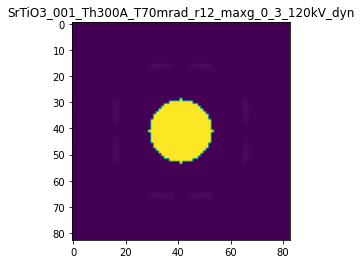

R-factor: 2.2760737300609166e-05

>>> producing the 33. dataset...

The offset applied on thickness: -0.00016379199784115128

The offset applied on Ug: 40.416053232196575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8362080021588
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

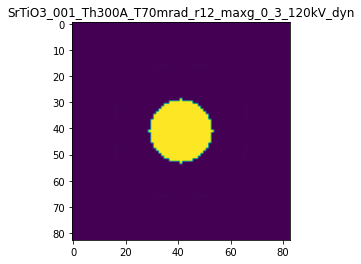

R-factor: 0.0001569367868665478

>>> producing the 34. dataset...

The offset applied on thickness: -9.110778780625518e-05

The offset applied on Ug: -22.857686062711384

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.90889221219373
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

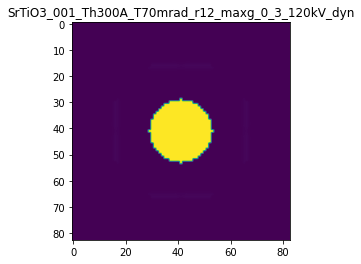

R-factor: 9.819304597720658e-05

>>> producing the 35. dataset...

The offset applied on thickness: -0.000965897464181122

The offset applied on Ug: -26.414827331190544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0341025358189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

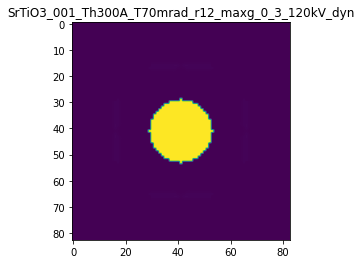

R-factor: 0.00011872577036179527

>>> producing the 36. dataset...

The offset applied on thickness: 0.0002917125995787799

The offset applied on Ug: 14.09448153726703

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2917125995788
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

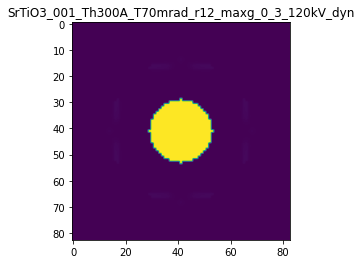

R-factor: 7.893627407113824e-05

>>> producing the 37. dataset...

The offset applied on thickness: 5.030596509387375e-05

The offset applied on Ug: 31.186129097841057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05030596509386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

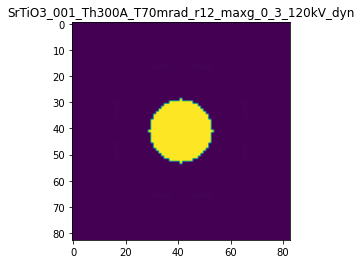

R-factor: 0.00013827255221736306

>>> producing the 38. dataset...

The offset applied on thickness: -0.0006986391757306724

The offset applied on Ug: -11.442932374172997

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30136082426935
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

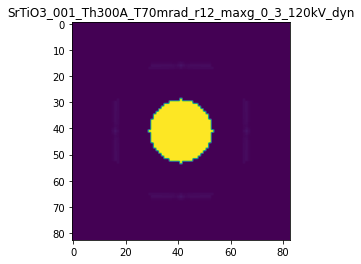

R-factor: 5.117211406679908e-05

>>> producing the 39. dataset...

The offset applied on thickness: -0.0001475618372432792

The offset applied on Ug: 33.241625166397654

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8524381627567
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

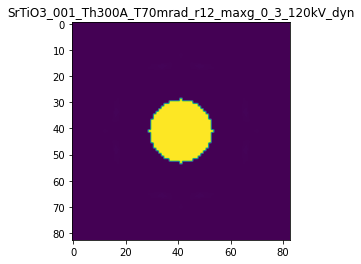

R-factor: 0.00014298913336551654

>>> producing the 40. dataset...

The offset applied on thickness: -0.00023455361592816004

The offset applied on Ug: -39.00847120036554

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7654463840718
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

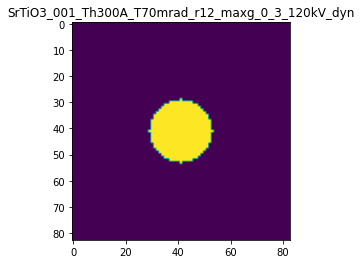

R-factor: 0.00016708872414082155

>>> producing the 41. dataset...

The offset applied on thickness: 0.0009811275749606477

The offset applied on Ug: -39.57116258208645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9811275749606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

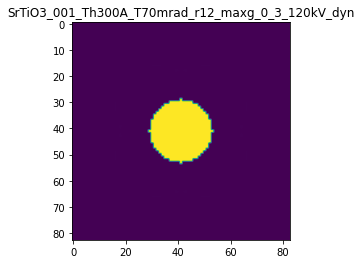

R-factor: 0.00016857662463897694

>>> producing the 42. dataset...

The offset applied on thickness: -0.0005199551175387407

The offset applied on Ug: 38.132325032080225

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.48004488246124
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

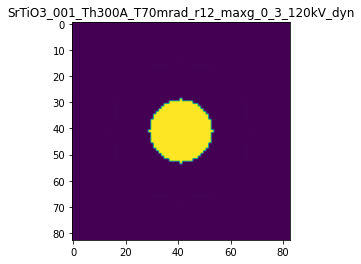

R-factor: 0.00015301836198979005

>>> producing the 43. dataset...

The offset applied on thickness: 3.1755495188114937e-06

The offset applied on Ug: -7.090741595330346

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0031755495188
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

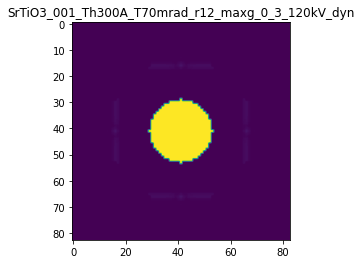

R-factor: 3.687373206384863e-05

>>> producing the 44. dataset...

The offset applied on thickness: 0.0004783273544862128

The offset applied on Ug: 37.76561719625501

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4783273544862
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

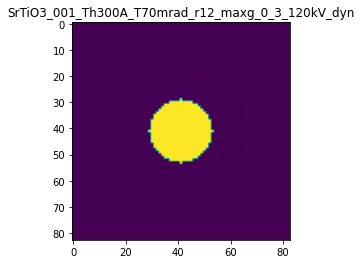

R-factor: 0.00015238979157437967

>>> producing the 45. dataset...

The offset applied on thickness: -0.0008151651032477672

The offset applied on Ug: 1.8304039138261032

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.18483489675225
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

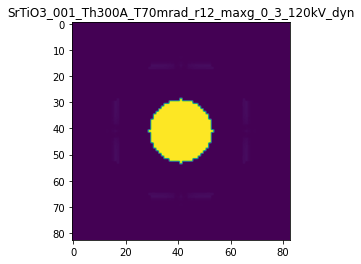

R-factor: 1.1873060690746587e-05

>>> producing the 46. dataset...

The offset applied on thickness: -0.000823442583211704

The offset applied on Ug: -3.06760075942826

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1765574167883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

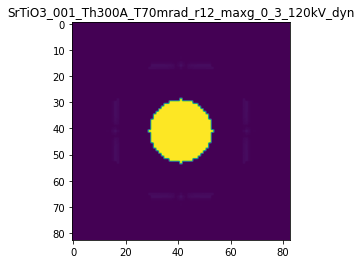

R-factor: 1.7609498577185756e-05

>>> producing the 47. dataset...

The offset applied on thickness: 0.0007566651801341911

The offset applied on Ug: -19.5949035247322

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7566651801342
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

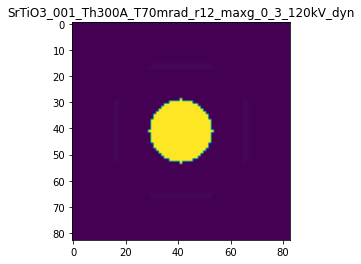

R-factor: 8.051196064416563e-05

>>> producing the 48. dataset...

The offset applied on thickness: 0.0006098627081066033

The offset applied on Ug: 24.025194355293408

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60986270810656
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

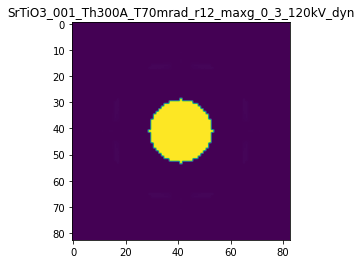

R-factor: 0.00011785037592797289

>>> producing the 49. dataset...

The offset applied on thickness: 0.0002705177379342487

The offset applied on Ug: 21.171603973608125

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27051773793426
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

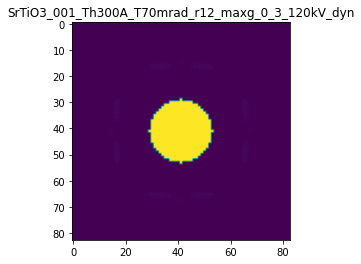

R-factor: 0.00010777542177502092

>>> producing the 50. dataset...

The offset applied on thickness: -0.00031775660887512603

The offset applied on Ug: -40.56886703773005

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68224339112487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

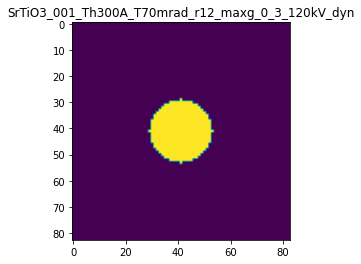

R-factor: 0.00017074726778373264

>>> producing the 51. dataset...

The offset applied on thickness: 0.0006301828732895989

The offset applied on Ug: -32.14047404538122

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6301828732896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

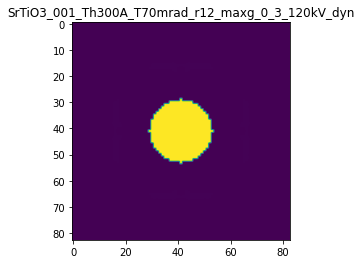

R-factor: 0.00014585854417714975

>>> producing the 52. dataset...

The offset applied on thickness: -0.000674462213681762

The offset applied on Ug: 3.4268553227395753

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3255377863182
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

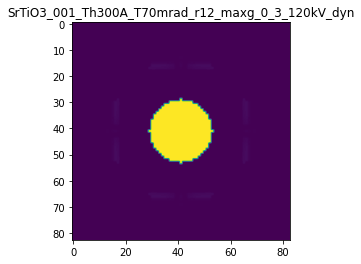

R-factor: 2.185248286696047e-05

>>> producing the 53. dataset...

The offset applied on thickness: 2.168397834677349e-05

The offset applied on Ug: -27.244189403783775

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0216839783468
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

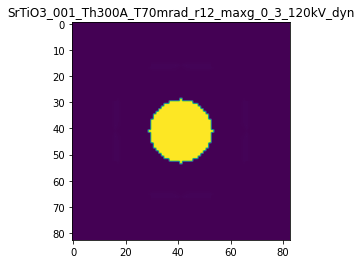

R-factor: 0.00012312116064896897

>>> producing the 54. dataset...

The offset applied on thickness: -0.0002196241940851733

The offset applied on Ug: 8.806097503869351

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78037580591484
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

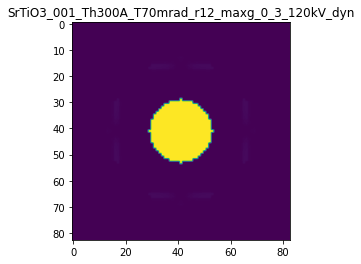

R-factor: 5.331493965336839e-05

>>> producing the 55. dataset...

The offset applied on thickness: 0.0005981060313930682

The offset applied on Ug: -26.555838348624892

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.59810603139306
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

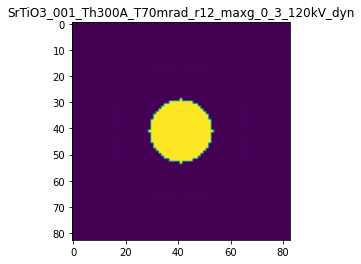

R-factor: 0.00011935855640629036

>>> producing the 56. dataset...

The offset applied on thickness: -0.0007066681125578189

The offset applied on Ug: -28.3514312634796

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29333188744215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

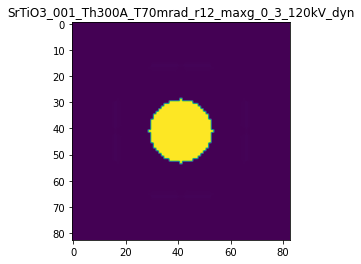

R-factor: 0.00012894044241798386

>>> producing the 57. dataset...

The offset applied on thickness: -0.0006567821164615617

The offset applied on Ug: -0.19394835651253745

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3432178835384
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

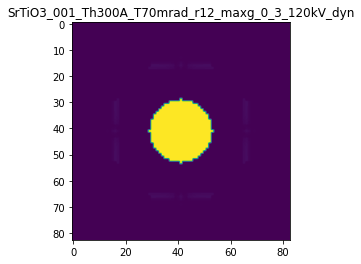

R-factor: 1.3675544246570493e-06

>>> producing the 58. dataset...

The offset applied on thickness: 0.0006462014683842421

The offset applied on Ug: 5.92209158712948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6462014683842
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

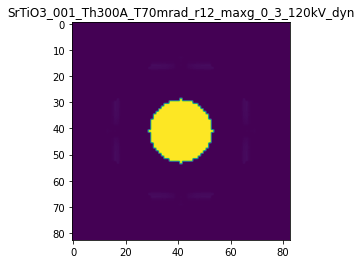

R-factor: 3.666842453557062e-05

>>> producing the 59. dataset...

The offset applied on thickness: -0.0004519236494964647

The offset applied on Ug: -5.558227237837754

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5480763505035
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

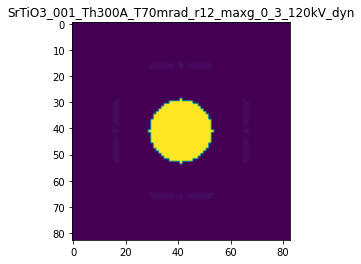

R-factor: 3.0274114038355705e-05

>>> producing the 60. dataset...

The offset applied on thickness: -0.0006271306589502994

The offset applied on Ug: 17.698643919858586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3728693410497
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

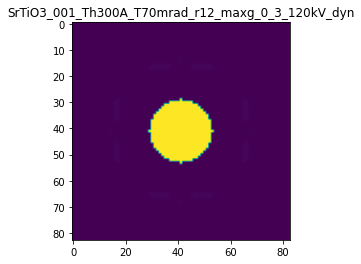

R-factor: 9.452600215962564e-05

>>> producing the 61. dataset...

The offset applied on thickness: 0.000334345561589358

The offset applied on Ug: 23.32384477362828

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3343455615893
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

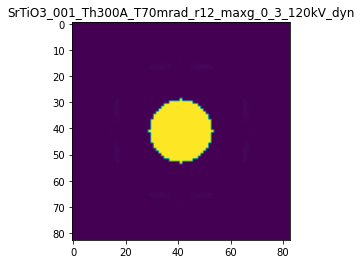

R-factor: 0.00011548802366909808

>>> producing the 62. dataset...

The offset applied on thickness: 0.0007782745155226754

The offset applied on Ug: 32.16415443722034

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.77827451552264
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

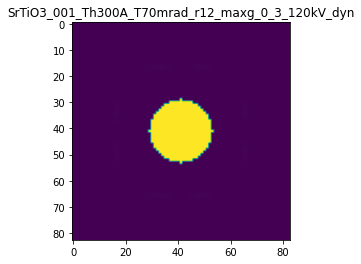

R-factor: 0.0001405562963104813

>>> producing the 63. dataset...

The offset applied on thickness: 0.0008445784404142462

The offset applied on Ug: -35.849262942421596

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84457844041424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

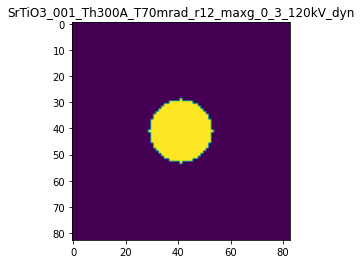

R-factor: 0.00015812031011449662

>>> producing the 64. dataset...

The offset applied on thickness: -0.00020128880653726977

The offset applied on Ug: 30.819837548837658

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.79871119346274
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

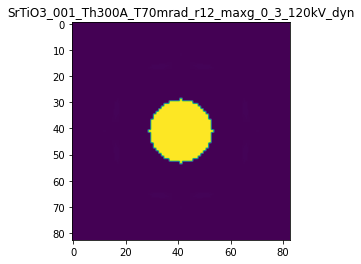

R-factor: 0.00013738210708453782

>>> producing the 65. dataset...

The offset applied on thickness: -0.0009572253227222501

The offset applied on Ug: 12.52163706157533

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04277467727775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

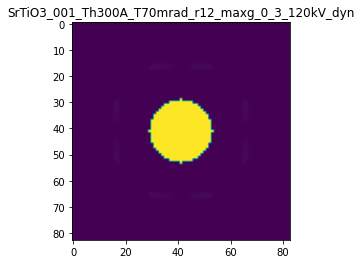

R-factor: 7.206067072998674e-05

>>> producing the 66. dataset...

The offset applied on thickness: 0.00041389071038116934

The offset applied on Ug: -14.681491607607505

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41389071038117
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

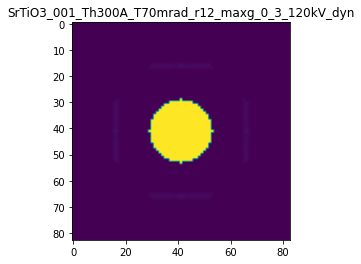

R-factor: 6.0105606913181185e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.0008130635174820207

The offset applied on Ug: 6.9356805814837665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.813063517482
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

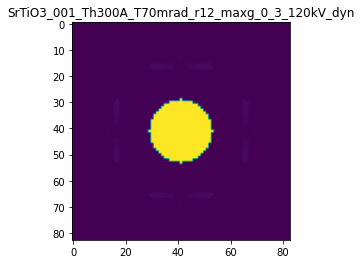

R-factor: 4.25869685139608e-05

>>> producing the 68. dataset...

The offset applied on thickness: -0.0008586825744238371

The offset applied on Ug: 31.63825322865382

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1413174255762
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

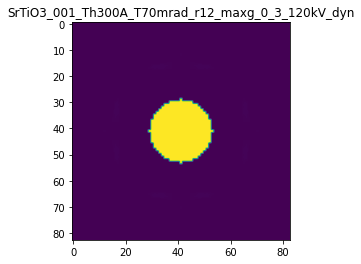

R-factor: 0.0001393675018498476

>>> producing the 69. dataset...

The offset applied on thickness: -0.0008872688086621292

The offset applied on Ug: 36.449270655884064

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.11273119133784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

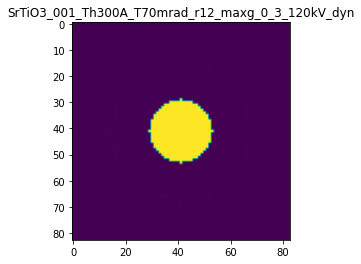

R-factor: 0.00014976259632600865

>>> producing the 70. dataset...

The offset applied on thickness: -0.0001641768437059934

The offset applied on Ug: 3.0790274649267486

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.835823156294
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

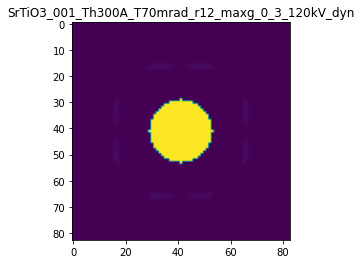

R-factor: 1.9438110914161203e-05

>>> producing the 71. dataset...

The offset applied on thickness: -0.0005419917341245251

The offset applied on Ug: -20.79901427014249

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4580082658755
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

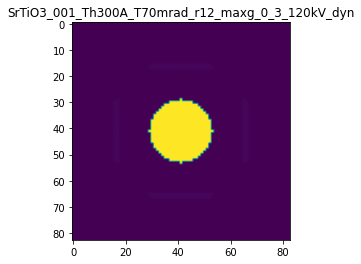

R-factor: 8.70118402771609e-05

>>> producing the 72. dataset...

The offset applied on thickness: 0.0006194729984952028

The offset applied on Ug: -10.299545813064023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61947299849516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

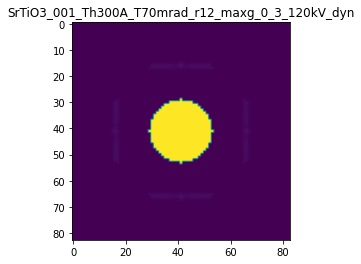

R-factor: 4.739833586958427e-05

>>> producing the 73. dataset...

The offset applied on thickness: 0.00010042660355713684

The offset applied on Ug: -5.460757268127373

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.10042660355714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

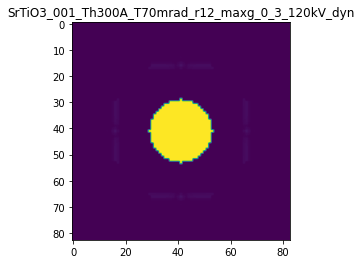

R-factor: 2.984247864276047e-05

>>> producing the 74. dataset...

The offset applied on thickness: -0.0004333483065256203

The offset applied on Ug: -21.386699514572257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.56665169347434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

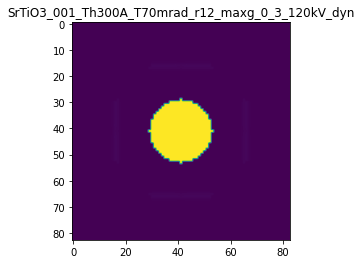

R-factor: 8.995125530000903e-05

>>> producing the 75. dataset...

The offset applied on thickness: 0.0003929294431548398

The offset applied on Ug: 12.083458663448727

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3929294431548
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

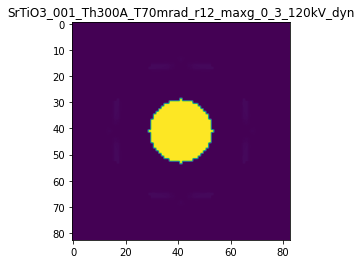

R-factor: 6.956148444366691e-05

>>> producing the 76. dataset...

The offset applied on thickness: 0.0003791678840916337

The offset applied on Ug: 20.12974543596507

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.37916788409166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

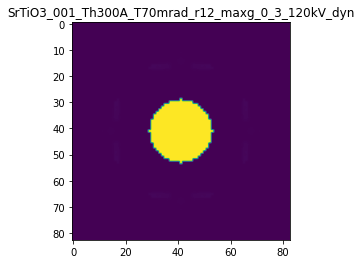

R-factor: 0.00010386078896218588

>>> producing the 77. dataset...

The offset applied on thickness: -5.3533273406596087e-05

The offset applied on Ug: 10.496202642458393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9464667265934
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

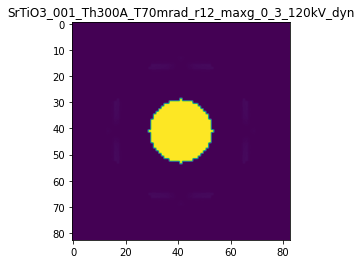

R-factor: 6.189284017789764e-05

>>> producing the 78. dataset...

The offset applied on thickness: -5.9745887165338905e-06

The offset applied on Ug: -2.940141989696276

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9940254112835
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

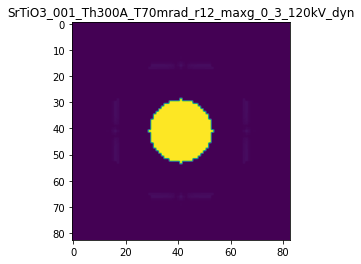

R-factor: 1.70787316926867e-05

>>> producing the 79. dataset...

The offset applied on thickness: 0.0005626180503698519

The offset applied on Ug: -32.33507740966626

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56261805036985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

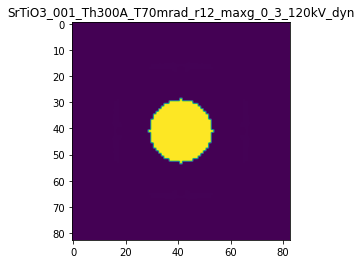

R-factor: 0.00014657962782030855

>>> producing the 80. dataset...

The offset applied on thickness: 0.0003870494086056724

The offset applied on Ug: 4.577192059075187

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38704940860566
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

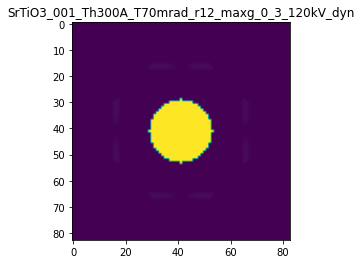

R-factor: 2.8567041864171526e-05

>>> producing the 81. dataset...

The offset applied on thickness: 0.0006778426798705735

The offset applied on Ug: -8.903366336240724

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6778426798706
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

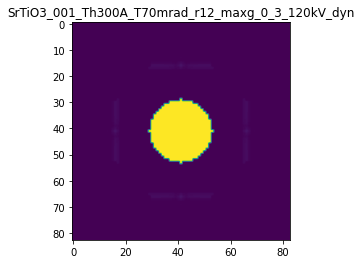

R-factor: 4.306296565536853e-05

>>> producing the 82. dataset...

The offset applied on thickness: 0.0007219191406189048

The offset applied on Ug: 39.27750897248236

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7219191406189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

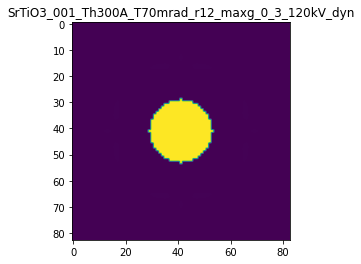

R-factor: 0.0001551263619287844

>>> producing the 83. dataset...

The offset applied on thickness: -0.0004814576878776216

The offset applied on Ug: -16.2531827823396

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5185423121224
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

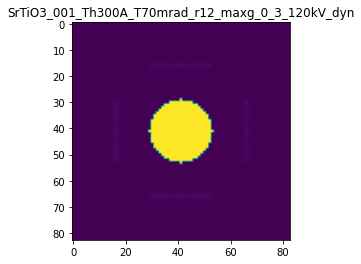

R-factor: 6.555568085956747e-05

>>> producing the 84. dataset...

The offset applied on thickness: 0.0006215224673436706

The offset applied on Ug: -11.697803982032656

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.62152246734365
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

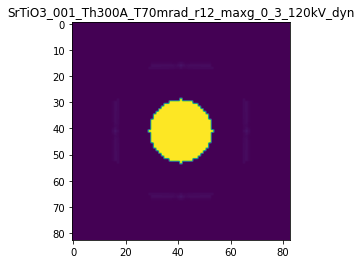

R-factor: 5.1550382647206434e-05

>>> producing the 85. dataset...

The offset applied on thickness: -0.0005180819802719494

The offset applied on Ug: 12.147408311940417

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4819180197281
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

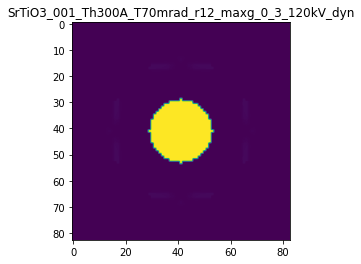

R-factor: 7.013989633229516e-05

>>> producing the 86. dataset...

The offset applied on thickness: -0.0004177005694353577

The offset applied on Ug: 31.296341541925123

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58229943056466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

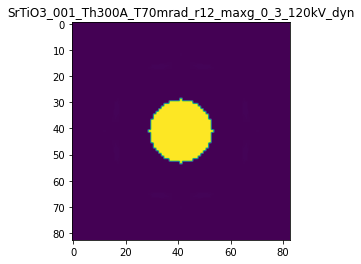

R-factor: 0.00013854783355292776

>>> producing the 87. dataset...

The offset applied on thickness: -0.00041446075523590166

The offset applied on Ug: 1.9854618889578979

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5855392447641
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

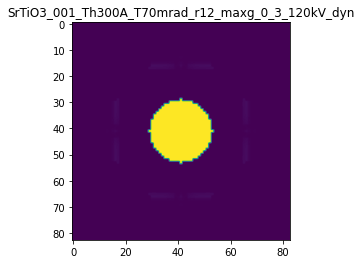

R-factor: 1.2638953413665401e-05

>>> producing the 88. dataset...

The offset applied on thickness: -0.0005536896915219074

The offset applied on Ug: -14.732095065397099

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4463103084781
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

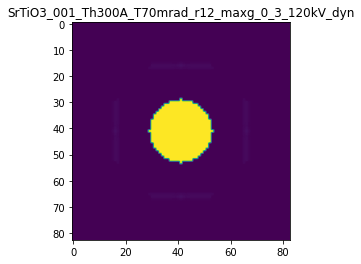

R-factor: 6.050225322806373e-05

>>> producing the 89. dataset...

The offset applied on thickness: -0.000960638614716325

The offset applied on Ug: 33.065873740824394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03936138528366
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

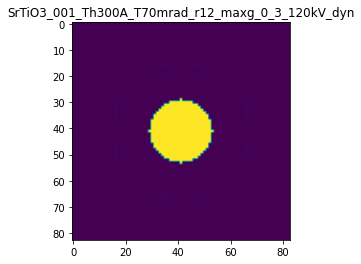

R-factor: 0.0001426124132168901

>>> producing the 90. dataset...

The offset applied on thickness: 0.0004150181859571065

The offset applied on Ug: -7.839187479422471

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41501818595714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

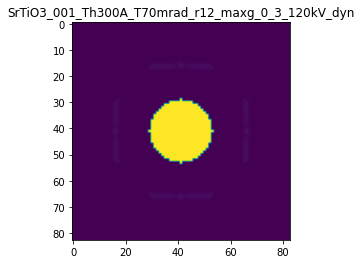

R-factor: 3.9647551518052393e-05

>>> producing the 91. dataset...

The offset applied on thickness: 0.00023587260489759076

The offset applied on Ug: -10.366102223211366

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23587260489757
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

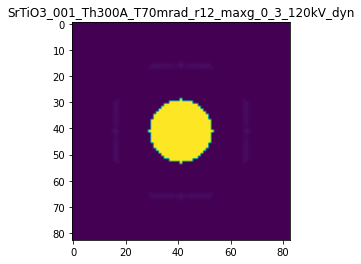

R-factor: 4.7676848726283713e-05

>>> producing the 92. dataset...

The offset applied on thickness: 0.00020105624219927143

The offset applied on Ug: -11.437438035152363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2010562421993
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

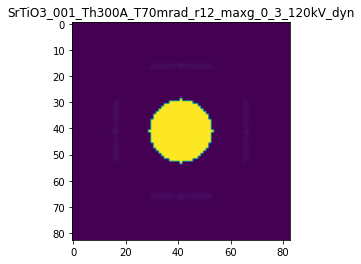

R-factor: 5.090555284332601e-05

>>> producing the 93. dataset...

The offset applied on thickness: 0.0009982331266082183

The offset applied on Ug: -34.29807800413631

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9982331266082
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

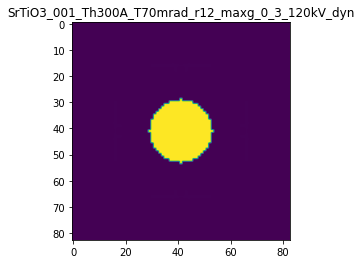

R-factor: 0.00015306277598970222

>>> producing the 94. dataset...

The offset applied on thickness: 0.0003275336236158752

The offset applied on Ug: 13.691520145507312

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32753362361586
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

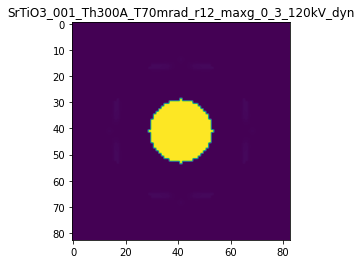

R-factor: 7.71121982846934e-05

>>> producing the 95. dataset...

The offset applied on thickness: 7.80873622459204e-05

The offset applied on Ug: -9.135889970358702

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07808736224587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

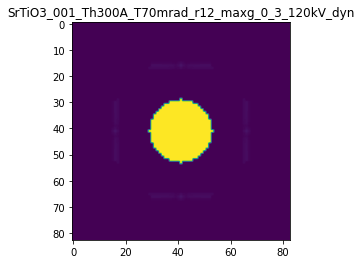

R-factor: 4.3770285543705206e-05

>>> producing the 96. dataset...

The offset applied on thickness: -0.000761218365662163

The offset applied on Ug: -39.46316315328399

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23878163433784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

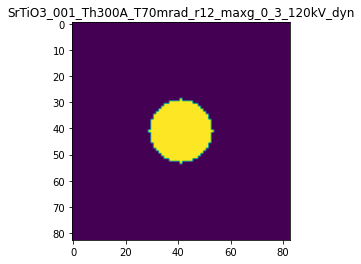

R-factor: 0.00016818507713336247

>>> producing the 97. dataset...

The offset applied on thickness: -0.0006944854329291855

The offset applied on Ug: 23.191030269121665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3055145670708
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

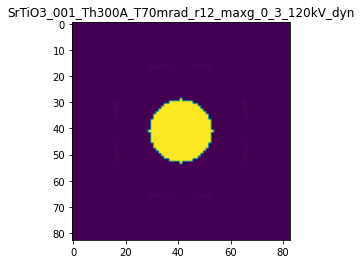

R-factor: 0.0001151551713332566

>>> producing the 98. dataset...

The offset applied on thickness: -0.00044010715886630327

The offset applied on Ug: -23.353315658022076

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5598928411337
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

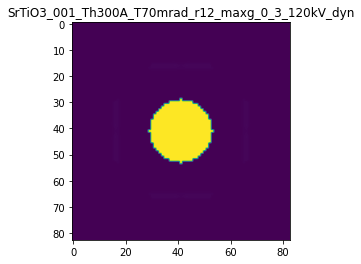

R-factor: 0.00010100372100829777

>>> producing the 99. dataset...

The offset applied on thickness: -0.0005638888637441916

The offset applied on Ug: 23.717127410582545

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4361111362558
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

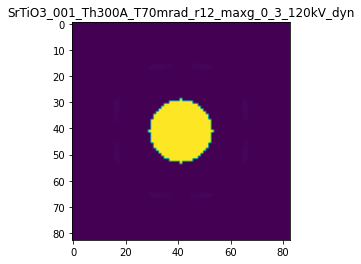

R-factor: 0.00011694636812091594

>>> producing the 100. dataset...

The offset applied on thickness: 0.0005038892656796561

The offset applied on Ug: 7.4122992394625

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5038892656797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

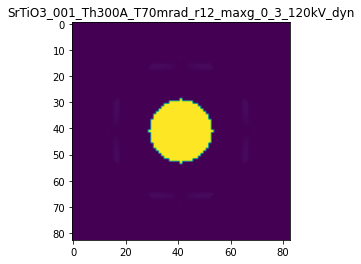

R-factor: 4.5419523780927187e-05

>>> producing the 101. dataset...

The offset applied on thickness: -0.0008688543755642806

The offset applied on Ug: 21.233830836176494

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1311456244357
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

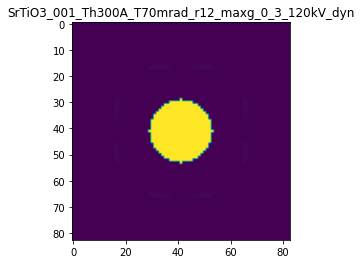

R-factor: 0.00010820715272800456

>>> producing the 102. dataset...

The offset applied on thickness: 0.0003058313596534235

The offset applied on Ug: -31.848055560441473

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3058313596534
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

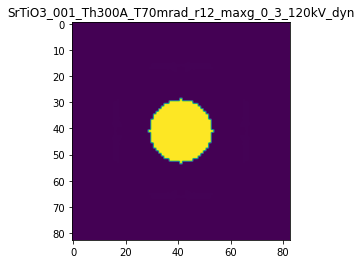

R-factor: 0.00014475787077864512

>>> producing the 103. dataset...

The offset applied on thickness: 0.0005955006600908381

The offset applied on Ug: -9.10119919961233

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5955006600908
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

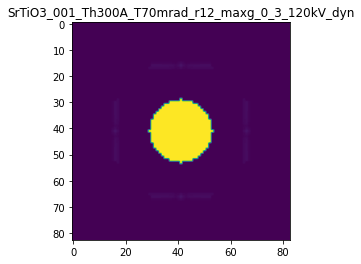

R-factor: 4.363565205614717e-05

>>> producing the 104. dataset...

The offset applied on thickness: -0.00023536688164109543

The offset applied on Ug: 34.082107751466594

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76463311835886
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

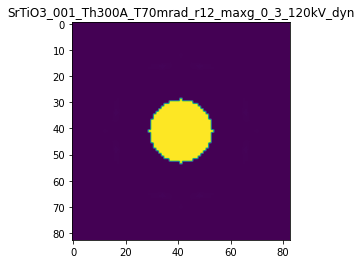

R-factor: 0.00014481596931360707

>>> producing the 105. dataset...

The offset applied on thickness: -0.0005579182639057252

The offset applied on Ug: 17.540557552428737

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4420817360943
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

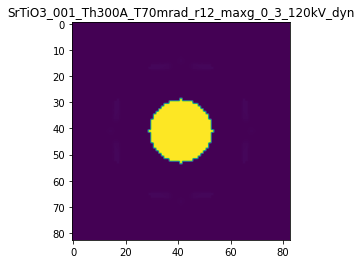

R-factor: 9.386689043994136e-05

>>> producing the 106. dataset...

The offset applied on thickness: 0.000945077894108101

The offset applied on Ug: -35.460345628049666

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.94507789410807
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

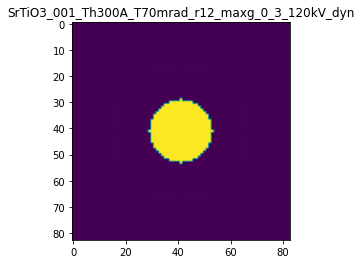

R-factor: 0.00015686082343194132

>>> producing the 107. dataset...

The offset applied on thickness: -0.0004033459907247572

The offset applied on Ug: -24.76113094502575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5966540092752
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

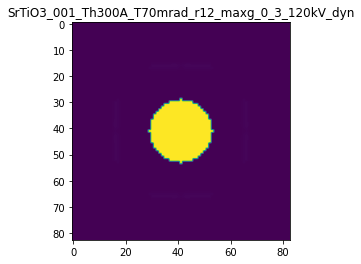

R-factor: 0.00010931271073502646

>>> producing the 108. dataset...

The offset applied on thickness: 0.0009779511022083049

The offset applied on Ug: 1.6576079808593114

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9779511022083
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

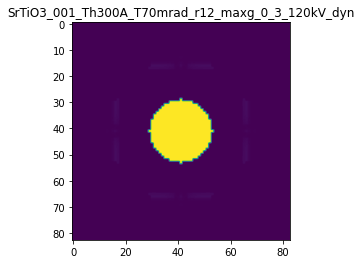

R-factor: 9.926358081455759e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0008282768257499469

The offset applied on Ug: 12.092275057834586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1717231742501
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

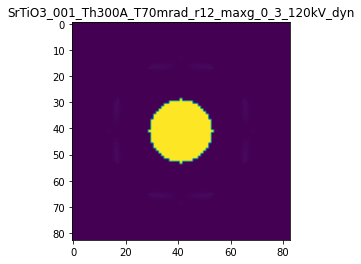

R-factor: 6.996759779795589e-05

>>> producing the 110. dataset...

The offset applied on thickness: -0.0008605066896257576

The offset applied on Ug: -5.727877757464812

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1394933103742
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

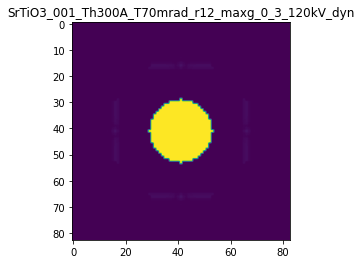

R-factor: 3.108095349749531e-05

>>> producing the 111. dataset...

The offset applied on thickness: -0.0006547805100308198

The offset applied on Ug: -3.219545338866228

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34521948996917
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

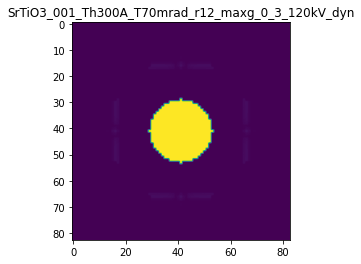

R-factor: 1.8459219402972208e-05

>>> producing the 112. dataset...

The offset applied on thickness: 0.00041017845343988116

The offset applied on Ug: -13.557277754658399

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41017845343987
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

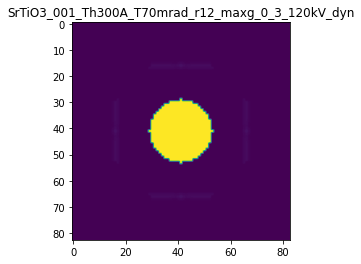

R-factor: 5.690581710034101e-05

>>> producing the 113. dataset...

The offset applied on thickness: 0.00017546148049523346

The offset applied on Ug: 19.521776228129895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17546148049524
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

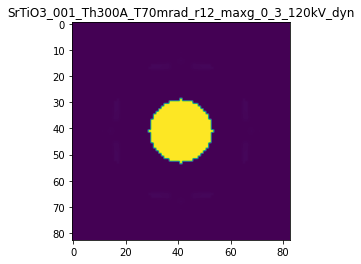

R-factor: 0.0001015444222597186

>>> producing the 114. dataset...

The offset applied on thickness: -0.0008933385129856331

The offset applied on Ug: -30.06224047207268

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1066614870144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

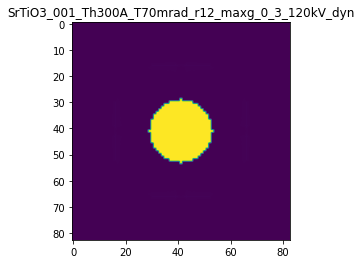

R-factor: 0.00013729797494502706

>>> producing the 115. dataset...

The offset applied on thickness: -0.000706485913180751

The offset applied on Ug: 14.335676600171892

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29351408681924
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

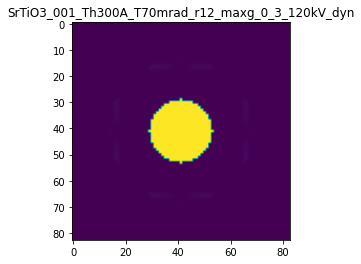

R-factor: 8.03001781753065e-05

>>> producing the 116. dataset...

The offset applied on thickness: -0.0004177303413935689

The offset applied on Ug: -40.82941904468063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5822696586064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

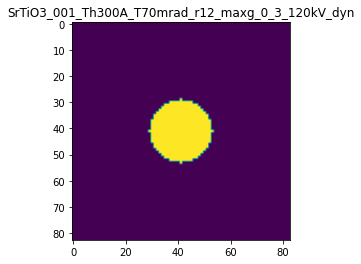

R-factor: 0.00017128485466122467

>>> producing the 117. dataset...

The offset applied on thickness: 0.00040226720339457976

The offset applied on Ug: -3.8345346161342424

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40226720339456
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

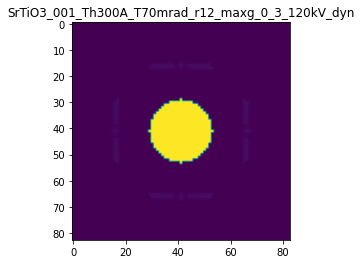

R-factor: 2.194682171617877e-05

>>> producing the 118. dataset...

The offset applied on thickness: 0.00025232551959192387

The offset applied on Ug: -22.973332276119972

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2523255195919
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

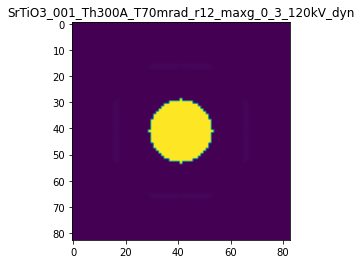

R-factor: 9.875514505832657e-05

>>> producing the 119. dataset...

The offset applied on thickness: 0.0009694017676402242

The offset applied on Ug: 1.2602923543495035

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9694017676402
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

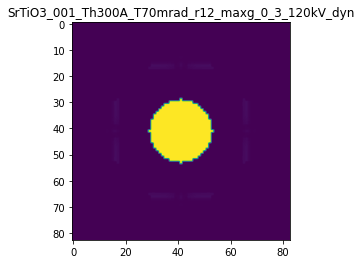

R-factor: 7.4832366956599645e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.0008929357156657672

The offset applied on Ug: -13.120733604055777

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10706428433423
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

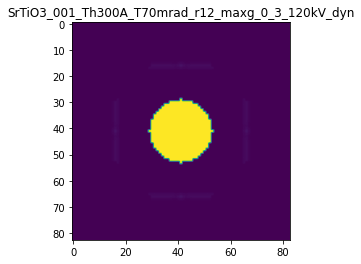

R-factor: 5.599836897043419e-05

>>> producing the 121. dataset...

The offset applied on thickness: -7.954220030457759e-05

The offset applied on Ug: 3.990428645964603

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9204577996954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

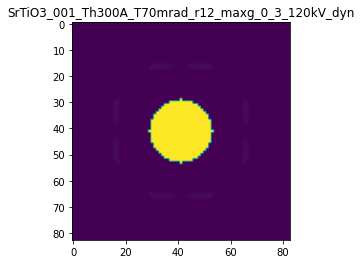

R-factor: 2.5117616585656742e-05

>>> producing the 122. dataset...

The offset applied on thickness: 0.00013413758386194874

The offset applied on Ug: -32.40151269146019

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1341375838619
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

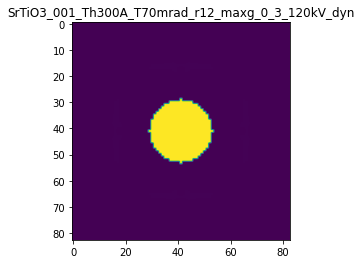

R-factor: 0.00014683636666869428

>>> producing the 123. dataset...

The offset applied on thickness: -0.0003837875110010418

The offset applied on Ug: 12.397903054422141

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.61621248899894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

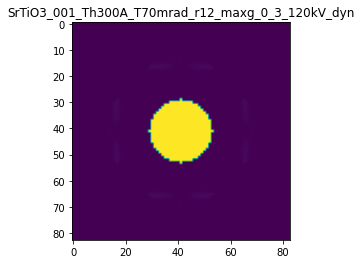

R-factor: 7.13024031129732e-05

>>> producing the 124. dataset...

The offset applied on thickness: 0.0003025488378195453

The offset applied on Ug: -29.23901654015848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30254883781953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

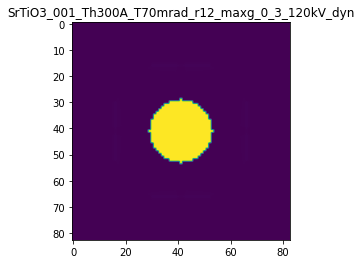

R-factor: 0.0001332752149173039

>>> producing the 125. dataset...

The offset applied on thickness: -0.0002687264588123102

The offset applied on Ug: 12.204098774677623

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.73127354118765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

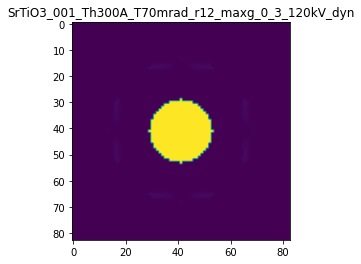

R-factor: 7.033955403840826e-05

>>> producing the 126. dataset...

The offset applied on thickness: 0.0003167906507797935

The offset applied on Ug: -0.13683159896109828

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.31679065077975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

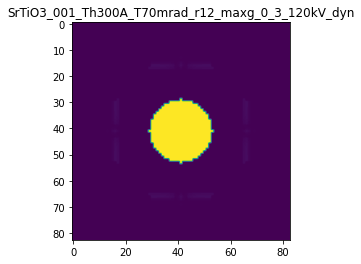

R-factor: 1.0648527133678821e-06

>>> producing the 127. dataset...

The offset applied on thickness: -2.090652953929917e-05

The offset applied on Ug: 18.493370678725242

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9790934704607
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

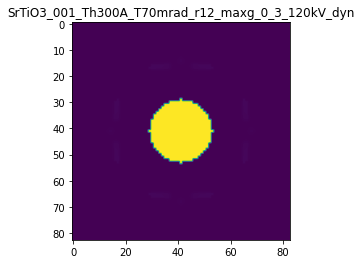

R-factor: 9.756683030072037e-05

>>> producing the 128. dataset...

The offset applied on thickness: -0.0005640849053241029

The offset applied on Ug: 32.906304971040406

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43591509467586
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

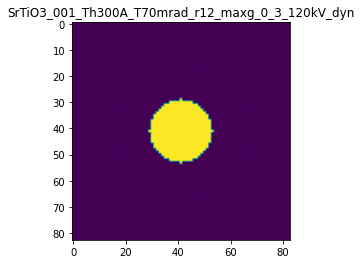

R-factor: 0.00014225351633189505

>>> producing the 129. dataset...

The offset applied on thickness: 0.00025114684062698366

The offset applied on Ug: -31.1563787031972

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.251146840627
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

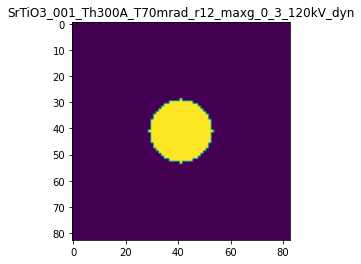

R-factor: 0.00014197513537018104

>>> producing the 130. dataset...

The offset applied on thickness: -0.0005615513549037536

The offset applied on Ug: 38.92224496137834

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43844864509623
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

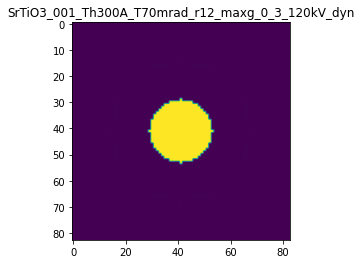

R-factor: 0.00015444149299117843

>>> producing the 131. dataset...

The offset applied on thickness: -0.0005596014618608353

The offset applied on Ug: -17.424739863516017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.44039853813916
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

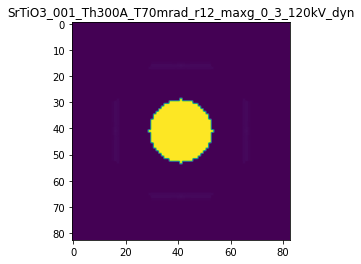

R-factor: 7.047492402881206e-05

>>> producing the 132. dataset...

The offset applied on thickness: 0.00037832029470572003

The offset applied on Ug: -24.23796122155137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.37832029470576
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

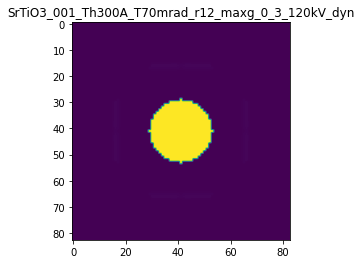

R-factor: 0.00010615524525381968

>>> producing the 133. dataset...

The offset applied on thickness: 0.00046638253272716316

The offset applied on Ug: 1.5971938812520057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46638253272715
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

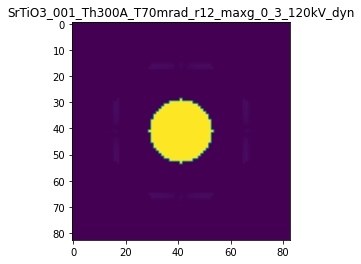

R-factor: 9.76440628004094e-06

>>> producing the 134. dataset...

The offset applied on thickness: 0.0008223507285775631

The offset applied on Ug: -18.134353266267

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82235072857753
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

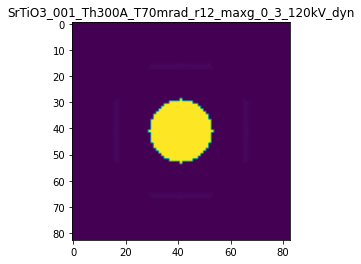

R-factor: 7.306010699077393e-05

>>> producing the 135. dataset...

The offset applied on thickness: 0.0002856236837974651

The offset applied on Ug: 36.26225129768503

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28562368379744
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

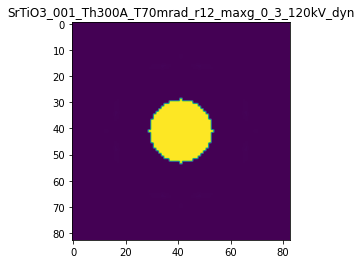

R-factor: 0.00014942808046352146

>>> producing the 136. dataset...

The offset applied on thickness: 0.000597781361990367

The offset applied on Ug: -37.00781658059048

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5977813619903
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

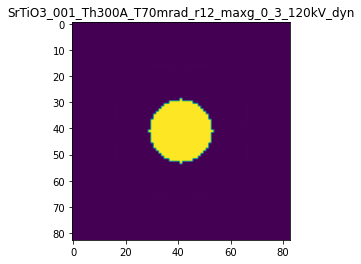

R-factor: 0.00016165615163895808

>>> producing the 137. dataset...

The offset applied on thickness: -0.00023837915819888145

The offset applied on Ug: 20.34828624467211

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7616208418011
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

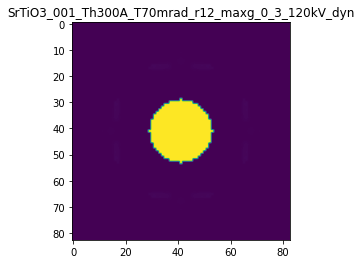

R-factor: 0.00010480876865620346

>>> producing the 138. dataset...

The offset applied on thickness: 0.0005601830230710245

The offset applied on Ug: 30.385436114985534

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56018302307103
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

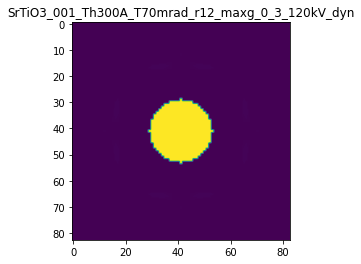

R-factor: 0.0001362719936007679

>>> producing the 139. dataset...

The offset applied on thickness: 0.0007780495864817267

The offset applied on Ug: 37.4994632011115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7780495864817
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

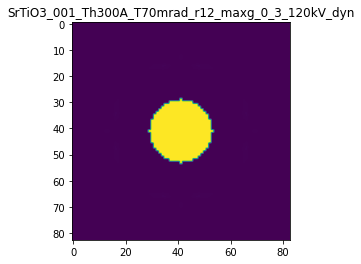

R-factor: 0.0001519002990713783

>>> producing the 140. dataset...

The offset applied on thickness: 0.0006873047671608996

The offset applied on Ug: -21.133700652546057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.68730476716087
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

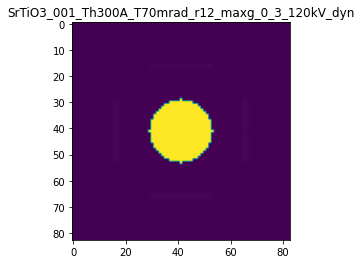

R-factor: 8.832294471403549e-05



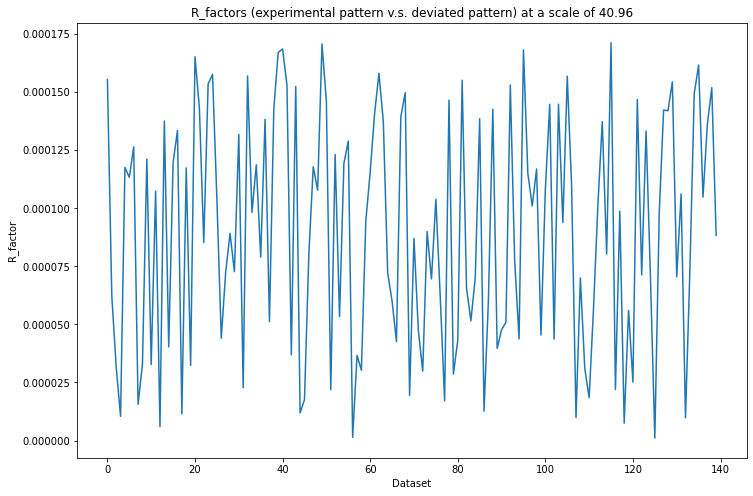

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 3s 398ms/step - loss: 38.5798 - acc: 0.3700 - val_loss: 35.2327 - val_acc: 0.4000
Epoch 2/20
5/5 [==============================] - 1s 234ms/step - loss: 38.2814 - acc: 0.4800 - val_loss: 35.1625 - val_acc: 0.4000
Epoch 3/20
5/5 [==============================] - 1s 240ms/step - loss: 38.2145 - acc: 0.4800 - val_loss: 35.1257 - val_acc: 0.4000
Epoch 4/20
5/5 [==============================] - 1s 255ms/step - loss: 38.1877 - acc: 0.4800 - val_loss: 35.0974 - val_acc: 0.4000
Epoch 5/20
5/5 [==============================] - 1s 259ms/step - loss: 38.1610 - acc: 0.4800 - val_loss: 35.0800 - val_acc: 0.4000
Epoch 6/20
5/5 [==============================] - 1s 249ms/step - loss: 38.1447 - acc: 0.4800 - val_loss: 35.0639 - val_acc: 0.4000
Epoch 7/20
5/5 [==============================] - 1s 236ms/step - loss: 38.1262 - acc: 0.4800 - val_loss: 35.0432 - val_acc: 0.4000
Epoch 8/20
5/5 [==============================]

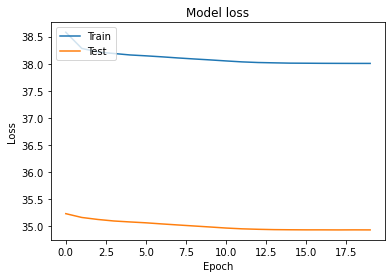

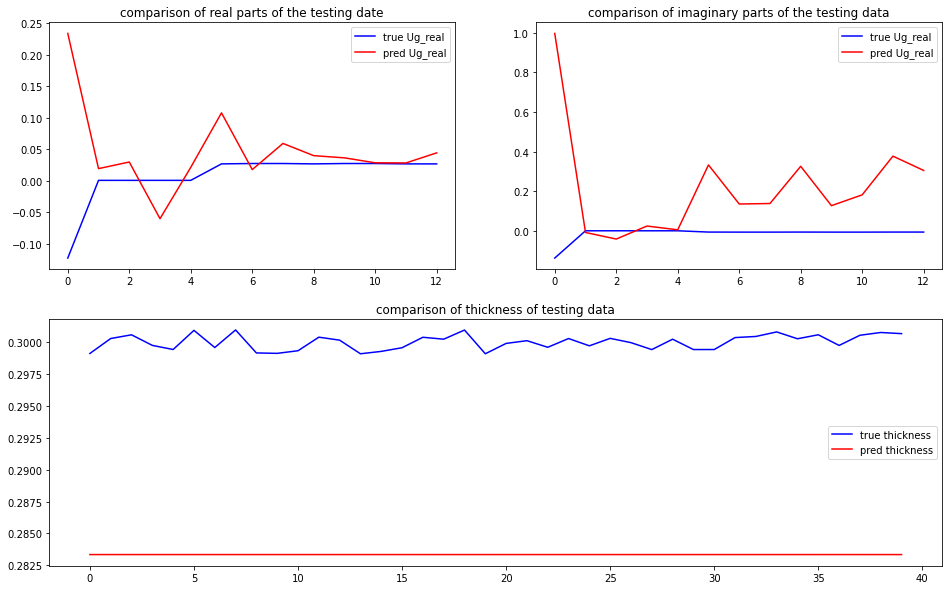

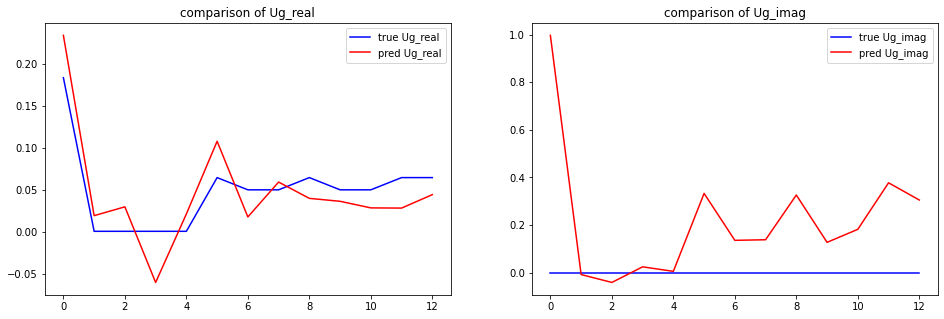

predicted thickness: 28.33421230316162 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=283.3421230316162
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.23401025+0.j          0.0243

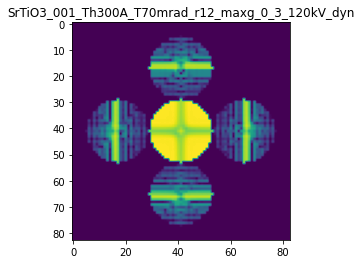

X_sim.max(): 0.9975665119439096
R-factor at a scale of 40.96 is 0.47335030580488935.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 81.92

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.00044085085994189456

The offset applied on Ug: -14.529211915796186

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


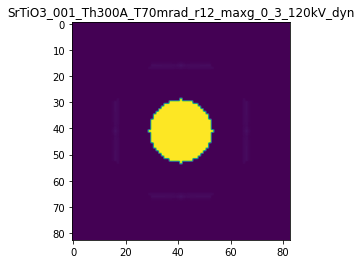

R-factor: 5.96828575199639e-05

>>> producing the 2. dataset...

The offset applied on thickness: 0.0008427229271411911

The offset applied on Ug: -54.043883011952005

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8427229271412
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

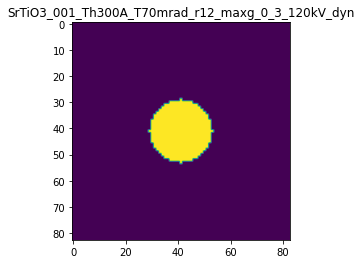

R-factor: 0.00018462261414247395

>>> producing the 3. dataset...

The offset applied on thickness: 0.0009141831793359862

The offset applied on Ug: 31.03442399053098

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91418317933596
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

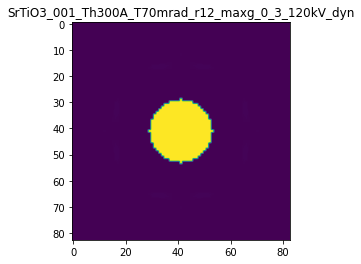

R-factor: 0.0001378829691702216

>>> producing the 4. dataset...

The offset applied on thickness: -0.00044115860693118015

The offset applied on Ug: -18.508365071627104

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5588413930688
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

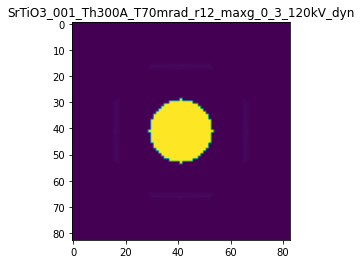

R-factor: 7.517931101624582e-05

>>> producing the 5. dataset...

The offset applied on thickness: 6.682728998595611e-05

The offset applied on Ug: -79.39458227757402

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06682728998595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

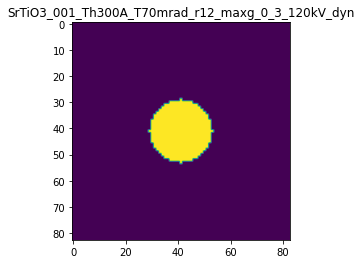

R-factor: 0.00018735351422139265

>>> producing the 6. dataset...

The offset applied on thickness: -0.0006793775689203374

The offset applied on Ug: -60.814615962471635

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32062243107964
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

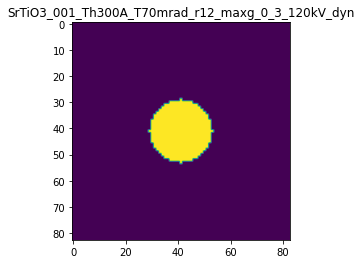

R-factor: 0.00018553025203258105

>>> producing the 7. dataset...

The offset applied on thickness: 0.00014905362453377545

The offset applied on Ug: 30.474411881559337

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14905362453374
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

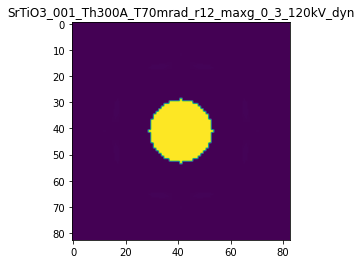

R-factor: 0.00013650698968135932

>>> producing the 8. dataset...

The offset applied on thickness: -2.7618431031161127e-05

The offset applied on Ug: -7.023293524106612

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97238156896884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

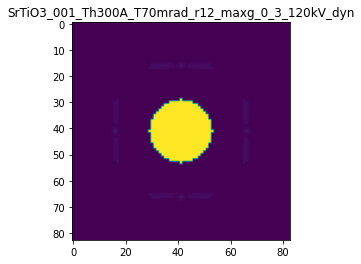

R-factor: 3.6611398827808214e-05

>>> producing the 9. dataset...

The offset applied on thickness: 0.0003078038610239544

The offset applied on Ug: -44.29751292332898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30780386102396
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

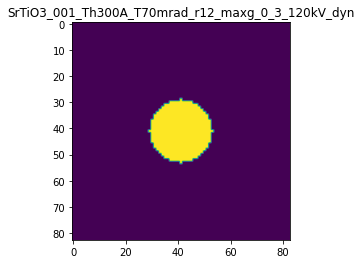

R-factor: 0.00017696793691888946

>>> producing the 10. dataset...

The offset applied on thickness: -0.0005275845512670972

The offset applied on Ug: -55.152319665151026

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4724154487329
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

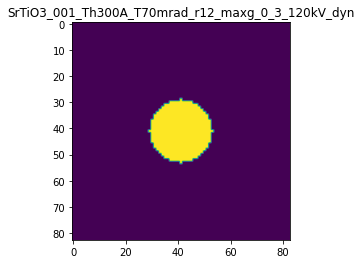

R-factor: 0.0001849051476216212

>>> producing the 11. dataset...

The offset applied on thickness: -0.0004993305072916139

The offset applied on Ug: -11.21327542668736

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50066949270837
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

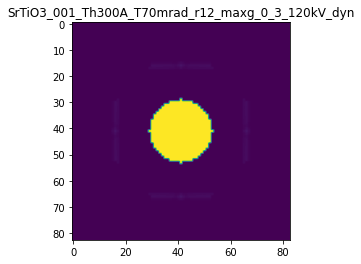

R-factor: 5.042256732668751e-05

>>> producing the 12. dataset...

The offset applied on thickness: -0.0006586304558310105

The offset applied on Ug: -59.80015890514871

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34136954416897
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

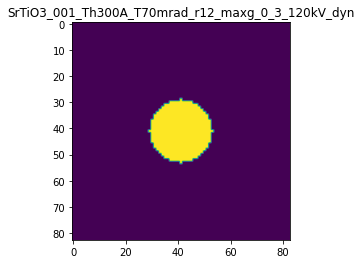

R-factor: 0.00018543619081431078

>>> producing the 13. dataset...

The offset applied on thickness: 0.0007665043403169306

The offset applied on Ug: -32.79460954234803

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76650434031694
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

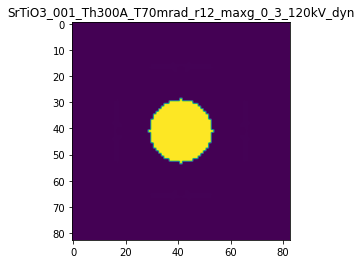

R-factor: 0.00014820590561760404

>>> producing the 14. dataset...

The offset applied on thickness: 0.0005290363360635473

The offset applied on Ug: 63.83259626181423

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52903633606354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

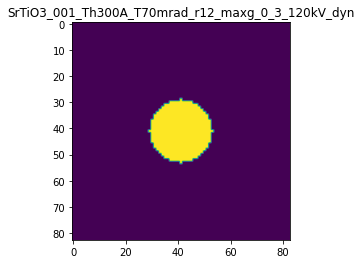

R-factor: 0.00017684817586259937

>>> producing the 15. dataset...

The offset applied on thickness: -0.0009032294758040582

The offset applied on Ug: -45.18854839005624

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0967705241959
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

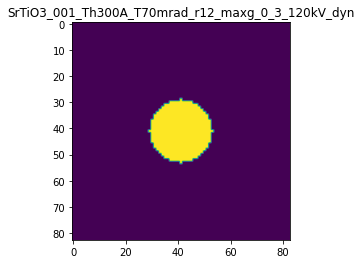

R-factor: 0.00017806764885173112

>>> producing the 16. dataset...

The offset applied on thickness: -0.0006855887484839407

The offset applied on Ug: 25.06085125025029

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31441125151605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

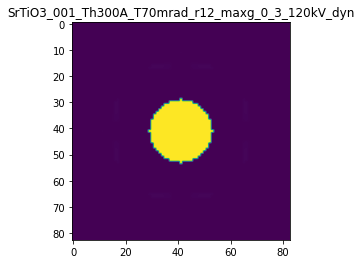

R-factor: 0.00012137862411902438

>>> producing the 17. dataset...

The offset applied on thickness: -5.5944534187590604e-05

The offset applied on Ug: -39.5467068954814

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94405546581237
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

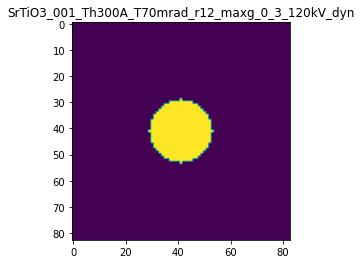

R-factor: 0.00016844042486104376

>>> producing the 18. dataset...

The offset applied on thickness: -0.0004915386777521608

The offset applied on Ug: 56.73758219240108

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50846132224785
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

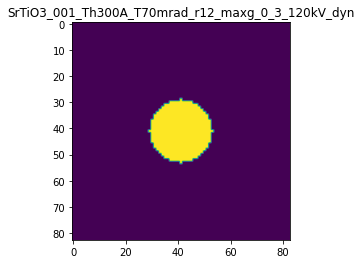

R-factor: 0.00017375360353996355

>>> producing the 19. dataset...

The offset applied on thickness: 9.412365750700902e-05

The offset applied on Ug: -10.490098690864688

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.094123657507
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

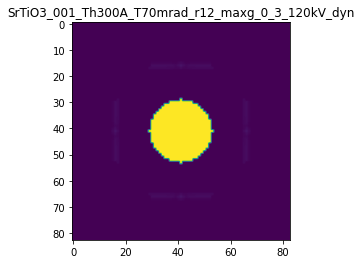

R-factor: 4.808742247448603e-05

>>> producing the 20. dataset...

The offset applied on thickness: -0.0005967262763634178

The offset applied on Ug: 16.736399626684378

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4032737236366
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

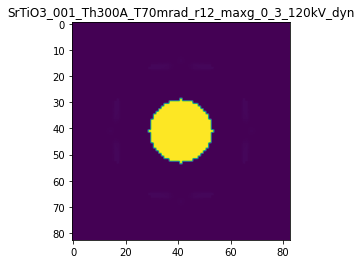

R-factor: 9.057898232081504e-05

>>> producing the 21. dataset...

The offset applied on thickness: 0.00021949952225388338

The offset applied on Ug: -51.16237510426165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21949952225384
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

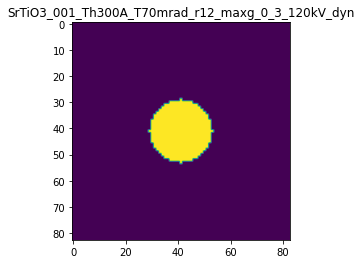

R-factor: 0.00018349536308824457

>>> producing the 22. dataset...

The offset applied on thickness: 0.0008176134494621463

The offset applied on Ug: 53.70799929918621

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8176134494621
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

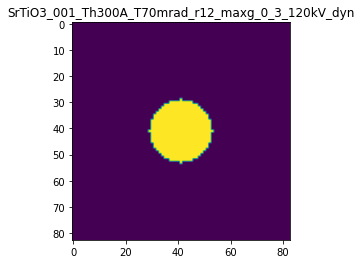

R-factor: 0.00017188499254945462

>>> producing the 23. dataset...

The offset applied on thickness: -0.0001929270501794147

The offset applied on Ug: 38.97539721041181

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80707294982057
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

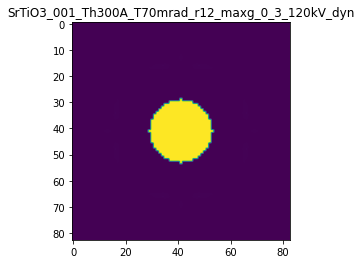

R-factor: 0.00015455604942625001

>>> producing the 24. dataset...

The offset applied on thickness: 0.000690462001610469

The offset applied on Ug: -32.54770210163548

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69046200161046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

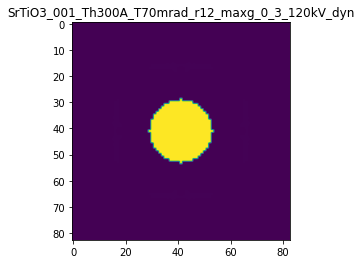

R-factor: 0.0001473421101866864

>>> producing the 25. dataset...

The offset applied on thickness: -0.0007635678068213108

The offset applied on Ug: -0.482564165055137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2364321931787
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

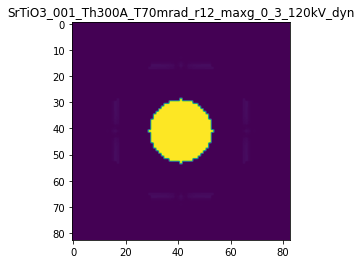

R-factor: 2.9199462943161675e-06

>>> producing the 26. dataset...

The offset applied on thickness: 0.0006652418748473008

The offset applied on Ug: -81.61592334559627

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66524187484725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

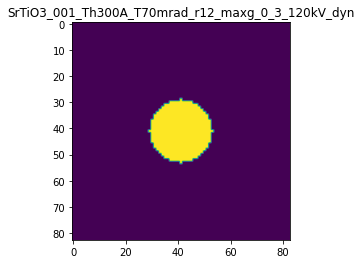

R-factor: 0.00018743070619056613

>>> producing the 27. dataset...

The offset applied on thickness: 2.5488778558593772e-05

The offset applied on Ug: -6.093180105719257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.02548877855855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

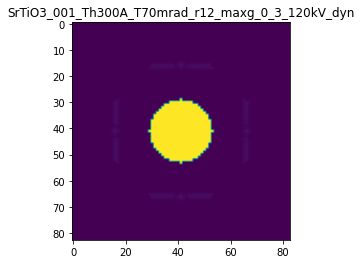

R-factor: 3.269947113681344e-05

>>> producing the 28. dataset...

The offset applied on thickness: -0.0005941851211244942

The offset applied on Ug: -55.00544071533879

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4058148788755
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

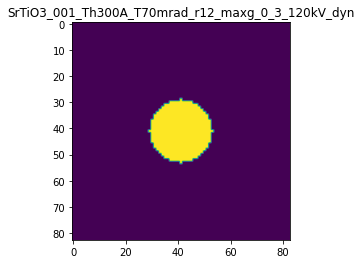

R-factor: 0.00018487666464990558

>>> producing the 29. dataset...

The offset applied on thickness: -0.0004062735342940806

The offset applied on Ug: 78.01866888528912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5937264657059
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

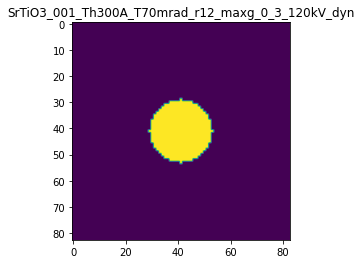

R-factor: 0.00018079394600865076

>>> producing the 30. dataset...

The offset applied on thickness: 1.570499853068075e-05

The offset applied on Ug: 28.899133882350924

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0157049985307
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

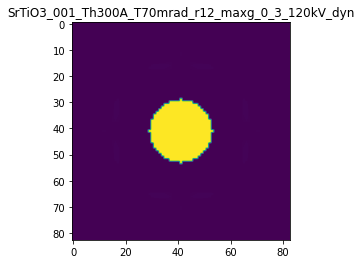

R-factor: 0.00013247275130943878

>>> producing the 31. dataset...

The offset applied on thickness: 8.906540886821523e-05

The offset applied on Ug: -36.26290192155926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0890654088682
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

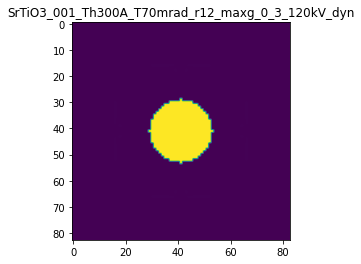

R-factor: 0.00015938247682405026

>>> producing the 32. dataset...

The offset applied on thickness: -0.00029928907262302353

The offset applied on Ug: 48.48727808947075

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.700710927377
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

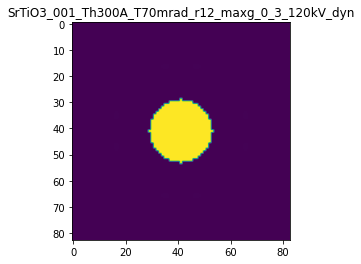

R-factor: 0.00016707211812422897

>>> producing the 33. dataset...

The offset applied on thickness: 0.00019201448862537075

The offset applied on Ug: 17.81686447362339

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1920144886254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

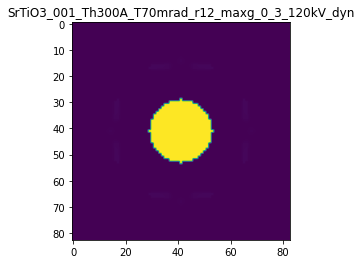

R-factor: 9.481095804736745e-05

>>> producing the 34. dataset...

The offset applied on thickness: 0.0006893058847054048

The offset applied on Ug: -52.82894489891201

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6893058847054
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

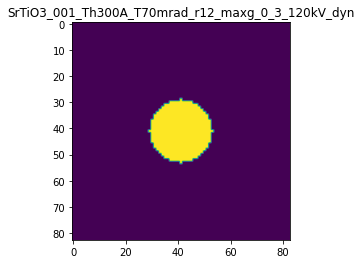

R-factor: 0.00018423241010774325

>>> producing the 35. dataset...

The offset applied on thickness: 0.000416282656010911

The offset applied on Ug: -76.13015650046717

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4162826560109
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

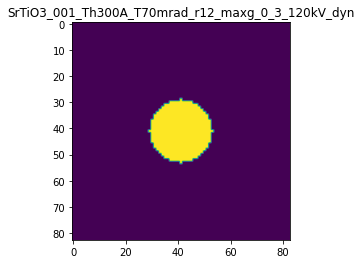

R-factor: 0.00018725658467569041

>>> producing the 36. dataset...

The offset applied on thickness: 0.0009991290579952378

The offset applied on Ug: 39.151404891252604

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9991290579953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

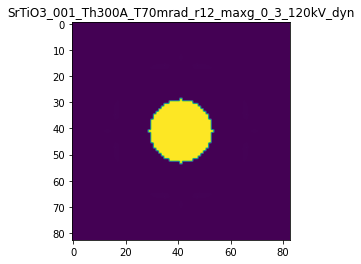

R-factor: 0.0001549257459805431

>>> producing the 37. dataset...

The offset applied on thickness: 0.00034161896435301787

The offset applied on Ug: 48.548042439385625

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.341618964353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

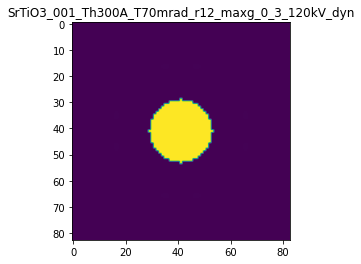

R-factor: 0.00016722108023768778

>>> producing the 38. dataset...

The offset applied on thickness: 0.0008081550562823983

The offset applied on Ug: -69.46596011934878

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8081550562824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

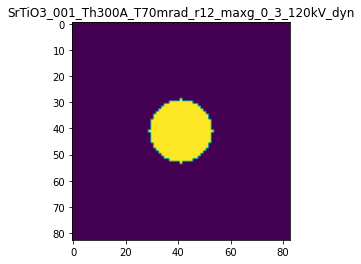

R-factor: 0.00018696169491395312

>>> producing the 39. dataset...

The offset applied on thickness: -0.00030244890589630423

The offset applied on Ug: -0.9915749974450955

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6975510941037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

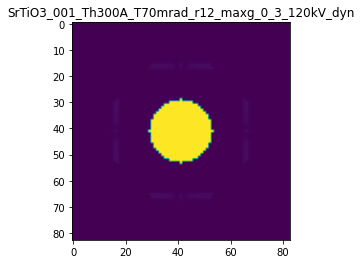

R-factor: 5.875969203359677e-06

>>> producing the 40. dataset...

The offset applied on thickness: -0.0009229688064691868

The offset applied on Ug: 3.744155914239327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0770311935308
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

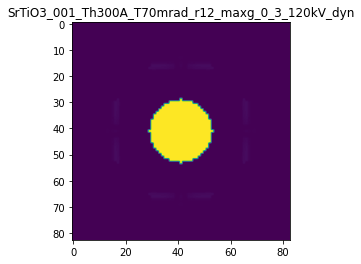

R-factor: 2.3945311458396426e-05

>>> producing the 41. dataset...

The offset applied on thickness: 0.000991478001658634

The offset applied on Ug: -5.0990387094246215

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9914780016586
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

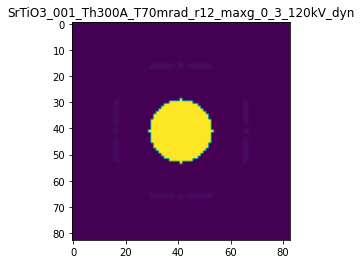

R-factor: 2.8291898500916502e-05

>>> producing the 42. dataset...

The offset applied on thickness: 0.0006422072659246092

The offset applied on Ug: 18.017835574850107

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6422072659246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

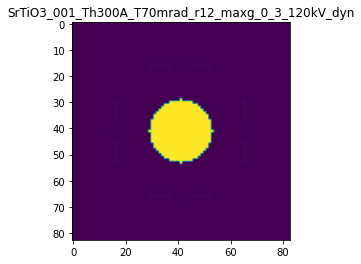

R-factor: 9.551773181679563e-05

>>> producing the 43. dataset...

The offset applied on thickness: -0.0004617903334904261

The offset applied on Ug: 39.87926255377082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53820966650954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

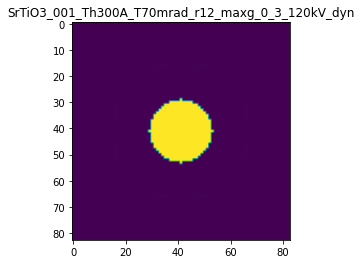

R-factor: 0.0001560633249467205

>>> producing the 44. dataset...

The offset applied on thickness: 0.00044879433436513375

The offset applied on Ug: -48.55001557417079

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4487943343651
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

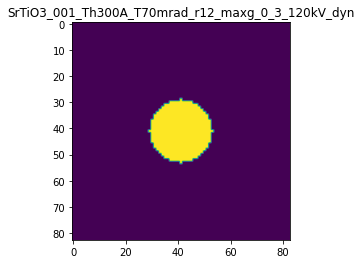

R-factor: 0.00018168656315986186

>>> producing the 45. dataset...

The offset applied on thickness: 0.0009723043638346543

The offset applied on Ug: -65.68545755863778

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97230436383467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

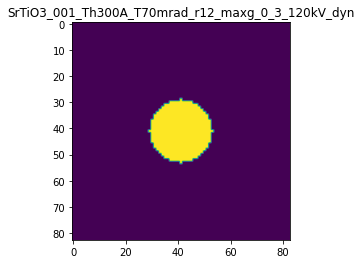

R-factor: 0.00018629636126178185

>>> producing the 46. dataset...

The offset applied on thickness: -0.0007869322262856309

The offset applied on Ug: 9.227719623100874

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2130677737144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

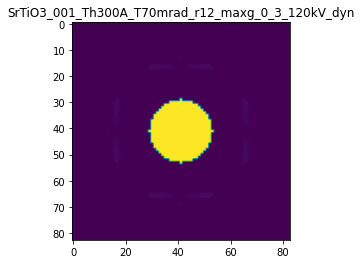

R-factor: 5.5714172223375185e-05

>>> producing the 47. dataset...

The offset applied on thickness: 0.0002130131389727763

The offset applied on Ug: -48.9715893001873

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21301313897277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

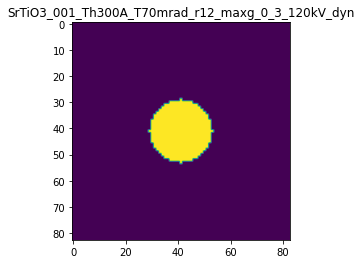

R-factor: 0.00018203464280025747

>>> producing the 48. dataset...

The offset applied on thickness: -0.0004405977731240964

The offset applied on Ug: 33.25782371502062

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5594022268759
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

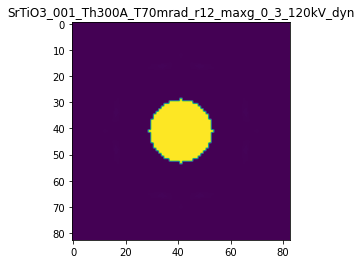

R-factor: 0.00014302880458503218

>>> producing the 49. dataset...

The offset applied on thickness: -6.829222688288961e-05

The offset applied on Ug: -65.42637942101099

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9317077731171
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

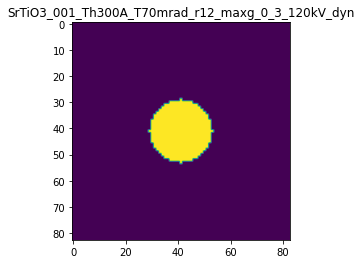

R-factor: 0.0001862431968174855

>>> producing the 50. dataset...

The offset applied on thickness: 0.0009317315512836077

The offset applied on Ug: 33.74656871831252

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93173155128363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

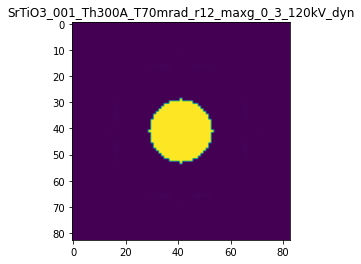

R-factor: 0.00014408851299189173

>>> producing the 51. dataset...

The offset applied on thickness: 0.00010026266501100478

The offset applied on Ug: -22.869788540794982

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.100262665011
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

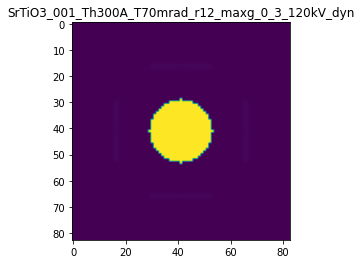

R-factor: 9.821634181441215e-05

>>> producing the 52. dataset...

The offset applied on thickness: -0.0005069624043812533

The offset applied on Ug: -50.1468244920321

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4930375956187
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

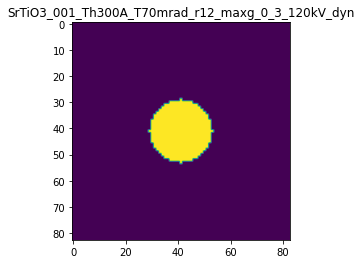

R-factor: 0.00018287592154618811

>>> producing the 53. dataset...

The offset applied on thickness: 0.0003957231501591552

The offset applied on Ug: -59.60228163351241

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39572315015914
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

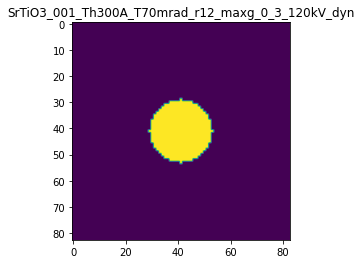

R-factor: 0.00018538183052831006

>>> producing the 54. dataset...

The offset applied on thickness: 0.00018169627975623916

The offset applied on Ug: -75.96768872653404

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.18169627975624
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

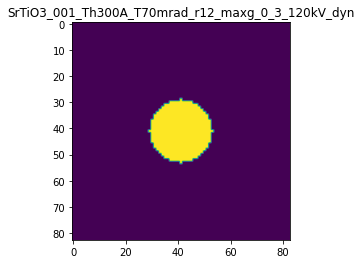

R-factor: 0.00018727397397226927

>>> producing the 55. dataset...

The offset applied on thickness: -0.0006115906049368112

The offset applied on Ug: 81.68469029925224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.38840939506315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

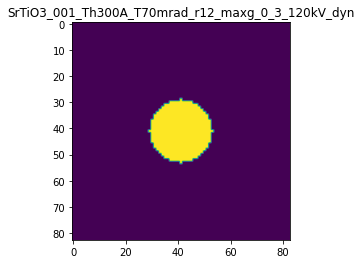

R-factor: 0.00018198088830013624

>>> producing the 56. dataset...

The offset applied on thickness: 0.0002666025483679537

The offset applied on Ug: 49.593052488064934

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2666025483679
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

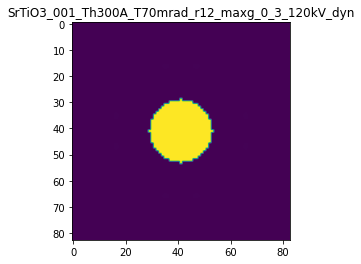

R-factor: 0.00016835804943980697

>>> producing the 57. dataset...

The offset applied on thickness: 0.00047572423095120864

The offset applied on Ug: 45.35721761590489

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4757242309512
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

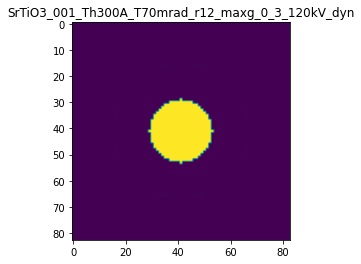

R-factor: 0.00016348382815972932

>>> producing the 58. dataset...

The offset applied on thickness: 0.0002607319647078965

The offset applied on Ug: -9.532827742626232

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2607319647079
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

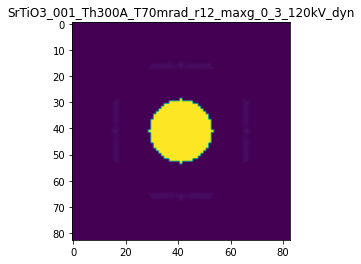

R-factor: 4.501387060144969e-05

>>> producing the 59. dataset...

The offset applied on thickness: -0.0009920330250663186

The offset applied on Ug: -66.63852820240741

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00796697493365
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

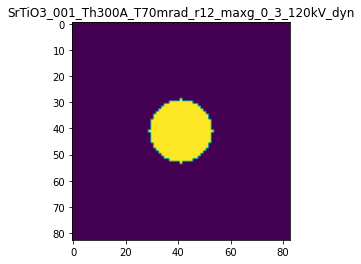

R-factor: 0.00018646503380073697

>>> producing the 60. dataset...

The offset applied on thickness: -0.0006527392474517286

The offset applied on Ug: -70.96682869528063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34726075254827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

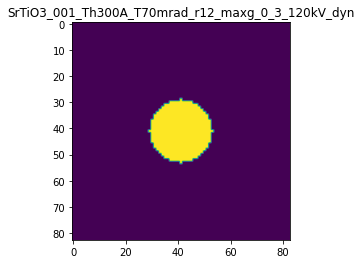

R-factor: 0.00018716861506777008

>>> producing the 61. dataset...

The offset applied on thickness: 0.0005003711247677276

The offset applied on Ug: 28.850711126569223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50037112476775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

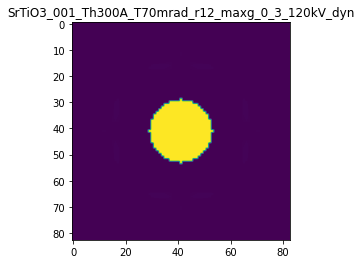

R-factor: 0.0001323209168903407

>>> producing the 62. dataset...

The offset applied on thickness: -0.0007412706674637795

The offset applied on Ug: 51.81508320736264

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.25872933253623
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

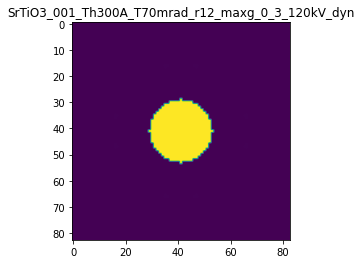

R-factor: 0.00017034670407622726

>>> producing the 63. dataset...

The offset applied on thickness: 0.0007436729783245457

The offset applied on Ug: -39.20636937214382

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7436729783245
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

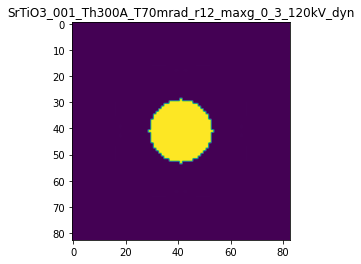

R-factor: 0.00016765951267820378

>>> producing the 64. dataset...

The offset applied on thickness: -0.0006485033682348487

The offset applied on Ug: -6.734695376073469

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35149663176514
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

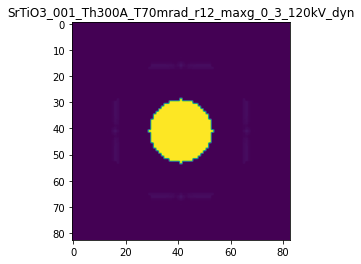

R-factor: 3.546306092553046e-05

>>> producing the 65. dataset...

The offset applied on thickness: -0.00011291479945311612

The offset applied on Ug: 26.682063871670216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88708520054684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

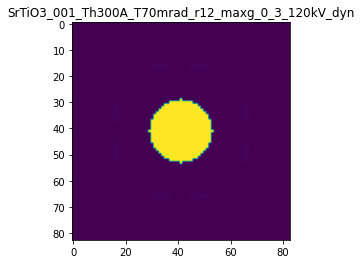

R-factor: 0.00012624789598707009

>>> producing the 66. dataset...

The offset applied on thickness: -0.00015550016738537464

The offset applied on Ug: -12.445995689215051

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84449983261464
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

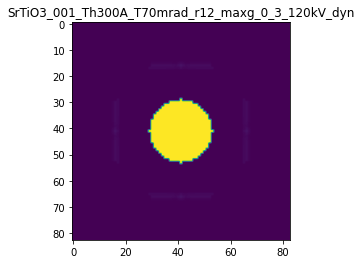

R-factor: 5.388686206413198e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.0007988109344978685

The offset applied on Ug: -35.745628405147784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79881093449785
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

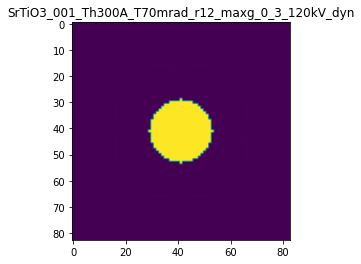

R-factor: 0.00015778051643732647

>>> producing the 68. dataset...

The offset applied on thickness: 0.0001951171074109912

The offset applied on Ug: 78.68418131765573

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.19511710741097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

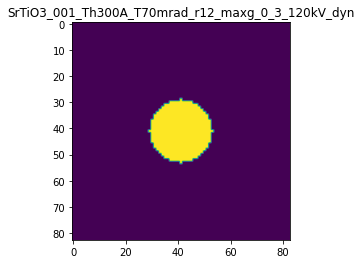

R-factor: 0.0001810790515349482

>>> producing the 69. dataset...

The offset applied on thickness: 0.00039615343120535143

The offset applied on Ug: 32.38470379427849

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39615343120533
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

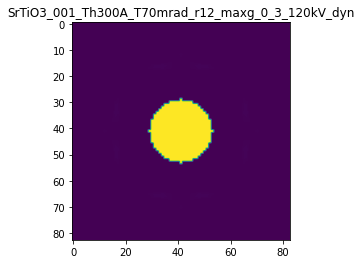

R-factor: 0.00014106456554466344

>>> producing the 70. dataset...

The offset applied on thickness: -0.0009989539598760772

The offset applied on Ug: -39.78266555660981

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0010460401239
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

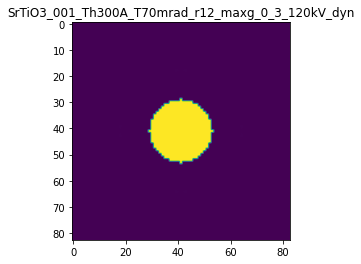

R-factor: 0.00016893603072414785

>>> producing the 71. dataset...

The offset applied on thickness: 0.00014998215842841001

The offset applied on Ug: -15.12447470755129

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14998215842843
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

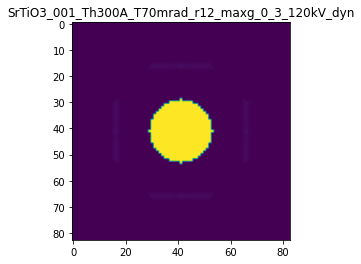

R-factor: 6.141599578409871e-05

>>> producing the 72. dataset...

The offset applied on thickness: -0.00011189317253875975

The offset applied on Ug: -44.85282378308164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88810682746123
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

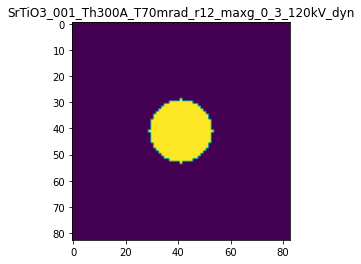

R-factor: 0.00017767856917456101

>>> producing the 73. dataset...

The offset applied on thickness: 0.000558746122669888

The offset applied on Ug: -65.6424455118652

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55874612266985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

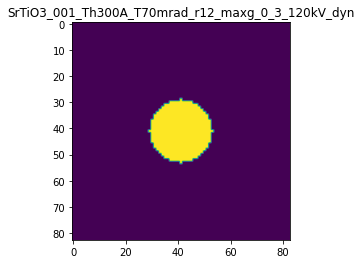

R-factor: 0.00018628697434676893

>>> producing the 74. dataset...

The offset applied on thickness: -0.0005350286800870127

The offset applied on Ug: -16.4156580184234

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46497131991293
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

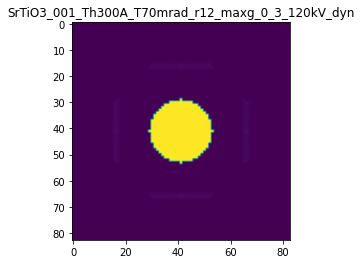

R-factor: 6.625859198601461e-05

>>> producing the 75. dataset...

The offset applied on thickness: -0.0007895806524003155

The offset applied on Ug: 39.4540100473103

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21041934759967
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

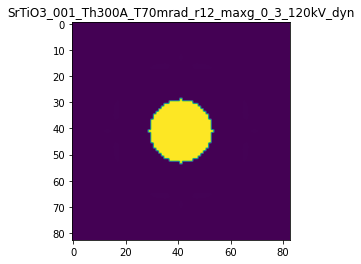

R-factor: 0.00015534624474053063

>>> producing the 76. dataset...

The offset applied on thickness: 0.0005081537327173944

The offset applied on Ug: 38.20569093355614

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5081537327174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

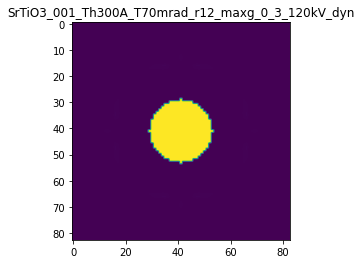

R-factor: 0.00015320660311521388

>>> producing the 77. dataset...

The offset applied on thickness: -0.0009031092086642048

The offset applied on Ug: 7.822323757612685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0968907913358
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

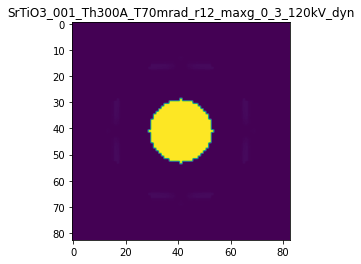

R-factor: 4.8182012943065904e-05

>>> producing the 78. dataset...

The offset applied on thickness: 0.0006013439091289235

The offset applied on Ug: -3.8962755384849332

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6013439091289
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

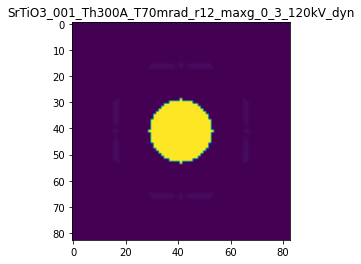

R-factor: 2.231943763813448e-05

>>> producing the 79. dataset...

The offset applied on thickness: 0.0006834510623244135

The offset applied on Ug: -59.8630521346077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6834510623244
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

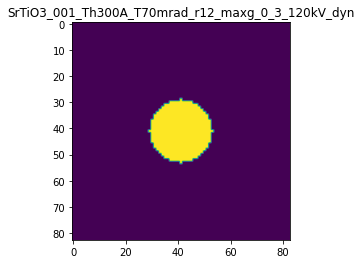

R-factor: 0.0001853989071884285

>>> producing the 80. dataset...

The offset applied on thickness: 0.00045966519910161453

The offset applied on Ug: -59.15545479458722

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4596651991016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

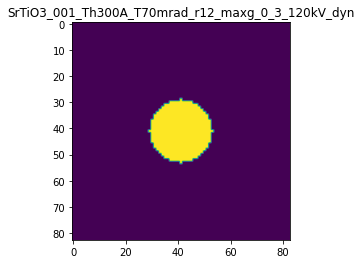

R-factor: 0.00018534419890081378

>>> producing the 81. dataset...

The offset applied on thickness: 0.00034169639881536317

The offset applied on Ug: 21.555320366010694

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3416963988154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

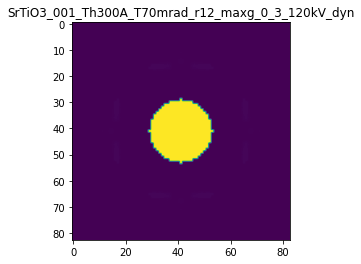

R-factor: 0.00010916836567207276

>>> producing the 82. dataset...

The offset applied on thickness: -0.0008924689066137579

The offset applied on Ug: 72.53285696212554

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1075310933862
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

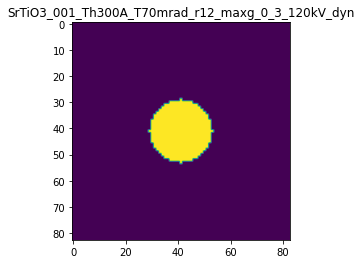

R-factor: 0.0001791068168230618

>>> producing the 83. dataset...

The offset applied on thickness: -0.0005183623617299678

The offset applied on Ug: -44.184516428436

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.48163763827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO

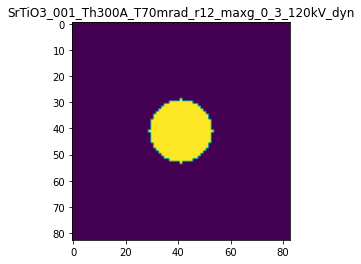

R-factor: 0.00017678620397139504

>>> producing the 84. dataset...

The offset applied on thickness: 5.8266882305787026e-05

The offset applied on Ug: -76.4037847223218

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0582668823058
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

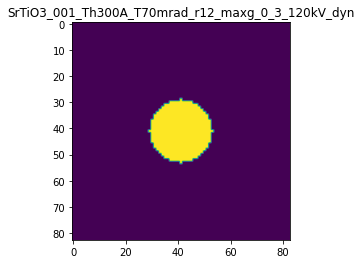

R-factor: 0.0001872672380702049

>>> producing the 85. dataset...

The offset applied on thickness: 0.0005270546083552867

The offset applied on Ug: 44.7294861285562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5270546083553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

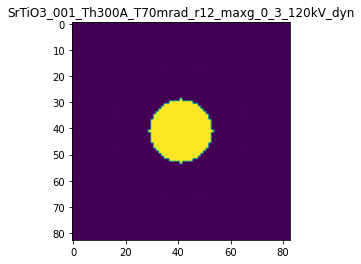

R-factor: 0.00016272169464458464

>>> producing the 86. dataset...

The offset applied on thickness: -0.00038756791259953285

The offset applied on Ug: -4.733219364790002

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.61243208740046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

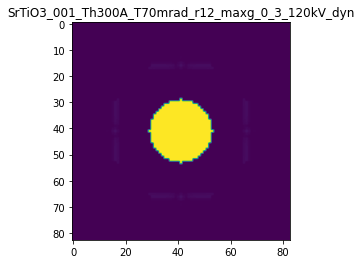

R-factor: 2.6330389191118376e-05

>>> producing the 87. dataset...

The offset applied on thickness: -0.0006954053252663451

The offset applied on Ug: 39.02155437013793

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30459467473366
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

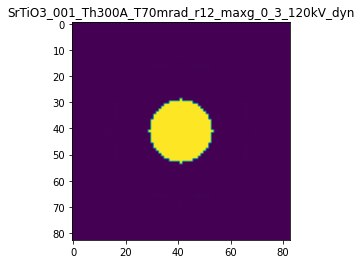

R-factor: 0.00015460839357532417

>>> producing the 88. dataset...

The offset applied on thickness: -6.070818313714433e-05

The offset applied on Ug: 9.833001834036786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93929181686286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

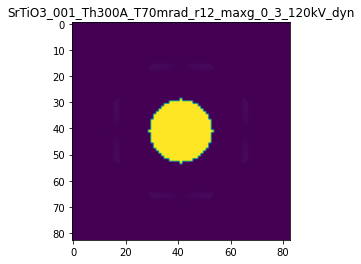

R-factor: 5.8593069165103684e-05

>>> producing the 89. dataset...

The offset applied on thickness: 0.00023806849348370296

The offset applied on Ug: 7.8058631821354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2380684934837
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

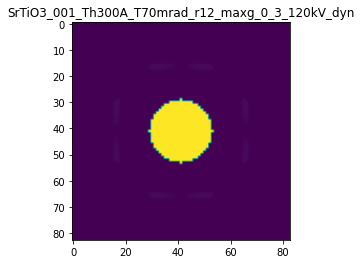

R-factor: 4.7720159375624315e-05

>>> producing the 90. dataset...

The offset applied on thickness: 8.615237500588791e-07

The offset applied on Ug: -72.46450889061343

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0008615237501
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

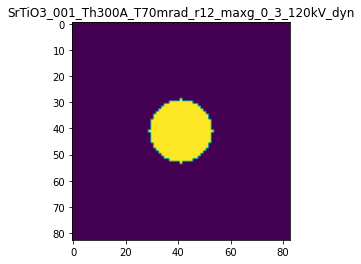

R-factor: 0.00018726761995711946

>>> producing the 91. dataset...

The offset applied on thickness: -0.0009971614454476244

The offset applied on Ug: 46.48825494338836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00283855455234
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

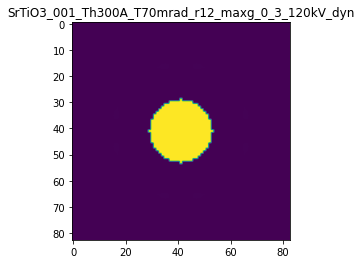

R-factor: 0.00016466308551750297

>>> producing the 92. dataset...

The offset applied on thickness: -0.0003752414857081372

The offset applied on Ug: 39.0286731783964

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6247585142919
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

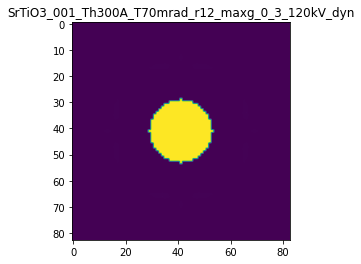

R-factor: 0.0001546390773137417

>>> producing the 93. dataset...

The offset applied on thickness: -0.00023620358282779952

The offset applied on Ug: 61.55600026093289

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7637964171722
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

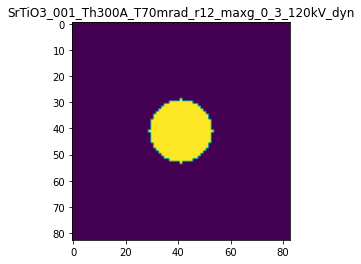

R-factor: 0.00017609783174701458

>>> producing the 94. dataset...

The offset applied on thickness: -0.00016356291723780702

The offset applied on Ug: -37.73332633675296

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8364370827622
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

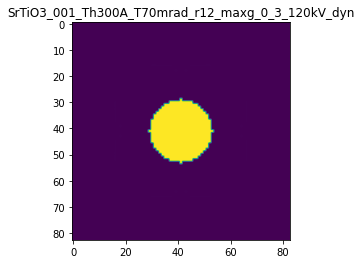

R-factor: 0.00016364173590663033

>>> producing the 95. dataset...

The offset applied on thickness: 0.00038080413650033387

The offset applied on Ug: -30.623332317782115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38080413650033
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

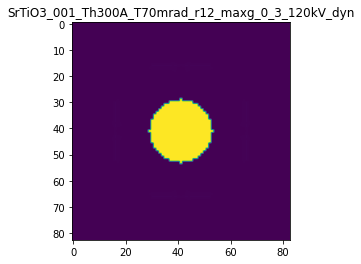

R-factor: 0.0001397180255989489

>>> producing the 96. dataset...

The offset applied on thickness: 0.0002670242986907565

The offset applied on Ug: 6.612766262734786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2670242986907
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

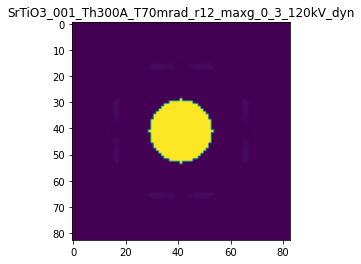

R-factor: 4.089000171195866e-05

>>> producing the 97. dataset...

The offset applied on thickness: 0.0002644765316504798

The offset applied on Ug: -24.34256874439456

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2644765316505
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

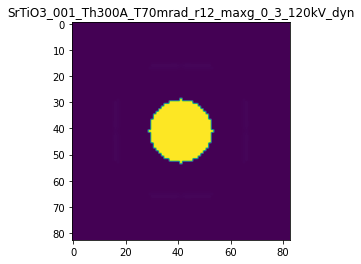

R-factor: 0.00010678879885566777

>>> producing the 98. dataset...

The offset applied on thickness: 0.0003044957541142308

The offset applied on Ug: 58.56706455397929

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3044957541142
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

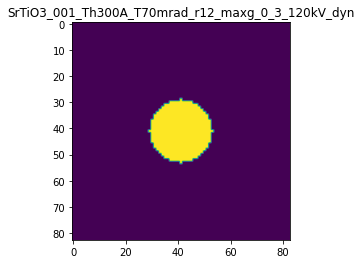

R-factor: 0.00017480735103459651

>>> producing the 99. dataset...

The offset applied on thickness: 0.00040851851095227866

The offset applied on Ug: -28.01307086556244

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4085185109523
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

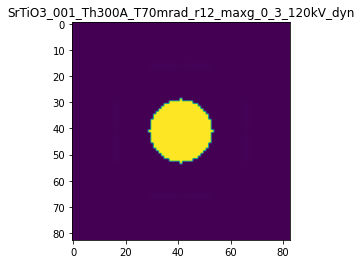

R-factor: 0.00012712006460591322

>>> producing the 100. dataset...

The offset applied on thickness: -0.0002740123157068861

The offset applied on Ug: 14.269480314243774

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7259876842931
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

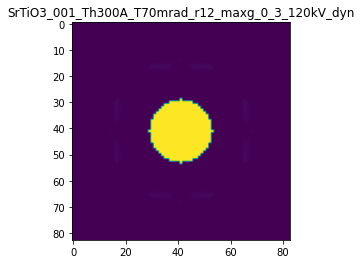

R-factor: 7.988085710688926e-05

>>> producing the 101. dataset...

The offset applied on thickness: -0.0005269911836815557

The offset applied on Ug: -75.99032645893053

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.47300881631844
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

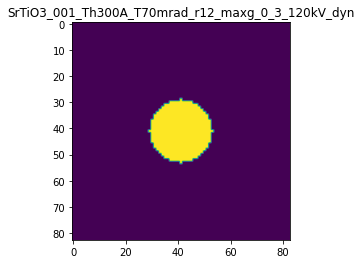

R-factor: 0.00018730853984373817

>>> producing the 102. dataset...

The offset applied on thickness: 0.0007715109053427298

The offset applied on Ug: -75.32352847959483

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7715109053427
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

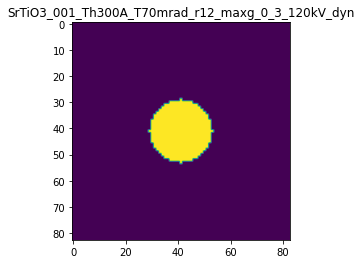

R-factor: 0.0001872685078352622

>>> producing the 103. dataset...

The offset applied on thickness: -4.769920374975145e-06

The offset applied on Ug: -69.60251101423898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.995230079625
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

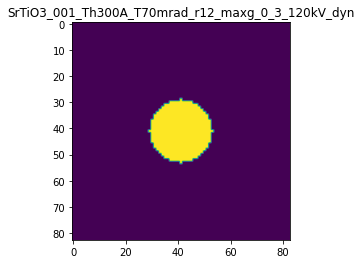

R-factor: 0.0001869911266523812

>>> producing the 104. dataset...

The offset applied on thickness: 0.0005964724132446278

The offset applied on Ug: 4.568239890051973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5964724132446
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

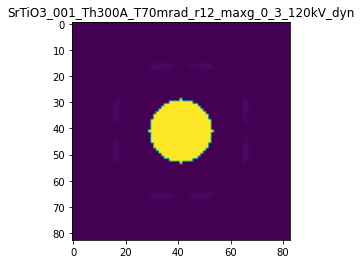

R-factor: 2.8430873099468822e-05

>>> producing the 105. dataset...

The offset applied on thickness: 0.0005708898447460884

The offset applied on Ug: -33.61934874454824

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57088984474603
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

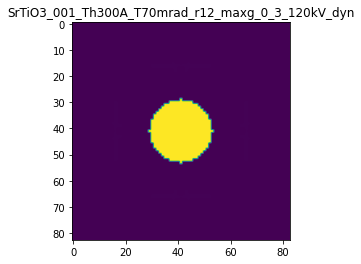

R-factor: 0.00015092895321643343

>>> producing the 106. dataset...

The offset applied on thickness: -0.0009903705219423114

The offset applied on Ug: -62.645279966279325

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0096294780577
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

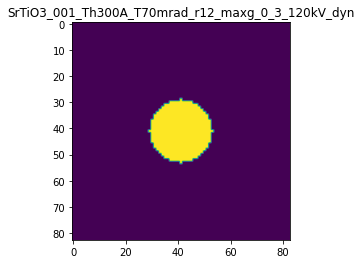

R-factor: 0.00018578342812382447

>>> producing the 107. dataset...

The offset applied on thickness: -0.00042193980043464264

The offset applied on Ug: -3.0720019136674455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57806019956536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

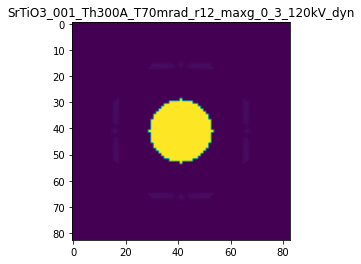

R-factor: 1.77002834722226e-05

>>> producing the 108. dataset...

The offset applied on thickness: 0.0007769106799389014

The offset applied on Ug: -69.13097666612649

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7769106799389
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

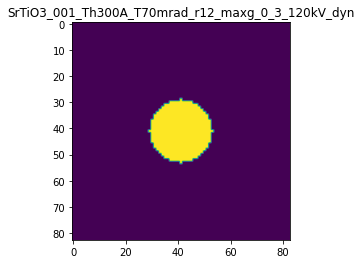

R-factor: 0.00018691344953733819

>>> producing the 109. dataset...

The offset applied on thickness: 0.00020050178798704387

The offset applied on Ug: 3.7957798309668216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.20050178798704
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

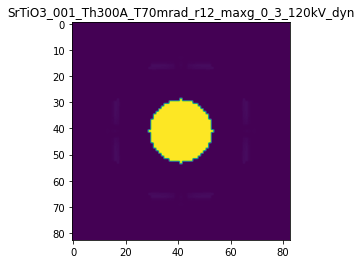

R-factor: 2.378756608746036e-05

>>> producing the 110. dataset...

The offset applied on thickness: -0.0005608498882313164

The offset applied on Ug: -22.504882057485283

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4391501117687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

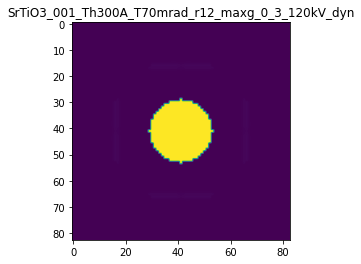

R-factor: 9.633549664538694e-05

>>> producing the 111. dataset...

The offset applied on thickness: -0.00036985061939293854

The offset applied on Ug: -3.0085054246953224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63014938060707
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

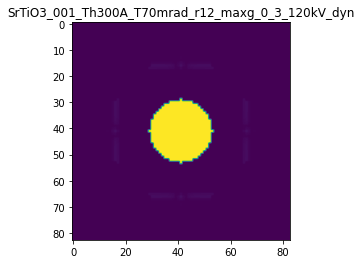

R-factor: 1.7364975316490804e-05

>>> producing the 112. dataset...

The offset applied on thickness: 0.0004444831423142763

The offset applied on Ug: 74.394269039122

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44448314231425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

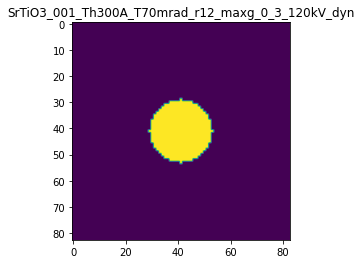

R-factor: 0.00017971289890412507

>>> producing the 113. dataset...

The offset applied on thickness: -6.736073226613226e-05

The offset applied on Ug: 49.22161661060369

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93263926773386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

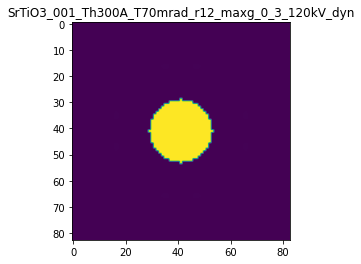

R-factor: 0.00016791928513086433

>>> producing the 114. dataset...

The offset applied on thickness: -0.0007652460572259801

The offset applied on Ug: 45.103423283648844

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.234753942774
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

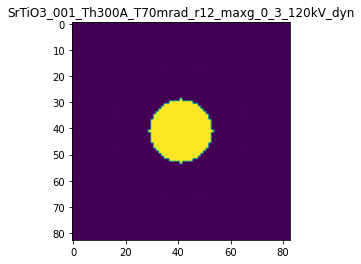

R-factor: 0.00016307617063669692

>>> producing the 115. dataset...

The offset applied on thickness: 0.0008340647416015765

The offset applied on Ug: 6.456960645116633

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8340647416016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

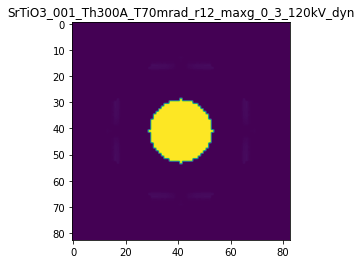

R-factor: 3.97876895274355e-05

>>> producing the 116. dataset...

The offset applied on thickness: -0.0009176404535676422

The offset applied on Ug: 15.006061755863593

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0823595464324
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

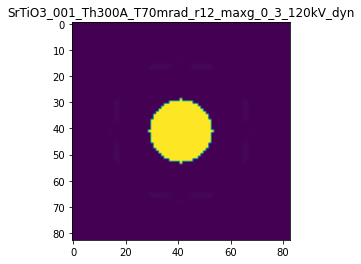

R-factor: 8.330169491817775e-05

>>> producing the 117. dataset...

The offset applied on thickness: 0.0002719959443300475

The offset applied on Ug: -72.63322456769036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27199594433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

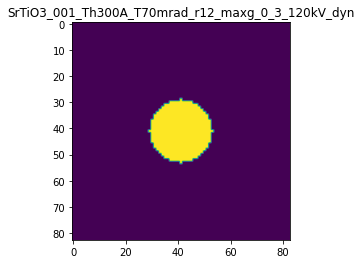

R-factor: 0.00018726254454083725

>>> producing the 118. dataset...

The offset applied on thickness: 0.0009708378228699569

The offset applied on Ug: -80.58151679077244

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97083782286995
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

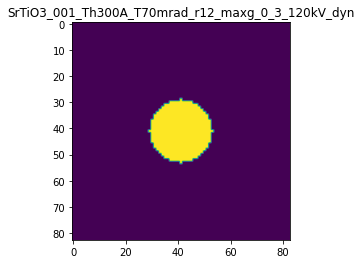

R-factor: 0.00018736528407630487

>>> producing the 119. dataset...

The offset applied on thickness: 0.00021175185885422554

The offset applied on Ug: -66.19444888672516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21175185885426
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

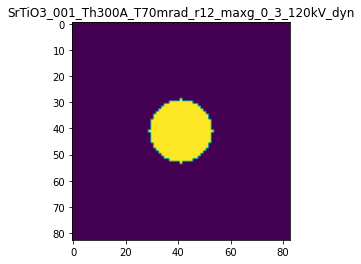

R-factor: 0.00018638729282867322

>>> producing the 120. dataset...

The offset applied on thickness: -0.0006154980610840597

The offset applied on Ug: -8.896982380635455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3845019389159
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

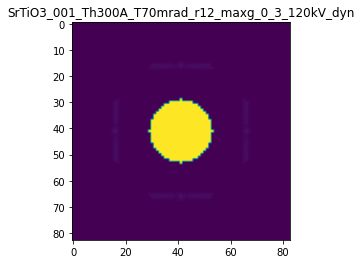

R-factor: 4.3098990189372506e-05

>>> producing the 121. dataset...

The offset applied on thickness: 0.0009360685998764162

The offset applied on Ug: -70.86803647362578

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9360685998764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

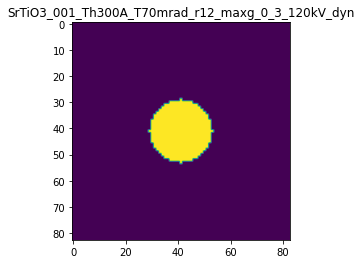

R-factor: 0.00018712666582062162

>>> producing the 122. dataset...

The offset applied on thickness: 9.737322861142728e-05

The offset applied on Ug: 71.22968219201063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0973732286114
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

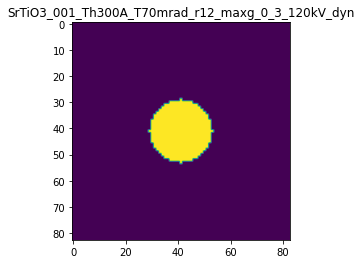

R-factor: 0.00017870745148883903

>>> producing the 123. dataset...

The offset applied on thickness: 0.0005233227861695482

The offset applied on Ug: 30.339722532533088

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52332278616956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

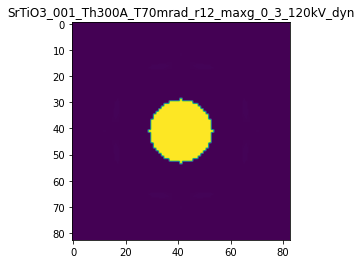

R-factor: 0.00013615539145530494

>>> producing the 124. dataset...

The offset applied on thickness: -0.0007525214989463874

The offset applied on Ug: 70.31483931226137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2474785010536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

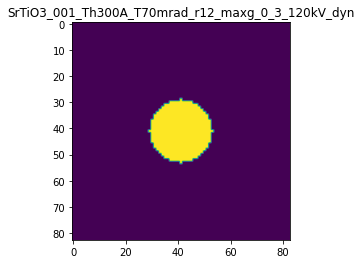

R-factor: 0.00017840319872354494

>>> producing the 125. dataset...

The offset applied on thickness: 0.00022448484898141154

The offset applied on Ug: -22.258828818510356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2244848489814
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

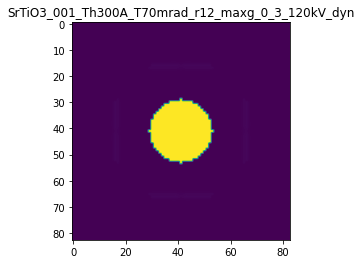

R-factor: 9.474384058779225e-05

>>> producing the 126. dataset...

The offset applied on thickness: 0.00021342574527934244

The offset applied on Ug: -39.58181505888966

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2134257452793
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

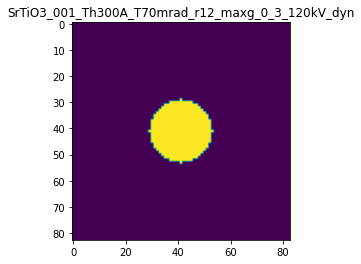

R-factor: 0.0001685448757432884

>>> producing the 127. dataset...

The offset applied on thickness: 7.44065313286062e-05

The offset applied on Ug: -49.08464006622486

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07440653132863
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

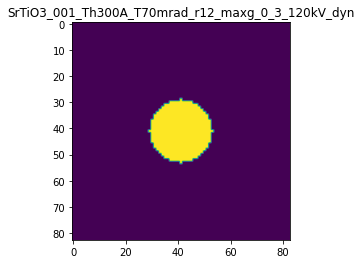

R-factor: 0.00018212195721507813

>>> producing the 128. dataset...

The offset applied on thickness: 0.00011539502678782699

The offset applied on Ug: -61.92168322979682

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1153950267878
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

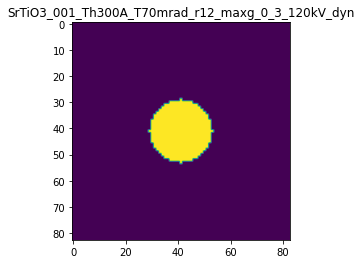

R-factor: 0.00018566216678663993

>>> producing the 129. dataset...

The offset applied on thickness: -0.0007813036423864297

The offset applied on Ug: 3.7530089955321637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21869635761357
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

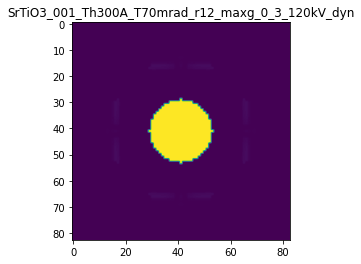

R-factor: 2.3936899971713712e-05

>>> producing the 130. dataset...

The offset applied on thickness: 9.133221881970877e-05

The offset applied on Ug: -7.095386036324217

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0913322188197
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

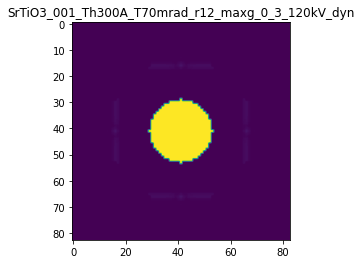

R-factor: 3.6892770253594e-05

>>> producing the 131. dataset...

The offset applied on thickness: -0.0008878664356808217

The offset applied on Ug: -20.77725616692982

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.11213356431915
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

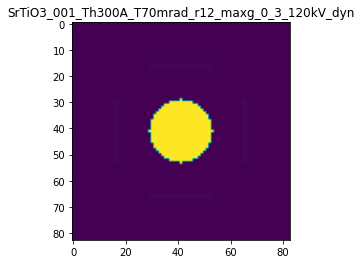

R-factor: 8.70147023065268e-05

>>> producing the 132. dataset...

The offset applied on thickness: 0.0004133207212697152

The offset applied on Ug: 25.224250469149666

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4133207212697
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

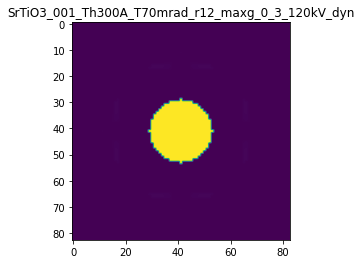

R-factor: 0.0001217792521666639

>>> producing the 133. dataset...

The offset applied on thickness: 2.4941096150201903e-05

The offset applied on Ug: 7.944039841492832

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0249410961502
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

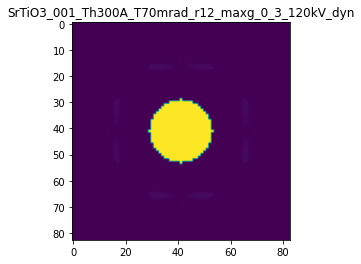

R-factor: 4.855684973946613e-05

>>> producing the 134. dataset...

The offset applied on thickness: -0.000342896089815387

The offset applied on Ug: -11.041609982610881

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65710391018456
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

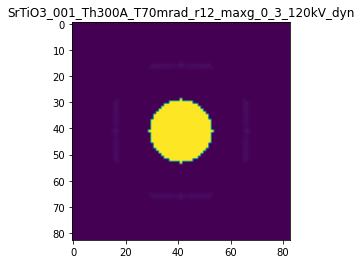

R-factor: 4.985222412281688e-05

>>> producing the 135. dataset...

The offset applied on thickness: -0.00033390933944178356

The offset applied on Ug: 48.33367630807736

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6660906605582
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

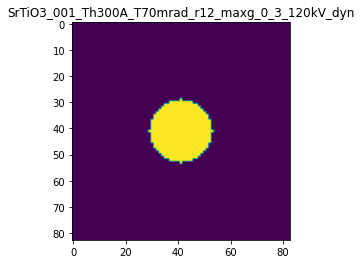

R-factor: 0.00016688696803209642

>>> producing the 136. dataset...

The offset applied on thickness: -0.000544741821470651

The offset applied on Ug: 25.37224860741946

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45525817852933
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

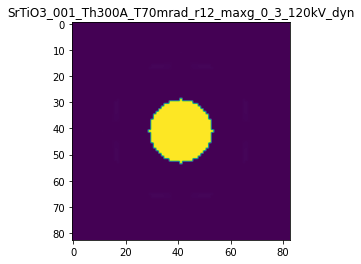

R-factor: 0.00012234430233872774

>>> producing the 137. dataset...

The offset applied on thickness: 0.0003251040906627332

The offset applied on Ug: 27.800505599988757

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3251040906627
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

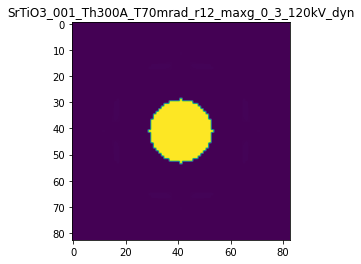

R-factor: 0.00012943028361707087

>>> producing the 138. dataset...

The offset applied on thickness: 0.00027624828982480797

The offset applied on Ug: -3.5494877024601554

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2762482898248
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

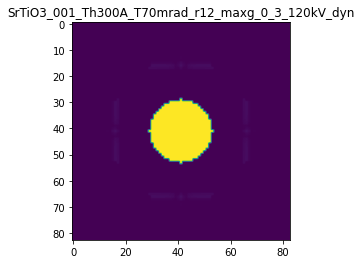

R-factor: 2.042511097320634e-05

>>> producing the 139. dataset...

The offset applied on thickness: 0.0006443904504879594

The offset applied on Ug: -32.79743227221623

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.64439045048795
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

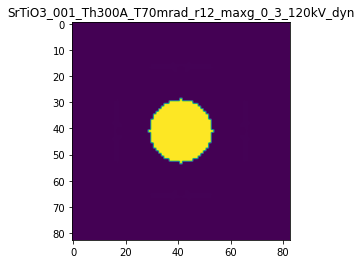

R-factor: 0.0001482194995506203

>>> producing the 140. dataset...

The offset applied on thickness: 0.0005742435894543321

The offset applied on Ug: 66.80980139703637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57424358945434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

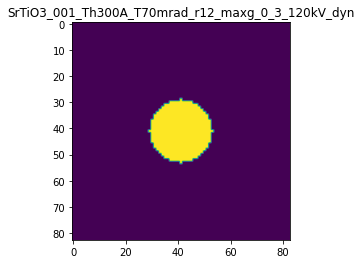

R-factor: 0.00017756999930515117



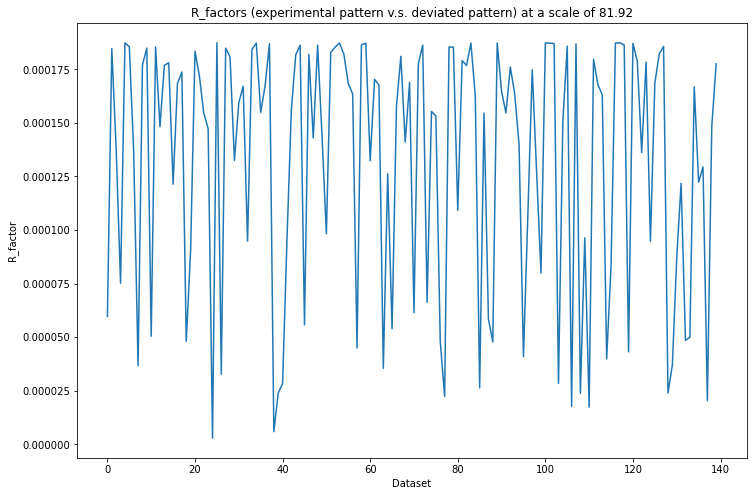

>>> start to train the CNN 

Epoch 1/20
5/5 [==============================] - 4s 441ms/step - loss: 1595.1700 - acc: 0.0000e+00 - val_loss: 2076.5120 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 1s 274ms/step - loss: 1593.6188 - acc: 0.0000e+00 - val_loss: 2076.4688 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 1s 269ms/step - loss: 1593.5580 - acc: 0.0000e+00 - val_loss: 2076.4380 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 1s 256ms/step - loss: 1593.5297 - acc: 0.0000e+00 - val_loss: 2076.4165 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 1s 264ms/step - loss: 1593.5078 - acc: 0.0000e+00 - val_loss: 2076.3989 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 1s 275ms/step - loss: 1593.4938 - acc: 0.0000e+00 - val_loss: 2076.3855 - val_acc: 0.0000e+00
Epoch 7/20
5/5 [==============================] - 1s 255ms/step - loss: 1593.4803 - acc: 0.0000e+00 - val_l

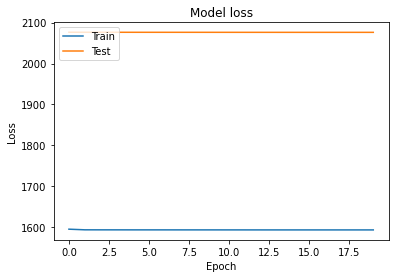

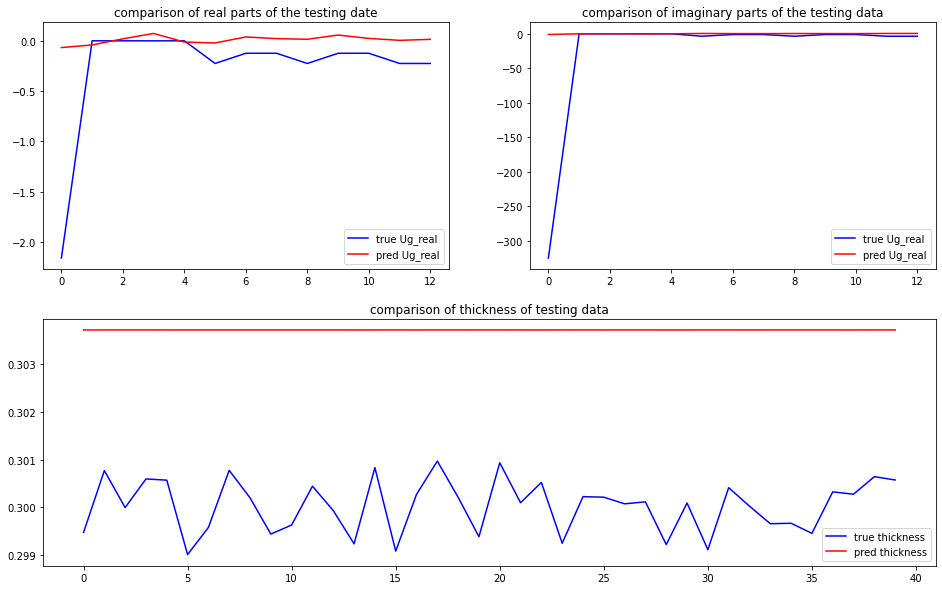

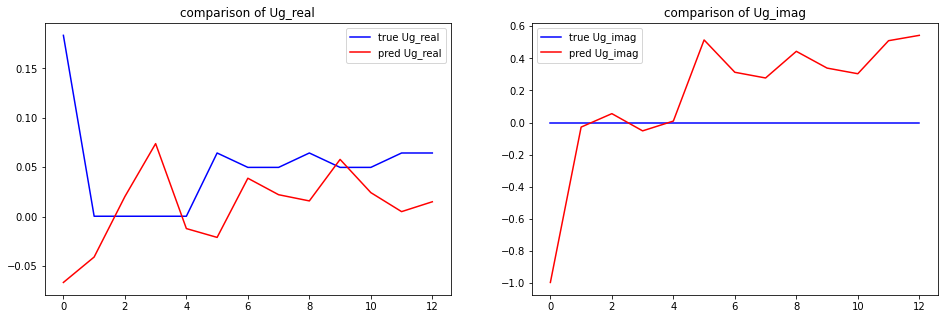

predicted thickness: 30.37222921848297 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=303.7222921848297
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[-0.06654549+0.j         -0.0102

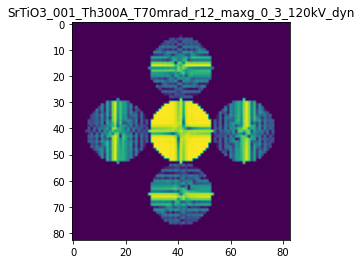

X_sim.max(): 0.9913623812937131
R-factor at a scale of 81.92 is 0.6057973384170265.
Time:  4032.5306684879997


In [14]:
start = timeit.default_timer()

# define training set size & testing set size
trainsize = 100
testsize = 40
data_size = trainsize+testsize

# initial scale used to diverse Ug and t
scale_Ug, scale_t = 0.01, 0.001

# maximum acceptable R-factor value
R_limit = 0.5
# current R-factor value, begin with 0
R_curr = 0

scale_Ug_list=[]
R_factor_list=[]

while R_curr < R_limit:
    print('\n-----------------------------------------------------------------------------------------------------\n')
    print('>>> start to produce Dataset at a scale of {}\n'.format(scale_Ug))
    print('-----------------------------------------------------------------------------------------------------\n')
    
    # load and compile the model
    model = load_model(name+'.h5')
    
    # generate Datasets
    X, y, R_factors = generate_diversed_data(Ug_t, scale_Ug=scale_Ug, scale_t=scale_t, data_size=data_size)

    X_train = X[:trainsize,]
    X_test = X[trainsize:trainsize+testsize,]
    y_train = y[:trainsize,]
    y_test = y[trainsize:trainsize+testsize,]

    # invert the 1 channel image Array to 3 Channel, to use ResNet50
    X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
    X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)
    
    

    print('>>> start to train the CNN \n')
    # train the model
    model.fit(X_train_3C, y_train, validation_data=(X_test_3C, y_test), batch_size=20, epochs=20)
        
    # save the trained weigths of the model, delete the existing model
    # model.save(name+'.h5')

    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
    plt.close()

    
    
    # Prediction of the testing set
    y_test_pred = model.predict(X_test_3C)    
    Ug_test_pred_complex = y_test_pred[:,:-1].reshape(-1,numUg,2)
    Ug_test_complex = y_test[:,:-1].reshape(-1,numUg,2)    
    t_test_pred = y_test_pred[:,-1]
    t_test = y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b', label='true Ug_real')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r', label='pred Ug_real')
    ax1.legend()
    ax1.set_title('comparison of real parts of the testing date')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b', label='true Ug_real')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r', label='pred Ug_real')
    ax2.legend()
    ax2.set_title('comparison of imaginary parts of the testing data')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b', label='true thickness')
    ax3.plot(t_test_pred[:],'r', label='pred thickness')
    ax3.legend()
    ax3.set_title('comparison of thickness of testing data') 
    plt.show()
    plt.close()
    

    
    
    # Prediction of the experimental Pattern
    X_exp_3C = np.concatenate((I,I,I),axis=3) 
    y_exp_pred = model.predict(X_exp_3C)    
    Ug_t_exp_pred = y_exp_pred[0,:] 
    
    
    # plot the results
    gs = gridspec.GridSpec(1, 2)
    fig = plt.figure(figsize=(16,5))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug[::2],'b', label='true Ug_real')
    ax1.plot(Ug_t_exp_pred[:-1:2], 'r', label='pred Ug_real')
    ax1.legend()
    ax1.set_title("comparison of Ug_real")
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug[1::2],'b', label='true Ug_imag')
    ax2.plot(Ug_t_exp_pred[1:-1:2],'r', label='pred Ug_imag')
    ax2.legend()
    ax2.set_title("comparison of Ug_imag")
    plt.show()
    plt.close()
    
    print("predicted thickness: {} nm".format(Ug_t_exp_pred[-1]*100))
    

    # normalization
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])
    
    # Compute the LARBED pattern: X_sim, from the predicted Ug_t
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg= Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(Nx,Nx,1)
    nlogf_X_sim = nlogf(X_sim)    
    print("X_sim.max():",X_sim.max())
    
    # compute R-factor
    R_curr = calculate_R(I, X_sim)
    print('R-factor at a scale of {} is {}.'.format(scale_Ug, R_curr))
        
    scale_Ug_list = np.append(scale_Ug_list, scale_Ug)
    R_factor_list = np.append(R_factor_list, R_curr)
    
    scale_Ug *= 2
            
                       
stop = timeit.default_timer()
print('Time: ', stop - start)

/opt/anaconda3/envs/pyQEDA37/lib/python3.7/site-packages/ipykernel_launcher.py:4: MatplotlibDeprecationWarning: The 'basex' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  after removing the cwd from sys.path.


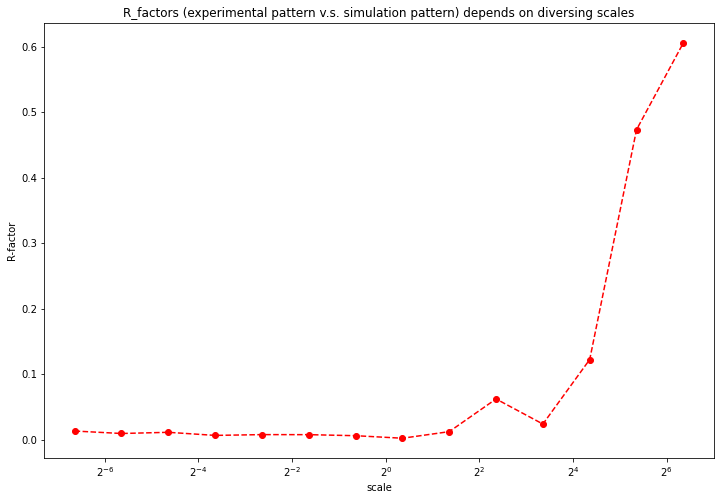

In [15]:
plt.figure(figsize=(12,8))
plt.plot(scale_Ug_list[:], R_factor_list[:], "ro--")
plt.title("R_factors (experimental pattern v.s. simulation pattern) depends on diversing scales")
plt.xscale("log", basex=2)
plt.xlabel("scale")
plt.ylabel("R-factor")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_R_scale.png")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_R_scale.jpg")
plt.show()
plt.close()

The Ug diversified from the true Ug by a scale below 10 is able to simulate a similar pattern with the experimental pattern (R<0.2).

In [16]:
print(scale_Ug_list)

[1.000e-02 2.000e-02 4.000e-02 8.000e-02 1.600e-01 3.200e-01 6.400e-01
 1.280e+00 2.560e+00 5.120e+00 1.024e+01 2.048e+01 4.096e+01 8.192e+01]


In [17]:
print(R_factor_list)

[0.01330998 0.00952492 0.01133609 0.00661304 0.00781968 0.00774456
 0.00615755 0.00229137 0.01234248 0.06224531 0.02395034 0.1224486
 0.47335031 0.60579734]
